# Experiments

## calculate POI risks based on new risk definition: n(n-1)/2 
#### where n is the number of people in a hexagon

#### This calculation doesn't use the extrapolated values of individuals in each POI. Instead, it focuses on the max occupancy allowed in each POI, and examines the risk based on different levels of occupancies [0,10,20,30,40,50,60,70,80,90,100]%

In [1]:
import math
import random
import pandas as pd
import numpy as np
import json
import scipy.special as scs
import ast
from scipy.stats import skewnorm

In [8]:
file = pd.read_csv("tmp_file_for_risk_processing.csv")

# calculate the number of hexagons in each POI
HEX_SIZE = 4 # m^2 or 2x2 m^2
OCCUP_FRACTION = [0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1]

SKEWNESS_VALUE = 0.8 # -> 0: follows normal dist
NUM_SAMPLES = 100
MIN_AREA_ONE_PERSON_ALLOCATED = 4 #m^2 -> this means that there is 1 person on 4m^2

In [2]:
'''
    percentage: the percentage of the max occupancy of a specific POI
    num_hexs: number of hexagons of a given POI
    
    return: the number of occupants of a given POI based on max occupancy definition and
            input. Source: https://ccpia.org/occupancy-load-signs/ 
            Using Covid-19 guidlines -> 1 person on 4m^2
            #people = #cells * 16 * 0.25 * occupancy%
'''
def get_num_occupants(percentage, num_hexs):
    return num_hexs * HEX_SIZE * (1/MIN_AREA_ONE_PERSON_ALLOCATED) * percentage

In [3]:
'''
    Given the number of hexagons of a given POI, return the skewed, 
    normal and uniform risks associated with that POI.
    
    Risk calculation:
    After spreading individuals based on a predefined distribution, sample NUM_SAMPLE 
    times. In each sample, select a hexagon based on that distribution, and let the 
    risk value be n(n-1)/2
    
    returns 3 arrays of different occupancy distributions over different occupancies
'''
def compute_risks_of_poi(num_hexs):
    uniform_risks = np.array([0]*len(OCCUP_FRACTION))
    skewed_risks = np.array([0]*len(OCCUP_FRACTION))
    normal_risks = np.array([0]*len(OCCUP_FRACTION))
    
    for i in range(len(OCCUP_FRACTION)):
        num_people = get_num_occupants(OCCUP_FRACTION[i], num_hexs)
        
        if num_people == 0:
            uniform_risks[i] = 0
            skewed_risks[i] = 0
            normal_risks[i] = 0
        else:
            # uniform computation
            n = math.floor(MIN_AREA_ONE_PERSON_ALLOCATED / HEX_SIZE)
            uniform_risks[i] = n*(n-1)/2

            # skewed computation
            skewed_densities = abs(skewnorm.rvs(SKEWNESS_VALUE,size=num_hexs))
            skewed_distribution = (skewed_densities*num_people).astype(int)

            if sum(skewed_distribution) == 0:
                skewed_risks[i] = 0
            else:
                skewed_selection = random.choices(skewed_distribution, skewed_distribution,k=NUM_SAMPLES)
                
            # normal computation
            normal_densities = abs(np.random.normal(size=num_hexs))
            normal_distribution = (normal_densities*num_people).astype(int)
            normal_selection = random.choices(normal_distribution, normal_densities,k=NUM_SAMPLES)

            # complete computation for skewed and normal
            for sample_id in range(NUM_SAMPLES):
                n = normal_selection[sample_id]
                normal_risks[i] += n*(n-1)/2

                if sum(skewed_distribution) > 0:
                    n = skewed_selection[sample_id]
                    skewed_risks[i] += n*(n-1)/2

            normal_risks[i] = normal_risks[i] / NUM_SAMPLES

            if sum(skewed_distribution) > 0:
                skewed_risks[i] = skewed_risks[i] / NUM_SAMPLES
    
    return uniform_risks.tolist(), skewed_risks.tolist(), normal_risks.tolist()

In [11]:
file['num_hexagons'] = [math.ceil(float(x)/HEX_SIZE) for x in file['geodesic_area']]

UNIFORM_RISKS, SKEWED_RISKS, NORMAL_RISKS = [], [], []

for index, row in file.iterrows():
    print(index)
    tmp_uniform_risks, tmp_skewed_risks, tmp_normal_risks = compute_risks_of_poi(row['num_hexagons'])
    
    UNIFORM_RISKS.append(tmp_uniform_risks)
    SKEWED_RISKS.append(tmp_skewed_risks)
    NORMAL_RISKS.append(tmp_normal_risks)

file['normal_risks'] = NORMAL_RISKS
file['skewed_risks'] = SKEWED_RISKS
file['uniform_risks'] = UNIFORM_RISKS

file.to_csv('static/auxiliary_files/GTA_risks_by_occup_percentage.csv', index=False)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

1861
1862
1863
1864
1865
1866
1867
1868
1869
1870
1871
1872
1873
1874
1875
1876
1877
1878
1879
1880
1881
1882
1883
1884
1885
1886
1887
1888
1889
1890
1891
1892
1893
1894
1895
1896
1897
1898
1899
1900
1901
1902
1903
1904
1905
1906
1907
1908
1909
1910
1911
1912
1913
1914
1915
1916
1917
1918
1919
1920
1921
1922
1923
1924
1925
1926
1927
1928
1929
1930
1931
1932
1933
1934
1935
1936
1937
1938
1939
1940
1941
1942
1943
1944
1945
1946
1947
1948
1949
1950
1951
1952
1953
1954
1955
1956
1957
1958
1959
1960
1961
1962
1963
1964
1965
1966
1967
1968
1969
1970
1971
1972
1973
1974
1975
1976
1977
1978
1979
1980
1981
1982
1983
1984
1985
1986
1987
1988
1989
1990
1991
1992
1993
1994
1995
1996
1997
1998
1999
2000
2001
2002
2003
2004
2005
2006
2007
2008
2009
2010
2011
2012
2013
2014
2015
2016
2017
2018
2019
2020
2021
2022
2023
2024
2025
2026
2027
2028
2029
2030
2031
2032
2033
2034
2035
2036
2037
2038
2039
2040
2041
2042
2043
2044
2045
2046
2047
2048
2049
2050
2051
2052
2053
2054
2055
2056
2057
2058
2059
2060


3503
3504
3505
3506
3507
3508
3509
3510
3511
3512
3513
3514
3515
3516
3517
3518
3519
3520
3521
3522
3523
3524
3525
3526
3527
3528
3529
3530
3531
3532
3533
3534
3535
3536
3537
3538
3539
3540
3541
3542
3543
3544
3545
3546
3547
3548
3549
3550
3551
3552
3553
3554
3555
3556
3557
3558
3559
3560
3561
3562
3563
3564
3565
3566
3567
3568
3569
3570
3571
3572
3573
3574
3575
3576
3577
3578
3579
3580
3581
3582
3583
3584
3585
3586
3587
3588
3589
3590
3591
3592
3593
3594
3595
3596
3597
3598
3599
3600
3601
3602
3603
3604
3605
3606
3607
3608
3609
3610
3611
3612
3613
3614
3615
3616
3617
3618
3619
3620
3621
3622
3623
3624
3625
3626
3627
3628
3629
3630
3631
3632
3633
3634
3635
3636
3637
3638
3639
3640
3641
3642
3643
3644
3645
3646
3647
3648
3649
3650
3651
3652
3653
3654
3655
3656
3657
3658
3659
3660
3661
3662
3663
3664
3665
3666
3667
3668
3669
3670
3671
3672
3673
3674
3675
3676
3677
3678
3679
3680
3681
3682
3683
3684
3685
3686
3687
3688
3689
3690
3691
3692
3693
3694
3695
3696
3697
3698
3699
3700
3701
3702


5142
5143
5144
5145
5146
5147
5148
5149
5150
5151
5152
5153
5154
5155
5156
5157
5158
5159
5160
5161
5162
5163
5164
5165
5166
5167
5168
5169
5170
5171
5172
5173
5174
5175
5176
5177
5178
5179
5180
5181
5182
5183
5184
5185
5186
5187
5188
5189
5190
5191
5192
5193
5194
5195
5196
5197
5198
5199
5200
5201
5202
5203
5204
5205
5206
5207
5208
5209
5210
5211
5212
5213
5214
5215
5216
5217
5218
5219
5220
5221
5222
5223
5224
5225
5226
5227
5228
5229
5230
5231
5232
5233
5234
5235
5236
5237
5238
5239
5240
5241
5242
5243
5244
5245
5246
5247
5248
5249
5250
5251
5252
5253
5254
5255
5256
5257
5258
5259
5260
5261
5262
5263
5264
5265
5266
5267
5268
5269
5270
5271
5272
5273
5274
5275
5276
5277
5278
5279
5280
5281
5282
5283
5284
5285
5286
5287
5288
5289
5290
5291
5292
5293
5294
5295
5296
5297
5298
5299
5300
5301
5302
5303
5304
5305
5306
5307
5308
5309
5310
5311
5312
5313
5314
5315
5316
5317
5318
5319
5320
5321
5322
5323
5324
5325
5326
5327
5328
5329
5330
5331
5332
5333
5334
5335
5336
5337
5338
5339
5340
5341


6788
6789
6790
6791
6792
6793
6794
6795
6796
6797
6798
6799
6800
6801
6802
6803
6804
6805
6806
6807
6808
6809
6810
6811
6812
6813
6814
6815
6816
6817
6818
6819
6820
6821
6822
6823
6824
6825
6826
6827
6828
6829
6830
6831
6832
6833
6834
6835
6836
6837
6838
6839
6840
6841
6842
6843
6844
6845
6846
6847
6848
6849
6850
6851
6852
6853
6854
6855
6856
6857
6858
6859
6860
6861
6862
6863
6864
6865
6866
6867
6868
6869
6870
6871
6872
6873
6874
6875
6876
6877
6878
6879
6880
6881
6882
6883
6884
6885
6886
6887
6888
6889
6890
6891
6892
6893
6894
6895
6896
6897
6898
6899
6900
6901
6902
6903
6904
6905
6906
6907
6908
6909
6910
6911
6912
6913
6914
6915
6916
6917
6918
6919
6920
6921
6922
6923
6924
6925
6926
6927
6928
6929
6930
6931
6932
6933
6934
6935
6936
6937
6938
6939
6940
6941
6942
6943
6944
6945
6946
6947
6948
6949
6950
6951
6952
6953
6954
6955
6956
6957
6958
6959
6960
6961
6962
6963
6964
6965
6966
6967
6968
6969
6970
6971
6972
6973
6974
6975
6976
6977
6978
6979
6980
6981
6982
6983
6984
6985
6986
6987


8443
8444
8445
8446
8447
8448
8449
8450
8451
8452
8453
8454
8455
8456
8457
8458
8459
8460
8461
8462
8463
8464
8465
8466
8467
8468
8469
8470
8471
8472
8473
8474
8475
8476
8477
8478
8479
8480
8481
8482
8483
8484
8485
8486
8487
8488
8489
8490
8491
8492
8493
8494
8495
8496
8497
8498
8499
8500
8501
8502
8503
8504
8505
8506
8507
8508
8509
8510
8511
8512
8513
8514
8515
8516
8517
8518
8519
8520
8521
8522
8523
8524
8525
8526
8527
8528
8529
8530
8531
8532
8533
8534
8535
8536
8537
8538
8539
8540
8541
8542
8543
8544
8545
8546
8547
8548
8549
8550
8551
8552
8553
8554
8555
8556
8557
8558
8559
8560
8561
8562
8563
8564
8565
8566
8567
8568
8569
8570
8571
8572
8573
8574
8575
8576
8577
8578
8579
8580
8581
8582
8583
8584
8585
8586
8587
8588
8589
8590
8591
8592
8593
8594
8595
8596
8597
8598
8599
8600
8601
8602
8603
8604
8605
8606
8607
8608
8609
8610
8611
8612
8613
8614
8615
8616
8617
8618
8619
8620
8621
8622
8623
8624
8625
8626
8627
8628
8629
8630
8631
8632
8633
8634
8635
8636
8637
8638
8639
8640
8641
8642


10075
10076
10077
10078
10079
10080
10081
10082
10083
10084
10085
10086
10087
10088
10089
10090
10091
10092
10093
10094
10095
10096
10097
10098
10099
10100
10101
10102
10103
10104
10105
10106
10107
10108
10109
10110
10111
10112
10113
10114
10115
10116
10117
10118
10119
10120
10121
10122
10123
10124
10125
10126
10127
10128
10129
10130
10131
10132
10133
10134
10135
10136
10137
10138
10139
10140
10141
10142
10143
10144
10145
10146
10147
10148
10149
10150
10151
10152
10153
10154
10155
10156
10157
10158
10159
10160
10161
10162
10163
10164
10165
10166
10167
10168
10169
10170
10171
10172
10173
10174
10175
10176
10177
10178
10179
10180
10181
10182
10183
10184
10185
10186
10187
10188
10189
10190
10191
10192
10193
10194
10195
10196
10197
10198
10199
10200
10201
10202
10203
10204
10205
10206
10207
10208
10209
10210
10211
10212
10213
10214
10215
10216
10217
10218
10219
10220
10221
10222
10223
10224
10225
10226
10227
10228
10229
10230
10231
10232
10233
10234
10235
10236
10237
10238
10239
10240
1024

11442
11443
11444
11445
11446
11447
11448
11449
11450
11451
11452
11453
11454
11455
11456
11457
11458
11459
11460
11461
11462
11463
11464
11465
11466
11467
11468
11469
11470
11471
11472
11473
11474
11475
11476
11477
11478
11479
11480
11481
11482
11483
11484
11485
11486
11487
11488
11489
11490
11491
11492
11493
11494
11495
11496
11497
11498
11499
11500
11501
11502
11503
11504
11505
11506
11507
11508
11509
11510
11511
11512
11513
11514
11515
11516
11517
11518
11519
11520
11521
11522
11523
11524
11525
11526
11527
11528
11529
11530
11531
11532
11533
11534
11535
11536
11537
11538
11539
11540
11541
11542
11543
11544
11545
11546
11547
11548
11549
11550
11551
11552
11553
11554
11555
11556
11557
11558
11559
11560
11561
11562
11563
11564
11565
11566
11567
11568
11569
11570
11571
11572
11573
11574
11575
11576
11577
11578
11579
11580
11581
11582
11583
11584
11585
11586
11587
11588
11589
11590
11591
11592
11593
11594
11595
11596
11597
11598
11599
11600
11601
11602
11603
11604
11605
11606
11607
1160

12815
12816
12817
12818
12819
12820
12821
12822
12823
12824
12825
12826
12827
12828
12829
12830
12831
12832
12833
12834
12835
12836
12837
12838
12839
12840
12841
12842
12843
12844
12845
12846
12847
12848
12849
12850
12851
12852
12853
12854
12855
12856
12857
12858
12859
12860
12861
12862
12863
12864
12865
12866
12867
12868
12869
12870
12871
12872
12873
12874
12875
12876
12877
12878
12879
12880
12881
12882
12883
12884
12885
12886
12887
12888
12889
12890
12891
12892
12893
12894
12895
12896
12897
12898
12899
12900
12901
12902
12903
12904
12905
12906
12907
12908
12909
12910
12911
12912
12913
12914
12915
12916
12917
12918
12919
12920
12921
12922
12923
12924
12925
12926
12927
12928
12929
12930
12931
12932
12933
12934
12935
12936
12937
12938
12939
12940
12941
12942
12943
12944
12945
12946
12947
12948
12949
12950
12951
12952
12953
12954
12955
12956
12957
12958
12959
12960
12961
12962
12963
12964
12965
12966
12967
12968
12969
12970
12971
12972
12973
12974
12975
12976
12977
12978
12979
12980
1298

14185
14186
14187
14188
14189
14190
14191
14192
14193
14194
14195
14196
14197
14198
14199
14200
14201
14202
14203
14204
14205
14206
14207
14208
14209
14210
14211
14212
14213
14214
14215
14216
14217
14218
14219
14220
14221
14222
14223
14224
14225
14226
14227
14228
14229
14230
14231
14232
14233
14234
14235
14236
14237
14238
14239
14240
14241
14242
14243
14244
14245
14246
14247
14248
14249
14250
14251
14252
14253
14254
14255
14256
14257
14258
14259
14260
14261
14262
14263
14264
14265
14266
14267
14268
14269
14270
14271
14272
14273
14274
14275
14276
14277
14278
14279
14280
14281
14282
14283
14284
14285
14286
14287
14288
14289
14290
14291
14292
14293
14294
14295
14296
14297
14298
14299
14300
14301
14302
14303
14304
14305
14306
14307
14308
14309
14310
14311
14312
14313
14314
14315
14316
14317
14318
14319
14320
14321
14322
14323
14324
14325
14326
14327
14328
14329
14330
14331
14332
14333
14334
14335
14336
14337
14338
14339
14340
14341
14342
14343
14344
14345
14346
14347
14348
14349
14350
1435

15556
15557
15558
15559
15560
15561
15562
15563
15564
15565
15566
15567
15568
15569
15570
15571
15572
15573
15574
15575
15576
15577
15578
15579
15580
15581
15582
15583
15584
15585
15586
15587
15588
15589
15590
15591
15592
15593
15594
15595
15596
15597
15598
15599
15600
15601
15602
15603
15604
15605
15606
15607
15608
15609
15610
15611
15612
15613
15614
15615
15616
15617
15618
15619
15620
15621
15622
15623
15624
15625
15626
15627
15628
15629
15630
15631
15632
15633
15634
15635
15636
15637
15638
15639
15640
15641
15642
15643
15644
15645
15646
15647
15648
15649
15650
15651
15652
15653
15654
15655
15656
15657
15658
15659
15660
15661
15662
15663
15664
15665
15666
15667
15668
15669
15670
15671
15672
15673
15674
15675
15676
15677
15678
15679
15680
15681
15682
15683
15684
15685
15686
15687
15688
15689
15690
15691
15692
15693
15694
15695
15696
15697
15698
15699
15700
15701
15702
15703
15704
15705
15706
15707
15708
15709
15710
15711
15712
15713
15714
15715
15716
15717
15718
15719
15720
15721
1572

16922
16923
16924
16925
16926
16927
16928
16929
16930
16931
16932
16933
16934
16935
16936
16937
16938
16939
16940
16941
16942
16943
16944
16945
16946
16947
16948
16949
16950
16951
16952
16953
16954
16955
16956
16957
16958
16959
16960
16961
16962
16963
16964
16965
16966
16967
16968
16969
16970
16971
16972
16973
16974
16975
16976
16977
16978
16979
16980
16981
16982
16983
16984
16985
16986
16987
16988
16989
16990
16991
16992
16993
16994
16995
16996
16997
16998
16999
17000
17001
17002
17003
17004
17005
17006
17007
17008
17009
17010
17011
17012
17013
17014
17015
17016
17017
17018
17019
17020
17021
17022
17023
17024
17025
17026
17027
17028
17029
17030
17031
17032
17033
17034
17035
17036
17037
17038
17039
17040
17041
17042
17043
17044
17045
17046
17047
17048
17049
17050
17051
17052
17053
17054
17055
17056
17057
17058
17059
17060
17061
17062
17063
17064
17065
17066
17067
17068
17069
17070
17071
17072
17073
17074
17075
17076
17077
17078
17079
17080
17081
17082
17083
17084
17085
17086
17087
1708

18293
18294
18295
18296
18297
18298
18299
18300
18301
18302
18303
18304
18305
18306
18307
18308
18309
18310
18311
18312
18313
18314
18315
18316
18317
18318
18319
18320
18321
18322
18323
18324
18325
18326
18327
18328
18329
18330
18331
18332
18333
18334
18335
18336
18337
18338
18339
18340
18341
18342
18343
18344
18345
18346
18347
18348
18349
18350
18351
18352
18353
18354
18355
18356
18357
18358
18359
18360
18361
18362
18363
18364
18365
18366
18367
18368
18369
18370
18371
18372
18373
18374
18375
18376
18377
18378
18379
18380
18381
18382
18383
18384
18385
18386
18387
18388
18389
18390
18391
18392
18393
18394
18395
18396
18397
18398
18399
18400
18401
18402
18403
18404
18405
18406
18407
18408
18409
18410
18411
18412
18413
18414
18415
18416
18417
18418
18419
18420
18421
18422
18423
18424
18425
18426
18427
18428
18429
18430
18431
18432
18433
18434
18435
18436
18437
18438
18439
18440
18441
18442
18443
18444
18445
18446
18447
18448
18449
18450
18451
18452
18453
18454
18455
18456
18457
18458
1845

19661
19662
19663
19664
19665
19666
19667
19668
19669
19670
19671
19672
19673
19674
19675
19676
19677
19678
19679
19680
19681
19682
19683
19684
19685
19686
19687
19688
19689
19690
19691
19692
19693
19694
19695
19696
19697
19698
19699
19700
19701
19702
19703
19704
19705
19706
19707
19708
19709
19710
19711
19712
19713
19714
19715
19716
19717
19718
19719
19720
19721
19722
19723
19724
19725
19726
19727
19728
19729
19730
19731
19732
19733
19734
19735
19736
19737
19738
19739
19740
19741
19742
19743
19744
19745
19746
19747
19748
19749
19750
19751
19752
19753
19754
19755
19756
19757
19758
19759
19760
19761
19762
19763
19764
19765
19766
19767
19768
19769
19770
19771
19772
19773
19774
19775
19776
19777
19778
19779
19780
19781
19782
19783
19784
19785
19786
19787
19788
19789
19790
19791
19792
19793
19794
19795
19796
19797
19798
19799
19800
19801
19802
19803
19804
19805
19806
19807
19808
19809
19810
19811
19812
19813
19814
19815
19816
19817
19818
19819
19820
19821
19822
19823
19824
19825
19826
1982

21030
21031
21032
21033
21034
21035
21036
21037
21038
21039
21040
21041
21042
21043
21044
21045
21046
21047
21048
21049
21050
21051
21052
21053
21054
21055
21056
21057
21058
21059
21060
21061
21062
21063
21064
21065
21066
21067
21068
21069
21070
21071
21072
21073
21074
21075
21076
21077
21078
21079
21080
21081
21082
21083
21084
21085
21086
21087
21088
21089
21090
21091
21092
21093
21094
21095
21096
21097
21098
21099
21100
21101
21102
21103
21104
21105
21106
21107
21108
21109
21110
21111
21112
21113
21114
21115
21116
21117
21118
21119
21120
21121
21122
21123
21124
21125
21126
21127
21128
21129
21130
21131
21132
21133
21134
21135
21136
21137
21138
21139
21140
21141
21142
21143
21144
21145
21146
21147
21148
21149
21150
21151
21152
21153
21154
21155
21156
21157
21158
21159
21160
21161
21162
21163
21164
21165
21166
21167
21168
21169
21170
21171
21172
21173
21174
21175
21176
21177
21178
21179
21180
21181
21182
21183
21184
21185
21186
21187
21188
21189
21190
21191
21192
21193
21194
21195
2119

22400
22401
22402
22403
22404
22405
22406
22407
22408
22409
22410
22411
22412
22413
22414
22415
22416
22417
22418
22419
22420
22421
22422
22423
22424
22425
22426
22427
22428
22429
22430
22431
22432
22433
22434
22435
22436
22437
22438
22439
22440
22441
22442
22443
22444
22445
22446
22447
22448
22449
22450
22451
22452
22453
22454
22455
22456
22457
22458
22459
22460
22461
22462
22463
22464
22465
22466
22467
22468
22469
22470
22471
22472
22473
22474
22475
22476
22477
22478
22479
22480
22481
22482
22483
22484
22485
22486
22487
22488
22489
22490
22491
22492
22493
22494
22495
22496
22497
22498
22499
22500
22501
22502
22503
22504
22505
22506
22507
22508
22509
22510
22511
22512
22513
22514
22515
22516
22517
22518
22519
22520
22521
22522
22523
22524
22525
22526
22527
22528
22529
22530
22531
22532
22533
22534
22535
22536
22537
22538
22539
22540
22541
22542
22543
22544
22545
22546
22547
22548
22549
22550
22551
22552
22553
22554
22555
22556
22557
22558
22559
22560
22561
22562
22563
22564
22565
2256

23768
23769
23770
23771
23772
23773
23774
23775
23776
23777
23778
23779
23780
23781
23782
23783
23784
23785
23786
23787
23788
23789
23790
23791
23792
23793
23794
23795
23796
23797
23798
23799
23800
23801
23802
23803
23804
23805
23806
23807
23808
23809
23810
23811
23812
23813
23814
23815
23816
23817
23818
23819
23820
23821
23822
23823
23824
23825
23826
23827
23828
23829
23830
23831
23832
23833
23834
23835
23836
23837
23838
23839
23840
23841
23842
23843
23844
23845
23846
23847
23848
23849
23850
23851
23852
23853
23854
23855
23856
23857
23858
23859
23860
23861
23862
23863
23864
23865
23866
23867
23868
23869
23870
23871
23872
23873
23874
23875
23876
23877
23878
23879
23880
23881
23882
23883
23884
23885
23886
23887
23888
23889
23890
23891
23892
23893
23894
23895
23896
23897
23898
23899
23900
23901
23902
23903
23904
23905
23906
23907
23908
23909
23910
23911
23912
23913
23914
23915
23916
23917
23918
23919
23920
23921
23922
23923
23924
23925
23926
23927
23928
23929
23930
23931
23932
23933
2393

25139
25140
25141
25142
25143
25144
25145
25146
25147
25148
25149
25150
25151
25152
25153
25154
25155
25156
25157
25158
25159
25160
25161
25162
25163
25164
25165
25166
25167
25168
25169
25170
25171
25172
25173
25174
25175
25176
25177
25178
25179
25180
25181
25182
25183
25184
25185
25186
25187
25188
25189
25190
25191
25192
25193
25194
25195
25196
25197
25198
25199
25200
25201
25202
25203
25204
25205
25206
25207
25208
25209
25210
25211
25212
25213
25214
25215
25216
25217
25218
25219
25220
25221
25222
25223
25224
25225
25226
25227
25228
25229
25230
25231
25232
25233
25234
25235
25236
25237
25238
25239
25240
25241
25242
25243
25244
25245
25246
25247
25248
25249
25250
25251
25252
25253
25254
25255
25256
25257
25258
25259
25260
25261
25262
25263
25264
25265
25266
25267
25268
25269
25270
25271
25272
25273
25274
25275
25276
25277
25278
25279
25280
25281
25282
25283
25284
25285
25286
25287
25288
25289
25290
25291
25292
25293
25294
25295
25296
25297
25298
25299
25300
25301
25302
25303
25304
2530

26505
26506
26507
26508
26509
26510
26511
26512
26513
26514
26515
26516
26517
26518
26519
26520
26521
26522
26523
26524
26525
26526
26527
26528
26529
26530
26531
26532
26533
26534
26535
26536
26537
26538
26539
26540
26541
26542
26543
26544
26545
26546
26547
26548
26549
26550
26551
26552
26553
26554
26555
26556
26557
26558
26559
26560
26561
26562
26563
26564
26565
26566
26567
26568
26569
26570
26571
26572
26573
26574
26575
26576
26577
26578
26579
26580
26581
26582
26583
26584
26585
26586
26587
26588
26589
26590
26591
26592
26593
26594
26595
26596
26597
26598
26599
26600
26601
26602
26603
26604
26605
26606
26607
26608
26609
26610
26611
26612
26613
26614
26615
26616
26617
26618
26619
26620
26621
26622
26623
26624
26625
26626
26627
26628
26629
26630
26631
26632
26633
26634
26635
26636
26637
26638
26639
26640
26641
26642
26643
26644
26645
26646
26647
26648
26649
26650
26651
26652
26653
26654
26655
26656
26657
26658
26659
26660
26661
26662
26663
26664
26665
26666
26667
26668
26669
26670
2667

27882
27883
27884
27885
27886
27887
27888
27889
27890
27891
27892
27893
27894
27895
27896
27897
27898
27899
27900
27901
27902
27903
27904
27905
27906
27907
27908
27909
27910
27911
27912
27913
27914
27915
27916
27917
27918
27919
27920
27921
27922
27923
27924
27925
27926
27927
27928
27929
27930
27931
27932
27933
27934
27935
27936
27937
27938
27939
27940
27941
27942
27943
27944
27945
27946
27947
27948
27949
27950
27951
27952
27953
27954
27955
27956
27957
27958
27959
27960
27961
27962
27963
27964
27965
27966
27967
27968
27969
27970
27971
27972
27973
27974
27975
27976
27977
27978
27979
27980
27981
27982
27983
27984
27985
27986
27987
27988
27989
27990
27991
27992
27993
27994
27995
27996
27997
27998
27999
28000
28001
28002
28003
28004
28005
28006
28007
28008
28009
28010
28011
28012
28013
28014
28015
28016
28017
28018
28019
28020
28021
28022
28023
28024
28025
28026
28027
28028
28029
28030
28031
28032
28033
28034
28035
28036
28037
28038
28039
28040
28041
28042
28043
28044
28045
28046
28047
2804

29248
29249
29250
29251
29252
29253
29254
29255
29256
29257
29258
29259
29260
29261
29262
29263
29264
29265
29266
29267
29268
29269
29270
29271
29272
29273
29274
29275
29276
29277
29278
29279
29280
29281
29282
29283
29284
29285
29286
29287
29288
29289
29290
29291
29292
29293
29294
29295
29296
29297
29298
29299
29300
29301
29302
29303
29304
29305
29306
29307
29308
29309
29310
29311
29312
29313
29314
29315
29316
29317
29318
29319
29320
29321
29322
29323
29324
29325
29326
29327
29328
29329
29330
29331
29332
29333
29334
29335
29336
29337
29338
29339
29340
29341
29342
29343
29344
29345
29346
29347
29348
29349
29350
29351
29352
29353
29354
29355
29356
29357
29358
29359
29360
29361
29362
29363
29364
29365
29366
29367
29368
29369
29370
29371
29372
29373
29374
29375
29376
29377
29378
29379
29380
29381
29382
29383
29384
29385
29386
29387
29388
29389
29390
29391
29392
29393
29394
29395
29396
29397
29398
29399
29400
29401
29402
29403
29404
29405
29406
29407
29408
29409
29410
29411
29412
29413
2941

30614
30615
30616
30617
30618
30619
30620
30621
30622
30623
30624
30625
30626
30627
30628
30629
30630
30631
30632
30633
30634
30635
30636
30637
30638
30639
30640
30641
30642
30643
30644
30645
30646
30647
30648
30649
30650
30651
30652
30653
30654
30655
30656
30657
30658
30659
30660
30661
30662
30663
30664
30665
30666
30667
30668
30669
30670
30671
30672
30673
30674
30675
30676
30677
30678
30679
30680
30681
30682
30683
30684
30685
30686
30687
30688
30689
30690
30691
30692
30693
30694
30695
30696
30697
30698
30699
30700
30701
30702
30703
30704
30705
30706
30707
30708
30709
30710
30711
30712
30713
30714
30715
30716
30717
30718
30719
30720
30721
30722
30723
30724
30725
30726
30727
30728
30729
30730
30731
30732
30733
30734
30735
30736
30737
30738
30739
30740
30741
30742
30743
30744
30745
30746
30747
30748
30749
30750
30751
30752
30753
30754
30755
30756
30757
30758
30759
30760
30761
30762
30763
30764
30765
30766
30767
30768
30769
30770
30771
30772
30773
30774
30775
30776
30777
30778
30779
3078

31990
31991
31992
31993
31994
31995
31996
31997
31998
31999
32000
32001
32002
32003
32004
32005
32006
32007
32008
32009
32010
32011
32012
32013
32014
32015
32016
32017
32018
32019
32020
32021
32022
32023
32024
32025
32026
32027
32028
32029
32030
32031
32032
32033
32034
32035
32036
32037
32038
32039
32040
32041
32042
32043
32044
32045
32046
32047
32048
32049
32050
32051
32052
32053
32054
32055
32056
32057
32058
32059
32060
32061
32062
32063
32064
32065
32066
32067
32068
32069
32070
32071
32072
32073
32074
32075
32076
32077
32078
32079
32080
32081
32082
32083
32084
32085
32086
32087
32088
32089
32090
32091
32092
32093
32094
32095
32096
32097
32098
32099
32100
32101
32102
32103
32104
32105
32106
32107
32108
32109
32110
32111
32112
32113
32114
32115
32116
32117
32118
32119
32120
32121
32122
32123
32124
32125
32126
32127
32128
32129
32130
32131
32132
32133
32134
32135
32136
32137
32138
32139
32140
32141
32142
32143
32144
32145
32146
32147
32148
32149
32150
32151
32152
32153
32154
32155
3215

33357
33358
33359
33360
33361
33362
33363
33364
33365
33366
33367
33368
33369
33370
33371
33372
33373
33374
33375
33376
33377
33378
33379
33380
33381
33382
33383
33384
33385
33386
33387
33388
33389
33390
33391
33392
33393
33394
33395
33396
33397
33398
33399
33400
33401
33402
33403
33404
33405
33406
33407
33408
33409
33410
33411
33412
33413
33414
33415
33416
33417
33418
33419
33420
33421
33422
33423
33424
33425
33426
33427
33428
33429
33430
33431
33432
33433
33434
33435
33436
33437
33438
33439
33440
33441
33442
33443
33444
33445
33446
33447
33448
33449
33450
33451
33452
33453
33454
33455
33456
33457
33458
33459
33460
33461
33462
33463
33464
33465
33466
33467
33468
33469
33470
33471
33472
33473
33474
33475
33476
33477
33478
33479
33480
33481
33482
33483
33484
33485
33486
33487
33488
33489
33490
33491
33492
33493
33494
33495
33496
33497
33498
33499
33500
33501
33502
33503
33504
33505
33506
33507
33508
33509
33510
33511
33512
33513
33514
33515
33516
33517
33518
33519
33520
33521
33522
3352

34727
34728
34729
34730
34731
34732
34733
34734
34735
34736
34737
34738
34739
34740
34741
34742
34743
34744
34745
34746
34747
34748
34749
34750
34751
34752
34753
34754
34755
34756
34757
34758
34759
34760
34761
34762
34763
34764
34765
34766
34767
34768
34769
34770
34771
34772
34773
34774
34775
34776
34777
34778
34779
34780
34781
34782
34783
34784
34785
34786
34787
34788
34789
34790
34791
34792
34793
34794
34795
34796
34797
34798
34799
34800
34801
34802
34803
34804
34805
34806
34807
34808
34809
34810
34811
34812
34813
34814
34815
34816
34817
34818
34819
34820
34821
34822
34823
34824
34825
34826
34827
34828
34829
34830
34831
34832
34833
34834
34835
34836
34837
34838
34839
34840
34841
34842
34843
34844
34845
34846
34847
34848
34849
34850
34851
34852
34853
34854
34855
34856
34857
34858
34859
34860
34861
34862
34863
34864
34865
34866
34867
34868
34869
34870
34871
34872
34873
34874
34875
34876
34877
34878
34879
34880
34881
34882
34883
34884
34885
34886
34887
34888
34889
34890
34891
34892
3489

36105
36106
36107
36108
36109
36110
36111
36112
36113
36114
36115
36116
36117
36118
36119
36120
36121
36122
36123
36124
36125
36126
36127
36128
36129
36130
36131
36132
36133
36134
36135
36136
36137
36138
36139
36140
36141
36142
36143
36144
36145
36146
36147
36148
36149
36150
36151
36152
36153
36154
36155
36156
36157
36158
36159
36160
36161
36162
36163
36164
36165
36166
36167
36168
36169
36170
36171
36172
36173
36174
36175
36176
36177
36178
36179
36180
36181
36182
36183
36184
36185
36186
36187
36188
36189
36190
36191
36192
36193
36194
36195
36196
36197
36198
36199
36200
36201
36202
36203
36204
36205
36206
36207
36208
36209
36210
36211
36212
36213
36214
36215
36216
36217
36218
36219
36220
36221
36222
36223
36224
36225
36226
36227
36228
36229
36230
36231
36232
36233
36234
36235
36236
36237
36238
36239
36240
36241
36242
36243
36244
36245
36246
36247
36248
36249
36250
36251
36252
36253
36254
36255
36256
36257
36258
36259
36260
36261
36262
36263
36264
36265
36266
36267
36268
36269
36270
3627

37475
37476
37477
37478
37479
37480
37481
37482
37483
37484
37485
37486
37487
37488
37489
37490
37491
37492
37493
37494
37495
37496
37497
37498
37499
37500
37501
37502
37503
37504
37505
37506
37507
37508
37509
37510
37511
37512
37513
37514
37515
37516
37517
37518
37519
37520
37521
37522
37523
37524
37525
37526
37527
37528
37529
37530
37531
37532
37533
37534
37535
37536
37537
37538
37539
37540
37541
37542
37543
37544
37545
37546
37547
37548
37549
37550
37551
37552
37553
37554
37555
37556
37557
37558
37559
37560
37561
37562
37563
37564
37565
37566
37567
37568


## creating queries

In [1]:
import pandas as pd
from utilityMethods import queryOSRM, haversine_dist
import numpy as np
import random
import os

In [1]:
RADIUS = 5 # Km
BOUND_1 = [[43.669871, -79.280689], [43.674519, -79.589007]]
BOUND_2 = [[43.722694, -79.221234], [43.791898, -79.628495]]
NUM_ROWS = 10
NUM_COLS = 20

categories = ['Restaurants and Other Eating Places',
              'Grocery Stores',
              'General Medical and Surgical Hospitals']

# queries_0.csv - refers to queries relating to 'Restaurants and Other Eating Places'
# queries_1.csv - refers to queries relating to 'Grocery Stores'
# queries_2.csv - refers to queries relating to 'General Medical and Surgical Hospitals'

In [3]:
def get_queries_by_category(bounds_1, bounds_2, num_results_per_row, num_rows, category):
    """
        Given a source, a category and a radius, find all possible destinations within these
        restrictions. repeat for num_results_per_row * num_rows times.

        param bounds_1: a coordinate to indicate initial bound
        param bounds_2: a coordinate to indicate  a final bound
        param num_results_per_row: number of columns
        param num_rows: number of rows
        param category: search category
        return: string queries corresponding to these restrictions
    """

    # GTA_risks.csv was computer from POI_risk_calculator.ipynb
    df_poi = pd.read_csv('static/auxiliary_files/GTA_risks_by_occup_percentage.csv')
    df_poi = df_poi[df_poi['latitude'] >= bounds_1[0]][df_poi['latitude'] <= bounds_2[0]]
    df_poi = df_poi[df_poi['longitude'] <= bounds_1[1]][df_poi['longitude'] >= bounds_2[1]]
    df_poi = df_poi[df_poi['top_category'] == category]

    step_i = (bounds_2[0] - bounds_1[0]) / num_results_per_row
    step_j = (bounds_2[1] - bounds_1[1]) / num_rows

    i = np.arange(bounds_1[0], bounds_2[0], step_i)
    j = np.arange(bounds_1[1], bounds_2[1], step_j)

    if len(i) > num_results_per_row:
        i = i[:-1]

    res_dict = {}
    radius = RADIUS    # Km
    dict_index = 0

    for index_i in i:
        for index_j in j:
            D = []
            Q = []
            R_N = []
            R_S = []
            R_U = []

            result = ""
            df_poi['haversine_distance'] = haversine_dist(source=[index_i, index_j],
                                                          latitude=df_poi['latitude'],
                                                          longitude=df_poi['longitude'])

            destinations = df_poi[df_poi['haversine_distance'] <= radius]

            if len(destinations) > 0:
                for index, destination in destinations.iterrows():
                    dest = [destination['latitude'],
                            destination['longitude']]

                    D.append(dest)
                    result = queryOSRM(source=[index_i, index_j],
                                       destination=dest,
                                       mode_of_transit='car')
                    Q.append(result)
                    R_N.append(destination['normal_risks'])
                    R_S.append(destination['skewed_risks'])
                    R_U.append(destination['uniform_risks'])

                res_dict[dict_index] = {'source': [index_i, index_j],
                                        'destinations': D,
                                        'category': category,
                                        'queries': Q,
                                        'normal_risks':R_N,
                                        'skewed_risks':R_S,
                                        'uniform_risks':R_U}

                dict_index += 1

    res = pd.DataFrame.from_dict(res_dict, "index")

    return res

In [5]:
output_results_to = 'static/auxiliary_files/queries'

for category_index in range(len(categories)):
    results = pd.DataFrame(columns=['source', 'destinations', 'category', 'queries'])

    results = results.append(get_queries_by_category(bounds_1=BOUND_1[0],
                                                     bounds_2=BOUND_1[1],
                                                     num_results_per_row=NUM_ROWS,
                                                     num_rows=NUM_COLS,
                                                     category=categories[category_index]))


    results = results.append(get_queries_by_category(bounds_1=BOUND_2[0],
                                                     bounds_2=BOUND_2[1],
                                                     num_results_per_row=NUM_ROWS,
                                                     num_rows=NUM_COLS,
                                                     category=categories[category_index]))

    print("results length = " + str(len(results)))

    print("\tBegin saving files:")
    
    if os.path.isfile(output_results_to + "_" + str(categories[category_index]) + ".csv"):
        os.remove(output_results_to + "_" + str(categories[category_index]) + ".csv")
    results.to_csv(output_results_to + "_" + str(category_index) + ".csv", index=False)



<ipython-input-3-e73c7450763e>:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_poi = df_poi[df_poi['latitude'] >= bounds_1[0]][df_poi['latitude'] <= bounds_2[0]]
<ipython-input-3-e73c7450763e>:17: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_poi = df_poi[df_poi['longitude'] <= bounds_1[1]][df_poi['longitude'] >= bounds_2[1]]
<ipython-input-3-e73c7450763e>:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_poi = df_poi[df_poi['latitude'] >= bounds_1[0]][df_poi['latitude'] <= bounds_2[0]]
<ipython-input-3-e73c7450763e>:17: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_poi = df_poi[df_poi['longitude'] <= bounds_1[1]][df_poi['longitude'] >= bounds_2[1]]


results length = 380
	Begin saving files:


<ipython-input-3-e73c7450763e>:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_poi = df_poi[df_poi['latitude'] >= bounds_1[0]][df_poi['latitude'] <= bounds_2[0]]
<ipython-input-3-e73c7450763e>:17: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_poi = df_poi[df_poi['longitude'] <= bounds_1[1]][df_poi['longitude'] >= bounds_2[1]]
<ipython-input-3-e73c7450763e>:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_poi = df_poi[df_poi['latitude'] >= bounds_1[0]][df_poi['latitude'] <= bounds_2[0]]
<ipython-input-3-e73c7450763e>:17: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_poi = df_poi[df_poi['longitude'] <= bounds_1[1]][df_poi['longitude'] >= bounds_2[1]]


results length = 380
	Begin saving files:


<ipython-input-3-e73c7450763e>:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_poi = df_poi[df_poi['latitude'] >= bounds_1[0]][df_poi['latitude'] <= bounds_2[0]]
<ipython-input-3-e73c7450763e>:17: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_poi = df_poi[df_poi['longitude'] <= bounds_1[1]][df_poi['longitude'] >= bounds_2[1]]
<ipython-input-3-e73c7450763e>:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_poi = df_poi[df_poi['latitude'] >= bounds_1[0]][df_poi['latitude'] <= bounds_2[0]]
<ipython-input-3-e73c7450763e>:17: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_poi = df_poi[df_poi['longitude'] <= bounds_1[1]][df_poi['longitude'] >= bounds_2[1]]


results length = 274
	Begin saving files:


## Compute distances and durations of each query

In [1]:
import time
import ast
import os
import pandas as pd
from utilityMethods import SORT_BY, __get_path_points, ROUTE_FROM
from Path import Path
import itertools
import numpy as np

# Precomputed from queries_generator.py
queries_file = 'static/auxiliary_files/queries'

In [3]:
for query_index in range(3):
    queries = pd.read_csv(queries_file+"_"+str(query_index)+".csv")
    
    queries_result_array = []

    print("total number of indices: "+str(len(queries)))

    dist = []
    dur = []
    failed_indices = [] # record the failed attempets

    for index, row in queries.iterrows():
        print(index)
        row_queries = ast.literal_eval(row['queries'])
        tmp_dist = []
        tmp_dur = []
        tmp_failed_indices = []
        counter = 0

        for q in row_queries:
            print("\t" + str(counter) + ". " + str(q))

            try:
                r, dist_tags, duration_tags = __get_path_points(q, ROUTE_FROM.OSRM, num_of_routes=5)

                tmp_dist.append(dist_tags)
                tmp_dur.append(duration_tags)

            # Wait 5 and try again
            except Exception as e:
                time.sleep(5)
                try:
                    r, dist_tags, duration_tags = __get_path_points(q, ROUTE_FROM.OSRM, num_of_routes=5)

                    tmp_dist.append(dist_tags)
                    tmp_dur.append(duration_tags)
                except Exception as ee:

                    tmp_dist.append(None)
                    tmp_dur.append(None)

                    tmp_failed_indices.append(counter)
                    print("\t==>> FAILED. " + str(e))

            counter += 1

        dist.append(tmp_dist)
        dur.append(tmp_dur)
        failed_indices.append(tmp_failed_indices)

    queries['duration'] = dur
    queries['dist'] = dist
    
    if os.path.isfile(queries_file+"_"+str(query_index)+".csv"):
        os.remove(queries_file+"_"+str(query_index)+".csv")
    queries.to_csv(queries_file+"_"+str(query_index)+".csv", index=False)

    print(queries_file+"_"+str(query_index)+".csv is saved!")


total number of indices: 380
0
	0. http://router.project-osrm.org/route/v1/car/-79.280689,43.669871;-79.283602,43.673241?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.280689,43.669871;-79.28808,43.672705?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.280689,43.669871;-79.297098,43.670813?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.280689,43.669871;-79.296676,43.670944?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.280689,43.669871;-79.328593,43.671655?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.280689,43.669871;-79.301629,43.669915?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.280689,43.669871;-79.325259,43.671722?alternatives=true&geometries=geojs

	58. http://router.project-osrm.org/route/v1/car/-79.280689,43.669871;-79.283764,43.673591?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.280689,43.669871;-79.323504,43.671678?alternatives=true&geometries=geojson&overview=full
	60. http://router.project-osrm.org/route/v1/car/-79.280689,43.669871;-79.322277,43.672452?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.280689,43.669871;-79.327891,43.671264?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.280689,43.669871;-79.299191,43.670361?alternatives=true&geometries=geojson&overview=full
1
	0. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.669871;-79.283602,43.673241?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.669871;-79.28808,43.672705?alternatives=true&geometries=geojson&overv

	50. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.669871;-79.321368,43.672232?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.669871;-79.319468,43.672684?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.669871;-79.32823,43.670992?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.669871;-79.295948,43.671032?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.669871;-79.323428,43.671722?alternatives=true&geometries=geojson&overview=full
	55. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.669871;-79.321091,43.672657?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.669871;-79.289807,43.672373?al

	41. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.669871;-79.322552,43.672398?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.669871;-79.299753,43.670262?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.669871;-79.295947,43.671095?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.669871;-79.328081,43.670674?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.669871;-79.296018,43.671123?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.669871;-79.29922,43.670369?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.669871;-79.288068,43.672663?al

	32. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.669871;-79.299096,43.670406?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.669871;-79.307781,43.674451?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.669871;-79.324627,43.671448?alternatives=true&geometries=geojson&overview=full
	35. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.669871;-79.382607,43.671044?alternatives=true&geometries=geojson&overview=full
	36. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.669871;-79.292911,43.67169?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.669871;-79.322833,43.672313?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.669871;-79.380756,43.671237?al

	87. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.669871;-79.383613,43.671121?alternatives=true&geometries=geojson&overview=full
	88. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.669871;-79.379338,43.669893?alternatives=true&geometries=geojson&overview=full
	89. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.669871;-79.387743,43.673197?alternatives=true&geometries=geojson&overview=full
	90. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.669871;-79.295948,43.671032?alternatives=true&geometries=geojson&overview=full
	91. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.669871;-79.323428,43.671722?alternatives=true&geometries=geojson&overview=full
	92. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.669871;-79.321091,43.672657?alternatives=true&geometries=geojson&overview=full
	93. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.669871;-79.289807,43.672373?a

	37. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.669871;-79.384501,43.670452?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.669871;-79.38988,43.669939?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.669871;-79.388602,43.672654?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.669871;-79.382741,43.670518?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.669871;-79.393316,43.670141?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.669871;-79.322376,43.671992?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.669871;-79.288165,43.67268?alt

	92. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.669871;-79.295947,43.671095?alternatives=true&geometries=geojson&overview=full
	93. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.669871;-79.328081,43.670674?alternatives=true&geometries=geojson&overview=full
	94. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.669871;-79.38775,43.672011?alternatives=true&geometries=geojson&overview=full
	95. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.669871;-79.296018,43.671123?alternatives=true&geometries=geojson&overview=full
	96. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.669871;-79.29922,43.670369?alternatives=true&geometries=geojson&overview=full
	97. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.669871;-79.390323,43.67082?alternatives=true&geometries=geojson&overview=full
	98. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.669871;-79.393572,43.670466?alte

	12. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.669871;-79.301629,43.669915?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.669871;-79.392765,43.670587?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.669871;-79.325259,43.671722?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.669871;-79.389077,43.672761?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.669871;-79.410871,43.674144?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.669871;-79.319676,43.672624?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.669871;-79.385803,43.672061?a

	67. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.669871;-79.38274,43.670585?alternatives=true&geometries=geojson&overview=full
	68. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.669871;-79.319534,43.672988?alternatives=true&geometries=geojson&overview=full
	69. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.669871;-79.374843,43.671107?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.669871;-79.385302,43.670238?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.669871;-79.383938,43.671088?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.669871;-79.39111,43.671045?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.669871;-79.385456,43.671984?alt

	122. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.669871;-79.380911,43.671103?alternatives=true&geometries=geojson&overview=full
	123. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.669871;-79.296872,43.67055?alternatives=true&geometries=geojson&overview=full
	124. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.669871;-79.323504,43.671678?alternatives=true&geometries=geojson&overview=full
	125. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.669871;-79.322277,43.672452?alternatives=true&geometries=geojson&overview=full
	126. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.669871;-79.327891,43.671264?alternatives=true&geometries=geojson&overview=full
	127. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.669871;-79.376237,43.671137?alternatives=true&geometries=geojson&overview=full
	128. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.669871;-79.299191,43.67

	46. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.669871;-79.324627,43.671448?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.669871;-79.390098,43.67064?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.669871;-79.382607,43.671044?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.669871;-79.322833,43.672313?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.669871;-79.380756,43.671237?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.669871;-79.322259,43.672031?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.669871;-79.319408,43.673898?al

	101. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.669871;-79.374933,43.671096?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.669871;-79.321368,43.672232?alternatives=true&geometries=geojson&overview=full
	103. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.669871;-79.319468,43.672684?alternatives=true&geometries=geojson&overview=full
	104. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.669871;-79.411492,43.673944?alternatives=true&geometries=geojson&overview=full
	105. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.669871;-79.37565,43.669953?alternatives=true&geometries=geojson&overview=full
	106. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.669871;-79.390824,43.671125?alternatives=true&geometries=geojson&overview=full
	107. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.669871;-79.419284,43.67

	29. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.669871;-79.389929,43.670345?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.669871;-79.421667,43.671425?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.669871;-79.384501,43.670452?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.669871;-79.38988,43.669939?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.669871;-79.388602,43.672654?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.669871;-79.382741,43.670518?alternatives=true&geometries=geojson&overview=full
	35. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.669871;-79.393316,43.670141?al

	84. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.669871;-79.386056,43.670081?alternatives=true&geometries=geojson&overview=full
	85. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.669871;-79.374933,43.671096?alternatives=true&geometries=geojson&overview=full
	86. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.669871;-79.411492,43.673944?alternatives=true&geometries=geojson&overview=full
	87. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.669871;-79.438535,43.669872?alternatives=true&geometries=geojson&overview=full
	88. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.669871;-79.37565,43.669953?alternatives=true&geometries=geojson&overview=full
	89. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.669871;-79.390824,43.671125?alternatives=true&geometries=geojson&overview=full
	90. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.669871;-79.419284,43.671818?al

	34. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.669871;-79.430501,43.674484?alternatives=true&geometries=geojson&overview=full
	35. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.669871;-79.414196,43.673322?alternatives=true&geometries=geojson&overview=full
	36. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.669871;-79.389783,43.669994?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.669871;-79.390327,43.670245?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.669871;-79.390098,43.67064?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.669871;-79.382607,43.671044?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.669871;-79.380756,43.671237?al

	89. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.669871;-79.460142,43.6739?alternatives=true&geometries=geojson&overview=full
	90. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.669871;-79.411492,43.673944?alternatives=true&geometries=geojson&overview=full
	91. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.669871;-79.438535,43.669872?alternatives=true&geometries=geojson&overview=full
	92. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.669871;-79.461229,43.674166?alternatives=true&geometries=geojson&overview=full
	93. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.669871;-79.37565,43.669953?alternatives=true&geometries=geojson&overview=full
	94. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.669871;-79.390824,43.671125?alternatives=true&geometries=geojson&overview=full
	95. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.669871;-79.419284,43.671818?alte

	35. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.669871;-79.384501,43.670452?alternatives=true&geometries=geojson&overview=full
	36. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.669871;-79.470632,43.674039?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.669871;-79.38988,43.669939?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.669871;-79.388602,43.672654?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.669871;-79.382741,43.670518?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.669871;-79.393316,43.670141?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.669871;-79.430501,43.674484?al

	90. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.669871;-79.462731,43.673815?alternatives=true&geometries=geojson&overview=full
	91. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.669871;-79.414207,43.673353?alternatives=true&geometries=geojson&overview=full
	92. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.669871;-79.392088,43.670793?alternatives=true&geometries=geojson&overview=full
	93. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.669871;-79.411723,43.673852?alternatives=true&geometries=geojson&overview=full
	94. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.669871;-79.467942,43.672248?alternatives=true&geometries=geojson&overview=full
	95. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.669871;-79.389183,43.670092?alternatives=true&geometries=geojson&overview=full
	96. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.669871;-79.391081,43.671047?a

	18. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.669871;-79.440424,43.671083?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.669871;-79.467483,43.671536?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.669871;-79.392724,43.670117?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.669871;-79.469312,43.672436?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.669871;-79.414068,43.673009?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.669871;-79.387746,43.671979?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.669871;-79.440048,43.673002?a

	73. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.669871;-79.38797,43.672495?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.669871;-79.396678,43.674431?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.669871;-79.469421,43.67238?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.669871;-79.43248,43.674435?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.669871;-79.375155,43.671157?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.669871;-79.37814,43.672434?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.669871;-79.453383,43.670499?alter

11
	0. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.669871;-79.390733,43.670271?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.669871;-79.414397,43.672629?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.669871;-79.469714,43.674202?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.669871;-79.470302,43.673747?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.669871;-79.388733,43.674434?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.669871;-79.391465,43.670896?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.669871;-79.392075,43.670232?alter

	55. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.669871;-79.453383,43.670499?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.669871;-79.469792,43.673854?alternatives=true&geometries=geojson&overview=full
	57. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.669871;-79.461343,43.674145?alternatives=true&geometries=geojson&overview=full
	58. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.669871;-79.434872,43.670946?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.669871;-79.390323,43.67082?alternatives=true&geometries=geojson&overview=full
	60. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.669871;-79.393572,43.670466?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.669871;-79.460727,43.674275?al

	19. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.669871;-79.469192,43.672458?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.669871;-79.413988,43.671783?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.669871;-79.470461,43.673728?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.669871;-79.414819,43.67348?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.669871;-79.414002,43.672917?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.669871;-79.420745,43.671613?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.669871;-79.472941,43.670757?al

	17. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.669871;-79.472941,43.670757?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.669871;-79.43497,43.670598?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.669871;-79.469804,43.673839?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.669871;-79.469421,43.67238?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.669871;-79.43248,43.674435?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.669871;-79.453383,43.670499?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.669871;-79.469792,43.673854?alte

	28. http://router.project-osrm.org/route/v1/car/-79.4965115999999,43.669871;-79.438535,43.669872?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.4965115999999,43.669871;-79.461229,43.674166?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.4965115999999,43.669871;-79.493379,43.671598?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.4965115999999,43.669871;-79.461443,43.674076?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.4965115999999,43.669871;-79.46958,43.671436?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.4965115999999,43.669871;-79.473193,43.671067?alternatives=true&geometries=geojson&overview=full
15
	0. http://router.project-osrm.org/route/v1/car/-79.5119274999999,43.669871;-79.469714,43.674202?alterna

18
	0. http://router.project-osrm.org/route/v1/car/-79.280689,43.670335800000004;-79.283602,43.673241?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.280689,43.670335800000004;-79.28808,43.672705?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.280689,43.670335800000004;-79.297098,43.670813?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.280689,43.670335800000004;-79.296676,43.670944?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.280689,43.670335800000004;-79.328593,43.671655?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.280689,43.670335800000004;-79.301629,43.669915?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.280689,43.670335800000004;-79.325259,43.671722

	55. http://router.project-osrm.org/route/v1/car/-79.280689,43.670335800000004;-79.289807,43.672373?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.280689,43.670335800000004;-79.323267,43.67223?alternatives=true&geometries=geojson&overview=full
	57. http://router.project-osrm.org/route/v1/car/-79.280689,43.670335800000004;-79.296872,43.67055?alternatives=true&geometries=geojson&overview=full
	58. http://router.project-osrm.org/route/v1/car/-79.280689,43.670335800000004;-79.283764,43.673591?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.280689,43.670335800000004;-79.323504,43.671678?alternatives=true&geometries=geojson&overview=full
	60. http://router.project-osrm.org/route/v1/car/-79.280689,43.670335800000004;-79.322277,43.672452?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.280689,43.670335800000004;-79.327891,43.671

	45. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.670335800000004;-79.296018,43.671123?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.670335800000004;-79.29922,43.670369?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.670335800000004;-79.288068,43.672663?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.670335800000004;-79.324228,43.671978?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.670335800000004;-79.287322,43.672494?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.670335800000004;-79.321368,43.672232?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/ca

	33. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.670335800000004;-79.282815,43.673815?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.670335800000004;-79.298775,43.670538?alternatives=true&geometries=geojson&overview=full
	35. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.670335800000004;-79.319534,43.672988?alternatives=true&geometries=geojson&overview=full
	36. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.670335800000004;-79.324591,43.67187?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.670335800000004;-79.287842,43.672795?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.670335800000004;-79.286757,43.672976?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/ca

	21. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.670335800000004;-79.380785,43.672201?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.670335800000004;-79.388032,43.674411?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.670335800000004;-79.387456,43.672399?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.670335800000004;-79.319658,43.673171?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.670335800000004;-79.321236,43.672287?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.670335800000004;-79.384501,43.670452?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/c

	73. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.670335800000004;-79.38775,43.672011?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.670335800000004;-79.296018,43.671123?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.670335800000004;-79.29922,43.670369?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.670335800000004;-79.382974,43.669899?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.670335800000004;-79.288068,43.672663?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.670335800000004;-79.324228,43.671978?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car

	20. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.670335800000004;-79.329901,43.673808?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.670335800000004;-79.378078,43.672423?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.670335800000004;-79.288539,43.672614?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.670335800000004;-79.324415,43.671906?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.670335800000004;-79.286814,43.672964?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.670335800000004;-79.392724,43.670117?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/c

	72. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.670335800000004;-79.319534,43.672988?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.670335800000004;-79.374843,43.671107?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.670335800000004;-79.385302,43.670238?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.670335800000004;-79.383938,43.671088?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.670335800000004;-79.39111,43.671045?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.670335800000004;-79.385456,43.671984?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/ca

	124. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.670335800000004;-79.323267,43.67223?alternatives=true&geometries=geojson&overview=full
	125. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.670335800000004;-79.378546,43.671815?alternatives=true&geometries=geojson&overview=full
	126. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.670335800000004;-79.380911,43.671103?alternatives=true&geometries=geojson&overview=full
	127. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.670335800000004;-79.296872,43.67055?alternatives=true&geometries=geojson&overview=full
	128. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.670335800000004;-79.283764,43.673591?alternatives=true&geometries=geojson&overview=full
	129. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.670335800000004;-79.323504,43.671678?alternatives=true&geometries=geojson&overview=full
	130. http://router.project-osrm.org/route

	41. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.670335800000004;-79.322376,43.671992?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.670335800000004;-79.414196,43.673322?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.670335800000004;-79.299096,43.670406?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.670335800000004;-79.389783,43.669994?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.670335800000004;-79.390327,43.670245?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.670335800000004;-79.307781,43.674451?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/c

	93. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.670335800000004;-79.390421,43.671124?alternatives=true&geometries=geojson&overview=full
	94. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.670335800000004;-79.382974,43.669899?alternatives=true&geometries=geojson&overview=full
	95. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.670335800000004;-79.394449,43.670176?alternatives=true&geometries=geojson&overview=full
	96. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.670335800000004;-79.414207,43.673353?alternatives=true&geometries=geojson&overview=full
	97. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.670335800000004;-79.324228,43.671978?alternatives=true&geometries=geojson&overview=full
	98. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.670335800000004;-79.392088,43.670793?alternatives=true&geometries=geojson&overview=full
	99. http://router.project-osrm.org/route/v1/c

	14. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.670335800000004;-79.410871,43.674144?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.670335800000004;-79.319676,43.672624?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.670335800000004;-79.385803,43.672061?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.670335800000004;-79.398243,43.67412?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.670335800000004;-79.329901,43.673808?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.670335800000004;-79.378078,43.672423?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/ca

	66. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.670335800000004;-79.43497,43.670598?alternatives=true&geometries=geojson&overview=full
	67. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.670335800000004;-79.319534,43.672988?alternatives=true&geometries=geojson&overview=full
	68. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.670335800000004;-79.374843,43.671107?alternatives=true&geometries=geojson&overview=full
	69. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.670335800000004;-79.385302,43.670238?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.670335800000004;-79.383938,43.671088?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.670335800000004;-79.39111,43.671045?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car

	118. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.670335800000004;-79.431927,43.674469?alternatives=true&geometries=geojson&overview=full
	119. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.670335800000004;-79.378546,43.671815?alternatives=true&geometries=geojson&overview=full
	120. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.670335800000004;-79.380911,43.671103?alternatives=true&geometries=geojson&overview=full
	121. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.670335800000004;-79.323504,43.671678?alternatives=true&geometries=geojson&overview=full
	122. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.670335800000004;-79.322277,43.672452?alternatives=true&geometries=geojson&overview=full
	123. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.670335800000004;-79.327891,43.671264?alternatives=true&geometries=geojson&overview=full
	124. http://router.project-osrm.org/rou

	43. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.670335800000004;-79.387957,43.671139?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.670335800000004;-79.385236,43.670267?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.670335800000004;-79.391213,43.670448?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.670335800000004;-79.413988,43.671783?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.670335800000004;-79.377946,43.67245?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.670335800000004;-79.414819,43.67348?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car

	95. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.670335800000004;-79.420833,43.671589?alternatives=true&geometries=geojson&overview=full
	96. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.670335800000004;-79.387743,43.673197?alternatives=true&geometries=geojson&overview=full
	97. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.670335800000004;-79.414026,43.671736?alternatives=true&geometries=geojson&overview=full
	98. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.670335800000004;-79.431927,43.674469?alternatives=true&geometries=geojson&overview=full
	99. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.670335800000004;-79.378546,43.671815?alternatives=true&geometries=geojson&overview=full
	100. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.670335800000004;-79.380911,43.671103?alternatives=true&geometries=geojson&overview=full
	101. http://router.project-osrm.org/route/v1

	42. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.670335800000004;-79.385236,43.670267?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.670335800000004;-79.391213,43.670448?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.670335800000004;-79.413988,43.671783?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.670335800000004;-79.377946,43.67245?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.670335800000004;-79.414819,43.67348?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.670335800000004;-79.376854,43.671197?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car

	94. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.670335800000004;-79.390824,43.671125?alternatives=true&geometries=geojson&overview=full
	95. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.670335800000004;-79.419284,43.671818?alternatives=true&geometries=geojson&overview=full
	96. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.670335800000004;-79.383613,43.671121?alternatives=true&geometries=geojson&overview=full
	97. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.670335800000004;-79.379338,43.669893?alternatives=true&geometries=geojson&overview=full
	98. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.670335800000004;-79.391905,43.670285?alternatives=true&geometries=geojson&overview=full
	99. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.670335800000004;-79.420833,43.671589?alternatives=true&geometries=geojson&overview=full
	100. http://router.project-osrm.org/route/v1/

	37. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.670335800000004;-79.38988,43.669939?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.670335800000004;-79.388602,43.672654?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.670335800000004;-79.382741,43.670518?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.670335800000004;-79.393316,43.670141?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.670335800000004;-79.430501,43.674484?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.670335800000004;-79.47026,43.674115?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car

	89. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.670335800000004;-79.394449,43.670176?alternatives=true&geometries=geojson&overview=full
	90. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.670335800000004;-79.462731,43.673815?alternatives=true&geometries=geojson&overview=full
	91. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.670335800000004;-79.414207,43.673353?alternatives=true&geometries=geojson&overview=full
	92. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.670335800000004;-79.392088,43.670793?alternatives=true&geometries=geojson&overview=full
	93. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.670335800000004;-79.411723,43.673852?alternatives=true&geometries=geojson&overview=full
	94. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.670335800000004;-79.467942,43.672248?alternatives=true&geometries=geojson&overview=full
	95. http://router.project-osrm.org/route/v1/c

	14. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.670335800000004;-79.410871,43.674144?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.670335800000004;-79.385803,43.672061?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.670335800000004;-79.398243,43.67412?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.670335800000004;-79.378078,43.672423?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.670335800000004;-79.440424,43.671083?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.670335800000004;-79.467483,43.671536?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/ca

	66. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.670335800000004;-79.383938,43.671088?alternatives=true&geometries=geojson&overview=full
	67. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.670335800000004;-79.39111,43.671045?alternatives=true&geometries=geojson&overview=full
	68. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.670335800000004;-79.385456,43.671984?alternatives=true&geometries=geojson&overview=full
	69. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.670335800000004;-79.380711,43.671231?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.670335800000004;-79.469804,43.673839?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.670335800000004;-79.391234,43.670728?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/ca

	118. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.670335800000004;-79.431927,43.674469?alternatives=true&geometries=geojson&overview=full
	119. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.670335800000004;-79.493379,43.671598?alternatives=true&geometries=geojson&overview=full
	120. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.670335800000004;-79.378546,43.671815?alternatives=true&geometries=geojson&overview=full
	121. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.670335800000004;-79.380911,43.671103?alternatives=true&geometries=geojson&overview=full
	122. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.670335800000004;-79.461443,43.674076?alternatives=true&geometries=geojson&overview=full
	123. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.670335800000004;-79.46958,43.671436?alternatives=true&geometries=geojson&overview=full
	124. http://router.project-osrm.org/rout

	42. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.670335800000004;-79.414819,43.67348?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.670335800000004;-79.414002,43.672917?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.670335800000004;-79.420745,43.671613?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.670335800000004;-79.388335,43.671038?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.670335800000004;-79.472941,43.670757?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.670335800000004;-79.43497,43.670598?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car

	3. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.670335800000004;-79.43165,43.674491?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.670335800000004;-79.410871,43.674144?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.670335800000004;-79.440424,43.671083?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.670335800000004;-79.467483,43.671536?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.670335800000004;-79.469312,43.672436?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.670335800000004;-79.414068,43.673009?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.4

	55. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.670335800000004;-79.473193,43.671067?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.670335800000004;-79.411944,43.673458?alternatives=true&geometries=geojson&overview=full
31
	0. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.670335800000004;-79.469714,43.674202?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.670335800000004;-79.470302,43.673747?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.670335800000004;-79.43165,43.674491?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.670335800000004;-79.440424,43.671083?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/

	6. http://router.project-osrm.org/route/v1/car/-79.4965115999999,43.670335800000004;-79.469537,43.673901?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.4965115999999,43.670335800000004;-79.46979,43.673847?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.4965115999999,43.670335800000004;-79.470632,43.674039?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.4965115999999,43.670335800000004;-79.47026,43.674115?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.4965115999999,43.670335800000004;-79.469192,43.672458?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.4965115999999,43.670335800000004;-79.470461,43.673728?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.49651

	25. http://router.project-osrm.org/route/v1/car/-79.5119274999999,43.670335800000004;-79.493379,43.671598?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.5119274999999,43.670335800000004;-79.461443,43.674076?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.5119274999999,43.670335800000004;-79.46958,43.671436?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.5119274999999,43.670335800000004;-79.473193,43.671067?alternatives=true&geometries=geojson&overview=full
34
	0. http://router.project-osrm.org/route/v1/car/-79.52734339999989,43.670335800000004;-79.469714,43.674202?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.52734339999989,43.670335800000004;-79.470302,43.673747?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-7

	29. http://router.project-osrm.org/route/v1/car/-79.280689,43.67080060000001;-79.296251,43.670725?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.280689,43.67080060000001;-79.282113,43.67356?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.280689,43.67080060000001;-79.319577,43.673049?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.280689,43.67080060000001;-79.318335,43.673411?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.280689,43.67080060000001;-79.282815,43.673815?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.280689,43.67080060000001;-79.298775,43.670538?alternatives=true&geometries=geojson&overview=full
	35. http://router.project-osrm.org/route/v1/car/-79.280689,43.67080060000001;-79.319534,43.672988?al

	20. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67080060000001;-79.299096,43.670406?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67080060000001;-79.307781,43.674451?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67080060000001;-79.324627,43.671448?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67080060000001;-79.292911,43.67169?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67080060000001;-79.322833,43.672313?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67080060000001;-79.322259,43.672031?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.

	8. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.67080060000001;-79.329901,43.673808?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.67080060000001;-79.288539,43.672614?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.67080060000001;-79.324415,43.671906?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.67080060000001;-79.286814,43.672964?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.67080060000001;-79.283979,43.670588?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.67080060000001;-79.315235,43.673089?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.3

	60. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.67080060000001;-79.323504,43.671678?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.67080060000001;-79.322277,43.672452?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.67080060000001;-79.327891,43.671264?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.67080060000001;-79.299191,43.670361?alternatives=true&geometries=geojson&overview=full
39
	0. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67080060000001;-79.283602,43.673241?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67080060000001;-79.28808,43.672705?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.

	48. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67080060000001;-79.319577,43.673049?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67080060000001;-79.318335,43.673411?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67080060000001;-79.282815,43.673815?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67080060000001;-79.298775,43.670538?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67080060000001;-79.376854,43.671197?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67080060000001;-79.388335,43.671038?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79

	100. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67080060000001;-79.322277,43.672452?alternatives=true&geometries=geojson&overview=full
	101. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67080060000001;-79.327891,43.671264?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67080060000001;-79.376237,43.671137?alternatives=true&geometries=geojson&overview=full
	103. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67080060000001;-79.299191,43.670361?alternatives=true&geometries=geojson&overview=full
	104. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67080060000001;-79.383939,43.67111?alternatives=true&geometries=geojson&overview=full
40
	0. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67080060000001;-79.283602,43.673241?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/ca

	47. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67080060000001;-79.390327,43.670245?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67080060000001;-79.307781,43.674451?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67080060000001;-79.324627,43.671448?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67080060000001;-79.390098,43.67064?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67080060000001;-79.382607,43.671044?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67080060000001;-79.292911,43.67169?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.3

	99. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67080060000001;-79.390421,43.671124?alternatives=true&geometries=geojson&overview=full
	100. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67080060000001;-79.382974,43.669899?alternatives=true&geometries=geojson&overview=full
	101. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67080060000001;-79.394449,43.670176?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67080060000001;-79.288068,43.672663?alternatives=true&geometries=geojson&overview=full
	103. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67080060000001;-79.324228,43.671978?alternatives=true&geometries=geojson&overview=full
	104. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67080060000001;-79.392088,43.670793?alternatives=true&geometries=geojson&overview=full
	105. http://router.project-osrm.org/route/v1/c

	16. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67080060000001;-79.410871,43.674144?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67080060000001;-79.319676,43.672624?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67080060000001;-79.385803,43.672061?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67080060000001;-79.398243,43.67412?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67080060000001;-79.329901,43.673808?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67080060000001;-79.378078,43.672423?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.

	68. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67080060000001;-79.319534,43.672988?alternatives=true&geometries=geojson&overview=full
	69. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67080060000001;-79.374843,43.671107?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67080060000001;-79.385302,43.670238?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67080060000001;-79.383938,43.671088?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67080060000001;-79.39111,43.671045?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67080060000001;-79.385456,43.671984?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.

	120. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67080060000001;-79.414026,43.671736?alternatives=true&geometries=geojson&overview=full
	121. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67080060000001;-79.378546,43.671815?alternatives=true&geometries=geojson&overview=full
	122. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67080060000001;-79.380911,43.671103?alternatives=true&geometries=geojson&overview=full
	123. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67080060000001;-79.296872,43.67055?alternatives=true&geometries=geojson&overview=full
	124. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67080060000001;-79.323504,43.671678?alternatives=true&geometries=geojson&overview=full
	125. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67080060000001;-79.322277,43.672452?alternatives=true&geometries=geojson&overview=full
	126. http://router.project-osrm.org/route/v1/c

	41. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67080060000001;-79.430501,43.674484?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67080060000001;-79.322376,43.671992?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67080060000001;-79.414196,43.673322?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67080060000001;-79.389783,43.669994?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67080060000001;-79.390327,43.670245?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67080060000001;-79.324627,43.671448?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79

	93. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67080060000001;-79.324228,43.671978?alternatives=true&geometries=geojson&overview=full
	94. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67080060000001;-79.392088,43.670793?alternatives=true&geometries=geojson&overview=full
	95. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67080060000001;-79.411723,43.673852?alternatives=true&geometries=geojson&overview=full
	96. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67080060000001;-79.389183,43.670092?alternatives=true&geometries=geojson&overview=full
	97. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67080060000001;-79.391081,43.671047?alternatives=true&geometries=geojson&overview=full
	98. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67080060000001;-79.42636,43.670521?alternatives=true&geometries=geojson&overview=full
	99. http://router.project-osrm.org/route/v1/car/-79.

	18. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67080060000001;-79.440424,43.671083?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67080060000001;-79.392724,43.670117?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67080060000001;-79.414068,43.673009?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67080060000001;-79.387746,43.671979?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67080060000001;-79.440048,43.673002?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67080060000001;-79.409585,43.674371?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79

	70. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67080060000001;-79.38775,43.672011?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67080060000001;-79.434872,43.670946?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67080060000001;-79.390323,43.67082?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67080060000001;-79.393572,43.670466?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67080060000001;-79.390421,43.671124?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67080060000001;-79.382974,43.669899?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.3

	17. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67080060000001;-79.392724,43.670117?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67080060000001;-79.414068,43.673009?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67080060000001;-79.387746,43.671979?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67080060000001;-79.440048,43.673002?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67080060000001;-79.409585,43.674371?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67080060000001;-79.380785,43.672201?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79

	69. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67080060000001;-79.461343,43.674145?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67080060000001;-79.434872,43.670946?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67080060000001;-79.390323,43.67082?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67080060000001;-79.393572,43.670466?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67080060000001;-79.460727,43.674275?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67080060000001;-79.390421,43.671124?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.

	12. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67080060000001;-79.392765,43.670587?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67080060000001;-79.389077,43.672761?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67080060000001;-79.410871,43.674144?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67080060000001;-79.385803,43.672061?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67080060000001;-79.398243,43.67412?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67080060000001;-79.378078,43.672423?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.

	64. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67080060000001;-79.374843,43.671107?alternatives=true&geometries=geojson&overview=full
	65. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67080060000001;-79.385302,43.670238?alternatives=true&geometries=geojson&overview=full
	66. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67080060000001;-79.383938,43.671088?alternatives=true&geometries=geojson&overview=full
	67. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67080060000001;-79.39111,43.671045?alternatives=true&geometries=geojson&overview=full
	68. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67080060000001;-79.385456,43.671984?alternatives=true&geometries=geojson&overview=full
	69. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67080060000001;-79.380711,43.671231?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.

	116. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67080060000001;-79.387743,43.673197?alternatives=true&geometries=geojson&overview=full
	117. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67080060000001;-79.414026,43.671736?alternatives=true&geometries=geojson&overview=full
	118. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67080060000001;-79.431927,43.674469?alternatives=true&geometries=geojson&overview=full
	119. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67080060000001;-79.378546,43.671815?alternatives=true&geometries=geojson&overview=full
	120. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67080060000001;-79.380911,43.671103?alternatives=true&geometries=geojson&overview=full
	121. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67080060000001;-79.461443,43.674076?alternatives=true&geometries=geojson&overview=full
	122. http://router.project-osrm.org/route/v1/

	41. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67080060000001;-79.430501,43.674484?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67080060000001;-79.47026,43.674115?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67080060000001;-79.414196,43.673322?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67080060000001;-79.389783,43.669994?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67080060000001;-79.390327,43.670245?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67080060000001;-79.469192,43.672458?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.

	93. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67080060000001;-79.411723,43.673852?alternatives=true&geometries=geojson&overview=full
	94. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67080060000001;-79.467942,43.672248?alternatives=true&geometries=geojson&overview=full
	95. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67080060000001;-79.389183,43.670092?alternatives=true&geometries=geojson&overview=full
	96. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67080060000001;-79.391081,43.671047?alternatives=true&geometries=geojson&overview=full
	97. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67080060000001;-79.42636,43.670521?alternatives=true&geometries=geojson&overview=full
	98. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67080060000001;-79.463749,43.672785?alternatives=true&geometries=geojson&overview=full
	99. http://router.project-osrm.org/route/v1/car/-79.

	17. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67080060000001;-79.392724,43.670117?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67080060000001;-79.469312,43.672436?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67080060000001;-79.414068,43.673009?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67080060000001;-79.440048,43.673002?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67080060000001;-79.469537,43.673901?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67080060000001;-79.409585,43.674371?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79

	69. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67080060000001;-79.389183,43.670092?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67080060000001;-79.391081,43.671047?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67080060000001;-79.42636,43.670521?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67080060000001;-79.463749,43.672785?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67080060000001;-79.46717,43.670846?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67080060000001;-79.463228,43.673731?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.4

	30. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67080060000001;-79.453383,43.670499?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67080060000001;-79.469792,43.673854?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67080060000001;-79.461343,43.674145?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67080060000001;-79.434872,43.670946?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67080060000001;-79.460727,43.674275?alternatives=true&geometries=geojson&overview=full
	35. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67080060000001;-79.462731,43.673815?alternatives=true&geometries=geojson&overview=full
	36. http://router.project-osrm.org/route/v1/car/-79

	25. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.67080060000001;-79.434872,43.670946?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.67080060000001;-79.460727,43.674275?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.67080060000001;-79.462731,43.673815?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.67080060000001;-79.467942,43.672248?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.67080060000001;-79.42636,43.670521?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.67080060000001;-79.463749,43.672785?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.

51
	0. http://router.project-osrm.org/route/v1/car/-79.5119274999999,43.67080060000001;-79.469714,43.674202?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.5119274999999,43.67080060000001;-79.470302,43.673747?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.5119274999999,43.67080060000001;-79.467483,43.671536?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.5119274999999,43.67080060000001;-79.469312,43.672436?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.5119274999999,43.67080060000001;-79.469537,43.673901?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.5119274999999,43.67080060000001;-79.46979,43.673847?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.5119274999

	3. http://router.project-osrm.org/route/v1/car/-79.280689,43.67126540000001;-79.296676,43.670944?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.280689,43.67126540000001;-79.328593,43.671655?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.280689,43.67126540000001;-79.301629,43.669915?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.280689,43.67126540000001;-79.325259,43.671722?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.280689,43.67126540000001;-79.319676,43.672624?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.280689,43.67126540000001;-79.329901,43.673808?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.280689,43.67126540000001;-79.288539,43.672614?alternat

	58. http://router.project-osrm.org/route/v1/car/-79.280689,43.67126540000001;-79.283764,43.673591?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.280689,43.67126540000001;-79.323504,43.671678?alternatives=true&geometries=geojson&overview=full
	60. http://router.project-osrm.org/route/v1/car/-79.280689,43.67126540000001;-79.322277,43.672452?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.280689,43.67126540000001;-79.327891,43.671264?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.280689,43.67126540000001;-79.299191,43.670361?alternatives=true&geometries=geojson&overview=full
55
	0. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67126540000001;-79.283602,43.673241?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67126540000001;-79.2

	48. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67126540000001;-79.324228,43.671978?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67126540000001;-79.287322,43.672494?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67126540000001;-79.321368,43.672232?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67126540000001;-79.319468,43.672684?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67126540000001;-79.32823,43.670992?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67126540000001;-79.295948,43.671032?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.

	36. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.67126540000001;-79.324591,43.67187?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.67126540000001;-79.287842,43.672795?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.67126540000001;-79.286757,43.672976?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.67126540000001;-79.296072,43.671089?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.67126540000001;-79.34664,43.671262?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.67126540000001;-79.322552,43.672398?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.3

	24. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67126540000001;-79.319658,43.673171?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67126540000001;-79.321236,43.672287?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67126540000001;-79.384501,43.670452?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67126540000001;-79.388602,43.672654?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67126540000001;-79.382741,43.670518?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67126540000001;-79.322376,43.671992?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79

	76. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67126540000001;-79.382974,43.669899?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67126540000001;-79.288068,43.672663?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67126540000001;-79.324228,43.671978?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67126540000001;-79.287322,43.672494?alternatives=true&geometries=geojson&overview=full
	80. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67126540000001;-79.378204,43.672375?alternatives=true&geometries=geojson&overview=full
	81. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67126540000001;-79.386056,43.670081?alternatives=true&geometries=geojson&overview=full
	82. http://router.project-osrm.org/route/v1/car/-79

	23. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67126540000001;-79.324415,43.671906?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67126540000001;-79.286814,43.672964?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67126540000001;-79.392724,43.670117?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67126540000001;-79.283979,43.670588?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67126540000001;-79.315235,43.673089?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67126540000001;-79.387746,43.671979?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79

	75. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67126540000001;-79.383938,43.671088?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67126540000001;-79.39111,43.671045?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67126540000001;-79.385456,43.671984?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67126540000001;-79.324591,43.67187?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67126540000001;-79.287842,43.672795?alternatives=true&geometries=geojson&overview=full
	80. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67126540000001;-79.380711,43.671231?alternatives=true&geometries=geojson&overview=full
	81. http://router.project-osrm.org/route/v1/car/-79.3

	127. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67126540000001;-79.296872,43.67055?alternatives=true&geometries=geojson&overview=full
	128. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67126540000001;-79.283764,43.673591?alternatives=true&geometries=geojson&overview=full
	129. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67126540000001;-79.323504,43.671678?alternatives=true&geometries=geojson&overview=full
	130. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67126540000001;-79.322277,43.672452?alternatives=true&geometries=geojson&overview=full
	131. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67126540000001;-79.327891,43.671264?alternatives=true&geometries=geojson&overview=full
	132. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67126540000001;-79.376237,43.671137?alternatives=true&geometries=geojson&overview=full
	133. http://router.project-osrm.org/route/v1/c

	44. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67126540000001;-79.389783,43.669994?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67126540000001;-79.390327,43.670245?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67126540000001;-79.307781,43.674451?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67126540000001;-79.324627,43.671448?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67126540000001;-79.390098,43.67064?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67126540000001;-79.382607,43.671044?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.

	96. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67126540000001;-79.414207,43.673353?alternatives=true&geometries=geojson&overview=full
	97. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67126540000001;-79.324228,43.671978?alternatives=true&geometries=geojson&overview=full
	98. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67126540000001;-79.392088,43.670793?alternatives=true&geometries=geojson&overview=full
	99. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67126540000001;-79.411723,43.673852?alternatives=true&geometries=geojson&overview=full
	100. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67126540000001;-79.389183,43.670092?alternatives=true&geometries=geojson&overview=full
	101. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67126540000001;-79.391081,43.671047?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/

	17. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67126540000001;-79.398243,43.67412?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67126540000001;-79.329901,43.673808?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67126540000001;-79.378078,43.672423?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67126540000001;-79.324415,43.671906?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67126540000001;-79.392724,43.670117?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67126540000001;-79.315235,43.673089?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.

	69. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67126540000001;-79.385302,43.670238?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67126540000001;-79.383938,43.671088?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67126540000001;-79.39111,43.671045?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67126540000001;-79.385456,43.671984?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67126540000001;-79.324591,43.67187?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67126540000001;-79.380711,43.671231?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.3

	121. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67126540000001;-79.323504,43.671678?alternatives=true&geometries=geojson&overview=full
	122. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67126540000001;-79.322277,43.672452?alternatives=true&geometries=geojson&overview=full
	123. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67126540000001;-79.327891,43.671264?alternatives=true&geometries=geojson&overview=full
	124. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67126540000001;-79.376237,43.671137?alternatives=true&geometries=geojson&overview=full
	125. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67126540000001;-79.383939,43.67111?alternatives=true&geometries=geojson&overview=full
	126. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67126540000001;-79.411944,43.673458?alternatives=true&geometries=geojson&overview=full
61
	0. http://router.project-osrm.org/route/v1/

	46. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67126540000001;-79.413988,43.671783?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67126540000001;-79.377946,43.67245?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67126540000001;-79.414819,43.67348?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67126540000001;-79.376854,43.671197?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67126540000001;-79.414002,43.672917?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67126540000001;-79.420745,43.671613?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.3

	98. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67126540000001;-79.431927,43.674469?alternatives=true&geometries=geojson&overview=full
	99. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67126540000001;-79.378546,43.671815?alternatives=true&geometries=geojson&overview=full
	100. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67126540000001;-79.380911,43.671103?alternatives=true&geometries=geojson&overview=full
	101. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67126540000001;-79.327891,43.671264?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67126540000001;-79.376237,43.671137?alternatives=true&geometries=geojson&overview=full
	103. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67126540000001;-79.383939,43.67111?alternatives=true&geometries=geojson&overview=full
	104. http://router.project-osrm.org/route/v1/car

	45. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67126540000001;-79.377946,43.67245?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67126540000001;-79.414819,43.67348?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67126540000001;-79.376854,43.671197?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67126540000001;-79.414002,43.672917?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67126540000001;-79.420745,43.671613?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67126540000001;-79.388335,43.671038?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.4

	97. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67126540000001;-79.379338,43.669893?alternatives=true&geometries=geojson&overview=full
	98. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67126540000001;-79.391905,43.670285?alternatives=true&geometries=geojson&overview=full
	99. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67126540000001;-79.420833,43.671589?alternatives=true&geometries=geojson&overview=full
	100. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67126540000001;-79.387743,43.673197?alternatives=true&geometries=geojson&overview=full
	101. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67126540000001;-79.414026,43.671736?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67126540000001;-79.431927,43.674469?alternatives=true&geometries=geojson&overview=full
	103. http://router.project-osrm.org/route/v1/car

	40. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67126540000001;-79.393316,43.670141?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67126540000001;-79.430501,43.674484?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67126540000001;-79.47026,43.674115?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67126540000001;-79.414196,43.673322?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67126540000001;-79.389783,43.669994?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67126540000001;-79.390327,43.670245?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.

	92. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67126540000001;-79.392088,43.670793?alternatives=true&geometries=geojson&overview=full
	93. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67126540000001;-79.411723,43.673852?alternatives=true&geometries=geojson&overview=full
	94. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67126540000001;-79.467942,43.672248?alternatives=true&geometries=geojson&overview=full
	95. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67126540000001;-79.389183,43.670092?alternatives=true&geometries=geojson&overview=full
	96. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67126540000001;-79.391081,43.671047?alternatives=true&geometries=geojson&overview=full
	97. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67126540000001;-79.42636,43.670521?alternatives=true&geometries=geojson&overview=full
	98. http://router.project-osrm.org/route/v1/car/-79.

	17. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67126540000001;-79.378078,43.672423?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67126540000001;-79.440424,43.671083?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67126540000001;-79.467483,43.671536?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67126540000001;-79.392724,43.670117?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67126540000001;-79.469312,43.672436?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67126540000001;-79.414068,43.673009?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79

	69. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67126540000001;-79.380711,43.671231?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67126540000001;-79.469804,43.673839?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67126540000001;-79.391234,43.670728?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67126540000001;-79.390635,43.670279?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67126540000001;-79.38797,43.672495?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67126540000001;-79.396678,43.674431?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.

	121. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67126540000001;-79.380911,43.671103?alternatives=true&geometries=geojson&overview=full
	122. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67126540000001;-79.461443,43.674076?alternatives=true&geometries=geojson&overview=full
	123. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67126540000001;-79.46958,43.671436?alternatives=true&geometries=geojson&overview=full
	124. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67126540000001;-79.376237,43.671137?alternatives=true&geometries=geojson&overview=full
	125. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67126540000001;-79.383939,43.67111?alternatives=true&geometries=geojson&overview=full
	126. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67126540000001;-79.473193,43.671067?alternatives=true&geometries=geojson&overview=full
	127. http://router.project-osrm.org/route/v1/ca

	45. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67126540000001;-79.388335,43.671038?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67126540000001;-79.472941,43.670757?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67126540000001;-79.43497,43.670598?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67126540000001;-79.39111,43.671045?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67126540000001;-79.469804,43.673839?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67126540000001;-79.391234,43.670728?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.4

	6. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67126540000001;-79.467483,43.671536?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67126540000001;-79.469312,43.672436?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67126540000001;-79.414068,43.673009?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67126540000001;-79.440048,43.673002?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67126540000001;-79.469537,43.673901?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67126540000001;-79.409585,43.674371?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.465

	1. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.67126540000001;-79.470302,43.673747?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.67126540000001;-79.43165,43.674491?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.67126540000001;-79.440424,43.671083?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.67126540000001;-79.467483,43.671536?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.67126540000001;-79.469312,43.672436?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.67126540000001;-79.440048,43.673002?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.4810956

	10. http://router.project-osrm.org/route/v1/car/-79.4965115999999,43.67126540000001;-79.469192,43.672458?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.4965115999999,43.67126540000001;-79.470461,43.673728?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.4965115999999,43.67126540000001;-79.472941,43.670757?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.4965115999999,43.67126540000001;-79.43497,43.670598?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.4965115999999,43.67126540000001;-79.469804,43.673839?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.4965115999999,43.67126540000001;-79.469421,43.67238?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.4965115

70
	0. http://router.project-osrm.org/route/v1/car/-79.52734339999989,43.67126540000001;-79.469714,43.674202?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.52734339999989,43.67126540000001;-79.470302,43.673747?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.52734339999989,43.67126540000001;-79.467483,43.671536?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.52734339999989,43.67126540000001;-79.469312,43.672436?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.52734339999989,43.67126540000001;-79.469537,43.673901?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.52734339999989,43.67126540000001;-79.46979,43.673847?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.5273

	33. http://router.project-osrm.org/route/v1/car/-79.280689,43.67173020000001;-79.282815,43.673815?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.280689,43.67173020000001;-79.298775,43.670538?alternatives=true&geometries=geojson&overview=full
	35. http://router.project-osrm.org/route/v1/car/-79.280689,43.67173020000001;-79.319534,43.672988?alternatives=true&geometries=geojson&overview=full
	36. http://router.project-osrm.org/route/v1/car/-79.280689,43.67173020000001;-79.324591,43.67187?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.280689,43.67173020000001;-79.287842,43.672795?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.280689,43.67173020000001;-79.286757,43.672976?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.280689,43.67173020000001;-79.296072,43.671089?al

	24. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67173020000001;-79.322833,43.672313?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67173020000001;-79.322259,43.672031?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67173020000001;-79.28803,43.672699?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67173020000001;-79.295488,43.670832?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67173020000001;-79.319408,43.673898?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67173020000001;-79.296251,43.670725?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.

	12. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.67173020000001;-79.283979,43.670588?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.67173020000001;-79.315235,43.673089?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.67173020000001;-79.324709,43.671793?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.67173020000001;-79.319658,43.673171?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.67173020000001;-79.321236,43.672287?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.67173020000001;-79.322376,43.671992?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79

75
	0. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67173020000001;-79.283602,43.673241?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67173020000001;-79.28808,43.672705?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67173020000001;-79.388733,43.674434?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67173020000001;-79.297098,43.670813?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67173020000001;-79.296676,43.670944?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67173020000001;-79.386973,43.671106?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.3269

	52. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67173020000001;-79.376854,43.671197?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67173020000001;-79.388335,43.671038?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67173020000001;-79.38274,43.670585?alternatives=true&geometries=geojson&overview=full
	55. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67173020000001;-79.319534,43.672988?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67173020000001;-79.374843,43.671107?alternatives=true&geometries=geojson&overview=full
	57. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67173020000001;-79.385302,43.670238?alternatives=true&geometries=geojson&overview=full
	58. http://router.project-osrm.org/route/v1/car/-79.

	104. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67173020000001;-79.383939,43.67111?alternatives=true&geometries=geojson&overview=full
76
	0. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67173020000001;-79.283602,43.673241?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67173020000001;-79.390733,43.670271?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67173020000001;-79.28808,43.672705?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67173020000001;-79.388733,43.674434?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67173020000001;-79.391465,43.670896?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.342

	51. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67173020000001;-79.382607,43.671044?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67173020000001;-79.292911,43.67169?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67173020000001;-79.322833,43.672313?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67173020000001;-79.380756,43.671237?alternatives=true&geometries=geojson&overview=full
	55. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67173020000001;-79.322259,43.672031?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67173020000001;-79.28803,43.672699?alternatives=true&geometries=geojson&overview=full
	57. http://router.project-osrm.org/route/v1/car/-79.3

	103. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67173020000001;-79.324228,43.671978?alternatives=true&geometries=geojson&overview=full
	104. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67173020000001;-79.392088,43.670793?alternatives=true&geometries=geojson&overview=full
	105. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67173020000001;-79.389183,43.670092?alternatives=true&geometries=geojson&overview=full
	106. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67173020000001;-79.287322,43.672494?alternatives=true&geometries=geojson&overview=full
	107. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67173020000001;-79.391081,43.671047?alternatives=true&geometries=geojson&overview=full
	108. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67173020000001;-79.378204,43.672375?alternatives=true&geometries=geojson&overview=full
	109. http://router.project-osrm.org/route/v1/

	20. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67173020000001;-79.329901,43.673808?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67173020000001;-79.378078,43.672423?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67173020000001;-79.324415,43.671906?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67173020000001;-79.392724,43.670117?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67173020000001;-79.315235,43.673089?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67173020000001;-79.414068,43.673009?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79

	72. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67173020000001;-79.39111,43.671045?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67173020000001;-79.385456,43.671984?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67173020000001;-79.324591,43.67187?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67173020000001;-79.380711,43.671231?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67173020000001;-79.391234,43.670728?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67173020000001;-79.390635,43.670279?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.3

	124. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67173020000001;-79.323504,43.671678?alternatives=true&geometries=geojson&overview=full
	125. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67173020000001;-79.322277,43.672452?alternatives=true&geometries=geojson&overview=full
	126. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67173020000001;-79.327891,43.671264?alternatives=true&geometries=geojson&overview=full
	127. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67173020000001;-79.376237,43.671137?alternatives=true&geometries=geojson&overview=full
	128. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67173020000001;-79.299191,43.670361?alternatives=true&geometries=geojson&overview=full
	129. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67173020000001;-79.383939,43.67111?alternatives=true&geometries=geojson&overview=full
	130. http://router.project-osrm.org/route/v1/c

	45. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67173020000001;-79.390327,43.670245?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67173020000001;-79.324627,43.671448?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67173020000001;-79.390098,43.67064?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67173020000001;-79.382607,43.671044?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67173020000001;-79.322833,43.672313?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67173020000001;-79.380756,43.671237?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.

	97. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67173020000001;-79.391081,43.671047?alternatives=true&geometries=geojson&overview=full
	98. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67173020000001;-79.42636,43.670521?alternatives=true&geometries=geojson&overview=full
	99. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67173020000001;-79.378204,43.672375?alternatives=true&geometries=geojson&overview=full
	100. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67173020000001;-79.386056,43.670081?alternatives=true&geometries=geojson&overview=full
	101. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67173020000001;-79.374933,43.671096?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67173020000001;-79.321368,43.672232?alternatives=true&geometries=geojson&overview=full
	103. http://router.project-osrm.org/route/v1/car/

	22. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67173020000001;-79.440048,43.673002?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67173020000001;-79.409585,43.674371?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67173020000001;-79.380785,43.672201?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67173020000001;-79.388032,43.674411?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67173020000001;-79.389981,43.670203?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67173020000001;-79.387456,43.672399?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79

	74. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67173020000001;-79.390421,43.671124?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67173020000001;-79.382974,43.669899?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67173020000001;-79.394449,43.670176?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67173020000001;-79.414207,43.673353?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67173020000001;-79.392088,43.670793?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67173020000001;-79.411723,43.673852?alternatives=true&geometries=geojson&overview=full
	80. http://router.project-osrm.org/route/v1/car/-79

	21. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67173020000001;-79.409585,43.674371?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67173020000001;-79.380785,43.672201?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67173020000001;-79.388032,43.674411?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67173020000001;-79.389981,43.670203?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67173020000001;-79.387456,43.672399?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67173020000001;-79.426226,43.67047?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.

	73. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67173020000001;-79.460727,43.674275?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67173020000001;-79.390421,43.671124?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67173020000001;-79.382974,43.669899?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67173020000001;-79.394449,43.670176?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67173020000001;-79.462731,43.673815?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67173020000001;-79.414207,43.673353?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79

	16. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67173020000001;-79.398243,43.67412?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67173020000001;-79.378078,43.672423?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67173020000001;-79.440424,43.671083?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67173020000001;-79.467483,43.671536?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67173020000001;-79.392724,43.670117?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67173020000001;-79.469312,43.672436?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.

	68. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67173020000001;-79.385456,43.671984?alternatives=true&geometries=geojson&overview=full
	69. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67173020000001;-79.380711,43.671231?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67173020000001;-79.469804,43.673839?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67173020000001;-79.391234,43.670728?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67173020000001;-79.390635,43.670279?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67173020000001;-79.38797,43.672495?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.

	120. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67173020000001;-79.380911,43.671103?alternatives=true&geometries=geojson&overview=full
	121. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67173020000001;-79.461443,43.674076?alternatives=true&geometries=geojson&overview=full
	122. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67173020000001;-79.46958,43.671436?alternatives=true&geometries=geojson&overview=full
	123. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67173020000001;-79.376237,43.671137?alternatives=true&geometries=geojson&overview=full
	124. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67173020000001;-79.383939,43.67111?alternatives=true&geometries=geojson&overview=full
	125. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67173020000001;-79.473193,43.671067?alternatives=true&geometries=geojson&overview=full
	126. http://router.project-osrm.org/route/v1/ca

	45. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67173020000001;-79.390327,43.670245?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67173020000001;-79.469192,43.672458?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67173020000001;-79.390098,43.67064?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67173020000001;-79.382607,43.671044?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67173020000001;-79.380756,43.671237?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67173020000001;-79.387957,43.671139?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.

	97. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67173020000001;-79.42636,43.670521?alternatives=true&geometries=geojson&overview=full
	98. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67173020000001;-79.463749,43.672785?alternatives=true&geometries=geojson&overview=full
	99. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67173020000001;-79.46717,43.670846?alternatives=true&geometries=geojson&overview=full
	100. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67173020000001;-79.378204,43.672375?alternatives=true&geometries=geojson&overview=full
	101. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67173020000001;-79.386056,43.670081?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67173020000001;-79.463228,43.673731?alternatives=true&geometries=geojson&overview=full
	103. http://router.project-osrm.org/route/v1/car/-

	21. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67173020000001;-79.469537,43.673901?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67173020000001;-79.409585,43.674371?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67173020000001;-79.389981,43.670203?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67173020000001;-79.46979,43.673847?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67173020000001;-79.426226,43.67047?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67173020000001;-79.389929,43.670345?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.4

	73. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67173020000001;-79.46717,43.670846?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67173020000001;-79.463228,43.673731?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67173020000001;-79.460142,43.6739?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67173020000001;-79.469963,43.674151?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67173020000001;-79.411492,43.673944?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67173020000001;-79.438535,43.669872?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.45

	34. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67173020000001;-79.460727,43.674275?alternatives=true&geometries=geojson&overview=full
	35. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67173020000001;-79.462731,43.673815?alternatives=true&geometries=geojson&overview=full
	36. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67173020000001;-79.414207,43.673353?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67173020000001;-79.411723,43.673852?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67173020000001;-79.467942,43.672248?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67173020000001;-79.42636,43.670521?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.

	29. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.67173020000001;-79.42636,43.670521?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.67173020000001;-79.463749,43.672785?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.67173020000001;-79.46717,43.670846?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.67173020000001;-79.463228,43.673731?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.67173020000001;-79.460142,43.6739?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.67173020000001;-79.469963,43.674151?alternatives=true&geometries=geojson&overview=full
	35. http://router.project-osrm.org/route/v1/car/-79.481

	4. http://router.project-osrm.org/route/v1/car/-79.5119274999999,43.67173020000001;-79.469537,43.673901?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.5119274999999,43.67173020000001;-79.46979,43.673847?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.5119274999999,43.67173020000001;-79.470632,43.674039?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.5119274999999,43.67173020000001;-79.47026,43.674115?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.5119274999999,43.67173020000001;-79.469192,43.672458?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.5119274999999,43.67173020000001;-79.470461,43.673728?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.5119274999999

	7. http://router.project-osrm.org/route/v1/car/-79.280689,43.672195000000016;-79.319676,43.672624?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.280689,43.672195000000016;-79.329901,43.673808?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.280689,43.672195000000016;-79.288539,43.672614?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.280689,43.672195000000016;-79.324415,43.671906?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.280689,43.672195000000016;-79.286814,43.672964?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.280689,43.672195000000016;-79.283979,43.670588?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.280689,43.672195000000016;-79.315235,43.6730

	62. http://router.project-osrm.org/route/v1/car/-79.280689,43.672195000000016;-79.299191,43.670361?alternatives=true&geometries=geojson&overview=full
91
	0. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.672195000000016;-79.283602,43.673241?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.672195000000016;-79.28808,43.672705?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.672195000000016;-79.297098,43.670813?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.672195000000016;-79.296676,43.670944?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.672195000000016;-79.328593,43.671655?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.29610

	51. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.672195000000016;-79.319468,43.672684?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.672195000000016;-79.32823,43.670992?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.672195000000016;-79.295948,43.671032?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.672195000000016;-79.323428,43.671722?alternatives=true&geometries=geojson&overview=full
	55. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.672195000000016;-79.321091,43.672657?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.672195000000016;-79.289807,43.672373?alternatives=true&geometries=geojson&overview=full
	57. http://router.project-osrm.org/route/v1/ca

	39. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.672195000000016;-79.296072,43.671089?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.672195000000016;-79.34664,43.671262?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.672195000000016;-79.322552,43.672398?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.672195000000016;-79.299753,43.670262?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.672195000000016;-79.295947,43.671095?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.672195000000016;-79.328081,43.670674?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/ca

	27. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.672195000000016;-79.384501,43.670452?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.672195000000016;-79.388602,43.672654?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.672195000000016;-79.382741,43.670518?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.672195000000016;-79.322376,43.671992?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.672195000000016;-79.288165,43.67268?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.672195000000016;-79.287041,43.672883?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/ca

	79. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.672195000000016;-79.324228,43.671978?alternatives=true&geometries=geojson&overview=full
	80. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.672195000000016;-79.287322,43.672494?alternatives=true&geometries=geojson&overview=full
	81. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.672195000000016;-79.378204,43.672375?alternatives=true&geometries=geojson&overview=full
	82. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.672195000000016;-79.386056,43.670081?alternatives=true&geometries=geojson&overview=full
	83. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.672195000000016;-79.374933,43.671096?alternatives=true&geometries=geojson&overview=full
	84. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.672195000000016;-79.321368,43.672232?alternatives=true&geometries=geojson&overview=full
	85. http://router.project-osrm.org/route/v1/c

	25. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.672195000000016;-79.392724,43.670117?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.672195000000016;-79.283979,43.670588?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.672195000000016;-79.315235,43.673089?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.672195000000016;-79.387746,43.671979?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.672195000000016;-79.324709,43.671793?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.672195000000016;-79.380785,43.672201?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/c

	77. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.672195000000016;-79.385456,43.671984?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.672195000000016;-79.324591,43.67187?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.672195000000016;-79.287842,43.672795?alternatives=true&geometries=geojson&overview=full
	80. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.672195000000016;-79.380711,43.671231?alternatives=true&geometries=geojson&overview=full
	81. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.672195000000016;-79.391234,43.670728?alternatives=true&geometries=geojson&overview=full
	82. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.672195000000016;-79.390635,43.670279?alternatives=true&geometries=geojson&overview=full
	83. http://router.project-osrm.org/route/v1/ca

	129. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.672195000000016;-79.323504,43.671678?alternatives=true&geometries=geojson&overview=full
	130. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.672195000000016;-79.322277,43.672452?alternatives=true&geometries=geojson&overview=full
	131. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.672195000000016;-79.327891,43.671264?alternatives=true&geometries=geojson&overview=full
	132. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.672195000000016;-79.376237,43.671137?alternatives=true&geometries=geojson&overview=full
	133. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.672195000000016;-79.299191,43.670361?alternatives=true&geometries=geojson&overview=full
	134. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.672195000000016;-79.383939,43.67111?alternatives=true&geometries=geojson&overview=full
95
	0. http://router.project-osrm.org/rou

	46. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.672195000000016;-79.307781,43.674451?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.672195000000016;-79.324627,43.671448?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.672195000000016;-79.390098,43.67064?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.672195000000016;-79.382607,43.671044?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.672195000000016;-79.322833,43.672313?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.672195000000016;-79.380756,43.671237?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/ca

	98. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.672195000000016;-79.392088,43.670793?alternatives=true&geometries=geojson&overview=full
	99. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.672195000000016;-79.411723,43.673852?alternatives=true&geometries=geojson&overview=full
	100. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.672195000000016;-79.389183,43.670092?alternatives=true&geometries=geojson&overview=full
	101. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.672195000000016;-79.391081,43.671047?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.672195000000016;-79.378204,43.672375?alternatives=true&geometries=geojson&overview=full
	103. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.672195000000016;-79.386056,43.670081?alternatives=true&geometries=geojson&overview=full
	104. http://router.project-osrm.org/route

	19. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.672195000000016;-79.378078,43.672423?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.672195000000016;-79.324415,43.671906?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.672195000000016;-79.392724,43.670117?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.672195000000016;-79.315235,43.673089?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.672195000000016;-79.414068,43.673009?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.672195000000016;-79.387746,43.671979?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/c

	71. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.672195000000016;-79.39111,43.671045?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.672195000000016;-79.385456,43.671984?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.672195000000016;-79.324591,43.67187?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.672195000000016;-79.380711,43.671231?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.672195000000016;-79.391234,43.670728?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.672195000000016;-79.390635,43.670279?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car

	123. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.672195000000016;-79.327891,43.671264?alternatives=true&geometries=geojson&overview=full
	124. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.672195000000016;-79.376237,43.671137?alternatives=true&geometries=geojson&overview=full
	125. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.672195000000016;-79.383939,43.67111?alternatives=true&geometries=geojson&overview=full
	126. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.672195000000016;-79.411944,43.673458?alternatives=true&geometries=geojson&overview=full
97
	0. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.672195000000016;-79.390733,43.670271?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.672195000000016;-79.414397,43.672629?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v

	48. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.672195000000016;-79.414819,43.67348?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.672195000000016;-79.376854,43.671197?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.672195000000016;-79.414002,43.672917?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.672195000000016;-79.420745,43.671613?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.672195000000016;-79.388335,43.671038?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.672195000000016;-79.38274,43.670585?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car

	100. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.672195000000016;-79.380911,43.671103?alternatives=true&geometries=geojson&overview=full
	101. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.672195000000016;-79.327891,43.671264?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.672195000000016;-79.376237,43.671137?alternatives=true&geometries=geojson&overview=full
	103. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.672195000000016;-79.383939,43.67111?alternatives=true&geometries=geojson&overview=full
	104. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.672195000000016;-79.411944,43.673458?alternatives=true&geometries=geojson&overview=full
98
	0. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.672195000000016;-79.390733,43.670271?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route

	47. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.672195000000016;-79.376854,43.671197?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.672195000000016;-79.414002,43.672917?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.672195000000016;-79.420745,43.671613?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.672195000000016;-79.388335,43.671038?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.672195000000016;-79.38274,43.670585?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.672195000000016;-79.43497,43.670598?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car

	99. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.672195000000016;-79.420833,43.671589?alternatives=true&geometries=geojson&overview=full
	100. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.672195000000016;-79.387743,43.673197?alternatives=true&geometries=geojson&overview=full
	101. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.672195000000016;-79.414026,43.671736?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.672195000000016;-79.431927,43.674469?alternatives=true&geometries=geojson&overview=full
	103. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.672195000000016;-79.378546,43.671815?alternatives=true&geometries=geojson&overview=full
	104. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.672195000000016;-79.380911,43.671103?alternatives=true&geometries=geojson&overview=full
	105. http://router.project-osrm.org/rout

	42. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.672195000000016;-79.47026,43.674115?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.672195000000016;-79.414196,43.673322?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.672195000000016;-79.389783,43.669994?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.672195000000016;-79.390327,43.670245?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.672195000000016;-79.469192,43.672458?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.672195000000016;-79.390098,43.67064?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car

	94. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.672195000000016;-79.467942,43.672248?alternatives=true&geometries=geojson&overview=full
	95. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.672195000000016;-79.389183,43.670092?alternatives=true&geometries=geojson&overview=full
	96. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.672195000000016;-79.391081,43.671047?alternatives=true&geometries=geojson&overview=full
	97. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.672195000000016;-79.42636,43.670521?alternatives=true&geometries=geojson&overview=full
	98. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.672195000000016;-79.463749,43.672785?alternatives=true&geometries=geojson&overview=full
	99. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.672195000000016;-79.46717,43.670846?alternatives=true&geometries=geojson&overview=full
	100. http://router.project-osrm.org/route/v1/ca

	19. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.672195000000016;-79.467483,43.671536?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.672195000000016;-79.392724,43.670117?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.672195000000016;-79.469312,43.672436?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.672195000000016;-79.414068,43.673009?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.672195000000016;-79.387746,43.671979?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.672195000000016;-79.440048,43.673002?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/c

	71. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.672195000000016;-79.391234,43.670728?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.672195000000016;-79.390635,43.670279?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.672195000000016;-79.38797,43.672495?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.672195000000016;-79.396678,43.674431?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.672195000000016;-79.469421,43.67238?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.672195000000016;-79.43248,43.674435?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/

	123. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.672195000000016;-79.46958,43.671436?alternatives=true&geometries=geojson&overview=full
	124. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.672195000000016;-79.376237,43.671137?alternatives=true&geometries=geojson&overview=full
	125. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.672195000000016;-79.383939,43.67111?alternatives=true&geometries=geojson&overview=full
	126. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.672195000000016;-79.473193,43.671067?alternatives=true&geometries=geojson&overview=full
	127. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.672195000000016;-79.411944,43.673458?alternatives=true&geometries=geojson&overview=full
101
	0. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.672195000000016;-79.390733,43.670271?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route

	47. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.672195000000016;-79.43497,43.670598?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.672195000000016;-79.39111,43.671045?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.672195000000016;-79.469804,43.673839?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.672195000000016;-79.391234,43.670728?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.672195000000016;-79.390635,43.670279?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.672195000000016;-79.396678,43.674431?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car

	8. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.672195000000016;-79.414068,43.673009?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.672195000000016;-79.440048,43.673002?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.672195000000016;-79.469537,43.673901?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.672195000000016;-79.409585,43.674371?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.672195000000016;-79.46979,43.673847?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.672195000000016;-79.426226,43.67047?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-

	3. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.672195000000016;-79.440424,43.671083?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.672195000000016;-79.467483,43.671536?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.672195000000016;-79.469312,43.672436?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.672195000000016;-79.440048,43.673002?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.672195000000016;-79.469537,43.673901?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.672195000000016;-79.46979,43.673847?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.4

	11. http://router.project-osrm.org/route/v1/car/-79.4965115999999,43.672195000000016;-79.470461,43.673728?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.4965115999999,43.672195000000016;-79.472941,43.670757?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.4965115999999,43.672195000000016;-79.43497,43.670598?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.4965115999999,43.672195000000016;-79.469804,43.673839?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.4965115999999,43.672195000000016;-79.469421,43.67238?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.4965115999999,43.672195000000016;-79.453383,43.670499?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.4

106
	0. http://router.project-osrm.org/route/v1/car/-79.52734339999989,43.672195000000016;-79.469714,43.674202?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.52734339999989,43.672195000000016;-79.470302,43.673747?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.52734339999989,43.672195000000016;-79.467483,43.671536?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.52734339999989,43.672195000000016;-79.469312,43.672436?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.52734339999989,43.672195000000016;-79.469537,43.673901?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.52734339999989,43.672195000000016;-79.46979,43.673847?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-

	33. http://router.project-osrm.org/route/v1/car/-79.280689,43.67265980000002;-79.282815,43.673815?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.280689,43.67265980000002;-79.298775,43.670538?alternatives=true&geometries=geojson&overview=full
	35. http://router.project-osrm.org/route/v1/car/-79.280689,43.67265980000002;-79.319534,43.672988?alternatives=true&geometries=geojson&overview=full
	36. http://router.project-osrm.org/route/v1/car/-79.280689,43.67265980000002;-79.324591,43.67187?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.280689,43.67265980000002;-79.287842,43.672795?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.280689,43.67265980000002;-79.286757,43.672976?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.280689,43.67265980000002;-79.296072,43.671089?al

	24. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67265980000002;-79.322833,43.672313?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67265980000002;-79.322259,43.672031?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67265980000002;-79.28803,43.672699?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67265980000002;-79.295488,43.670832?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67265980000002;-79.319408,43.673898?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67265980000002;-79.296251,43.670725?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.

	12. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.67265980000002;-79.283979,43.670588?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.67265980000002;-79.315235,43.673089?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.67265980000002;-79.324709,43.671793?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.67265980000002;-79.319658,43.673171?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.67265980000002;-79.321236,43.672287?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.67265980000002;-79.322376,43.671992?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79

111
	0. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67265980000002;-79.283602,43.673241?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67265980000002;-79.28808,43.672705?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67265980000002;-79.388733,43.674434?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67265980000002;-79.297098,43.670813?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67265980000002;-79.296676,43.670944?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67265980000002;-79.386973,43.671106?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.326

	52. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67265980000002;-79.298775,43.670538?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67265980000002;-79.376854,43.671197?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67265980000002;-79.388335,43.671038?alternatives=true&geometries=geojson&overview=full
	55. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67265980000002;-79.38274,43.670585?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67265980000002;-79.319534,43.672988?alternatives=true&geometries=geojson&overview=full
	57. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67265980000002;-79.374843,43.671107?alternatives=true&geometries=geojson&overview=full
	58. http://router.project-osrm.org/route/v1/car/-79.

	104. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67265980000002;-79.299191,43.670361?alternatives=true&geometries=geojson&overview=full
	105. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67265980000002;-79.383939,43.67111?alternatives=true&geometries=geojson&overview=full
112
	0. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67265980000002;-79.283602,43.673241?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67265980000002;-79.390733,43.670271?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67265980000002;-79.28808,43.672705?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67265980000002;-79.388733,43.674434?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.

	50. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67265980000002;-79.390098,43.67064?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67265980000002;-79.382607,43.671044?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67265980000002;-79.292911,43.67169?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67265980000002;-79.322833,43.672313?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67265980000002;-79.380756,43.671237?alternatives=true&geometries=geojson&overview=full
	55. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67265980000002;-79.322259,43.672031?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.3

	102. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67265980000002;-79.288068,43.672663?alternatives=true&geometries=geojson&overview=full
	103. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67265980000002;-79.324228,43.671978?alternatives=true&geometries=geojson&overview=full
	104. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67265980000002;-79.392088,43.670793?alternatives=true&geometries=geojson&overview=full
	105. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67265980000002;-79.389183,43.670092?alternatives=true&geometries=geojson&overview=full
	106. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67265980000002;-79.287322,43.672494?alternatives=true&geometries=geojson&overview=full
	107. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67265980000002;-79.391081,43.671047?alternatives=true&geometries=geojson&overview=full
	108. http://router.project-osrm.org/route/v1/

	19. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67265980000002;-79.398243,43.67412?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67265980000002;-79.329901,43.673808?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67265980000002;-79.378078,43.672423?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67265980000002;-79.324415,43.671906?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67265980000002;-79.392724,43.670117?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67265980000002;-79.315235,43.673089?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.

	71. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67265980000002;-79.383938,43.671088?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67265980000002;-79.39111,43.671045?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67265980000002;-79.385456,43.671984?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67265980000002;-79.324591,43.67187?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67265980000002;-79.380711,43.671231?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67265980000002;-79.391234,43.670728?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.3

	123. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67265980000002;-79.296872,43.67055?alternatives=true&geometries=geojson&overview=full
	124. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67265980000002;-79.323504,43.671678?alternatives=true&geometries=geojson&overview=full
	125. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67265980000002;-79.322277,43.672452?alternatives=true&geometries=geojson&overview=full
	126. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67265980000002;-79.327891,43.671264?alternatives=true&geometries=geojson&overview=full
	127. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67265980000002;-79.376237,43.671137?alternatives=true&geometries=geojson&overview=full
	128. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67265980000002;-79.299191,43.670361?alternatives=true&geometries=geojson&overview=full
	129. http://router.project-osrm.org/route/v1/c

	44. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67265980000002;-79.389783,43.669994?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67265980000002;-79.390327,43.670245?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67265980000002;-79.324627,43.671448?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67265980000002;-79.390098,43.67064?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67265980000002;-79.382607,43.671044?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67265980000002;-79.322833,43.672313?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.

	96. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67265980000002;-79.389183,43.670092?alternatives=true&geometries=geojson&overview=full
	97. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67265980000002;-79.391081,43.671047?alternatives=true&geometries=geojson&overview=full
	98. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67265980000002;-79.42636,43.670521?alternatives=true&geometries=geojson&overview=full
	99. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67265980000002;-79.378204,43.672375?alternatives=true&geometries=geojson&overview=full
	100. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67265980000002;-79.386056,43.670081?alternatives=true&geometries=geojson&overview=full
	101. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67265980000002;-79.374933,43.671096?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/-

	21. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67265980000002;-79.387746,43.671979?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67265980000002;-79.440048,43.673002?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67265980000002;-79.409585,43.674371?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67265980000002;-79.380785,43.672201?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67265980000002;-79.388032,43.674411?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67265980000002;-79.389981,43.670203?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79

	73. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67265980000002;-79.393572,43.670466?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67265980000002;-79.390421,43.671124?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67265980000002;-79.382974,43.669899?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67265980000002;-79.394449,43.670176?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67265980000002;-79.414207,43.673353?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67265980000002;-79.392088,43.670793?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79

	20. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67265980000002;-79.440048,43.673002?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67265980000002;-79.409585,43.674371?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67265980000002;-79.380785,43.672201?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67265980000002;-79.388032,43.674411?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67265980000002;-79.389981,43.670203?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67265980000002;-79.387456,43.672399?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79

	72. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67265980000002;-79.393572,43.670466?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67265980000002;-79.460727,43.674275?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67265980000002;-79.390421,43.671124?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67265980000002;-79.382974,43.669899?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67265980000002;-79.394449,43.670176?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67265980000002;-79.462731,43.673815?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79

	15. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67265980000002;-79.385803,43.672061?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67265980000002;-79.398243,43.67412?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67265980000002;-79.378078,43.672423?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67265980000002;-79.440424,43.671083?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67265980000002;-79.467483,43.671536?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67265980000002;-79.392724,43.670117?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.

	67. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67265980000002;-79.39111,43.671045?alternatives=true&geometries=geojson&overview=full
	68. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67265980000002;-79.385456,43.671984?alternatives=true&geometries=geojson&overview=full
	69. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67265980000002;-79.380711,43.671231?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67265980000002;-79.469804,43.673839?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67265980000002;-79.391234,43.670728?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67265980000002;-79.390635,43.670279?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.

	119. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67265980000002;-79.378546,43.671815?alternatives=true&geometries=geojson&overview=full
	120. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67265980000002;-79.380911,43.671103?alternatives=true&geometries=geojson&overview=full
	121. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67265980000002;-79.461443,43.674076?alternatives=true&geometries=geojson&overview=full
	122. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67265980000002;-79.46958,43.671436?alternatives=true&geometries=geojson&overview=full
	123. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67265980000002;-79.376237,43.671137?alternatives=true&geometries=geojson&overview=full
	124. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67265980000002;-79.383939,43.67111?alternatives=true&geometries=geojson&overview=full
	125. http://router.project-osrm.org/route/v1/ca

	44. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67265980000002;-79.389783,43.669994?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67265980000002;-79.390327,43.670245?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67265980000002;-79.469192,43.672458?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67265980000002;-79.390098,43.67064?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67265980000002;-79.382607,43.671044?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67265980000002;-79.380756,43.671237?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.

	96. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67265980000002;-79.391081,43.671047?alternatives=true&geometries=geojson&overview=full
	97. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67265980000002;-79.42636,43.670521?alternatives=true&geometries=geojson&overview=full
	98. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67265980000002;-79.463749,43.672785?alternatives=true&geometries=geojson&overview=full
	99. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67265980000002;-79.46717,43.670846?alternatives=true&geometries=geojson&overview=full
	100. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67265980000002;-79.378204,43.672375?alternatives=true&geometries=geojson&overview=full
	101. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67265980000002;-79.386056,43.670081?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/-7

	20. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67265980000002;-79.440048,43.673002?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67265980000002;-79.469537,43.673901?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67265980000002;-79.409585,43.674371?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67265980000002;-79.389981,43.670203?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67265980000002;-79.46979,43.673847?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67265980000002;-79.426226,43.67047?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.4

	72. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67265980000002;-79.463749,43.672785?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67265980000002;-79.46717,43.670846?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67265980000002;-79.463228,43.673731?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67265980000002;-79.460142,43.6739?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67265980000002;-79.469963,43.674151?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67265980000002;-79.411492,43.673944?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.45

	33. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67265980000002;-79.434872,43.670946?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67265980000002;-79.460727,43.674275?alternatives=true&geometries=geojson&overview=full
	35. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67265980000002;-79.462731,43.673815?alternatives=true&geometries=geojson&overview=full
	36. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67265980000002;-79.414207,43.673353?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67265980000002;-79.411723,43.673852?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67265980000002;-79.467942,43.672248?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79

	28. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.67265980000002;-79.467942,43.672248?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.67265980000002;-79.42636,43.670521?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.67265980000002;-79.463749,43.672785?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.67265980000002;-79.46717,43.670846?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.67265980000002;-79.463228,43.673731?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.67265980000002;-79.460142,43.6739?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.481

	3. http://router.project-osrm.org/route/v1/car/-79.5119274999999,43.67265980000002;-79.469312,43.672436?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.5119274999999,43.67265980000002;-79.469537,43.673901?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.5119274999999,43.67265980000002;-79.46979,43.673847?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.5119274999999,43.67265980000002;-79.470632,43.674039?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.5119274999999,43.67265980000002;-79.47026,43.674115?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.5119274999999,43.67265980000002;-79.469192,43.672458?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.5119274999999,

	6. http://router.project-osrm.org/route/v1/car/-79.280689,43.67312460000002;-79.325259,43.671722?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.280689,43.67312460000002;-79.319676,43.672624?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.280689,43.67312460000002;-79.329901,43.673808?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.280689,43.67312460000002;-79.288539,43.672614?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.280689,43.67312460000002;-79.324415,43.671906?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.280689,43.67312460000002;-79.286814,43.672964?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.280689,43.67312460000002;-79.283979,43.670588?alter

	61. http://router.project-osrm.org/route/v1/car/-79.280689,43.67312460000002;-79.327891,43.671264?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.280689,43.67312460000002;-79.299191,43.670361?alternatives=true&geometries=geojson&overview=full
127
	0. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67312460000002;-79.283602,43.673241?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67312460000002;-79.28808,43.672705?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67312460000002;-79.297098,43.670813?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67312460000002;-79.296676,43.670944?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43

	51. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67312460000002;-79.319468,43.672684?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67312460000002;-79.32823,43.670992?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67312460000002;-79.295948,43.671032?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67312460000002;-79.323428,43.671722?alternatives=true&geometries=geojson&overview=full
	55. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67312460000002;-79.321091,43.672657?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67312460000002;-79.289807,43.672373?alternatives=true&geometries=geojson&overview=full
	57. http://router.project-osrm.org/route/v1/car/-79.

	39. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.67312460000002;-79.296072,43.671089?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.67312460000002;-79.34664,43.671262?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.67312460000002;-79.322552,43.672398?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.67312460000002;-79.299753,43.670262?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.67312460000002;-79.295947,43.671095?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.67312460000002;-79.328081,43.670674?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.

	27. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67312460000002;-79.384501,43.670452?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67312460000002;-79.388602,43.672654?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67312460000002;-79.382741,43.670518?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67312460000002;-79.322376,43.671992?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67312460000002;-79.288165,43.67268?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67312460000002;-79.287041,43.672883?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.

	79. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67312460000002;-79.324228,43.671978?alternatives=true&geometries=geojson&overview=full
	80. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67312460000002;-79.287322,43.672494?alternatives=true&geometries=geojson&overview=full
	81. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67312460000002;-79.378204,43.672375?alternatives=true&geometries=geojson&overview=full
	82. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67312460000002;-79.386056,43.670081?alternatives=true&geometries=geojson&overview=full
	83. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67312460000002;-79.374933,43.671096?alternatives=true&geometries=geojson&overview=full
	84. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67312460000002;-79.321368,43.672232?alternatives=true&geometries=geojson&overview=full
	85. http://router.project-osrm.org/route/v1/car/-79

	25. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67312460000002;-79.392724,43.670117?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67312460000002;-79.283979,43.670588?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67312460000002;-79.315235,43.673089?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67312460000002;-79.387746,43.671979?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67312460000002;-79.324709,43.671793?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67312460000002;-79.380785,43.672201?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79

	77. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67312460000002;-79.385456,43.671984?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67312460000002;-79.324591,43.67187?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67312460000002;-79.287842,43.672795?alternatives=true&geometries=geojson&overview=full
	80. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67312460000002;-79.380711,43.671231?alternatives=true&geometries=geojson&overview=full
	81. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67312460000002;-79.391234,43.670728?alternatives=true&geometries=geojson&overview=full
	82. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67312460000002;-79.390635,43.670279?alternatives=true&geometries=geojson&overview=full
	83. http://router.project-osrm.org/route/v1/car/-79.

	129. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67312460000002;-79.323504,43.671678?alternatives=true&geometries=geojson&overview=full
	130. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67312460000002;-79.322277,43.672452?alternatives=true&geometries=geojson&overview=full
	131. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67312460000002;-79.327891,43.671264?alternatives=true&geometries=geojson&overview=full
	132. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67312460000002;-79.376237,43.671137?alternatives=true&geometries=geojson&overview=full
	133. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67312460000002;-79.299191,43.670361?alternatives=true&geometries=geojson&overview=full
	134. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67312460000002;-79.383939,43.67111?alternatives=true&geometries=geojson&overview=full
131
	0. http://router.project-osrm.org/route/v1

	46. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67312460000002;-79.307781,43.674451?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67312460000002;-79.324627,43.671448?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67312460000002;-79.390098,43.67064?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67312460000002;-79.382607,43.671044?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67312460000002;-79.322833,43.672313?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67312460000002;-79.380756,43.671237?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.

	98. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67312460000002;-79.392088,43.670793?alternatives=true&geometries=geojson&overview=full
	99. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67312460000002;-79.411723,43.673852?alternatives=true&geometries=geojson&overview=full
	100. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67312460000002;-79.389183,43.670092?alternatives=true&geometries=geojson&overview=full
	101. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67312460000002;-79.391081,43.671047?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67312460000002;-79.378204,43.672375?alternatives=true&geometries=geojson&overview=full
	103. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67312460000002;-79.386056,43.670081?alternatives=true&geometries=geojson&overview=full
	104. http://router.project-osrm.org/route/v1/ca

	19. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67312460000002;-79.378078,43.672423?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67312460000002;-79.324415,43.671906?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67312460000002;-79.392724,43.670117?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67312460000002;-79.315235,43.673089?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67312460000002;-79.414068,43.673009?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67312460000002;-79.387746,43.671979?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79

	71. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67312460000002;-79.39111,43.671045?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67312460000002;-79.385456,43.671984?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67312460000002;-79.324591,43.67187?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67312460000002;-79.380711,43.671231?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67312460000002;-79.391234,43.670728?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67312460000002;-79.390635,43.670279?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.3

	123. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67312460000002;-79.327891,43.671264?alternatives=true&geometries=geojson&overview=full
	124. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67312460000002;-79.376237,43.671137?alternatives=true&geometries=geojson&overview=full
	125. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67312460000002;-79.383939,43.67111?alternatives=true&geometries=geojson&overview=full
	126. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67312460000002;-79.411944,43.673458?alternatives=true&geometries=geojson&overview=full
133
	0. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67312460000002;-79.390733,43.670271?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67312460000002;-79.414397,43.672629?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car

	48. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67312460000002;-79.414819,43.67348?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67312460000002;-79.376854,43.671197?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67312460000002;-79.414002,43.672917?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67312460000002;-79.420745,43.671613?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67312460000002;-79.388335,43.671038?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67312460000002;-79.38274,43.670585?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.3

	100. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67312460000002;-79.380911,43.671103?alternatives=true&geometries=geojson&overview=full
	101. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67312460000002;-79.327891,43.671264?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67312460000002;-79.376237,43.671137?alternatives=true&geometries=geojson&overview=full
	103. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67312460000002;-79.383939,43.67111?alternatives=true&geometries=geojson&overview=full
	104. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67312460000002;-79.411944,43.673458?alternatives=true&geometries=geojson&overview=full
134
	0. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67312460000002;-79.390733,43.670271?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/c

	47. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67312460000002;-79.376854,43.671197?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67312460000002;-79.414002,43.672917?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67312460000002;-79.420745,43.671613?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67312460000002;-79.388335,43.671038?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67312460000002;-79.38274,43.670585?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67312460000002;-79.43497,43.670598?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.4

	99. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67312460000002;-79.420833,43.671589?alternatives=true&geometries=geojson&overview=full
	100. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67312460000002;-79.387743,43.673197?alternatives=true&geometries=geojson&overview=full
	101. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67312460000002;-79.414026,43.671736?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67312460000002;-79.431927,43.674469?alternatives=true&geometries=geojson&overview=full
	103. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67312460000002;-79.378546,43.671815?alternatives=true&geometries=geojson&overview=full
	104. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67312460000002;-79.380911,43.671103?alternatives=true&geometries=geojson&overview=full
	105. http://router.project-osrm.org/route/v1/c

	42. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67312460000002;-79.47026,43.674115?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67312460000002;-79.414196,43.673322?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67312460000002;-79.389783,43.669994?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67312460000002;-79.390327,43.670245?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67312460000002;-79.469192,43.672458?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67312460000002;-79.390098,43.67064?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.4

	94. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67312460000002;-79.467942,43.672248?alternatives=true&geometries=geojson&overview=full
	95. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67312460000002;-79.389183,43.670092?alternatives=true&geometries=geojson&overview=full
	96. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67312460000002;-79.391081,43.671047?alternatives=true&geometries=geojson&overview=full
	97. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67312460000002;-79.42636,43.670521?alternatives=true&geometries=geojson&overview=full
	98. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67312460000002;-79.463749,43.672785?alternatives=true&geometries=geojson&overview=full
	99. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67312460000002;-79.46717,43.670846?alternatives=true&geometries=geojson&overview=full
	100. http://router.project-osrm.org/route/v1/car/-79.

	19. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67312460000002;-79.467483,43.671536?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67312460000002;-79.392724,43.670117?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67312460000002;-79.469312,43.672436?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67312460000002;-79.414068,43.673009?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67312460000002;-79.387746,43.671979?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67312460000002;-79.440048,43.673002?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79

	71. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67312460000002;-79.391234,43.670728?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67312460000002;-79.390635,43.670279?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67312460000002;-79.38797,43.672495?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67312460000002;-79.396678,43.674431?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67312460000002;-79.469421,43.67238?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67312460000002;-79.43248,43.674435?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.43

	123. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67312460000002;-79.46958,43.671436?alternatives=true&geometries=geojson&overview=full
	124. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67312460000002;-79.376237,43.671137?alternatives=true&geometries=geojson&overview=full
	125. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67312460000002;-79.383939,43.67111?alternatives=true&geometries=geojson&overview=full
	126. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67312460000002;-79.473193,43.671067?alternatives=true&geometries=geojson&overview=full
	127. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67312460000002;-79.411944,43.673458?alternatives=true&geometries=geojson&overview=full
137
	0. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67312460000002;-79.390733,43.670271?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/ca

	47. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67312460000002;-79.43497,43.670598?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67312460000002;-79.39111,43.671045?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67312460000002;-79.469804,43.673839?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67312460000002;-79.391234,43.670728?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67312460000002;-79.390635,43.670279?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67312460000002;-79.396678,43.674431?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.4

	8. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67312460000002;-79.414068,43.673009?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67312460000002;-79.440048,43.673002?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67312460000002;-79.469537,43.673901?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67312460000002;-79.409585,43.674371?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67312460000002;-79.46979,43.673847?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67312460000002;-79.426226,43.67047?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.465

	3. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.67312460000002;-79.440424,43.671083?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.67312460000002;-79.467483,43.671536?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.67312460000002;-79.469312,43.672436?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.67312460000002;-79.440048,43.673002?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.67312460000002;-79.469537,43.673901?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.67312460000002;-79.46979,43.673847?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.4810956

	12. http://router.project-osrm.org/route/v1/car/-79.4965115999999,43.67312460000002;-79.472941,43.670757?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.4965115999999,43.67312460000002;-79.43497,43.670598?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.4965115999999,43.67312460000002;-79.469804,43.673839?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.4965115999999,43.67312460000002;-79.469421,43.67238?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.4965115999999,43.67312460000002;-79.453383,43.670499?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.4965115999999,43.67312460000002;-79.469792,43.673854?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.4965115

	2. http://router.project-osrm.org/route/v1/car/-79.52734339999989,43.67312460000002;-79.467483,43.671536?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.52734339999989,43.67312460000002;-79.469312,43.672436?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.52734339999989,43.67312460000002;-79.469537,43.673901?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.52734339999989,43.67312460000002;-79.46979,43.673847?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.52734339999989,43.67312460000002;-79.470632,43.674039?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.52734339999989,43.67312460000002;-79.47026,43.674115?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.52734339

	35. http://router.project-osrm.org/route/v1/car/-79.280689,43.673589400000026;-79.319534,43.672988?alternatives=true&geometries=geojson&overview=full
	36. http://router.project-osrm.org/route/v1/car/-79.280689,43.673589400000026;-79.324591,43.67187?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.280689,43.673589400000026;-79.287842,43.672795?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.280689,43.673589400000026;-79.286757,43.672976?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.280689,43.673589400000026;-79.296072,43.671089?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.280689,43.673589400000026;-79.322552,43.672398?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.280689,43.673589400000026;-79.299753,43.67

	26. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.673589400000026;-79.28803,43.672699?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.673589400000026;-79.295488,43.670832?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.673589400000026;-79.319408,43.673898?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.673589400000026;-79.296251,43.670725?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.673589400000026;-79.282113,43.67356?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.673589400000026;-79.319577,43.673049?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car

	14. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.673589400000026;-79.324709,43.671793?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.673589400000026;-79.319658,43.673171?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.673589400000026;-79.321236,43.672287?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.673589400000026;-79.322376,43.671992?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.673589400000026;-79.288165,43.67268?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.673589400000026;-79.287041,43.672883?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/ca

	2. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.673589400000026;-79.388733,43.674434?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.673589400000026;-79.297098,43.670813?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.673589400000026;-79.296676,43.670944?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.673589400000026;-79.386973,43.671106?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.673589400000026;-79.388402,43.673371?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.673589400000026;-79.328593,43.671655?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.

	54. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.673589400000026;-79.38274,43.670585?alternatives=true&geometries=geojson&overview=full
	55. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.673589400000026;-79.319534,43.672988?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.673589400000026;-79.374843,43.671107?alternatives=true&geometries=geojson&overview=full
	57. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.673589400000026;-79.385302,43.670238?alternatives=true&geometries=geojson&overview=full
	58. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.673589400000026;-79.383938,43.671088?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.673589400000026;-79.385456,43.671984?alternatives=true&geometries=geojson&overview=full
	60. http://router.project-osrm.org/route/v1/ca

	1. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.673589400000026;-79.390733,43.670271?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.673589400000026;-79.28808,43.672705?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.673589400000026;-79.388733,43.674434?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.673589400000026;-79.391465,43.670896?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.673589400000026;-79.392075,43.670232?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.673589400000026;-79.392808,43.670101?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.3

	53. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.673589400000026;-79.322833,43.672313?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.673589400000026;-79.380756,43.671237?alternatives=true&geometries=geojson&overview=full
	55. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.673589400000026;-79.322259,43.672031?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.673589400000026;-79.28803,43.672699?alternatives=true&geometries=geojson&overview=full
	57. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.673589400000026;-79.295488,43.670832?alternatives=true&geometries=geojson&overview=full
	58. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.673589400000026;-79.319408,43.673898?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/ca

	105. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.673589400000026;-79.389183,43.670092?alternatives=true&geometries=geojson&overview=full
	106. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.673589400000026;-79.287322,43.672494?alternatives=true&geometries=geojson&overview=full
	107. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.673589400000026;-79.391081,43.671047?alternatives=true&geometries=geojson&overview=full
	108. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.673589400000026;-79.378204,43.672375?alternatives=true&geometries=geojson&overview=full
	109. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.673589400000026;-79.386056,43.670081?alternatives=true&geometries=geojson&overview=full
	110. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.673589400000026;-79.374933,43.671096?alternatives=true&geometries=geojson&overview=full
	111. http://router.project-osrm.org/rou

	22. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.673589400000026;-79.324415,43.671906?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.673589400000026;-79.392724,43.670117?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.673589400000026;-79.315235,43.673089?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.673589400000026;-79.414068,43.673009?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.673589400000026;-79.387746,43.671979?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.673589400000026;-79.324709,43.671793?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/c

	74. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.673589400000026;-79.324591,43.67187?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.673589400000026;-79.380711,43.671231?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.673589400000026;-79.391234,43.670728?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.673589400000026;-79.390635,43.670279?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.673589400000026;-79.38797,43.672495?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.673589400000026;-79.396678,43.674431?alternatives=true&geometries=geojson&overview=full
	80. http://router.project-osrm.org/route/v1/car

	126. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.673589400000026;-79.327891,43.671264?alternatives=true&geometries=geojson&overview=full
	127. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.673589400000026;-79.376237,43.671137?alternatives=true&geometries=geojson&overview=full
	128. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.673589400000026;-79.299191,43.670361?alternatives=true&geometries=geojson&overview=full
	129. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.673589400000026;-79.383939,43.67111?alternatives=true&geometries=geojson&overview=full
	130. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.673589400000026;-79.411944,43.673458?alternatives=true&geometries=geojson&overview=full
150
	0. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.673589400000026;-79.390733,43.670271?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/rout

	47. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.673589400000026;-79.390098,43.67064?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.673589400000026;-79.382607,43.671044?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.673589400000026;-79.322833,43.672313?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.673589400000026;-79.380756,43.671237?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.673589400000026;-79.322259,43.672031?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.673589400000026;-79.319408,43.673898?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/ca

	99. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.673589400000026;-79.378204,43.672375?alternatives=true&geometries=geojson&overview=full
	100. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.673589400000026;-79.386056,43.670081?alternatives=true&geometries=geojson&overview=full
	101. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.673589400000026;-79.374933,43.671096?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.673589400000026;-79.321368,43.672232?alternatives=true&geometries=geojson&overview=full
	103. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.673589400000026;-79.319468,43.672684?alternatives=true&geometries=geojson&overview=full
	104. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.673589400000026;-79.411492,43.673944?alternatives=true&geometries=geojson&overview=full
	105. http://router.project-osrm.org/rout

	24. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.673589400000026;-79.380785,43.672201?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.673589400000026;-79.388032,43.674411?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.673589400000026;-79.389981,43.670203?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.673589400000026;-79.387456,43.672399?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.673589400000026;-79.426226,43.67047?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.673589400000026;-79.389929,43.670345?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/ca

	76. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.673589400000026;-79.394449,43.670176?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.673589400000026;-79.414207,43.673353?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.673589400000026;-79.392088,43.670793?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.673589400000026;-79.411723,43.673852?alternatives=true&geometries=geojson&overview=full
	80. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.673589400000026;-79.389183,43.670092?alternatives=true&geometries=geojson&overview=full
	81. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.673589400000026;-79.391081,43.671047?alternatives=true&geometries=geojson&overview=full
	82. http://router.project-osrm.org/route/v1/c

	23. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.673589400000026;-79.388032,43.674411?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.673589400000026;-79.389981,43.670203?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.673589400000026;-79.387456,43.672399?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.673589400000026;-79.426226,43.67047?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.673589400000026;-79.389929,43.670345?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.673589400000026;-79.421667,43.671425?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/ca

	75. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.673589400000026;-79.382974,43.669899?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.673589400000026;-79.394449,43.670176?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.673589400000026;-79.462731,43.673815?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.673589400000026;-79.414207,43.673353?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.673589400000026;-79.392088,43.670793?alternatives=true&geometries=geojson&overview=full
	80. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.673589400000026;-79.411723,43.673852?alternatives=true&geometries=geojson&overview=full
	81. http://router.project-osrm.org/route/v1/c

	18. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.673589400000026;-79.440424,43.671083?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.673589400000026;-79.467483,43.671536?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.673589400000026;-79.392724,43.670117?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.673589400000026;-79.469312,43.672436?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.673589400000026;-79.414068,43.673009?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.673589400000026;-79.387746,43.671979?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/c

	70. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.673589400000026;-79.469804,43.673839?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.673589400000026;-79.391234,43.670728?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.673589400000026;-79.390635,43.670279?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.673589400000026;-79.38797,43.672495?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.673589400000026;-79.396678,43.674431?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.673589400000026;-79.469421,43.67238?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car

	122. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.673589400000026;-79.46958,43.671436?alternatives=true&geometries=geojson&overview=full
	123. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.673589400000026;-79.376237,43.671137?alternatives=true&geometries=geojson&overview=full
	124. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.673589400000026;-79.383939,43.67111?alternatives=true&geometries=geojson&overview=full
	125. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.673589400000026;-79.473193,43.671067?alternatives=true&geometries=geojson&overview=full
	126. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.673589400000026;-79.411944,43.673458?alternatives=true&geometries=geojson&overview=full
154
	0. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.673589400000026;-79.390733,43.670271?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route

	47. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.673589400000026;-79.390098,43.67064?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.673589400000026;-79.382607,43.671044?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.673589400000026;-79.380756,43.671237?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.673589400000026;-79.387957,43.671139?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.673589400000026;-79.385236,43.670267?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.673589400000026;-79.391213,43.670448?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/ca

	99. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.673589400000026;-79.46717,43.670846?alternatives=true&geometries=geojson&overview=full
	100. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.673589400000026;-79.378204,43.672375?alternatives=true&geometries=geojson&overview=full
	101. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.673589400000026;-79.386056,43.670081?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.673589400000026;-79.463228,43.673731?alternatives=true&geometries=geojson&overview=full
	103. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.673589400000026;-79.374933,43.671096?alternatives=true&geometries=geojson&overview=full
	104. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.673589400000026;-79.460142,43.6739?alternatives=true&geometries=geojson&overview=full
	105. http://router.project-osrm.org/route/v

	23. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.673589400000026;-79.389981,43.670203?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.673589400000026;-79.46979,43.673847?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.673589400000026;-79.426226,43.67047?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.673589400000026;-79.389929,43.670345?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.673589400000026;-79.421667,43.671425?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.673589400000026;-79.470632,43.674039?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car

	75. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.673589400000026;-79.460142,43.6739?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.673589400000026;-79.469963,43.674151?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.673589400000026;-79.411492,43.673944?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.673589400000026;-79.438535,43.669872?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.673589400000026;-79.461229,43.674166?alternatives=true&geometries=geojson&overview=full
	80. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.673589400000026;-79.390824,43.671125?alternatives=true&geometries=geojson&overview=full
	81. http://router.project-osrm.org/route/v1/car

	36. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.673589400000026;-79.414207,43.673353?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.673589400000026;-79.411723,43.673852?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.673589400000026;-79.467942,43.672248?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.673589400000026;-79.42636,43.670521?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.673589400000026;-79.463749,43.672785?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.673589400000026;-79.46717,43.670846?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car

	31. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.673589400000026;-79.46717,43.670846?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.673589400000026;-79.463228,43.673731?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.673589400000026;-79.460142,43.6739?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.673589400000026;-79.469963,43.674151?alternatives=true&geometries=geojson&overview=full
	35. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.673589400000026;-79.438535,43.669872?alternatives=true&geometries=geojson&overview=full
	36. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.673589400000026;-79.461229,43.674166?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/

	5. http://router.project-osrm.org/route/v1/car/-79.5119274999999,43.673589400000026;-79.46979,43.673847?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.5119274999999,43.673589400000026;-79.470632,43.674039?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.5119274999999,43.673589400000026;-79.47026,43.674115?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.5119274999999,43.673589400000026;-79.469192,43.672458?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.5119274999999,43.673589400000026;-79.470461,43.673728?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.5119274999999,43.673589400000026;-79.472941,43.670757?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.511927

	8. http://router.project-osrm.org/route/v1/car/-79.280689,43.67405420000003;-79.329901,43.673808?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.280689,43.67405420000003;-79.288539,43.672614?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.280689,43.67405420000003;-79.324415,43.671906?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.280689,43.67405420000003;-79.286814,43.672964?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.280689,43.67405420000003;-79.283979,43.670588?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.280689,43.67405420000003;-79.315235,43.673089?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.280689,43.67405420000003;-79.324709,43.671793?alt

163
	0. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67405420000003;-79.283602,43.673241?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67405420000003;-79.28808,43.672705?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67405420000003;-79.297098,43.670813?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67405420000003;-79.296676,43.670944?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67405420000003;-79.328593,43.671655?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67405420000003;-79.301629,43.669915?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.296

	52. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67405420000003;-79.32823,43.670992?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67405420000003;-79.295948,43.671032?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67405420000003;-79.323428,43.671722?alternatives=true&geometries=geojson&overview=full
	55. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67405420000003;-79.321091,43.672657?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67405420000003;-79.289807,43.672373?alternatives=true&geometries=geojson&overview=full
	57. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67405420000003;-79.323267,43.67223?alternatives=true&geometries=geojson&overview=full
	58. http://router.project-osrm.org/route/v1/car/-79.2

	40. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.67405420000003;-79.34664,43.671262?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.67405420000003;-79.322552,43.672398?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.67405420000003;-79.299753,43.670262?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.67405420000003;-79.295947,43.671095?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.67405420000003;-79.328081,43.670674?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.67405420000003;-79.296018,43.671123?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.

	28. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67405420000003;-79.382741,43.670518?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67405420000003;-79.322376,43.671992?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67405420000003;-79.288165,43.67268?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67405420000003;-79.287041,43.672883?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67405420000003;-79.299096,43.670406?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67405420000003;-79.307781,43.674451?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.

	80. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67405420000003;-79.378204,43.672375?alternatives=true&geometries=geojson&overview=full
	81. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67405420000003;-79.386056,43.670081?alternatives=true&geometries=geojson&overview=full
	82. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67405420000003;-79.374933,43.671096?alternatives=true&geometries=geojson&overview=full
	83. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67405420000003;-79.321368,43.672232?alternatives=true&geometries=geojson&overview=full
	84. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67405420000003;-79.319468,43.672684?alternatives=true&geometries=geojson&overview=full
	85. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67405420000003;-79.37565,43.669953?alternatives=true&geometries=geojson&overview=full
	86. http://router.project-osrm.org/route/v1/car/-79.

	27. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67405420000003;-79.315235,43.673089?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67405420000003;-79.387746,43.671979?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67405420000003;-79.324709,43.671793?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67405420000003;-79.380785,43.672201?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67405420000003;-79.388032,43.674411?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67405420000003;-79.389981,43.670203?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79

	79. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67405420000003;-79.287842,43.672795?alternatives=true&geometries=geojson&overview=full
	80. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67405420000003;-79.380711,43.671231?alternatives=true&geometries=geojson&overview=full
	81. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67405420000003;-79.391234,43.670728?alternatives=true&geometries=geojson&overview=full
	82. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67405420000003;-79.390635,43.670279?alternatives=true&geometries=geojson&overview=full
	83. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67405420000003;-79.286757,43.672976?alternatives=true&geometries=geojson&overview=full
	84. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67405420000003;-79.38797,43.672495?alternatives=true&geometries=geojson&overview=full
	85. http://router.project-osrm.org/route/v1/car/-79.

	131. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67405420000003;-79.327891,43.671264?alternatives=true&geometries=geojson&overview=full
	132. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67405420000003;-79.376237,43.671137?alternatives=true&geometries=geojson&overview=full
	133. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67405420000003;-79.299191,43.670361?alternatives=true&geometries=geojson&overview=full
	134. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67405420000003;-79.383939,43.67111?alternatives=true&geometries=geojson&overview=full
167
	0. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67405420000003;-79.390733,43.670271?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67405420000003;-79.414397,43.672629?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car

	48. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67405420000003;-79.390098,43.67064?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67405420000003;-79.382607,43.671044?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67405420000003;-79.322833,43.672313?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67405420000003;-79.380756,43.671237?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67405420000003;-79.322259,43.672031?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67405420000003;-79.319408,43.673898?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.

	100. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67405420000003;-79.389183,43.670092?alternatives=true&geometries=geojson&overview=full
	101. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67405420000003;-79.391081,43.671047?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67405420000003;-79.378204,43.672375?alternatives=true&geometries=geojson&overview=full
	103. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67405420000003;-79.386056,43.670081?alternatives=true&geometries=geojson&overview=full
	104. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67405420000003;-79.374933,43.671096?alternatives=true&geometries=geojson&overview=full
	105. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67405420000003;-79.321368,43.672232?alternatives=true&geometries=geojson&overview=full
	106. http://router.project-osrm.org/route/v1/

	21. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67405420000003;-79.392724,43.670117?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67405420000003;-79.315235,43.673089?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67405420000003;-79.414068,43.673009?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67405420000003;-79.387746,43.671979?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67405420000003;-79.324709,43.671793?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67405420000003;-79.409585,43.674371?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79

	73. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67405420000003;-79.324591,43.67187?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67405420000003;-79.380711,43.671231?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67405420000003;-79.391234,43.670728?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67405420000003;-79.390635,43.670279?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67405420000003;-79.38797,43.672495?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67405420000003;-79.396678,43.674431?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.3

	125. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67405420000003;-79.383939,43.67111?alternatives=true&geometries=geojson&overview=full
	126. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67405420000003;-79.411944,43.673458?alternatives=true&geometries=geojson&overview=full
169
	0. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67405420000003;-79.390733,43.670271?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67405420000003;-79.414397,43.672629?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67405420000003;-79.388733,43.674434?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67405420000003;-79.391465,43.670896?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79

	50. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67405420000003;-79.414002,43.672917?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67405420000003;-79.420745,43.671613?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67405420000003;-79.388335,43.671038?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67405420000003;-79.38274,43.670585?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67405420000003;-79.43497,43.670598?alternatives=true&geometries=geojson&overview=full
	55. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67405420000003;-79.374843,43.671107?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.3

	102. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67405420000003;-79.376237,43.671137?alternatives=true&geometries=geojson&overview=full
	103. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67405420000003;-79.383939,43.67111?alternatives=true&geometries=geojson&overview=full
	104. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67405420000003;-79.411944,43.673458?alternatives=true&geometries=geojson&overview=full
170
	0. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67405420000003;-79.390733,43.670271?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67405420000003;-79.414397,43.672629?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67405420000003;-79.388733,43.674434?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-

	49. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67405420000003;-79.420745,43.671613?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67405420000003;-79.388335,43.671038?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67405420000003;-79.38274,43.670585?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67405420000003;-79.43497,43.670598?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67405420000003;-79.374843,43.671107?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67405420000003;-79.385302,43.670238?alternatives=true&geometries=geojson&overview=full
	55. http://router.project-osrm.org/route/v1/car/-79.4

	101. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67405420000003;-79.414026,43.671736?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67405420000003;-79.431927,43.674469?alternatives=true&geometries=geojson&overview=full
	103. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67405420000003;-79.378546,43.671815?alternatives=true&geometries=geojson&overview=full
	104. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67405420000003;-79.380911,43.671103?alternatives=true&geometries=geojson&overview=full
	105. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67405420000003;-79.461443,43.674076?alternatives=true&geometries=geojson&overview=full
	106. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67405420000003;-79.376237,43.671137?alternatives=true&geometries=geojson&overview=full
	107. http://router.project-osrm.org/route/v1/

	44. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67405420000003;-79.389783,43.669994?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67405420000003;-79.390327,43.670245?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67405420000003;-79.469192,43.672458?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67405420000003;-79.390098,43.67064?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67405420000003;-79.382607,43.671044?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67405420000003;-79.380756,43.671237?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.

	96. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67405420000003;-79.391081,43.671047?alternatives=true&geometries=geojson&overview=full
	97. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67405420000003;-79.42636,43.670521?alternatives=true&geometries=geojson&overview=full
	98. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67405420000003;-79.463749,43.672785?alternatives=true&geometries=geojson&overview=full
	99. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67405420000003;-79.46717,43.670846?alternatives=true&geometries=geojson&overview=full
	100. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67405420000003;-79.378204,43.672375?alternatives=true&geometries=geojson&overview=full
	101. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67405420000003;-79.386056,43.670081?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/-7

	21. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67405420000003;-79.469312,43.672436?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67405420000003;-79.414068,43.673009?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67405420000003;-79.387746,43.671979?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67405420000003;-79.440048,43.673002?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67405420000003;-79.469537,43.673901?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67405420000003;-79.409585,43.674371?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79

	73. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67405420000003;-79.38797,43.672495?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67405420000003;-79.396678,43.674431?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67405420000003;-79.469421,43.67238?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67405420000003;-79.43248,43.674435?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67405420000003;-79.375155,43.671157?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67405420000003;-79.37814,43.672434?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.434

	125. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67405420000003;-79.383939,43.67111?alternatives=true&geometries=geojson&overview=full
	126. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67405420000003;-79.473193,43.671067?alternatives=true&geometries=geojson&overview=full
	127. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.67405420000003;-79.411944,43.673458?alternatives=true&geometries=geojson&overview=full
173
	0. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67405420000003;-79.390733,43.670271?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67405420000003;-79.414397,43.672629?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67405420000003;-79.469714,43.674202?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-

	49. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67405420000003;-79.469804,43.673839?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67405420000003;-79.391234,43.670728?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67405420000003;-79.390635,43.670279?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67405420000003;-79.396678,43.674431?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67405420000003;-79.469421,43.67238?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67405420000003;-79.43248,43.674435?alternatives=true&geometries=geojson&overview=full
	55. http://router.project-osrm.org/route/v1/car/-79.4

	10. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67405420000003;-79.469537,43.673901?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67405420000003;-79.409585,43.674371?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67405420000003;-79.46979,43.673847?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67405420000003;-79.426226,43.67047?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67405420000003;-79.421667,43.671425?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67405420000003;-79.470632,43.674039?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.4

	5. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.67405420000003;-79.469312,43.672436?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.67405420000003;-79.440048,43.673002?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.67405420000003;-79.469537,43.673901?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.67405420000003;-79.46979,43.673847?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.67405420000003;-79.426226,43.67047?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.48109569999991,43.67405420000003;-79.421667,43.671425?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.481095

	14. http://router.project-osrm.org/route/v1/car/-79.4965115999999,43.67405420000003;-79.469804,43.673839?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.4965115999999,43.67405420000003;-79.469421,43.67238?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.4965115999999,43.67405420000003;-79.453383,43.670499?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.4965115999999,43.67405420000003;-79.469792,43.673854?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.4965115999999,43.67405420000003;-79.461343,43.674145?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.4965115999999,43.67405420000003;-79.434872,43.670946?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.496511

	4. http://router.project-osrm.org/route/v1/car/-79.52734339999989,43.67405420000003;-79.469537,43.673901?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.52734339999989,43.67405420000003;-79.46979,43.673847?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.52734339999989,43.67405420000003;-79.470632,43.674039?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.52734339999989,43.67405420000003;-79.47026,43.674115?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.52734339999989,43.67405420000003;-79.469192,43.672458?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.52734339999989,43.67405420000003;-79.470461,43.673728?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.5273433

	39. http://router.project-osrm.org/route/v1/car/-79.221234,43.722694;-79.266542,43.727744?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.221234,43.722694;-79.260766,43.751844?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.221234,43.722694;-79.276007,43.722996?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.221234,43.722694;-79.252696,43.724495?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.221234,43.722694;-79.264829,43.752827?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.221234,43.722694;-79.264772,43.752676?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.221234,43.722694;-79.223426,43.759536?alternatives=true&geometries=geojson&overview=full
	46. h

	97. http://router.project-osrm.org/route/v1/car/-79.221234,43.722694;-79.262233,43.751456?alternatives=true&geometries=geojson&overview=full
	98. http://router.project-osrm.org/route/v1/car/-79.221234,43.722694;-79.233237,43.740463?alternatives=true&geometries=geojson&overview=full
	99. http://router.project-osrm.org/route/v1/car/-79.221234,43.722694;-79.268627,43.731467?alternatives=true&geometries=geojson&overview=full
	100. http://router.project-osrm.org/route/v1/car/-79.221234,43.722694;-79.230532,43.725478?alternatives=true&geometries=geojson&overview=full
	101. http://router.project-osrm.org/route/v1/car/-79.221234,43.722694;-79.225961,43.762451?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/-79.221234,43.722694;-79.281218,43.728825?alternatives=true&geometries=geojson&overview=full
	103. http://router.project-osrm.org/route/v1/car/-79.221234,43.722694;-79.27561,43.730929?alternatives=true&geometries=geojson&overview=full
	10

	46. http://router.project-osrm.org/route/v1/car/-79.24159705,43.722694;-79.279749,43.733664?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.24159705,43.722694;-79.282307,43.726738?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.24159705,43.722694;-79.294125,43.726802?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.24159705,43.722694;-79.294188,43.745082?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.24159705,43.722694;-79.298047,43.72513?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.24159705,43.722694;-79.287848,43.726896?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.24159705,43.722694;-79.226886,43.741743?alternatives=true&geometries=geojson&overvie

	103. http://router.project-osrm.org/route/v1/car/-79.24159705,43.722694;-79.290428,43.723233?alternatives=true&geometries=geojson&overview=full
	104. http://router.project-osrm.org/route/v1/car/-79.24159705,43.722694;-79.262335,43.752416?alternatives=true&geometries=geojson&overview=full
	105. http://router.project-osrm.org/route/v1/car/-79.24159705,43.722694;-79.275489,43.748995?alternatives=true&geometries=geojson&overview=full
	106. http://router.project-osrm.org/route/v1/car/-79.24159705,43.722694;-79.221749,43.742989?alternatives=true&geometries=geojson&overview=full
	107. http://router.project-osrm.org/route/v1/car/-79.24159705,43.722694;-79.251826,43.736466?alternatives=true&geometries=geojson&overview=full
	108. http://router.project-osrm.org/route/v1/car/-79.24159705,43.722694;-79.254983,43.735681?alternatives=true&geometries=geojson&overview=full
	109. http://router.project-osrm.org/route/v1/car/-79.24159705,43.722694;-79.234694,43.757413?alternatives=true&geometries=geojson

	160. http://router.project-osrm.org/route/v1/car/-79.24159705,43.722694;-79.227491,43.759899?alternatives=true&geometries=geojson&overview=full
	161. http://router.project-osrm.org/route/v1/car/-79.24159705,43.722694;-79.26166,43.75165?alternatives=true&geometries=geojson&overview=full
	162. http://router.project-osrm.org/route/v1/car/-79.24159705,43.722694;-79.257138,43.73511?alternatives=true&geometries=geojson&overview=full
	163. http://router.project-osrm.org/route/v1/car/-79.24159705,43.722694;-79.29175,43.726155?alternatives=true&geometries=geojson&overview=full
	164. http://router.project-osrm.org/route/v1/car/-79.24159705,43.722694;-79.24406,43.753198?alternatives=true&geometries=geojson&overview=full
	165. http://router.project-osrm.org/route/v1/car/-79.24159705,43.722694;-79.262233,43.751456?alternatives=true&geometries=geojson&overview=full
	166. http://router.project-osrm.org/route/v1/car/-79.24159705,43.722694;-79.233237,43.740463?alternatives=true&geometries=geojson&over

	25. http://router.project-osrm.org/route/v1/car/-79.2619601,43.722694;-79.302729,43.743201?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.2619601,43.722694;-79.295708,43.745781?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.2619601,43.722694;-79.290661,43.723932?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.2619601,43.722694;-79.279901,43.760864?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.2619601,43.722694;-79.262936,43.751565?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.2619601,43.722694;-79.296026,43.744714?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.2619601,43.722694;-79.266713,43.730294?alternatives=true&geometries=geojson&overview=full

	83. http://router.project-osrm.org/route/v1/car/-79.2619601,43.722694;-79.27513,43.731035?alternatives=true&geometries=geojson&overview=full
	84. http://router.project-osrm.org/route/v1/car/-79.2619601,43.722694;-79.297353,43.744517?alternatives=true&geometries=geojson&overview=full
	85. http://router.project-osrm.org/route/v1/car/-79.2619601,43.722694;-79.304861,43.742879?alternatives=true&geometries=geojson&overview=full
	86. http://router.project-osrm.org/route/v1/car/-79.2619601,43.722694;-79.299861,43.726668?alternatives=true&geometries=geojson&overview=full
	87. http://router.project-osrm.org/route/v1/car/-79.2619601,43.722694;-79.305497,43.742755?alternatives=true&geometries=geojson&overview=full
	88. http://router.project-osrm.org/route/v1/car/-79.2619601,43.722694;-79.279887,43.760866?alternatives=true&geometries=geojson&overview=full
	89. http://router.project-osrm.org/route/v1/car/-79.2619601,43.722694;-79.251492,43.735523?alternatives=true&geometries=geojson&overview=full


	141. http://router.project-osrm.org/route/v1/car/-79.2619601,43.722694;-79.221749,43.742989?alternatives=true&geometries=geojson&overview=full
	142. http://router.project-osrm.org/route/v1/car/-79.2619601,43.722694;-79.251826,43.736466?alternatives=true&geometries=geojson&overview=full
	143. http://router.project-osrm.org/route/v1/car/-79.2619601,43.722694;-79.254983,43.735681?alternatives=true&geometries=geojson&overview=full
	144. http://router.project-osrm.org/route/v1/car/-79.2619601,43.722694;-79.234694,43.757413?alternatives=true&geometries=geojson&overview=full
	145. http://router.project-osrm.org/route/v1/car/-79.2619601,43.722694;-79.300738,43.724102?alternatives=true&geometries=geojson&overview=full
	146. http://router.project-osrm.org/route/v1/car/-79.2619601,43.722694;-79.23679,43.738301?alternatives=true&geometries=geojson&overview=full
	147. http://router.project-osrm.org/route/v1/car/-79.2619601,43.722694;-79.23867,43.757582?alternatives=true&geometries=geojson&overview

	198. http://router.project-osrm.org/route/v1/car/-79.2619601,43.722694;-79.281483,43.76494?alternatives=true&geometries=geojson&overview=full
	199. http://router.project-osrm.org/route/v1/car/-79.2619601,43.722694;-79.27879,43.728207?alternatives=true&geometries=geojson&overview=full
	200. http://router.project-osrm.org/route/v1/car/-79.2619601,43.722694;-79.290248,43.725097?alternatives=true&geometries=geojson&overview=full
	201. http://router.project-osrm.org/route/v1/car/-79.2619601,43.722694;-79.260124,43.734843?alternatives=true&geometries=geojson&overview=full
	202. http://router.project-osrm.org/route/v1/car/-79.2619601,43.722694;-79.27714,43.753866?alternatives=true&geometries=geojson&overview=full
	203. http://router.project-osrm.org/route/v1/car/-79.2619601,43.722694;-79.256133,43.735393?alternatives=true&geometries=geojson&overview=full
	204. http://router.project-osrm.org/route/v1/car/-79.2619601,43.722694;-79.254423,43.752055?alternatives=true&geometries=geojson&overview=

	8. http://router.project-osrm.org/route/v1/car/-79.28232315,43.722694;-79.262404,43.752437?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.28232315,43.722694;-79.34244,43.726803?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.28232315,43.722694;-79.308115,43.736552?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.28232315,43.722694;-79.308607,43.742765?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.28232315,43.722694;-79.252761,43.724437?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.28232315,43.722694;-79.312516,43.757368?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.28232315,43.722694;-79.304378,43.743747?alternatives=true&geometries=geojson&overview=

	65. http://router.project-osrm.org/route/v1/car/-79.28232315,43.722694;-79.244112,43.744175?alternatives=true&geometries=geojson&overview=full
	66. http://router.project-osrm.org/route/v1/car/-79.28232315,43.722694;-79.293344,43.745289?alternatives=true&geometries=geojson&overview=full
	67. http://router.project-osrm.org/route/v1/car/-79.28232315,43.722694;-79.312761,43.756778?alternatives=true&geometries=geojson&overview=full
	68. http://router.project-osrm.org/route/v1/car/-79.28232315,43.722694;-79.269409,43.732475?alternatives=true&geometries=geojson&overview=full
	69. http://router.project-osrm.org/route/v1/car/-79.28232315,43.722694;-79.308733,43.742756?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.28232315,43.722694;-79.237944,43.739403?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.28232315,43.722694;-79.293803,43.745184?alternatives=true&geometries=geojson&overvi

	122. http://router.project-osrm.org/route/v1/car/-79.28232315,43.722694;-79.280451,43.766897?alternatives=true&geometries=geojson&overview=full
	123. http://router.project-osrm.org/route/v1/car/-79.28232315,43.722694;-79.264772,43.752676?alternatives=true&geometries=geojson&overview=full
	124. http://router.project-osrm.org/route/v1/car/-79.28232315,43.722694;-79.341861,43.726786?alternatives=true&geometries=geojson&overview=full
	125. http://router.project-osrm.org/route/v1/car/-79.28232315,43.722694;-79.285347,43.723805?alternatives=true&geometries=geojson&overview=full
	126. http://router.project-osrm.org/route/v1/car/-79.28232315,43.722694;-79.281724,43.767031?alternatives=true&geometries=geojson&overview=full
	127. http://router.project-osrm.org/route/v1/car/-79.28232315,43.722694;-79.342565,43.726781?alternatives=true&geometries=geojson&overview=full
	128. http://router.project-osrm.org/route/v1/car/-79.28232315,43.722694;-79.29156,43.745698?alternatives=true&geometries=geojson&

	179. http://router.project-osrm.org/route/v1/car/-79.28232315,43.722694;-79.314071,43.75279?alternatives=true&geometries=geojson&overview=full
	180. http://router.project-osrm.org/route/v1/car/-79.28232315,43.722694;-79.283092,43.729261?alternatives=true&geometries=geojson&overview=full
	181. http://router.project-osrm.org/route/v1/car/-79.28232315,43.722694;-79.279301,43.730901?alternatives=true&geometries=geojson&overview=full
	182. http://router.project-osrm.org/route/v1/car/-79.28232315,43.722694;-79.325385,43.744971?alternatives=true&geometries=geojson&overview=full
	183. http://router.project-osrm.org/route/v1/car/-79.28232315,43.722694;-79.231488,43.726728?alternatives=true&geometries=geojson&overview=full
	184. http://router.project-osrm.org/route/v1/car/-79.28232315,43.722694;-79.300023,43.744709?alternatives=true&geometries=geojson&overview=full
	185. http://router.project-osrm.org/route/v1/car/-79.28232315,43.722694;-79.313262,43.758048?alternatives=true&geometries=geojson&

	236. http://router.project-osrm.org/route/v1/car/-79.28232315,43.722694;-79.260124,43.734843?alternatives=true&geometries=geojson&overview=full
	237. http://router.project-osrm.org/route/v1/car/-79.28232315,43.722694;-79.27714,43.753866?alternatives=true&geometries=geojson&overview=full
	238. http://router.project-osrm.org/route/v1/car/-79.28232315,43.722694;-79.256133,43.735393?alternatives=true&geometries=geojson&overview=full
	239. http://router.project-osrm.org/route/v1/car/-79.28232315,43.722694;-79.254423,43.752055?alternatives=true&geometries=geojson&overview=full
	240. http://router.project-osrm.org/route/v1/car/-79.28232315,43.722694;-79.244672,43.736919?alternatives=true&geometries=geojson&overview=full
	241. http://router.project-osrm.org/route/v1/car/-79.28232315,43.722694;-79.277255,43.750694?alternatives=true&geometries=geojson&overview=full
	242. http://router.project-osrm.org/route/v1/car/-79.28232315,43.722694;-79.26166,43.75165?alternatives=true&geometries=geojson&ov

	5. http://router.project-osrm.org/route/v1/car/-79.3026862,43.722694;-79.315126,43.758789?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.3026862,43.722694;-79.273996,43.750147?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.3026862,43.722694;-79.28916,43.759308?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.3026862,43.722694;-79.287483,43.726229?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.3026862,43.722694;-79.252572,43.735227?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.3026862,43.722694;-79.262404,43.752437?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.3026862,43.722694;-79.34244,43.726803?alternatives=true&geometries=geojson&overview=full
	12. h

	63. http://router.project-osrm.org/route/v1/car/-79.3026862,43.722694;-79.272055,43.750654?alternatives=true&geometries=geojson&overview=full
	64. http://router.project-osrm.org/route/v1/car/-79.3026862,43.722694;-79.313205,43.756934?alternatives=true&geometries=geojson&overview=full
	65. http://router.project-osrm.org/route/v1/car/-79.3026862,43.722694;-79.314436,43.742337?alternatives=true&geometries=geojson&overview=full
	66. http://router.project-osrm.org/route/v1/car/-79.3026862,43.722694;-79.291745,43.763022?alternatives=true&geometries=geojson&overview=full
	67. http://router.project-osrm.org/route/v1/car/-79.3026862,43.722694;-79.293344,43.745289?alternatives=true&geometries=geojson&overview=full
	68. http://router.project-osrm.org/route/v1/car/-79.3026862,43.722694;-79.312761,43.756778?alternatives=true&geometries=geojson&overview=full
	69. http://router.project-osrm.org/route/v1/car/-79.3026862,43.722694;-79.269409,43.732475?alternatives=true&geometries=geojson&overview=full

	121. http://router.project-osrm.org/route/v1/car/-79.3026862,43.722694;-79.264829,43.752827?alternatives=true&geometries=geojson&overview=full
	122. http://router.project-osrm.org/route/v1/car/-79.3026862,43.722694;-79.298665,43.724784?alternatives=true&geometries=geojson&overview=full
	123. http://router.project-osrm.org/route/v1/car/-79.3026862,43.722694;-79.275423,43.748833?alternatives=true&geometries=geojson&overview=full
	124. http://router.project-osrm.org/route/v1/car/-79.3026862,43.722694;-79.30145,43.743479?alternatives=true&geometries=geojson&overview=full
	125. http://router.project-osrm.org/route/v1/car/-79.3026862,43.722694;-79.264772,43.752676?alternatives=true&geometries=geojson&overview=full
	126. http://router.project-osrm.org/route/v1/car/-79.3026862,43.722694;-79.341861,43.726786?alternatives=true&geometries=geojson&overview=full
	127. http://router.project-osrm.org/route/v1/car/-79.3026862,43.722694;-79.285347,43.723805?alternatives=true&geometries=geojson&overvie

	178. http://router.project-osrm.org/route/v1/car/-79.3026862,43.722694;-79.331829,43.726604?alternatives=true&geometries=geojson&overview=full
	179. http://router.project-osrm.org/route/v1/car/-79.3026862,43.722694;-79.314071,43.75279?alternatives=true&geometries=geojson&overview=full
	180. http://router.project-osrm.org/route/v1/car/-79.3026862,43.722694;-79.283092,43.729261?alternatives=true&geometries=geojson&overview=full
	181. http://router.project-osrm.org/route/v1/car/-79.3026862,43.722694;-79.279301,43.730901?alternatives=true&geometries=geojson&overview=full
	182. http://router.project-osrm.org/route/v1/car/-79.3026862,43.722694;-79.325385,43.744971?alternatives=true&geometries=geojson&overview=full
	183. http://router.project-osrm.org/route/v1/car/-79.3026862,43.722694;-79.348386,43.748019?alternatives=true&geometries=geojson&overview=full
	184. http://router.project-osrm.org/route/v1/car/-79.3026862,43.722694;-79.300023,43.744709?alternatives=true&geometries=geojson&overvie

	235. http://router.project-osrm.org/route/v1/car/-79.3026862,43.722694;-79.315056,43.758937?alternatives=true&geometries=geojson&overview=full
	236. http://router.project-osrm.org/route/v1/car/-79.3026862,43.722694;-79.260124,43.734843?alternatives=true&geometries=geojson&overview=full
	237. http://router.project-osrm.org/route/v1/car/-79.3026862,43.722694;-79.27714,43.753866?alternatives=true&geometries=geojson&overview=full
	238. http://router.project-osrm.org/route/v1/car/-79.3026862,43.722694;-79.256133,43.735393?alternatives=true&geometries=geojson&overview=full
	239. http://router.project-osrm.org/route/v1/car/-79.3026862,43.722694;-79.244672,43.736919?alternatives=true&geometries=geojson&overview=full
	240. http://router.project-osrm.org/route/v1/car/-79.3026862,43.722694;-79.277255,43.750694?alternatives=true&geometries=geojson&overview=full
	241. http://router.project-osrm.org/route/v1/car/-79.3026862,43.722694;-79.26166,43.75165?alternatives=true&geometries=geojson&overview=

	1. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.293147,43.746316?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.379559,43.72731?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.347147,43.7483?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.346396,43.734232?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.345567,43.734089?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.315126,43.758789?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.273996,43.750147?alternatives=true&geometries=geojson&overview=full
	8

	59. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.297243,43.726574?alternatives=true&geometries=geojson&overview=full
	60. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.346889,43.748563?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.351753,43.754053?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.29267,43.74595?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.307921,43.73595?alternatives=true&geometries=geojson&overview=full
	64. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.313205,43.756934?alternatives=true&geometries=geojson&overview=full
	65. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.358246,43.754473?alternatives=true&geometries=geojson&overview=

	116. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.339269,43.725008?alternatives=true&geometries=geojson&overview=full
	117. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.294307,43.745058?alternatives=true&geometries=geojson&overview=full
	118. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.276007,43.722996?alternatives=true&geometries=geojson&overview=full
	119. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.343674,43.734262?alternatives=true&geometries=geojson&overview=full
	120. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.298665,43.724784?alternatives=true&geometries=geojson&overview=full
	121. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.275423,43.748833?alternatives=true&geometries=geojson&overview=full
	122. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.30145,43.743479?alternatives=true&geometries=geojson&

	173. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.293156,43.727074?alternatives=true&geometries=geojson&overview=full
	174. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.341659,43.725818?alternatives=true&geometries=geojson&overview=full
	175. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.301756,43.743414?alternatives=true&geometries=geojson&overview=full
	176. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.358006,43.754516?alternatives=true&geometries=geojson&overview=full
	177. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.298816,43.723519?alternatives=true&geometries=geojson&overview=full
	178. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.326798,43.760618?alternatives=true&geometries=geojson&overview=full
	179. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.282462,43.726786?alternatives=true&geometries=geojson

	230. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.305098,43.742462?alternatives=true&geometries=geojson&overview=full
	231. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.30477,43.742533?alternatives=true&geometries=geojson&overview=full
	232. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.312846,43.725508?alternatives=true&geometries=geojson&overview=full
	233. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.329409,43.728879?alternatives=true&geometries=geojson&overview=full
	234. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.289412,43.725879?alternatives=true&geometries=geojson&overview=full
	235. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.268627,43.731467?alternatives=true&geometries=geojson&overview=full
	236. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.309309,43.741868?alternatives=true&geometries=geojson&

	15. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.403671,43.729653?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.308607,43.742765?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.312516,43.757368?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.403942,43.732592?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.384764,43.747338?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.304378,43.743747?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.402958,43.728913?alternatives=true&geometries=geojson&overview=full

	73. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.308733,43.742756?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.293803,43.745184?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.326905,43.738945?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.346884,43.748568?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.311894,43.749264?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.282307,43.726738?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.310618,43.759322?alternatives=true&geometries=geojson&overview=full

	131. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.288579,43.729052?alternatives=true&geometries=geojson&overview=full
	132. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.385089,43.747277?alternatives=true&geometries=geojson&overview=full
	133. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.344582,43.736681?alternatives=true&geometries=geojson&overview=full
	134. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.348528,43.748295?alternatives=true&geometries=geojson&overview=full
	135. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.403662,43.729828?alternatives=true&geometries=geojson&overview=full
	136. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.349589,43.754258?alternatives=true&geometries=geojson&overview=full
	137. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.305833,43.730926?alternatives=true&geometries=geojson&overvi

	188. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.308606,43.742771?alternatives=true&geometries=geojson&overview=full
	189. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.349722,43.75454?alternatives=true&geometries=geojson&overview=full
	190. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.34385,43.737478?alternatives=true&geometries=geojson&overview=full
	191. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.289372,43.722862?alternatives=true&geometries=geojson&overview=full
	192. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.318727,43.741666?alternatives=true&geometries=geojson&overview=full
	193. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.288938,43.723308?alternatives=true&geometries=geojson&overview=full
	194. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.30161,43.743446?alternatives=true&geometries=geojson&overview=

	245. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.298424,43.725742?alternatives=true&geometries=geojson&overview=full
	246. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.403004,43.729407?alternatives=true&geometries=geojson&overview=full
	247. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.344294,43.735935?alternatives=true&geometries=geojson&overview=full
	248. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.345011,43.734415?alternatives=true&geometries=geojson&overview=full
	249. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.344668,43.734041?alternatives=true&geometries=geojson&overview=full
	250. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.314801,43.741516?alternatives=true&geometries=geojson&overview=full
	251. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.305203,43.742398?alternatives=true&geometries=geojson&overvi

	37. http://router.project-osrm.org/route/v1/car/-79.36377535,43.722694;-79.314292,43.742467?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.36377535,43.722694;-79.308007,43.736073?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.36377535,43.722694;-79.416224,43.723061?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.36377535,43.722694;-79.403178,43.730249?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.36377535,43.722694;-79.351278,43.753648?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.36377535,43.722694;-79.359952,43.755819?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.36377535,43.722694;-79.350292,43.759526?alternatives=true&geometries=geojson&overvi

	94. http://router.project-osrm.org/route/v1/car/-79.36377535,43.722694;-79.346268,43.745873?alternatives=true&geometries=geojson&overview=full
	95. http://router.project-osrm.org/route/v1/car/-79.36377535,43.722694;-79.402914,43.729003?alternatives=true&geometries=geojson&overview=full
	96. http://router.project-osrm.org/route/v1/car/-79.36377535,43.722694;-79.347261,43.735977?alternatives=true&geometries=geojson&overview=full
	97. http://router.project-osrm.org/route/v1/car/-79.36377535,43.722694;-79.385089,43.747277?alternatives=true&geometries=geojson&overview=full
	98. http://router.project-osrm.org/route/v1/car/-79.36377535,43.722694;-79.344582,43.736681?alternatives=true&geometries=geojson&overview=full
	99. http://router.project-osrm.org/route/v1/car/-79.36377535,43.722694;-79.348528,43.748295?alternatives=true&geometries=geojson&overview=full
	100. http://router.project-osrm.org/route/v1/car/-79.36377535,43.722694;-79.403662,43.729828?alternatives=true&geometries=geojson&overv

	151. http://router.project-osrm.org/route/v1/car/-79.36377535,43.722694;-79.347293,43.748254?alternatives=true&geometries=geojson&overview=full
	152. http://router.project-osrm.org/route/v1/car/-79.36377535,43.722694;-79.308126,43.736553?alternatives=true&geometries=geojson&overview=full
	153. http://router.project-osrm.org/route/v1/car/-79.36377535,43.722694;-79.357987,43.753706?alternatives=true&geometries=geojson&overview=full
	154. http://router.project-osrm.org/route/v1/car/-79.36377535,43.722694;-79.35151,43.754149?alternatives=true&geometries=geojson&overview=full
	155. http://router.project-osrm.org/route/v1/car/-79.36377535,43.722694;-79.357957,43.753733?alternatives=true&geometries=geojson&overview=full
	156. http://router.project-osrm.org/route/v1/car/-79.36377535,43.722694;-79.40367,43.731734?alternatives=true&geometries=geojson&overview=full
	157. http://router.project-osrm.org/route/v1/car/-79.36377535,43.722694;-79.352734,43.762264?alternatives=true&geometries=geojson&o

	17. http://router.project-osrm.org/route/v1/car/-79.3841384,43.722694;-79.403671,43.729653?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.3841384,43.722694;-79.403942,43.732592?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.3841384,43.722694;-79.384764,43.747338?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.3841384,43.722694;-79.402958,43.728913?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.3841384,43.722694;-79.343813,43.734239?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.3841384,43.722694;-79.404558,43.732655?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.3841384,43.722694;-79.431277,43.727133?alternatives=true&geometries=geojson&overview=full

	75. http://router.project-osrm.org/route/v1/car/-79.3841384,43.722694;-79.409238,43.761587?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.3841384,43.722694;-79.346884,43.748568?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.3841384,43.722694;-79.423326,43.739685?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.3841384,43.722694;-79.399074,43.763811?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.3841384,43.722694;-79.411097,43.760262?alternatives=true&geometries=geojson&overview=full
	80. http://router.project-osrm.org/route/v1/car/-79.3841384,43.722694;-79.434627,43.737974?alternatives=true&geometries=geojson&overview=full
	81. http://router.project-osrm.org/route/v1/car/-79.3841384,43.722694;-79.404119,43.731509?alternatives=true&geometries=geojson&overview=full

	133. http://router.project-osrm.org/route/v1/car/-79.3841384,43.722694;-79.403883,43.732576?alternatives=true&geometries=geojson&overview=full
	134. http://router.project-osrm.org/route/v1/car/-79.3841384,43.722694;-79.423727,43.739749?alternatives=true&geometries=geojson&overview=full
	135. http://router.project-osrm.org/route/v1/car/-79.3841384,43.722694;-79.437098,43.736476?alternatives=true&geometries=geojson&overview=full
	136. http://router.project-osrm.org/route/v1/car/-79.3841384,43.722694;-79.434186,43.739675?alternatives=true&geometries=geojson&overview=full
	137. http://router.project-osrm.org/route/v1/car/-79.3841384,43.722694;-79.398764,43.763882?alternatives=true&geometries=geojson&overview=full
	138. http://router.project-osrm.org/route/v1/car/-79.3841384,43.722694;-79.410784,43.759185?alternatives=true&geometries=geojson&overview=full
	139. http://router.project-osrm.org/route/v1/car/-79.3841384,43.722694;-79.348335,43.755155?alternatives=true&geometries=geojson&overvi

	190. http://router.project-osrm.org/route/v1/car/-79.3841384,43.722694;-79.409205,43.761615?alternatives=true&geometries=geojson&overview=full
	191. http://router.project-osrm.org/route/v1/car/-79.3841384,43.722694;-79.35331,43.758522?alternatives=true&geometries=geojson&overview=full
	192. http://router.project-osrm.org/route/v1/car/-79.3841384,43.722694;-79.35846,43.752836?alternatives=true&geometries=geojson&overview=full
	193. http://router.project-osrm.org/route/v1/car/-79.3841384,43.722694;-79.442266,43.736033?alternatives=true&geometries=geojson&overview=full
	194. http://router.project-osrm.org/route/v1/car/-79.3841384,43.722694;-79.410641,43.762171?alternatives=true&geometries=geojson&overview=full
	195. http://router.project-osrm.org/route/v1/car/-79.3841384,43.722694;-79.403255,43.728007?alternatives=true&geometries=geojson&overview=full
	196. http://router.project-osrm.org/route/v1/car/-79.3841384,43.722694;-79.40045,43.765088?alternatives=true&geometries=geojson&overview=

189
	0. http://router.project-osrm.org/route/v1/car/-79.40450145,43.722694;-79.399197,43.763801?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.40450145,43.722694;-79.403347,43.730217?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.40450145,43.722694;-79.379559,43.72731?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.40450145,43.722694;-79.346396,43.734232?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.40450145,43.722694;-79.345567,43.734089?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.40450145,43.722694;-79.409104,43.761667?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.40450145,43.722694;-79.403318,43.728434?alternatives=true&geometries=geojson&overview=f

	58. http://router.project-osrm.org/route/v1/car/-79.40450145,43.722694;-79.418127,43.729168?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.40450145,43.722694;-79.432819,43.73386?alternatives=true&geometries=geojson&overview=full
	60. http://router.project-osrm.org/route/v1/car/-79.40450145,43.722694;-79.411274,43.764017?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.40450145,43.722694;-79.411045,43.760522?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.40450145,43.722694;-79.455371,43.732394?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.40450145,43.722694;-79.451779,43.726034?alternatives=true&geometries=geojson&overview=full
	64. http://router.project-osrm.org/route/v1/car/-79.40450145,43.722694;-79.46384,43.731598?alternatives=true&geometries=geojson&overview

	115. http://router.project-osrm.org/route/v1/car/-79.40450145,43.722694;-79.347261,43.735977?alternatives=true&geometries=geojson&overview=full
	116. http://router.project-osrm.org/route/v1/car/-79.40450145,43.722694;-79.385089,43.747277?alternatives=true&geometries=geojson&overview=full
	117. http://router.project-osrm.org/route/v1/car/-79.40450145,43.722694;-79.410557,43.763097?alternatives=true&geometries=geojson&overview=full
	118. http://router.project-osrm.org/route/v1/car/-79.40450145,43.722694;-79.410503,43.762486?alternatives=true&geometries=geojson&overview=full
	119. http://router.project-osrm.org/route/v1/car/-79.40450145,43.722694;-79.403662,43.729828?alternatives=true&geometries=geojson&overview=full
	120. http://router.project-osrm.org/route/v1/car/-79.40450145,43.722694;-79.403459,43.730994?alternatives=true&geometries=geojson&overview=full
	121. http://router.project-osrm.org/route/v1/car/-79.40450145,43.722694;-79.411586,43.762446?alternatives=true&geometries=geojson

	172. http://router.project-osrm.org/route/v1/car/-79.40450145,43.722694;-79.420518,43.736417?alternatives=true&geometries=geojson&overview=full
	173. http://router.project-osrm.org/route/v1/car/-79.40450145,43.722694;-79.438525,43.736792?alternatives=true&geometries=geojson&overview=full
	174. http://router.project-osrm.org/route/v1/car/-79.40450145,43.722694;-79.412339,43.765593?alternatives=true&geometries=geojson&overview=full
	175. http://router.project-osrm.org/route/v1/car/-79.40450145,43.722694;-79.39885,43.763917?alternatives=true&geometries=geojson&overview=full
	176. http://router.project-osrm.org/route/v1/car/-79.40450145,43.722694;-79.416577,43.724?alternatives=true&geometries=geojson&overview=full
	177. http://router.project-osrm.org/route/v1/car/-79.40450145,43.722694;-79.433007,43.734101?alternatives=true&geometries=geojson&overview=full
	178. http://router.project-osrm.org/route/v1/car/-79.40450145,43.722694;-79.419943,43.733862?alternatives=true&geometries=geojson&ove

	229. http://router.project-osrm.org/route/v1/car/-79.40450145,43.722694;-79.411912,43.767044?alternatives=true&geometries=geojson&overview=full
	230. http://router.project-osrm.org/route/v1/car/-79.40450145,43.722694;-79.403004,43.729407?alternatives=true&geometries=geojson&overview=full
	231. http://router.project-osrm.org/route/v1/car/-79.40450145,43.722694;-79.411496,43.76022?alternatives=true&geometries=geojson&overview=full
	232. http://router.project-osrm.org/route/v1/car/-79.40450145,43.722694;-79.459143,43.731621?alternatives=true&geometries=geojson&overview=full
	233. http://router.project-osrm.org/route/v1/car/-79.40450145,43.722694;-79.345011,43.734415?alternatives=true&geometries=geojson&overview=full
	234. http://router.project-osrm.org/route/v1/car/-79.40450145,43.722694;-79.442694,43.754993?alternatives=true&geometries=geojson&overview=full
	235. http://router.project-osrm.org/route/v1/car/-79.40450145,43.722694;-79.344668,43.734041?alternatives=true&geometries=geojson&

	37. http://router.project-osrm.org/route/v1/car/-79.4248645,43.722694;-79.40612,43.744906?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.4248645,43.722694;-79.45436,43.751867?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.4248645,43.722694;-79.468558,43.754277?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.4248645,43.722694;-79.410866,43.759344?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.4248645,43.722694;-79.416224,43.723061?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.4248645,43.722694;-79.403178,43.730249?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.4248645,43.722694;-79.451874,43.725801?alternatives=true&geometries=geojson&overview=full
	

	95. http://router.project-osrm.org/route/v1/car/-79.4248645,43.722694;-79.473513,43.746684?alternatives=true&geometries=geojson&overview=full
	96. http://router.project-osrm.org/route/v1/car/-79.4248645,43.722694;-79.419254,43.733425?alternatives=true&geometries=geojson&overview=full
	97. http://router.project-osrm.org/route/v1/car/-79.4248645,43.722694;-79.419143,43.732249?alternatives=true&geometries=geojson&overview=full
	98. http://router.project-osrm.org/route/v1/car/-79.4248645,43.722694;-79.41884,43.731555?alternatives=true&geometries=geojson&overview=full
	99. http://router.project-osrm.org/route/v1/car/-79.4248645,43.722694;-79.45536,43.724782?alternatives=true&geometries=geojson&overview=full
	100. http://router.project-osrm.org/route/v1/car/-79.4248645,43.722694;-79.411965,43.762943?alternatives=true&geometries=geojson&overview=full
	101. http://router.project-osrm.org/route/v1/car/-79.4248645,43.722694;-79.451925,43.724324?alternatives=true&geometries=geojson&overview=full

	152. http://router.project-osrm.org/route/v1/car/-79.4248645,43.722694;-79.451502,43.725888?alternatives=true&geometries=geojson&overview=full
	153. http://router.project-osrm.org/route/v1/car/-79.4248645,43.722694;-79.412191,43.764298?alternatives=true&geometries=geojson&overview=full
	154. http://router.project-osrm.org/route/v1/car/-79.4248645,43.722694;-79.466504,43.730366?alternatives=true&geometries=geojson&overview=full
	155. http://router.project-osrm.org/route/v1/car/-79.4248645,43.722694;-79.437045,43.736489?alternatives=true&geometries=geojson&overview=full
	156. http://router.project-osrm.org/route/v1/car/-79.4248645,43.722694;-79.410808,43.7627?alternatives=true&geometries=geojson&overview=full
	157. http://router.project-osrm.org/route/v1/car/-79.4248645,43.722694;-79.431258,43.726974?alternatives=true&geometries=geojson&overview=full
	158. http://router.project-osrm.org/route/v1/car/-79.4248645,43.722694;-79.410625,43.764232?alternatives=true&geometries=geojson&overview

	210. http://router.project-osrm.org/route/v1/car/-79.4248645,43.722694;-79.440869,43.755575?alternatives=true&geometries=geojson&overview=full
	211. http://router.project-osrm.org/route/v1/car/-79.4248645,43.722694;-79.411178,43.763792?alternatives=true&geometries=geojson&overview=full
	212. http://router.project-osrm.org/route/v1/car/-79.4248645,43.722694;-79.462758,43.731835?alternatives=true&geometries=geojson&overview=full
	213. http://router.project-osrm.org/route/v1/car/-79.4248645,43.722694;-79.434602,43.73793?alternatives=true&geometries=geojson&overview=full
	214. http://router.project-osrm.org/route/v1/car/-79.4248645,43.722694;-79.40367,43.731734?alternatives=true&geometries=geojson&overview=full
	215. http://router.project-osrm.org/route/v1/car/-79.4248645,43.722694;-79.46911,43.730498?alternatives=true&geometries=geojson&overview=full
	216. http://router.project-osrm.org/route/v1/car/-79.4248645,43.722694;-79.434608,43.738513?alternatives=true&geometries=geojson&overview=

	6. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.487861,43.754449?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.419512,43.731488?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.457922,43.751818?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.419041,43.731591?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.403671,43.729653?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.403942,43.732592?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.402958,43.728913?alternatives=true&geometries=geojson&overview=f

	64. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.417457,43.725807?alternatives=true&geometries=geojson&overview=full
	65. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.411996,43.760166?alternatives=true&geometries=geojson&overview=full
	66. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.420042,43.734133?alternatives=true&geometries=geojson&overview=full
	67. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.423326,43.739685?alternatives=true&geometries=geojson&overview=full
	68. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.451418,43.733282?alternatives=true&geometries=geojson&overview=full
	69. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.411097,43.760262?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.455486,43.72489?alternatives=true&geometries=geojson&overvie

	121. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.403883,43.732576?alternatives=true&geometries=geojson&overview=full
	122. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.423727,43.739749?alternatives=true&geometries=geojson&overview=full
	123. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.437098,43.736476?alternatives=true&geometries=geojson&overview=full
	124. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.466253,43.758618?alternatives=true&geometries=geojson&overview=full
	125. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.434186,43.739675?alternatives=true&geometries=geojson&overview=full
	126. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.466277,43.758642?alternatives=true&geometries=geojson&overview=full
	127. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.410784,43.759185?alternatives=true&geometries=geojson

	178. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.436449,43.737258?alternatives=true&geometries=geojson&overview=full
	179. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.45096,43.73326?alternatives=true&geometries=geojson&overview=full
	180. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.418345,43.728282?alternatives=true&geometries=geojson&overview=full
	181. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.435939,43.747013?alternatives=true&geometries=geojson&overview=full
	182. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.466724,43.75463?alternatives=true&geometries=geojson&overview=full
	183. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.406343,43.744886?alternatives=true&geometries=geojson&overview=full
	184. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.451437,43.733278?alternatives=true&geometries=geojson&ov

	235. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.405744,43.740754?alternatives=true&geometries=geojson&overview=full
	236. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.450796,43.753144?alternatives=true&geometries=geojson&overview=full
	237. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.404311,43.734266?alternatives=true&geometries=geojson&overview=full
	238. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.434642,43.738071?alternatives=true&geometries=geojson&overview=full
	239. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.482626,43.727177?alternatives=true&geometries=geojson&overview=full
	240. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.468617,43.755199?alternatives=true&geometries=geojson&overview=full
	241. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.432118,43.728072?alternatives=true&geometries=geojson

	46. http://router.project-osrm.org/route/v1/car/-79.4655906,43.722694;-79.432492,43.729113?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.4655906,43.722694;-79.418127,43.729168?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.4655906,43.722694;-79.432819,43.73386?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.4655906,43.722694;-79.487465,43.744961?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.4655906,43.722694;-79.514316,43.74199?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.4655906,43.722694;-79.468549,43.754266?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.4655906,43.722694;-79.455371,43.732394?alternatives=true&geometries=geojson&overview=full
	

	104. http://router.project-osrm.org/route/v1/car/-79.4655906,43.722694;-79.417607,43.727832?alternatives=true&geometries=geojson&overview=full
	105. http://router.project-osrm.org/route/v1/car/-79.4655906,43.722694;-79.431775,43.729305?alternatives=true&geometries=geojson&overview=full
	106. http://router.project-osrm.org/route/v1/car/-79.4655906,43.722694;-79.423727,43.739749?alternatives=true&geometries=geojson&overview=full
	107. http://router.project-osrm.org/route/v1/car/-79.4655906,43.722694;-79.437098,43.736476?alternatives=true&geometries=geojson&overview=full
	108. http://router.project-osrm.org/route/v1/car/-79.4655906,43.722694;-79.466253,43.758618?alternatives=true&geometries=geojson&overview=full
	109. http://router.project-osrm.org/route/v1/car/-79.4655906,43.722694;-79.434186,43.739675?alternatives=true&geometries=geojson&overview=full
	110. http://router.project-osrm.org/route/v1/car/-79.4655906,43.722694;-79.489891,43.763357?alternatives=true&geometries=geojson&overvi

	161. http://router.project-osrm.org/route/v1/car/-79.4655906,43.722694;-79.475802,43.764805?alternatives=true&geometries=geojson&overview=full
	162. http://router.project-osrm.org/route/v1/car/-79.4655906,43.722694;-79.435939,43.747013?alternatives=true&geometries=geojson&overview=full
	163. http://router.project-osrm.org/route/v1/car/-79.4655906,43.722694;-79.466724,43.75463?alternatives=true&geometries=geojson&overview=full
	164. http://router.project-osrm.org/route/v1/car/-79.4655906,43.722694;-79.451437,43.733278?alternatives=true&geometries=geojson&overview=full
	165. http://router.project-osrm.org/route/v1/car/-79.4655906,43.722694;-79.419818,43.73252?alternatives=true&geometries=geojson&overview=full
	166. http://router.project-osrm.org/route/v1/car/-79.4655906,43.722694;-79.463042,43.753169?alternatives=true&geometries=geojson&overview=full
	167. http://router.project-osrm.org/route/v1/car/-79.4655906,43.722694;-79.44744,43.73407?alternatives=true&geometries=geojson&overview=f

	218. http://router.project-osrm.org/route/v1/car/-79.4655906,43.722694;-79.436955,43.736509?alternatives=true&geometries=geojson&overview=full
193
	0. http://router.project-osrm.org/route/v1/car/-79.48595365,43.722694;-79.513001,43.740985?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.48595365,43.722694;-79.486862,43.744226?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.48595365,43.722694;-79.4936,43.723741?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.48595365,43.722694;-79.518253,43.756152?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.48595365,43.722694;-79.518236,43.75615?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.48595365,43.722694;-79.442373,43.735993?alternatives=true&geometries=geojson&overview=fu

	57. http://router.project-osrm.org/route/v1/car/-79.48595365,43.722694;-79.518909,43.756287?alternatives=true&geometries=geojson&overview=full
	58. http://router.project-osrm.org/route/v1/car/-79.48595365,43.722694;-79.537207,43.745738?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.48595365,43.722694;-79.52684,43.746564?alternatives=true&geometries=geojson&overview=full
	60. http://router.project-osrm.org/route/v1/car/-79.48595365,43.722694;-79.451418,43.733282?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.48595365,43.722694;-79.547718,43.726312?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.48595365,43.722694;-79.51879,43.759007?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.48595365,43.722694;-79.455486,43.72489?alternatives=true&geometries=geojson&overview=

	114. http://router.project-osrm.org/route/v1/car/-79.48595365,43.722694;-79.459116,43.731458?alternatives=true&geometries=geojson&overview=full
	115. http://router.project-osrm.org/route/v1/car/-79.48595365,43.722694;-79.453012,43.726582?alternatives=true&geometries=geojson&overview=full
	116. http://router.project-osrm.org/route/v1/car/-79.48595365,43.722694;-79.486862,43.74414?alternatives=true&geometries=geojson&overview=full
	117. http://router.project-osrm.org/route/v1/car/-79.48595365,43.722694;-79.451303,43.73298?alternatives=true&geometries=geojson&overview=full
	118. http://router.project-osrm.org/route/v1/car/-79.48595365,43.722694;-79.431807,43.727013?alternatives=true&geometries=geojson&overview=full
	119. http://router.project-osrm.org/route/v1/car/-79.48595365,43.722694;-79.455352,43.732349?alternatives=true&geometries=geojson&overview=full
	120. http://router.project-osrm.org/route/v1/car/-79.48595365,43.722694;-79.466662,43.755519?alternatives=true&geometries=geojson&o

	171. http://router.project-osrm.org/route/v1/car/-79.48595365,43.722694;-79.46911,43.730498?alternatives=true&geometries=geojson&overview=full
	172. http://router.project-osrm.org/route/v1/car/-79.48595365,43.722694;-79.434608,43.738513?alternatives=true&geometries=geojson&overview=full
	173. http://router.project-osrm.org/route/v1/car/-79.48595365,43.722694;-79.469741,43.730215?alternatives=true&geometries=geojson&overview=full
	174. http://router.project-osrm.org/route/v1/car/-79.48595365,43.722694;-79.451558,43.726714?alternatives=true&geometries=geojson&overview=full
	175. http://router.project-osrm.org/route/v1/car/-79.48595365,43.722694;-79.497984,43.722782?alternatives=true&geometries=geojson&overview=full
	176. http://router.project-osrm.org/route/v1/car/-79.48595365,43.722694;-79.443286,43.754767?alternatives=true&geometries=geojson&overview=full
	177. http://router.project-osrm.org/route/v1/car/-79.48595365,43.722694;-79.518605,43.75613?alternatives=true&geometries=geojson&o

	14. http://router.project-osrm.org/route/v1/car/-79.5063167,43.722694;-79.478637,43.748597?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.5063167,43.722694;-79.487471,43.745724?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.5063167,43.722694;-79.451605,43.726315?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.5063167,43.722694;-79.552947,43.750217?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.5063167,43.722694;-79.481079,43.726725?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.5063167,43.722694;-79.46022,43.731748?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.5063167,43.722694;-79.460197,43.731721?alternatives=true&geometries=geojson&overview=full


	72. http://router.project-osrm.org/route/v1/car/-79.5063167,43.722694;-79.482435,43.725791?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.5063167,43.722694;-79.473513,43.746684?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.5063167,43.722694;-79.45536,43.724782?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.5063167,43.722694;-79.551438,43.725461?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.5063167,43.722694;-79.55982,43.735582?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.5063167,43.722694;-79.549195,43.749823?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.5063167,43.722694;-79.509491,43.722795?alternatives=true&geometries=geojson&overview=full
	

	130. http://router.project-osrm.org/route/v1/car/-79.5063167,43.722694;-79.55242,43.749533?alternatives=true&geometries=geojson&overview=full
	131. http://router.project-osrm.org/route/v1/car/-79.5063167,43.722694;-79.489795,43.764462?alternatives=true&geometries=geojson&overview=full
	132. http://router.project-osrm.org/route/v1/car/-79.5063167,43.722694;-79.449647,43.725301?alternatives=true&geometries=geojson&overview=full
	133. http://router.project-osrm.org/route/v1/car/-79.5063167,43.722694;-79.449674,43.72529?alternatives=true&geometries=geojson&overview=full
	134. http://router.project-osrm.org/route/v1/car/-79.5063167,43.722694;-79.467808,43.73074?alternatives=true&geometries=geojson&overview=full
	135. http://router.project-osrm.org/route/v1/car/-79.5063167,43.722694;-79.487547,43.746036?alternatives=true&geometries=geojson&overview=full
	136. http://router.project-osrm.org/route/v1/car/-79.5063167,43.722694;-79.489176,43.758832?alternatives=true&geometries=geojson&overview=

	188. http://router.project-osrm.org/route/v1/car/-79.5063167,43.722694;-79.514227,43.75724?alternatives=true&geometries=geojson&overview=full
	189. http://router.project-osrm.org/route/v1/car/-79.5063167,43.722694;-79.51662,43.749469?alternatives=true&geometries=geojson&overview=full
	190. http://router.project-osrm.org/route/v1/car/-79.5063167,43.722694;-79.479607,43.751402?alternatives=true&geometries=geojson&overview=full
	191. http://router.project-osrm.org/route/v1/car/-79.5063167,43.722694;-79.489699,43.760609?alternatives=true&geometries=geojson&overview=full
	192. http://router.project-osrm.org/route/v1/car/-79.5063167,43.722694;-79.549382,43.749794?alternatives=true&geometries=geojson&overview=full
	193. http://router.project-osrm.org/route/v1/car/-79.5063167,43.722694;-79.459143,43.731621?alternatives=true&geometries=geojson&overview=full
	194. http://router.project-osrm.org/route/v1/car/-79.5063167,43.722694;-79.54014,43.738708?alternatives=true&geometries=geojson&overview=

	41. http://router.project-osrm.org/route/v1/car/-79.52667975,43.722694;-79.565312,43.73624?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.52667975,43.722694;-79.56732,43.738039?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.52667975,43.722694;-79.526954,43.751926?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.52667975,43.722694;-79.483613,43.726674?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.52667975,43.722694;-79.487515,43.754453?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.52667975,43.722694;-79.518909,43.756287?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.52667975,43.722694;-79.537207,43.745738?alternatives=true&geometries=geojson&overview

	98. http://router.project-osrm.org/route/v1/car/-79.52667975,43.722694;-79.55242,43.749533?alternatives=true&geometries=geojson&overview=full
	99. http://router.project-osrm.org/route/v1/car/-79.52667975,43.722694;-79.565358,43.738564?alternatives=true&geometries=geojson&overview=full
	100. http://router.project-osrm.org/route/v1/car/-79.52667975,43.722694;-79.467808,43.73074?alternatives=true&geometries=geojson&overview=full
	101. http://router.project-osrm.org/route/v1/car/-79.52667975,43.722694;-79.487547,43.746036?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/-79.52667975,43.722694;-79.559222,43.748938?alternatives=true&geometries=geojson&overview=full
	103. http://router.project-osrm.org/route/v1/car/-79.52667975,43.722694;-79.482996,43.732686?alternatives=true&geometries=geojson&overview=full
	104. http://router.project-osrm.org/route/v1/car/-79.52667975,43.722694;-79.511988,43.738573?alternatives=true&geometries=geojson&ove

	155. http://router.project-osrm.org/route/v1/car/-79.52667975,43.722694;-79.560024,43.734504?alternatives=true&geometries=geojson&overview=full
	156. http://router.project-osrm.org/route/v1/car/-79.52667975,43.722694;-79.559293,43.735489?alternatives=true&geometries=geojson&overview=full
	157. http://router.project-osrm.org/route/v1/car/-79.52667975,43.722694;-79.566219,43.738305?alternatives=true&geometries=geojson&overview=full
196
	0. http://router.project-osrm.org/route/v1/car/-79.5470428,43.722694;-79.513001,43.740985?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.5470428,43.722694;-79.601127,43.731147?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.5470428,43.722694;-79.4936,43.723741?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.5470428,43.722694;-79.518253,43.756152?alternatives=true&geometries=geojson&overview=

	55. http://router.project-osrm.org/route/v1/car/-79.5470428,43.722694;-79.552249,43.751201?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.5470428,43.722694;-79.60558,43.73411?alternatives=true&geometries=geojson&overview=full
	57. http://router.project-osrm.org/route/v1/car/-79.5470428,43.722694;-79.514413,43.757181?alternatives=true&geometries=geojson&overview=full
	58. http://router.project-osrm.org/route/v1/car/-79.5470428,43.722694;-79.513038,43.741143?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.5470428,43.722694;-79.593382,43.742081?alternatives=true&geometries=geojson&overview=full
	60. http://router.project-osrm.org/route/v1/car/-79.5470428,43.722694;-79.515255,43.751639?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.5470428,43.722694;-79.584347,43.741203?alternatives=true&geometries=geojson&overview=full
	

	113. http://router.project-osrm.org/route/v1/car/-79.5470428,43.722694;-79.517988,43.756175?alternatives=true&geometries=geojson&overview=full
	114. http://router.project-osrm.org/route/v1/car/-79.5470428,43.722694;-79.584756,43.750723?alternatives=true&geometries=geojson&overview=full
	115. http://router.project-osrm.org/route/v1/car/-79.5470428,43.722694;-79.542216,43.75305?alternatives=true&geometries=geojson&overview=full
	116. http://router.project-osrm.org/route/v1/car/-79.5470428,43.722694;-79.514071,43.757329?alternatives=true&geometries=geojson&overview=full
	117. http://router.project-osrm.org/route/v1/car/-79.5470428,43.722694;-79.542202,43.752975?alternatives=true&geometries=geojson&overview=full
	118. http://router.project-osrm.org/route/v1/car/-79.5470428,43.722694;-79.51889,43.757671?alternatives=true&geometries=geojson&overview=full
	119. http://router.project-osrm.org/route/v1/car/-79.5470428,43.722694;-79.518897,43.757633?alternatives=true&geometries=geojson&overview

	10. http://router.project-osrm.org/route/v1/car/-79.56740585,43.722694;-79.552947,43.750217?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.56740585,43.722694;-79.605822,43.735276?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.56740585,43.722694;-79.589681,43.742623?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.56740585,43.722694;-79.560952,43.748944?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.56740585,43.722694;-79.62298,43.73796?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.56740585,43.722694;-79.567301,43.738033?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.56740585,43.722694;-79.536269,43.752003?alternatives=true&geometries=geojson&overview

	68. http://router.project-osrm.org/route/v1/car/-79.56740585,43.722694;-79.605515,43.743375?alternatives=true&geometries=geojson&overview=full
	69. http://router.project-osrm.org/route/v1/car/-79.56740585,43.722694;-79.608149,43.728685?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.56740585,43.722694;-79.602144,43.73606?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.56740585,43.722694;-79.566243,43.737996?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.56740585,43.722694;-79.605935,43.735068?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.56740585,43.722694;-79.603592,43.743131?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.56740585,43.722694;-79.564131,43.737201?alternatives=true&geometries=geojson&overvie

	125. http://router.project-osrm.org/route/v1/car/-79.56740585,43.722694;-79.605003,43.743247?alternatives=true&geometries=geojson&overview=full
	126. http://router.project-osrm.org/route/v1/car/-79.56740585,43.722694;-79.566381,43.738307?alternatives=true&geometries=geojson&overview=full
	127. http://router.project-osrm.org/route/v1/car/-79.56740585,43.722694;-79.566896,43.737902?alternatives=true&geometries=geojson&overview=full
	128. http://router.project-osrm.org/route/v1/car/-79.56740585,43.722694;-79.564474,43.736507?alternatives=true&geometries=geojson&overview=full
	129. http://router.project-osrm.org/route/v1/car/-79.56740585,43.722694;-79.565547,43.738891?alternatives=true&geometries=geojson&overview=full
	130. http://router.project-osrm.org/route/v1/car/-79.56740585,43.722694;-79.538535,43.739708?alternatives=true&geometries=geojson&overview=full
	131. http://router.project-osrm.org/route/v1/car/-79.56740585,43.722694;-79.584236,43.741696?alternatives=true&geometries=geojson

	29. http://router.project-osrm.org/route/v1/car/-79.5877689,43.722694;-79.571035,43.759898?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.5877689,43.722694;-79.602933,43.743083?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.5877689,43.722694;-79.544739,43.752082?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.5877689,43.722694;-79.539988,43.738586?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.5877689,43.722694;-79.565312,43.73624?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.5877689,43.722694;-79.585325,43.750767?alternatives=true&geometries=geojson&overview=full
	35. http://router.project-osrm.org/route/v1/car/-79.5877689,43.722694;-79.56732,43.738039?alternatives=true&geometries=geojson&overview=full
	

	87. http://router.project-osrm.org/route/v1/car/-79.5877689,43.722694;-79.587075,43.742738?alternatives=true&geometries=geojson&overview=full
	88. http://router.project-osrm.org/route/v1/car/-79.5877689,43.722694;-79.604705,43.735671?alternatives=true&geometries=geojson&overview=full
	89. http://router.project-osrm.org/route/v1/car/-79.5877689,43.722694;-79.612119,43.739999?alternatives=true&geometries=geojson&overview=full
	90. http://router.project-osrm.org/route/v1/car/-79.5877689,43.722694;-79.606195,43.743482?alternatives=true&geometries=geojson&overview=full
	91. http://router.project-osrm.org/route/v1/car/-79.5877689,43.722694;-79.589357,43.756494?alternatives=true&geometries=geojson&overview=full
	92. http://router.project-osrm.org/route/v1/car/-79.5877689,43.722694;-79.589384,43.742721?alternatives=true&geometries=geojson&overview=full
	93. http://router.project-osrm.org/route/v1/car/-79.5877689,43.722694;-79.607385,43.728953?alternatives=true&geometries=geojson&overview=full

	5. http://router.project-osrm.org/route/v1/car/-79.60813195,43.722694;-79.559867,43.735454?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.60813195,43.722694;-79.559269,43.749055?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.60813195,43.722694;-79.605822,43.735276?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.60813195,43.722694;-79.589681,43.742623?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.60813195,43.722694;-79.560952,43.748944?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.60813195,43.722694;-79.62298,43.73796?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.60813195,43.722694;-79.567301,43.738033?alternatives=true&geometries=geojson&overview=full

	63. http://router.project-osrm.org/route/v1/car/-79.60813195,43.722694;-79.589357,43.756494?alternatives=true&geometries=geojson&overview=full
	64. http://router.project-osrm.org/route/v1/car/-79.60813195,43.722694;-79.589384,43.742721?alternatives=true&geometries=geojson&overview=full
	65. http://router.project-osrm.org/route/v1/car/-79.60813195,43.722694;-79.607385,43.728953?alternatives=true&geometries=geojson&overview=full
	66. http://router.project-osrm.org/route/v1/car/-79.60813195,43.722694;-79.559222,43.748938?alternatives=true&geometries=geojson&overview=full
	67. http://router.project-osrm.org/route/v1/car/-79.60813195,43.722694;-79.566314,43.738165?alternatives=true&geometries=geojson&overview=full
	68. http://router.project-osrm.org/route/v1/car/-79.60813195,43.722694;-79.584176,43.74195?alternatives=true&geometries=geojson&overview=full
	69. http://router.project-osrm.org/route/v1/car/-79.60813195,43.722694;-79.560789,43.748971?alternatives=true&geometries=geojson&overvie

	24. http://router.project-osrm.org/route/v1/car/-79.221234,43.729614399999996;-79.248832,43.736836?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.221234,43.729614399999996;-79.238957,43.757518?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.221234,43.729614399999996;-79.224123,43.760866?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.221234,43.729614399999996;-79.246794,43.735385?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.221234,43.729614399999996;-79.229079,43.767964?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.221234,43.729614399999996;-79.272055,43.750654?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.221234,43.729614399999996;-79.244112,43.7

	79. http://router.project-osrm.org/route/v1/car/-79.221234,43.729614399999996;-79.279301,43.730901?alternatives=true&geometries=geojson&overview=full
	80. http://router.project-osrm.org/route/v1/car/-79.221234,43.729614399999996;-79.231488,43.726728?alternatives=true&geometries=geojson&overview=full
	81. http://router.project-osrm.org/route/v1/car/-79.221234,43.729614399999996;-79.26148,43.751687?alternatives=true&geometries=geojson&overview=full
	82. http://router.project-osrm.org/route/v1/car/-79.221234,43.729614399999996;-79.282462,43.726786?alternatives=true&geometries=geojson&overview=full
	83. http://router.project-osrm.org/route/v1/car/-79.221234,43.729614399999996;-79.248812,43.736904?alternatives=true&geometries=geojson&overview=full
	84. http://router.project-osrm.org/route/v1/car/-79.221234,43.729614399999996;-79.251094,43.735591?alternatives=true&geometries=geojson&overview=full
	85. http://router.project-osrm.org/route/v1/car/-79.221234,43.729614399999996;-79.26241,43.752

	11. http://router.project-osrm.org/route/v1/car/-79.24159705,43.729614399999996;-79.265692,43.727873?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.24159705,43.729614399999996;-79.236062,43.757971?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.24159705,43.729614399999996;-79.23986,43.738951?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.24159705,43.729614399999996;-79.230429,43.725864?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.24159705,43.729614399999996;-79.22871,43.766886?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.24159705,43.729614399999996;-79.287721,43.727052?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.24159705,43.729614399999996;-79

	65. http://router.project-osrm.org/route/v1/car/-79.24159705,43.729614399999996;-79.287848,43.726896?alternatives=true&geometries=geojson&overview=full
	66. http://router.project-osrm.org/route/v1/car/-79.24159705,43.729614399999996;-79.226886,43.741743?alternatives=true&geometries=geojson&overview=full
	67. http://router.project-osrm.org/route/v1/car/-79.24159705,43.729614399999996;-79.26616,43.726903?alternatives=true&geometries=geojson&overview=full
	68. http://router.project-osrm.org/route/v1/car/-79.24159705,43.729614399999996;-79.296934,43.726441?alternatives=true&geometries=geojson&overview=full
	69. http://router.project-osrm.org/route/v1/car/-79.24159705,43.729614399999996;-79.297644,43.744178?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.24159705,43.729614399999996;-79.288601,43.729385?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.24159705,43.729614399999996;-7

	119. http://router.project-osrm.org/route/v1/car/-79.24159705,43.729614399999996;-79.283832,43.747267?alternatives=true&geometries=geojson&overview=full
	120. http://router.project-osrm.org/route/v1/car/-79.24159705,43.729614399999996;-79.270832,43.761417?alternatives=true&geometries=geojson&overview=full
	121. http://router.project-osrm.org/route/v1/car/-79.24159705,43.729614399999996;-79.257879,43.735016?alternatives=true&geometries=geojson&overview=full
	122. http://router.project-osrm.org/route/v1/car/-79.24159705,43.729614399999996;-79.299089,43.723506?alternatives=true&geometries=geojson&overview=full
	123. http://router.project-osrm.org/route/v1/car/-79.24159705,43.729614399999996;-79.238719,43.757588?alternatives=true&geometries=geojson&overview=full
	124. http://router.project-osrm.org/route/v1/car/-79.24159705,43.729614399999996;-79.23638,43.739799?alternatives=true&geometries=geojson&overview=full
	125. http://router.project-osrm.org/route/v1/car/-79.24159705,43.72961439999

	173. http://router.project-osrm.org/route/v1/car/-79.24159705,43.729614399999996;-79.235655,43.722753?alternatives=true&geometries=geojson&overview=full
	174. http://router.project-osrm.org/route/v1/car/-79.24159705,43.729614399999996;-79.271155,43.732127?alternatives=true&geometries=geojson&overview=full
	175. http://router.project-osrm.org/route/v1/car/-79.24159705,43.729614399999996;-79.226523,43.760031?alternatives=true&geometries=geojson&overview=full
	176. http://router.project-osrm.org/route/v1/car/-79.24159705,43.729614399999996;-79.276854,43.753111?alternatives=true&geometries=geojson&overview=full
	177. http://router.project-osrm.org/route/v1/car/-79.24159705,43.729614399999996;-79.27725,43.749362?alternatives=true&geometries=geojson&overview=full
	178. http://router.project-osrm.org/route/v1/car/-79.24159705,43.729614399999996;-79.228925,43.767526?alternatives=true&geometries=geojson&overview=full
	179. http://router.project-osrm.org/route/v1/car/-79.24159705,43.72961439999

	227. http://router.project-osrm.org/route/v1/car/-79.24159705,43.729614399999996;-79.271564,43.767574?alternatives=true&geometries=geojson&overview=full
	228. http://router.project-osrm.org/route/v1/car/-79.24159705,43.729614399999996;-79.302658,43.723411?alternatives=true&geometries=geojson&overview=full
	229. http://router.project-osrm.org/route/v1/car/-79.24159705,43.729614399999996;-79.2932,43.72722?alternatives=true&geometries=geojson&overview=full
	230. http://router.project-osrm.org/route/v1/car/-79.24159705,43.729614399999996;-79.287985,43.746337?alternatives=true&geometries=geojson&overview=full
	231. http://router.project-osrm.org/route/v1/car/-79.24159705,43.729614399999996;-79.224073,43.759348?alternatives=true&geometries=geojson&overview=full
	232. http://router.project-osrm.org/route/v1/car/-79.24159705,43.729614399999996;-79.234708,43.757177?alternatives=true&geometries=geojson&overview=full
	233. http://router.project-osrm.org/route/v1/car/-79.24159705,43.7296143999999

	47. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-79.308007,43.736073?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-79.264333,43.72509?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-79.225113,43.760986?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-79.260025,43.734881?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-79.240556,43.73788?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-79.276373,43.752489?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-79.26426,

	101. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-79.313918,43.725706?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-79.319829,43.741756?alternatives=true&geometries=geojson&overview=full
	103. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-79.275538,43.750389?alternatives=true&geometries=geojson&overview=full
	104. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-79.281712,43.768989?alternatives=true&geometries=geojson&overview=full
	105. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-79.238972,43.738987?alternatives=true&geometries=geojson&overview=full
	106. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-79.27513,43.731035?alternatives=true&geometries=geojson&overview=full
	107. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-7

	155. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-79.289529,43.752147?alternatives=true&geometries=geojson&overview=full
	156. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-79.281815,43.766563?alternatives=true&geometries=geojson&overview=full
	157. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-79.260125,43.734852?alternatives=true&geometries=geojson&overview=full
	158. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-79.278666,43.757734?alternatives=true&geometries=geojson&overview=full
	159. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-79.225634,43.761623?alternatives=true&geometries=geojson&overview=full
	160. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-79.225614,43.74147?alternatives=true&geometries=geojson&overview=full
	161. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-7

	209. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-79.251094,43.735591?alternatives=true&geometries=geojson&overview=full
	210. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-79.282345,43.766887?alternatives=true&geometries=geojson&overview=full
	211. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-79.305369,43.742465?alternatives=true&geometries=geojson&overview=full
	212. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-79.26241,43.752408?alternatives=true&geometries=geojson&overview=full
	213. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-79.293147,43.726954?alternatives=true&geometries=geojson&overview=full
	214. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-79.280276,43.761364?alternatives=true&geometries=geojson&overview=full
	215. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-7

	263. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-79.254423,43.752055?alternatives=true&geometries=geojson&overview=full
	264. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-79.244672,43.736919?alternatives=true&geometries=geojson&overview=full
	265. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-79.277255,43.750694?alternatives=true&geometries=geojson&overview=full
	266. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-79.227491,43.759899?alternatives=true&geometries=geojson&overview=full
	267. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-79.26166,43.75165?alternatives=true&geometries=geojson&overview=full
	268. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-79.308141,43.742873?alternatives=true&geometries=geojson&overview=full
	269. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-79

	4. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.273996,43.750147?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.271065,43.765999?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.28916,43.759308?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.287483,43.726229?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.280301,43.771697?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.252572,43.735227?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.2624

	58. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.26426,43.751331?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.311203,43.75924?alternatives=true&geometries=geojson&overview=full
	60. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.248832,43.736836?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.270328,43.767205?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.287352,43.74753?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.293226,43.726872?alternatives=true&geometries=geojson&overview=full
	64. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.

	112. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.326864,43.760328?alternatives=true&geometries=geojson&overview=full
	113. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.288601,43.729385?alternatives=true&geometries=geojson&overview=full
	114. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.314551,43.741889?alternatives=true&geometries=geojson&overview=full
	115. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.293753,43.746148?alternatives=true&geometries=geojson&overview=full
	116. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.313117,43.72552?alternatives=true&geometries=geojson&overview=full
	117. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.313918,43.725706?alternatives=true&geometries=geojson&overview=full
	118. http://router.project-osrm.org/route/v1/car/-79.28232315,43.72961439999

	166. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.260376,43.769976?alternatives=true&geometries=geojson&overview=full
	167. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.284686,43.723941?alternatives=true&geometries=geojson&overview=full
	168. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.267096,43.755748?alternatives=true&geometries=geojson&overview=full
	169. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.24987,43.73589?alternatives=true&geometries=geojson&overview=full
	170. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.343647,43.734151?alternatives=true&geometries=geojson&overview=full
	171. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.236942,43.739592?alternatives=true&geometries=geojson&overview=full
	172. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999

	220. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.325385,43.744971?alternatives=true&geometries=geojson&overview=full
	221. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.231488,43.726728?alternatives=true&geometries=geojson&overview=full
	222. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.300023,43.744709?alternatives=true&geometries=geojson&overview=full
	223. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.313262,43.758048?alternatives=true&geometries=geojson&overview=full
	224. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.293156,43.727074?alternatives=true&geometries=geojson&overview=full
	225. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.341659,43.725818?alternatives=true&geometries=geojson&overview=full
	226. http://router.project-osrm.org/route/v1/car/-79.28232315,43.7296143999

	274. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.22362,43.742491?alternatives=true&geometries=geojson&overview=full
	275. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.276041,43.723195?alternatives=true&geometries=geojson&overview=full
	276. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.311023,43.759273?alternatives=true&geometries=geojson&overview=full
	277. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.285882,43.734735?alternatives=true&geometries=geojson&overview=full
	278. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.281483,43.76494?alternatives=true&geometries=geojson&overview=full
	279. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.27879,43.728207?alternatives=true&geometries=geojson&overview=full
	280. http://router.project-osrm.org/route/v1/car/-79.28232315,43.7296143999999

	328. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.262133,43.752367?alternatives=true&geometries=geojson&overview=full
	329. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.277636,43.749462?alternatives=true&geometries=geojson&overview=full
	330. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.276543,43.752726?alternatives=true&geometries=geojson&overview=full
	331. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.281117,43.773173?alternatives=true&geometries=geojson&overview=full
	332. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.271564,43.767574?alternatives=true&geometries=geojson&overview=full
	333. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.302658,43.723411?alternatives=true&geometries=geojson&overview=full
	334. http://router.project-osrm.org/route/v1/car/-79.28232315,43.7296143999

	43. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.279901,43.760864?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.35162,43.754096?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.262936,43.751565?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.28162,43.769357?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.296026,43.744714?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.266713,43.730294?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.291797

	97. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.311894,43.749264?alternatives=true&geometries=geojson&overview=full
	98. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.282307,43.726738?alternatives=true&geometries=geojson&overview=full
	99. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.310618,43.759322?alternatives=true&geometries=geojson&overview=full
	100. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.294125,43.726802?alternatives=true&geometries=geojson&overview=full
	101. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.294188,43.745082?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.298047,43.72513?alternatives=true&geometries=geojson&overview=full
	103. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.2

	151. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.30145,43.743479?alternatives=true&geometries=geojson&overview=full
	152. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.280451,43.766897?alternatives=true&geometries=geojson&overview=full
	153. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.264772,43.752676?alternatives=true&geometries=geojson&overview=full
	154. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.341861,43.726786?alternatives=true&geometries=geojson&overview=full
	155. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.285347,43.723805?alternatives=true&geometries=geojson&overview=full
	156. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.281724,43.767031?alternatives=true&geometries=geojson&overview=full
	157. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-7

	205. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.292026,43.76299?alternatives=true&geometries=geojson&overview=full
	206. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.281394,43.765229?alternatives=true&geometries=geojson&overview=full
	207. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.318982,43.741608?alternatives=true&geometries=geojson&overview=full
	208. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.346252,43.74582?alternatives=true&geometries=geojson&overview=full
	209. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.302426,43.760386?alternatives=true&geometries=geojson&overview=full
	210. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.296746,43.745496?alternatives=true&geometries=geojson&overview=full
	211. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79

	259. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.300967,43.763904?alternatives=true&geometries=geojson&overview=full
	260. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.295087,43.727978?alternatives=true&geometries=geojson&overview=full
	261. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.255789,43.734586?alternatives=true&geometries=geojson&overview=full
	262. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.253485,43.753395?alternatives=true&geometries=geojson&overview=full
	263. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.271155,43.732127?alternatives=true&geometries=geojson&overview=full
	264. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.308077,43.735998?alternatives=true&geometries=geojson&overview=full
	265. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-

	313. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.327174,43.72704?alternatives=true&geometries=geojson&overview=full
	314. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.348572,43.748435?alternatives=true&geometries=geojson&overview=full
	315. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.285283,43.723802?alternatives=true&geometries=geojson&overview=full
	316. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.281218,43.728825?alternatives=true&geometries=geojson&overview=full
	317. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.29207,43.763738?alternatives=true&geometries=geojson&overview=full
	318. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.297933,43.745031?alternatives=true&geometries=geojson&overview=full
	319. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79

	19. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-79.312741,43.725466?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-79.310945,43.759309?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-79.337958,43.76286?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-79.341559,43.727158?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-79.315039,43.758882?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-79.320379,43.771598?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-7

	73. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-79.272055,43.750654?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-79.313205,43.756934?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-79.358246,43.754473?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-79.314436,43.742337?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-79.291745,43.763022?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-79.293344,43.745289?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-

	127. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-79.316545,43.725788?alternatives=true&geometries=geojson&overview=full
	128. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-79.287194,43.727514?alternatives=true&geometries=geojson&overview=full
	129. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-79.266542,43.727744?alternatives=true&geometries=geojson&overview=full
	130. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-79.339269,43.725008?alternatives=true&geometries=geojson&overview=full
	131. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-79.294307,43.745058?alternatives=true&geometries=geojson&overview=full
	132. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-79.276007,43.722996?alternatives=true&geometries=geojson&overview=full
	133. http://router.project-osrm.org/route/v1/car/-79.32304925,43.7296143999

	181. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-79.296746,43.745496?alternatives=true&geometries=geojson&overview=full
	182. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-79.32067,43.772615?alternatives=true&geometries=geojson&overview=full
	183. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-79.344021,43.736492?alternatives=true&geometries=geojson&overview=full
	184. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-79.275489,43.748995?alternatives=true&geometries=geojson&overview=full
	185. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-79.300738,43.724102?alternatives=true&geometries=geojson&overview=full
	186. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-79.286512,43.72593?alternatives=true&geometries=geojson&overview=full
	187. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999

	235. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-79.331733,43.769748?alternatives=true&geometries=geojson&overview=full
	236. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-79.298832,43.723319?alternatives=true&geometries=geojson&overview=full
	237. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-79.276964,43.749728?alternatives=true&geometries=geojson&overview=full
	238. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-79.357987,43.753706?alternatives=true&geometries=geojson&overview=full
	239. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-79.321872,43.774216?alternatives=true&geometries=geojson&overview=full
	240. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-79.296663,43.745533?alternatives=true&geometries=geojson&overview=full
	241. http://router.project-osrm.org/route/v1/car/-79.32304925,43.7296143999

	289. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-79.304421,43.743723?alternatives=true&geometries=geojson&overview=full
	290. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-79.27561,43.730929?alternatives=true&geometries=geojson&overview=full
	291. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-79.298424,43.725742?alternatives=true&geometries=geojson&overview=full
	292. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-79.344294,43.735935?alternatives=true&geometries=geojson&overview=full
	293. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-79.321727,43.773356?alternatives=true&geometries=geojson&overview=full
	294. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-79.345011,43.734415?alternatives=true&geometries=geojson&overview=full
	295. http://router.project-osrm.org/route/v1/car/-79.32304925,43.72961439999

	27. http://router.project-osrm.org/route/v1/car/-79.3434123,43.729614399999996;-79.341559,43.727158?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.3434123,43.729614399999996;-79.315039,43.758882?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.3434123,43.729614399999996;-79.287721,43.727052?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.3434123,43.729614399999996;-79.288397,43.731033?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.3434123,43.729614399999996;-79.359024,43.753959?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.3434123,43.729614399999996;-79.336043,43.773201?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.3434123,43.729614399999996;-79.3512

	81. http://router.project-osrm.org/route/v1/car/-79.3434123,43.729614399999996;-79.346884,43.748568?alternatives=true&geometries=geojson&overview=full
	82. http://router.project-osrm.org/route/v1/car/-79.3434123,43.729614399999996;-79.332404,43.770315?alternatives=true&geometries=geojson&overview=full
	83. http://router.project-osrm.org/route/v1/car/-79.3434123,43.729614399999996;-79.311894,43.749264?alternatives=true&geometries=geojson&overview=full
	84. http://router.project-osrm.org/route/v1/car/-79.3434123,43.729614399999996;-79.282307,43.726738?alternatives=true&geometries=geojson&overview=full
	85. http://router.project-osrm.org/route/v1/car/-79.3434123,43.729614399999996;-79.310618,43.759322?alternatives=true&geometries=geojson&overview=full
	86. http://router.project-osrm.org/route/v1/car/-79.3434123,43.729614399999996;-79.294125,43.726802?alternatives=true&geometries=geojson&overview=full
	87. http://router.project-osrm.org/route/v1/car/-79.3434123,43.729614399999996;-79.2941

	135. http://router.project-osrm.org/route/v1/car/-79.3434123,43.729614399999996;-79.402914,43.729003?alternatives=true&geometries=geojson&overview=full
	136. http://router.project-osrm.org/route/v1/car/-79.3434123,43.729614399999996;-79.347261,43.735977?alternatives=true&geometries=geojson&overview=full
	137. http://router.project-osrm.org/route/v1/car/-79.3434123,43.729614399999996;-79.288579,43.729052?alternatives=true&geometries=geojson&overview=full
	138. http://router.project-osrm.org/route/v1/car/-79.3434123,43.729614399999996;-79.385089,43.747277?alternatives=true&geometries=geojson&overview=full
	139. http://router.project-osrm.org/route/v1/car/-79.3434123,43.729614399999996;-79.344582,43.736681?alternatives=true&geometries=geojson&overview=full
	140. http://router.project-osrm.org/route/v1/car/-79.3434123,43.729614399999996;-79.348528,43.748295?alternatives=true&geometries=geojson&overview=full
	141. http://router.project-osrm.org/route/v1/car/-79.3434123,43.729614399999996;-

	189. http://router.project-osrm.org/route/v1/car/-79.3434123,43.729614399999996;-79.313262,43.758048?alternatives=true&geometries=geojson&overview=full
	190. http://router.project-osrm.org/route/v1/car/-79.3434123,43.729614399999996;-79.349467,43.753962?alternatives=true&geometries=geojson&overview=full
	191. http://router.project-osrm.org/route/v1/car/-79.3434123,43.729614399999996;-79.293156,43.727074?alternatives=true&geometries=geojson&overview=full
	192. http://router.project-osrm.org/route/v1/car/-79.3434123,43.729614399999996;-79.341659,43.725818?alternatives=true&geometries=geojson&overview=full
	193. http://router.project-osrm.org/route/v1/car/-79.3434123,43.729614399999996;-79.301756,43.743414?alternatives=true&geometries=geojson&overview=full
	194. http://router.project-osrm.org/route/v1/car/-79.3434123,43.729614399999996;-79.360554,43.758962?alternatives=true&geometries=geojson&overview=full
	195. http://router.project-osrm.org/route/v1/car/-79.3434123,43.729614399999996;-

	243. http://router.project-osrm.org/route/v1/car/-79.3434123,43.729614399999996;-79.308141,43.742873?alternatives=true&geometries=geojson&overview=full
	244. http://router.project-osrm.org/route/v1/car/-79.3434123,43.729614399999996;-79.29175,43.726155?alternatives=true&geometries=geojson&overview=full
	245. http://router.project-osrm.org/route/v1/car/-79.3434123,43.729614399999996;-79.343867,43.734776?alternatives=true&geometries=geojson&overview=full
	246. http://router.project-osrm.org/route/v1/car/-79.3434123,43.729614399999996;-79.305098,43.742462?alternatives=true&geometries=geojson&overview=full
	247. http://router.project-osrm.org/route/v1/car/-79.3434123,43.729614399999996;-79.30477,43.742533?alternatives=true&geometries=geojson&overview=full
	248. http://router.project-osrm.org/route/v1/car/-79.3434123,43.729614399999996;-79.312846,43.725508?alternatives=true&geometries=geojson&overview=full
	249. http://router.project-osrm.org/route/v1/car/-79.3434123,43.729614399999996;-79

	9. http://router.project-osrm.org/route/v1/car/-79.36377535,43.729614399999996;-79.374598,43.770187?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.36377535,43.729614399999996;-79.34244,43.726803?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.36377535,43.729614399999996;-79.419512,43.731488?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.36377535,43.729614399999996;-79.419041,43.731591?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.36377535,43.729614399999996;-79.351409,43.754363?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.36377535,43.729614399999996;-79.35179,43.755031?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.36377535,43.729614399999996;-79.

	63. http://router.project-osrm.org/route/v1/car/-79.36377535,43.729614399999996;-79.419488,43.734641?alternatives=true&geometries=geojson&overview=full
	64. http://router.project-osrm.org/route/v1/car/-79.36377535,43.729614399999996;-79.34611,43.734547?alternatives=true&geometries=geojson&overview=full
	65. http://router.project-osrm.org/route/v1/car/-79.36377535,43.729614399999996;-79.369035,43.771277?alternatives=true&geometries=geojson&overview=full
	66. http://router.project-osrm.org/route/v1/car/-79.36377535,43.729614399999996;-79.346889,43.748563?alternatives=true&geometries=geojson&overview=full
	67. http://router.project-osrm.org/route/v1/car/-79.36377535,43.729614399999996;-79.351753,43.754053?alternatives=true&geometries=geojson&overview=full
	68. http://router.project-osrm.org/route/v1/car/-79.36377535,43.729614399999996;-79.378321,43.768228?alternatives=true&geometries=geojson&overview=full
	69. http://router.project-osrm.org/route/v1/car/-79.36377535,43.729614399999996;-7

	117. http://router.project-osrm.org/route/v1/car/-79.36377535,43.729614399999996;-79.418504,43.728687?alternatives=true&geometries=geojson&overview=full
	118. http://router.project-osrm.org/route/v1/car/-79.36377535,43.729614399999996;-79.342565,43.726781?alternatives=true&geometries=geojson&overview=full
	119. http://router.project-osrm.org/route/v1/car/-79.36377535,43.729614399999996;-79.346268,43.745873?alternatives=true&geometries=geojson&overview=full
	120. http://router.project-osrm.org/route/v1/car/-79.36377535,43.729614399999996;-79.402914,43.729003?alternatives=true&geometries=geojson&overview=full
	121. http://router.project-osrm.org/route/v1/car/-79.36377535,43.729614399999996;-79.347261,43.735977?alternatives=true&geometries=geojson&overview=full
	122. http://router.project-osrm.org/route/v1/car/-79.36377535,43.729614399999996;-79.385089,43.747277?alternatives=true&geometries=geojson&overview=full
	123. http://router.project-osrm.org/route/v1/car/-79.36377535,43.7296143999

	171. http://router.project-osrm.org/route/v1/car/-79.36377535,43.729614399999996;-79.360067,43.755173?alternatives=true&geometries=geojson&overview=full
	172. http://router.project-osrm.org/route/v1/car/-79.36377535,43.729614399999996;-79.345232,43.736438?alternatives=true&geometries=geojson&overview=full
	173. http://router.project-osrm.org/route/v1/car/-79.36377535,43.729614399999996;-79.39885,43.763917?alternatives=true&geometries=geojson&overview=full
	174. http://router.project-osrm.org/route/v1/car/-79.36377535,43.729614399999996;-79.416577,43.724?alternatives=true&geometries=geojson&overview=full
	175. http://router.project-osrm.org/route/v1/car/-79.36377535,43.729614399999996;-79.419943,43.733862?alternatives=true&geometries=geojson&overview=full
	176. http://router.project-osrm.org/route/v1/car/-79.36377535,43.729614399999996;-79.305369,43.742465?alternatives=true&geometries=geojson&overview=full
	177. http://router.project-osrm.org/route/v1/car/-79.36377535,43.72961439999999

	225. http://router.project-osrm.org/route/v1/car/-79.36377535,43.729614399999996;-79.403004,43.729407?alternatives=true&geometries=geojson&overview=full
	226. http://router.project-osrm.org/route/v1/car/-79.36377535,43.729614399999996;-79.344294,43.735935?alternatives=true&geometries=geojson&overview=full
	227. http://router.project-osrm.org/route/v1/car/-79.36377535,43.729614399999996;-79.345011,43.734415?alternatives=true&geometries=geojson&overview=full
	228. http://router.project-osrm.org/route/v1/car/-79.36377535,43.729614399999996;-79.385121,43.768593?alternatives=true&geometries=geojson&overview=full
	229. http://router.project-osrm.org/route/v1/car/-79.36377535,43.729614399999996;-79.344668,43.734041?alternatives=true&geometries=geojson&overview=full
	230. http://router.project-osrm.org/route/v1/car/-79.36377535,43.729614399999996;-79.314801,43.741516?alternatives=true&geometries=geojson&overview=full
	231. http://router.project-osrm.org/route/v1/car/-79.36377535,43.7296143999

	33. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-79.418086,43.729039?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-79.419383,43.733629?alternatives=true&geometries=geojson&overview=full
	35. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-79.386712,43.769052?alternatives=true&geometries=geojson&overview=full
	36. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-79.386721,43.769066?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-79.341559,43.727158?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-79.385504,43.767706?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-79.3590

	87. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-79.411045,43.760522?alternatives=true&geometries=geojson&overview=full
	88. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-79.359034,43.753764?alternatives=true&geometries=geojson&overview=full
	89. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-79.417457,43.725807?alternatives=true&geometries=geojson&overview=full
	90. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-79.411996,43.760166?alternatives=true&geometries=geojson&overview=full
	91. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-79.410197,43.762975?alternatives=true&geometries=geojson&overview=full
	92. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-79.349521,43.754806?alternatives=true&geometries=geojson&overview=full
	93. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-79.4200

	141. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-79.411965,43.766863?alternatives=true&geometries=geojson&overview=full
	142. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-79.411187,43.764014?alternatives=true&geometries=geojson&overview=full
	143. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-79.402914,43.729003?alternatives=true&geometries=geojson&overview=full
	144. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-79.347261,43.735977?alternatives=true&geometries=geojson&overview=full
	145. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-79.385089,43.747277?alternatives=true&geometries=geojson&overview=full
	146. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-79.344582,43.736681?alternatives=true&geometries=geojson&overview=full
	147. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-

	195. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-79.435221,43.737325?alternatives=true&geometries=geojson&overview=full
	196. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-79.331829,43.726604?alternatives=true&geometries=geojson&overview=full
	197. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-79.41654,43.723928?alternatives=true&geometries=geojson&overview=full
	198. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-79.41208,43.760052?alternatives=true&geometries=geojson&overview=full
	199. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-79.370893,43.76791?alternatives=true&geometries=geojson&overview=full
	200. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-79.348386,43.748019?alternatives=true&geometries=geojson&overview=full
	201. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-79.

	249. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-79.411327,43.764211?alternatives=true&geometries=geojson&overview=full
	250. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-79.412257,43.769273?alternatives=true&geometries=geojson&overview=full
	251. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-79.351963,43.754994?alternatives=true&geometries=geojson&overview=full
	252. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-79.349788,43.754781?alternatives=true&geometries=geojson&overview=full
	253. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-79.411328,43.764158?alternatives=true&geometries=geojson&overview=full
	254. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-79.411761,43.76647?alternatives=true&geometries=geojson&overview=full
	255. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-7

	6. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.409104,43.761667?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.403318,43.728434?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.411338,43.764269?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.412179,43.768588?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.402928,43.728882?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.411186,43.763914?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.4

	60. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.359952,43.755819?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.451874,43.725801?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.409755,43.762098?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.410755,43.762574?alternatives=true&geometries=geojson&overview=full
	64. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.419366,43.733885?alternatives=true&geometries=geojson&overview=full
	65. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.413412,43.769811?alternatives=true&geometries=geojson&overview=full
	66. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-

	114. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.41274,43.769943?alternatives=true&geometries=geojson&overview=full
	115. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.411276,43.760216?alternatives=true&geometries=geojson&overview=full
	116. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.413623,43.773312?alternatives=true&geometries=geojson&overview=full
	117. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.408268,43.762043?alternatives=true&geometries=geojson&overview=full
	118. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.455539,43.7511?alternatives=true&geometries=geojson&overview=full
	119. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.402893,43.72928?alternatives=true&geometries=geojson&overview=full
	120. http://router.project-osrm.org/route/v1/car/-79.40450145,43.72961439999999

	168. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.431775,43.729305?alternatives=true&geometries=geojson&overview=full
	169. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.403883,43.732576?alternatives=true&geometries=geojson&overview=full
	170. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.423727,43.739749?alternatives=true&geometries=geojson&overview=full
	171. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.437098,43.736476?alternatives=true&geometries=geojson&overview=full
	172. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.434186,43.739675?alternatives=true&geometries=geojson&overview=full
	173. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.411533,43.766068?alternatives=true&geometries=geojson&overview=full
	174. http://router.project-osrm.org/route/v1/car/-79.40450145,43.7296143999

	222. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.439371,43.75632?alternatives=true&geometries=geojson&overview=full
	223. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.419543,43.735307?alternatives=true&geometries=geojson&overview=full
	224. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.386496,43.768142?alternatives=true&geometries=geojson&overview=full
	225. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.420518,43.736417?alternatives=true&geometries=geojson&overview=full
	226. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.360554,43.758962?alternatives=true&geometries=geojson&overview=full
	227. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.358006,43.754516?alternatives=true&geometries=geojson&overview=full
	228. http://router.project-osrm.org/route/v1/car/-79.40450145,43.72961439999

	276. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.443286,43.754767?alternatives=true&geometries=geojson&overview=full
	277. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.344952,43.733575?alternatives=true&geometries=geojson&overview=full
	278. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.411327,43.764211?alternatives=true&geometries=geojson&overview=full
	279. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.458773,43.749862?alternatives=true&geometries=geojson&overview=full
	280. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.442284,43.75509?alternatives=true&geometries=geojson&overview=full
	281. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.412257,43.769273?alternatives=true&geometries=geojson&overview=full
	282. http://router.project-osrm.org/route/v1/car/-79.40450145,43.72961439999

	330. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.432118,43.728072?alternatives=true&geometries=geojson&overview=full
	331. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.434938,43.737521?alternatives=true&geometries=geojson&overview=full
	332. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.410296,43.757451?alternatives=true&geometries=geojson&overview=full
	333. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.451722,43.753161?alternatives=true&geometries=geojson&overview=full
	334. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.436955,43.736509?alternatives=true&geometries=geojson&overview=full
	335. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.410931,43.760242?alternatives=true&geometries=geojson&overview=full
210
	0. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399

	48. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79.40612,43.744906?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79.45436,43.751867?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79.40024,43.764551?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79.412908,43.770456?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79.468558,43.754277?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79.410866,43.759344?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79.416224,

	102. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79.412106,43.768663?alternatives=true&geometries=geojson&overview=full
	103. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79.412087,43.768679?alternatives=true&geometries=geojson&overview=full
	104. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79.46537,43.75799?alternatives=true&geometries=geojson&overview=full
	105. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79.403604,43.731457?alternatives=true&geometries=geojson&overview=full
	106. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79.403216,43.730183?alternatives=true&geometries=geojson&overview=full
	107. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79.41274,43.769943?alternatives=true&geometries=geojson&overview=full
	108. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79.

	156. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79.411586,43.762446?alternatives=true&geometries=geojson&overview=full
	157. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79.450563,43.724967?alternatives=true&geometries=geojson&overview=full
	158. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79.414181,43.772989?alternatives=true&geometries=geojson&overview=full
	159. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79.417607,43.727832?alternatives=true&geometries=geojson&overview=full
	160. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79.431775,43.729305?alternatives=true&geometries=geojson&overview=full
	161. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79.403883,43.732576?alternatives=true&geometries=geojson&overview=full
	162. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-

	210. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79.404133,43.731377?alternatives=true&geometries=geojson&overview=full
	211. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79.435221,43.737325?alternatives=true&geometries=geojson&overview=full
	212. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79.440476,43.75575?alternatives=true&geometries=geojson&overview=full
	213. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79.41654,43.723928?alternatives=true&geometries=geojson&overview=full
	214. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79.41208,43.760052?alternatives=true&geometries=geojson&overview=full
	215. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79.449647,43.725301?alternatives=true&geometries=geojson&overview=full
	216. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79.

	264. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79.396212,43.764429?alternatives=true&geometries=geojson&overview=full
	265. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79.40367,43.731734?alternatives=true&geometries=geojson&overview=full
	266. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79.400733,43.765918?alternatives=true&geometries=geojson&overview=full
	267. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79.46911,43.730498?alternatives=true&geometries=geojson&overview=full
	268. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79.434608,43.738513?alternatives=true&geometries=geojson&overview=full
	269. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79.469741,43.730215?alternatives=true&geometries=geojson&overview=full
	270. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79

	318. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79.434938,43.737521?alternatives=true&geometries=geojson&overview=full
	319. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79.410296,43.757451?alternatives=true&geometries=geojson&overview=full
	320. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79.451722,43.753161?alternatives=true&geometries=geojson&overview=full
	321. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79.436955,43.736509?alternatives=true&geometries=geojson&overview=full
	322. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79.410931,43.760242?alternatives=true&geometries=geojson&overview=full
211
	0. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.403347,43.730217?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996

	49. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.468558,43.754277?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.48679,43.74389?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.410866,43.759344?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.416224,43.723061?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.403178,43.730249?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.451874,43.725801?alternatives=true&geometries=geojson&overview=full
	55. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79

	103. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.403216,43.730183?alternatives=true&geometries=geojson&overview=full
	104. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.471565,43.724191?alternatives=true&geometries=geojson&overview=full
	105. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.411276,43.760216?alternatives=true&geometries=geojson&overview=full
	106. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.408268,43.762043?alternatives=true&geometries=geojson&overview=full
	107. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.455539,43.7511?alternatives=true&geometries=geojson&overview=full
	108. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.402893,43.72928?alternatives=true&geometries=geojson&overview=full
	109. http://router.project-osrm.org/route/v1/car/-79.44522755,43.7296143999999

	157. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.475453,43.756046?alternatives=true&geometries=geojson&overview=full
	158. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.417607,43.727832?alternatives=true&geometries=geojson&overview=full
	159. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.431775,43.729305?alternatives=true&geometries=geojson&overview=full
	160. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.403883,43.732576?alternatives=true&geometries=geojson&overview=full
	161. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.423727,43.739749?alternatives=true&geometries=geojson&overview=full
	162. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.437098,43.736476?alternatives=true&geometries=geojson&overview=full
	163. http://router.project-osrm.org/route/v1/car/-79.44522755,43.7296143999

	211. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.404133,43.731377?alternatives=true&geometries=geojson&overview=full
	212. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.435221,43.737325?alternatives=true&geometries=geojson&overview=full
	213. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.440476,43.75575?alternatives=true&geometries=geojson&overview=full
	214. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.41654,43.723928?alternatives=true&geometries=geojson&overview=full
	215. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.41208,43.760052?alternatives=true&geometries=geojson&overview=full
	216. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.449647,43.725301?alternatives=true&geometries=geojson&overview=full
	217. http://router.project-osrm.org/route/v1/car/-79.44522755,43.7296143999999

	265. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.46911,43.730498?alternatives=true&geometries=geojson&overview=full
	266. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.434608,43.738513?alternatives=true&geometries=geojson&overview=full
	267. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.469741,43.730215?alternatives=true&geometries=geojson&overview=full
	268. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.451558,43.726714?alternatives=true&geometries=geojson&overview=full
	269. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.497984,43.722782?alternatives=true&geometries=geojson&overview=full
	270. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.443286,43.754767?alternatives=true&geometries=geojson&overview=full
	271. http://router.project-osrm.org/route/v1/car/-79.44522755,43.72961439999

	319. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.475887,43.757808?alternatives=true&geometries=geojson&overview=full
	320. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.410296,43.757451?alternatives=true&geometries=geojson&overview=full
	321. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.451722,43.753161?alternatives=true&geometries=geojson&overview=full
	322. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.436955,43.736509?alternatives=true&geometries=geojson&overview=full
	323. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.410931,43.760242?alternatives=true&geometries=geojson&overview=full
212
	0. http://router.project-osrm.org/route/v1/car/-79.4655906,43.729614399999996;-79.513001,43.740985?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.4655906,43.729614399999

	49. http://router.project-osrm.org/route/v1/car/-79.4655906,43.729614399999996;-79.41974,43.733322?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.4655906,43.729614399999996;-79.431886,43.727257?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.4655906,43.729614399999996;-79.43728,43.736444?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.4655906,43.729614399999996;-79.486586,43.743168?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.4655906,43.729614399999996;-79.419488,43.734641?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.4655906,43.729614399999996;-79.451745,43.726123?alternatives=true&geometries=geojson&overview=full
	55. http://router.project-osrm.org/route/v1/car/-79.4655906,43.729614399999996;-79.431911

	103. http://router.project-osrm.org/route/v1/car/-79.4655906,43.729614399999996;-79.451937,43.726214?alternatives=true&geometries=geojson&overview=full
	104. http://router.project-osrm.org/route/v1/car/-79.4655906,43.729614399999996;-79.434598,43.738478?alternatives=true&geometries=geojson&overview=full
	105. http://router.project-osrm.org/route/v1/car/-79.4655906,43.729614399999996;-79.452427,43.726299?alternatives=true&geometries=geojson&overview=full
	106. http://router.project-osrm.org/route/v1/car/-79.4655906,43.729614399999996;-79.482456,43.725909?alternatives=true&geometries=geojson&overview=full
	107. http://router.project-osrm.org/route/v1/car/-79.4655906,43.729614399999996;-79.440451,43.755724?alternatives=true&geometries=geojson&overview=full
	108. http://router.project-osrm.org/route/v1/car/-79.4655906,43.729614399999996;-79.418504,43.728687?alternatives=true&geometries=geojson&overview=full
	109. http://router.project-osrm.org/route/v1/car/-79.4655906,43.729614399999996;-

	157. http://router.project-osrm.org/route/v1/car/-79.4655906,43.729614399999996;-79.439452,43.756244?alternatives=true&geometries=geojson&overview=full
	158. http://router.project-osrm.org/route/v1/car/-79.4655906,43.729614399999996;-79.480346,43.726967?alternatives=true&geometries=geojson&overview=full
	159. http://router.project-osrm.org/route/v1/car/-79.4655906,43.729614399999996;-79.437441,43.736976?alternatives=true&geometries=geojson&overview=full
	160. http://router.project-osrm.org/route/v1/car/-79.4655906,43.729614399999996;-79.489486,43.760859?alternatives=true&geometries=geojson&overview=full
	161. http://router.project-osrm.org/route/v1/car/-79.4655906,43.729614399999996;-79.415568,43.723318?alternatives=true&geometries=geojson&overview=full
	162. http://router.project-osrm.org/route/v1/car/-79.4655906,43.729614399999996;-79.451371,43.72682?alternatives=true&geometries=geojson&overview=full
	163. http://router.project-osrm.org/route/v1/car/-79.4655906,43.729614399999996;-7

	211. http://router.project-osrm.org/route/v1/car/-79.4655906,43.729614399999996;-79.434602,43.73793?alternatives=true&geometries=geojson&overview=full
	212. http://router.project-osrm.org/route/v1/car/-79.4655906,43.729614399999996;-79.40367,43.731734?alternatives=true&geometries=geojson&overview=full
	213. http://router.project-osrm.org/route/v1/car/-79.4655906,43.729614399999996;-79.46911,43.730498?alternatives=true&geometries=geojson&overview=full
	214. http://router.project-osrm.org/route/v1/car/-79.4655906,43.729614399999996;-79.434608,43.738513?alternatives=true&geometries=geojson&overview=full
	215. http://router.project-osrm.org/route/v1/car/-79.4655906,43.729614399999996;-79.469741,43.730215?alternatives=true&geometries=geojson&overview=full
	216. http://router.project-osrm.org/route/v1/car/-79.4655906,43.729614399999996;-79.451558,43.726714?alternatives=true&geometries=geojson&overview=full
	217. http://router.project-osrm.org/route/v1/car/-79.4655906,43.729614399999996;-79.

	3. http://router.project-osrm.org/route/v1/car/-79.48595365,43.729614399999996;-79.4936,43.723741?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.48595365,43.729614399999996;-79.518253,43.756152?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.48595365,43.729614399999996;-79.518236,43.75615?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.48595365,43.729614399999996;-79.50016,43.7701?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.48595365,43.729614399999996;-79.442373,43.735993?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.48595365,43.729614399999996;-79.488857,43.764252?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.48595365,43.729614399999996;-79.493181,43.

	57. http://router.project-osrm.org/route/v1/car/-79.48595365,43.729614399999996;-79.487465,43.744961?alternatives=true&geometries=geojson&overview=full
	58. http://router.project-osrm.org/route/v1/car/-79.48595365,43.729614399999996;-79.514316,43.74199?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.48595365,43.729614399999996;-79.468549,43.754266?alternatives=true&geometries=geojson&overview=full
	60. http://router.project-osrm.org/route/v1/car/-79.48595365,43.729614399999996;-79.539988,43.738586?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.48595365,43.729614399999996;-79.455371,43.732394?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.48595365,43.729614399999996;-79.451779,43.726034?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.48595365,43.729614399999996;-7

	111. http://router.project-osrm.org/route/v1/car/-79.48595365,43.729614399999996;-79.518787,43.758993?alternatives=true&geometries=geojson&overview=full
	112. http://router.project-osrm.org/route/v1/car/-79.48595365,43.729614399999996;-79.519865,43.758333?alternatives=true&geometries=geojson&overview=full
	113. http://router.project-osrm.org/route/v1/car/-79.48595365,43.729614399999996;-79.490027,43.763303?alternatives=true&geometries=geojson&overview=full
	114. http://router.project-osrm.org/route/v1/car/-79.48595365,43.729614399999996;-79.486241,43.725574?alternatives=true&geometries=geojson&overview=full
	115. http://router.project-osrm.org/route/v1/car/-79.48595365,43.729614399999996;-79.474509,43.769268?alternatives=true&geometries=geojson&overview=full
	116. http://router.project-osrm.org/route/v1/car/-79.48595365,43.729614399999996;-79.48896,43.735533?alternatives=true&geometries=geojson&overview=full
	117. http://router.project-osrm.org/route/v1/car/-79.48595365,43.72961439999

	165. http://router.project-osrm.org/route/v1/car/-79.48595365,43.729614399999996;-79.487547,43.746036?alternatives=true&geometries=geojson&overview=full
	166. http://router.project-osrm.org/route/v1/car/-79.48595365,43.729614399999996;-79.489176,43.758832?alternatives=true&geometries=geojson&overview=full
	167. http://router.project-osrm.org/route/v1/car/-79.48595365,43.729614399999996;-79.482996,43.732686?alternatives=true&geometries=geojson&overview=full
	168. http://router.project-osrm.org/route/v1/car/-79.48595365,43.729614399999996;-79.439371,43.75632?alternatives=true&geometries=geojson&overview=full
	169. http://router.project-osrm.org/route/v1/car/-79.48595365,43.729614399999996;-79.511988,43.738573?alternatives=true&geometries=geojson&overview=full
	170. http://router.project-osrm.org/route/v1/car/-79.48595365,43.729614399999996;-79.475003,43.759189?alternatives=true&geometries=geojson&overview=full
	171. http://router.project-osrm.org/route/v1/car/-79.48595365,43.72961439999

	219. http://router.project-osrm.org/route/v1/car/-79.48595365,43.729614399999996;-79.442284,43.75509?alternatives=true&geometries=geojson&overview=full
	220. http://router.project-osrm.org/route/v1/car/-79.48595365,43.729614399999996;-79.48681,43.744127?alternatives=true&geometries=geojson&overview=full
	221. http://router.project-osrm.org/route/v1/car/-79.48595365,43.729614399999996;-79.437487,43.755984?alternatives=true&geometries=geojson&overview=full
	222. http://router.project-osrm.org/route/v1/car/-79.48595365,43.729614399999996;-79.466762,43.765644?alternatives=true&geometries=geojson&overview=full
	223. http://router.project-osrm.org/route/v1/car/-79.48595365,43.729614399999996;-79.538535,43.739708?alternatives=true&geometries=geojson&overview=full
	224. http://router.project-osrm.org/route/v1/car/-79.48595365,43.729614399999996;-79.450914,43.733255?alternatives=true&geometries=geojson&overview=full
	225. http://router.project-osrm.org/route/v1/car/-79.48595365,43.729614399999

	11. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.457922,43.751818?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.53387,43.7351?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.559867,43.735454?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.549278,43.749815?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.499255,43.760723?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.525754,43.756702?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.559269,

	65. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.468549,43.754266?alternatives=true&geometries=geojson&overview=full
	66. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.539988,43.738586?alternatives=true&geometries=geojson&overview=full
	67. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.565312,43.73624?alternatives=true&geometries=geojson&overview=full
	68. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.56732,43.738039?alternatives=true&geometries=geojson&overview=full
	69. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.455371,43.732394?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.451779,43.726034?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.526954

	119. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.497851,43.722791?alternatives=true&geometries=geojson&overview=full
	120. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.49788,43.722796?alternatives=true&geometries=geojson&overview=full
	121. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.566243,43.737996?alternatives=true&geometries=geojson&overview=full
	122. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.518787,43.758993?alternatives=true&geometries=geojson&overview=full
	123. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.519865,43.758333?alternatives=true&geometries=geojson&overview=full
	124. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.564131,43.737201?alternatives=true&geometries=geojson&overview=full
	125. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-7

	173. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.487547,43.746036?alternatives=true&geometries=geojson&overview=full
	174. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.489176,43.758832?alternatives=true&geometries=geojson&overview=full
	175. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.559222,43.748938?alternatives=true&geometries=geojson&overview=full
	176. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.482996,43.732686?alternatives=true&geometries=geojson&overview=full
	177. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.511988,43.738573?alternatives=true&geometries=geojson&overview=full
	178. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.475003,43.759189?alternatives=true&geometries=geojson&overview=full
	179. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-

	227. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.504149,43.762525?alternatives=true&geometries=geojson&overview=full
	228. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.543698,43.751269?alternatives=true&geometries=geojson&overview=full
	229. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.465134,43.730793?alternatives=true&geometries=geojson&overview=full
	230. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.486791,43.743897?alternatives=true&geometries=geojson&overview=full
	231. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.487551,43.74569?alternatives=true&geometries=geojson&overview=full
	232. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.479835,43.728489?alternatives=true&geometries=geojson&overview=full
	233. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-7

	18. http://router.project-osrm.org/route/v1/car/-79.52667975,43.729614399999996;-79.559269,43.749055?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.52667975,43.729614399999996;-79.478637,43.748597?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.52667975,43.729614399999996;-79.542696,43.767941?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.52667975,43.729614399999996;-79.487471,43.745724?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.52667975,43.729614399999996;-79.501937,43.769728?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.52667975,43.729614399999996;-79.552947,43.750217?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.52667975,43.729614399999996;-

	72. http://router.project-osrm.org/route/v1/car/-79.52667975,43.729614399999996;-79.547718,43.726312?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.52667975,43.729614399999996;-79.570204,43.75932?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.52667975,43.729614399999996;-79.51879,43.759007?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.52667975,43.729614399999996;-79.544584,43.772279?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.52667975,43.729614399999996;-79.566269,43.738041?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.52667975,43.729614399999996;-79.552249,43.751201?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.52667975,43.729614399999996;-79

	126. http://router.project-osrm.org/route/v1/car/-79.52667975,43.729614399999996;-79.56375,43.736109?alternatives=true&geometries=geojson&overview=full
	127. http://router.project-osrm.org/route/v1/car/-79.52667975,43.729614399999996;-79.478295,43.728637?alternatives=true&geometries=geojson&overview=full
	128. http://router.project-osrm.org/route/v1/car/-79.52667975,43.729614399999996;-79.542763,43.752351?alternatives=true&geometries=geojson&overview=full
	129. http://router.project-osrm.org/route/v1/car/-79.52667975,43.729614399999996;-79.542621,43.770515?alternatives=true&geometries=geojson&overview=full
	130. http://router.project-osrm.org/route/v1/car/-79.52667975,43.729614399999996;-79.542595,43.771565?alternatives=true&geometries=geojson&overview=full
	131. http://router.project-osrm.org/route/v1/car/-79.52667975,43.729614399999996;-79.479292,43.749771?alternatives=true&geometries=geojson&overview=full
	132. http://router.project-osrm.org/route/v1/car/-79.52667975,43.72961439999

	180. http://router.project-osrm.org/route/v1/car/-79.52667975,43.729614399999996;-79.542593,43.750055?alternatives=true&geometries=geojson&overview=full
	181. http://router.project-osrm.org/route/v1/car/-79.52667975,43.729614399999996;-79.497984,43.722782?alternatives=true&geometries=geojson&overview=full
	182. http://router.project-osrm.org/route/v1/car/-79.52667975,43.729614399999996;-79.518605,43.75613?alternatives=true&geometries=geojson&overview=full
	183. http://router.project-osrm.org/route/v1/car/-79.52667975,43.729614399999996;-79.566381,43.738307?alternatives=true&geometries=geojson&overview=full
	184. http://router.project-osrm.org/route/v1/car/-79.52667975,43.729614399999996;-79.489175,43.758854?alternatives=true&geometries=geojson&overview=full
	185. http://router.project-osrm.org/route/v1/car/-79.52667975,43.729614399999996;-79.551623,43.768759?alternatives=true&geometries=geojson&overview=full
	186. http://router.project-osrm.org/route/v1/car/-79.52667975,43.72961439999

	12. http://router.project-osrm.org/route/v1/car/-79.5470428,43.729614399999996;-79.549278,43.749815?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.5470428,43.729614399999996;-79.525754,43.756702?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.5470428,43.729614399999996;-79.559269,43.749055?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.5470428,43.729614399999996;-79.542696,43.767941?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.5470428,43.729614399999996;-79.552947,43.750217?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.5470428,43.729614399999996;-79.54616,43.767087?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.5470428,43.729614399999996;-79.60582

	66. http://router.project-osrm.org/route/v1/car/-79.5470428,43.729614399999996;-79.51879,43.759007?alternatives=true&geometries=geojson&overview=full
	67. http://router.project-osrm.org/route/v1/car/-79.5470428,43.729614399999996;-79.544584,43.772279?alternatives=true&geometries=geojson&overview=full
	68. http://router.project-osrm.org/route/v1/car/-79.5470428,43.729614399999996;-79.566269,43.738041?alternatives=true&geometries=geojson&overview=full
	69. http://router.project-osrm.org/route/v1/car/-79.5470428,43.729614399999996;-79.552249,43.751201?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.5470428,43.729614399999996;-79.60558,43.73411?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.5470428,43.729614399999996;-79.514413,43.757181?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.5470428,43.729614399999996;-79.513038,

	120. http://router.project-osrm.org/route/v1/car/-79.5470428,43.729614399999996;-79.545308,43.771203?alternatives=true&geometries=geojson&overview=full
	121. http://router.project-osrm.org/route/v1/car/-79.5470428,43.729614399999996;-79.516215,43.756115?alternatives=true&geometries=geojson&overview=full
	122. http://router.project-osrm.org/route/v1/car/-79.5470428,43.729614399999996;-79.56428,43.762189?alternatives=true&geometries=geojson&overview=full
	123. http://router.project-osrm.org/route/v1/car/-79.5470428,43.729614399999996;-79.599377,43.730907?alternatives=true&geometries=geojson&overview=full
	124. http://router.project-osrm.org/route/v1/car/-79.5470428,43.729614399999996;-79.518075,43.756178?alternatives=true&geometries=geojson&overview=full
	125. http://router.project-osrm.org/route/v1/car/-79.5470428,43.729614399999996;-79.543441,43.752236?alternatives=true&geometries=geojson&overview=full
	126. http://router.project-osrm.org/route/v1/car/-79.5470428,43.729614399999996;-7

	174. http://router.project-osrm.org/route/v1/car/-79.5470428,43.729614399999996;-79.543698,43.751269?alternatives=true&geometries=geojson&overview=full
	175. http://router.project-osrm.org/route/v1/car/-79.5470428,43.729614399999996;-79.569896,43.758377?alternatives=true&geometries=geojson&overview=full
	176. http://router.project-osrm.org/route/v1/car/-79.5470428,43.729614399999996;-79.549789,43.749713?alternatives=true&geometries=geojson&overview=full
	177. http://router.project-osrm.org/route/v1/car/-79.5470428,43.729614399999996;-79.542939,43.751167?alternatives=true&geometries=geojson&overview=full
	178. http://router.project-osrm.org/route/v1/car/-79.5470428,43.729614399999996;-79.514227,43.75724?alternatives=true&geometries=geojson&overview=full
	179. http://router.project-osrm.org/route/v1/car/-79.5470428,43.729614399999996;-79.589725,43.742622?alternatives=true&geometries=geojson&overview=full
	180. http://router.project-osrm.org/route/v1/car/-79.5470428,43.729614399999996;-7

	27. http://router.project-osrm.org/route/v1/car/-79.56740585,43.729614399999996;-79.552911,43.750216?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.56740585,43.729614399999996;-79.551562,43.725515?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.56740585,43.729614399999996;-79.542645,43.749132?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.56740585,43.729614399999996;-79.517964,43.756204?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.56740585,43.729614399999996;-79.609151,43.7346?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.56740585,43.729614399999996;-79.559297,43.723235?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.56740585,43.729614399999996;-79

	81. http://router.project-osrm.org/route/v1/car/-79.56740585,43.729614399999996;-79.605515,43.743375?alternatives=true&geometries=geojson&overview=full
	82. http://router.project-osrm.org/route/v1/car/-79.56740585,43.729614399999996;-79.608149,43.728685?alternatives=true&geometries=geojson&overview=full
	83. http://router.project-osrm.org/route/v1/car/-79.56740585,43.729614399999996;-79.602144,43.73606?alternatives=true&geometries=geojson&overview=full
	84. http://router.project-osrm.org/route/v1/car/-79.56740585,43.729614399999996;-79.555587,43.768791?alternatives=true&geometries=geojson&overview=full
	85. http://router.project-osrm.org/route/v1/car/-79.56740585,43.729614399999996;-79.566243,43.737996?alternatives=true&geometries=geojson&overview=full
	86. http://router.project-osrm.org/route/v1/car/-79.56740585,43.729614399999996;-79.605935,43.735068?alternatives=true&geometries=geojson&overview=full
	87. http://router.project-osrm.org/route/v1/car/-79.56740585,43.729614399999996;-7

	135. http://router.project-osrm.org/route/v1/car/-79.56740585,43.729614399999996;-79.542216,43.75305?alternatives=true&geometries=geojson&overview=full
	136. http://router.project-osrm.org/route/v1/car/-79.56740585,43.729614399999996;-79.542202,43.752975?alternatives=true&geometries=geojson&overview=full
	137. http://router.project-osrm.org/route/v1/car/-79.56740585,43.729614399999996;-79.51889,43.757671?alternatives=true&geometries=geojson&overview=full
	138. http://router.project-osrm.org/route/v1/car/-79.56740585,43.729614399999996;-79.518897,43.757633?alternatives=true&geometries=geojson&overview=full
	139. http://router.project-osrm.org/route/v1/car/-79.56740585,43.729614399999996;-79.584734,43.750765?alternatives=true&geometries=geojson&overview=full
	140. http://router.project-osrm.org/route/v1/car/-79.56740585,43.729614399999996;-79.570679,43.760459?alternatives=true&geometries=geojson&overview=full
	141. http://router.project-osrm.org/route/v1/car/-79.56740585,43.729614399999

	5. http://router.project-osrm.org/route/v1/car/-79.5877689,43.729614399999996;-79.608426,43.728703?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.5877689,43.729614399999996;-79.559867,43.735454?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.5877689,43.729614399999996;-79.549278,43.749815?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.5877689,43.729614399999996;-79.559269,43.749055?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.5877689,43.729614399999996;-79.552947,43.750217?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.5877689,43.729614399999996;-79.605822,43.735276?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.5877689,43.729614399999996;-79.589681,43

	60. http://router.project-osrm.org/route/v1/car/-79.5877689,43.729614399999996;-79.605515,43.743375?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.5877689,43.729614399999996;-79.608149,43.728685?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.5877689,43.729614399999996;-79.602144,43.73606?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.5877689,43.729614399999996;-79.566243,43.737996?alternatives=true&geometries=geojson&overview=full
	64. http://router.project-osrm.org/route/v1/car/-79.5877689,43.729614399999996;-79.605935,43.735068?alternatives=true&geometries=geojson&overview=full
	65. http://router.project-osrm.org/route/v1/car/-79.5877689,43.729614399999996;-79.603592,43.743131?alternatives=true&geometries=geojson&overview=full
	66. http://router.project-osrm.org/route/v1/car/-79.5877689,43.729614399999996;-79.56413

	114. http://router.project-osrm.org/route/v1/car/-79.5877689,43.729614399999996;-79.542593,43.750055?alternatives=true&geometries=geojson&overview=full
	115. http://router.project-osrm.org/route/v1/car/-79.5877689,43.729614399999996;-79.607641,43.728088?alternatives=true&geometries=geojson&overview=full
	116. http://router.project-osrm.org/route/v1/car/-79.5877689,43.729614399999996;-79.605003,43.743247?alternatives=true&geometries=geojson&overview=full
	117. http://router.project-osrm.org/route/v1/car/-79.5877689,43.729614399999996;-79.566381,43.738307?alternatives=true&geometries=geojson&overview=full
	118. http://router.project-osrm.org/route/v1/car/-79.5877689,43.729614399999996;-79.566896,43.737902?alternatives=true&geometries=geojson&overview=full
	119. http://router.project-osrm.org/route/v1/car/-79.5877689,43.729614399999996;-79.564474,43.736507?alternatives=true&geometries=geojson&overview=full
	120. http://router.project-osrm.org/route/v1/car/-79.5877689,43.729614399999996;-

	24. http://router.project-osrm.org/route/v1/car/-79.60813195,43.729614399999996;-79.6,43.751816?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.60813195,43.729614399999996;-79.552613,43.749495?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.60813195,43.729614399999996;-79.606516,43.726125?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.60813195,43.729614399999996;-79.55248,43.749535?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.60813195,43.729614399999996;-79.571035,43.759898?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.60813195,43.729614399999996;-79.602933,43.743083?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.60813195,43.729614399999996;-79.565

	78. http://router.project-osrm.org/route/v1/car/-79.60813195,43.729614399999996;-79.607385,43.728953?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.60813195,43.729614399999996;-79.559222,43.748938?alternatives=true&geometries=geojson&overview=full
	80. http://router.project-osrm.org/route/v1/car/-79.60813195,43.729614399999996;-79.566314,43.738165?alternatives=true&geometries=geojson&overview=full
	81. http://router.project-osrm.org/route/v1/car/-79.60813195,43.729614399999996;-79.584176,43.74195?alternatives=true&geometries=geojson&overview=full
	82. http://router.project-osrm.org/route/v1/car/-79.60813195,43.729614399999996;-79.560789,43.748971?alternatives=true&geometries=geojson&overview=full
	83. http://router.project-osrm.org/route/v1/car/-79.60813195,43.729614399999996;-79.584347,43.750762?alternatives=true&geometries=geojson&overview=full
	84. http://router.project-osrm.org/route/v1/car/-79.60813195,43.729614399999996;-7

	19. http://router.project-osrm.org/route/v1/car/-79.221234,43.736534799999994;-79.262936,43.751565?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.221234,43.736534799999994;-79.266713,43.730294?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.221234,43.736534799999994;-79.252717,43.771451?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.221234,43.736534799999994;-79.231082,43.724958?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.221234,43.736534799999994;-79.232058,43.778669?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.221234,43.736534799999994;-79.264333,43.72509?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.221234,43.736534799999994;-79.225113,43.76

	74. http://router.project-osrm.org/route/v1/car/-79.221234,43.736534799999994;-79.267096,43.755748?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.221234,43.736534799999994;-79.24987,43.73589?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.221234,43.736534799999994;-79.227614,43.768232?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.221234,43.736534799999994;-79.236942,43.739592?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.221234,43.736534799999994;-79.260125,43.734852?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.221234,43.736534799999994;-79.225634,43.761623?alternatives=true&geometries=geojson&overview=full
	80. http://router.project-osrm.org/route/v1/car/-79.221234,43.736534799999994;-79.225614,43.741

	129. http://router.project-osrm.org/route/v1/car/-79.221234,43.736534799999994;-79.24101,43.774952?alternatives=true&geometries=geojson&overview=full
	130. http://router.project-osrm.org/route/v1/car/-79.221234,43.736534799999994;-79.260124,43.734843?alternatives=true&geometries=geojson&overview=full
	131. http://router.project-osrm.org/route/v1/car/-79.221234,43.736534799999994;-79.27714,43.753866?alternatives=true&geometries=geojson&overview=full
	132. http://router.project-osrm.org/route/v1/car/-79.221234,43.736534799999994;-79.256133,43.735393?alternatives=true&geometries=geojson&overview=full
	133. http://router.project-osrm.org/route/v1/car/-79.221234,43.736534799999994;-79.254423,43.752055?alternatives=true&geometries=geojson&overview=full
	134. http://router.project-osrm.org/route/v1/car/-79.221234,43.736534799999994;-79.244672,43.736919?alternatives=true&geometries=geojson&overview=full
	135. http://router.project-osrm.org/route/v1/car/-79.221234,43.736534799999994;-79.277255

	22. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-79.247398,43.781017?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-79.234327,43.776161?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-79.278246,43.770856?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-79.230429,43.725864?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-79.22871,43.766886?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-79.287721,43.727052?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-7

	76. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-79.281787,43.769177?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-79.237944,43.739403?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-79.293803,43.745184?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-79.241511,43.775406?alternatives=true&geometries=geojson&overview=full
	80. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-79.227574,43.768237?alternatives=true&geometries=geojson&overview=full
	81. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-79.279749,43.733664?alternatives=true&geometries=geojson&overview=full
	82. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-

	130. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-79.290847,43.763264?alternatives=true&geometries=geojson&overview=full
	131. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-79.288579,43.729052?alternatives=true&geometries=geojson&overview=full
	132. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-79.230198,43.773948?alternatives=true&geometries=geojson&overview=full
	133. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-79.252717,43.736097?alternatives=true&geometries=geojson&overview=full
	134. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-79.264033,43.752749?alternatives=true&geometries=geojson&overview=full
	135. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-79.277137,43.753822?alternatives=true&geometries=geojson&overview=full
	136. http://router.project-osrm.org/route/v1/car/-79.24159705,43.7365347999

	184. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-79.259508,43.766184?alternatives=true&geometries=geojson&overview=full
	185. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-79.288321,43.731103?alternatives=true&geometries=geojson&overview=full
	186. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-79.243061,43.774605?alternatives=true&geometries=geojson&overview=full
	187. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-79.283092,43.729261?alternatives=true&geometries=geojson&overview=full
	188. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-79.279301,43.730901?alternatives=true&geometries=geojson&overview=full
	189. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-79.231488,43.726728?alternatives=true&geometries=geojson&overview=full
	190. http://router.project-osrm.org/route/v1/car/-79.24159705,43.7365347999

	238. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-79.297673,43.744223?alternatives=true&geometries=geojson&overview=full
	239. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-79.22362,43.742491?alternatives=true&geometries=geojson&overview=full
	240. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-79.276041,43.723195?alternatives=true&geometries=geojson&overview=full
	241. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-79.285882,43.734735?alternatives=true&geometries=geojson&overview=full
	242. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-79.281483,43.76494?alternatives=true&geometries=geojson&overview=full
	243. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-79.27879,43.728207?alternatives=true&geometries=geojson&overview=full
	244. http://router.project-osrm.org/route/v1/car/-79.24159705,43.7365347999999

	292. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-79.224073,43.759348?alternatives=true&geometries=geojson&overview=full
	293. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-79.234708,43.757177?alternatives=true&geometries=geojson&overview=full
	294. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-79.286502,43.726067?alternatives=true&geometries=geojson&overview=full
222
	0. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.293147,43.746316?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.244096,43.753275?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.315126,43.758789?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-7

	51. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.291797,43.726109?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.308416,43.742823?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.252717,43.771451?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.231082,43.724958?alternatives=true&geometries=geojson&overview=full
	55. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.314292,43.742467?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.270689,43.767119?alternatives=true&geometries=geojson&overview=full
	57. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.3080

	105. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.311894,43.749264?alternatives=true&geometries=geojson&overview=full
	106. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.282307,43.726738?alternatives=true&geometries=geojson&overview=full
	107. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.259711,43.773291?alternatives=true&geometries=geojson&overview=full
	108. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.310618,43.759322?alternatives=true&geometries=geojson&overview=full
	109. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.294125,43.726802?alternatives=true&geometries=geojson&overview=full
	110. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.294188,43.745082?alternatives=true&geometries=geojson&overview=full
	111. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-

	159. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.285347,43.723805?alternatives=true&geometries=geojson&overview=full
	160. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.281724,43.767031?alternatives=true&geometries=geojson&overview=full
	161. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.223426,43.759536?alternatives=true&geometries=geojson&overview=full
	162. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.29156,43.745698?alternatives=true&geometries=geojson&overview=full
	163. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.266923,43.768402?alternatives=true&geometries=geojson&overview=full
	164. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.290847,43.763264?alternatives=true&geometries=geojson&overview=full
	165. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-7

	213. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.318982,43.741608?alternatives=true&geometries=geojson&overview=full
	214. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.302426,43.760386?alternatives=true&geometries=geojson&overview=full
	215. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.246191,43.773862?alternatives=true&geometries=geojson&overview=full
	216. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.296746,43.745496?alternatives=true&geometries=geojson&overview=full
	217. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.275489,43.748995?alternatives=true&geometries=geojson&overview=full
	218. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.221749,43.742989?alternatives=true&geometries=geojson&overview=full
	219. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-

	267. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.275516,43.74894?alternatives=true&geometries=geojson&overview=full
	268. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.224211,43.758311?alternatives=true&geometries=geojson&overview=full
	269. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.300967,43.763904?alternatives=true&geometries=geojson&overview=full
	270. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.295087,43.727978?alternatives=true&geometries=geojson&overview=full
	271. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.255789,43.734586?alternatives=true&geometries=geojson&overview=full
	272. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.227157,43.759131?alternatives=true&geometries=geojson&overview=full
	273. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-7

	321. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.233237,43.740463?alternatives=true&geometries=geojson&overview=full
	322. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.312846,43.725508?alternatives=true&geometries=geojson&overview=full
	323. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.289412,43.725879?alternatives=true&geometries=geojson&overview=full
	324. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.268627,43.731467?alternatives=true&geometries=geojson&overview=full
	325. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.241587,43.775518?alternatives=true&geometries=geojson&overview=full
	326. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.309309,43.741868?alternatives=true&geometries=geojson&overview=full
	327. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-

	8. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.28916,43.759308?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.287483,43.726229?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.280301,43.771697?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.252572,43.735227?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.262404,43.752437?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.34244,43.726803?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.3

	62. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.240556,43.73788?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.276373,43.752489?alternatives=true&geometries=geojson&overview=full
	64. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.26426,43.751331?alternatives=true&geometries=geojson&overview=full
	65. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.311203,43.75924?alternatives=true&geometries=geojson&overview=full
	66. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.248832,43.736836?alternatives=true&geometries=geojson&overview=full
	67. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.270328,43.767205?alternatives=true&geometries=geojson&overview=full
	68. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.

	116. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.281694,43.766145?alternatives=true&geometries=geojson&overview=full
	117. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.334535,43.726519?alternatives=true&geometries=geojson&overview=full
	118. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.26616,43.726903?alternatives=true&geometries=geojson&overview=full
	119. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.296934,43.726441?alternatives=true&geometries=geojson&overview=full
	120. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.297644,43.744178?alternatives=true&geometries=geojson&overview=full
	121. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.326864,43.760328?alternatives=true&geometries=geojson&overview=full
	122. http://router.project-osrm.org/route/v1/car/-79.28232315,43.73653479999

	170. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.264033,43.752749?alternatives=true&geometries=geojson&overview=full
	171. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.277137,43.753822?alternatives=true&geometries=geojson&overview=full
	172. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.277262,43.754857?alternatives=true&geometries=geojson&overview=full
	173. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.234732,43.75751?alternatives=true&geometries=geojson&overview=full
	174. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.22843,43.757799?alternatives=true&geometries=geojson&overview=full
	175. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.252058,43.753713?alternatives=true&geometries=geojson&overview=full
	176. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999

	224. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.251826,43.736466?alternatives=true&geometries=geojson&overview=full
	225. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.27231,43.773594?alternatives=true&geometries=geojson&overview=full
	226. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.254983,43.735681?alternatives=true&geometries=geojson&overview=full
	227. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.234694,43.757413?alternatives=true&geometries=geojson&overview=full
	228. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.300738,43.724102?alternatives=true&geometries=geojson&overview=full
	229. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.23679,43.738301?alternatives=true&geometries=geojson&overview=full
	230. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999

	278. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.253485,43.753395?alternatives=true&geometries=geojson&overview=full
	279. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.229245,43.757206?alternatives=true&geometries=geojson&overview=full
	280. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.235655,43.722753?alternatives=true&geometries=geojson&overview=full
	281. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.271155,43.732127?alternatives=true&geometries=geojson&overview=full
	282. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.308077,43.735998?alternatives=true&geometries=geojson&overview=full
	283. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.281879,43.772904?alternatives=true&geometries=geojson&overview=full
	284. http://router.project-osrm.org/route/v1/car/-79.28232315,43.7365347999

	332. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.249215,43.773137?alternatives=true&geometries=geojson&overview=full
	333. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.299749,43.743834?alternatives=true&geometries=geojson&overview=full
	334. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.327174,43.72704?alternatives=true&geometries=geojson&overview=full
	335. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.285283,43.723802?alternatives=true&geometries=geojson&overview=full
	336. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.281218,43.728825?alternatives=true&geometries=geojson&overview=full
	337. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.29207,43.763738?alternatives=true&geometries=geojson&overview=full
	338. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999

	21. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.304378,43.743747?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.330388,43.775254?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.253139,43.753426?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.343813,43.734239?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.265692,43.727873?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.278276,43.770826?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.3127

	75. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.276373,43.752489?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.26426,43.751331?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.311203,43.75924?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.248832,43.736836?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.270328,43.767205?alternatives=true&geometries=geojson&overview=full
	80. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.287352,43.74753?alternatives=true&geometries=geojson&overview=full
	81. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.293226,

	129. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.294188,43.745082?alternatives=true&geometries=geojson&overview=full
	130. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.298047,43.72513?alternatives=true&geometries=geojson&overview=full
	131. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.287848,43.726896?alternatives=true&geometries=geojson&overview=full
	132. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.303417,43.743033?alternatives=true&geometries=geojson&overview=full
	133. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.30868,43.742768?alternatives=true&geometries=geojson&overview=full
	134. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.291185,43.763801?alternatives=true&geometries=geojson&overview=full
	135. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79

	183. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.264829,43.752827?alternatives=true&geometries=geojson&overview=full
	184. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.298665,43.724784?alternatives=true&geometries=geojson&overview=full
	185. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.275423,43.748833?alternatives=true&geometries=geojson&overview=full
	186. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.30145,43.743479?alternatives=true&geometries=geojson&overview=full
	187. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.280451,43.766897?alternatives=true&geometries=geojson&overview=full
	188. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.264772,43.752676?alternatives=true&geometries=geojson&overview=full
	189. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-7

	237. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.320656,43.772578?alternatives=true&geometries=geojson&overview=full
	238. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.318125,43.776018?alternatives=true&geometries=geojson&overview=full
	239. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.324668,43.745904?alternatives=true&geometries=geojson&overview=full
	240. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.351441,43.754198?alternatives=true&geometries=geojson&overview=full
	241. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.305741,43.730881?alternatives=true&geometries=geojson&overview=full
	242. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.287483,43.748285?alternatives=true&geometries=geojson&overview=full
	243. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-

	291. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.251094,43.735591?alternatives=true&geometries=geojson&overview=full
	292. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.282345,43.766887?alternatives=true&geometries=geojson&overview=full
	293. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.311829,43.77835?alternatives=true&geometries=geojson&overview=full
	294. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.305369,43.742465?alternatives=true&geometries=geojson&overview=full
	295. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.26241,43.752408?alternatives=true&geometries=geojson&overview=full
	296. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.293147,43.726954?alternatives=true&geometries=geojson&overview=full
	297. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79

	345. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.276041,43.723195?alternatives=true&geometries=geojson&overview=full
	346. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.311023,43.759273?alternatives=true&geometries=geojson&overview=full
	347. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.352734,43.762264?alternatives=true&geometries=geojson&overview=full
	348. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.357431,43.754612?alternatives=true&geometries=geojson&overview=full
	349. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.285882,43.734735?alternatives=true&geometries=geojson&overview=full
	350. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.281483,43.76494?alternatives=true&geometries=geojson&overview=full
	351. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-7

	399. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.344294,43.735935?alternatives=true&geometries=geojson&overview=full
	400. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.321727,43.773356?alternatives=true&geometries=geojson&overview=full
	401. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.345011,43.734415?alternatives=true&geometries=geojson&overview=full
	402. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.344668,43.734041?alternatives=true&geometries=geojson&overview=full
	403. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.314801,43.741516?alternatives=true&geometries=geojson&overview=full
	404. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.305203,43.742398?alternatives=true&geometries=geojson&overview=full
	405. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-

	24. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.344717,43.777558?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.310945,43.759309?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.337958,43.76286?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.341559,43.727158?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.315039,43.758882?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.320379,43.771598?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-7

	78. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.290361,43.733703?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.290154,43.730871?alternatives=true&geometries=geojson&overview=full
	80. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.297243,43.726574?alternatives=true&geometries=geojson&overview=full
	81. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.346889,43.748563?alternatives=true&geometries=geojson&overview=full
	82. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.351753,43.754053?alternatives=true&geometries=geojson&overview=full
	83. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.29267,43.74595?alternatives=true&geometries=geojson&overview=full
	84. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79

	132. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.322462,43.775968?alternatives=true&geometries=geojson&overview=full
	133. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.336235,43.723878?alternatives=true&geometries=geojson&overview=full
	134. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.308802,43.777903?alternatives=true&geometries=geojson&overview=full
	135. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.275538,43.750389?alternatives=true&geometries=geojson&overview=full
	136. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.281712,43.768989?alternatives=true&geometries=geojson&overview=full
	137. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.359863,43.733514?alternatives=true&geometries=geojson&overview=full
	138. http://router.project-osrm.org/route/v1/car/-79.32304925,43.7365347999

	186. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.343647,43.734151?alternatives=true&geometries=geojson&overview=full
	187. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.331763,43.727392?alternatives=true&geometries=geojson&overview=full
	188. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.339087,43.722893?alternatives=true&geometries=geojson&overview=full
	189. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.289529,43.752147?alternatives=true&geometries=geojson&overview=full
	190. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.281815,43.766563?alternatives=true&geometries=geojson&overview=full
	191. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.331847,43.770938?alternatives=true&geometries=geojson&overview=full
	192. http://router.project-osrm.org/route/v1/car/-79.32304925,43.7365347999

	240. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.293156,43.727074?alternatives=true&geometries=geojson&overview=full
	241. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.341659,43.725818?alternatives=true&geometries=geojson&overview=full
	242. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.301756,43.743414?alternatives=true&geometries=geojson&overview=full
	243. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.360554,43.758962?alternatives=true&geometries=geojson&overview=full
	244. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.358006,43.754516?alternatives=true&geometries=geojson&overview=full
	245. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.298816,43.723519?alternatives=true&geometries=geojson&overview=full
	246. http://router.project-osrm.org/route/v1/car/-79.32304925,43.7365347999

	294. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.287687,43.726235?alternatives=true&geometries=geojson&overview=full
	295. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.289393,43.722878?alternatives=true&geometries=geojson&overview=full
	296. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.357957,43.753733?alternatives=true&geometries=geojson&overview=full
	297. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.297673,43.744223?alternatives=true&geometries=geojson&overview=full
	298. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.312244,43.758077?alternatives=true&geometries=geojson&overview=full
	299. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.276041,43.723195?alternatives=true&geometries=geojson&overview=full
	300. http://router.project-osrm.org/route/v1/car/-79.32304925,43.7365347999

	348. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.345011,43.734415?alternatives=true&geometries=geojson&overview=full
	349. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.344668,43.734041?alternatives=true&geometries=geojson&overview=full
	350. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.314801,43.741516?alternatives=true&geometries=geojson&overview=full
	351. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.305203,43.742398?alternatives=true&geometries=geojson&overview=full
	352. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.307976,43.77768?alternatives=true&geometries=geojson&overview=full
	353. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.285949,43.728745?alternatives=true&geometries=geojson&overview=full
	354. http://router.project-osrm.org/route/v1/car/-79.32304925,43.73653479999

	30. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.344717,43.777558?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.310945,43.759309?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.337958,43.76286?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.341559,43.727158?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.315039,43.758882?alternatives=true&geometries=geojson&overview=full
	35. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.385504,43.767706?alternatives=true&geometries=geojson&overview=full
	36. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.32037

	84. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.34611,43.734547?alternatives=true&geometries=geojson&overview=full
	85. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.290361,43.733703?alternatives=true&geometries=geojson&overview=full
	86. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.290154,43.730871?alternatives=true&geometries=geojson&overview=full
	87. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.297243,43.726574?alternatives=true&geometries=geojson&overview=full
	88. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.369035,43.771277?alternatives=true&geometries=geojson&overview=full
	89. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.346889,43.748563?alternatives=true&geometries=geojson&overview=full
	90. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.35175

	138. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.297353,43.744517?alternatives=true&geometries=geojson&overview=full
	139. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.304861,43.742879?alternatives=true&geometries=geojson&overview=full
	140. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.299861,43.726668?alternatives=true&geometries=geojson&overview=full
	141. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.323643,43.74058?alternatives=true&geometries=geojson&overview=full
	142. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.333903,43.774925?alternatives=true&geometries=geojson&overview=full
	143. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.35183,43.755027?alternatives=true&geometries=geojson&overview=full
	144. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79

	192. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.295253,43.762977?alternatives=true&geometries=geojson&overview=full
	193. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.299089,43.723506?alternatives=true&geometries=geojson&overview=full
	194. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.320656,43.772578?alternatives=true&geometries=geojson&overview=full
	195. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.318125,43.776018?alternatives=true&geometries=geojson&overview=full
	196. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.324668,43.745904?alternatives=true&geometries=geojson&overview=full
	197. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.351441,43.754198?alternatives=true&geometries=geojson&overview=full
	198. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-

	246. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.321155,43.772274?alternatives=true&geometries=geojson&overview=full
	247. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.349722,43.75454?alternatives=true&geometries=geojson&overview=full
	248. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.34385,43.737478?alternatives=true&geometries=geojson&overview=full
	249. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.289372,43.722862?alternatives=true&geometries=geojson&overview=full
	250. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.318727,43.741666?alternatives=true&geometries=geojson&overview=full
	251. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.32116,43.773213?alternatives=true&geometries=geojson&overview=full
	252. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.

	300. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.386636,43.768627?alternatives=true&geometries=geojson&overview=full
	301. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.30477,43.742533?alternatives=true&geometries=geojson&overview=full
	302. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.312846,43.725508?alternatives=true&geometries=geojson&overview=full
	303. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.329409,43.728879?alternatives=true&geometries=geojson&overview=full
	304. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.289412,43.725879?alternatives=true&geometries=geojson&overview=full
	305. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.404151,43.733613?alternatives=true&geometries=geojson&overview=full
	306. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-7

	3. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.379559,43.72731?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.347147,43.7483?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.346396,43.734232?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.345567,43.734089?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.409104,43.761667?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.403318,43.728434?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.411338,

	57. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.420517,43.736168?alternatives=true&geometries=geojson&overview=full
	58. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.369682,43.77121?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.415108,43.723056?alternatives=true&geometries=geojson&overview=full
	60. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.40379,43.732534?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.355523,43.76117?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.351423,43.762145?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.

	111. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.410197,43.762975?alternatives=true&geometries=geojson&overview=full
	112. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.349521,43.754806?alternatives=true&geometries=geojson&overview=full
	113. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.308733,43.742756?alternatives=true&geometries=geojson&overview=full
	114. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.420042,43.734133?alternatives=true&geometries=geojson&overview=full
	115. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.411639,43.762503?alternatives=true&geometries=geojson&overview=full
	116. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.326905,43.738945?alternatives=true&geometries=geojson&overview=full
	117. http://router.project-osrm.org/route/v1/car/-79.36377535,43.7365347999

	165. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.343674,43.734262?alternatives=true&geometries=geojson&overview=full
	166. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.388907,43.766841?alternatives=true&geometries=geojson&overview=full
	167. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.419657,43.735519?alternatives=true&geometries=geojson&overview=full
	168. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.341861,43.726786?alternatives=true&geometries=geojson&overview=full
	169. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.418504,43.728687?alternatives=true&geometries=geojson&overview=full
	170. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.342565,43.726781?alternatives=true&geometries=geojson&overview=full
	171. http://router.project-osrm.org/route/v1/car/-79.36377535,43.7365347999

	219. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.344163,43.777987?alternatives=true&geometries=geojson&overview=full
	220. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.344021,43.736492?alternatives=true&geometries=geojson&overview=full
	221. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.403313,43.730232?alternatives=true&geometries=geojson&overview=full
	222. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.411413,43.760185?alternatives=true&geometries=geojson&overview=full
	223. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.402511,43.727559?alternatives=true&geometries=geojson&overview=full
	224. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.415568,43.723318?alternatives=true&geometries=geojson&overview=full
	225. http://router.project-osrm.org/route/v1/car/-79.36377535,43.7365347999

	273. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.410472,43.757986?alternatives=true&geometries=geojson&overview=full
	274. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.331733,43.769748?alternatives=true&geometries=geojson&overview=full
	275. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.357987,43.753706?alternatives=true&geometries=geojson&overview=full
	276. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.386097,43.768481?alternatives=true&geometries=geojson&overview=full
	277. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.411178,43.763792?alternatives=true&geometries=geojson&overview=full
	278. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.35151,43.754149?alternatives=true&geometries=geojson&overview=full
	279. http://router.project-osrm.org/route/v1/car/-79.36377535,43.73653479999

	327. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.420272,43.735072?alternatives=true&geometries=geojson&overview=full
	328. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.305203,43.742398?alternatives=true&geometries=geojson&overview=full
	329. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.314779,43.741948?alternatives=true&geometries=geojson&overview=full
	330. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.324856,43.745294?alternatives=true&geometries=geojson&overview=full
	331. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.355668,43.735158?alternatives=true&geometries=geojson&overview=full
	332. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.395977,43.7645?alternatives=true&geometries=geojson&overview=full
	333. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999

	37. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.337958,43.76286?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.341559,43.727158?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.385504,43.767706?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.359024,43.753959?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.351204,43.754276?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.409779,43.758446?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.41160

	92. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.418127,43.729168?alternatives=true&geometries=geojson&overview=full
	93. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.432819,43.73386?alternatives=true&geometries=geojson&overview=full
	94. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.358246,43.754473?alternatives=true&geometries=geojson&overview=full
	95. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.411274,43.764017?alternatives=true&geometries=geojson&overview=full
	96. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.411045,43.760522?alternatives=true&geometries=geojson&overview=full
	97. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.414062,43.772778?alternatives=true&geometries=geojson&overview=full
	98. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.35903

	146. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.384707,43.747129?alternatives=true&geometries=geojson&overview=full
	147. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.412004,43.760108?alternatives=true&geometries=geojson&overview=full
	148. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.339269,43.725008?alternatives=true&geometries=geojson&overview=full
	149. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.410508,43.762569?alternatives=true&geometries=geojson&overview=full
	150. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.343674,43.734262?alternatives=true&geometries=geojson&overview=full
	151. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.388907,43.766841?alternatives=true&geometries=geojson&overview=full
	152. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-

	200. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.351441,43.754198?alternatives=true&geometries=geojson&overview=full
	201. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.431807,43.727013?alternatives=true&geometries=geojson&overview=full
	202. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.404309,43.734369?alternatives=true&geometries=geojson&overview=full
	203. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.440432,43.755589?alternatives=true&geometries=geojson&overview=full
	204. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.410302,43.763134?alternatives=true&geometries=geojson&overview=full
	205. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.404232,43.733811?alternatives=true&geometries=geojson&overview=full
	206. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-

	254. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.419943,43.733862?alternatives=true&geometries=geojson&overview=full
	255. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.436449,43.737258?alternatives=true&geometries=geojson&overview=full
	256. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.413257,43.775272?alternatives=true&geometries=geojson&overview=full
	257. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.418345,43.728282?alternatives=true&geometries=geojson&overview=full
	258. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.349722,43.75454?alternatives=true&geometries=geojson&overview=full
	259. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.34385,43.737478?alternatives=true&geometries=geojson&overview=full
	260. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79

	308. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.404151,43.733613?alternatives=true&geometries=geojson&overview=full
	309. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.438596,43.736774?alternatives=true&geometries=geojson&overview=full
	310. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.414562,43.774468?alternatives=true&geometries=geojson&overview=full
	311. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.406362,43.744898?alternatives=true&geometries=geojson&overview=full
	312. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.402934,43.728744?alternatives=true&geometries=geojson&overview=full
	313. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.406347,43.746609?alternatives=true&geometries=geojson&overview=full
	314. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-

	5. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.347147,43.7483?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.346396,43.734232?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.415223,43.779588?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.345567,43.734089?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.409104,43.761667?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.414388,43.776825?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.4033

	59. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.414097,43.775065?alternatives=true&geometries=geojson&overview=full
	60. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.420517,43.736168?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.46022,43.731748?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.369682,43.77121?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.415108,43.723056?alternatives=true&geometries=geojson&overview=full
	64. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.40379,43.732534?alternatives=true&geometries=geojson&overview=full
	65. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.

	113. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.41453,43.777081?alternatives=true&geometries=geojson&overview=full
	114. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.358246,43.754473?alternatives=true&geometries=geojson&overview=full
	115. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.411274,43.764017?alternatives=true&geometries=geojson&overview=full
	116. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.411045,43.760522?alternatives=true&geometries=geojson&overview=full
	117. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.455371,43.732394?alternatives=true&geometries=geojson&overview=full
	118. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.414062,43.772778?alternatives=true&geometries=geojson&overview=full
	119. http://router.project-osrm.org/route/v1/car/-79.40450145,43.73653479999

	167. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.412968,43.775222?alternatives=true&geometries=geojson&overview=full
	168. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.440969,43.755557?alternatives=true&geometries=geojson&overview=full
	169. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.359863,43.733514?alternatives=true&geometries=geojson&overview=full
	170. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.411822,43.76011?alternatives=true&geometries=geojson&overview=full
	171. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.419254,43.733425?alternatives=true&geometries=geojson&overview=full
	172. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.419143,43.732249?alternatives=true&geometries=geojson&overview=full
	173. http://router.project-osrm.org/route/v1/car/-79.40450145,43.73653479999

	221. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.414181,43.772989?alternatives=true&geometries=geojson&overview=full
	222. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.343647,43.734151?alternatives=true&geometries=geojson&overview=full
	223. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.415874,43.77951?alternatives=true&geometries=geojson&overview=full
	224. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.370652,43.769886?alternatives=true&geometries=geojson&overview=full
	225. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.417607,43.727832?alternatives=true&geometries=geojson&overview=full
	226. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.431775,43.729305?alternatives=true&geometries=geojson&overview=full
	227. http://router.project-osrm.org/route/v1/car/-79.40450145,43.73653479999

	275. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.344021,43.736492?alternatives=true&geometries=geojson&overview=full
	276. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.439452,43.756244?alternatives=true&geometries=geojson&overview=full
	277. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.403313,43.730232?alternatives=true&geometries=geojson&overview=full
	278. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.437441,43.736976?alternatives=true&geometries=geojson&overview=full
	279. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.411413,43.760185?alternatives=true&geometries=geojson&overview=full
	280. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.402511,43.727559?alternatives=true&geometries=geojson&overview=full
	281. http://router.project-osrm.org/route/v1/car/-79.40450145,43.7365347999

	329. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.414592,43.777296?alternatives=true&geometries=geojson&overview=full
	330. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.406343,43.744886?alternatives=true&geometries=geojson&overview=full
	331. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.451437,43.733278?alternatives=true&geometries=geojson&overview=full
	332. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.409112,43.76213?alternatives=true&geometries=geojson&overview=full
	333. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.419818,43.73252?alternatives=true&geometries=geojson&overview=full
	334. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.414297,43.773234?alternatives=true&geometries=geojson&overview=full
	335. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999

	383. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.411761,43.76647?alternatives=true&geometries=geojson&overview=full
	384. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.410602,43.758435?alternatives=true&geometries=geojson&overview=full
	385. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.412731,43.769855?alternatives=true&geometries=geojson&overview=full
	386. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.343867,43.734776?alternatives=true&geometries=geojson&overview=full
	387. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.386636,43.768627?alternatives=true&geometries=geojson&overview=full
	388. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.465134,43.730793?alternatives=true&geometries=geojson&overview=full
	389. http://router.project-osrm.org/route/v1/car/-79.40450145,43.73653479999

	437. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.416901,43.779168?alternatives=true&geometries=geojson&overview=full
	438. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.399123,43.763799?alternatives=true&geometries=geojson&overview=full
	439. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.348347,43.755125?alternatives=true&geometries=geojson&overview=full
	440. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.432118,43.728072?alternatives=true&geometries=geojson&overview=full
	441. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.414263,43.775878?alternatives=true&geometries=geojson&overview=full
	442. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.414266,43.7758?alternatives=true&geometries=geojson&overview=full
	443. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999

	39. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.414559,43.777145?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.414818,43.778371?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.442398,43.774559?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.458037,43.752559?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.451605,43.726315?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.457421,43.751198?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.4097

	93. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.451745,43.726123?alternatives=true&geometries=geojson&overview=full
	94. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.431911,43.727367?alternatives=true&geometries=geojson&overview=full
	95. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.432492,43.729113?alternatives=true&geometries=geojson&overview=full
	96. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.413686,43.77517?alternatives=true&geometries=geojson&overview=full
	97. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.418127,43.729168?alternatives=true&geometries=geojson&overview=full
	98. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.432819,43.73386?alternatives=true&geometries=geojson&overview=full
	99. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.41453,

	147. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.408268,43.762043?alternatives=true&geometries=geojson&overview=full
	148. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.455539,43.7511?alternatives=true&geometries=geojson&overview=full
	149. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.402893,43.72928?alternatives=true&geometries=geojson&overview=full
	150. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.479595,43.751353?alternatives=true&geometries=geojson&overview=full
	151. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.374506,43.728554?alternatives=true&geometries=geojson&overview=full
	152. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.414742,43.777833?alternatives=true&geometries=geojson&overview=full
	153. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.

	201. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.468052,43.73068?alternatives=true&geometries=geojson&overview=full
	202. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.403459,43.730994?alternatives=true&geometries=geojson&overview=full
	203. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.411586,43.762446?alternatives=true&geometries=geojson&overview=full
	204. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.450563,43.724967?alternatives=true&geometries=geojson&overview=full
	205. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.415742,43.77934?alternatives=true&geometries=geojson&overview=full
	206. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.414181,43.772989?alternatives=true&geometries=geojson&overview=full
	207. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79

	255. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.414248,43.775968?alternatives=true&geometries=geojson&overview=full
	256. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.431258,43.726974?alternatives=true&geometries=geojson&overview=full
	257. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.41406,43.775146?alternatives=true&geometries=geojson&overview=full
	258. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.410625,43.764232?alternatives=true&geometries=geojson&overview=full
	259. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.411427,43.761842?alternatives=true&geometries=geojson&overview=full
	260. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.420052,43.734294?alternatives=true&geometries=geojson&overview=full
	261. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-7

	309. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.418307,43.779459?alternatives=true&geometries=geojson&overview=full
	310. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.416982,43.779188?alternatives=true&geometries=geojson&overview=full
	311. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.435939,43.747013?alternatives=true&geometries=geojson&overview=full
	312. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.414405,43.776353?alternatives=true&geometries=geojson&overview=full
	313. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.466724,43.75463?alternatives=true&geometries=geojson&overview=full
	314. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.410248,43.764353?alternatives=true&geometries=geojson&overview=full
	315. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-7

	363. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.411328,43.764158?alternatives=true&geometries=geojson&overview=full
	364. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.466762,43.765644?alternatives=true&geometries=geojson&overview=full
	365. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.413946,43.776572?alternatives=true&geometries=geojson&overview=full
	366. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.450914,43.733255?alternatives=true&geometries=geojson&overview=full
	367. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.411761,43.76647?alternatives=true&geometries=geojson&overview=full
	368. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.410602,43.758435?alternatives=true&geometries=geojson&overview=full
	369. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-7

	417. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.482626,43.727177?alternatives=true&geometries=geojson&overview=full
	418. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.414487,43.777031?alternatives=true&geometries=geojson&overview=full
	419. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.416901,43.779168?alternatives=true&geometries=geojson&overview=full
	420. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.468617,43.755199?alternatives=true&geometries=geojson&overview=full
	421. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.399123,43.763799?alternatives=true&geometries=geojson&overview=full
	422. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.432118,43.728072?alternatives=true&geometries=geojson&overview=full
	423. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-

	38. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.457421,43.751198?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.409779,43.758446?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.411606,43.762632?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.412255,43.769269?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.413518,43.77321?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.476232,43.766236?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-7

	92. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.487465,43.744961?alternatives=true&geometries=geojson&overview=full
	93. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.468549,43.754266?alternatives=true&geometries=geojson&overview=full
	94. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.44223,43.772737?alternatives=true&geometries=geojson&overview=full
	95. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.411274,43.764017?alternatives=true&geometries=geojson&overview=full
	96. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.411045,43.760522?alternatives=true&geometries=geojson&overview=full
	97. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.455371,43.732394?alternatives=true&geometries=geojson&overview=full
	98. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-7

	146. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.419254,43.733425?alternatives=true&geometries=geojson&overview=full
	147. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.419143,43.732249?alternatives=true&geometries=geojson&overview=full
	148. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.41884,43.731555?alternatives=true&geometries=geojson&overview=full
	149. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.45536,43.724782?alternatives=true&geometries=geojson&overview=full
	150. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.411965,43.762943?alternatives=true&geometries=geojson&overview=full
	151. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.41291,43.770386?alternatives=true&geometries=geojson&overview=full
	152. http://router.project-osrm.org/route/v1/car/-79.44522755,43.7365347999999

	200. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.466253,43.758618?alternatives=true&geometries=geojson&overview=full
	201. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.434186,43.739675?alternatives=true&geometries=geojson&overview=full
	202. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.489891,43.763357?alternatives=true&geometries=geojson&overview=full
	203. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.411533,43.766068?alternatives=true&geometries=geojson&overview=full
	204. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.398764,43.763882?alternatives=true&geometries=geojson&overview=full
	205. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.466277,43.758642?alternatives=true&geometries=geojson&overview=full
	206. http://router.project-osrm.org/route/v1/car/-79.44522755,43.7365347999

	254. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.415568,43.723318?alternatives=true&geometries=geojson&overview=full
	255. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.451371,43.72682?alternatives=true&geometries=geojson&overview=full
	256. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.489795,43.764462?alternatives=true&geometries=geojson&overview=full
	257. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.474319,43.768739?alternatives=true&geometries=geojson&overview=full
	258. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.404133,43.731377?alternatives=true&geometries=geojson&overview=full
	259. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.435221,43.737325?alternatives=true&geometries=geojson&overview=full
	260. http://router.project-osrm.org/route/v1/car/-79.44522755,43.73653479999

	308. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.487533,43.745976?alternatives=true&geometries=geojson&overview=full
	309. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.471987,43.76844?alternatives=true&geometries=geojson&overview=full
	310. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.471906,43.767182?alternatives=true&geometries=geojson&overview=full
	311. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.40045,43.765088?alternatives=true&geometries=geojson&overview=full
	312. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.410472,43.757986?alternatives=true&geometries=geojson&overview=full
	313. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.46985,43.767339?alternatives=true&geometries=geojson&overview=full
	314. http://router.project-osrm.org/route/v1/car/-79.44522755,43.7365347999999

	362. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.419414,43.734446?alternatives=true&geometries=geojson&overview=full
	363. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.459198,43.725943?alternatives=true&geometries=geojson&overview=full
	364. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.454148,43.724619?alternatives=true&geometries=geojson&overview=full
	365. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.46864,43.769273?alternatives=true&geometries=geojson&overview=full
	366. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.479607,43.751402?alternatives=true&geometries=geojson&overview=full
	367. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.404032,43.73112?alternatives=true&geometries=geojson&overview=full
	368. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999

	18. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.403942,43.732592?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.499255,43.760723?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.404558,43.732655?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.447414,43.73408?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.431277,43.727133?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.478637,43.748597?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.41808

	72. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.432819,43.73386?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.487465,43.744961?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.514316,43.74199?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.468549,43.754266?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.44223,43.772737?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.455371,43.732394?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.451779,

	126. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.451937,43.726214?alternatives=true&geometries=geojson&overview=full
	127. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.434598,43.738478?alternatives=true&geometries=geojson&overview=full
	128. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.452427,43.726299?alternatives=true&geometries=geojson&overview=full
	129. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.482456,43.725909?alternatives=true&geometries=geojson&overview=full
	130. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.440451,43.755724?alternatives=true&geometries=geojson&overview=full
	131. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.442302,43.774327?alternatives=true&geometries=geojson&overview=full
	132. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-

	180. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.431258,43.726974?alternatives=true&geometries=geojson&overview=full
	181. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.516215,43.756115?alternatives=true&geometries=geojson&overview=full
	182. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.420052,43.734294?alternatives=true&geometries=geojson&overview=full
	183. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.518075,43.756178?alternatives=true&geometries=geojson&overview=full
	184. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.473748,43.756155?alternatives=true&geometries=geojson&overview=full
	185. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.439452,43.756244?alternatives=true&geometries=geojson&overview=full
	186. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-

	234. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.464512,43.731511?alternatives=true&geometries=geojson&overview=full
	235. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.464691,43.731486?alternatives=true&geometries=geojson&overview=full
	236. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.442266,43.736033?alternatives=true&geometries=geojson&overview=full
	237. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.514413,43.739663?alternatives=true&geometries=geojson&overview=full
	238. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.487533,43.745976?alternatives=true&geometries=geojson&overview=full
	239. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.471987,43.76844?alternatives=true&geometries=geojson&overview=full
	240. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-7

	288. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.489699,43.760609?alternatives=true&geometries=geojson&overview=full
	289. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.500915,43.771713?alternatives=true&geometries=geojson&overview=full
	290. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.501856,43.772576?alternatives=true&geometries=geojson&overview=full
	291. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.459143,43.731621?alternatives=true&geometries=geojson&overview=full
	292. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.518308,43.757231?alternatives=true&geometries=geojson&overview=full
	293. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.442694,43.754993?alternatives=true&geometries=geojson&overview=full
	294. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-

	35. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.442164,43.755105?alternatives=true&geometries=geojson&overview=full
	36. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.466507,43.759311?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.489704,43.764426?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.469725,43.759404?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.536269,43.752003?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.434312,43.736842?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-

	89. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.46537,43.75799?alternatives=true&geometries=geojson&overview=full
	90. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.471565,43.724191?alternatives=true&geometries=geojson&overview=full
	91. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.474976,43.7791?alternatives=true&geometries=geojson&overview=full
	92. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.455539,43.7511?alternatives=true&geometries=geojson&overview=full
	93. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.514413,43.757181?alternatives=true&geometries=geojson&overview=full
	94. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.479595,43.751353?alternatives=true&geometries=geojson&overview=full
	95. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.513

	143. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.476113,43.747149?alternatives=true&geometries=geojson&overview=full
	144. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.492167,43.774028?alternatives=true&geometries=geojson&overview=full
	145. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.459116,43.731458?alternatives=true&geometries=geojson&overview=full
	146. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.453012,43.726582?alternatives=true&geometries=geojson&overview=full
	147. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.46953,43.767198?alternatives=true&geometries=geojson&overview=full
	148. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.486862,43.74414?alternatives=true&geometries=geojson&overview=full
	149. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999

	197. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.466724,43.75463?alternatives=true&geometries=geojson&overview=full
	198. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.489542,43.76443?alternatives=true&geometries=geojson&overview=full
	199. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.451437,43.733278?alternatives=true&geometries=geojson&overview=full
	200. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.542216,43.75305?alternatives=true&geometries=geojson&overview=full
	201. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.514071,43.757329?alternatives=true&geometries=geojson&overview=full
	202. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.463042,43.753169?alternatives=true&geometries=geojson&overview=full
	203. http://router.project-osrm.org/route/v1/car/-79.48595365,43.7365347999999

	251. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.487551,43.74569?alternatives=true&geometries=geojson&overview=full
	252. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.479835,43.728489?alternatives=true&geometries=geojson&overview=full
	253. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.452728,43.752799?alternatives=true&geometries=geojson&overview=full
	254. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.438596,43.736774?alternatives=true&geometries=geojson&overview=full
	255. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.470458,43.736054?alternatives=true&geometries=geojson&overview=full
	256. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.437694,43.736925?alternatives=true&geometries=geojson&overview=full
	257. http://router.project-osrm.org/route/v1/car/-79.48595365,43.73653479999

	16. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.457922,43.751818?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.53387,43.7351?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.559867,43.735454?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.549278,43.749815?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.499255,43.760723?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.525754,43.756702?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.559269,

	70. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.544739,43.752082?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.487465,43.744961?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.514316,43.74199?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.468549,43.754266?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.539988,43.738586?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.565312,43.73624?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.56732,

	124. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.451925,43.724324?alternatives=true&geometries=geojson&overview=full
	125. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.466217,43.758533?alternatives=true&geometries=geojson&overview=full
	126. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.488633,43.757703?alternatives=true&geometries=geojson&overview=full
	127. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.482424,43.760806?alternatives=true&geometries=geojson&overview=full
	128. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.500908,43.771701?alternatives=true&geometries=geojson&overview=full
	129. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.450466,43.725686?alternatives=true&geometries=geojson&overview=full
	130. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-

	178. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.478295,43.728637?alternatives=true&geometries=geojson&overview=full
	179. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.473021,43.772402?alternatives=true&geometries=geojson&overview=full
	180. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.451502,43.725888?alternatives=true&geometries=geojson&overview=full
	181. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.542763,43.752351?alternatives=true&geometries=geojson&overview=full
	182. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.542621,43.770515?alternatives=true&geometries=geojson&overview=full
	183. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.542595,43.771565?alternatives=true&geometries=geojson&overview=full
	184. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-

	232. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.464512,43.731511?alternatives=true&geometries=geojson&overview=full
	233. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.464691,43.731486?alternatives=true&geometries=geojson&overview=full
	234. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.531347,43.774033?alternatives=true&geometries=geojson&overview=full
	235. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.503399,43.772288?alternatives=true&geometries=geojson&overview=full
	236. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.533502,43.734495?alternatives=true&geometries=geojson&overview=full
	237. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.514413,43.739663?alternatives=true&geometries=geojson&overview=full
	238. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-

	286. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.479607,43.751402?alternatives=true&geometries=geojson&overview=full
	287. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.489699,43.760609?alternatives=true&geometries=geojson&overview=full
	288. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.500915,43.771713?alternatives=true&geometries=geojson&overview=full
	289. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.501856,43.772576?alternatives=true&geometries=geojson&overview=full
	290. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.549382,43.749794?alternatives=true&geometries=geojson&overview=full
	291. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.459143,43.731621?alternatives=true&geometries=geojson&overview=full
	292. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-

	27. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79.552947,43.750217?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79.54616,43.767087?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79.49308,43.773502?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79.481079,43.726725?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79.560952,43.748944?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79.567301,43.738033?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79

	81. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79.570485,43.760063?alternatives=true&geometries=geojson&overview=full
	82. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79.547718,43.726312?alternatives=true&geometries=geojson&overview=full
	83. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79.570204,43.75932?alternatives=true&geometries=geojson&overview=full
	84. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79.51879,43.759007?alternatives=true&geometries=geojson&overview=full
	85. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79.544584,43.772279?alternatives=true&geometries=geojson&overview=full
	86. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79.497757,43.772971?alternatives=true&geometries=geojson&overview=full
	87. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79

	135. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79.515273,43.751668?alternatives=true&geometries=geojson&overview=full
	136. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79.501659,43.774473?alternatives=true&geometries=geojson&overview=full
	137. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79.566186,43.738061?alternatives=true&geometries=geojson&overview=full
	138. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79.476113,43.747149?alternatives=true&geometries=geojson&overview=full
	139. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79.531178,43.772992?alternatives=true&geometries=geojson&overview=full
	140. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79.486862,43.74414?alternatives=true&geometries=geojson&overview=full
	141. http://router.project-osrm.org/route/v1/car/-79.52667975,43.73653479999

	189. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79.584734,43.750765?alternatives=true&geometries=geojson&overview=full
	190. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79.531347,43.774033?alternatives=true&geometries=geojson&overview=full
	191. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79.570679,43.760459?alternatives=true&geometries=geojson&overview=full
	192. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79.503399,43.772288?alternatives=true&geometries=geojson&overview=full
	193. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79.533502,43.734495?alternatives=true&geometries=geojson&overview=full
	194. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79.514413,43.739663?alternatives=true&geometries=geojson&overview=full
	195. http://router.project-osrm.org/route/v1/car/-79.52667975,43.7365347999

	243. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79.528409,43.757067?alternatives=true&geometries=geojson&overview=full
	244. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79.568018,43.738168?alternatives=true&geometries=geojson&overview=full
	245. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79.565038,43.767489?alternatives=true&geometries=geojson&overview=full
	246. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79.526559,43.775008?alternatives=true&geometries=geojson&overview=full
	247. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79.538805,43.739639?alternatives=true&geometries=geojson&overview=full
	248. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79.482626,43.727177?alternatives=true&geometries=geojson&overview=full
	249. http://router.project-osrm.org/route/v1/car/-79.52667975,43.7365347999

	41. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-79.487449,43.745775?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-79.552613,43.749495?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-79.549367,43.749795?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-79.53691,43.752364?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-79.606516,43.726125?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-79.55248,43.749535?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-79.571035

	95. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-79.509491,43.722795?alternatives=true&geometries=geojson&overview=full
	96. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-79.608281,43.729016?alternatives=true&geometries=geojson&overview=full
	97. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-79.593248,43.759923?alternatives=true&geometries=geojson&overview=full
	98. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-79.605515,43.743375?alternatives=true&geometries=geojson&overview=full
	99. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-79.608149,43.728685?alternatives=true&geometries=geojson&overview=full
	100. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-79.530913,43.774038?alternatives=true&geometries=geojson&overview=full
	101. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-79.49

	149. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-79.589384,43.742721?alternatives=true&geometries=geojson&overview=full
	150. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-79.607385,43.728953?alternatives=true&geometries=geojson&overview=full
	151. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-79.487547,43.746036?alternatives=true&geometries=geojson&overview=full
	152. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-79.559222,43.748938?alternatives=true&geometries=geojson&overview=full
	153. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-79.511988,43.738573?alternatives=true&geometries=geojson&overview=full
	154. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-79.566314,43.738165?alternatives=true&geometries=geojson&overview=full
	155. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-

	203. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-79.589725,43.742622?alternatives=true&geometries=geojson&overview=full
	204. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-79.521782,43.769448?alternatives=true&geometries=geojson&overview=full
	205. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-79.51662,43.749469?alternatives=true&geometries=geojson&overview=full
	206. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-79.549382,43.749794?alternatives=true&geometries=geojson&overview=full
	207. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-79.60258,43.735085?alternatives=true&geometries=geojson&overview=full
	208. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-79.54014,43.738708?alternatives=true&geometries=geojson&overview=full
	209. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-79.

	31. http://router.project-osrm.org/route/v1/car/-79.56740585,43.736534799999994;-79.542645,43.749132?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.56740585,43.736534799999994;-79.517964,43.756204?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.56740585,43.736534799999994;-79.609151,43.7346?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.56740585,43.736534799999994;-79.559297,43.723235?alternatives=true&geometries=geojson&overview=full
	35. http://router.project-osrm.org/route/v1/car/-79.56740585,43.736534799999994;-79.515419,43.752128?alternatives=true&geometries=geojson&overview=full
	36. http://router.project-osrm.org/route/v1/car/-79.56740585,43.736534799999994;-79.559225,43.735454?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.56740585,43.736534799999994;-79

	85. http://router.project-osrm.org/route/v1/car/-79.56740585,43.736534799999994;-79.509491,43.722795?alternatives=true&geometries=geojson&overview=full
	86. http://router.project-osrm.org/route/v1/car/-79.56740585,43.736534799999994;-79.608281,43.729016?alternatives=true&geometries=geojson&overview=full
	87. http://router.project-osrm.org/route/v1/car/-79.56740585,43.736534799999994;-79.593248,43.759923?alternatives=true&geometries=geojson&overview=full
	88. http://router.project-osrm.org/route/v1/car/-79.56740585,43.736534799999994;-79.605515,43.743375?alternatives=true&geometries=geojson&overview=full
	89. http://router.project-osrm.org/route/v1/car/-79.56740585,43.736534799999994;-79.608149,43.728685?alternatives=true&geometries=geojson&overview=full
	90. http://router.project-osrm.org/route/v1/car/-79.56740585,43.736534799999994;-79.602144,43.73606?alternatives=true&geometries=geojson&overview=full
	91. http://router.project-osrm.org/route/v1/car/-79.56740585,43.736534799999994;-7

	139. http://router.project-osrm.org/route/v1/car/-79.56740585,43.736534799999994;-79.566314,43.738165?alternatives=true&geometries=geojson&overview=full
	140. http://router.project-osrm.org/route/v1/car/-79.56740585,43.736534799999994;-79.584176,43.74195?alternatives=true&geometries=geojson&overview=full
	141. http://router.project-osrm.org/route/v1/car/-79.56740585,43.736534799999994;-79.560789,43.748971?alternatives=true&geometries=geojson&overview=full
	142. http://router.project-osrm.org/route/v1/car/-79.56740585,43.736534799999994;-79.584347,43.750762?alternatives=true&geometries=geojson&overview=full
	143. http://router.project-osrm.org/route/v1/car/-79.56740585,43.736534799999994;-79.55356,43.749288?alternatives=true&geometries=geojson&overview=full
	144. http://router.project-osrm.org/route/v1/car/-79.56740585,43.736534799999994;-79.60585,43.734067?alternatives=true&geometries=geojson&overview=full
	145. http://router.project-osrm.org/route/v1/car/-79.56740585,43.7365347999999

	193. http://router.project-osrm.org/route/v1/car/-79.56740585,43.736534799999994;-79.537221,43.745765?alternatives=true&geometries=geojson&overview=full
	194. http://router.project-osrm.org/route/v1/car/-79.56740585,43.736534799999994;-79.560024,43.734504?alternatives=true&geometries=geojson&overview=full
	195. http://router.project-osrm.org/route/v1/car/-79.56740585,43.736534799999994;-79.540529,43.772485?alternatives=true&geometries=geojson&overview=full
	196. http://router.project-osrm.org/route/v1/car/-79.56740585,43.736534799999994;-79.603623,43.742792?alternatives=true&geometries=geojson&overview=full
	197. http://router.project-osrm.org/route/v1/car/-79.56740585,43.736534799999994;-79.559293,43.735489?alternatives=true&geometries=geojson&overview=full
	198. http://router.project-osrm.org/route/v1/car/-79.56740585,43.736534799999994;-79.602098,43.735879?alternatives=true&geometries=geojson&overview=full
	199. http://router.project-osrm.org/route/v1/car/-79.56740585,43.7365347999

	47. http://router.project-osrm.org/route/v1/car/-79.5877689,43.736534799999994;-79.585325,43.750767?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.5877689,43.736534799999994;-79.56732,43.738039?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.5877689,43.736534799999994;-79.60501,43.743278?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.5877689,43.736534799999994;-79.537207,43.745738?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.5877689,43.736534799999994;-79.574338,43.728618?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.5877689,43.736534799999994;-79.576001,43.764516?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.5877689,43.736534799999994;-79.600127

	101. http://router.project-osrm.org/route/v1/car/-79.5877689,43.736534799999994;-79.54939,43.749791?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/-79.5877689,43.736534799999994;-79.56428,43.762189?alternatives=true&geometries=geojson&overview=full
	103. http://router.project-osrm.org/route/v1/car/-79.5877689,43.736534799999994;-79.599377,43.730907?alternatives=true&geometries=geojson&overview=full
	104. http://router.project-osrm.org/route/v1/car/-79.5877689,43.736534799999994;-79.617624,43.734656?alternatives=true&geometries=geojson&overview=full
	105. http://router.project-osrm.org/route/v1/car/-79.5877689,43.736534799999994;-79.543441,43.752236?alternatives=true&geometries=geojson&overview=full
	106. http://router.project-osrm.org/route/v1/car/-79.5877689,43.736534799999994;-79.55242,43.749533?alternatives=true&geometries=geojson&overview=full
	107. http://router.project-osrm.org/route/v1/car/-79.5877689,43.736534799999994;-79.

	155. http://router.project-osrm.org/route/v1/car/-79.5877689,43.736534799999994;-79.542939,43.751167?alternatives=true&geometries=geojson&overview=full
	156. http://router.project-osrm.org/route/v1/car/-79.5877689,43.736534799999994;-79.589725,43.742622?alternatives=true&geometries=geojson&overview=full
	157. http://router.project-osrm.org/route/v1/car/-79.5877689,43.736534799999994;-79.603337,43.776057?alternatives=true&geometries=geojson&overview=full
	158. http://router.project-osrm.org/route/v1/car/-79.5877689,43.736534799999994;-79.549382,43.749794?alternatives=true&geometries=geojson&overview=full
	159. http://router.project-osrm.org/route/v1/car/-79.5877689,43.736534799999994;-79.60258,43.735085?alternatives=true&geometries=geojson&overview=full
	160. http://router.project-osrm.org/route/v1/car/-79.5877689,43.736534799999994;-79.54014,43.738708?alternatives=true&geometries=geojson&overview=full
	161. http://router.project-osrm.org/route/v1/car/-79.5877689,43.736534799999994;-79

	34. http://router.project-osrm.org/route/v1/car/-79.60813195,43.736534799999994;-79.606516,43.726125?alternatives=true&geometries=geojson&overview=full
	35. http://router.project-osrm.org/route/v1/car/-79.60813195,43.736534799999994;-79.55248,43.749535?alternatives=true&geometries=geojson&overview=full
	36. http://router.project-osrm.org/route/v1/car/-79.60813195,43.736534799999994;-79.571035,43.759898?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.60813195,43.736534799999994;-79.602933,43.743083?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.60813195,43.736534799999994;-79.625284,43.773394?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.60813195,43.736534799999994;-79.622515,43.774402?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.60813195,43.736534799999994;-7

	88. http://router.project-osrm.org/route/v1/car/-79.60813195,43.736534799999994;-79.610462,43.776429?alternatives=true&geometries=geojson&overview=full
	89. http://router.project-osrm.org/route/v1/car/-79.60813195,43.736534799999994;-79.604657,43.776364?alternatives=true&geometries=geojson&overview=full
	90. http://router.project-osrm.org/route/v1/car/-79.60813195,43.736534799999994;-79.60306,43.776225?alternatives=true&geometries=geojson&overview=full
	91. http://router.project-osrm.org/route/v1/car/-79.60813195,43.736534799999994;-79.54939,43.749791?alternatives=true&geometries=geojson&overview=full
	92. http://router.project-osrm.org/route/v1/car/-79.60813195,43.736534799999994;-79.625428,43.773348?alternatives=true&geometries=geojson&overview=full
	93. http://router.project-osrm.org/route/v1/car/-79.60813195,43.736534799999994;-79.56428,43.762189?alternatives=true&geometries=geojson&overview=full
	94. http://router.project-osrm.org/route/v1/car/-79.60813195,43.736534799999994;-79.

	142. http://router.project-osrm.org/route/v1/car/-79.60813195,43.736534799999994;-79.60258,43.735085?alternatives=true&geometries=geojson&overview=full
	143. http://router.project-osrm.org/route/v1/car/-79.60813195,43.736534799999994;-79.566492,43.737078?alternatives=true&geometries=geojson&overview=full
	144. http://router.project-osrm.org/route/v1/car/-79.60813195,43.736534799999994;-79.564047,43.737109?alternatives=true&geometries=geojson&overview=full
	145. http://router.project-osrm.org/route/v1/car/-79.60813195,43.736534799999994;-79.610884,43.776193?alternatives=true&geometries=geojson&overview=full
	146. http://router.project-osrm.org/route/v1/car/-79.60813195,43.736534799999994;-79.603526,43.776047?alternatives=true&geometries=geojson&overview=full
	147. http://router.project-osrm.org/route/v1/car/-79.60813195,43.736534799999994;-79.568018,43.738168?alternatives=true&geometries=geojson&overview=full
	148. http://router.project-osrm.org/route/v1/car/-79.60813195,43.73653479999

	42. http://router.project-osrm.org/route/v1/car/-79.221234,43.74345519999999;-79.248832,43.736836?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.221234,43.74345519999999;-79.232494,43.780396?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.221234,43.74345519999999;-79.270328,43.767205?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.221234,43.74345519999999;-79.238957,43.757518?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.221234,43.74345519999999;-79.224123,43.760866?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.221234,43.74345519999999;-79.246794,43.735385?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.221234,43.74345519999999;-79.229079,43.767964?a

	97. http://router.project-osrm.org/route/v1/car/-79.221234,43.74345519999999;-79.278666,43.757734?alternatives=true&geometries=geojson&overview=full
	98. http://router.project-osrm.org/route/v1/car/-79.221234,43.74345519999999;-79.225634,43.761623?alternatives=true&geometries=geojson&overview=full
	99. http://router.project-osrm.org/route/v1/car/-79.221234,43.74345519999999;-79.225614,43.74147?alternatives=true&geometries=geojson&overview=full
	100. http://router.project-osrm.org/route/v1/car/-79.221234,43.74345519999999;-79.25186,43.771524?alternatives=true&geometries=geojson&overview=full
	101. http://router.project-osrm.org/route/v1/car/-79.221234,43.74345519999999;-79.270832,43.761417?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/-79.221234,43.74345519999999;-79.258643,43.777375?alternatives=true&geometries=geojson&overview=full
	103. http://router.project-osrm.org/route/v1/car/-79.221234,43.74345519999999;-79.257879,43.735016

	152. http://router.project-osrm.org/route/v1/car/-79.221234,43.74345519999999;-79.231106,43.778792?alternatives=true&geometries=geojson&overview=full
	153. http://router.project-osrm.org/route/v1/car/-79.221234,43.74345519999999;-79.24101,43.774952?alternatives=true&geometries=geojson&overview=full
	154. http://router.project-osrm.org/route/v1/car/-79.221234,43.74345519999999;-79.260124,43.734843?alternatives=true&geometries=geojson&overview=full
	155. http://router.project-osrm.org/route/v1/car/-79.221234,43.74345519999999;-79.27714,43.753866?alternatives=true&geometries=geojson&overview=full
	156. http://router.project-osrm.org/route/v1/car/-79.221234,43.74345519999999;-79.256133,43.735393?alternatives=true&geometries=geojson&overview=full
	157. http://router.project-osrm.org/route/v1/car/-79.221234,43.74345519999999;-79.254423,43.752055?alternatives=true&geometries=geojson&overview=full
	158. http://router.project-osrm.org/route/v1/car/-79.221234,43.74345519999999;-79.244672,43.736

	19. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.253139,43.753426?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.229575,43.727082?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.265692,43.727873?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.236062,43.757971?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.262776,43.775747?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.23986,43.738951?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.27827

	73. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.246794,43.735385?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.229079,43.767964?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.272055,43.750654?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.291745,43.763022?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.244112,43.744175?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.293344,43.745289?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.2694

	127. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.279946,43.765068?alternatives=true&geometries=geojson&overview=full
	128. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.294307,43.745058?alternatives=true&geometries=geojson&overview=full
	129. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.23003,43.784622?alternatives=true&geometries=geojson&overview=full
	130. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.276007,43.722996?alternatives=true&geometries=geojson&overview=full
	131. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.252696,43.724495?alternatives=true&geometries=geojson&overview=full
	132. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.264829,43.752827?alternatives=true&geometries=geojson&overview=full
	133. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-7

	181. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.2902,43.724988?alternatives=true&geometries=geojson&overview=full
	182. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.280546,43.766533?alternatives=true&geometries=geojson&overview=full
	183. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.290428,43.723233?alternatives=true&geometries=geojson&overview=full
	184. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.262335,43.752416?alternatives=true&geometries=geojson&overview=full
	185. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.292026,43.76299?alternatives=true&geometries=geojson&overview=full
	186. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.281394,43.765229?alternatives=true&geometries=geojson&overview=full
	187. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.

	235. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.295087,43.727978?alternatives=true&geometries=geojson&overview=full
	236. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.255789,43.734586?alternatives=true&geometries=geojson&overview=full
	237. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.227157,43.759131?alternatives=true&geometries=geojson&overview=full
	238. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.253485,43.753395?alternatives=true&geometries=geojson&overview=full
	239. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.229245,43.757206?alternatives=true&geometries=geojson&overview=full
	240. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.235655,43.722753?alternatives=true&geometries=geojson&overview=full
	241. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-

	289. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.299749,43.743834?alternatives=true&geometries=geojson&overview=full
	290. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.285283,43.723802?alternatives=true&geometries=geojson&overview=full
	291. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.281218,43.728825?alternatives=true&geometries=geojson&overview=full
	292. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.29207,43.763738?alternatives=true&geometries=geojson&overview=full
	293. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.297933,43.745031?alternatives=true&geometries=geojson&overview=full
	294. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.235312,43.7761?alternatives=true&geometries=geojson&overview=full
	295. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.

	27. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.229575,43.727082?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.265692,43.727873?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.236062,43.757971?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.262776,43.775747?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.23986,43.738951?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.278276,43.770826?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.247398,43.78

	82. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.275399,43.786364?alternatives=true&geometries=geojson&overview=full
	83. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.232494,43.780396?alternatives=true&geometries=geojson&overview=full
	84. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.258279,43.786893?alternatives=true&geometries=geojson&overview=full
	85. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.270328,43.767205?alternatives=true&geometries=geojson&overview=full
	86. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.287352,43.74753?alternatives=true&geometries=geojson&overview=full
	87. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.293226,43.726872?alternatives=true&geometries=geojson&overview=full
	88. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.301978,43.76

	137. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.287848,43.726896?alternatives=true&geometries=geojson&overview=full
	138. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.303417,43.743033?alternatives=true&geometries=geojson&overview=full
	139. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.30868,43.742768?alternatives=true&geometries=geojson&overview=full
	140. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.291185,43.763801?alternatives=true&geometries=geojson&overview=full
	141. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.226886,43.741743?alternatives=true&geometries=geojson&overview=full
	142. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.269865,43.787831?alternatives=true&geometries=geojson&overview=full
	143. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.28169

	191. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.281724,43.767031?alternatives=true&geometries=geojson&overview=full
	192. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.223426,43.759536?alternatives=true&geometries=geojson&overview=full
	193. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.29156,43.745698?alternatives=true&geometries=geojson&overview=full
	194. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.266923,43.768402?alternatives=true&geometries=geojson&overview=full
	195. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.290847,43.763264?alternatives=true&geometries=geojson&overview=full
	196. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.288579,43.729052?alternatives=true&geometries=geojson&overview=full
	197. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.23019

	245. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.286923,43.783912?alternatives=true&geometries=geojson&overview=full
	246. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.280546,43.766533?alternatives=true&geometries=geojson&overview=full
	247. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.290428,43.723233?alternatives=true&geometries=geojson&overview=full
	248. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.262335,43.752416?alternatives=true&geometries=geojson&overview=full
	249. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.292026,43.76299?alternatives=true&geometries=geojson&overview=full
	250. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.281394,43.765229?alternatives=true&geometries=geojson&overview=full
	251. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.31898

	299. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.238862,43.757554?alternatives=true&geometries=geojson&overview=full
	300. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.318727,43.741666?alternatives=true&geometries=geojson&overview=full
	301. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.288938,43.723308?alternatives=true&geometries=geojson&overview=full
	302. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.252809,43.783443?alternatives=true&geometries=geojson&overview=full
	303. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.25284,43.77141?alternatives=true&geometries=geojson&overview=full
	304. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.237883,43.739418?alternatives=true&geometries=geojson&overview=full
	305. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.30161,

	353. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.281483,43.76494?alternatives=true&geometries=geojson&overview=full
	354. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.27879,43.728207?alternatives=true&geometries=geojson&overview=full
	355. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.241086,43.774962?alternatives=true&geometries=geojson&overview=full
	356. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.268646,43.787172?alternatives=true&geometries=geojson&overview=full
	357. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.279155,43.785661?alternatives=true&geometries=geojson&overview=full
	358. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.290248,43.725097?alternatives=true&geometries=geojson&overview=full
	359. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.315056

	408. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.230289,43.774104?alternatives=true&geometries=geojson&overview=full
	409. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.247416,43.781041?alternatives=true&geometries=geojson&overview=full
	410. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.235016,43.776433?alternatives=true&geometries=geojson&overview=full
	411. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.314801,43.741516?alternatives=true&geometries=geojson&overview=full
	412. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.305203,43.742398?alternatives=true&geometries=geojson&overview=full
	413. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.285949,43.728745?alternatives=true&geometries=geojson&overview=full
	414. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.2758

	24. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.236062,43.757971?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.262776,43.775747?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.298465,43.78352?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.23986,43.738951?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.278276,43.770826?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.312741,43.725466?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.310945

	78. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.311203,43.75924?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.248832,43.736836?alternatives=true&geometries=geojson&overview=full
	80. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.275399,43.786364?alternatives=true&geometries=geojson&overview=full
	81. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.270328,43.767205?alternatives=true&geometries=geojson&overview=full
	82. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.287352,43.74753?alternatives=true&geometries=geojson&overview=full
	83. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.293226,43.726872?alternatives=true&geometries=geojson&overview=full
	84. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.301978

	132. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.294188,43.745082?alternatives=true&geometries=geojson&overview=full
	133. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.298047,43.72513?alternatives=true&geometries=geojson&overview=full
	134. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.287848,43.726896?alternatives=true&geometries=geojson&overview=full
	135. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.303417,43.743033?alternatives=true&geometries=geojson&overview=full
	136. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.30868,43.742768?alternatives=true&geometries=geojson&overview=full
	137. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.291185,43.763801?alternatives=true&geometries=geojson&overview=full
	138. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79

	186. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.264829,43.752827?alternatives=true&geometries=geojson&overview=full
	187. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.298665,43.724784?alternatives=true&geometries=geojson&overview=full
	188. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.275423,43.748833?alternatives=true&geometries=geojson&overview=full
	189. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.30145,43.743479?alternatives=true&geometries=geojson&overview=full
	190. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.280451,43.766897?alternatives=true&geometries=geojson&overview=full
	191. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.264772,43.752676?alternatives=true&geometries=geojson&overview=full
	192. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-7

	240. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.320656,43.772578?alternatives=true&geometries=geojson&overview=full
	241. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.318125,43.776018?alternatives=true&geometries=geojson&overview=full
	242. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.324668,43.745904?alternatives=true&geometries=geojson&overview=full
	243. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.292918,43.783725?alternatives=true&geometries=geojson&overview=full
	244. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.238719,43.757588?alternatives=true&geometries=geojson&overview=full
	245. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.23638,43.739799?alternatives=true&geometries=geojson&overview=full
	246. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-7

	294. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.326798,43.760618?alternatives=true&geometries=geojson&overview=full
	295. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.282462,43.726786?alternatives=true&geometries=geojson&overview=full
	296. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.275325,43.787254?alternatives=true&geometries=geojson&overview=full
	297. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.281898,43.773357?alternatives=true&geometries=geojson&overview=full
	298. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.248812,43.736904?alternatives=true&geometries=geojson&overview=full
	299. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.298781,43.783445?alternatives=true&geometries=geojson&overview=full
	300. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-

	348. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.27725,43.749362?alternatives=true&geometries=geojson&overview=full
	349. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.331733,43.769748?alternatives=true&geometries=geojson&overview=full
	350. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.298832,43.723319?alternatives=true&geometries=geojson&overview=full
	351. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.276964,43.749728?alternatives=true&geometries=geojson&overview=full
	352. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.282912,43.779742?alternatives=true&geometries=geojson&overview=full
	353. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.321872,43.774216?alternatives=true&geometries=geojson&overview=full
	354. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-7

	402. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.289412,43.725879?alternatives=true&geometries=geojson&overview=full
	403. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.276258,43.785542?alternatives=true&geometries=geojson&overview=full
	404. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.268627,43.731467?alternatives=true&geometries=geojson&overview=full
	405. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.277851,43.784734?alternatives=true&geometries=geojson&overview=full
	406. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.241587,43.775518?alternatives=true&geometries=geojson&overview=full
	407. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.309309,43.741868?alternatives=true&geometries=geojson&overview=full
	408. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-

	1. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.293147,43.746316?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.347147,43.7483?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.346396,43.734232?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.345567,43.734089?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.244096,43.753275?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.315126,43.758789?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.281814,43.769907?alt

	56. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.279901,43.760864?alternatives=true&geometries=geojson&overview=full
	57. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.35162,43.754096?alternatives=true&geometries=geojson&overview=full
	58. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.358627,43.754335?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.262936,43.751565?alternatives=true&geometries=geojson&overview=full
	60. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.298519,43.780358?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.266665,43.768457?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.28162,43.769

	111. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.358246,43.754473?alternatives=true&geometries=geojson&overview=full
	112. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.314436,43.742337?alternatives=true&geometries=geojson&overview=full
	113. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.291745,43.763022?alternatives=true&geometries=geojson&overview=full
	114. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.244112,43.744175?alternatives=true&geometries=geojson&overview=full
	115. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.293344,43.745289?alternatives=true&geometries=geojson&overview=full
	116. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.359034,43.753764?alternatives=true&geometries=geojson&overview=full
	117. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.3127

	165. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.322462,43.775968?alternatives=true&geometries=geojson&overview=full
	166. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.336235,43.723878?alternatives=true&geometries=geojson&overview=full
	167. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.308802,43.777903?alternatives=true&geometries=geojson&overview=full
	168. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.282683,43.777093?alternatives=true&geometries=geojson&overview=full
	169. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.275538,43.750389?alternatives=true&geometries=geojson&overview=full
	170. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.281712,43.768989?alternatives=true&geometries=geojson&overview=full
	171. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.3598

	219. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.344582,43.736681?alternatives=true&geometries=geojson&overview=full
	220. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.348528,43.748295?alternatives=true&geometries=geojson&overview=full
	221. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.277262,43.754857?alternatives=true&geometries=geojson&overview=full
	222. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.252058,43.753713?alternatives=true&geometries=geojson&overview=full
	223. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.320581,43.771909?alternatives=true&geometries=geojson&overview=full
	224. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.330994,43.775655?alternatives=true&geometries=geojson&overview=full
	225. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.2590

	273. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.290428,43.723233?alternatives=true&geometries=geojson&overview=full
	274. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.262335,43.752416?alternatives=true&geometries=geojson&overview=full
	275. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.292026,43.76299?alternatives=true&geometries=geojson&overview=full
	276. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.281394,43.765229?alternatives=true&geometries=geojson&overview=full
	277. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.318982,43.741608?alternatives=true&geometries=geojson&overview=full
	278. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.346252,43.74582?alternatives=true&geometries=geojson&overview=full
	279. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.302426

	327. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.282173,43.766203?alternatives=true&geometries=geojson&overview=full
	328. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.321155,43.772274?alternatives=true&geometries=geojson&overview=full
	329. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.283091,43.772399?alternatives=true&geometries=geojson&overview=full
	330. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.271784,43.768301?alternatives=true&geometries=geojson&overview=full
	331. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.349722,43.75454?alternatives=true&geometries=geojson&overview=full
	332. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.34385,43.737478?alternatives=true&geometries=geojson&overview=full
	333. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.289372

	381. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.357431,43.754612?alternatives=true&geometries=geojson&overview=full
	382. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.285882,43.734735?alternatives=true&geometries=geojson&overview=full
	383. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.281483,43.76494?alternatives=true&geometries=geojson&overview=full
	384. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.27879,43.728207?alternatives=true&geometries=geojson&overview=full
	385. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.344952,43.733575?alternatives=true&geometries=geojson&overview=full
	386. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.290248,43.725097?alternatives=true&geometries=geojson&overview=full
	387. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.315056

	435. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.321727,43.773356?alternatives=true&geometries=geojson&overview=full
	436. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.345011,43.734415?alternatives=true&geometries=geojson&overview=full
	437. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.344668,43.734041?alternatives=true&geometries=geojson&overview=full
	438. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.314801,43.741516?alternatives=true&geometries=geojson&overview=full
	439. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.305203,43.742398?alternatives=true&geometries=geojson&overview=full
	440. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.307976,43.77768?alternatives=true&geometries=geojson&overview=full
	441. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.28594

	25. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.343813,43.734239?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.265692,43.727873?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.329241,43.787251?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.298465,43.78352?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.278276,43.770826?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.312741,43.725466?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.34471

	79. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.276373,43.752489?alternatives=true&geometries=geojson&overview=full
	80. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.26426,43.751331?alternatives=true&geometries=geojson&overview=full
	81. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.311203,43.75924?alternatives=true&geometries=geojson&overview=full
	82. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.270328,43.767205?alternatives=true&geometries=geojson&overview=full
	83. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.287352,43.74753?alternatives=true&geometries=geojson&overview=full
	84. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.293226,43.726872?alternatives=true&geometries=geojson&overview=full
	85. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.301978,

	133. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.310618,43.759322?alternatives=true&geometries=geojson&overview=full
	134. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.294125,43.726802?alternatives=true&geometries=geojson&overview=full
	135. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.294188,43.745082?alternatives=true&geometries=geojson&overview=full
	136. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.298047,43.72513?alternatives=true&geometries=geojson&overview=full
	137. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.287848,43.726896?alternatives=true&geometries=geojson&overview=full
	138. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.303417,43.743033?alternatives=true&geometries=geojson&overview=full
	139. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-7

	187. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.343674,43.734262?alternatives=true&geometries=geojson&overview=full
	188. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.264829,43.752827?alternatives=true&geometries=geojson&overview=full
	189. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.298665,43.724784?alternatives=true&geometries=geojson&overview=full
	190. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.275423,43.748833?alternatives=true&geometries=geojson&overview=full
	191. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.30145,43.743479?alternatives=true&geometries=geojson&overview=full
	192. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.280451,43.766897?alternatives=true&geometries=geojson&overview=full
	193. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-7

	241. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.351441,43.754198?alternatives=true&geometries=geojson&overview=full
	242. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.305741,43.730881?alternatives=true&geometries=geojson&overview=full
	243. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.287483,43.748285?alternatives=true&geometries=geojson&overview=full
	244. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.32579,43.77566?alternatives=true&geometries=geojson&overview=full
	245. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.303495,43.722783?alternatives=true&geometries=geojson&overview=full
	246. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.299695,43.780215?alternatives=true&geometries=geojson&overview=full
	247. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79

	295. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.311829,43.77835?alternatives=true&geometries=geojson&overview=full
	296. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.305369,43.742465?alternatives=true&geometries=geojson&overview=full
	297. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.26241,43.752408?alternatives=true&geometries=geojson&overview=full
	298. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.293147,43.726954?alternatives=true&geometries=geojson&overview=full
	299. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.280276,43.761364?alternatives=true&geometries=geojson&overview=full
	300. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.308606,43.742771?alternatives=true&geometries=geojson&overview=full
	301. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79

	349. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.357431,43.754612?alternatives=true&geometries=geojson&overview=full
	350. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.285882,43.734735?alternatives=true&geometries=geojson&overview=full
	351. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.281483,43.76494?alternatives=true&geometries=geojson&overview=full
	352. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.27879,43.728207?alternatives=true&geometries=geojson&overview=full
	353. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.344952,43.733575?alternatives=true&geometries=geojson&overview=full
	354. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.290248,43.725097?alternatives=true&geometries=geojson&overview=full
	355. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79

	403. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.314779,43.741948?alternatives=true&geometries=geojson&overview=full
	404. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.324856,43.745294?alternatives=true&geometries=geojson&overview=full
	405. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.293211,43.745275?alternatives=true&geometries=geojson&overview=full
	406. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.355668,43.735158?alternatives=true&geometries=geojson&overview=full
	407. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.287147,43.727482?alternatives=true&geometries=geojson&overview=full
	408. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.309529,43.758745?alternatives=true&geometries=geojson&overview=full
	409. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-

	34. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.320379,43.771598?alternatives=true&geometries=geojson&overview=full
	35. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.287721,43.727052?alternatives=true&geometries=geojson&overview=full
	36. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.288397,43.731033?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.359024,43.753959?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.334356,43.77483?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.336043,43.773201?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.327543,43.77

	89. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.346889,43.748563?alternatives=true&geometries=geojson&overview=full
	90. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.351753,43.754053?alternatives=true&geometries=geojson&overview=full
	91. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.378321,43.768228?alternatives=true&geometries=geojson&overview=full
	92. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.29267,43.74595?alternatives=true&geometries=geojson&overview=full
	93. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.318343,43.775925?alternatives=true&geometries=geojson&overview=full
	94. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.307921,43.73595?alternatives=true&geometries=geojson&overview=full
	95. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.313205,43.7569

	144. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.333903,43.774925?alternatives=true&geometries=geojson&overview=full
	145. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.35183,43.755027?alternatives=true&geometries=geojson&overview=full
	146. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.305497,43.742755?alternatives=true&geometries=geojson&overview=full
	147. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.302134,43.743332?alternatives=true&geometries=geojson&overview=full
	148. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.307846,43.742933?alternatives=true&geometries=geojson&overview=full
	149. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.316545,43.725788?alternatives=true&geometries=geojson&overview=full
	150. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.38470

	198. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.305741,43.730881?alternatives=true&geometries=geojson&overview=full
	199. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.287483,43.748285?alternatives=true&geometries=geojson&overview=full
	200. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.32579,43.77566?alternatives=true&geometries=geojson&overview=full
	201. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.303495,43.722783?alternatives=true&geometries=geojson&overview=full
	202. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.2902,43.724988?alternatives=true&geometries=geojson&overview=full
	203. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.324973,43.760733?alternatives=true&geometries=geojson&overview=full
	204. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.290428,4

	252. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.30161,43.743446?alternatives=true&geometries=geojson&overview=full
	253. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.288914,43.7233?alternatives=true&geometries=geojson&overview=full
	254. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.34631,43.774957?alternatives=true&geometries=geojson&overview=full
	255. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.295249,43.745514?alternatives=true&geometries=geojson&overview=full
	256. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.296505,43.74553?alternatives=true&geometries=geojson&overview=full
	257. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.317828,43.775781?alternatives=true&geometries=geojson&overview=full
	258. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.35331,43.

	306. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.309309,43.741868?alternatives=true&geometries=geojson&overview=full
	307. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.332653,43.773227?alternatives=true&geometries=geojson&overview=full
	308. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.28351,43.74734?alternatives=true&geometries=geojson&overview=full
	309. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.341532,43.725746?alternatives=true&geometries=geojson&overview=full
	310. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.299749,43.743834?alternatives=true&geometries=geojson&overview=full
	311. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.327174,43.72704?alternatives=true&geometries=geojson&overview=full
	312. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.348572,

	10. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.411338,43.764269?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.412179,43.768588?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.315126,43.758789?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.347602,43.775273?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.402928,43.728882?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.411186,43.763914?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.4118

	64. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.36514,43.778811?alternatives=true&geometries=geojson&overview=full
	65. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.35162,43.754096?alternatives=true&geometries=geojson&overview=full
	66. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.358627,43.754335?alternatives=true&geometries=geojson&overview=full
	67. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.420517,43.736168?alternatives=true&geometries=geojson&overview=full
	68. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.369682,43.77121?alternatives=true&geometries=geojson&overview=full
	69. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.415108,43.723056?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.40379,4

	118. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.313205,43.756934?alternatives=true&geometries=geojson&overview=full
	119. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.358246,43.754473?alternatives=true&geometries=geojson&overview=full
	120. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.314436,43.742337?alternatives=true&geometries=geojson&overview=full
	121. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.344944,43.777403?alternatives=true&geometries=geojson&overview=full
	122. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.411274,43.764017?alternatives=true&geometries=geojson&overview=full
	123. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.411045,43.760522?alternatives=true&geometries=geojson&overview=full
	124. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-

	172. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.419143,43.732249?alternatives=true&geometries=geojson&overview=full
	173. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.41884,43.731555?alternatives=true&geometries=geojson&overview=full
	174. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.346493,43.744717?alternatives=true&geometries=geojson&overview=full
	175. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.411965,43.762943?alternatives=true&geometries=geojson&overview=full
	176. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.304861,43.742879?alternatives=true&geometries=geojson&overview=full
	177. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.41291,43.770386?alternatives=true&geometries=geojson&overview=full
	178. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79

	226. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.423727,43.739749?alternatives=true&geometries=geojson&overview=full
	227. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.411533,43.766068?alternatives=true&geometries=geojson&overview=full
	228. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.398764,43.763882?alternatives=true&geometries=geojson&overview=full
	229. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.325307,43.775611?alternatives=true&geometries=geojson&overview=full
	230. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.410784,43.759185?alternatives=true&geometries=geojson&overview=full
	231. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.348335,43.755155?alternatives=true&geometries=geojson&overview=full
	232. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-

	280. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.301756,43.743414?alternatives=true&geometries=geojson&overview=full
	281. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.360554,43.758962?alternatives=true&geometries=geojson&overview=full
	282. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.358006,43.754516?alternatives=true&geometries=geojson&overview=full
	283. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.326798,43.760618?alternatives=true&geometries=geojson&overview=full
	284. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.412339,43.765593?alternatives=true&geometries=geojson&overview=full
	285. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.360067,43.755173?alternatives=true&geometries=geojson&overview=full
	286. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-

	334. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.411327,43.764211?alternatives=true&geometries=geojson&overview=full
	335. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.315056,43.758937?alternatives=true&geometries=geojson&overview=full
	336. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.363823,43.778773?alternatives=true&geometries=geojson&overview=full
	337. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.331566,43.770691?alternatives=true&geometries=geojson&overview=full
	338. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.412257,43.769273?alternatives=true&geometries=geojson&overview=full
	339. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.351963,43.754994?alternatives=true&geometries=geojson&overview=full
	340. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-

	388. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.355668,43.735158?alternatives=true&geometries=geojson&overview=full
	389. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.395977,43.7645?alternatives=true&geometries=geojson&overview=full
	390. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.309529,43.758745?alternatives=true&geometries=geojson&overview=full
	391. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.352126,43.785723?alternatives=true&geometries=geojson&overview=full
	392. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.405744,43.740754?alternatives=true&geometries=geojson&overview=full
	393. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.404311,43.734266?alternatives=true&geometries=geojson&overview=full
	394. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79

	39. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.412973,43.766152?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.418086,43.729039?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.419383,43.733629?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.344717,43.777558?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.386712,43.769052?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.386721,43.769066?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.337958,43.7

	94. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.414098,43.776581?alternatives=true&geometries=geojson&overview=full
	95. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.399335,43.763729?alternatives=true&geometries=geojson&overview=full
	96. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.388488,43.766181?alternatives=true&geometries=geojson&overview=full
	97. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.41974,43.733322?alternatives=true&geometries=geojson&overview=full
	98. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.411001,43.760852?alternatives=true&geometries=geojson&overview=full
	99. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.411328,43.764228?alternatives=true&geometries=geojson&overview=full
	100. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.431886,43.7

	148. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.43607,43.744816?alternatives=true&geometries=geojson&overview=full
	149. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.412106,43.768663?alternatives=true&geometries=geojson&overview=full
	150. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.413218,43.775003?alternatives=true&geometries=geojson&overview=full
	151. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.334535,43.726519?alternatives=true&geometries=geojson&overview=full
	152. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.412087,43.768679?alternatives=true&geometries=geojson&overview=full
	153. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.403604,43.731457?alternatives=true&geometries=geojson&overview=full
	154. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.40321

	202. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.385089,43.747277?alternatives=true&geometries=geojson&overview=full
	203. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.412971,43.770836?alternatives=true&geometries=geojson&overview=full
	204. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.344582,43.736681?alternatives=true&geometries=geojson&overview=full
	205. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.348528,43.748295?alternatives=true&geometries=geojson&overview=full
	206. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.414546,43.774428?alternatives=true&geometries=geojson&overview=full
	207. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.410557,43.763097?alternatives=true&geometries=geojson&overview=full
	208. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.4128

	256. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.437045,43.736489?alternatives=true&geometries=geojson&overview=full
	257. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.410808,43.7627?alternatives=true&geometries=geojson&overview=full
	258. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.414248,43.775968?alternatives=true&geometries=geojson&overview=full
	259. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.431258,43.726974?alternatives=true&geometries=geojson&overview=full
	260. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.41406,43.775146?alternatives=true&geometries=geojson&overview=full
	261. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.410625,43.764232?alternatives=true&geometries=geojson&overview=full
	262. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.411427,

	311. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.436449,43.737258?alternatives=true&geometries=geojson&overview=full
	312. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.413257,43.775272?alternatives=true&geometries=geojson&overview=full
	313. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.418345,43.728282?alternatives=true&geometries=geojson&overview=full
	314. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.349722,43.75454?alternatives=true&geometries=geojson&overview=full
	315. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.418307,43.779459?alternatives=true&geometries=geojson&overview=full
	316. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.416982,43.779188?alternatives=true&geometries=geojson&overview=full
	317. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.34385

	365. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.414416,43.776543?alternatives=true&geometries=geojson&overview=full
	366. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.437487,43.755984?alternatives=true&geometries=geojson&overview=full
	367. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.349788,43.754781?alternatives=true&geometries=geojson&overview=full
	368. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.412931,43.77064?alternatives=true&geometries=geojson&overview=full
	369. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.415623,43.778117?alternatives=true&geometries=geojson&overview=full
	370. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.411328,43.764158?alternatives=true&geometries=geojson&overview=full
	371. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.41394

	419. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.430968,43.725763?alternatives=true&geometries=geojson&overview=full
	420. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.355668,43.735158?alternatives=true&geometries=geojson&overview=full
	421. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.395977,43.7645?alternatives=true&geometries=geojson&overview=full
	422. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.405744,43.740754?alternatives=true&geometries=geojson&overview=full
	423. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.41347,43.774063?alternatives=true&geometries=geojson&overview=full
	424. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.404311,43.734266?alternatives=true&geometries=geojson&overview=full
	425. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.410132,

	31. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.384764,43.747338?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.402958,43.728913?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.343813,43.734239?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.414131,43.776643?alternatives=true&geometries=geojson&overview=full
	35. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.415306,43.78051?alternatives=true&geometries=geojson&overview=full
	36. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.404558,43.732655?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.44741

	85. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.416224,43.723061?alternatives=true&geometries=geojson&overview=full
	86. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.403178,43.730249?alternatives=true&geometries=geojson&overview=full
	87. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.41487,43.775405?alternatives=true&geometries=geojson&overview=full
	88. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.351278,43.753648?alternatives=true&geometries=geojson&overview=full
	89. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.359952,43.755819?alternatives=true&geometries=geojson&overview=full
	90. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.350292,43.759526?alternatives=true&geometries=geojson&overview=full
	91. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.35159

	139. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.411639,43.762503?alternatives=true&geometries=geojson&overview=full
	140. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.409238,43.761587?alternatives=true&geometries=geojson&overview=full
	141. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.346884,43.748568?alternatives=true&geometries=geojson&overview=full
	142. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.423326,43.739685?alternatives=true&geometries=geojson&overview=full
	143. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.413698,43.773321?alternatives=true&geometries=geojson&overview=full
	144. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.399074,43.763811?alternatives=true&geometries=geojson&overview=full
	145. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-

	193. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.403207,43.727818?alternatives=true&geometries=geojson&overview=full
	194. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.384707,43.747129?alternatives=true&geometries=geojson&overview=full
	195. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.412004,43.760108?alternatives=true&geometries=geojson&overview=full
	196. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.414344,43.776329?alternatives=true&geometries=geojson&overview=full
	197. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.410508,43.762569?alternatives=true&geometries=geojson&overview=full
	198. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.343674,43.734262?alternatives=true&geometries=geojson&overview=full
	199. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-

	247. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.417674,43.786744?alternatives=true&geometries=geojson&overview=full
	248. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.415305,43.780508?alternatives=true&geometries=geojson&overview=full
	249. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.410784,43.759185?alternatives=true&geometries=geojson&overview=full
	250. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.413207,43.775664?alternatives=true&geometries=geojson&overview=full
	251. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.456054,43.722957?alternatives=true&geometries=geojson&overview=full
	252. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.449193,43.725112?alternatives=true&geometries=geojson&overview=full
	253. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-

	301. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.435221,43.737325?alternatives=true&geometries=geojson&overview=full
	302. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.440476,43.75575?alternatives=true&geometries=geojson&overview=full
	303. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.41654,43.723928?alternatives=true&geometries=geojson&overview=full
	304. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.41208,43.760052?alternatives=true&geometries=geojson&overview=full
	305. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.449647,43.725301?alternatives=true&geometries=geojson&overview=full
	306. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.449674,43.72529?alternatives=true&geometries=geojson&overview=full
	307. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.4

	355. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.35331,43.758522?alternatives=true&geometries=geojson&overview=full
	356. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.35846,43.752836?alternatives=true&geometries=geojson&overview=full
	357. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.442266,43.736033?alternatives=true&geometries=geojson&overview=full
	358. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.415936,43.779379?alternatives=true&geometries=geojson&overview=full
	359. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.410641,43.762171?alternatives=true&geometries=geojson&overview=full
	360. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.403255,43.728007?alternatives=true&geometries=geojson&overview=full
	361. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79

	409. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.415607,43.781337?alternatives=true&geometries=geojson&overview=full
	410. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.404151,43.733613?alternatives=true&geometries=geojson&overview=full
	411. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.452728,43.752799?alternatives=true&geometries=geojson&overview=full
	412. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.438596,43.736774?alternatives=true&geometries=geojson&overview=full
	413. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.41708,43.787449?alternatives=true&geometries=geojson&overview=full
	414. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.414562,43.774468?alternatives=true&geometries=geojson&overview=full
	415. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-7

	463. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.414263,43.775878?alternatives=true&geometries=geojson&overview=full
	464. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.414266,43.7758?alternatives=true&geometries=geojson&overview=full
	465. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.413176,43.77567?alternatives=true&geometries=geojson&overview=full
	466. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.374741,43.770164?alternatives=true&geometries=geojson&overview=full
	467. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.434938,43.737521?alternatives=true&geometries=geojson&overview=full
	468. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.416652,43.781105?alternatives=true&geometries=geojson&overview=full
	469. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.

	43. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.414559,43.777145?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.414818,43.778371?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.442398,43.774559?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.458037,43.752559?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.451605,43.726315?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.457421,43.751198?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.409779,43.7

	98. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.43728,43.736444?alternatives=true&geometries=geojson&overview=full
	99. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.486586,43.743168?alternatives=true&geometries=geojson&overview=full
	100. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.419488,43.734641?alternatives=true&geometries=geojson&overview=full
	101. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.4119,43.767006?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.451745,43.726123?alternatives=true&geometries=geojson&overview=full
	103. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.431911,43.727367?alternatives=true&geometries=geojson&overview=full
	104. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.378321,43

	152. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.403216,43.730183?alternatives=true&geometries=geojson&overview=full
	153. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.41274,43.769943?alternatives=true&geometries=geojson&overview=full
	154. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.471565,43.724191?alternatives=true&geometries=geojson&overview=full
	155. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.411276,43.760216?alternatives=true&geometries=geojson&overview=full
	156. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.413623,43.773312?alternatives=true&geometries=geojson&overview=full
	157. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.408268,43.762043?alternatives=true&geometries=geojson&overview=full
	158. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.45553

	206. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.410557,43.763097?alternatives=true&geometries=geojson&overview=full
	207. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.412804,43.770377?alternatives=true&geometries=geojson&overview=full
	208. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.418397,43.786604?alternatives=true&geometries=geojson&overview=full
	209. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.474509,43.769268?alternatives=true&geometries=geojson&overview=full
	210. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.486887,43.744246?alternatives=true&geometries=geojson&overview=full
	211. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.410503,43.762486?alternatives=true&geometries=geojson&overview=full
	212. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.4036

	260. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.404232,43.733811?alternatives=true&geometries=geojson&overview=full
	261. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.414834,43.778398?alternatives=true&geometries=geojson&overview=full
	262. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.413453,43.772923?alternatives=true&geometries=geojson&overview=full
	263. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.451502,43.725888?alternatives=true&geometries=geojson&overview=full
	264. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.414548,43.777122?alternatives=true&geometries=geojson&overview=full
	265. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.414914,43.775552?alternatives=true&geometries=geojson&overview=full
	266. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.4792

	314. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.39885,43.763917?alternatives=true&geometries=geojson&overview=full
	315. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.416577,43.724?alternatives=true&geometries=geojson&overview=full
	316. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.413546,43.773382?alternatives=true&geometries=geojson&overview=full
	317. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.414183,43.776631?alternatives=true&geometries=geojson&overview=full
	318. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.413104,43.772101?alternatives=true&geometries=geojson&overview=full
	319. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.433007,43.734101?alternatives=true&geometries=geojson&overview=full
	320. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.415927,4

	369. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.40367,43.731734?alternatives=true&geometries=geojson&overview=full
	370. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.418587,43.787016?alternatives=true&geometries=geojson&overview=full
	371. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.400733,43.765918?alternatives=true&geometries=geojson&overview=full
	372. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.46911,43.730498?alternatives=true&geometries=geojson&overview=full
	373. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.434608,43.738513?alternatives=true&geometries=geojson&overview=full
	374. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.469741,43.730215?alternatives=true&geometries=geojson&overview=full
	375. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.451558

	423. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.403004,43.729407?alternatives=true&geometries=geojson&overview=full
	424. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.413401,43.772725?alternatives=true&geometries=geojson&overview=full
	425. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.411496,43.76022?alternatives=true&geometries=geojson&overview=full
	426. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.459143,43.731621?alternatives=true&geometries=geojson&overview=full
	427. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.385121,43.768593?alternatives=true&geometries=geojson&overview=full
	428. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.414625,43.777448?alternatives=true&geometries=geojson&overview=full
	429. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.41399

	14. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.411186,43.763914?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.411874,43.761074?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.442373,43.735993?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.488857,43.764252?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.487861,43.754449?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.488827,43.764226?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.4724

	68. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.489704,43.764426?alternatives=true&geometries=geojson&overview=full
	69. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.469725,43.759404?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.413098,43.77144?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.434312,43.736842?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.466377,43.730397?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.40612,43.744906?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.414278

	122. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.441696,43.773383?alternatives=true&geometries=geojson&overview=full
	123. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.483613,43.726674?alternatives=true&geometries=geojson&overview=full
	124. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.487515,43.754453?alternatives=true&geometries=geojson&overview=full
	125. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.46384,43.731598?alternatives=true&geometries=geojson&overview=full
	126. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.417457,43.725807?alternatives=true&geometries=geojson&overview=full
	127. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.411996,43.760166?alternatives=true&geometries=geojson&overview=full
	128. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-7

	176. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.482435,43.725791?alternatives=true&geometries=geojson&overview=full
	177. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.440969,43.755557?alternatives=true&geometries=geojson&overview=full
	178. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.411822,43.76011?alternatives=true&geometries=geojson&overview=full
	179. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.473513,43.746684?alternatives=true&geometries=geojson&overview=full
	180. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.419254,43.733425?alternatives=true&geometries=geojson&overview=full
	181. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.419143,43.732249?alternatives=true&geometries=geojson&overview=full
	182. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-7

	230. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.403459,43.730994?alternatives=true&geometries=geojson&overview=full
	231. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.411586,43.762446?alternatives=true&geometries=geojson&overview=full
	232. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.450563,43.724967?alternatives=true&geometries=geojson&overview=full
	233. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.415742,43.77934?alternatives=true&geometries=geojson&overview=full
	234. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.414181,43.772989?alternatives=true&geometries=geojson&overview=full
	235. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.475453,43.756046?alternatives=true&geometries=geojson&overview=full
	236. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-7

	284. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.412191,43.764298?alternatives=true&geometries=geojson&overview=full
	285. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.466504,43.730366?alternatives=true&geometries=geojson&overview=full
	286. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.437045,43.736489?alternatives=true&geometries=geojson&overview=full
	287. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.410808,43.7627?alternatives=true&geometries=geojson&overview=full
	288. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.414248,43.775968?alternatives=true&geometries=geojson&overview=full
	289. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.431258,43.726974?alternatives=true&geometries=geojson&overview=full
	290. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79

	338. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.414183,43.776631?alternatives=true&geometries=geojson&overview=full
	339. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.413104,43.772101?alternatives=true&geometries=geojson&overview=full
	340. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.433007,43.734101?alternatives=true&geometries=geojson&overview=full
	341. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.415927,43.779335?alternatives=true&geometries=geojson&overview=full
	342. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.419943,43.733862?alternatives=true&geometries=geojson&overview=full
	343. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.436449,43.737258?alternatives=true&geometries=geojson&overview=full
	344. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-

	392. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.40367,43.731734?alternatives=true&geometries=geojson&overview=full
	393. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.400733,43.765918?alternatives=true&geometries=geojson&overview=full
	394. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.46911,43.730498?alternatives=true&geometries=geojson&overview=full
	395. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.434608,43.738513?alternatives=true&geometries=geojson&overview=full
	396. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.469741,43.730215?alternatives=true&geometries=geojson&overview=full
	397. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.451558,43.726714?alternatives=true&geometries=geojson&overview=full
	398. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79

	446. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.403004,43.729407?alternatives=true&geometries=geojson&overview=full
	447. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.413401,43.772725?alternatives=true&geometries=geojson&overview=full
	448. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.411496,43.76022?alternatives=true&geometries=geojson&overview=full
	449. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.459143,43.731621?alternatives=true&geometries=geojson&overview=full
	450. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.414625,43.777448?alternatives=true&geometries=geojson&overview=full
	451. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.413991,43.775129?alternatives=true&geometries=geojson&overview=full
	452. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-7

	12. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.442373,43.735993?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.488857,43.764252?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.493181,43.774261?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.493173,43.774283?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.487861,43.754449?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.488827,43.764226?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.472499,43.7

	67. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.489376,43.764493?alternatives=true&geometries=geojson&overview=full
	68. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.48679,43.74389?alternatives=true&geometries=geojson&overview=full
	69. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.475421,43.78025?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.410866,43.759344?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.47028,43.779685?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.471727,43.78818?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.515419,43.752128

	122. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.411144,43.763583?alternatives=true&geometries=geojson&overview=full
	123. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.411097,43.760262?alternatives=true&geometries=geojson&overview=full
	124. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.51879,43.759007?alternatives=true&geometries=geojson&overview=full
	125. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.455486,43.72489?alternatives=true&geometries=geojson&overview=full
	126. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.497757,43.772971?alternatives=true&geometries=geojson&overview=full
	127. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.48971,43.783252?alternatives=true&geometries=geojson&overview=full
	128. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.444208,

	176. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.442302,43.774327?alternatives=true&geometries=geojson&overview=full
	177. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.418504,43.728687?alternatives=true&geometries=geojson&overview=full
	178. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.411491,43.7624?alternatives=true&geometries=geojson&overview=full
	179. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.463726,43.731681?alternatives=true&geometries=geojson&overview=full
	180. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.497851,43.722791?alternatives=true&geometries=geojson&overview=full
	181. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.49788,43.722796?alternatives=true&geometries=geojson&overview=full
	182. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.411187,

	230. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.410302,43.763134?alternatives=true&geometries=geojson&overview=full
	231. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.473021,43.772402?alternatives=true&geometries=geojson&overview=full
	232. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.451502,43.725888?alternatives=true&geometries=geojson&overview=full
	233. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.479292,43.749771?alternatives=true&geometries=geojson&overview=full
	234. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.412191,43.764298?alternatives=true&geometries=geojson&overview=full
	235. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.466504,43.730366?alternatives=true&geometries=geojson&overview=full
	236. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.4370

	284. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.515495,43.767247?alternatives=true&geometries=geojson&overview=full
	285. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.419943,43.733862?alternatives=true&geometries=geojson&overview=full
	286. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.436449,43.737258?alternatives=true&geometries=geojson&overview=full
	287. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.49099,43.782904?alternatives=true&geometries=geojson&overview=full
	288. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.45096,43.73326?alternatives=true&geometries=geojson&overview=full
	289. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.418345,43.728282?alternatives=true&geometries=geojson&overview=full
	290. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.468603,

	339. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.443286,43.754767?alternatives=true&geometries=geojson&overview=full
	340. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.518605,43.75613?alternatives=true&geometries=geojson&overview=full
	341. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.472171,43.768409?alternatives=true&geometries=geojson&overview=full
	342. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.411327,43.764211?alternatives=true&geometries=geojson&overview=full
	343. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.489175,43.758854?alternatives=true&geometries=geojson&overview=full
	344. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.458773,43.749862?alternatives=true&geometries=geojson&overview=full
	345. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.47273

	393. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.450796,43.753144?alternatives=true&geometries=geojson&overview=full
	394. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.434642,43.738071?alternatives=true&geometries=geojson&overview=full
	395. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.482626,43.727177?alternatives=true&geometries=geojson&overview=full
	396. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.468617,43.755199?alternatives=true&geometries=geojson&overview=full
	397. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.432118,43.728072?alternatives=true&geometries=geojson&overview=full
	398. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.490739,43.783007?alternatives=true&geometries=geojson&overview=full
	399. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.4731

	40. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.481079,43.726725?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.46022,43.731748?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.477693,43.785205?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.460197,43.731721?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.442164,43.755105?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.473251,43.786239?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.46650

	94. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.53042,43.774146?alternatives=true&geometries=geojson&overview=full
	95. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.52684,43.746564?alternatives=true&geometries=geojson&overview=full
	96. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.525992,43.775186?alternatives=true&geometries=geojson&overview=full
	97. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.501745,43.769985?alternatives=true&geometries=geojson&overview=full
	98. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.499817,43.771267?alternatives=true&geometries=geojson&overview=full
	99. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.528991,43.774332?alternatives=true&geometries=geojson&overview=full
	100. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.45141

	148. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.519865,43.758333?alternatives=true&geometries=geojson&overview=full
	149. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.472841,43.786325?alternatives=true&geometries=geojson&overview=full
	150. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.542777,43.751039?alternatives=true&geometries=geojson&overview=full
	151. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.490027,43.763303?alternatives=true&geometries=geojson&overview=full
	152. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.486241,43.725574?alternatives=true&geometries=geojson&overview=full
	153. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.474509,43.769268?alternatives=true&geometries=geojson&overview=full
	154. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-

	202. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.439452,43.756244?alternatives=true&geometries=geojson&overview=full
	203. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.480346,43.726967?alternatives=true&geometries=geojson&overview=full
	204. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.437441,43.736976?alternatives=true&geometries=geojson&overview=full
	205. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.489486,43.760859?alternatives=true&geometries=geojson&overview=full
	206. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.543441,43.752236?alternatives=true&geometries=geojson&overview=full
	207. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.451371,43.72682?alternatives=true&geometries=geojson&overview=full
	208. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-7

	256. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.533502,43.734495?alternatives=true&geometries=geojson&overview=full
	257. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.514413,43.739663?alternatives=true&geometries=geojson&overview=full
	258. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.487533,43.745976?alternatives=true&geometries=geojson&overview=full
	259. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.471987,43.76844?alternatives=true&geometries=geojson&overview=full
	260. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.471906,43.767182?alternatives=true&geometries=geojson&overview=full
	261. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.542734,43.751818?alternatives=true&geometries=geojson&overview=full
	262. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-7

	310. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.492088,43.773834?alternatives=true&geometries=geojson&overview=full
	311. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.514227,43.75724?alternatives=true&geometries=geojson&overview=full
	312. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.521782,43.769448?alternatives=true&geometries=geojson&overview=full
	313. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.51662,43.749469?alternatives=true&geometries=geojson&overview=full
	314. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.479607,43.751402?alternatives=true&geometries=geojson&overview=full
	315. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.473271,43.785244?alternatives=true&geometries=geojson&overview=full
	316. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79

	19. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.559867,43.735454?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.549278,43.749815?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.499255,43.760723?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.525754,43.756702?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.559269,43.749055?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.447414,43.73408?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.491513,43.78

	74. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.486586,43.743168?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.526988,43.751947?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.451745,43.726123?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.491655,43.781807?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.544739,43.752082?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.487465,43.744961?alternatives=true&geometries=geojson&overview=full
	80. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.514316,43.7

	129. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.567311,43.738064?alternatives=true&geometries=geojson&overview=full
	130. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.45536,43.724782?alternatives=true&geometries=geojson&overview=full
	131. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.551438,43.725461?alternatives=true&geometries=geojson&overview=full
	132. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.55982,43.735582?alternatives=true&geometries=geojson&overview=full
	133. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.549195,43.749823?alternatives=true&geometries=geojson&overview=full
	134. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.509491,43.722795?alternatives=true&geometries=geojson&overview=full
	135. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.490291

	183. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.531178,43.772992?alternatives=true&geometries=geojson&overview=full
	184. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.46953,43.767198?alternatives=true&geometries=geojson&overview=full
	185. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.486862,43.74414?alternatives=true&geometries=geojson&overview=full
	186. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.451303,43.73298?alternatives=true&geometries=geojson&overview=full
	187. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.531548,43.773995?alternatives=true&geometries=geojson&overview=full
	188. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.551884,43.750367?alternatives=true&geometries=geojson&overview=full
	189. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.56375,4

	237. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.489964,43.783205?alternatives=true&geometries=geojson&overview=full
	238. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.451437,43.733278?alternatives=true&geometries=geojson&overview=full
	239. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.542216,43.75305?alternatives=true&geometries=geojson&overview=full
	240. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.514071,43.757329?alternatives=true&geometries=geojson&overview=full
	241. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.463042,43.753169?alternatives=true&geometries=geojson&overview=full
	242. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.44744,43.73407?alternatives=true&geometries=geojson&overview=full
	243. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.542202,

	291. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.543698,43.751269?alternatives=true&geometries=geojson&overview=full
	292. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.465134,43.730793?alternatives=true&geometries=geojson&overview=full
	293. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.486791,43.743897?alternatives=true&geometries=geojson&overview=full
	294. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.487551,43.74569?alternatives=true&geometries=geojson&overview=full
	295. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.479835,43.728489?alternatives=true&geometries=geojson&overview=full
	296. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.452728,43.752799?alternatives=true&geometries=geojson&overview=full
	297. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.47045

	7. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-79.518236,43.75615?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-79.50016,43.7701?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-79.488857,43.764252?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-79.493181,43.774261?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-79.493173,43.774283?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-79.487861,43.754449?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-79.488827,43.7

	62. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-79.544739,43.752082?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-79.487465,43.744961?alternatives=true&geometries=geojson&overview=full
	64. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-79.514316,43.74199?alternatives=true&geometries=geojson&overview=full
	65. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-79.468549,43.754266?alternatives=true&geometries=geojson&overview=full
	66. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-79.549145,43.769252?alternatives=true&geometries=geojson&overview=full
	67. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-79.539988,43.738586?alternatives=true&geometries=geojson&overview=full
	68. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-79.56531

	116. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-79.482424,43.760806?alternatives=true&geometries=geojson&overview=full
	117. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-79.500908,43.771701?alternatives=true&geometries=geojson&overview=full
	118. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-79.482456,43.725909?alternatives=true&geometries=geojson&overview=full
	119. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-79.530913,43.774038?alternatives=true&geometries=geojson&overview=full
	120. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-79.497851,43.722791?alternatives=true&geometries=geojson&overview=full
	121. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-79.49788,43.722796?alternatives=true&geometries=geojson&overview=full
	122. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-7

	170. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-79.489795,43.764462?alternatives=true&geometries=geojson&overview=full
	171. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-79.587075,43.742738?alternatives=true&geometries=geojson&overview=full
	172. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-79.467808,43.73074?alternatives=true&geometries=geojson&overview=full
	173. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-79.487547,43.746036?alternatives=true&geometries=geojson&overview=full
	174. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-79.489176,43.758832?alternatives=true&geometries=geojson&overview=full
	175. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-79.559222,43.748938?alternatives=true&geometries=geojson&overview=full
	176. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-7

	224. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-79.566896,43.737902?alternatives=true&geometries=geojson&overview=full
	225. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-79.564474,43.736507?alternatives=true&geometries=geojson&overview=full
	226. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-79.48681,43.744127?alternatives=true&geometries=geojson&overview=full
	227. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-79.565547,43.738891?alternatives=true&geometries=geojson&overview=full
	228. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-79.538535,43.739708?alternatives=true&geometries=geojson&overview=full
	229. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-79.504149,43.762525?alternatives=true&geometries=geojson&overview=full
	230. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-7

	9. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.518236,43.75615?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.50016,43.7701?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.487861,43.754449?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.560587,43.749011?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.53387,43.7351?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.600093,43.731119?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.544763,43.786253?al

	64. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.549367,43.749795?alternatives=true&geometries=geojson&overview=full
	65. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.53691,43.752364?alternatives=true&geometries=geojson&overview=full
	66. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.55248,43.749535?alternatives=true&geometries=geojson&overview=full
	67. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.571035,43.759898?alternatives=true&geometries=geojson&overview=full
	68. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.486586,43.743168?alternatives=true&geometries=geojson&overview=full
	69. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.602933,43.743083?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.526988,43.751

	119. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.593382,43.742081?alternatives=true&geometries=geojson&overview=full
	120. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.515255,43.751639?alternatives=true&geometries=geojson&overview=full
	121. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.584347,43.741203?alternatives=true&geometries=geojson&overview=full
	122. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.567311,43.738064?alternatives=true&geometries=geojson&overview=full
	123. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.551438,43.725461?alternatives=true&geometries=geojson&overview=full
	124. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.55982,43.735582?alternatives=true&geometries=geojson&overview=full
	125. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.59727

	173. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.547305,43.786696?alternatives=true&geometries=geojson&overview=full
	174. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.56375,43.736109?alternatives=true&geometries=geojson&overview=full
	175. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.542763,43.752351?alternatives=true&geometries=geojson&overview=full
	176. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.542621,43.770515?alternatives=true&geometries=geojson&overview=full
	177. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.572079,43.782492?alternatives=true&geometries=geojson&overview=full
	178. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.554376,43.78691?alternatives=true&geometries=geojson&overview=full
	179. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.542595

	227. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.503399,43.772288?alternatives=true&geometries=geojson&overview=full
	228. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.533502,43.734495?alternatives=true&geometries=geojson&overview=full
	229. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.514413,43.739663?alternatives=true&geometries=geojson&overview=full
	230. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.487533,43.745976?alternatives=true&geometries=geojson&overview=full
	231. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.542734,43.751818?alternatives=true&geometries=geojson&overview=full
	232. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.521432,43.769622?alternatives=true&geometries=geojson&overview=full
	233. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.5166

	281. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.568018,43.738168?alternatives=true&geometries=geojson&overview=full
	282. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.565038,43.767489?alternatives=true&geometries=geojson&overview=full
	283. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.605765,43.735403?alternatives=true&geometries=geojson&overview=full
	284. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.526559,43.775008?alternatives=true&geometries=geojson&overview=full
	285. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.538805,43.739639?alternatives=true&geometries=geojson&overview=full
	286. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.537221,43.745765?alternatives=true&geometries=geojson&overview=full
	287. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.5600

	41. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-79.589531,43.741653?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-79.601379,43.734952?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-79.552911,43.750216?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-79.551562,43.725515?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-79.542645,43.749132?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-79.574035,43.783375?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-79.5179

	96. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-79.603821,43.775935?alternatives=true&geometries=geojson&overview=full
	97. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-79.60558,43.73411?alternatives=true&geometries=geojson&overview=full
	98. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-79.556625,43.787072?alternatives=true&geometries=geojson&overview=full
	99. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-79.545438,43.782815?alternatives=true&geometries=geojson&overview=full
	100. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-79.573739,43.782783?alternatives=true&geometries=geojson&overview=full
	101. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-79.552922,43.782468?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-79.514

	150. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-79.531548,43.773995?alternatives=true&geometries=geojson&overview=full
	151. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-79.551884,43.750367?alternatives=true&geometries=geojson&overview=full
	152. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-79.56375,43.736109?alternatives=true&geometries=geojson&overview=full
	153. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-79.542763,43.752351?alternatives=true&geometries=geojson&overview=full
	154. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-79.542621,43.770515?alternatives=true&geometries=geojson&overview=full
	155. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-79.572079,43.782492?alternatives=true&geometries=geojson&overview=full
	156. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-7

	204. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-79.531347,43.774033?alternatives=true&geometries=geojson&overview=full
	205. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-79.570679,43.760459?alternatives=true&geometries=geojson&overview=full
	206. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-79.533502,43.734495?alternatives=true&geometries=geojson&overview=full
	207. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-79.514413,43.739663?alternatives=true&geometries=geojson&overview=full
	208. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-79.587946,43.779289?alternatives=true&geometries=geojson&overview=full
	209. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-79.542734,43.751818?alternatives=true&geometries=geojson&overview=full
	210. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-

	258. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-79.538805,43.739639?alternatives=true&geometries=geojson&overview=full
	259. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-79.537221,43.745765?alternatives=true&geometries=geojson&overview=full
	260. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-79.560024,43.734504?alternatives=true&geometries=geojson&overview=full
	261. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-79.540529,43.772485?alternatives=true&geometries=geojson&overview=full
	262. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-79.603623,43.742792?alternatives=true&geometries=geojson&overview=full
	263. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-79.574274,43.782687?alternatives=true&geometries=geojson&overview=full
	264. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-

	46. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.625435,43.773356?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.559225,43.735454?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.6,43.751816?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.570865,43.783828?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.552613,43.749495?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.613527,43.774661?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.603189,43.776578

	101. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.624008,43.773188?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.605515,43.743375?alternatives=true&geometries=geojson&overview=full
	103. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.608149,43.728685?alternatives=true&geometries=geojson&overview=full
	104. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.602144,43.73606?alternatives=true&geometries=geojson&overview=full
	105. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.555587,43.768791?alternatives=true&geometries=geojson&overview=full
	106. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.566243,43.737996?alternatives=true&geometries=geojson&overview=full
	107. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.60593

	155. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.606195,43.743482?alternatives=true&geometries=geojson&overview=full
	156. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.589357,43.756494?alternatives=true&geometries=geojson&overview=full
	157. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.589384,43.742721?alternatives=true&geometries=geojson&overview=full
	158. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.607385,43.728953?alternatives=true&geometries=geojson&overview=full
	159. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.559222,43.748938?alternatives=true&geometries=geojson&overview=full
	160. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.600264,43.784277?alternatives=true&geometries=geojson&overview=full
	161. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.5663

	209. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.569896,43.758377?alternatives=true&geometries=geojson&overview=full
	210. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.549789,43.749713?alternatives=true&geometries=geojson&overview=full
	211. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.542939,43.751167?alternatives=true&geometries=geojson&overview=full
	212. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.589725,43.742622?alternatives=true&geometries=geojson&overview=full
	213. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.603337,43.776057?alternatives=true&geometries=geojson&overview=full
	214. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.59354,43.785648?alternatives=true&geometries=geojson&overview=full
	215. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.54938

	25. http://router.project-osrm.org/route/v1/car/-79.60813195,43.74345519999999;-79.601379,43.734952?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.60813195,43.74345519999999;-79.552911,43.750216?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.60813195,43.74345519999999;-79.551562,43.725515?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.60813195,43.74345519999999;-79.609151,43.7346?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.60813195,43.74345519999999;-79.559297,43.723235?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.60813195,43.74345519999999;-79.625435,43.773356?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.60813195,43.74345519999999;-79.559225

	80. http://router.project-osrm.org/route/v1/car/-79.60813195,43.74345519999999;-79.604225,43.744159?alternatives=true&geometries=geojson&overview=full
	81. http://router.project-osrm.org/route/v1/car/-79.60813195,43.74345519999999;-79.610517,43.776528?alternatives=true&geometries=geojson&overview=full
	82. http://router.project-osrm.org/route/v1/car/-79.60813195,43.74345519999999;-79.583813,43.750607?alternatives=true&geometries=geojson&overview=full
	83. http://router.project-osrm.org/route/v1/car/-79.60813195,43.74345519999999;-79.566612,43.768998?alternatives=true&geometries=geojson&overview=full
	84. http://router.project-osrm.org/route/v1/car/-79.60813195,43.74345519999999;-79.551894,43.750378?alternatives=true&geometries=geojson&overview=full
	85. http://router.project-osrm.org/route/v1/car/-79.60813195,43.74345519999999;-79.605597,43.74338?alternatives=true&geometries=geojson&overview=full
	86. http://router.project-osrm.org/route/v1/car/-79.60813195,43.74345519999999;-79.59295

	134. http://router.project-osrm.org/route/v1/car/-79.60813195,43.74345519999999;-79.625255,43.785696?alternatives=true&geometries=geojson&overview=full
	135. http://router.project-osrm.org/route/v1/car/-79.60813195,43.74345519999999;-79.549913,43.749735?alternatives=true&geometries=geojson&overview=full
	136. http://router.project-osrm.org/route/v1/car/-79.60813195,43.74345519999999;-79.622533,43.774398?alternatives=true&geometries=geojson&overview=full
	137. http://router.project-osrm.org/route/v1/car/-79.60813195,43.74345519999999;-79.604449,43.734849?alternatives=true&geometries=geojson&overview=full
	138. http://router.project-osrm.org/route/v1/car/-79.60813195,43.74345519999999;-79.607641,43.728088?alternatives=true&geometries=geojson&overview=full
	139. http://router.project-osrm.org/route/v1/car/-79.60813195,43.74345519999999;-79.605003,43.743247?alternatives=true&geometries=geojson&overview=full
	140. http://router.project-osrm.org/route/v1/car/-79.60813195,43.74345519999999;-

	15. http://router.project-osrm.org/route/v1/car/-79.221234,43.75037559999999;-79.229575,43.727082?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.221234,43.75037559999999;-79.265692,43.727873?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.221234,43.75037559999999;-79.236062,43.757971?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.221234,43.75037559999999;-79.262776,43.775747?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.221234,43.75037559999999;-79.23986,43.738951?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.221234,43.75037559999999;-79.247398,43.781017?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.221234,43.75037559999999;-79.234327,43.776161?al

	70. http://router.project-osrm.org/route/v1/car/-79.221234,43.75037559999999;-79.279887,43.760866?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.221234,43.75037559999999;-79.251492,43.735523?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.221234,43.75037559999999;-79.22527,43.761081?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.221234,43.75037559999999;-79.252722,43.771447?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.221234,43.75037559999999;-79.266542,43.727744?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.221234,43.75037559999999;-79.241677,43.775753?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.221234,43.75037559999999;-79.260766,43.751844?al

	125. http://router.project-osrm.org/route/v1/car/-79.221234,43.75037559999999;-79.243061,43.774605?alternatives=true&geometries=geojson&overview=full
	126. http://router.project-osrm.org/route/v1/car/-79.221234,43.75037559999999;-79.231488,43.726728?alternatives=true&geometries=geojson&overview=full
	127. http://router.project-osrm.org/route/v1/car/-79.221234,43.75037559999999;-79.26148,43.751687?alternatives=true&geometries=geojson&overview=full
	128. http://router.project-osrm.org/route/v1/car/-79.221234,43.75037559999999;-79.248812,43.736904?alternatives=true&geometries=geojson&overview=full
	129. http://router.project-osrm.org/route/v1/car/-79.221234,43.75037559999999;-79.251094,43.735591?alternatives=true&geometries=geojson&overview=full
	130. http://router.project-osrm.org/route/v1/car/-79.221234,43.75037559999999;-79.26241,43.752408?alternatives=true&geometries=geojson&overview=full
	131. http://router.project-osrm.org/route/v1/car/-79.221234,43.75037559999999;-79.280276,43.761

	180. http://router.project-osrm.org/route/v1/car/-79.221234,43.75037559999999;-79.235312,43.7761?alternatives=true&geometries=geojson&overview=full
	181. http://router.project-osrm.org/route/v1/car/-79.221234,43.75037559999999;-79.27561,43.730929?alternatives=true&geometries=geojson&overview=full
	182. http://router.project-osrm.org/route/v1/car/-79.221234,43.75037559999999;-79.230289,43.774104?alternatives=true&geometries=geojson&overview=full
	183. http://router.project-osrm.org/route/v1/car/-79.221234,43.75037559999999;-79.247416,43.781041?alternatives=true&geometries=geojson&overview=full
	184. http://router.project-osrm.org/route/v1/car/-79.221234,43.75037559999999;-79.235016,43.776433?alternatives=true&geometries=geojson&overview=full
	185. http://router.project-osrm.org/route/v1/car/-79.221234,43.75037559999999;-79.262133,43.752367?alternatives=true&geometries=geojson&overview=full
	186. http://router.project-osrm.org/route/v1/car/-79.221234,43.75037559999999;-79.277636,43.7494

	42. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.270123,43.786878?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.302729,43.743201?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.295708,43.745781?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.270327,43.76772?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.281987,43.772947?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.290661,43.723932?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.27990

	96. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.281787,43.769177?alternatives=true&geometries=geojson&overview=full
	97. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.282808,43.777079?alternatives=true&geometries=geojson&overview=full
	98. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.237944,43.739403?alternatives=true&geometries=geojson&overview=full
	99. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.293803,43.745184?alternatives=true&geometries=geojson&overview=full
	100. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.248609,43.791214?alternatives=true&geometries=geojson&overview=full
	101. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.249531,43.791866?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.2

	150. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.276007,43.722996?alternatives=true&geometries=geojson&overview=full
	151. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.252696,43.724495?alternatives=true&geometries=geojson&overview=full
	152. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.264829,43.752827?alternatives=true&geometries=geojson&overview=full
	153. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.275423,43.748833?alternatives=true&geometries=geojson&overview=full
	154. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.26812,43.78818?alternatives=true&geometries=geojson&overview=full
	155. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.30145,43.743479?alternatives=true&geometries=geojson&overview=full
	156. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.

	204. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.295253,43.762977?alternatives=true&geometries=geojson&overview=full
	205. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.291148,43.764334?alternatives=true&geometries=geojson&overview=full
	206. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.238719,43.757588?alternatives=true&geometries=geojson&overview=full
	207. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.23638,43.739799?alternatives=true&geometries=geojson&overview=full
	208. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.277822,43.784741?alternatives=true&geometries=geojson&overview=full
	209. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.287483,43.748285?alternatives=true&geometries=geojson&overview=full
	210. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-7

	258. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.288938,43.723308?alternatives=true&geometries=geojson&overview=full
	259. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.252809,43.783443?alternatives=true&geometries=geojson&overview=full
	260. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.25284,43.77141?alternatives=true&geometries=geojson&overview=full
	261. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.237883,43.739418?alternatives=true&geometries=geojson&overview=full
	262. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.30161,43.743446?alternatives=true&geometries=geojson&overview=full
	263. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.224514,43.759016?alternatives=true&geometries=geojson&overview=full
	264. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.

	312. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.254423,43.752055?alternatives=true&geometries=geojson&overview=full
	313. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.277477,43.786592?alternatives=true&geometries=geojson&overview=full
	314. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.244672,43.736919?alternatives=true&geometries=geojson&overview=full
	315. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.277255,43.750694?alternatives=true&geometries=geojson&overview=full
	316. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.227491,43.759899?alternatives=true&geometries=geojson&overview=full
	317. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.26166,43.75165?alternatives=true&geometries=geojson&overview=full
	318. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79

	366. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.287985,43.746337?alternatives=true&geometries=geojson&overview=full
	367. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.224073,43.759348?alternatives=true&geometries=geojson&overview=full
	368. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.234708,43.757177?alternatives=true&geometries=geojson&overview=full
	369. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.265869,43.787536?alternatives=true&geometries=geojson&overview=full
	370. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.286502,43.726067?alternatives=true&geometries=geojson&overview=full
262
	0. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.293147,43.746316?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79

	50. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.263892,43.751183?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.313273,43.757015?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.268849,43.732867?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.270123,43.786878?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.302729,43.743201?alternatives=true&geometries=geojson&overview=full
	55. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.295708,43.745781?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.270327,43.7

	105. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.253237,43.783824?alternatives=true&geometries=geojson&overview=full
	106. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.29267,43.74595?alternatives=true&geometries=geojson&overview=full
	107. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.246794,43.735385?alternatives=true&geometries=geojson&overview=full
	108. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.307921,43.73595?alternatives=true&geometries=geojson&overview=full
	109. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.229079,43.767964?alternatives=true&geometries=geojson&overview=full
	110. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.272055,43.750654?alternatives=true&geometries=geojson&overview=full
	111. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.298988,

	159. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.281694,43.766145?alternatives=true&geometries=geojson&overview=full
	160. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.26616,43.726903?alternatives=true&geometries=geojson&overview=full
	161. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.292303,43.783963?alternatives=true&geometries=geojson&overview=full
	162. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.269993,43.786631?alternatives=true&geometries=geojson&overview=full
	163. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.296934,43.726441?alternatives=true&geometries=geojson&overview=full
	164. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.303282,43.779424?alternatives=true&geometries=geojson&overview=full
	165. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.29764

	213. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.29156,43.745698?alternatives=true&geometries=geojson&overview=full
	214. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.25088,43.791601?alternatives=true&geometries=geojson&overview=full
	215. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.266923,43.768402?alternatives=true&geometries=geojson&overview=full
	216. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.290847,43.763264?alternatives=true&geometries=geojson&overview=full
	217. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.288579,43.729052?alternatives=true&geometries=geojson&overview=full
	218. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.230198,43.773948?alternatives=true&geometries=geojson&overview=full
	219. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.252717

	268. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.277822,43.784741?alternatives=true&geometries=geojson&overview=full
	269. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.287483,43.748285?alternatives=true&geometries=geojson&overview=full
	270. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.249262,43.773072?alternatives=true&geometries=geojson&overview=full
	271. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.234824,43.782143?alternatives=true&geometries=geojson&overview=full
	272. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.292889,43.784389?alternatives=true&geometries=geojson&overview=full
	273. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.303495,43.722783?alternatives=true&geometries=geojson&overview=full
	274. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.2996

	322. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.299936,43.780015?alternatives=true&geometries=geojson&overview=full
	323. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.251094,43.735591?alternatives=true&geometries=geojson&overview=full
	324. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.282345,43.766887?alternatives=true&geometries=geojson&overview=full
	325. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.305369,43.742465?alternatives=true&geometries=geojson&overview=full
	326. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.26241,43.752408?alternatives=true&geometries=geojson&overview=full
	327. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.293147,43.726954?alternatives=true&geometries=geojson&overview=full
	328. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.28027

	376. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.290817,43.724319?alternatives=true&geometries=geojson&overview=full
	377. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.312316,43.758294?alternatives=true&geometries=geojson&overview=full
	378. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.287687,43.726235?alternatives=true&geometries=geojson&overview=full
	379. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.289393,43.722878?alternatives=true&geometries=geojson&overview=full
	380. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.266919,43.787441?alternatives=true&geometries=geojson&overview=full
	381. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.297673,43.744223?alternatives=true&geometries=geojson&overview=full
	382. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.2708

	430. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.275959,43.756121?alternatives=true&geometries=geojson&overview=full
	431. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.225961,43.762451?alternatives=true&geometries=geojson&overview=full
	432. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.231752,43.784276?alternatives=true&geometries=geojson&overview=full
	433. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.28351,43.74734?alternatives=true&geometries=geojson&overview=full
	434. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.277275,43.750782?alternatives=true&geometries=geojson&overview=full
	435. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.249215,43.773137?alternatives=true&geometries=geojson&overview=full
	436. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.299749

	4. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.267157,43.787417?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.281814,43.769907?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.273996,43.750147?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.271065,43.765999?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.270123,43.787016?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.28916,43.759308?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.287483,43.7

	58. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.270327,43.76772?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.281987,43.772947?alternatives=true&geometries=geojson&overview=full
	60. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.290661,43.723932?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.279901,43.760864?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.262936,43.751565?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.298519,43.780358?alternatives=true&geometries=geojson&overview=full
	64. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.26666

	112. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.303084,43.790069?alternatives=true&geometries=geojson&overview=full
	113. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.307921,43.73595?alternatives=true&geometries=geojson&overview=full
	114. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.229079,43.767964?alternatives=true&geometries=geojson&overview=full
	115. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.272055,43.750654?alternatives=true&geometries=geojson&overview=full
	116. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.298988,43.780278?alternatives=true&geometries=geojson&overview=full
	117. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.298506,43.780362?alternatives=true&geometries=geojson&overview=full
	118. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-7

	166. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.26616,43.726903?alternatives=true&geometries=geojson&overview=full
	167. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.292303,43.783963?alternatives=true&geometries=geojson&overview=full
	168. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.269993,43.786631?alternatives=true&geometries=geojson&overview=full
	169. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.296934,43.726441?alternatives=true&geometries=geojson&overview=full
	170. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.303282,43.779424?alternatives=true&geometries=geojson&overview=full
	171. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.297644,43.744178?alternatives=true&geometries=geojson&overview=full
	172. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-7

	220. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.280451,43.766897?alternatives=true&geometries=geojson&overview=full
	221. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.264772,43.752676?alternatives=true&geometries=geojson&overview=full
	222. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.285347,43.723805?alternatives=true&geometries=geojson&overview=full
	223. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.281724,43.767031?alternatives=true&geometries=geojson&overview=full
	224. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.223426,43.759536?alternatives=true&geometries=geojson&overview=full
	225. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.308803,43.777895?alternatives=true&geometries=geojson&overview=full
	226. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-

	274. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.270832,43.761417?alternatives=true&geometries=geojson&overview=full
	275. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.314073,43.752832?alternatives=true&geometries=geojson&overview=full
	276. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.258643,43.777375?alternatives=true&geometries=geojson&overview=full
	277. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.257879,43.735016?alternatives=true&geometries=geojson&overview=full
	278. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.295253,43.762977?alternatives=true&geometries=geojson&overview=full
	279. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.291148,43.764334?alternatives=true&geometries=geojson&overview=full
	280. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-

	328. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.279301,43.730901?alternatives=true&geometries=geojson&overview=full
	329. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.287391,43.783824?alternatives=true&geometries=geojson&overview=full
	330. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.325385,43.744971?alternatives=true&geometries=geojson&overview=full
	331. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.231488,43.726728?alternatives=true&geometries=geojson&overview=full
	332. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.300023,43.744709?alternatives=true&geometries=geojson&overview=full
	333. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.313262,43.758048?alternatives=true&geometries=geojson&overview=full
	334. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-

	382. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.300967,43.763904?alternatives=true&geometries=geojson&overview=full
	383. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.295087,43.727978?alternatives=true&geometries=geojson&overview=full
	384. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.308829,43.777957?alternatives=true&geometries=geojson&overview=full
	385. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.255789,43.734586?alternatives=true&geometries=geojson&overview=full
	386. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.227157,43.759131?alternatives=true&geometries=geojson&overview=full
	387. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.253485,43.753395?alternatives=true&geometries=geojson&overview=full
	388. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-

	436. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.277477,43.786592?alternatives=true&geometries=geojson&overview=full
	437. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.244672,43.736919?alternatives=true&geometries=geojson&overview=full
	438. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.277255,43.750694?alternatives=true&geometries=geojson&overview=full
	439. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.322283,43.774884?alternatives=true&geometries=geojson&overview=full
	440. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.227491,43.759899?alternatives=true&geometries=geojson&overview=full
	441. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.26166,43.75165?alternatives=true&geometries=geojson&overview=full
	442. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79

	490. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.235016,43.776433?alternatives=true&geometries=geojson&overview=full
	491. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.314801,43.741516?alternatives=true&geometries=geojson&overview=full
	492. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.305203,43.742398?alternatives=true&geometries=geojson&overview=full
	493. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.307976,43.77768?alternatives=true&geometries=geojson&overview=full
	494. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.285949,43.728745?alternatives=true&geometries=geojson&overview=full
	495. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.275834,43.725337?alternatives=true&geometries=geojson&overview=full
	496. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-7

	22. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.308115,43.736552?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.308607,43.742765?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.252761,43.724437?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.312516,43.757368?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.304378,43.743747?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.330388,43.775254?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.253139,43.7

	77. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.291797,43.726109?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.343077,43.778373?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.308416,43.742823?alternatives=true&geometries=geojson&overview=full
	80. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.345353,43.775729?alternatives=true&geometries=geojson&overview=full
	81. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.252717,43.771451?alternatives=true&geometries=geojson&overview=full
	82. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.317818,43.775559?alternatives=true&geometries=geojson&overview=full
	83. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.314292,43.7

	132. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.314436,43.742337?alternatives=true&geometries=geojson&overview=full
	133. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.291745,43.763022?alternatives=true&geometries=geojson&overview=full
	134. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.344944,43.777403?alternatives=true&geometries=geojson&overview=full
	135. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.244112,43.744175?alternatives=true&geometries=geojson&overview=full
	136. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.293344,43.745289?alternatives=true&geometries=geojson&overview=full
	137. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.330853,43.78866?alternatives=true&geometries=geojson&overview=full
	138. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.35903

	186. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.314551,43.741889?alternatives=true&geometries=geojson&overview=full
	187. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.293753,43.746148?alternatives=true&geometries=geojson&overview=full
	188. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.313117,43.72552?alternatives=true&geometries=geojson&overview=full
	189. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.313918,43.725706?alternatives=true&geometries=geojson&overview=full
	190. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.319829,43.741756?alternatives=true&geometries=geojson&overview=full
	191. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.322462,43.775968?alternatives=true&geometries=geojson&overview=full
	192. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.33623

	240. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.308803,43.777895?alternatives=true&geometries=geojson&overview=full
	241. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.29156,43.745698?alternatives=true&geometries=geojson&overview=full
	242. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.266923,43.768402?alternatives=true&geometries=geojson&overview=full
	243. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.347261,43.735977?alternatives=true&geometries=geojson&overview=full
	244. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.290847,43.763264?alternatives=true&geometries=geojson&overview=full
	245. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.288579,43.729052?alternatives=true&geometries=geojson&overview=full
	246. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.25271

	294. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.320656,43.772578?alternatives=true&geometries=geojson&overview=full
	295. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.318125,43.776018?alternatives=true&geometries=geojson&overview=full
	296. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.324668,43.745904?alternatives=true&geometries=geojson&overview=full
	297. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.292918,43.783725?alternatives=true&geometries=geojson&overview=full
	298. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.351441,43.754198?alternatives=true&geometries=geojson&overview=full
	299. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.305741,43.730881?alternatives=true&geometries=geojson&overview=full
	300. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.2778

	348. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.341659,43.725818?alternatives=true&geometries=geojson&overview=full
	349. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.26148,43.751687?alternatives=true&geometries=geojson&overview=full
	350. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.301756,43.743414?alternatives=true&geometries=geojson&overview=full
	351. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.269848,43.78789?alternatives=true&geometries=geojson&overview=full
	352. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.360554,43.758962?alternatives=true&geometries=geojson&overview=full
	353. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.358006,43.754516?alternatives=true&geometries=geojson&overview=full
	354. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.269834

	403. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.253485,43.753395?alternatives=true&geometries=geojson&overview=full
	404. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.271155,43.732127?alternatives=true&geometries=geojson&overview=full
	405. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.308077,43.735998?alternatives=true&geometries=geojson&overview=full
	406. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.281879,43.772904?alternatives=true&geometries=geojson&overview=full
	407. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.276854,43.753111?alternatives=true&geometries=geojson&overview=full
	408. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.347293,43.748254?alternatives=true&geometries=geojson&overview=full
	409. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.2698

	457. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.257138,43.73511?alternatives=true&geometries=geojson&overview=full
	458. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.308899,43.778047?alternatives=true&geometries=geojson&overview=full
	459. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.29175,43.726155?alternatives=true&geometries=geojson&overview=full
	460. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.343867,43.734776?alternatives=true&geometries=geojson&overview=full
	461. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.275448,43.786396?alternatives=true&geometries=geojson&overview=full
	462. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.279072,43.780401?alternatives=true&geometries=geojson&overview=full
	463. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.305098

	511. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.309529,43.758745?alternatives=true&geometries=geojson&overview=full
	512. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.299833,43.779998?alternatives=true&geometries=geojson&overview=full
	513. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.312751,43.791656?alternatives=true&geometries=geojson&overview=full
	514. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.305431,43.742585?alternatives=true&geometries=geojson&overview=full
	515. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.275504,43.786496?alternatives=true&geometries=geojson&overview=full
	516. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.262133,43.752367?alternatives=true&geometries=geojson&overview=full
	517. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.2776

	35. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.278246,43.770856?alternatives=true&geometries=geojson&overview=full
	36. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.337958,43.76286?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.341559,43.727158?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.287284,43.782649?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.315039,43.758882?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.320379,43.771598?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.28772

	89. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.26426,43.751331?alternatives=true&geometries=geojson&overview=full
	90. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.311203,43.75924?alternatives=true&geometries=geojson&overview=full
	91. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.270328,43.767205?alternatives=true&geometries=geojson&overview=full
	92. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.287352,43.74753?alternatives=true&geometries=geojson&overview=full
	93. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.293226,43.726872?alternatives=true&geometries=geojson&overview=full
	94. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.301978,43.760358?alternatives=true&geometries=geojson&overview=full
	95. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.344274,

	143. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.346884,43.748568?alternatives=true&geometries=geojson&overview=full
	144. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.280152,43.772844?alternatives=true&geometries=geojson&overview=full
	145. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.332404,43.770315?alternatives=true&geometries=geojson&overview=full
	146. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.282172,43.773065?alternatives=true&geometries=geojson&overview=full
	147. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.311894,43.749264?alternatives=true&geometries=geojson&overview=full
	148. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.282307,43.726738?alternatives=true&geometries=geojson&overview=full
	149. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-

	197. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.316545,43.725788?alternatives=true&geometries=geojson&overview=full
	198. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.384707,43.747129?alternatives=true&geometries=geojson&overview=full
	199. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.31831,43.775918?alternatives=true&geometries=geojson&overview=full
	200. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.287194,43.727514?alternatives=true&geometries=geojson&overview=full
	201. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.279946,43.765068?alternatives=true&geometries=geojson&overview=full
	202. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.339269,43.725008?alternatives=true&geometries=geojson&overview=full
	203. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-7

	251. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.278666,43.757734?alternatives=true&geometries=geojson&overview=full
	252. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.29859,43.780441?alternatives=true&geometries=geojson&overview=full
	253. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.298899,43.781555?alternatives=true&geometries=geojson&overview=full
	254. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.302417,43.789604?alternatives=true&geometries=geojson&overview=full
	255. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.296285,43.744605?alternatives=true&geometries=geojson&overview=full
	256. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.283832,43.747267?alternatives=true&geometries=geojson&overview=full
	257. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-7

	305. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.279301,43.730901?alternatives=true&geometries=geojson&overview=full
	306. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.370893,43.76791?alternatives=true&geometries=geojson&overview=full
	307. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.287391,43.783824?alternatives=true&geometries=geojson&overview=full
	308. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.325385,43.744971?alternatives=true&geometries=geojson&overview=full
	309. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.343346,43.778007?alternatives=true&geometries=geojson&overview=full
	310. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.348386,43.748019?alternatives=true&geometries=geojson&overview=full
	311. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-7

	359. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.300967,43.763904?alternatives=true&geometries=geojson&overview=full
	360. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.295087,43.727978?alternatives=true&geometries=geojson&overview=full
	361. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.308829,43.777957?alternatives=true&geometries=geojson&overview=full
	362. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.35846,43.752836?alternatives=true&geometries=geojson&overview=full
	363. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.271155,43.732127?alternatives=true&geometries=geojson&overview=full
	364. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.308077,43.735998?alternatives=true&geometries=geojson&overview=full
	365. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-7

	413. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.312846,43.725508?alternatives=true&geometries=geojson&overview=full
	414. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.352769,43.785587?alternatives=true&geometries=geojson&overview=full
	415. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.329409,43.728879?alternatives=true&geometries=geojson&overview=full
	416. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.289412,43.725879?alternatives=true&geometries=geojson&overview=full
	417. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.268627,43.731467?alternatives=true&geometries=geojson&overview=full
	418. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.309309,43.741868?alternatives=true&geometries=geojson&overview=full
	419. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-

	467. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.2932,43.72722?alternatives=true&geometries=geojson&overview=full
	468. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.374741,43.770164?alternatives=true&geometries=geojson&overview=full
	469. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.325158,43.775632?alternatives=true&geometries=geojson&overview=full
	470. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.310994,43.757542?alternatives=true&geometries=geojson&overview=full
	471. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.287788,43.783758?alternatives=true&geometries=geojson&overview=full
	472. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.287985,43.746337?alternatives=true&geometries=geojson&overview=full
	473. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.

	47. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.295708,43.745781?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.35162,43.754096?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.358627,43.754335?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.366672,43.790722?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.369682,43.77121?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.298519,43.780358?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.329131,43.787

	102. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.298506,43.780362?alternatives=true&geometries=geojson&overview=full
	103. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.313205,43.756934?alternatives=true&geometries=geojson&overview=full
	104. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.358246,43.754473?alternatives=true&geometries=geojson&overview=full
	105. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.314436,43.742337?alternatives=true&geometries=geojson&overview=full
	106. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.291745,43.763022?alternatives=true&geometries=geojson&overview=full
	107. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.344944,43.777403?alternatives=true&geometries=geojson&overview=full
	108. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.2933

	156. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.323643,43.74058?alternatives=true&geometries=geojson&overview=full
	157. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.333903,43.774925?alternatives=true&geometries=geojson&overview=full
	158. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.35183,43.755027?alternatives=true&geometries=geojson&overview=full
	159. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.305497,43.742755?alternatives=true&geometries=geojson&overview=full
	160. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.302134,43.743332?alternatives=true&geometries=geojson&overview=full
	161. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.307846,43.742933?alternatives=true&geometries=geojson&overview=full
	162. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.316545

	210. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.320656,43.772578?alternatives=true&geometries=geojson&overview=full
	211. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.318125,43.776018?alternatives=true&geometries=geojson&overview=full
	212. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.324668,43.745904?alternatives=true&geometries=geojson&overview=full
	213. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.351441,43.754198?alternatives=true&geometries=geojson&overview=full
	214. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.305741,43.730881?alternatives=true&geometries=geojson&overview=full
	215. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.36582,43.790733?alternatives=true&geometries=geojson&overview=full
	216. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.28748

	264. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.349722,43.75454?alternatives=true&geometries=geojson&overview=full
	265. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.34385,43.737478?alternatives=true&geometries=geojson&overview=full
	266. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.318727,43.741666?alternatives=true&geometries=geojson&overview=full
	267. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.32116,43.773213?alternatives=true&geometries=geojson&overview=full
	268. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.396101,43.764454?alternatives=true&geometries=geojson&overview=full
	269. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.30161,43.743446?alternatives=true&geometries=geojson&overview=full
	270. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.34631,43

	318. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.386636,43.768627?alternatives=true&geometries=geojson&overview=full
	319. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.30477,43.742533?alternatives=true&geometries=geojson&overview=full
	320. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.312846,43.725508?alternatives=true&geometries=geojson&overview=full
	321. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.352769,43.785587?alternatives=true&geometries=geojson&overview=full
	322. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.329409,43.728879?alternatives=true&geometries=geojson&overview=full
	323. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.309309,43.741868?alternatives=true&geometries=geojson&overview=full
	324. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.33265

	5. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.347147,43.7483?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.346396,43.734232?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.345567,43.734089?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.409104,43.761667?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.403318,43.728434?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.411338,43.764269?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.412179,43.7

	59. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.351204,43.754276?alternatives=true&geometries=geojson&overview=full
	60. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.367526,43.791161?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.409779,43.758446?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.313273,43.757015?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.411606,43.762632?alternatives=true&geometries=geojson&overview=full
	64. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.412255,43.769269?alternatives=true&geometries=geojson&overview=full
	65. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.3745

	113. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.411328,43.764228?alternatives=true&geometries=geojson&overview=full
	114. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.344274,43.778554?alternatives=true&geometries=geojson&overview=full
	115. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.344341,43.778429?alternatives=true&geometries=geojson&overview=full
	116. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.314262,43.756231?alternatives=true&geometries=geojson&overview=full
	117. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.310914,43.757341?alternatives=true&geometries=geojson&overview=full
	118. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.324951,43.760736?alternatives=true&geometries=geojson&overview=full
	119. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-

	167. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.403526,43.728827?alternatives=true&geometries=geojson&overview=full
	168. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.411935,43.760091?alternatives=true&geometries=geojson&overview=full
	169. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.344042,43.735192?alternatives=true&geometries=geojson&overview=full
	170. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.412106,43.768663?alternatives=true&geometries=geojson&overview=full
	171. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.413218,43.775003?alternatives=true&geometries=geojson&overview=full
	172. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.334535,43.726519?alternatives=true&geometries=geojson&overview=full
	173. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-

	221. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.341861,43.726786?alternatives=true&geometries=geojson&overview=full
	222. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.342565,43.726781?alternatives=true&geometries=geojson&overview=full
	223. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.346268,43.745873?alternatives=true&geometries=geojson&overview=full
	224. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.411491,43.7624?alternatives=true&geometries=geojson&overview=full
	225. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.411965,43.766863?alternatives=true&geometries=geojson&overview=full
	226. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.411187,43.764014?alternatives=true&geometries=geojson&overview=full
	227. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79

	275. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.404232,43.733811?alternatives=true&geometries=geojson&overview=full
	276. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.413453,43.772923?alternatives=true&geometries=geojson&overview=full
	277. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.32579,43.77566?alternatives=true&geometries=geojson&overview=full
	278. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.414914,43.775552?alternatives=true&geometries=geojson&overview=full
	279. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.324973,43.760733?alternatives=true&geometries=geojson&overview=full
	280. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.412191,43.764298?alternatives=true&geometries=geojson&overview=full
	281. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79

	329. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.413104,43.772101?alternatives=true&geometries=geojson&overview=full
	330. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.344512,43.777369?alternatives=true&geometries=geojson&overview=full
	331. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.419943,43.733862?alternatives=true&geometries=geojson&overview=full
	332. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.305369,43.742465?alternatives=true&geometries=geojson&overview=full
	333. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.413257,43.775272?alternatives=true&geometries=geojson&overview=full
	334. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.308606,43.742771?alternatives=true&geometries=geojson&overview=full
	335. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-

	383. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.411327,43.764211?alternatives=true&geometries=geojson&overview=full
	384. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.315056,43.758937?alternatives=true&geometries=geojson&overview=full
	385. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.363823,43.778773?alternatives=true&geometries=geojson&overview=full
	386. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.331566,43.770691?alternatives=true&geometries=geojson&overview=full
	387. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.412257,43.769273?alternatives=true&geometries=geojson&overview=full
	388. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.351963,43.754994?alternatives=true&geometries=geojson&overview=full
	389. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-

	437. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.413991,43.775129?alternatives=true&geometries=geojson&overview=full
	438. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.344668,43.734041?alternatives=true&geometries=geojson&overview=full
	439. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.314801,43.741516?alternatives=true&geometries=geojson&overview=full
	440. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.414214,43.776505?alternatives=true&geometries=geojson&overview=full
	441. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.420272,43.735072?alternatives=true&geometries=geojson&overview=full
	442. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.305203,43.742398?alternatives=true&geometries=geojson&overview=full
	443. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-

	23. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.419041,43.731591?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.343286,43.778582?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.351409,43.754363?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.35179,43.755031?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.403671,43.729653?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.411945,43.766775?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.414963,43.77

	78. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.413098,43.77144?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.351423,43.762145?alternatives=true&geometries=geojson&overview=full
	80. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.434312,43.736842?alternatives=true&geometries=geojson&overview=full
	81. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.343077,43.778373?alternatives=true&geometries=geojson&overview=full
	82. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.40612,43.744906?alternatives=true&geometries=geojson&overview=full
	83. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.414278,43.776611?alternatives=true&geometries=geojson&overview=full
	84. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.345353,43.775

	133. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.344944,43.777403?alternatives=true&geometries=geojson&overview=full
	134. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.411274,43.764017?alternatives=true&geometries=geojson&overview=full
	135. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.371874,43.790382?alternatives=true&geometries=geojson&overview=full
	136. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.411045,43.760522?alternatives=true&geometries=geojson&overview=full
	137. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.414062,43.772778?alternatives=true&geometries=geojson&overview=full
	138. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.352667,43.785844?alternatives=true&geometries=geojson&overview=full
	139. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.3590

	187. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.366101,43.790672?alternatives=true&geometries=geojson&overview=full
	188. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.414292,43.776001?alternatives=true&geometries=geojson&overview=full
	189. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.336235,43.723878?alternatives=true&geometries=geojson&overview=full
	190. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.412968,43.775222?alternatives=true&geometries=geojson&overview=full
	191. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.440969,43.755557?alternatives=true&geometries=geojson&overview=full
	192. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.359863,43.733514?alternatives=true&geometries=geojson&overview=full
	193. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.4118

	241. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.349281,43.754802?alternatives=true&geometries=geojson&overview=full
	242. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.403459,43.730994?alternatives=true&geometries=geojson&overview=full
	243. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.411586,43.762446?alternatives=true&geometries=geojson&overview=full
	244. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.415742,43.77934?alternatives=true&geometries=geojson&overview=full
	245. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.414181,43.772989?alternatives=true&geometries=geojson&overview=full
	246. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.343647,43.734151?alternatives=true&geometries=geojson&overview=full
	247. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.41587

	295. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.411427,43.761842?alternatives=true&geometries=geojson&overview=full
	296. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.420052,43.734294?alternatives=true&geometries=geojson&overview=full
	297. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.346252,43.74582?alternatives=true&geometries=geojson&overview=full
	298. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.411329,43.76409?alternatives=true&geometries=geojson&overview=full
	299. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.344163,43.777987?alternatives=true&geometries=geojson&overview=full
	300. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.414409,43.776349?alternatives=true&geometries=geojson&overview=full
	301. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.414065

	349. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.419943,43.733862?alternatives=true&geometries=geojson&overview=full
	350. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.436449,43.737258?alternatives=true&geometries=geojson&overview=full
	351. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.413257,43.775272?alternatives=true&geometries=geojson&overview=full
	352. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.418345,43.728282?alternatives=true&geometries=geojson&overview=full
	353. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.349722,43.75454?alternatives=true&geometries=geojson&overview=full
	354. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.418307,43.779459?alternatives=true&geometries=geojson&overview=full
	355. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.41698

	403. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.443286,43.754767?alternatives=true&geometries=geojson&overview=full
	404. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.344952,43.733575?alternatives=true&geometries=geojson&overview=full
	405. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.411327,43.764211?alternatives=true&geometries=geojson&overview=full
	406. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.363823,43.778773?alternatives=true&geometries=geojson&overview=full
	407. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.442284,43.75509?alternatives=true&geometries=geojson&overview=full
	408. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.331566,43.770691?alternatives=true&geometries=geojson&overview=full
	409. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.41444

	457. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.380685,43.787974?alternatives=true&geometries=geojson&overview=full
	458. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.413991,43.775129?alternatives=true&geometries=geojson&overview=full
	459. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.416722,43.781068?alternatives=true&geometries=geojson&overview=full
	460. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.417181,43.779201?alternatives=true&geometries=geojson&overview=full
	461. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.442694,43.754993?alternatives=true&geometries=geojson&overview=full
	462. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.344668,43.734041?alternatives=true&geometries=geojson&overview=full
	463. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.4142

	15. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.411874,43.761074?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.442373,43.735993?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.374598,43.770187?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.419512,43.731488?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.457922,43.751818?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.419041,43.731591?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.3514

	69. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.460197,43.731721?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.414836,43.778518?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.442164,43.755105?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.355523,43.76117?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.413098,43.77144?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.351423,43.762145?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.434312

	123. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.411274,43.764017?alternatives=true&geometries=geojson&overview=full
	124. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.411045,43.760522?alternatives=true&geometries=geojson&overview=full
	125. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.455371,43.732394?alternatives=true&geometries=geojson&overview=full
	126. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.414062,43.772778?alternatives=true&geometries=geojson&overview=full
	127. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.451779,43.726034?alternatives=true&geometries=geojson&overview=full
	128. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.441696,43.773383?alternatives=true&geometries=geojson&overview=full
	129. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-

	177. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.457061,43.751157?alternatives=true&geometries=geojson&overview=full
	178. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.412968,43.775222?alternatives=true&geometries=geojson&overview=full
	179. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.440969,43.755557?alternatives=true&geometries=geojson&overview=full
	180. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.359863,43.733514?alternatives=true&geometries=geojson&overview=full
	181. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.411822,43.76011?alternatives=true&geometries=geojson&overview=full
	182. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.419254,43.733425?alternatives=true&geometries=geojson&overview=full
	183. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-7

	231. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.415742,43.77934?alternatives=true&geometries=geojson&overview=full
	232. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.414181,43.772989?alternatives=true&geometries=geojson&overview=full
	233. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.415874,43.77951?alternatives=true&geometries=geojson&overview=full
	234. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.370652,43.769886?alternatives=true&geometries=geojson&overview=full
	235. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.417607,43.727832?alternatives=true&geometries=geojson&overview=full
	236. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.431775,43.729305?alternatives=true&geometries=geojson&overview=full
	237. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79

	285. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.411427,43.761842?alternatives=true&geometries=geojson&overview=full
	286. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.420052,43.734294?alternatives=true&geometries=geojson&overview=full
	287. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.346252,43.74582?alternatives=true&geometries=geojson&overview=full
	288. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.411329,43.76409?alternatives=true&geometries=geojson&overview=full
	289. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.414409,43.776349?alternatives=true&geometries=geojson&overview=full
	290. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.414065,43.772846?alternatives=true&geometries=geojson&overview=full
	291. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79

	339. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.349722,43.75454?alternatives=true&geometries=geojson&overview=full
	340. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.418307,43.779459?alternatives=true&geometries=geojson&overview=full
	341. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.416982,43.779188?alternatives=true&geometries=geojson&overview=full
	342. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.381071,43.788103?alternatives=true&geometries=geojson&overview=full
	343. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.435939,43.747013?alternatives=true&geometries=geojson&overview=full
	344. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.414405,43.776353?alternatives=true&geometries=geojson&overview=full
	345. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-7

	393. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.363823,43.778773?alternatives=true&geometries=geojson&overview=full
	394. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.442284,43.75509?alternatives=true&geometries=geojson&overview=full
	395. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.414442,43.776518?alternatives=true&geometries=geojson&overview=full
	396. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.412257,43.769273?alternatives=true&geometries=geojson&overview=full
	397. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.351963,43.754994?alternatives=true&geometries=geojson&overview=full
	398. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.414416,43.776543?alternatives=true&geometries=geojson&overview=full
	399. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-7

	447. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.420272,43.735072?alternatives=true&geometries=geojson&overview=full
	448. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.413508,43.774854?alternatives=true&geometries=geojson&overview=full
	449. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.414831,43.778475?alternatives=true&geometries=geojson&overview=full
	450. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.414,43.769319?alternatives=true&geometries=geojson&overview=full
	451. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.41321,43.77501?alternatives=true&geometries=geojson&overview=full
	452. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.430968,43.725763?alternatives=true&geometries=geojson&overview=full
	453. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.35

	21. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.419041,43.731591?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.403671,43.729653?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.411945,43.766775?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.414963,43.778996?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.385558,43.767738?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.416835,43.78335?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.403942,43.73

	76. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.45436,43.751867?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.40024,43.764551?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.417339,43.779168?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.412908,43.770456?alternatives=true&geometries=geojson&overview=full
	80. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.468558,43.754277?alternatives=true&geometries=geojson&overview=full
	81. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.410866,43.759344?alternatives=true&geometries=geojson&overview=full
	82. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.47028,43.7796

	131. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.423326,43.739685?alternatives=true&geometries=geojson&overview=full
	132. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.413698,43.773321?alternatives=true&geometries=geojson&overview=full
	133. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.399074,43.763811?alternatives=true&geometries=geojson&overview=full
	134. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.414404,43.776865?alternatives=true&geometries=geojson&overview=full
	135. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.417112,43.779205?alternatives=true&geometries=geojson&overview=full
	136. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.451418,43.733282?alternatives=true&geometries=geojson&overview=full
	137. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.4148

	185. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.451925,43.724324?alternatives=true&geometries=geojson&overview=full
	186. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.466217,43.758533?alternatives=true&geometries=geojson&overview=full
	187. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.403207,43.727818?alternatives=true&geometries=geojson&overview=full
	188. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.384707,43.747129?alternatives=true&geometries=geojson&overview=full
	189. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.412004,43.760108?alternatives=true&geometries=geojson&overview=full
	190. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.414344,43.776329?alternatives=true&geometries=geojson&overview=full
	191. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.4824

	239. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.418379,43.788948?alternatives=true&geometries=geojson&overview=full
	240. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.415305,43.780508?alternatives=true&geometries=geojson&overview=full
	241. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.466277,43.758642?alternatives=true&geometries=geojson&overview=full
	242. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.410784,43.759185?alternatives=true&geometries=geojson&overview=full
	243. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.413207,43.775664?alternatives=true&geometries=geojson&overview=full
	244. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.456054,43.722957?alternatives=true&geometries=geojson&overview=full
	245. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.4491

	293. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.414065,43.772846?alternatives=true&geometries=geojson&overview=full
	294. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.439452,43.756244?alternatives=true&geometries=geojson&overview=full
	295. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.403313,43.730232?alternatives=true&geometries=geojson&overview=full
	296. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.437441,43.736976?alternatives=true&geometries=geojson&overview=full
	297. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.411413,43.760185?alternatives=true&geometries=geojson&overview=full
	298. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.402511,43.727559?alternatives=true&geometries=geojson&overview=full
	299. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.4155

	348. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.410248,43.764353?alternatives=true&geometries=geojson&overview=full
	349. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.396101,43.764454?alternatives=true&geometries=geojson&overview=full
	350. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.414592,43.777296?alternatives=true&geometries=geojson&overview=full
	351. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.406343,43.744886?alternatives=true&geometries=geojson&overview=full
	352. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.451437,43.733278?alternatives=true&geometries=geojson&overview=full
	353. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.409112,43.76213?alternatives=true&geometries=geojson&overview=full
	354. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.41981

	402. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.437487,43.755984?alternatives=true&geometries=geojson&overview=full
	403. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.412931,43.77064?alternatives=true&geometries=geojson&overview=full
	404. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.415623,43.778117?alternatives=true&geometries=geojson&overview=full
	405. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.411328,43.764158?alternatives=true&geometries=geojson&overview=full
	406. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.466762,43.765644?alternatives=true&geometries=geojson&overview=full
	407. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.413946,43.776572?alternatives=true&geometries=geojson&overview=full
	408. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.45091

	456. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.41321,43.77501?alternatives=true&geometries=geojson&overview=full
	457. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.430968,43.725763?alternatives=true&geometries=geojson&overview=full
	458. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.395977,43.7645?alternatives=true&geometries=geojson&overview=full
	459. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.405744,43.740754?alternatives=true&geometries=geojson&overview=full
	460. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.41347,43.774063?alternatives=true&geometries=geojson&overview=full
	461. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.450796,43.753144?alternatives=true&geometries=geojson&overview=full
	462. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.404311,43

	29. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.403671,43.729653?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.411945,43.766775?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.414963,43.778996?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.416835,43.78335?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.403942,43.732592?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.384764,43.747338?alternatives=true&geometries=geojson&overview=full
	35. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.49925

	83. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.434312,43.736842?alternatives=true&geometries=geojson&overview=full
	84. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.466377,43.730397?alternatives=true&geometries=geojson&overview=full
	85. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.40612,43.744906?alternatives=true&geometries=geojson&overview=full
	86. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.414278,43.776611?alternatives=true&geometries=geojson&overview=full
	87. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.45436,43.751867?alternatives=true&geometries=geojson&overview=full
	88. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.40024,43.764551?alternatives=true&geometries=geojson&overview=full
	89. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.417339,

	137. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.469498,43.786098?alternatives=true&geometries=geojson&overview=full
	138. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.455371,43.732394?alternatives=true&geometries=geojson&overview=full
	139. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.414062,43.772778?alternatives=true&geometries=geojson&overview=full
	140. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.451779,43.726034?alternatives=true&geometries=geojson&overview=full
	141. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.441696,43.773383?alternatives=true&geometries=geojson&overview=full
	142. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.483613,43.726674?alternatives=true&geometries=geojson&overview=full
	143. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-

	191. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.402893,43.72928?alternatives=true&geometries=geojson&overview=full
	192. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.41767,43.786747?alternatives=true&geometries=geojson&overview=full
	193. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.479595,43.751353?alternatives=true&geometries=geojson&overview=full
	194. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.414742,43.777833?alternatives=true&geometries=geojson&overview=full
	195. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.466742,43.730318?alternatives=true&geometries=geojson&overview=full
	196. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.414292,43.776001?alternatives=true&geometries=geojson&overview=full
	197. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79

	245. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.412971,43.770836?alternatives=true&geometries=geojson&overview=full
	246. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.414546,43.774428?alternatives=true&geometries=geojson&overview=full
	247. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.410557,43.763097?alternatives=true&geometries=geojson&overview=full
	248. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.412804,43.770377?alternatives=true&geometries=geojson&overview=full
	249. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.490027,43.763303?alternatives=true&geometries=geojson&overview=full
	250. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.486241,43.725574?alternatives=true&geometries=geojson&overview=full
	251. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-

	299. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.413755,43.775163?alternatives=true&geometries=geojson&overview=full
	300. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.411995,43.760096?alternatives=true&geometries=geojson&overview=full
	301. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.431807,43.727013?alternatives=true&geometries=geojson&overview=full
	302. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.455352,43.732349?alternatives=true&geometries=geojson&overview=full
	303. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.466662,43.755519?alternatives=true&geometries=geojson&overview=full
	304. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.404309,43.734369?alternatives=true&geometries=geojson&overview=full
	305. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-

	353. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.41208,43.760052?alternatives=true&geometries=geojson&overview=full
	354. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.449647,43.725301?alternatives=true&geometries=geojson&overview=full
	355. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.449674,43.72529?alternatives=true&geometries=geojson&overview=full
	356. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.467808,43.73074?alternatives=true&geometries=geojson&overview=full
	357. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.413228,43.775849?alternatives=true&geometries=geojson&overview=full
	358. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.487547,43.746036?alternatives=true&geometries=geojson&overview=full
	359. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.

	407. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.419818,43.73252?alternatives=true&geometries=geojson&overview=full
	408. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.463042,43.753169?alternatives=true&geometries=geojson&overview=full
	409. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.414297,43.773234?alternatives=true&geometries=geojson&overview=full
	410. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.44744,43.73407?alternatives=true&geometries=geojson&overview=full
	411. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.409205,43.761615?alternatives=true&geometries=geojson&overview=full
	412. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.467554,43.769718?alternatives=true&geometries=geojson&overview=full
	413. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.

	461. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.471831,43.787355?alternatives=true&geometries=geojson&overview=full
	462. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.48681,43.744127?alternatives=true&geometries=geojson&overview=full
	463. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.437487,43.755984?alternatives=true&geometries=geojson&overview=full
	464. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.412931,43.77064?alternatives=true&geometries=geojson&overview=full
	465. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.415623,43.778117?alternatives=true&geometries=geojson&overview=full
	466. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.411328,43.764158?alternatives=true&geometries=geojson&overview=full
	467. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79

	515. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.413991,43.775129?alternatives=true&geometries=geojson&overview=full
	516. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.416722,43.781068?alternatives=true&geometries=geojson&overview=full
	517. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.417181,43.779201?alternatives=true&geometries=geojson&overview=full
	518. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.442694,43.754993?alternatives=true&geometries=geojson&overview=full
	519. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.475994,43.785533?alternatives=true&geometries=geojson&overview=full
	520. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.414214,43.776505?alternatives=true&geometries=geojson&overview=full
	521. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-

	15. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.488857,43.764252?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.493181,43.774261?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.493173,43.774283?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.487861,43.754449?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.488827,43.764226?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.472499,43.768089?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.470572,43.7

	70. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.413098,43.77144?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.434312,43.736842?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.466377,43.730397?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.512297,43.738552?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.40612,43.744906?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.45436,43.751867?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.517964,43.7562

	125. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.526954,43.751926?alternatives=true&geometries=geojson&overview=full
	126. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.483613,43.726674?alternatives=true&geometries=geojson&overview=full
	127. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.487515,43.754453?alternatives=true&geometries=geojson&overview=full
	128. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.46384,43.731598?alternatives=true&geometries=geojson&overview=full
	129. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.518909,43.756287?alternatives=true&geometries=geojson&overview=full
	130. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.417457,43.725807?alternatives=true&geometries=geojson&overview=full
	131. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.49211

	179. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.473513,43.746684?alternatives=true&geometries=geojson&overview=full
	180. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.419254,43.733425?alternatives=true&geometries=geojson&overview=full
	181. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.419143,43.732249?alternatives=true&geometries=geojson&overview=full
	182. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.41884,43.731555?alternatives=true&geometries=geojson&overview=full
	183. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.45536,43.724782?alternatives=true&geometries=geojson&overview=full
	184. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.411965,43.762943?alternatives=true&geometries=geojson&overview=full
	185. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.41291,

	233. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.475453,43.756046?alternatives=true&geometries=geojson&overview=full
	234. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.417607,43.727832?alternatives=true&geometries=geojson&overview=full
	235. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.431775,43.729305?alternatives=true&geometries=geojson&overview=full
	236. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.423727,43.739749?alternatives=true&geometries=geojson&overview=full
	237. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.437098,43.736476?alternatives=true&geometries=geojson&overview=full
	238. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.466253,43.758618?alternatives=true&geometries=geojson&overview=full
	239. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.4341

	287. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.411329,43.76409?alternatives=true&geometries=geojson&overview=full
	288. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.473748,43.756155?alternatives=true&geometries=geojson&overview=full
	289. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.455443,43.786409?alternatives=true&geometries=geojson&overview=full
	290. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.414065,43.772846?alternatives=true&geometries=geojson&overview=full
	291. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.477704,43.785211?alternatives=true&geometries=geojson&overview=full
	292. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.439452,43.756244?alternatives=true&geometries=geojson&overview=full
	293. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.48034

	342. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.471528,43.787484?alternatives=true&geometries=geojson&overview=full
	343. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.466724,43.75463?alternatives=true&geometries=geojson&overview=full
	344. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.410248,43.764353?alternatives=true&geometries=geojson&overview=full
	345. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.489542,43.76443?alternatives=true&geometries=geojson&overview=full
	346. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.406343,43.744886?alternatives=true&geometries=geojson&overview=full
	347. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.489964,43.783205?alternatives=true&geometries=geojson&overview=full
	348. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.451437

	396. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.443286,43.754767?alternatives=true&geometries=geojson&overview=full
	397. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.518605,43.75613?alternatives=true&geometries=geojson&overview=full
	398. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.448119,43.791232?alternatives=true&geometries=geojson&overview=full
	399. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.472171,43.768409?alternatives=true&geometries=geojson&overview=full
	400. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.411327,43.764211?alternatives=true&geometries=geojson&overview=full
	401. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.489175,43.758854?alternatives=true&geometries=geojson&overview=full
	402. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.45877

	450. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.495811,43.788555?alternatives=true&geometries=geojson&overview=full
	451. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.413376,43.772566?alternatives=true&geometries=geojson&overview=full
	452. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.413401,43.772725?alternatives=true&geometries=geojson&overview=full
	453. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.411496,43.76022?alternatives=true&geometries=geojson&overview=full
	454. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.48057,43.785685?alternatives=true&geometries=geojson&overview=full
	455. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.459143,43.731621?alternatives=true&geometries=geojson&overview=full
	456. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.413991

	19. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.48985,43.783162?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.499255,43.760723?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.525754,43.756702?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.447414,43.73408?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.491513,43.782719?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.443576,43.780136?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.478637

	74. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.491655,43.781807?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.544739,43.752082?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.432492,43.729113?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.432819,43.73386?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.487465,43.744961?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.472541,43.787372?alternatives=true&geometries=geojson&overview=full
	80. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.51431

	128. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.473513,43.746684?alternatives=true&geometries=geojson&overview=full
	129. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.45536,43.724782?alternatives=true&geometries=geojson&overview=full
	130. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.509491,43.722795?alternatives=true&geometries=geojson&overview=full
	131. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.490291,43.782219?alternatives=true&geometries=geojson&overview=full
	132. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.465939,43.75789?alternatives=true&geometries=geojson&overview=full
	133. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.451925,43.724324?alternatives=true&geometries=geojson&overview=full
	134. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79

	182. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.459116,43.731458?alternatives=true&geometries=geojson&overview=full
	183. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.453012,43.726582?alternatives=true&geometries=geojson&overview=full
	184. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.442333,43.772952?alternatives=true&geometries=geojson&overview=full
	185. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.531178,43.772992?alternatives=true&geometries=geojson&overview=full
	186. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.46953,43.767198?alternatives=true&geometries=geojson&overview=full
	187. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.486862,43.74414?alternatives=true&geometries=geojson&overview=full
	188. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79

	236. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.49099,43.782904?alternatives=true&geometries=geojson&overview=full
	237. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.45096,43.73326?alternatives=true&geometries=geojson&overview=full
	238. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.468603,43.786789?alternatives=true&geometries=geojson&overview=full
	239. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.475802,43.764805?alternatives=true&geometries=geojson&overview=full
	240. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.517988,43.756175?alternatives=true&geometries=geojson&overview=full
	241. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.435939,43.747013?alternatives=true&geometries=geojson&overview=full
	242. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.

	290. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.472171,43.768409?alternatives=true&geometries=geojson&overview=full
	291. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.489175,43.758854?alternatives=true&geometries=geojson&overview=full
	292. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.458773,43.749862?alternatives=true&geometries=geojson&overview=full
	293. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.472734,43.786372?alternatives=true&geometries=geojson&overview=full
	294. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.442284,43.75509?alternatives=true&geometries=geojson&overview=full
	295. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.471831,43.787355?alternatives=true&geometries=geojson&overview=full
	296. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-7

	344. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.482626,43.727177?alternatives=true&geometries=geojson&overview=full
	345. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.537221,43.745765?alternatives=true&geometries=geojson&overview=full
	346. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.468617,43.755199?alternatives=true&geometries=geojson&overview=full
	347. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.432118,43.728072?alternatives=true&geometries=geojson&overview=full
	348. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.490739,43.783007?alternatives=true&geometries=geojson&overview=full
	349. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.473196,43.783172?alternatives=true&geometries=geojson&overview=full
	350. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-

	43. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.46022,43.731748?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.560952,43.748944?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.477693,43.785205?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.460197,43.731721?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.544443,43.772282?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.473251,43.786239?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.466507,43.75

	98. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.501745,43.769985?alternatives=true&geometries=geojson&overview=full
	99. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.499817,43.771267?alternatives=true&geometries=geojson&overview=full
	100. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.528991,43.774332?alternatives=true&geometries=geojson&overview=full
	101. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.545986,43.770911?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.451418,43.733282?alternatives=true&geometries=geojson&overview=full
	103. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.547718,43.726312?alternatives=true&geometries=geojson&overview=full
	104. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.51879,

	153. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.522698,43.789968?alternatives=true&geometries=geojson&overview=full
	154. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.486241,43.725574?alternatives=true&geometries=geojson&overview=full
	155. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.551894,43.750378?alternatives=true&geometries=geojson&overview=full
	156. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.474509,43.769268?alternatives=true&geometries=geojson&overview=full
	157. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.48896,43.735533?alternatives=true&geometries=geojson&overview=full
	158. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.486412,43.758229?alternatives=true&geometries=geojson&overview=full
	159. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.48688

	207. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.474319,43.768739?alternatives=true&geometries=geojson&overview=full
	208. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.475739,43.78666?alternatives=true&geometries=geojson&overview=full
	209. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.473547,43.786176?alternatives=true&geometries=geojson&overview=full
	210. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.467808,43.73074?alternatives=true&geometries=geojson&overview=full
	211. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.487547,43.746036?alternatives=true&geometries=geojson&overview=full
	212. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.489176,43.758832?alternatives=true&geometries=geojson&overview=full
	213. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.559222

	261. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.480343,43.726539?alternatives=true&geometries=geojson&overview=full
	262. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.488845,43.779456?alternatives=true&geometries=geojson&overview=full
	263. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.462758,43.731835?alternatives=true&geometries=geojson&overview=full
	264. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.549913,43.749735?alternatives=true&geometries=geojson&overview=full
	265. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.550814,43.769876?alternatives=true&geometries=geojson&overview=full
	266. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.493131,43.774255?alternatives=true&geometries=geojson&overview=full
	267. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.4691

	315. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.475994,43.785533?alternatives=true&geometries=geojson&overview=full
	316. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.545391,43.771046?alternatives=true&geometries=geojson&overview=full
	317. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.564047,43.737109?alternatives=true&geometries=geojson&overview=full
	318. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.502653,43.774096?alternatives=true&geometries=geojson&overview=full
	319. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.490612,43.781584?alternatives=true&geometries=geojson&overview=full
	320. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.528409,43.757067?alternatives=true&geometries=geojson&overview=full
	321. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.4709

	33. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.501937,43.769728?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.504713,43.772786?alternatives=true&geometries=geojson&overview=full
	35. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.552947,43.750217?alternatives=true&geometries=geojson&overview=full
	36. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.493434,43.782414?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.54616,43.767087?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.476232,43.766236?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.4663,

	87. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.526954,43.751926?alternatives=true&geometries=geojson&overview=full
	88. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.483613,43.726674?alternatives=true&geometries=geojson&overview=full
	89. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.487515,43.754453?alternatives=true&geometries=geojson&overview=full
	90. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.542767,43.770508?alternatives=true&geometries=geojson&overview=full
	91. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.518909,43.756287?alternatives=true&geometries=geojson&overview=full
	92. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.492114,43.773849?alternatives=true&geometries=geojson&overview=full
	93. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.5372

	141. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.488633,43.757703?alternatives=true&geometries=geojson&overview=full
	142. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.55719,43.786925?alternatives=true&geometries=geojson&overview=full
	143. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.482424,43.760806?alternatives=true&geometries=geojson&overview=full
	144. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.500908,43.771701?alternatives=true&geometries=geojson&overview=full
	145. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.482456,43.725909?alternatives=true&geometries=geojson&overview=full
	146. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.550227,43.788403?alternatives=true&geometries=geojson&overview=full
	147. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-7

	195. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.466662,43.755519?alternatives=true&geometries=geojson&overview=full
	196. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.478295,43.728637?alternatives=true&geometries=geojson&overview=full
	197. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.473021,43.772402?alternatives=true&geometries=geojson&overview=full
	198. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.542763,43.752351?alternatives=true&geometries=geojson&overview=full
	199. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.542621,43.770515?alternatives=true&geometries=geojson&overview=full
	200. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.554376,43.78691?alternatives=true&geometries=geojson&overview=full
	201. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-7

	249. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.542216,43.75305?alternatives=true&geometries=geojson&overview=full
	250. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.514071,43.757329?alternatives=true&geometries=geojson&overview=full
	251. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.547777,43.786493?alternatives=true&geometries=geojson&overview=full
	252. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.542202,43.752975?alternatives=true&geometries=geojson&overview=full
	253. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.501904,43.769602?alternatives=true&geometries=geojson&overview=full
	254. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.51889,43.757671?alternatives=true&geometries=geojson&overview=full
	255. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79

	303. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.470458,43.736054?alternatives=true&geometries=geojson&overview=full
	304. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.547366,43.79097?alternatives=true&geometries=geojson&overview=full
	305. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.549789,43.749713?alternatives=true&geometries=geojson&overview=full
	306. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.553039,43.790602?alternatives=true&geometries=geojson&overview=full
	307. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.490751,43.781987?alternatives=true&geometries=geojson&overview=full
	308. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.499642,43.772153?alternatives=true&geometries=geojson&overview=full
	309. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-7

	11. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.488857,43.764252?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.487861,43.754449?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.488827,43.764226?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.560587,43.749011?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.53387,43.7351?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.600093,43.731119?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.544763,43.7862

	66. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.552613,43.749495?alternatives=true&geometries=geojson&overview=full
	67. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.557254,43.786927?alternatives=true&geometries=geojson&overview=full
	68. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.549367,43.749795?alternatives=true&geometries=geojson&overview=full
	69. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.53691,43.752364?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.55248,43.749535?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.571035,43.759898?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.486586,43.743

	121. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.502042,43.774025?alternatives=true&geometries=geojson&overview=full
	122. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.490216,43.762367?alternatives=true&geometries=geojson&overview=full
	123. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.573739,43.782783?alternatives=true&geometries=geojson&overview=full
	124. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.552922,43.782468?alternatives=true&geometries=geojson&overview=full
	125. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.5714,43.790781?alternatives=true&geometries=geojson&overview=full
	126. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.514413,43.757181?alternatives=true&geometries=geojson&overview=full
	127. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.513038

	175. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.527095,43.773709?alternatives=true&geometries=geojson&overview=full
	176. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.489891,43.763357?alternatives=true&geometries=geojson&overview=full
	177. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.515273,43.751668?alternatives=true&geometries=geojson&overview=full
	178. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.501659,43.774473?alternatives=true&geometries=geojson&overview=full
	179. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.605629,43.736324?alternatives=true&geometries=geojson&overview=full
	180. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.57375,43.782793?alternatives=true&geometries=geojson&overview=full
	181. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.56618

	229. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.560789,43.748971?alternatives=true&geometries=geojson&overview=full
	230. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.584347,43.750762?alternatives=true&geometries=geojson&overview=full
	231. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.55356,43.749288?alternatives=true&geometries=geojson&overview=full
	232. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.515495,43.767247?alternatives=true&geometries=geojson&overview=full
	233. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.565711,43.784846?alternatives=true&geometries=geojson&overview=full
	234. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.517988,43.756175?alternatives=true&geometries=geojson&overview=full
	235. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.48954

	283. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.487551,43.74569?alternatives=true&geometries=geojson&overview=full
	284. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.548228,43.789622?alternatives=true&geometries=geojson&overview=full
	285. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.569896,43.758377?alternatives=true&geometries=geojson&overview=full
	286. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.547366,43.79097?alternatives=true&geometries=geojson&overview=full
	287. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.549789,43.749713?alternatives=true&geometries=geojson&overview=full
	288. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.553039,43.790602?alternatives=true&geometries=geojson&overview=full
	289. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.499642

	13. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.557229,43.785535?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.608426,43.728703?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.559867,43.735454?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.549278,43.749815?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.574638,43.783343?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.525754,43.756702?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.5592

	67. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.55248,43.749535?alternatives=true&geometries=geojson&overview=full
	68. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.571035,43.759898?alternatives=true&geometries=geojson&overview=full
	69. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.602933,43.743083?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.551118,43.79159?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.526988,43.751947?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.544739,43.752082?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.548607

	121. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.515255,43.751639?alternatives=true&geometries=geojson&overview=full
	122. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.584347,43.741203?alternatives=true&geometries=geojson&overview=full
	123. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.567311,43.738064?alternatives=true&geometries=geojson&overview=full
	124. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.551438,43.725461?alternatives=true&geometries=geojson&overview=full
	125. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.55982,43.735582?alternatives=true&geometries=geojson&overview=full
	126. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.597277,43.742851?alternatives=true&geometries=geojson&overview=full
	127. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-7

	175. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.56375,43.736109?alternatives=true&geometries=geojson&overview=full
	176. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.600263,43.784221?alternatives=true&geometries=geojson&overview=full
	177. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.610462,43.776429?alternatives=true&geometries=geojson&overview=full
	178. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.542763,43.752351?alternatives=true&geometries=geojson&overview=full
	179. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.542621,43.770515?alternatives=true&geometries=geojson&overview=full
	180. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.572079,43.782492?alternatives=true&geometries=geojson&overview=full
	181. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-7

	229. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.584756,43.750723?alternatives=true&geometries=geojson&overview=full
	230. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.542216,43.75305?alternatives=true&geometries=geojson&overview=full
	231. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.514071,43.757329?alternatives=true&geometries=geojson&overview=full
	232. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.547777,43.786493?alternatives=true&geometries=geojson&overview=full
	233. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.542202,43.752975?alternatives=true&geometries=geojson&overview=full
	234. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.51889,43.757671?alternatives=true&geometries=geojson&overview=full
	235. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79

	283. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.51662,43.749469?alternatives=true&geometries=geojson&overview=full
	284. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.5478,43.787676?alternatives=true&geometries=geojson&overview=full
	285. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.603337,43.776057?alternatives=true&geometries=geojson&overview=full
	286. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.59354,43.785648?alternatives=true&geometries=geojson&overview=full
	287. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.549382,43.749794?alternatives=true&geometries=geojson&overview=full
	288. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.593696,43.785165?alternatives=true&geometries=geojson&overview=full
	289. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.6

	22. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.612998,43.774349?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.552947,43.750217?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.574232,43.782179?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.54616,43.767087?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.617538,43.773305?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.605822,43.735276?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.589681,43.74

	77. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.537207,43.745738?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.52684,43.746564?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.574338,43.728618?alternatives=true&geometries=geojson&overview=full
	80. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.576001,43.764516?alternatives=true&geometries=geojson&overview=full
	81. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.556966,43.786349?alternatives=true&geometries=geojson&overview=full
	82. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.545986,43.770911?alternatives=true&geometries=geojson&overview=full
	83. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.600127,43.75

	132. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.605597,43.74338?alternatives=true&geometries=geojson&overview=full
	133. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.592952,43.785506?alternatives=true&geometries=geojson&overview=full
	134. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.545051,43.771104?alternatives=true&geometries=geojson&overview=full
	135. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.6259,43.784888?alternatives=true&geometries=geojson&overview=full
	136. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.542795,43.750598?alternatives=true&geometries=geojson&overview=full
	137. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.605629,43.736324?alternatives=true&geometries=geojson&overview=full
	138. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.57375,4

	186. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.62393,43.778411?alternatives=true&geometries=geojson&overview=full
	187. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.55356,43.749288?alternatives=true&geometries=geojson&overview=full
	188. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.565711,43.784846?alternatives=true&geometries=geojson&overview=full
	189. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.60585,43.734067?alternatives=true&geometries=geojson&overview=full
	190. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.587056,43.789405?alternatives=true&geometries=geojson&overview=full
	191. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.617664,43.773324?alternatives=true&geometries=geojson&overview=full
	192. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.584756,

	240. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.566492,43.737078?alternatives=true&geometries=geojson&overview=full
	241. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.593457,43.785072?alternatives=true&geometries=geojson&overview=full
	242. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.545391,43.771046?alternatives=true&geometries=geojson&overview=full
	243. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.564047,43.737109?alternatives=true&geometries=geojson&overview=full
	244. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.528409,43.757067?alternatives=true&geometries=geojson&overview=full
	245. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.610884,43.776193?alternatives=true&geometries=geojson&overview=full
	246. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.6035

	34. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75037559999999;-79.574035,43.783375?alternatives=true&geometries=geojson&overview=full
	35. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75037559999999;-79.609151,43.7346?alternatives=true&geometries=geojson&overview=full
	36. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75037559999999;-79.559297,43.723235?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75037559999999;-79.625435,43.773356?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75037559999999;-79.559225,43.735454?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75037559999999;-79.6,43.751816?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75037559999999;-79.570865,43.7

	89. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75037559999999;-79.571126,43.783774?alternatives=true&geometries=geojson&overview=full
	90. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75037559999999;-79.564131,43.737201?alternatives=true&geometries=geojson&overview=full
	91. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75037559999999;-79.566434,43.738401?alternatives=true&geometries=geojson&overview=full
	92. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75037559999999;-79.604225,43.744159?alternatives=true&geometries=geojson&overview=full
	93. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75037559999999;-79.610517,43.776528?alternatives=true&geometries=geojson&overview=full
	94. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75037559999999;-79.583813,43.750607?alternatives=true&geometries=geojson&overview=full
	95. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75037559999999;-79.5666

	143. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75037559999999;-79.60585,43.734067?alternatives=true&geometries=geojson&overview=full
	144. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75037559999999;-79.587056,43.789405?alternatives=true&geometries=geojson&overview=full
	145. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75037559999999;-79.617664,43.773324?alternatives=true&geometries=geojson&overview=full
	146. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75037559999999;-79.584756,43.750723?alternatives=true&geometries=geojson&overview=full
	147. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75037559999999;-79.626108,43.784649?alternatives=true&geometries=geojson&overview=full
	148. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75037559999999;-79.584734,43.750765?alternatives=true&geometries=geojson&overview=full
	149. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75037559999999;-7

	197. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75037559999999;-79.559293,43.735489?alternatives=true&geometries=geojson&overview=full
	198. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75037559999999;-79.602098,43.735879?alternatives=true&geometries=geojson&overview=full
	199. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75037559999999;-79.566219,43.738305?alternatives=true&geometries=geojson&overview=full
280
	0. http://router.project-osrm.org/route/v1/car/-79.221234,43.75729599999999;-79.229044,43.783906?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.221234,43.75729599999999;-79.232469,43.779936?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.221234,43.75729599999999;-79.227261,43.784765?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.221234,43.75729599999999;-79.244096,43

	52. http://router.project-osrm.org/route/v1/car/-79.221234,43.75729599999999;-79.232494,43.780396?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.221234,43.75729599999999;-79.258279,43.786893?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.221234,43.75729599999999;-79.270328,43.767205?alternatives=true&geometries=geojson&overview=full
	55. http://router.project-osrm.org/route/v1/car/-79.221234,43.75729599999999;-79.238957,43.757518?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.221234,43.75729599999999;-79.224123,43.760866?alternatives=true&geometries=geojson&overview=full
	57. http://router.project-osrm.org/route/v1/car/-79.221234,43.75729599999999;-79.257459,43.789412?alternatives=true&geometries=geojson&overview=full
	58. http://router.project-osrm.org/route/v1/car/-79.221234,43.75729599999999;-79.253237,43.783824?a

	107. http://router.project-osrm.org/route/v1/car/-79.221234,43.75729599999999;-79.234732,43.75751?alternatives=true&geometries=geojson&overview=full
	108. http://router.project-osrm.org/route/v1/car/-79.221234,43.75729599999999;-79.22843,43.757799?alternatives=true&geometries=geojson&overview=full
	109. http://router.project-osrm.org/route/v1/car/-79.221234,43.75729599999999;-79.252058,43.753713?alternatives=true&geometries=geojson&overview=full
	110. http://router.project-osrm.org/route/v1/car/-79.221234,43.75729599999999;-79.224731,43.761902?alternatives=true&geometries=geojson&overview=full
	111. http://router.project-osrm.org/route/v1/car/-79.221234,43.75729599999999;-79.259058,43.765832?alternatives=true&geometries=geojson&overview=full
	112. http://router.project-osrm.org/route/v1/car/-79.221234,43.75729599999999;-79.260376,43.769976?alternatives=true&geometries=geojson&overview=full
	113. http://router.project-osrm.org/route/v1/car/-79.221234,43.75729599999999;-79.267096,43.755

	162. http://router.project-osrm.org/route/v1/car/-79.221234,43.75729599999999;-79.275516,43.74894?alternatives=true&geometries=geojson&overview=full
	163. http://router.project-osrm.org/route/v1/car/-79.221234,43.75729599999999;-79.224211,43.758311?alternatives=true&geometries=geojson&overview=full
	164. http://router.project-osrm.org/route/v1/car/-79.221234,43.75729599999999;-79.255789,43.734586?alternatives=true&geometries=geojson&overview=full
	165. http://router.project-osrm.org/route/v1/car/-79.221234,43.75729599999999;-79.227157,43.759131?alternatives=true&geometries=geojson&overview=full
	166. http://router.project-osrm.org/route/v1/car/-79.221234,43.75729599999999;-79.253485,43.753395?alternatives=true&geometries=geojson&overview=full
	167. http://router.project-osrm.org/route/v1/car/-79.221234,43.75729599999999;-79.229245,43.757206?alternatives=true&geometries=geojson&overview=full
	168. http://router.project-osrm.org/route/v1/car/-79.221234,43.75729599999999;-79.235655,43.72

	217. http://router.project-osrm.org/route/v1/car/-79.221234,43.75729599999999;-79.265345,43.787654?alternatives=true&geometries=geojson&overview=full
	218. http://router.project-osrm.org/route/v1/car/-79.221234,43.75729599999999;-79.224073,43.759348?alternatives=true&geometries=geojson&overview=full
	219. http://router.project-osrm.org/route/v1/car/-79.221234,43.75729599999999;-79.234708,43.757177?alternatives=true&geometries=geojson&overview=full
	220. http://router.project-osrm.org/route/v1/car/-79.221234,43.75729599999999;-79.265869,43.787536?alternatives=true&geometries=geojson&overview=full
281
	0. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.293147,43.746316?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.229044,43.783906?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.232469,

	51. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.266713,43.730294?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.250989,43.791742?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.252717,43.771451?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.23728,43.789154?alternatives=true&geometries=geojson&overview=full
	55. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.231082,43.724958?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.270689,43.767119?alternatives=true&geometries=geojson&overview=full
	57. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.23205

	105. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.261729,43.777085?alternatives=true&geometries=geojson&overview=full
	106. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.276316,43.786733?alternatives=true&geometries=geojson&overview=full
	107. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.253116,43.783739?alternatives=true&geometries=geojson&overview=full
	108. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.282172,43.773065?alternatives=true&geometries=geojson&overview=full
	109. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.282307,43.726738?alternatives=true&geometries=geojson&overview=full
	110. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.259711,43.773291?alternatives=true&geometries=geojson&overview=full
	111. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-

	159. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.288579,43.729052?alternatives=true&geometries=geojson&overview=full
	160. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.230198,43.773948?alternatives=true&geometries=geojson&overview=full
	161. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.252717,43.736097?alternatives=true&geometries=geojson&overview=full
	162. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.264033,43.752749?alternatives=true&geometries=geojson&overview=full
	163. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.277137,43.753822?alternatives=true&geometries=geojson&overview=full
	164. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.277262,43.754857?alternatives=true&geometries=geojson&overview=full
	165. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-

	213. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.296746,43.745496?alternatives=true&geometries=geojson&overview=full
	214. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.275489,43.748995?alternatives=true&geometries=geojson&overview=full
	215. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.270342,43.78778?alternatives=true&geometries=geojson&overview=full
	216. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.221749,43.742989?alternatives=true&geometries=geojson&overview=full
	217. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.251826,43.736466?alternatives=true&geometries=geojson&overview=full
	218. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.27231,43.773594?alternatives=true&geometries=geojson&overview=full
	219. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79

	267. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.226523,43.760031?alternatives=true&geometries=geojson&overview=full
	268. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.281879,43.772904?alternatives=true&geometries=geojson&overview=full
	269. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.276854,43.753111?alternatives=true&geometries=geojson&overview=full
	270. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.269886,43.787835?alternatives=true&geometries=geojson&overview=full
	271. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.27725,43.749362?alternatives=true&geometries=geojson&overview=full
	272. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.228925,43.767526?alternatives=true&geometries=geojson&overview=full
	273. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-7

	321. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.277275,43.750782?alternatives=true&geometries=geojson&overview=full
	322. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.249215,43.773137?alternatives=true&geometries=geojson&overview=full
	323. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.299749,43.743834?alternatives=true&geometries=geojson&overview=full
	324. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.281218,43.728825?alternatives=true&geometries=geojson&overview=full
	325. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.29207,43.763738?alternatives=true&geometries=geojson&overview=full
	326. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.297933,43.745031?alternatives=true&geometries=geojson&overview=full
	327. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-7

	22. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.232038,43.776016?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.308115,43.736552?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.308607,43.742765?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.252761,43.724437?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.312516,43.757368?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.304378,43.743747?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.253139,43.7

	77. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.232058,43.778669?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.308007,43.736073?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.27758,43.785269?alternatives=true&geometries=geojson&overview=full
	80. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.264333,43.72509?alternatives=true&geometries=geojson&overview=full
	81. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.225113,43.760986?alternatives=true&geometries=geojson&overview=full
	82. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.260025,43.734881?alternatives=true&geometries=geojson&overview=full
	83. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.30206,43.7667

	132. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.237944,43.739403?alternatives=true&geometries=geojson&overview=full
	133. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.293803,43.745184?alternatives=true&geometries=geojson&overview=full
	134. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.248609,43.791214?alternatives=true&geometries=geojson&overview=full
	135. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.249531,43.791866?alternatives=true&geometries=geojson&overview=full
	136. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.241511,43.775406?alternatives=true&geometries=geojson&overview=full
	137. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.269779,43.787613?alternatives=true&geometries=geojson&overview=full
	138. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.2930

	186. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.299861,43.726668?alternatives=true&geometries=geojson&overview=full
	187. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.303001,43.789864?alternatives=true&geometries=geojson&overview=full
	188. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.281592,43.768674?alternatives=true&geometries=geojson&overview=full
	189. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.305497,43.742755?alternatives=true&geometries=geojson&overview=full
	190. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.279887,43.760866?alternatives=true&geometries=geojson&overview=full
	191. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.251492,43.735523?alternatives=true&geometries=geojson&overview=full
	192. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.3021

	240. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.291068,43.784437?alternatives=true&geometries=geojson&overview=full
	241. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.284686,43.723941?alternatives=true&geometries=geojson&overview=full
	242. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.267096,43.755748?alternatives=true&geometries=geojson&overview=full
	243. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.24987,43.73589?alternatives=true&geometries=geojson&overview=full
	244. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.27772,43.784524?alternatives=true&geometries=geojson&overview=full
	245. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.227614,43.768232?alternatives=true&geometries=geojson&overview=full
	246. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.236942,

	294. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.296746,43.745496?alternatives=true&geometries=geojson&overview=full
	295. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.29912,43.780317?alternatives=true&geometries=geojson&overview=full
	296. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.275489,43.748995?alternatives=true&geometries=geojson&overview=full
	297. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.270342,43.78778?alternatives=true&geometries=geojson&overview=full
	298. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.221749,43.742989?alternatives=true&geometries=geojson&overview=full
	299. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.251826,43.736466?alternatives=true&geometries=geojson&overview=full
	300. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.27231,

	348. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.25284,43.77141?alternatives=true&geometries=geojson&overview=full
	349. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.237883,43.739418?alternatives=true&geometries=geojson&overview=full
	350. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.30161,43.743446?alternatives=true&geometries=geojson&overview=full
	351. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.224514,43.759016?alternatives=true&geometries=geojson&overview=full
	352. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.288914,43.7233?alternatives=true&geometries=geojson&overview=full
	353. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.28641,43.783321?alternatives=true&geometries=geojson&overview=full
	354. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.295249,43.

	402. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.241086,43.774962?alternatives=true&geometries=geojson&overview=full
	403. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.268646,43.787172?alternatives=true&geometries=geojson&overview=full
	404. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.279155,43.785661?alternatives=true&geometries=geojson&overview=full
	405. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.290248,43.725097?alternatives=true&geometries=geojson&overview=full
	406. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.315056,43.758937?alternatives=true&geometries=geojson&overview=full
	407. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.231106,43.778792?alternatives=true&geometries=geojson&overview=full
	408. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.2410

	456. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.27561,43.730929?alternatives=true&geometries=geojson&overview=full
	457. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.298424,43.725742?alternatives=true&geometries=geojson&overview=full
	458. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.268325,43.788324?alternatives=true&geometries=geojson&overview=full
	459. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.230289,43.774104?alternatives=true&geometries=geojson&overview=full
	460. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.247416,43.781041?alternatives=true&geometries=geojson&overview=full
	461. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.235016,43.776433?alternatives=true&geometries=geojson&overview=full
	462. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.31480

	19. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.257634,43.781845?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.232038,43.776016?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.308115,43.736552?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.308607,43.742765?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.252761,43.724437?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.312516,43.757368?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.3043

	73. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.252717,43.771451?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.317818,43.775559?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.314292,43.742467?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.321061,43.773303?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.270689,43.767119?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.232058,43.778669?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.3080

	127. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.293344,43.745289?alternatives=true&geometries=geojson&overview=full
	128. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.312761,43.756778?alternatives=true&geometries=geojson&overview=full
	129. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.269409,43.732475?alternatives=true&geometries=geojson&overview=full
	130. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.310128,43.785274?alternatives=true&geometries=geojson&overview=full
	131. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.278402,43.77111?alternatives=true&geometries=geojson&overview=full
	132. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.282082,43.770349?alternatives=true&geometries=geojson&overview=full
	133. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-7

	181. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.293753,43.746148?alternatives=true&geometries=geojson&overview=full
	182. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.313117,43.72552?alternatives=true&geometries=geojson&overview=full
	183. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.313918,43.725706?alternatives=true&geometries=geojson&overview=full
	184. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.319829,43.741756?alternatives=true&geometries=geojson&overview=full
	185. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.322462,43.775968?alternatives=true&geometries=geojson&overview=full
	186. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.231108,43.778834?alternatives=true&geometries=geojson&overview=full
	187. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-7

	235. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.25088,43.791601?alternatives=true&geometries=geojson&overview=full
	236. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.266923,43.768402?alternatives=true&geometries=geojson&overview=full
	237. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.290847,43.763264?alternatives=true&geometries=geojson&overview=full
	238. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.288579,43.729052?alternatives=true&geometries=geojson&overview=full
	239. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.230198,43.773948?alternatives=true&geometries=geojson&overview=full
	240. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.252717,43.736097?alternatives=true&geometries=geojson&overview=full
	241. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-7

	289. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.299089,43.723506?alternatives=true&geometries=geojson&overview=full
	290. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.320656,43.772578?alternatives=true&geometries=geojson&overview=full
	291. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.318125,43.776018?alternatives=true&geometries=geojson&overview=full
	292. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.324668,43.745904?alternatives=true&geometries=geojson&overview=full
	293. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.292918,43.783725?alternatives=true&geometries=geojson&overview=full
	294. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.238719,43.757588?alternatives=true&geometries=geojson&overview=full
	295. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-

	343. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.293156,43.727074?alternatives=true&geometries=geojson&overview=full
	344. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.302695,43.789512?alternatives=true&geometries=geojson&overview=full
	345. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.26148,43.751687?alternatives=true&geometries=geojson&overview=full
	346. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.266725,43.788656?alternatives=true&geometries=geojson&overview=full
	347. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.301756,43.743414?alternatives=true&geometries=geojson&overview=full
	348. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.269848,43.78789?alternatives=true&geometries=geojson&overview=full
	349. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79

	397. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.229245,43.757206?alternatives=true&geometries=geojson&overview=full
	398. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.271155,43.732127?alternatives=true&geometries=geojson&overview=full
	399. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.308077,43.735998?alternatives=true&geometries=geojson&overview=full
	400. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.226523,43.760031?alternatives=true&geometries=geojson&overview=full
	401. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.281879,43.772904?alternatives=true&geometries=geojson&overview=full
	402. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.276854,43.753111?alternatives=true&geometries=geojson&overview=full
	403. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-

	451. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.308141,43.742873?alternatives=true&geometries=geojson&overview=full
	452. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.322629,43.775613?alternatives=true&geometries=geojson&overview=full
	453. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.257138,43.73511?alternatives=true&geometries=geojson&overview=full
	454. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.308899,43.778047?alternatives=true&geometries=geojson&overview=full
	455. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.29175,43.726155?alternatives=true&geometries=geojson&overview=full
	456. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.275448,43.786396?alternatives=true&geometries=geojson&overview=full
	457. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79

	505. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.314779,43.741948?alternatives=true&geometries=geojson&overview=full
	506. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.324856,43.745294?alternatives=true&geometries=geojson&overview=full
	507. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.293211,43.745275?alternatives=true&geometries=geojson&overview=full
	508. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.287147,43.727482?alternatives=true&geometries=geojson&overview=full
	509. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.309529,43.758745?alternatives=true&geometries=geojson&overview=full
	510. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.299833,43.779998?alternatives=true&geometries=geojson&overview=full
	511. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-

	27. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.308607,43.742765?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.312516,43.757368?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.304378,43.743747?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.330388,43.775254?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.253139,43.753426?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.343813,43.734239?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.265692,43.7

	82. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.308416,43.742823?alternatives=true&geometries=geojson&overview=full
	83. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.345353,43.775729?alternatives=true&geometries=geojson&overview=full
	84. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.252717,43.771451?alternatives=true&geometries=geojson&overview=full
	85. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.317818,43.775559?alternatives=true&geometries=geojson&overview=full
	86. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.314292,43.742467?alternatives=true&geometries=geojson&overview=full
	87. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.321061,43.773303?alternatives=true&geometries=geojson&overview=full
	88. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.270689,43.7

	137. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.26907,43.790017?alternatives=true&geometries=geojson&overview=full
	138. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.291745,43.763022?alternatives=true&geometries=geojson&overview=full
	139. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.344944,43.777403?alternatives=true&geometries=geojson&overview=full
	140. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.244112,43.744175?alternatives=true&geometries=geojson&overview=full
	141. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.293344,43.745289?alternatives=true&geometries=geojson&overview=full
	142. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.330853,43.78866?alternatives=true&geometries=geojson&overview=full
	143. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.359034

	191. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.347535,43.735775?alternatives=true&geometries=geojson&overview=full
	192. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.288601,43.729385?alternatives=true&geometries=geojson&overview=full
	193. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.314551,43.741889?alternatives=true&geometries=geojson&overview=full
	194. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.293753,43.746148?alternatives=true&geometries=geojson&overview=full
	195. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.313117,43.72552?alternatives=true&geometries=geojson&overview=full
	196. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.313918,43.725706?alternatives=true&geometries=geojson&overview=full
	197. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.31982

	245. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.342565,43.726781?alternatives=true&geometries=geojson&overview=full
	246. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.346268,43.745873?alternatives=true&geometries=geojson&overview=full
	247. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.312696,43.791569?alternatives=true&geometries=geojson&overview=full
	248. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.308803,43.777895?alternatives=true&geometries=geojson&overview=full
	249. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.29156,43.745698?alternatives=true&geometries=geojson&overview=full
	250. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.266923,43.768402?alternatives=true&geometries=geojson&overview=full
	251. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.34726

	299. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.314073,43.752832?alternatives=true&geometries=geojson&overview=full
	300. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.258643,43.777375?alternatives=true&geometries=geojson&overview=full
	301. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.257879,43.735016?alternatives=true&geometries=geojson&overview=full
	302. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.295253,43.762977?alternatives=true&geometries=geojson&overview=full
	303. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.291148,43.764334?alternatives=true&geometries=geojson&overview=full
	304. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.299089,43.723506?alternatives=true&geometries=geojson&overview=full
	305. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.3206

	353. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.343346,43.778007?alternatives=true&geometries=geojson&overview=full
	354. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.348386,43.748019?alternatives=true&geometries=geojson&overview=full
	355. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.300023,43.744709?alternatives=true&geometries=geojson&overview=full
	356. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.313262,43.758048?alternatives=true&geometries=geojson&overview=full
	357. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.349467,43.753962?alternatives=true&geometries=geojson&overview=full
	358. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.293156,43.727074?alternatives=true&geometries=geojson&overview=full
	359. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.3026

	408. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.35331,43.758522?alternatives=true&geometries=geojson&overview=full
	409. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.281388,43.768567?alternatives=true&geometries=geojson&overview=full
	410. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.287726,43.783744?alternatives=true&geometries=geojson&overview=full
	411. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.275516,43.74894?alternatives=true&geometries=geojson&overview=full
	412. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.300967,43.763904?alternatives=true&geometries=geojson&overview=full
	413. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.295087,43.727978?alternatives=true&geometries=geojson&overview=full
	414. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.308829

	462. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.254423,43.752055?alternatives=true&geometries=geojson&overview=full
	463. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.351963,43.754994?alternatives=true&geometries=geojson&overview=full
	464. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.277477,43.786592?alternatives=true&geometries=geojson&overview=full
	465. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.277255,43.750694?alternatives=true&geometries=geojson&overview=full
	466. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.322283,43.774884?alternatives=true&geometries=geojson&overview=full
	467. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.349788,43.754781?alternatives=true&geometries=geojson&overview=full
	468. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.2616

	516. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.345011,43.734415?alternatives=true&geometries=geojson&overview=full
	517. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.344668,43.734041?alternatives=true&geometries=geojson&overview=full
	518. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.314801,43.741516?alternatives=true&geometries=geojson&overview=full
	519. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.305203,43.742398?alternatives=true&geometries=geojson&overview=full
	520. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.307976,43.77768?alternatives=true&geometries=geojson&overview=full
	521. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.285949,43.728745?alternatives=true&geometries=geojson&overview=full
	522. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.27583

	21. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.308115,43.736552?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.308607,43.742765?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.312516,43.757368?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.304378,43.743747?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.330388,43.775254?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.343813,43.734239?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.3030

	75. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.317818,43.775559?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.314292,43.742467?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.321061,43.773303?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.270689,43.767119?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.308007,43.736073?alternatives=true&geometries=geojson&overview=full
	80. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.27758,43.785269?alternatives=true&geometries=geojson&overview=full
	81. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.35127

	129. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.359034,43.753764?alternatives=true&geometries=geojson&overview=full
	130. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.312761,43.756778?alternatives=true&geometries=geojson&overview=full
	131. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.310128,43.785274?alternatives=true&geometries=geojson&overview=full
	132. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.278402,43.77111?alternatives=true&geometries=geojson&overview=full
	133. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.282082,43.770349?alternatives=true&geometries=geojson&overview=full
	134. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.281787,43.769177?alternatives=true&geometries=geojson&overview=full
	135. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-7

	183. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.277272,43.78688?alternatives=true&geometries=geojson&overview=full
	184. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.27513,43.731035?alternatives=true&geometries=geojson&overview=full
	185. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.346493,43.744717?alternatives=true&geometries=geojson&overview=full
	186. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.297353,43.744517?alternatives=true&geometries=geojson&overview=full
	187. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.304861,43.742879?alternatives=true&geometries=geojson&overview=full
	188. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.299861,43.726668?alternatives=true&geometries=geojson&overview=full
	189. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79

	237. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.291068,43.784437?alternatives=true&geometries=geojson&overview=full
	238. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.284686,43.723941?alternatives=true&geometries=geojson&overview=full
	239. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.349281,43.754802?alternatives=true&geometries=geojson&overview=full
	240. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.267096,43.755748?alternatives=true&geometries=geojson&overview=full
	241. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.27772,43.784524?alternatives=true&geometries=geojson&overview=full
	242. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.343647,43.734151?alternatives=true&geometries=geojson&overview=full
	243. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-7

	291. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.296746,43.745496?alternatives=true&geometries=geojson&overview=full
	292. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.29912,43.780317?alternatives=true&geometries=geojson&overview=full
	293. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.32067,43.772615?alternatives=true&geometries=geojson&overview=full
	294. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.344021,43.736492?alternatives=true&geometries=geojson&overview=full
	295. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.275489,43.748995?alternatives=true&geometries=geojson&overview=full
	296. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.27231,43.773594?alternatives=true&geometries=geojson&overview=full
	297. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.

	345. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.318727,43.741666?alternatives=true&geometries=geojson&overview=full
	346. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.32116,43.773213?alternatives=true&geometries=geojson&overview=full
	347. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.288938,43.723308?alternatives=true&geometries=geojson&overview=full
	348. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.30161,43.743446?alternatives=true&geometries=geojson&overview=full
	349. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.288914,43.7233?alternatives=true&geometries=geojson&overview=full
	350. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.28641,43.783321?alternatives=true&geometries=geojson&overview=full
	351. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.34

	399. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.331566,43.770691?alternatives=true&geometries=geojson&overview=full
	400. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.351963,43.754994?alternatives=true&geometries=geojson&overview=full
	401. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.277477,43.786592?alternatives=true&geometries=geojson&overview=full
	402. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.277255,43.750694?alternatives=true&geometries=geojson&overview=full
	403. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.322283,43.774884?alternatives=true&geometries=geojson&overview=full
	404. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.349788,43.754781?alternatives=true&geometries=geojson&overview=full
	405. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-

	453. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.314779,43.741948?alternatives=true&geometries=geojson&overview=full
	454. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.324856,43.745294?alternatives=true&geometries=geojson&overview=full
	455. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.293211,43.745275?alternatives=true&geometries=geojson&overview=full
	456. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.355668,43.735158?alternatives=true&geometries=geojson&overview=full
	457. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.287147,43.727482?alternatives=true&geometries=geojson&overview=full
	458. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.309529,43.758745?alternatives=true&geometries=geojson&overview=full
	459. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-

	30. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.386712,43.769052?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.386721,43.769066?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.310945,43.759309?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.337958,43.76286?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.341559,43.727158?alternatives=true&geometries=geojson&overview=full
	35. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.315039,43.758882?alternatives=true&geometries=geojson&overview=full
	36. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.385504,43.76

	85. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.310914,43.757341?alternatives=true&geometries=geojson&overview=full
	86. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.324951,43.760736?alternatives=true&geometries=geojson&overview=full
	87. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.330554,43.788448?alternatives=true&geometries=geojson&overview=full
	88. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.326422,43.760695?alternatives=true&geometries=geojson&overview=full
	89. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.34611,43.734547?alternatives=true&geometries=geojson&overview=full
	90. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.369035,43.771277?alternatives=true&geometries=geojson&overview=full
	91. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.346889,43.74

	140. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.293753,43.746148?alternatives=true&geometries=geojson&overview=full
	141. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.313117,43.72552?alternatives=true&geometries=geojson&overview=full
	142. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.313918,43.725706?alternatives=true&geometries=geojson&overview=full
	143. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.319829,43.741756?alternatives=true&geometries=geojson&overview=full
	144. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.366101,43.790672?alternatives=true&geometries=geojson&overview=full
	145. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.322462,43.775968?alternatives=true&geometries=geojson&overview=full
	146. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.33623

	194. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.289529,43.752147?alternatives=true&geometries=geojson&overview=full
	195. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.331847,43.770938?alternatives=true&geometries=geojson&overview=full
	196. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.29859,43.780441?alternatives=true&geometries=geojson&overview=full
	197. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.398764,43.763882?alternatives=true&geometries=geojson&overview=full
	198. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.298899,43.781555?alternatives=true&geometries=geojson&overview=full
	199. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.302417,43.789604?alternatives=true&geometries=geojson&overview=full
	200. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.29628

	248. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.326798,43.760618?alternatives=true&geometries=geojson&overview=full
	249. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.360067,43.755173?alternatives=true&geometries=geojson&overview=full
	250. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.345232,43.736438?alternatives=true&geometries=geojson&overview=full
	251. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.39885,43.763917?alternatives=true&geometries=geojson&overview=full
	252. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.298781,43.783445?alternatives=true&geometries=geojson&overview=full
	253. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.299936,43.780015?alternatives=true&geometries=geojson&overview=full
	254. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.34451

	302. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.322283,43.774884?alternatives=true&geometries=geojson&overview=full
	303. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.349788,43.754781?alternatives=true&geometries=geojson&overview=full
	304. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.308141,43.742873?alternatives=true&geometries=geojson&overview=full
	305. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.322629,43.775613?alternatives=true&geometries=geojson&overview=full
	306. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.308899,43.778047?alternatives=true&geometries=geojson&overview=full
	307. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.36577,43.791431?alternatives=true&geometries=geojson&overview=full
	308. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.34386

	356. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.325158,43.775632?alternatives=true&geometries=geojson&overview=full
	357. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.310994,43.757542?alternatives=true&geometries=geojson&overview=full
	358. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.287985,43.746337?alternatives=true&geometries=geojson&overview=full
	359. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.349377,43.754823?alternatives=true&geometries=geojson&overview=full
287
	0. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.399197,43.763801?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.344129,43.734865?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.403

	50. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.315039,43.758882?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.385504,43.767706?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.414559,43.777145?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.320379,43.771598?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.414818,43.778371?alternatives=true&geometries=geojson&overview=full
	55. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.359024,43.753959?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.3343

	104. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.413412,43.769811?alternatives=true&geometries=geojson&overview=full
	105. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.352773,43.785591?alternatives=true&geometries=geojson&overview=full
	106. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.404158,43.735433?alternatives=true&geometries=geojson&overview=full
	107. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.311203,43.75924?alternatives=true&geometries=geojson&overview=full
	108. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.414098,43.776581?alternatives=true&geometries=geojson&overview=full
	109. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.399335,43.763729?alternatives=true&geometries=geojson&overview=full
	110. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-7

	158. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.417112,43.779205?alternatives=true&geometries=geojson&overview=full
	159. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.311894,43.749264?alternatives=true&geometries=geojson&overview=full
	160. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.414864,43.778562?alternatives=true&geometries=geojson&overview=full
	161. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.415872,43.779512?alternatives=true&geometries=geojson&overview=full
	162. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.308816,43.777938?alternatives=true&geometries=geojson&overview=full
	163. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.411144,43.763583?alternatives=true&geometries=geojson&overview=full
	164. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-

	212. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.366749,43.791055?alternatives=true&geometries=geojson&overview=full
	213. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.412004,43.760108?alternatives=true&geometries=geojson&overview=full
	214. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.414344,43.776329?alternatives=true&geometries=geojson&overview=full
	215. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.339269,43.725008?alternatives=true&geometries=geojson&overview=full
	216. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.32214,43.776027?alternatives=true&geometries=geojson&overview=full
	217. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.410508,43.762569?alternatives=true&geometries=geojson&overview=full
	218. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-7

	266. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.41157,43.761674?alternatives=true&geometries=geojson&overview=full
	267. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.357587,43.754619?alternatives=true&geometries=geojson&overview=full
	268. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.414525,43.777179?alternatives=true&geometries=geojson&overview=full
	269. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.314073,43.752832?alternatives=true&geometries=geojson&overview=full
	270. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.414123,43.773139?alternatives=true&geometries=geojson&overview=full
	271. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.410189,43.762031?alternatives=true&geometries=geojson&overview=full
	272. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-7

	320. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.325385,43.744971?alternatives=true&geometries=geojson&overview=full
	321. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.343346,43.778007?alternatives=true&geometries=geojson&overview=full
	322. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.348386,43.748019?alternatives=true&geometries=geojson&overview=full
	323. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.417396,43.779127?alternatives=true&geometries=geojson&overview=full
	324. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.414263,43.77269?alternatives=true&geometries=geojson&overview=full
	325. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.408032,43.761712?alternatives=true&geometries=geojson&overview=full
	326. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-7

	374. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.415358,43.776491?alternatives=true&geometries=geojson&overview=full
	375. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.414429,43.773577?alternatives=true&geometries=geojson&overview=full
	376. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.331733,43.769748?alternatives=true&geometries=geojson&overview=full
	377. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.357987,43.753706?alternatives=true&geometries=geojson&overview=full
	378. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.412855,43.770538?alternatives=true&geometries=geojson&overview=full
	379. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.386097,43.768481?alternatives=true&geometries=geojson&overview=full
	380. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-

	428. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.414562,43.774468?alternatives=true&geometries=geojson&overview=full
	429. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.406362,43.744898?alternatives=true&geometries=geojson&overview=full
	430. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.402934,43.728744?alternatives=true&geometries=geojson&overview=full
	431. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.332653,43.773227?alternatives=true&geometries=geojson&overview=full
	432. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.406347,43.746609?alternatives=true&geometries=geojson&overview=full
	433. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.341532,43.725746?alternatives=true&geometries=geojson&overview=full
	434. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-

	482. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.413176,43.77567?alternatives=true&geometries=geojson&overview=full
	483. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.374741,43.770164?alternatives=true&geometries=geojson&overview=full
	484. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.325158,43.775632?alternatives=true&geometries=geojson&overview=full
	485. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.310994,43.757542?alternatives=true&geometries=geojson&overview=full
	486. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.410296,43.757451?alternatives=true&geometries=geojson&overview=full
	487. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.410931,43.760242?alternatives=true&geometries=geojson&overview=full
	488. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-7

	45. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.419383,43.733629?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.344717,43.777558?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.352605,43.785817?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.386712,43.769052?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.386721,43.769066?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.337958,43.76286?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.341559,43.72

	100. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.351597,43.755046?alternatives=true&geometries=geojson&overview=full
	101. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.409755,43.762098?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.410755,43.762574?alternatives=true&geometries=geojson&overview=full
	103. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.419366,43.733885?alternatives=true&geometries=geojson&overview=full
	104. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.413412,43.769811?alternatives=true&geometries=geojson&overview=full
	105. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.352773,43.785591?alternatives=true&geometries=geojson&overview=full
	106. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.4041

	154. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.413698,43.773321?alternatives=true&geometries=geojson&overview=full
	155. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.332404,43.770315?alternatives=true&geometries=geojson&overview=full
	156. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.399074,43.763811?alternatives=true&geometries=geojson&overview=full
	157. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.414404,43.776865?alternatives=true&geometries=geojson&overview=full
	158. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.417112,43.779205?alternatives=true&geometries=geojson&overview=full
	159. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.414864,43.778562?alternatives=true&geometries=geojson&overview=full
	160. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.4158

	208. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.412004,43.760108?alternatives=true&geometries=geojson&overview=full
	209. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.414344,43.776329?alternatives=true&geometries=geojson&overview=full
	210. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.410508,43.762569?alternatives=true&geometries=geojson&overview=full
	211. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.343674,43.734262?alternatives=true&geometries=geojson&overview=full
	212. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.415079,43.779652?alternatives=true&geometries=geojson&overview=full
	213. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.388907,43.766841?alternatives=true&geometries=geojson&overview=full
	214. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.4196

	262. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.410784,43.759185?alternatives=true&geometries=geojson&overview=full
	263. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.413207,43.775664?alternatives=true&geometries=geojson&overview=full
	264. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.348335,43.755155?alternatives=true&geometries=geojson&overview=full
	265. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.41157,43.761674?alternatives=true&geometries=geojson&overview=full
	266. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.357587,43.754619?alternatives=true&geometries=geojson&overview=full
	267. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.442333,43.772952?alternatives=true&geometries=geojson&overview=full
	268. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.41452

	316. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.41654,43.723928?alternatives=true&geometries=geojson&overview=full
	317. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.41208,43.760052?alternatives=true&geometries=geojson&overview=full
	318. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.367255,43.790819?alternatives=true&geometries=geojson&overview=full
	319. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.413228,43.775849?alternatives=true&geometries=geojson&overview=full
	320. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.370893,43.76791?alternatives=true&geometries=geojson&overview=full
	321. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.325385,43.744971?alternatives=true&geometries=geojson&overview=full
	322. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.434178,

	370. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.409112,43.76213?alternatives=true&geometries=geojson&overview=full
	371. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.419818,43.73252?alternatives=true&geometries=geojson&overview=full
	372. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.414297,43.773234?alternatives=true&geometries=geojson&overview=full
	373. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.34631,43.774957?alternatives=true&geometries=geojson&overview=full
	374. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.409205,43.761615?alternatives=true&geometries=geojson&overview=full
	375. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.35331,43.758522?alternatives=true&geometries=geojson&overview=full
	376. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.367744,4

	424. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.413946,43.776572?alternatives=true&geometries=geojson&overview=full
	425. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.411761,43.76647?alternatives=true&geometries=geojson&overview=full
	426. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.410602,43.758435?alternatives=true&geometries=geojson&overview=full
	427. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.36577,43.791431?alternatives=true&geometries=geojson&overview=full
	428. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.412731,43.769855?alternatives=true&geometries=geojson&overview=full
	429. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.343867,43.734776?alternatives=true&geometries=geojson&overview=full
	430. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.386636

	478. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.395977,43.7645?alternatives=true&geometries=geojson&overview=full
	479. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.352126,43.785723?alternatives=true&geometries=geojson&overview=full
	480. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.405744,43.740754?alternatives=true&geometries=geojson&overview=full
	481. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.41347,43.774063?alternatives=true&geometries=geojson&overview=full
	482. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.404311,43.734266?alternatives=true&geometries=geojson&overview=full
	483. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.410132,43.764248?alternatives=true&geometries=geojson&overview=full
	484. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.434642,

	31. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.384764,43.747338?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.402958,43.728913?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.414131,43.776643?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.415306,43.78051?alternatives=true&geometries=geojson&overview=full
	35. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.404558,43.732655?alternatives=true&geometries=geojson&overview=full
	36. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.447414,43.73408?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.410354

	85. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.410866,43.759344?alternatives=true&geometries=geojson&overview=full
	86. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.415586,43.781355?alternatives=true&geometries=geojson&overview=full
	87. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.381294,43.788058?alternatives=true&geometries=geojson&overview=full
	88. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.419811,43.779041?alternatives=true&geometries=geojson&overview=full
	89. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.416224,43.723061?alternatives=true&geometries=geojson&overview=full
	90. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.403178,43.730249?alternatives=true&geometries=geojson&overview=full
	91. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.4148

	139. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.420042,43.734133?alternatives=true&geometries=geojson&overview=full
	140. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.411639,43.762503?alternatives=true&geometries=geojson&overview=full
	141. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.409238,43.761587?alternatives=true&geometries=geojson&overview=full
	142. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.346884,43.748568?alternatives=true&geometries=geojson&overview=full
	143. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.423326,43.739685?alternatives=true&geometries=geojson&overview=full
	144. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.413698,43.773321?alternatives=true&geometries=geojson&overview=full
	145. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-

	193. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.35183,43.755027?alternatives=true&geometries=geojson&overview=full
	194. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.465939,43.75789?alternatives=true&geometries=geojson&overview=full
	195. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.466217,43.758533?alternatives=true&geometries=geojson&overview=full
	196. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.403207,43.727818?alternatives=true&geometries=geojson&overview=full
	197. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.384707,43.747129?alternatives=true&geometries=geojson&overview=full
	198. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.366749,43.791055?alternatives=true&geometries=geojson&overview=full
	199. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79

	247. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.466277,43.758642?alternatives=true&geometries=geojson&overview=full
	248. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.410784,43.759185?alternatives=true&geometries=geojson&overview=full
	249. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.413207,43.775664?alternatives=true&geometries=geojson&overview=full
	250. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.348335,43.755155?alternatives=true&geometries=geojson&overview=full
	251. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.41157,43.761674?alternatives=true&geometries=geojson&overview=full
	252. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.357587,43.754619?alternatives=true&geometries=geojson&overview=full
	253. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-7

	301. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.440476,43.75575?alternatives=true&geometries=geojson&overview=full
	302. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.41654,43.723928?alternatives=true&geometries=geojson&overview=full
	303. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.41208,43.760052?alternatives=true&geometries=geojson&overview=full
	304. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.367255,43.790819?alternatives=true&geometries=geojson&overview=full
	305. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.413228,43.775849?alternatives=true&geometries=geojson&overview=full
	306. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.370893,43.76791?alternatives=true&geometries=geojson&overview=full
	307. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.4

	355. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.44744,43.73407?alternatives=true&geometries=geojson&overview=full
	356. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.409205,43.761615?alternatives=true&geometries=geojson&overview=full
	357. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.35331,43.758522?alternatives=true&geometries=geojson&overview=full
	358. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.367744,43.791214?alternatives=true&geometries=geojson&overview=full
	359. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.35846,43.752836?alternatives=true&geometries=geojson&overview=full
	360. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.442266,43.736033?alternatives=true&geometries=geojson&overview=full
	361. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.4

	409. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.36577,43.791431?alternatives=true&geometries=geojson&overview=full
	410. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.412731,43.769855?alternatives=true&geometries=geojson&overview=full
	411. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.386636,43.768627?alternatives=true&geometries=geojson&overview=full
	412. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.415628,43.776505?alternatives=true&geometries=geojson&overview=full
	413. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.419614,43.735358?alternatives=true&geometries=geojson&overview=full
	414. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.415607,43.781337?alternatives=true&geometries=geojson&overview=full
	415. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-7

	463. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.399123,43.763799?alternatives=true&geometries=geojson&overview=full
	464. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.348347,43.755125?alternatives=true&geometries=geojson&overview=full
	465. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.432118,43.728072?alternatives=true&geometries=geojson&overview=full
	466. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.414263,43.775878?alternatives=true&geometries=geojson&overview=full
	467. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.414266,43.7758?alternatives=true&geometries=geojson&overview=full
	468. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.413176,43.77567?alternatives=true&geometries=geojson&overview=full
	469. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.

	38. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.417103,43.789364?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.443576,43.780136?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.448069,43.791184?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.478637,43.748597?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.412973,43.766152?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.418086,43.729039?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.419383,43.7

	93. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.409755,43.762098?alternatives=true&geometries=geojson&overview=full
	94. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.410755,43.762574?alternatives=true&geometries=geojson&overview=full
	95. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.419366,43.733885?alternatives=true&geometries=geojson&overview=full
	96. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.413412,43.769811?alternatives=true&geometries=geojson&overview=full
	97. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.404158,43.735433?alternatives=true&geometries=geojson&overview=full
	98. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.414098,43.776581?alternatives=true&geometries=geojson&overview=full
	99. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.399335,43.7

	148. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.411097,43.760262?alternatives=true&geometries=geojson&overview=full
	149. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.455486,43.72489?alternatives=true&geometries=geojson&overview=full
	150. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.444208,43.780956?alternatives=true&geometries=geojson&overview=full
	151. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.442209,43.772971?alternatives=true&geometries=geojson&overview=full
	152. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.434627,43.737974?alternatives=true&geometries=geojson&overview=full
	153. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.414371,43.776277?alternatives=true&geometries=geojson&overview=full
	154. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.40411

	203. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.419657,43.735519?alternatives=true&geometries=geojson&overview=full
	204. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.451937,43.726214?alternatives=true&geometries=geojson&overview=full
	205. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.434598,43.738478?alternatives=true&geometries=geojson&overview=full
	206. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.452427,43.726299?alternatives=true&geometries=geojson&overview=full
	207. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.440451,43.755724?alternatives=true&geometries=geojson&overview=full
	208. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.471459,43.786635?alternatives=true&geometries=geojson&overview=full
	209. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.4685

	257. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.470796,43.767566?alternatives=true&geometries=geojson&overview=full
	258. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.476113,43.747149?alternatives=true&geometries=geojson&overview=full
	259. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.459116,43.731458?alternatives=true&geometries=geojson&overview=full
	260. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.453012,43.726582?alternatives=true&geometries=geojson&overview=full
	261. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.442333,43.772952?alternatives=true&geometries=geojson&overview=full
	262. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.414525,43.777179?alternatives=true&geometries=geojson&overview=full
	263. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.4141

	311. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.41726,43.779147?alternatives=true&geometries=geojson&overview=full
	312. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.404133,43.731377?alternatives=true&geometries=geojson&overview=full
	313. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.435221,43.737325?alternatives=true&geometries=geojson&overview=full
	314. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.440476,43.75575?alternatives=true&geometries=geojson&overview=full
	315. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.41654,43.723928?alternatives=true&geometries=geojson&overview=full
	316. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.41208,43.760052?alternatives=true&geometries=geojson&overview=full
	317. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.449647,4

	366. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.419818,43.73252?alternatives=true&geometries=geojson&overview=full
	367. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.463042,43.753169?alternatives=true&geometries=geojson&overview=full
	368. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.414297,43.773234?alternatives=true&geometries=geojson&overview=full
	369. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.44744,43.73407?alternatives=true&geometries=geojson&overview=full
	370. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.409205,43.761615?alternatives=true&geometries=geojson&overview=full
	371. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.467554,43.769718?alternatives=true&geometries=geojson&overview=full
	372. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.464512,

	420. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.413946,43.776572?alternatives=true&geometries=geojson&overview=full
	421. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.450914,43.733255?alternatives=true&geometries=geojson&overview=full
	422. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.411761,43.76647?alternatives=true&geometries=geojson&overview=full
	423. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.410602,43.758435?alternatives=true&geometries=geojson&overview=full
	424. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.412731,43.769855?alternatives=true&geometries=geojson&overview=full
	425. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.386636,43.768627?alternatives=true&geometries=geojson&overview=full
	426. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.46513

	474. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.47097,43.783604?alternatives=true&geometries=geojson&overview=full
	475. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.405744,43.740754?alternatives=true&geometries=geojson&overview=full
	476. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.41347,43.774063?alternatives=true&geometries=geojson&overview=full
	477. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.450796,43.753144?alternatives=true&geometries=geojson&overview=full
	478. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.404311,43.734266?alternatives=true&geometries=geojson&overview=full
	479. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.410132,43.764248?alternatives=true&geometries=geojson&overview=full
	480. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.434642

	26. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.419512,43.731488?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.457922,43.751818?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.419041,43.731591?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.48985,43.783162?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.403671,43.729653?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.411945,43.766775?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.41496

	80. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.46022,43.731748?alternatives=true&geometries=geojson&overview=full
	81. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.415108,43.723056?alternatives=true&geometries=geojson&overview=full
	82. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.477693,43.785205?alternatives=true&geometries=geojson&overview=full
	83. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.40379,43.732534?alternatives=true&geometries=geojson&overview=full
	84. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.418027,43.77969?alternatives=true&geometries=geojson&overview=full
	85. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.460197,43.731721?alternatives=true&geometries=geojson&overview=full
	86. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.414836,

	134. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.491655,43.781807?alternatives=true&geometries=geojson&overview=full
	135. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.431911,43.727367?alternatives=true&geometries=geojson&overview=full
	136. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.432492,43.729113?alternatives=true&geometries=geojson&overview=full
	137. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.413686,43.77517?alternatives=true&geometries=geojson&overview=full
	138. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.418127,43.729168?alternatives=true&geometries=geojson&overview=full
	139. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.432819,43.73386?alternatives=true&geometries=geojson&overview=full
	140. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79

	188. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.43607,43.744816?alternatives=true&geometries=geojson&overview=full
	189. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.412106,43.768663?alternatives=true&geometries=geojson&overview=full
	190. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.413218,43.775003?alternatives=true&geometries=geojson&overview=full
	191. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.499101,43.763329?alternatives=true&geometries=geojson&overview=full
	192. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.412087,43.768679?alternatives=true&geometries=geojson&overview=full
	193. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.502042,43.774025?alternatives=true&geometries=geojson&overview=full
	194. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-7

	242. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.450466,43.725686?alternatives=true&geometries=geojson&overview=full
	243. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.419657,43.735519?alternatives=true&geometries=geojson&overview=full
	244. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.451937,43.726214?alternatives=true&geometries=geojson&overview=full
	245. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.434598,43.738478?alternatives=true&geometries=geojson&overview=full
	246. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.452427,43.726299?alternatives=true&geometries=geojson&overview=full
	247. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.482456,43.725909?alternatives=true&geometries=geojson&overview=full
	248. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-

	296. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.415305,43.780508?alternatives=true&geometries=geojson&overview=full
	297. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.49142,43.781917?alternatives=true&geometries=geojson&overview=full
	298. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.466277,43.758642?alternatives=true&geometries=geojson&overview=full
	299. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.410784,43.759185?alternatives=true&geometries=geojson&overview=full
	300. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.413207,43.775664?alternatives=true&geometries=geojson&overview=full
	301. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.456054,43.722957?alternatives=true&geometries=geojson&overview=full
	302. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-7

	350. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.473748,43.756155?alternatives=true&geometries=geojson&overview=full
	351. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.414409,43.776349?alternatives=true&geometries=geojson&overview=full
	352. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.455443,43.786409?alternatives=true&geometries=geojson&overview=full
	353. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.414065,43.772846?alternatives=true&geometries=geojson&overview=full
	354. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.477704,43.785211?alternatives=true&geometries=geojson&overview=full
	355. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.439452,43.756244?alternatives=true&geometries=geojson&overview=full
	356. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-

	404. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.413104,43.772101?alternatives=true&geometries=geojson&overview=full
	405. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.433007,43.734101?alternatives=true&geometries=geojson&overview=full
	406. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.415927,43.779335?alternatives=true&geometries=geojson&overview=full
	407. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.419943,43.733862?alternatives=true&geometries=geojson&overview=full
	408. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.436449,43.737258?alternatives=true&geometries=geojson&overview=full
	409. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.413257,43.775272?alternatives=true&geometries=geojson&overview=full
	410. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-

	458. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.469461,43.775302?alternatives=true&geometries=geojson&overview=full
	459. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.480343,43.726539?alternatives=true&geometries=geojson&overview=full
	460. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.386097,43.768481?alternatives=true&geometries=geojson&overview=full
	461. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.440869,43.755575?alternatives=true&geometries=geojson&overview=full
	462. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.418428,43.789616?alternatives=true&geometries=geojson&overview=full
	463. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.41274,43.771388?alternatives=true&geometries=geojson&overview=full
	464. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-7

	512. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.404151,43.733613?alternatives=true&geometries=geojson&overview=full
	513. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.487551,43.74569?alternatives=true&geometries=geojson&overview=full
	514. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.479835,43.728489?alternatives=true&geometries=geojson&overview=full
	515. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.452728,43.752799?alternatives=true&geometries=geojson&overview=full
	516. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.438596,43.736774?alternatives=true&geometries=geojson&overview=full
	517. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.470458,43.736054?alternatives=true&geometries=geojson&overview=full
	518. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-7

	566. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.490612,43.781584?alternatives=true&geometries=geojson&overview=full
	567. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.47097,43.783604?alternatives=true&geometries=geojson&overview=full
	568. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.405744,43.740754?alternatives=true&geometries=geojson&overview=full
	569. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.41347,43.774063?alternatives=true&geometries=geojson&overview=full
	570. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.450796,43.753144?alternatives=true&geometries=geojson&overview=full
	571. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.404311,43.734266?alternatives=true&geometries=geojson&overview=full
	572. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79

	25. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.470572,43.786467?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.419512,43.731488?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.457922,43.751818?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.419041,43.731591?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.48985,43.783162?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.411945,43.766775?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.414963,43.77

	80. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.489704,43.764426?alternatives=true&geometries=geojson&overview=full
	81. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.469725,43.759404?alternatives=true&geometries=geojson&overview=full
	82. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.413098,43.77144?alternatives=true&geometries=geojson&overview=full
	83. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.434312,43.736842?alternatives=true&geometries=geojson&overview=full
	84. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.466377,43.730397?alternatives=true&geometries=geojson&overview=full
	85. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.512297,43.738552?alternatives=true&geometries=geojson&overview=full
	86. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.40612,43.744

	135. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.468819,43.786418?alternatives=true&geometries=geojson&overview=full
	136. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.469498,43.786098?alternatives=true&geometries=geojson&overview=full
	137. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.455371,43.732394?alternatives=true&geometries=geojson&overview=full
	138. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.414062,43.772778?alternatives=true&geometries=geojson&overview=full
	139. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.451779,43.726034?alternatives=true&geometries=geojson&overview=full
	140. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.441696,43.773383?alternatives=true&geometries=geojson&overview=full
	141. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.5269

	189. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.408268,43.762043?alternatives=true&geometries=geojson&overview=full
	190. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.455539,43.7511?alternatives=true&geometries=geojson&overview=full
	191. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.514413,43.757181?alternatives=true&geometries=geojson&overview=full
	192. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.479595,43.751353?alternatives=true&geometries=geojson&overview=full
	193. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.513038,43.741143?alternatives=true&geometries=geojson&overview=full
	194. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.414742,43.777833?alternatives=true&geometries=geojson&overview=full
	195. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.466742

	243. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.518787,43.758993?alternatives=true&geometries=geojson&overview=full
	244. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.519865,43.758333?alternatives=true&geometries=geojson&overview=full
	245. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.472841,43.786325?alternatives=true&geometries=geojson&overview=full
	246. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.412971,43.770836?alternatives=true&geometries=geojson&overview=full
	247. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.414546,43.774428?alternatives=true&geometries=geojson&overview=full
	248. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.410557,43.763097?alternatives=true&geometries=geojson&overview=full
	249. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.4128

	297. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.411995,43.760096?alternatives=true&geometries=geojson&overview=full
	298. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.431807,43.727013?alternatives=true&geometries=geojson&overview=full
	299. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.455352,43.732349?alternatives=true&geometries=geojson&overview=full
	300. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.466662,43.755519?alternatives=true&geometries=geojson&overview=full
	301. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.478295,43.728637?alternatives=true&geometries=geojson&overview=full
	302. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.446615,43.789825?alternatives=true&geometries=geojson&overview=full
	303. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.4404

	351. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.434178,43.775923?alternatives=true&geometries=geojson&overview=full
	352. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.417396,43.779127?alternatives=true&geometries=geojson&overview=full
	353. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.482996,43.732686?alternatives=true&geometries=geojson&overview=full
	354. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.414263,43.77269?alternatives=true&geometries=geojson&overview=full
	355. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.408032,43.761712?alternatives=true&geometries=geojson&overview=full
	356. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.439371,43.75632?alternatives=true&geometries=geojson&overview=full
	357. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.419543

	405. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.51889,43.757671?alternatives=true&geometries=geojson&overview=full
	406. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.518897,43.757633?alternatives=true&geometries=geojson&overview=full
	407. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.49328,43.782413?alternatives=true&geometries=geojson&overview=full
	408. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.464512,43.731511?alternatives=true&geometries=geojson&overview=full
	409. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.464691,43.731486?alternatives=true&geometries=geojson&overview=full
	410. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.442266,43.736033?alternatives=true&geometries=geojson&overview=full
	411. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.503399

	459. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.412931,43.77064?alternatives=true&geometries=geojson&overview=full
	460. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.415623,43.778117?alternatives=true&geometries=geojson&overview=full
	461. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.411328,43.764158?alternatives=true&geometries=geojson&overview=full
	462. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.495792,43.788574?alternatives=true&geometries=geojson&overview=full
	463. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.470725,43.781787?alternatives=true&geometries=geojson&overview=full
	464. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.466762,43.765644?alternatives=true&geometries=geojson&overview=full
	465. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.41394

	513. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.417181,43.779201?alternatives=true&geometries=geojson&overview=full
	514. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.518308,43.757231?alternatives=true&geometries=geojson&overview=full
	515. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.442694,43.754993?alternatives=true&geometries=geojson&overview=full
	516. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.475994,43.785533?alternatives=true&geometries=geojson&overview=full
	517. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.414214,43.776505?alternatives=true&geometries=geojson&overview=full
	518. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.420272,43.735072?alternatives=true&geometries=geojson&overview=full
	519. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.4135

	17. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.470572,43.786467?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.457922,43.751818?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.53387,43.7351?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.48985,43.783162?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.499255,43.760723?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.525754,43.756702?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.447414,4

	72. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.53691,43.752364?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.43728,43.736444?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.486586,43.743168?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.526988,43.751947?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.451745,43.726123?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.468651,43.78628?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.491655,

	126. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.531131,43.771553?alternatives=true&geometries=geojson&overview=full
	127. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.466742,43.730318?alternatives=true&geometries=geojson&overview=full
	128. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.457061,43.751157?alternatives=true&geometries=geojson&overview=full
	129. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.515255,43.751639?alternatives=true&geometries=geojson&overview=full
	130. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.482435,43.725791?alternatives=true&geometries=geojson&overview=full
	131. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.440969,43.755557?alternatives=true&geometries=geojson&overview=full
	132. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-

	180. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.501659,43.774473?alternatives=true&geometries=geojson&overview=full
	181. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.49142,43.781917?alternatives=true&geometries=geojson&overview=full
	182. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.466277,43.758642?alternatives=true&geometries=geojson&overview=full
	183. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.456054,43.722957?alternatives=true&geometries=geojson&overview=full
	184. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.449193,43.725112?alternatives=true&geometries=geojson&overview=full
	185. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.514197,43.790719?alternatives=true&geometries=geojson&overview=full
	186. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-7

	234. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.434178,43.775923?alternatives=true&geometries=geojson&overview=full
	235. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.482996,43.732686?alternatives=true&geometries=geojson&overview=full
	236. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.439371,43.75632?alternatives=true&geometries=geojson&overview=full
	237. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.511988,43.738573?alternatives=true&geometries=geojson&overview=full
	238. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.475003,43.759189?alternatives=true&geometries=geojson&overview=full
	239. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.438525,43.736792?alternatives=true&geometries=geojson&overview=full
	240. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-7

	288. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.440869,43.755575?alternatives=true&geometries=geojson&overview=full
	289. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.488845,43.779456?alternatives=true&geometries=geojson&overview=full
	290. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.462758,43.731835?alternatives=true&geometries=geojson&overview=full
	291. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.434956,43.775769?alternatives=true&geometries=geojson&overview=full
	292. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.434602,43.73793?alternatives=true&geometries=geojson&overview=full
	293. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.493131,43.774255?alternatives=true&geometries=geojson&overview=full
	294. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-7

	342. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.501856,43.772576?alternatives=true&geometries=geojson&overview=full
	343. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.495811,43.788555?alternatives=true&geometries=geojson&overview=full
	344. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.48057,43.785685?alternatives=true&geometries=geojson&overview=full
	345. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.459143,43.731621?alternatives=true&geometries=geojson&overview=full
	346. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.54014,43.738708?alternatives=true&geometries=geojson&overview=full
	347. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.518308,43.757231?alternatives=true&geometries=geojson&overview=full
	348. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79

	27. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.478637,43.748597?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.492827,43.781086?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.50067,43.771108?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.542696,43.767941?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.544764,43.786227?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.487471,43.745724?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.471007,43.78

	82. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.487465,43.744961?alternatives=true&geometries=geojson&overview=full
	83. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.472541,43.787372?alternatives=true&geometries=geojson&overview=full
	84. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.514316,43.74199?alternatives=true&geometries=geojson&overview=full
	85. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.468549,43.754266?alternatives=true&geometries=geojson&overview=full
	86. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.549145,43.769252?alternatives=true&geometries=geojson&overview=full
	87. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.539988,43.738586?alternatives=true&geometries=geojson&overview=full
	88. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.548531,43.78

	137. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.509491,43.722795?alternatives=true&geometries=geojson&overview=full
	138. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.490291,43.782219?alternatives=true&geometries=geojson&overview=full
	139. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.465939,43.75789?alternatives=true&geometries=geojson&overview=full
	140. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.466217,43.758533?alternatives=true&geometries=geojson&overview=full
	141. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.488633,43.757703?alternatives=true&geometries=geojson&overview=full
	142. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.47515,43.785837?alternatives=true&geometries=geojson&overview=full
	143. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.482424

	191. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.551884,43.750367?alternatives=true&geometries=geojson&overview=full
	192. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.547305,43.786696?alternatives=true&geometries=geojson&overview=full
	193. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.455352,43.732349?alternatives=true&geometries=geojson&overview=full
	194. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.466662,43.755519?alternatives=true&geometries=geojson&overview=full
	195. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.478295,43.728637?alternatives=true&geometries=geojson&overview=full
	196. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.473021,43.772402?alternatives=true&geometries=geojson&overview=full
	197. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.5427

	245. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.514071,43.757329?alternatives=true&geometries=geojson&overview=full
	246. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.463042,43.753169?alternatives=true&geometries=geojson&overview=full
	247. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.547777,43.786493?alternatives=true&geometries=geojson&overview=full
	248. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.542202,43.752975?alternatives=true&geometries=geojson&overview=full
	249. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.501904,43.769602?alternatives=true&geometries=geojson&overview=full
	250. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.467554,43.769718?alternatives=true&geometries=geojson&overview=full
	251. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.5188

	299. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.486791,43.743897?alternatives=true&geometries=geojson&overview=full
	300. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.487551,43.74569?alternatives=true&geometries=geojson&overview=full
	301. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.548228,43.789622?alternatives=true&geometries=geojson&overview=full
	302. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.479835,43.728489?alternatives=true&geometries=geojson&overview=full
	303. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.452728,43.752799?alternatives=true&geometries=geojson&overview=full
	304. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.470458,43.736054?alternatives=true&geometries=geojson&overview=full
	305. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.54736

	2. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.486862,43.744226?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.523289,43.773442?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.548708,43.769368?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.573414,43.782391?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.4936,43.723741?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.518253,43.756152?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.518236,43.756

	57. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.531466,43.774531?alternatives=true&geometries=geojson&overview=full
	58. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.536269,43.752003?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.512297,43.738552?alternatives=true&geometries=geojson&overview=full
	60. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.570881,43.759446?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.552911,43.750216?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.551562,43.725515?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.5426

	111. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.576001,43.764516?alternatives=true&geometries=geojson&overview=full
	112. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.556966,43.786349?alternatives=true&geometries=geojson&overview=full
	113. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.501745,43.769985?alternatives=true&geometries=geojson&overview=full
	114. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.499817,43.771267?alternatives=true&geometries=geojson&overview=full
	115. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.528991,43.774332?alternatives=true&geometries=geojson&overview=full
	116. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.545986,43.770911?alternatives=true&geometries=geojson&overview=full
	117. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-

	165. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.555587,43.768791?alternatives=true&geometries=geojson&overview=full
	166. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.560047,43.787279?alternatives=true&geometries=geojson&overview=full
	167. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.566243,43.737996?alternatives=true&geometries=geojson&overview=full
	168. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.571126,43.783774?alternatives=true&geometries=geojson&overview=full
	169. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.518787,43.758993?alternatives=true&geometries=geojson&overview=full
	170. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.519865,43.758333?alternatives=true&geometries=geojson&overview=full
	171. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-

	219. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.479292,43.749771?alternatives=true&geometries=geojson&overview=full
	220. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.542101,43.749263?alternatives=true&geometries=geojson&overview=full
	221. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.54939,43.749791?alternatives=true&geometries=geojson&overview=full
	222. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.545308,43.771203?alternatives=true&geometries=geojson&overview=full
	223. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.516215,43.756115?alternatives=true&geometries=geojson&overview=full
	224. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.56428,43.762189?alternatives=true&geometries=geojson&overview=full
	225. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79

	273. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.49328,43.782413?alternatives=true&geometries=geojson&overview=full
	274. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.548443,43.788636?alternatives=true&geometries=geojson&overview=full
	275. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.584734,43.750765?alternatives=true&geometries=geojson&overview=full
	276. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.548106,43.788535?alternatives=true&geometries=geojson&overview=full
	277. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.531347,43.774033?alternatives=true&geometries=geojson&overview=full
	278. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.570679,43.760459?alternatives=true&geometries=geojson&overview=full
	279. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-7

	327. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.542939,43.751167?alternatives=true&geometries=geojson&overview=full
	328. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.553678,43.790537?alternatives=true&geometries=geojson&overview=full
	329. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.46864,43.769273?alternatives=true&geometries=geojson&overview=full
	330. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.492088,43.773834?alternatives=true&geometries=geojson&overview=full
	331. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.514227,43.75724?alternatives=true&geometries=geojson&overview=full
	332. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.521782,43.769448?alternatives=true&geometries=geojson&overview=full
	333. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79

	13. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.488827,43.764226?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.560587,43.749011?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.53387,43.7351?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.544763,43.786253?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.557229,43.785535?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.559867,43.735454?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.549278,43.7498

	68. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.549367,43.749795?alternatives=true&geometries=geojson&overview=full
	69. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.53691,43.752364?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.55248,43.749535?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.571035,43.759898?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.602933,43.743083?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.551118,43.79159?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.526988,43.7519

	123. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.490216,43.762367?alternatives=true&geometries=geojson&overview=full
	124. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.573739,43.782783?alternatives=true&geometries=geojson&overview=full
	125. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.552922,43.782468?alternatives=true&geometries=geojson&overview=full
	126. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.5714,43.790781?alternatives=true&geometries=geojson&overview=full
	127. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.514413,43.757181?alternatives=true&geometries=geojson&overview=full
	128. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.513038,43.741143?alternatives=true&geometries=geojson&overview=full
	129. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.531131

	177. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.501659,43.774473?alternatives=true&geometries=geojson&overview=full
	178. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.57375,43.782793?alternatives=true&geometries=geojson&overview=full
	179. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.566186,43.738061?alternatives=true&geometries=geojson&overview=full
	180. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.514197,43.790719?alternatives=true&geometries=geojson&overview=full
	181. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.556542,43.786403?alternatives=true&geometries=geojson&overview=full
	182. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.492167,43.774028?alternatives=true&geometries=geojson&overview=full
	183. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.58964

	231. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.55356,43.749288?alternatives=true&geometries=geojson&overview=full
	232. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.515495,43.767247?alternatives=true&geometries=geojson&overview=full
	233. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.565711,43.784846?alternatives=true&geometries=geojson&overview=full
	234. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.587056,43.789405?alternatives=true&geometries=geojson&overview=full
	235. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.517988,43.756175?alternatives=true&geometries=geojson&overview=full
	236. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.489542,43.76443?alternatives=true&geometries=geojson&overview=full
	237. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.584756

	285. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.547366,43.79097?alternatives=true&geometries=geojson&overview=full
	286. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.549789,43.749713?alternatives=true&geometries=geojson&overview=full
	287. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.553039,43.790602?alternatives=true&geometries=geojson&overview=full
	288. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.499642,43.772153?alternatives=true&geometries=geojson&overview=full
	289. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.542939,43.751167?alternatives=true&geometries=geojson&overview=full
	290. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.553678,43.790537?alternatives=true&geometries=geojson&overview=full
	291. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.49208

	12. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.544763,43.786253?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.557229,43.785535?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.608426,43.728703?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.559867,43.735454?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.625659,43.771471?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.549278,43.749815?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.5746

	66. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.557254,43.786927?alternatives=true&geometries=geojson&overview=full
	67. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.549367,43.749795?alternatives=true&geometries=geojson&overview=full
	68. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.53691,43.752364?alternatives=true&geometries=geojson&overview=full
	69. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.606516,43.726125?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.55248,43.749535?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.571035,43.759898?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.602933

	120. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.573739,43.782783?alternatives=true&geometries=geojson&overview=full
	121. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.552922,43.782468?alternatives=true&geometries=geojson&overview=full
	122. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.5714,43.790781?alternatives=true&geometries=geojson&overview=full
	123. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.514413,43.757181?alternatives=true&geometries=geojson&overview=full
	124. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.513038,43.741143?alternatives=true&geometries=geojson&overview=full
	125. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.531131,43.771553?alternatives=true&geometries=geojson&overview=full
	126. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79

	174. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.556542,43.786403?alternatives=true&geometries=geojson&overview=full
	175. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.615107,43.746649?alternatives=true&geometries=geojson&overview=full
	176. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.589644,43.741969?alternatives=true&geometries=geojson&overview=full
	177. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.531178,43.772992?alternatives=true&geometries=geojson&overview=full
	178. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.531548,43.773995?alternatives=true&geometries=geojson&overview=full
	179. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.551884,43.750367?alternatives=true&geometries=geojson&overview=full
	180. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-

	228. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.569667,43.784132?alternatives=true&geometries=geojson&overview=full
	229. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.560789,43.748971?alternatives=true&geometries=geojson&overview=full
	230. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.584347,43.750762?alternatives=true&geometries=geojson&overview=full
	231. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.55356,43.749288?alternatives=true&geometries=geojson&overview=full
	232. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.515495,43.767247?alternatives=true&geometries=geojson&overview=full
	233. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.565711,43.784846?alternatives=true&geometries=geojson&overview=full
	234. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-7

	282. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.588079,43.779727?alternatives=true&geometries=geojson&overview=full
	283. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.548228,43.789622?alternatives=true&geometries=geojson&overview=full
	284. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.569896,43.758377?alternatives=true&geometries=geojson&overview=full
	285. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.547366,43.79097?alternatives=true&geometries=geojson&overview=full
	286. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.549789,43.749713?alternatives=true&geometries=geojson&overview=full
	287. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.553039,43.790602?alternatives=true&geometries=geojson&overview=full
	288. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-7

	11. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.559867,43.735454?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.623393,43.777516?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.627532,43.785917?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.625659,43.771471?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.549278,43.749815?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.574638,43.783343?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.525754,43.7

	66. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.571035,43.759898?alternatives=true&geometries=geojson&overview=full
	67. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.602933,43.743083?alternatives=true&geometries=geojson&overview=full
	68. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.551118,43.79159?alternatives=true&geometries=geojson&overview=full
	69. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.526988,43.751947?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.626125,43.784723?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.625284,43.773394?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.544739,43.75

	121. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.549195,43.749823?alternatives=true&geometries=geojson&overview=full
	122. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.564678,43.785272?alternatives=true&geometries=geojson&overview=full
	123. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.608281,43.729016?alternatives=true&geometries=geojson&overview=full
	124. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.593248,43.759923?alternatives=true&geometries=geojson&overview=full
	125. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.55719,43.786925?alternatives=true&geometries=geojson&overview=full
	126. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.624008,43.773188?alternatives=true&geometries=geojson&overview=full
	127. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.60551

	175. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.554376,43.78691?alternatives=true&geometries=geojson&overview=full
	176. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.542595,43.771565?alternatives=true&geometries=geojson&overview=full
	177. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.60306,43.776225?alternatives=true&geometries=geojson&overview=full
	178. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.542101,43.749263?alternatives=true&geometries=geojson&overview=full
	179. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.54939,43.749791?alternatives=true&geometries=geojson&overview=full
	180. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.625428,43.773348?alternatives=true&geometries=geojson&overview=full
	181. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.545308,

	229. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.570679,43.760459?alternatives=true&geometries=geojson&overview=full
	230. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.587946,43.779289?alternatives=true&geometries=geojson&overview=full
	231. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.626553,43.790838?alternatives=true&geometries=geojson&overview=full
	232. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.542734,43.751818?alternatives=true&geometries=geojson&overview=full
	233. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.62372,43.778538?alternatives=true&geometries=geojson&overview=full
	234. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.606086,43.738406?alternatives=true&geometries=geojson&overview=full
	235. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.60328

	283. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.528409,43.757067?alternatives=true&geometries=geojson&overview=full
	284. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.610884,43.776193?alternatives=true&geometries=geojson&overview=full
	285. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.548747,43.786126?alternatives=true&geometries=geojson&overview=full
	286. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.603526,43.776047?alternatives=true&geometries=geojson&overview=full
	287. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.568018,43.738168?alternatives=true&geometries=geojson&overview=full
	288. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.565038,43.767489?alternatives=true&geometries=geojson&overview=full
	289. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.5762

	36. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75729599999999;-79.552911,43.750216?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75729599999999;-79.574035,43.783375?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75729599999999;-79.609151,43.7346?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75729599999999;-79.625435,43.773356?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75729599999999;-79.559225,43.735454?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75729599999999;-79.6,43.751816?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75729599999999;-79.570865,43.7

	91. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75729599999999;-79.566243,43.737996?alternatives=true&geometries=geojson&overview=full
	92. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75729599999999;-79.605935,43.735068?alternatives=true&geometries=geojson&overview=full
	93. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75729599999999;-79.603592,43.743131?alternatives=true&geometries=geojson&overview=full
	94. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75729599999999;-79.571126,43.783774?alternatives=true&geometries=geojson&overview=full
	95. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75729599999999;-79.564131,43.737201?alternatives=true&geometries=geojson&overview=full
	96. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75729599999999;-79.566434,43.738401?alternatives=true&geometries=geojson&overview=full
	97. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75729599999999;-79.6042

	145. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75729599999999;-79.569667,43.784132?alternatives=true&geometries=geojson&overview=full
	146. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75729599999999;-79.560789,43.748971?alternatives=true&geometries=geojson&overview=full
	147. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75729599999999;-79.584347,43.750762?alternatives=true&geometries=geojson&overview=full
	148. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75729599999999;-79.62393,43.778411?alternatives=true&geometries=geojson&overview=full
	149. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75729599999999;-79.55356,43.749288?alternatives=true&geometries=geojson&overview=full
	150. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75729599999999;-79.565711,43.784846?alternatives=true&geometries=geojson&overview=full
	151. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75729599999999;-79

	199. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75729599999999;-79.603526,43.776047?alternatives=true&geometries=geojson&overview=full
	200. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75729599999999;-79.568018,43.738168?alternatives=true&geometries=geojson&overview=full
	201. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75729599999999;-79.565038,43.767489?alternatives=true&geometries=geojson&overview=full
	202. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75729599999999;-79.576201,43.784116?alternatives=true&geometries=geojson&overview=full
	203. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75729599999999;-79.605765,43.735403?alternatives=true&geometries=geojson&overview=full
	204. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75729599999999;-79.560024,43.734504?alternatives=true&geometries=geojson&overview=full
	205. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75729599999999;-

	44. http://router.project-osrm.org/route/v1/car/-79.221234,43.76421639999999;-79.270689,43.767119?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.221234,43.76421639999999;-79.232058,43.778669?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.221234,43.76421639999999;-79.225113,43.760986?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.221234,43.76421639999999;-79.260025,43.734881?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.221234,43.76421639999999;-79.240556,43.73788?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.221234,43.76421639999999;-79.276373,43.752489?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.221234,43.76421639999999;-79.26426,43.751331?alt

	99. http://router.project-osrm.org/route/v1/car/-79.221234,43.76421639999999;-79.23003,43.784622?alternatives=true&geometries=geojson&overview=full
	100. http://router.project-osrm.org/route/v1/car/-79.221234,43.76421639999999;-79.264829,43.752827?alternatives=true&geometries=geojson&overview=full
	101. http://router.project-osrm.org/route/v1/car/-79.221234,43.76421639999999;-79.275423,43.748833?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/-79.221234,43.76421639999999;-79.26812,43.78818?alternatives=true&geometries=geojson&overview=full
	103. http://router.project-osrm.org/route/v1/car/-79.221234,43.76421639999999;-79.268549,43.789022?alternatives=true&geometries=geojson&overview=full
	104. http://router.project-osrm.org/route/v1/car/-79.221234,43.76421639999999;-79.280451,43.766897?alternatives=true&geometries=geojson&overview=full
	105. http://router.project-osrm.org/route/v1/car/-79.221234,43.76421639999999;-79.264772,43.75267

	154. http://router.project-osrm.org/route/v1/car/-79.221234,43.76421639999999;-79.254983,43.735681?alternatives=true&geometries=geojson&overview=full
	155. http://router.project-osrm.org/route/v1/car/-79.221234,43.76421639999999;-79.234694,43.757413?alternatives=true&geometries=geojson&overview=full
	156. http://router.project-osrm.org/route/v1/car/-79.221234,43.76421639999999;-79.23679,43.738301?alternatives=true&geometries=geojson&overview=full
	157. http://router.project-osrm.org/route/v1/car/-79.221234,43.76421639999999;-79.23867,43.757582?alternatives=true&geometries=geojson&overview=full
	158. http://router.project-osrm.org/route/v1/car/-79.221234,43.76421639999999;-79.259508,43.766184?alternatives=true&geometries=geojson&overview=full
	159. http://router.project-osrm.org/route/v1/car/-79.221234,43.76421639999999;-79.243061,43.774605?alternatives=true&geometries=geojson&overview=full
	160. http://router.project-osrm.org/route/v1/car/-79.221234,43.76421639999999;-79.231488,43.726

	209. http://router.project-osrm.org/route/v1/car/-79.221234,43.76421639999999;-79.254423,43.752055?alternatives=true&geometries=geojson&overview=full
	210. http://router.project-osrm.org/route/v1/car/-79.221234,43.76421639999999;-79.244672,43.736919?alternatives=true&geometries=geojson&overview=full
	211. http://router.project-osrm.org/route/v1/car/-79.221234,43.76421639999999;-79.277255,43.750694?alternatives=true&geometries=geojson&overview=full
	212. http://router.project-osrm.org/route/v1/car/-79.221234,43.76421639999999;-79.227491,43.759899?alternatives=true&geometries=geojson&overview=full
	213. http://router.project-osrm.org/route/v1/car/-79.221234,43.76421639999999;-79.26166,43.75165?alternatives=true&geometries=geojson&overview=full
	214. http://router.project-osrm.org/route/v1/car/-79.221234,43.76421639999999;-79.257138,43.73511?alternatives=true&geometries=geojson&overview=full
	215. http://router.project-osrm.org/route/v1/car/-79.221234,43.76421639999999;-79.279072,43.7804

	19. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.257634,43.781845?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.232038,43.776016?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.252761,43.724437?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.253139,43.753426?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.229575,43.727082?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.265692,43.727873?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.2360

	73. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.301978,43.760358?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.238957,43.757518?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.224123,43.760866?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.288245,43.784054?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.257459,43.789412?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.253237,43.783824?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.2926

	127. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.25859,43.786808?alternatives=true&geometries=geojson&overview=full
	128. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.238972,43.738987?alternatives=true&geometries=geojson&overview=full
	129. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.27513,43.731035?alternatives=true&geometries=geojson&overview=full
	130. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.297353,43.744517?alternatives=true&geometries=geojson&overview=full
	131. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.281592,43.768674?alternatives=true&geometries=geojson&overview=full
	132. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.279887,43.760866?alternatives=true&geometries=geojson&overview=full
	133. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79

	181. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.29859,43.780441?alternatives=true&geometries=geojson&overview=full
	182. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.268808,43.78874?alternatives=true&geometries=geojson&overview=full
	183. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.225634,43.761623?alternatives=true&geometries=geojson&overview=full
	184. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.267248,43.788351?alternatives=true&geometries=geojson&overview=full
	185. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.251883,43.791704?alternatives=true&geometries=geojson&overview=full
	186. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.298899,43.781555?alternatives=true&geometries=geojson&overview=full
	187. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79

	235. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.281898,43.773357?alternatives=true&geometries=geojson&overview=full
	236. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.248812,43.736904?alternatives=true&geometries=geojson&overview=full
	237. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.251094,43.735591?alternatives=true&geometries=geojson&overview=full
	238. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.282345,43.766887?alternatives=true&geometries=geojson&overview=full
	239. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.26241,43.752408?alternatives=true&geometries=geojson&overview=full
	240. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.280276,43.761364?alternatives=true&geometries=geojson&overview=full
	241. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-7

	289. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.260124,43.734843?alternatives=true&geometries=geojson&overview=full
	290. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.27714,43.753866?alternatives=true&geometries=geojson&overview=full
	291. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.256133,43.735393?alternatives=true&geometries=geojson&overview=full
	292. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.276337,43.786985?alternatives=true&geometries=geojson&overview=full
	293. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.254423,43.752055?alternatives=true&geometries=geojson&overview=full
	294. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.277477,43.786592?alternatives=true&geometries=geojson&overview=full
	295. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-7

	343. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.265869,43.787536?alternatives=true&geometries=geojson&overview=full
302
	0. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.293147,43.746316?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.229044,43.783906?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.232469,43.779936?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.227261,43.784765?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.244096,43.753275?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.315126,43.7

	54. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.270123,43.786878?alternatives=true&geometries=geojson&overview=full
	55. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.302729,43.743201?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.295708,43.745781?alternatives=true&geometries=geojson&overview=full
	57. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.270327,43.76772?alternatives=true&geometries=geojson&overview=full
	58. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.281987,43.772947?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.279901,43.760864?alternatives=true&geometries=geojson&overview=full
	60. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.262936,43.75

	109. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.318343,43.775925?alternatives=true&geometries=geojson&overview=full
	110. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.303084,43.790069?alternatives=true&geometries=geojson&overview=full
	111. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.307921,43.73595?alternatives=true&geometries=geojson&overview=full
	112. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.229079,43.767964?alternatives=true&geometries=geojson&overview=full
	113. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.272055,43.750654?alternatives=true&geometries=geojson&overview=full
	114. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.298988,43.780278?alternatives=true&geometries=geojson&overview=full
	115. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.29850

	163. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.26616,43.726903?alternatives=true&geometries=geojson&overview=full
	164. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.292303,43.783963?alternatives=true&geometries=geojson&overview=full
	165. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.269993,43.786631?alternatives=true&geometries=geojson&overview=full
	166. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.303282,43.779424?alternatives=true&geometries=geojson&overview=full
	167. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.297644,43.744178?alternatives=true&geometries=geojson&overview=full
	168. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.288601,43.729385?alternatives=true&geometries=geojson&overview=full
	169. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.31455

	217. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.288579,43.729052?alternatives=true&geometries=geojson&overview=full
	218. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.230198,43.773948?alternatives=true&geometries=geojson&overview=full
	219. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.252717,43.736097?alternatives=true&geometries=geojson&overview=full
	220. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.264033,43.752749?alternatives=true&geometries=geojson&overview=full
	221. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.277137,43.753822?alternatives=true&geometries=geojson&overview=full
	222. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.29269,43.783909?alternatives=true&geometries=geojson&overview=full
	223. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.27726

	271. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.249262,43.773072?alternatives=true&geometries=geojson&overview=full
	272. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.234824,43.782143?alternatives=true&geometries=geojson&overview=full
	273. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.292889,43.784389?alternatives=true&geometries=geojson&overview=full
	274. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.299695,43.780215?alternatives=true&geometries=geojson&overview=full
	275. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.2902,43.724988?alternatives=true&geometries=geojson&overview=full
	276. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.286923,43.783912?alternatives=true&geometries=geojson&overview=full
	277. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.280546

	325. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.26241,43.752408?alternatives=true&geometries=geojson&overview=full
	326. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.293147,43.726954?alternatives=true&geometries=geojson&overview=full
	327. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.280276,43.761364?alternatives=true&geometries=geojson&overview=full
	328. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.308606,43.742771?alternatives=true&geometries=geojson&overview=full
	329. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.282173,43.766203?alternatives=true&geometries=geojson&overview=full
	330. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.321155,43.772274?alternatives=true&geometries=geojson&overview=full
	331. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.28309

	379. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.268814,43.787096?alternatives=true&geometries=geojson&overview=full
	380. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.312244,43.758077?alternatives=true&geometries=geojson&overview=full
	381. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.22362,43.742491?alternatives=true&geometries=geojson&overview=full
	382. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.276041,43.723195?alternatives=true&geometries=geojson&overview=full
	383. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.311023,43.759273?alternatives=true&geometries=geojson&overview=full
	384. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.285882,43.734735?alternatives=true&geometries=geojson&overview=full
	385. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.28148

	433. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.285283,43.723802?alternatives=true&geometries=geojson&overview=full
	434. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.281218,43.728825?alternatives=true&geometries=geojson&overview=full
	435. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.29207,43.763738?alternatives=true&geometries=geojson&overview=full
	436. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.297933,43.745031?alternatives=true&geometries=geojson&overview=full
	437. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.322107,43.774487?alternatives=true&geometries=geojson&overview=full
	438. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.301862,43.766266?alternatives=true&geometries=geojson&overview=full
	439. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.26692

	10. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.273996,43.750147?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.271065,43.765999?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.270123,43.787016?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.28916,43.759308?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.287483,43.726229?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.280301,43.771697?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.25257

	64. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.279901,43.760864?alternatives=true&geometries=geojson&overview=full
	65. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.262936,43.751565?alternatives=true&geometries=geojson&overview=full
	66. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.298519,43.780358?alternatives=true&geometries=geojson&overview=full
	67. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.329131,43.787127?alternatives=true&geometries=geojson&overview=full
	68. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.266665,43.768457?alternatives=true&geometries=geojson&overview=full
	69. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.28162,43.769357?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.29602

	118. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.29267,43.74595?alternatives=true&geometries=geojson&overview=full
	119. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.246794,43.735385?alternatives=true&geometries=geojson&overview=full
	120. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.318343,43.775925?alternatives=true&geometries=geojson&overview=full
	121. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.303084,43.790069?alternatives=true&geometries=geojson&overview=full
	122. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.307921,43.73595?alternatives=true&geometries=geojson&overview=full
	123. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.229079,43.767964?alternatives=true&geometries=geojson&overview=full
	124. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.

	172. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.287848,43.726896?alternatives=true&geometries=geojson&overview=full
	173. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.303417,43.743033?alternatives=true&geometries=geojson&overview=full
	174. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.30868,43.742768?alternatives=true&geometries=geojson&overview=full
	175. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.291185,43.763801?alternatives=true&geometries=geojson&overview=full
	176. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.269865,43.787831?alternatives=true&geometries=geojson&overview=full
	177. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.281694,43.766145?alternatives=true&geometries=geojson&overview=full
	178. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-7

	226. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.298665,43.724784?alternatives=true&geometries=geojson&overview=full
	227. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.275423,43.748833?alternatives=true&geometries=geojson&overview=full
	228. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.26812,43.78818?alternatives=true&geometries=geojson&overview=full
	229. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.30145,43.743479?alternatives=true&geometries=geojson&overview=full
	230. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.268549,43.789022?alternatives=true&geometries=geojson&overview=full
	231. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.302588,43.78955?alternatives=true&geometries=geojson&overview=full
	232. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.2

	280. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.251883,43.791704?alternatives=true&geometries=geojson&overview=full
	281. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.298899,43.781555?alternatives=true&geometries=geojson&overview=full
	282. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.302417,43.789604?alternatives=true&geometries=geojson&overview=full
	283. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.25186,43.771524?alternatives=true&geometries=geojson&overview=full
	284. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.296285,43.744605?alternatives=true&geometries=geojson&overview=full
	285. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.283832,43.747267?alternatives=true&geometries=geojson&overview=full
	286. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-7

	334. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.23867,43.757582?alternatives=true&geometries=geojson&overview=full
	335. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.286512,43.72593?alternatives=true&geometries=geojson&overview=full
	336. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.310869,43.759381?alternatives=true&geometries=geojson&overview=full
	337. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.259508,43.766184?alternatives=true&geometries=geojson&overview=full
	338. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.288321,43.731103?alternatives=true&geometries=geojson&overview=full
	339. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.243061,43.774605?alternatives=true&geometries=geojson&overview=full
	340. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79

	388. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.257161,43.779293?alternatives=true&geometries=geojson&overview=full
	389. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.296505,43.74553?alternatives=true&geometries=geojson&overview=full
	390. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.286213,43.783376?alternatives=true&geometries=geojson&overview=full
	391. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.317828,43.775781?alternatives=true&geometries=geojson&overview=full
	392. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.281388,43.768567?alternatives=true&geometries=geojson&overview=full
	393. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.287726,43.783744?alternatives=true&geometries=geojson&overview=full
	394. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-7

	442. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.24101,43.774952?alternatives=true&geometries=geojson&overview=full
	443. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.260124,43.734843?alternatives=true&geometries=geojson&overview=full
	444. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.27714,43.753866?alternatives=true&geometries=geojson&overview=full
	445. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.256133,43.735393?alternatives=true&geometries=geojson&overview=full
	446. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.276337,43.786985?alternatives=true&geometries=geojson&overview=full
	447. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.331566,43.770691?alternatives=true&geometries=geojson&overview=full
	448. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79

	496. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.27561,43.730929?alternatives=true&geometries=geojson&overview=full
	497. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.330741,43.788615?alternatives=true&geometries=geojson&overview=full
	498. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.298424,43.725742?alternatives=true&geometries=geojson&overview=full
	499. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.268325,43.788324?alternatives=true&geometries=geojson&overview=full
	500. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.230289,43.774104?alternatives=true&geometries=geojson&overview=full
	501. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.321727,43.773356?alternatives=true&geometries=geojson&overview=full
	502. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-7

	14. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.28916,43.759308?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.287483,43.726229?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.280301,43.771697?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.252439,43.776944?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.262404,43.752437?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.277564,43.784343?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.257806,43.78

	69. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.298519,43.780358?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.329131,43.787127?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.352013,43.785859?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.266665,43.768457?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.28162,43.769357?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.355523,43.76117?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.296026,43.744

	124. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.257459,43.789412?alternatives=true&geometries=geojson&overview=full
	125. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.253237,43.783824?alternatives=true&geometries=geojson&overview=full
	126. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.29267,43.74595?alternatives=true&geometries=geojson&overview=full
	127. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.318343,43.775925?alternatives=true&geometries=geojson&overview=full
	128. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.303084,43.790069?alternatives=true&geometries=geojson&overview=full
	129. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.307921,43.73595?alternatives=true&geometries=geojson&overview=full
	130. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.272055,

	178. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.303417,43.743033?alternatives=true&geometries=geojson&overview=full
	179. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.30868,43.742768?alternatives=true&geometries=geojson&overview=full
	180. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.291185,43.763801?alternatives=true&geometries=geojson&overview=full
	181. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.344042,43.735192?alternatives=true&geometries=geojson&overview=full
	182. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.269865,43.787831?alternatives=true&geometries=geojson&overview=full
	183. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.281694,43.766145?alternatives=true&geometries=geojson&overview=full
	184. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.33453

	232. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.26812,43.78818?alternatives=true&geometries=geojson&overview=full
	233. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.30145,43.743479?alternatives=true&geometries=geojson&overview=full
	234. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.268549,43.789022?alternatives=true&geometries=geojson&overview=full
	235. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.302588,43.78955?alternatives=true&geometries=geojson&overview=full
	236. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.280451,43.766897?alternatives=true&geometries=geojson&overview=full
	237. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.264772,43.752676?alternatives=true&geometries=geojson&overview=full
	238. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.285347,4

	286. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.348335,43.755155?alternatives=true&geometries=geojson&overview=full
	287. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.281954,43.766857?alternatives=true&geometries=geojson&overview=full
	288. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.357587,43.754619?alternatives=true&geometries=geojson&overview=full
	289. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.270832,43.761417?alternatives=true&geometries=geojson&overview=full
	290. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.314073,43.752832?alternatives=true&geometries=geojson&overview=full
	291. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.258643,43.777375?alternatives=true&geometries=geojson&overview=full
	292. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.2578

	340. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.283092,43.729261?alternatives=true&geometries=geojson&overview=full
	341. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.33231,43.770261?alternatives=true&geometries=geojson&overview=full
	342. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.279301,43.730901?alternatives=true&geometries=geojson&overview=full
	343. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.287391,43.783824?alternatives=true&geometries=geojson&overview=full
	344. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.325385,43.744971?alternatives=true&geometries=geojson&overview=full
	345. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.343346,43.778007?alternatives=true&geometries=geojson&overview=full
	346. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.34838

	395. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.286213,43.783376?alternatives=true&geometries=geojson&overview=full
	396. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.317828,43.775781?alternatives=true&geometries=geojson&overview=full
	397. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.35331,43.758522?alternatives=true&geometries=geojson&overview=full
	398. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.281388,43.768567?alternatives=true&geometries=geojson&overview=full
	399. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.287726,43.783744?alternatives=true&geometries=geojson&overview=full
	400. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.275516,43.74894?alternatives=true&geometries=geojson&overview=full
	401. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.300967

	449. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.254423,43.752055?alternatives=true&geometries=geojson&overview=full
	450. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.351963,43.754994?alternatives=true&geometries=geojson&overview=full
	451. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.277477,43.786592?alternatives=true&geometries=geojson&overview=full
	452. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.277255,43.750694?alternatives=true&geometries=geojson&overview=full
	453. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.322283,43.774884?alternatives=true&geometries=geojson&overview=full
	454. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.349788,43.754781?alternatives=true&geometries=geojson&overview=full
	455. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.2616

	503. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.345011,43.734415?alternatives=true&geometries=geojson&overview=full
	504. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.247416,43.781041?alternatives=true&geometries=geojson&overview=full
	505. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.344668,43.734041?alternatives=true&geometries=geojson&overview=full
	506. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.314801,43.741516?alternatives=true&geometries=geojson&overview=full
	507. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.305203,43.742398?alternatives=true&geometries=geojson&overview=full
	508. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.307976,43.77768?alternatives=true&geometries=geojson&overview=full
	509. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.28594

	19. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.35179,43.755031?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.308115,43.736552?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.308607,43.742765?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.312516,43.757368?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.304378,43.743747?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.330388,43.775254?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.34381

	73. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.345353,43.775729?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.317818,43.775559?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.314292,43.742467?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.321061,43.773303?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.270689,43.767119?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.308007,43.736073?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.2775

	127. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.371874,43.790382?alternatives=true&geometries=geojson&overview=full
	128. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.293344,43.745289?alternatives=true&geometries=geojson&overview=full
	129. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.352667,43.785844?alternatives=true&geometries=geojson&overview=full
	130. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.330853,43.78866?alternatives=true&geometries=geojson&overview=full
	131. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.359034,43.753764?alternatives=true&geometries=geojson&overview=full
	132. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.312761,43.756778?alternatives=true&geometries=geojson&overview=full
	133. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-7

	181. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.308802,43.777903?alternatives=true&geometries=geojson&overview=full
	182. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.282683,43.777093?alternatives=true&geometries=geojson&overview=full
	183. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.275538,43.750389?alternatives=true&geometries=geojson&overview=full
	184. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.281712,43.768989?alternatives=true&geometries=geojson&overview=full
	185. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.359863,43.733514?alternatives=true&geometries=geojson&overview=full
	186. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.277272,43.78688?alternatives=true&geometries=geojson&overview=full
	187. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-7

	235. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.320581,43.771909?alternatives=true&geometries=geojson&overview=full
	236. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.330994,43.775655?alternatives=true&geometries=geojson&overview=full
	237. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.330784,43.788659?alternatives=true&geometries=geojson&overview=full
	238. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.349589,43.754258?alternatives=true&geometries=geojson&overview=full
	239. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.305833,43.730926?alternatives=true&geometries=geojson&overview=full
	240. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.291068,43.784437?alternatives=true&geometries=geojson&overview=full
	241. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-

	289. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.346252,43.74582?alternatives=true&geometries=geojson&overview=full
	290. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.302426,43.760386?alternatives=true&geometries=geojson&overview=full
	291. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.344163,43.777987?alternatives=true&geometries=geojson&overview=full
	292. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.296746,43.745496?alternatives=true&geometries=geojson&overview=full
	293. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.29912,43.780317?alternatives=true&geometries=geojson&overview=full
	294. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.32067,43.772615?alternatives=true&geometries=geojson&overview=full
	295. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.

	343. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.32116,43.773213?alternatives=true&geometries=geojson&overview=full
	344. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.30161,43.743446?alternatives=true&geometries=geojson&overview=full
	345. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.28641,43.783321?alternatives=true&geometries=geojson&overview=full
	346. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.34631,43.774957?alternatives=true&geometries=geojson&overview=full
	347. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.295249,43.745514?alternatives=true&geometries=geojson&overview=full
	348. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.296505,43.74553?alternatives=true&geometries=geojson&overview=full
	349. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.28

	397. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.322283,43.774884?alternatives=true&geometries=geojson&overview=full
	398. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.349788,43.754781?alternatives=true&geometries=geojson&overview=full
	399. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.308141,43.742873?alternatives=true&geometries=geojson&overview=full
	400. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.322629,43.775613?alternatives=true&geometries=geojson&overview=full
	401. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.308899,43.778047?alternatives=true&geometries=geojson&overview=full
	402. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.29175,43.726155?alternatives=true&geometries=geojson&overview=full
	403. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-7

	451. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.305431,43.742585?alternatives=true&geometries=geojson&overview=full
	452. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.275504,43.786496?alternatives=true&geometries=geojson&overview=full
	453. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.277636,43.749462?alternatives=true&geometries=geojson&overview=full
	454. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.348347,43.755125?alternatives=true&geometries=geojson&overview=full
	455. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.276543,43.752726?alternatives=true&geometries=geojson&overview=full
	456. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.281117,43.773173?alternatives=true&geometries=geojson&overview=full
	457. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-

	40. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.334356,43.77483?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.336043,43.773201?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.327543,43.773885?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.351204,43.754276?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.367526,43.791161?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.313273,43.757015?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.374527,43.77

	95. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.288245,43.784054?alternatives=true&geometries=geojson&overview=full
	96. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.378321,43.768228?alternatives=true&geometries=geojson&overview=full
	97. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.29267,43.74595?alternatives=true&geometries=geojson&overview=full
	98. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.318343,43.775925?alternatives=true&geometries=geojson&overview=full
	99. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.303084,43.790069?alternatives=true&geometries=geojson&overview=full
	100. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.307921,43.73595?alternatives=true&geometries=geojson&overview=full
	101. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.367725,43.79

	149. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.313117,43.72552?alternatives=true&geometries=geojson&overview=full
	150. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.313918,43.725706?alternatives=true&geometries=geojson&overview=full
	151. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.319829,43.741756?alternatives=true&geometries=geojson&overview=full
	152. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.366101,43.790672?alternatives=true&geometries=geojson&overview=full
	153. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.322462,43.775968?alternatives=true&geometries=geojson&overview=full
	154. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.336235,43.723878?alternatives=true&geometries=geojson&overview=full
	155. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.30880

	203. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.331763,43.727392?alternatives=true&geometries=geojson&overview=full
	204. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.339087,43.722893?alternatives=true&geometries=geojson&overview=full
	205. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.370652,43.769886?alternatives=true&geometries=geojson&overview=full
	206. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.289529,43.752147?alternatives=true&geometries=geojson&overview=full
	207. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.281815,43.766563?alternatives=true&geometries=geojson&overview=full
	208. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.331847,43.770938?alternatives=true&geometries=geojson&overview=full
	209. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.2985

	257. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.386496,43.768142?alternatives=true&geometries=geojson&overview=full
	258. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.349467,43.753962?alternatives=true&geometries=geojson&overview=full
	259. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.302695,43.789512?alternatives=true&geometries=geojson&overview=full
	260. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.341659,43.725818?alternatives=true&geometries=geojson&overview=full
	261. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.301756,43.743414?alternatives=true&geometries=geojson&overview=full
	262. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.360554,43.758962?alternatives=true&geometries=geojson&overview=full
	263. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.3580

	311. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.312244,43.758077?alternatives=true&geometries=geojson&overview=full
	312. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.400733,43.765918?alternatives=true&geometries=geojson&overview=full
	313. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.311023,43.759273?alternatives=true&geometries=geojson&overview=full
	314. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.366934,43.791106?alternatives=true&geometries=geojson&overview=full
	315. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.352734,43.762264?alternatives=true&geometries=geojson&overview=full
	316. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.357431,43.754612?alternatives=true&geometries=geojson&overview=full
	317. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.2814

	365. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.293211,43.745275?alternatives=true&geometries=geojson&overview=full
	366. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.355668,43.735158?alternatives=true&geometries=geojson&overview=full
	367. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.395977,43.7645?alternatives=true&geometries=geojson&overview=full
	368. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.309529,43.758745?alternatives=true&geometries=geojson&overview=full
	369. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.299833,43.779998?alternatives=true&geometries=geojson&overview=full
	370. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.352126,43.785723?alternatives=true&geometries=geojson&overview=full
	371. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.312751

	36. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.412067,43.768532?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.329241,43.787251?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.412973,43.766152?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.344717,43.777558?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.352605,43.785817?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.386712,43.769052?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.3867

	90. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.381294,43.788058?alternatives=true&geometries=geojson&overview=full
	91. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.419811,43.779041?alternatives=true&geometries=geojson&overview=full
	92. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.403178,43.730249?alternatives=true&geometries=geojson&overview=full
	93. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.41487,43.775405?alternatives=true&geometries=geojson&overview=full
	94. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.351278,43.753648?alternatives=true&geometries=geojson&overview=full
	95. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.359952,43.755819?alternatives=true&geometries=geojson&overview=full
	96. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.35029

	144. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.415391,43.776479?alternatives=true&geometries=geojson&overview=full
	145. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.414659,43.774679?alternatives=true&geometries=geojson&overview=full
	146. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.349521,43.754806?alternatives=true&geometries=geojson&overview=full
	147. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.306711,43.779581?alternatives=true&geometries=geojson&overview=full
	148. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.41526,43.780316?alternatives=true&geometries=geojson&overview=full
	149. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.411639,43.762503?alternatives=true&geometries=geojson&overview=full
	150. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-7

	198. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.41291,43.770386?alternatives=true&geometries=geojson&overview=full
	199. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.323643,43.74058?alternatives=true&geometries=geojson&overview=full
	200. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.417931,43.779569?alternatives=true&geometries=geojson&overview=full
	201. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.333903,43.774925?alternatives=true&geometries=geojson&overview=full
	202. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.35183,43.755027?alternatives=true&geometries=geojson&overview=full
	203. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.384707,43.747129?alternatives=true&geometries=geojson&overview=full
	204. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.

	252. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.415305,43.780508?alternatives=true&geometries=geojson&overview=full
	253. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.325307,43.775611?alternatives=true&geometries=geojson&overview=full
	254. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.410784,43.759185?alternatives=true&geometries=geojson&overview=full
	255. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.413207,43.775664?alternatives=true&geometries=geojson&overview=full
	256. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.348335,43.755155?alternatives=true&geometries=geojson&overview=full
	257. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.41157,43.761674?alternatives=true&geometries=geojson&overview=full
	258. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-7

	306. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.41208,43.760052?alternatives=true&geometries=geojson&overview=full
	307. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.367255,43.790819?alternatives=true&geometries=geojson&overview=full
	308. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.413228,43.775849?alternatives=true&geometries=geojson&overview=full
	309. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.370893,43.76791?alternatives=true&geometries=geojson&overview=full
	310. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.325385,43.744971?alternatives=true&geometries=geojson&overview=full
	311. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.343346,43.778007?alternatives=true&geometries=geojson&overview=full
	312. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79

	360. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.40045,43.765088?alternatives=true&geometries=geojson&overview=full
	361. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.347293,43.748254?alternatives=true&geometries=geojson&overview=full
	362. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.410472,43.757986?alternatives=true&geometries=geojson&overview=full
	363. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.415358,43.776491?alternatives=true&geometries=geojson&overview=full
	364. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.414429,43.773577?alternatives=true&geometries=geojson&overview=full
	365. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.331733,43.769748?alternatives=true&geometries=geojson&overview=full
	366. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-7

	414. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.414562,43.774468?alternatives=true&geometries=geojson&overview=full
	415. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.406362,43.744898?alternatives=true&geometries=geojson&overview=full
	416. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.332653,43.773227?alternatives=true&geometries=geojson&overview=full
	417. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.406347,43.746609?alternatives=true&geometries=geojson&overview=full
	418. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.341532,43.725746?alternatives=true&geometries=geojson&overview=full
	419. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.348572,43.748435?alternatives=true&geometries=geojson&overview=full
	420. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-

	468. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.413176,43.77567?alternatives=true&geometries=geojson&overview=full
	469. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.374741,43.770164?alternatives=true&geometries=geojson&overview=full
	470. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.325158,43.775632?alternatives=true&geometries=geojson&overview=full
	471. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.310994,43.757542?alternatives=true&geometries=geojson&overview=full
	472. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.416652,43.781105?alternatives=true&geometries=geojson&overview=full
	473. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.410296,43.757451?alternatives=true&geometries=geojson&overview=full
	474. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-7

	44. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.418086,43.729039?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.419383,43.733629?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.344717,43.777558?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.352605,43.785817?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.386712,43.769052?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.386721,43.769066?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.337958,43.7

	99. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.410755,43.762574?alternatives=true&geometries=geojson&overview=full
	100. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.419366,43.733885?alternatives=true&geometries=geojson&overview=full
	101. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.413412,43.769811?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.352773,43.785591?alternatives=true&geometries=geojson&overview=full
	103. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.404158,43.735433?alternatives=true&geometries=geojson&overview=full
	104. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.414098,43.776581?alternatives=true&geometries=geojson&overview=full
	105. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.39933

	153. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.415872,43.779512?alternatives=true&geometries=geojson&overview=full
	154. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.411144,43.763583?alternatives=true&geometries=geojson&overview=full
	155. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.411097,43.760262?alternatives=true&geometries=geojson&overview=full
	156. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.367698,43.791066?alternatives=true&geometries=geojson&overview=full
	157. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.351293,43.785387?alternatives=true&geometries=geojson&overview=full
	158. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.442209,43.772971?alternatives=true&geometries=geojson&overview=full
	159. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.4346

	207. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.419657,43.735519?alternatives=true&geometries=geojson&overview=full
	208. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.434598,43.738478?alternatives=true&geometries=geojson&overview=full
	209. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.440451,43.755724?alternatives=true&geometries=geojson&overview=full
	210. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.442302,43.774327?alternatives=true&geometries=geojson&overview=full
	211. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.366926,43.791036?alternatives=true&geometries=geojson&overview=full
	212. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.418504,43.728687?alternatives=true&geometries=geojson&overview=full
	213. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.3462

	261. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.410189,43.762031?alternatives=true&geometries=geojson&overview=full
	262. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.413755,43.775163?alternatives=true&geometries=geojson&overview=full
	263. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.411995,43.760096?alternatives=true&geometries=geojson&overview=full
	264. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.366935,43.790734?alternatives=true&geometries=geojson&overview=full
	265. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.351441,43.754198?alternatives=true&geometries=geojson&overview=full
	266. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.404309,43.734369?alternatives=true&geometries=geojson&overview=full
	267. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.4177

	315. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.418291,43.789771?alternatives=true&geometries=geojson&overview=full
	316. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.419543,43.735307?alternatives=true&geometries=geojson&overview=full
	317. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.386496,43.768142?alternatives=true&geometries=geojson&overview=full
	318. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.349467,43.753962?alternatives=true&geometries=geojson&overview=full
	319. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.420518,43.736417?alternatives=true&geometries=geojson&overview=full
	320. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.360554,43.758962?alternatives=true&geometries=geojson&overview=full
	321. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.3580

	369. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.386097,43.768481?alternatives=true&geometries=geojson&overview=full
	370. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.440869,43.755575?alternatives=true&geometries=geojson&overview=full
	371. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.418428,43.789616?alternatives=true&geometries=geojson&overview=full
	372. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.41274,43.771388?alternatives=true&geometries=geojson&overview=full
	373. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.411178,43.763792?alternatives=true&geometries=geojson&overview=full
	374. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.35151,43.754149?alternatives=true&geometries=geojson&overview=full
	375. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.434956

	423. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.348572,43.748435?alternatives=true&geometries=geojson&overview=full
	424. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.35896,43.753637?alternatives=true&geometries=geojson&overview=full
	425. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.363858,43.77894?alternatives=true&geometries=geojson&overview=full
	426. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.415271,43.777391?alternatives=true&geometries=geojson&overview=full
	427. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.404032,43.73112?alternatives=true&geometries=geojson&overview=full
	428. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.411912,43.767044?alternatives=true&geometries=geojson&overview=full
	429. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.386597,

309
	0. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.399197,43.763801?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.403347,43.730217?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.443463,43.773327?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.379559,43.72731?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.352681,43.785912?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.414501,43.776961?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.347147,4

	54. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.442398,43.774559?alternatives=true&geometries=geojson&overview=full
	55. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.458037,43.752559?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.351204,43.754276?alternatives=true&geometries=geojson&overview=full
	57. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.367526,43.791161?alternatives=true&geometries=geojson&overview=full
	58. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.457421,43.751198?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.409779,43.758446?alternatives=true&geometries=geojson&overview=full
	60. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.4116

	108. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.418223,43.786647?alternatives=true&geometries=geojson&overview=full
	109. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.41974,43.733322?alternatives=true&geometries=geojson&overview=full
	110. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.411001,43.760852?alternatives=true&geometries=geojson&overview=full
	111. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.411328,43.764228?alternatives=true&geometries=geojson&overview=full
	112. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.431886,43.727257?alternatives=true&geometries=geojson&overview=full
	113. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.43728,43.736444?alternatives=true&geometries=geojson&overview=full
	114. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79

	162. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.404119,43.731509?alternatives=true&geometries=geojson&overview=full
	163. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.403526,43.728827?alternatives=true&geometries=geojson&overview=full
	164. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.411935,43.760091?alternatives=true&geometries=geojson&overview=full
	165. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.43607,43.744816?alternatives=true&geometries=geojson&overview=full
	166. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.412106,43.768663?alternatives=true&geometries=geojson&overview=full
	167. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.413218,43.775003?alternatives=true&geometries=geojson&overview=full
	168. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-7

	216. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.411187,43.764014?alternatives=true&geometries=geojson&overview=full
	217. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.414094,43.776547?alternatives=true&geometries=geojson&overview=full
	218. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.402914,43.729003?alternatives=true&geometries=geojson&overview=full
	219. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.385089,43.747277?alternatives=true&geometries=geojson&overview=full
	220. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.412971,43.770836?alternatives=true&geometries=geojson&overview=full
	221. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.348528,43.748295?alternatives=true&geometries=geojson&overview=full
	222. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-

	270. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.414887,43.778628?alternatives=true&geometries=geojson&overview=full
	271. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.404232,43.733811?alternatives=true&geometries=geojson&overview=full
	272. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.414834,43.778398?alternatives=true&geometries=geojson&overview=full
	273. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.417859,43.791475?alternatives=true&geometries=geojson&overview=full
	274. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.413453,43.772923?alternatives=true&geometries=geojson&overview=full
	275. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.414548,43.777122?alternatives=true&geometries=geojson&overview=full
	276. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-

	324. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.360067,43.755173?alternatives=true&geometries=geojson&overview=full
	325. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.39885,43.763917?alternatives=true&geometries=geojson&overview=full
	326. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.416577,43.724?alternatives=true&geometries=geojson&overview=full
	327. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.413546,43.773382?alternatives=true&geometries=geojson&overview=full
	328. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.414183,43.776631?alternatives=true&geometries=geojson&overview=full
	329. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.413104,43.772101?alternatives=true&geometries=geojson&overview=full
	330. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.4

	378. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.434602,43.73793?alternatives=true&geometries=geojson&overview=full
	379. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.414064,43.774995?alternatives=true&geometries=geojson&overview=full
	380. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.396212,43.764429?alternatives=true&geometries=geojson&overview=full
	381. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.40367,43.731734?alternatives=true&geometries=geojson&overview=full
	382. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.418587,43.787016?alternatives=true&geometries=geojson&overview=full
	383. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.400733,43.765918?alternatives=true&geometries=geojson&overview=full
	384. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79

	432. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.386597,43.768391?alternatives=true&geometries=geojson&overview=full
	433. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.417158,43.787309?alternatives=true&geometries=geojson&overview=full
	434. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.418712,43.790482?alternatives=true&geometries=geojson&overview=full
	435. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.413376,43.772566?alternatives=true&geometries=geojson&overview=full
	436. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.403004,43.729407?alternatives=true&geometries=geojson&overview=full
	437. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.413401,43.772725?alternatives=true&geometries=geojson&overview=full
	438. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-

	5. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.409104,43.761667?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.414388,43.776825?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.403318,43.728434?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.445577,43.786358?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.411338,43.764269?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.412179,43.768588?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.418866,43.791354

	60. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.474354,43.78596?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.4663,43.758694?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.414097,43.775065?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.420517,43.736168?alternatives=true&geometries=geojson&overview=full
	64. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.46022,43.731748?alternatives=true&geometries=geojson&overview=full
	65. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.369682,43.77121?alternatives=true&geometries=geojson&overview=full
	66. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.415108,43.723056

	115. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.431911,43.727367?alternatives=true&geometries=geojson&overview=full
	116. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.378321,43.768228?alternatives=true&geometries=geojson&overview=full
	117. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.432492,43.729113?alternatives=true&geometries=geojson&overview=full
	118. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.413686,43.77517?alternatives=true&geometries=geojson&overview=full
	119. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.418127,43.729168?alternatives=true&geometries=geojson&overview=full
	120. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.432819,43.73386?alternatives=true&geometries=geojson&overview=full
	121. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.472541

	169. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.474976,43.7791?alternatives=true&geometries=geojson&overview=full
	170. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.413623,43.773312?alternatives=true&geometries=geojson&overview=full
	171. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.408268,43.762043?alternatives=true&geometries=geojson&overview=full
	172. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.455539,43.7511?alternatives=true&geometries=geojson&overview=full
	173. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.402893,43.72928?alternatives=true&geometries=geojson&overview=full
	174. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.41767,43.786747?alternatives=true&geometries=geojson&overview=full
	175. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.479595,43.

	223. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.414546,43.774428?alternatives=true&geometries=geojson&overview=full
	224. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.410557,43.763097?alternatives=true&geometries=geojson&overview=full
	225. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.412804,43.770377?alternatives=true&geometries=geojson&overview=full
	226. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.418397,43.786604?alternatives=true&geometries=geojson&overview=full
	227. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.474509,43.769268?alternatives=true&geometries=geojson&overview=full
	228. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.37105,43.767939?alternatives=true&geometries=geojson&overview=full
	229. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.48641

	277. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.440432,43.755589?alternatives=true&geometries=geojson&overview=full
	278. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.410302,43.763134?alternatives=true&geometries=geojson&overview=full
	279. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.414887,43.778628?alternatives=true&geometries=geojson&overview=full
	280. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.404232,43.733811?alternatives=true&geometries=geojson&overview=full
	281. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.414834,43.778398?alternatives=true&geometries=geojson&overview=full
	282. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.473021,43.772402?alternatives=true&geometries=geojson&overview=full
	283. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.4178

	331. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.418291,43.789771?alternatives=true&geometries=geojson&overview=full
	332. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.419543,43.735307?alternatives=true&geometries=geojson&overview=full
	333. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.386496,43.768142?alternatives=true&geometries=geojson&overview=full
	334. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.420518,43.736417?alternatives=true&geometries=geojson&overview=full
	335. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.475003,43.759189?alternatives=true&geometries=geojson&overview=full
	336. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.438525,43.736792?alternatives=true&geometries=geojson&overview=full
	337. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.4171

	385. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.410472,43.757986?alternatives=true&geometries=geojson&overview=full
	386. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.46985,43.767339?alternatives=true&geometries=geojson&overview=full
	387. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.415358,43.776491?alternatives=true&geometries=geojson&overview=full
	388. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.414429,43.773577?alternatives=true&geometries=geojson&overview=full
	389. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.412855,43.770538?alternatives=true&geometries=geojson&overview=full
	390. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.469461,43.775302?alternatives=true&geometries=geojson&overview=full
	391. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.38609

	439. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.41708,43.787449?alternatives=true&geometries=geojson&overview=full
	440. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.414562,43.774468?alternatives=true&geometries=geojson&overview=full
	441. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.406362,43.744898?alternatives=true&geometries=geojson&overview=full
	442. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.402934,43.728744?alternatives=true&geometries=geojson&overview=full
	443. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.406347,43.746609?alternatives=true&geometries=geojson&overview=full
	444. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.437694,43.736925?alternatives=true&geometries=geojson&overview=full
	445. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.47141

	493. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.413176,43.77567?alternatives=true&geometries=geojson&overview=full
	494. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.473196,43.783172?alternatives=true&geometries=geojson&overview=full
	495. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.374741,43.770164?alternatives=true&geometries=geojson&overview=full
	496. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.434938,43.737521?alternatives=true&geometries=geojson&overview=full
	497. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.475887,43.757808?alternatives=true&geometries=geojson&overview=full
	498. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.416652,43.781105?alternatives=true&geometries=geojson&overview=full
	499. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.41029

	40. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.412067,43.768532?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.417103,43.789364?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.443576,43.780136?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.448069,43.791184?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.478637,43.748597?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.492827,43.781086?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.4129

	94. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.468558,43.754277?alternatives=true&geometries=geojson&overview=full
	95. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.489376,43.764493?alternatives=true&geometries=geojson&overview=full
	96. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.48679,43.74389?alternatives=true&geometries=geojson&overview=full
	97. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.475421,43.78025?alternatives=true&geometries=geojson&overview=full
	98. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.410866,43.759344?alternatives=true&geometries=geojson&overview=full
	99. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.47028,43.779685?alternatives=true&geometries=geojson&overview=full
	100. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.471727,

	148. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.411996,43.760166?alternatives=true&geometries=geojson&overview=full
	149. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.410197,43.762975?alternatives=true&geometries=geojson&overview=full
	150. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.415391,43.776479?alternatives=true&geometries=geojson&overview=full
	151. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.414659,43.774679?alternatives=true&geometries=geojson&overview=full
	152. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.41526,43.780316?alternatives=true&geometries=geojson&overview=full
	153. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.420042,43.734133?alternatives=true&geometries=geojson&overview=full
	154. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-7

	202. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.473513,43.746684?alternatives=true&geometries=geojson&overview=full
	203. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.419254,43.733425?alternatives=true&geometries=geojson&overview=full
	204. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.418717,43.790481?alternatives=true&geometries=geojson&overview=full
	205. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.419143,43.732249?alternatives=true&geometries=geojson&overview=full
	206. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.41884,43.731555?alternatives=true&geometries=geojson&overview=full
	207. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.45536,43.724782?alternatives=true&geometries=geojson&overview=full
	208. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79

	256. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.450563,43.724967?alternatives=true&geometries=geojson&overview=full
	257. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.415742,43.77934?alternatives=true&geometries=geojson&overview=full
	258. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.414181,43.772989?alternatives=true&geometries=geojson&overview=full
	259. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.475453,43.756046?alternatives=true&geometries=geojson&overview=full
	260. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.415874,43.77951?alternatives=true&geometries=geojson&overview=full
	261. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.417607,43.727832?alternatives=true&geometries=geojson&overview=full
	262. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79

	310. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.473021,43.772402?alternatives=true&geometries=geojson&overview=full
	311. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.417859,43.791475?alternatives=true&geometries=geojson&overview=full
	312. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.413453,43.772923?alternatives=true&geometries=geojson&overview=full
	313. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.451502,43.725888?alternatives=true&geometries=geojson&overview=full
	314. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.414548,43.777122?alternatives=true&geometries=geojson&overview=full
	315. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.414914,43.775552?alternatives=true&geometries=geojson&overview=full
	316. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-

	364. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.420518,43.736417?alternatives=true&geometries=geojson&overview=full
	365. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.475003,43.759189?alternatives=true&geometries=geojson&overview=full
	366. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.438525,43.736792?alternatives=true&geometries=geojson&overview=full
	367. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.492114,43.774114?alternatives=true&geometries=geojson&overview=full
	368. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.500873,43.771737?alternatives=true&geometries=geojson&overview=full
	369. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.468847,43.730527?alternatives=true&geometries=geojson&overview=full
	370. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-

	418. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.471987,43.76844?alternatives=true&geometries=geojson&overview=full
	419. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.471906,43.767182?alternatives=true&geometries=geojson&overview=full
	420. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.40045,43.765088?alternatives=true&geometries=geojson&overview=full
	421. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.488994,43.78606?alternatives=true&geometries=geojson&overview=full
	422. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.410472,43.757986?alternatives=true&geometries=geojson&overview=full
	423. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.49411,43.775187?alternatives=true&geometries=geojson&overview=full
	424. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.4

	472. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.411761,43.76647?alternatives=true&geometries=geojson&overview=full
	473. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.410602,43.758435?alternatives=true&geometries=geojson&overview=full
	474. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.504149,43.762525?alternatives=true&geometries=geojson&overview=full
	475. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.412731,43.769855?alternatives=true&geometries=geojson&overview=full
	476. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.386636,43.768627?alternatives=true&geometries=geojson&overview=full
	477. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.465134,43.730793?alternatives=true&geometries=geojson&overview=full
	478. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-7

	526. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.475994,43.785533?alternatives=true&geometries=geojson&overview=full
	527. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.414214,43.776505?alternatives=true&geometries=geojson&overview=full
	528. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.420272,43.735072?alternatives=true&geometries=geojson&overview=full
	529. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.413508,43.774854?alternatives=true&geometries=geojson&overview=full
	530. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.414831,43.778475?alternatives=true&geometries=geojson&overview=full
	531. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.414,43.769319?alternatives=true&geometries=geojson&overview=full
	532. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.

	16. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.518236,43.75615?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.50016,43.7701?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.442373,43.735993?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.488857,43.764252?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.493181,43.774261?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.493173,43.774283?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.487861,43.75444

	71. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.418027,43.77969?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.460197,43.731721?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.414836,43.778518?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.442164,43.755105?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.473251,43.786239?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.466507,43.759311?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.489704,43.76

	126. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.411274,43.764017?alternatives=true&geometries=geojson&overview=full
	127. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.411045,43.760522?alternatives=true&geometries=geojson&overview=full
	128. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.468819,43.786418?alternatives=true&geometries=geojson&overview=full
	129. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.469498,43.786098?alternatives=true&geometries=geojson&overview=full
	130. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.455371,43.732394?alternatives=true&geometries=geojson&overview=full
	131. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.414062,43.772778?alternatives=true&geometries=geojson&overview=full
	132. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.4517

	180. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.413623,43.773312?alternatives=true&geometries=geojson&overview=full
	181. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.408268,43.762043?alternatives=true&geometries=geojson&overview=full
	182. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.455539,43.7511?alternatives=true&geometries=geojson&overview=full
	183. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.514413,43.757181?alternatives=true&geometries=geojson&overview=full
	184. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.41767,43.786747?alternatives=true&geometries=geojson&overview=full
	185. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.479595,43.751353?alternatives=true&geometries=geojson&overview=full
	186. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.513038,

	234. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.412971,43.770836?alternatives=true&geometries=geojson&overview=full
	235. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.414546,43.774428?alternatives=true&geometries=geojson&overview=full
	236. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.410557,43.763097?alternatives=true&geometries=geojson&overview=full
	237. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.412804,43.770377?alternatives=true&geometries=geojson&overview=full
	238. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.490027,43.763303?alternatives=true&geometries=geojson&overview=full
	239. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.486241,43.725574?alternatives=true&geometries=geojson&overview=full
	240. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.4183

	288. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.411995,43.760096?alternatives=true&geometries=geojson&overview=full
	289. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.431807,43.727013?alternatives=true&geometries=geojson&overview=full
	290. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.455352,43.732349?alternatives=true&geometries=geojson&overview=full
	291. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.466662,43.755519?alternatives=true&geometries=geojson&overview=full
	292. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.417756,43.791206?alternatives=true&geometries=geojson&overview=full
	293. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.478295,43.728637?alternatives=true&geometries=geojson&overview=full
	294. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.4466

	342. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.413228,43.775849?alternatives=true&geometries=geojson&overview=full
	343. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.487547,43.746036?alternatives=true&geometries=geojson&overview=full
	344. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.489176,43.758832?alternatives=true&geometries=geojson&overview=full
	345. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.434178,43.775923?alternatives=true&geometries=geojson&overview=full
	346. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.418918,43.790865?alternatives=true&geometries=geojson&overview=full
	347. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.417396,43.779127?alternatives=true&geometries=geojson&overview=full
	348. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.4829

	396. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.44744,43.73407?alternatives=true&geometries=geojson&overview=full
	397. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.501904,43.769602?alternatives=true&geometries=geojson&overview=full
	398. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.409205,43.761615?alternatives=true&geometries=geojson&overview=full
	399. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.467554,43.769718?alternatives=true&geometries=geojson&overview=full
	400. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.51889,43.757671?alternatives=true&geometries=geojson&overview=full
	401. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.518897,43.757633?alternatives=true&geometries=geojson&overview=full
	402. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.49328,4

	450. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.414442,43.776518?alternatives=true&geometries=geojson&overview=full
	451. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.412257,43.769273?alternatives=true&geometries=geojson&overview=full
	452. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.414416,43.776543?alternatives=true&geometries=geojson&overview=full
	453. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.471831,43.787355?alternatives=true&geometries=geojson&overview=full
	454. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.48681,43.744127?alternatives=true&geometries=geojson&overview=full
	455. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.437487,43.755984?alternatives=true&geometries=geojson&overview=full
	456. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.41293

	504. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.413401,43.772725?alternatives=true&geometries=geojson&overview=full
	505. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.411496,43.76022?alternatives=true&geometries=geojson&overview=full
	506. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.48057,43.785685?alternatives=true&geometries=geojson&overview=full
	507. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.459143,43.731621?alternatives=true&geometries=geojson&overview=full
	508. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.414625,43.777448?alternatives=true&geometries=geojson&overview=full
	509. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.413991,43.775129?alternatives=true&geometries=geojson&overview=full
	510. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.417932

	10. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.442373,43.735993?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.488857,43.764252?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.493181,43.774261?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.493173,43.774283?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.487861,43.754449?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.488827,43.764226?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.4724

	64. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.47028,43.779685?alternatives=true&geometries=geojson&overview=full
	65. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.471727,43.78818?alternatives=true&geometries=geojson&overview=full
	66. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.515419,43.752128?alternatives=true&geometries=geojson&overview=full
	67. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.487449,43.745775?alternatives=true&geometries=geojson&overview=full
	68. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.53691,43.752364?alternatives=true&geometries=geojson&overview=full
	69. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.43728,43.736444?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.486586,4

	118. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.531131,43.771553?alternatives=true&geometries=geojson&overview=full
	119. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.466742,43.730318?alternatives=true&geometries=geojson&overview=full
	120. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.457061,43.751157?alternatives=true&geometries=geojson&overview=full
	121. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.515255,43.751639?alternatives=true&geometries=geojson&overview=full
	122. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.482435,43.725791?alternatives=true&geometries=geojson&overview=full
	123. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.440969,43.755557?alternatives=true&geometries=geojson&overview=full
	124. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-

	172. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.477588,43.785223?alternatives=true&geometries=geojson&overview=full
	173. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.459116,43.731458?alternatives=true&geometries=geojson&overview=full
	174. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.453012,43.726582?alternatives=true&geometries=geojson&overview=full
	175. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.442333,43.772952?alternatives=true&geometries=geojson&overview=full
	176. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.531178,43.772992?alternatives=true&geometries=geojson&overview=full
	177. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.46953,43.767198?alternatives=true&geometries=geojson&overview=full
	178. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-7

	226. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.49099,43.782904?alternatives=true&geometries=geojson&overview=full
	227. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.45096,43.73326?alternatives=true&geometries=geojson&overview=full
	228. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.468603,43.786789?alternatives=true&geometries=geojson&overview=full
	229. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.475802,43.764805?alternatives=true&geometries=geojson&overview=full
	230. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.517988,43.756175?alternatives=true&geometries=geojson&overview=full
	231. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.435939,43.747013?alternatives=true&geometries=geojson&overview=full
	232. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.

	280. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.472734,43.786372?alternatives=true&geometries=geojson&overview=full
	281. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.442284,43.75509?alternatives=true&geometries=geojson&overview=full
	282. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.471831,43.787355?alternatives=true&geometries=geojson&overview=full
	283. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.48681,43.744127?alternatives=true&geometries=geojson&overview=full
	284. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.437487,43.755984?alternatives=true&geometries=geojson&overview=full
	285. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.495792,43.788574?alternatives=true&geometries=geojson&overview=full
	286. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79

	334. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.475887,43.757808?alternatives=true&geometries=geojson&overview=full
	335. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.468518,43.786684?alternatives=true&geometries=geojson&overview=full
	336. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.502775,43.7739?alternatives=true&geometries=geojson&overview=full
	337. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.451722,43.753161?alternatives=true&geometries=geojson&overview=full
	338. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.436955,43.736509?alternatives=true&geometries=geojson&overview=full
314
	0. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.500629,43.770189?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.5

	50. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.473251,43.786239?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.466507,43.759311?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.489704,43.764426?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.469725,43.759404?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.531466,43.774531?alternatives=true&geometries=geojson&overview=full
	55. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.536269,43.752003?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.466377,43.7

	105. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.556966,43.786349?alternatives=true&geometries=geojson&overview=full
	106. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.501745,43.769985?alternatives=true&geometries=geojson&overview=full
	107. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.499817,43.771267?alternatives=true&geometries=geojson&overview=full
	108. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.528991,43.774332?alternatives=true&geometries=geojson&overview=full
	109. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.545986,43.770911?alternatives=true&geometries=geojson&overview=full
	110. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.51879,43.759007?alternatives=true&geometries=geojson&overview=full
	111. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.54458

	159. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.542777,43.751039?alternatives=true&geometries=geojson&overview=full
	160. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.490027,43.763303?alternatives=true&geometries=geojson&overview=full
	161. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.566612,43.768998?alternatives=true&geometries=geojson&overview=full
	162. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.522698,43.789968?alternatives=true&geometries=geojson&overview=full
	163. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.486241,43.725574?alternatives=true&geometries=geojson&overview=full
	164. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.551894,43.750378?alternatives=true&geometries=geojson&overview=full
	165. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.4745

	213. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.489486,43.760859?alternatives=true&geometries=geojson&overview=full
	214. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.543441,43.752236?alternatives=true&geometries=geojson&overview=full
	215. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.55242,43.749533?alternatives=true&geometries=geojson&overview=full
	216. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.489795,43.764462?alternatives=true&geometries=geojson&overview=full
	217. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.474319,43.768739?alternatives=true&geometries=geojson&overview=full
	218. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.475739,43.78666?alternatives=true&geometries=geojson&overview=full
	219. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.473547

	267. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.487533,43.745976?alternatives=true&geometries=geojson&overview=full
	268. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.471987,43.76844?alternatives=true&geometries=geojson&overview=full
	269. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.471906,43.767182?alternatives=true&geometries=geojson&overview=full
	270. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.542734,43.751818?alternatives=true&geometries=geojson&overview=full
	271. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.488994,43.78606?alternatives=true&geometries=geojson&overview=full
	272. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.49411,43.775187?alternatives=true&geometries=geojson&overview=full
	273. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.46985,4

	321. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.51662,43.749469?alternatives=true&geometries=geojson&overview=full
	322. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.479607,43.751402?alternatives=true&geometries=geojson&overview=full
	323. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.473271,43.785244?alternatives=true&geometries=geojson&overview=full
	324. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.5478,43.787676?alternatives=true&geometries=geojson&overview=full
	325. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.489699,43.760609?alternatives=true&geometries=geojson&overview=full
	326. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.500915,43.771713?alternatives=true&geometries=geojson&overview=full
	327. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.501856,

	21. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.549278,43.749815?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.574638,43.783343?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.499255,43.760723?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.525754,43.756702?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.559269,43.749055?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.567831,43.784726?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.4915

	75. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.570865,43.783828?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.487449,43.745775?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.552613,43.749495?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.557254,43.786927?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.549367,43.749795?alternatives=true&geometries=geojson&overview=full
	80. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.53691,43.752364?alternatives=true&geometries=geojson&overview=full
	81. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.55248

	129. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.556625,43.787072?alternatives=true&geometries=geojson&overview=full
	130. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.545438,43.782815?alternatives=true&geometries=geojson&overview=full
	131. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.502042,43.774025?alternatives=true&geometries=geojson&overview=full
	132. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.490216,43.762367?alternatives=true&geometries=geojson&overview=full
	133. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.46537,43.75799?alternatives=true&geometries=geojson&overview=full
	134. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.573739,43.782783?alternatives=true&geometries=geojson&overview=full
	135. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79

	183. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.545051,43.771104?alternatives=true&geometries=geojson&overview=full
	184. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.5446,43.787201?alternatives=true&geometries=geojson&overview=full
	185. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.475453,43.756046?alternatives=true&geometries=geojson&overview=full
	186. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.542795,43.750598?alternatives=true&geometries=geojson&overview=full
	187. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.527095,43.773709?alternatives=true&geometries=geojson&overview=full
	188. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.466253,43.758618?alternatives=true&geometries=geojson&overview=full
	189. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79

	237. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.489176,43.758832?alternatives=true&geometries=geojson&overview=full
	238. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.546393,43.790108?alternatives=true&geometries=geojson&overview=full
	239. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.559222,43.748938?alternatives=true&geometries=geojson&overview=full
	240. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.482996,43.732686?alternatives=true&geometries=geojson&overview=full
	241. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.551774,43.787973?alternatives=true&geometries=geojson&overview=full
	242. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.552269,43.790777?alternatives=true&geometries=geojson&overview=full
	243. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-

	291. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.469461,43.775302?alternatives=true&geometries=geojson&overview=full
	292. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.516654,43.750155?alternatives=true&geometries=geojson&overview=full
	293. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.488845,43.779456?alternatives=true&geometries=geojson&overview=full
	294. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.549913,43.749735?alternatives=true&geometries=geojson&overview=full
	295. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.550814,43.769876?alternatives=true&geometries=geojson&overview=full
	296. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.493131,43.774255?alternatives=true&geometries=geojson&overview=full
	297. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-

	345. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.475994,43.785533?alternatives=true&geometries=geojson&overview=full
	346. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.566492,43.737078?alternatives=true&geometries=geojson&overview=full
	347. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.545391,43.771046?alternatives=true&geometries=geojson&overview=full
	348. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.564047,43.737109?alternatives=true&geometries=geojson&overview=full
	349. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.502653,43.774096?alternatives=true&geometries=geojson&overview=full
	350. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.490612,43.781584?alternatives=true&geometries=geojson&overview=full
	351. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-

	29. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.570522,43.779976?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.542696,43.767941?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.544764,43.786227?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.59232,43.785416?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.501937,43.769728?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.504713,43.772786?alternatives=true&geometries=geojson&overview=full
	35. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.604403,43.77

	84. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.585325,43.750767?alternatives=true&geometries=geojson&overview=full
	85. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.56732,43.738039?alternatives=true&geometries=geojson&overview=full
	86. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.548531,43.788695?alternatives=true&geometries=geojson&overview=full
	87. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.526954,43.751926?alternatives=true&geometries=geojson&overview=full
	88. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.487515,43.754453?alternatives=true&geometries=geojson&overview=full
	89. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.542767,43.770508?alternatives=true&geometries=geojson&overview=full
	90. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.518909,43.75

	139. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.564678,43.785272?alternatives=true&geometries=geojson&overview=full
	140. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.490291,43.782219?alternatives=true&geometries=geojson&overview=full
	141. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.593248,43.759923?alternatives=true&geometries=geojson&overview=full
	142. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.488633,43.757703?alternatives=true&geometries=geojson&overview=full
	143. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.55719,43.786925?alternatives=true&geometries=geojson&overview=full
	144. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.500908,43.771701?alternatives=true&geometries=geojson&overview=full
	145. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.55022

	193. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.60306,43.776225?alternatives=true&geometries=geojson&overview=full
	194. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.542101,43.749263?alternatives=true&geometries=geojson&overview=full
	195. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.54939,43.749791?alternatives=true&geometries=geojson&overview=full
	196. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.545308,43.771203?alternatives=true&geometries=geojson&overview=full
	197. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.516215,43.756115?alternatives=true&geometries=geojson&overview=full
	198. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.56428,43.762189?alternatives=true&geometries=geojson&overview=full
	199. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.518075,

	247. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.584734,43.750765?alternatives=true&geometries=geojson&overview=full
	248. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.548106,43.788535?alternatives=true&geometries=geojson&overview=full
	249. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.531347,43.774033?alternatives=true&geometries=geojson&overview=full
	250. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.570679,43.760459?alternatives=true&geometries=geojson&overview=full
	251. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.503399,43.772288?alternatives=true&geometries=geojson&overview=full
	252. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.533502,43.734495?alternatives=true&geometries=geojson&overview=full
	253. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.5144

	301. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.501856,43.772576?alternatives=true&geometries=geojson&overview=full
	302. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.603337,43.776057?alternatives=true&geometries=geojson&overview=full
	303. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.495811,43.788555?alternatives=true&geometries=geojson&overview=full
	304. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.59354,43.785648?alternatives=true&geometries=geojson&overview=full
	305. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.549382,43.749794?alternatives=true&geometries=geojson&overview=full
	306. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.593696,43.785165?alternatives=true&geometries=geojson&overview=full
	307. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.54014

	23. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.544764,43.786227?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.59232,43.785416?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.604403,43.775824?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.612998,43.774349?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.552947,43.750217?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.574232,43.782179?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.54616

	78. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.565312,43.73624?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.569282,43.778643?alternatives=true&geometries=geojson&overview=full
	80. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.585325,43.750767?alternatives=true&geometries=geojson&overview=full
	81. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.56732,43.738039?alternatives=true&geometries=geojson&overview=full
	82. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.548531,43.788695?alternatives=true&geometries=geojson&overview=full
	83. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.526954,43.751926?alternatives=true&geometries=geojson&overview=full
	84. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.60501,

	132. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.624008,43.773188?alternatives=true&geometries=geojson&overview=full
	133. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.605515,43.743375?alternatives=true&geometries=geojson&overview=full
	134. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.550227,43.788403?alternatives=true&geometries=geojson&overview=full
	135. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.522751,43.79012?alternatives=true&geometries=geojson&overview=full
	136. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.530913,43.774038?alternatives=true&geometries=geojson&overview=full
	137. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.602144,43.73606?alternatives=true&geometries=geojson&overview=full
	138. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79

	186. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.542101,43.749263?alternatives=true&geometries=geojson&overview=full
	187. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.54939,43.749791?alternatives=true&geometries=geojson&overview=full
	188. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.625428,43.773348?alternatives=true&geometries=geojson&overview=full
	189. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.545308,43.771203?alternatives=true&geometries=geojson&overview=full
	190. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.516215,43.756115?alternatives=true&geometries=geojson&overview=full
	191. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.56428,43.762189?alternatives=true&geometries=geojson&overview=full
	192. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79

	240. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.531347,43.774033?alternatives=true&geometries=geojson&overview=full
	241. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.570679,43.760459?alternatives=true&geometries=geojson&overview=full
	242. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.533502,43.734495?alternatives=true&geometries=geojson&overview=full
	243. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.587946,43.779289?alternatives=true&geometries=geojson&overview=full
	244. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.542734,43.751818?alternatives=true&geometries=geojson&overview=full
	245. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.521432,43.769622?alternatives=true&geometries=geojson&overview=full
	246. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-

	294. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.566492,43.737078?alternatives=true&geometries=geojson&overview=full
	295. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.593457,43.785072?alternatives=true&geometries=geojson&overview=full
	296. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.545391,43.771046?alternatives=true&geometries=geojson&overview=full
	297. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.564047,43.737109?alternatives=true&geometries=geojson&overview=full
	298. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.528409,43.757067?alternatives=true&geometries=geojson&overview=full
	299. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.610884,43.776193?alternatives=true&geometries=geojson&overview=full
	300. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-

	32. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.570198,43.784012?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.560952,43.748944?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.624664,43.773046?alternatives=true&geometries=geojson&overview=full
	35. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.62298,43.73796?alternatives=true&geometries=geojson&overview=full
	36. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.567301,43.738033?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.570433,43.783992?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.56694,43.7843

	87. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.545986,43.770911?alternatives=true&geometries=geojson&overview=full
	88. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.600127,43.751794?alternatives=true&geometries=geojson&overview=full
	89. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.570485,43.760063?alternatives=true&geometries=geojson&overview=full
	90. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.593268,43.742112?alternatives=true&geometries=geojson&overview=full
	91. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.593752,43.785206?alternatives=true&geometries=geojson&overview=full
	92. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.570204,43.75932?alternatives=true&geometries=geojson&overview=full
	93. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.544584,43.77

	142. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.548748,43.788188?alternatives=true&geometries=geojson&overview=full
	143. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.592952,43.785506?alternatives=true&geometries=geojson&overview=full
	144. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.545051,43.771104?alternatives=true&geometries=geojson&overview=full
	145. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.5446,43.787201?alternatives=true&geometries=geojson&overview=full
	146. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.6259,43.784888?alternatives=true&geometries=geojson&overview=full
	147. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.542795,43.750598?alternatives=true&geometries=geojson&overview=full
	148. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.527095,4

	196. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.551774,43.787973?alternatives=true&geometries=geojson&overview=full
	197. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.552269,43.790777?alternatives=true&geometries=geojson&overview=full
	198. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.566314,43.738165?alternatives=true&geometries=geojson&overview=full
	199. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.559453,43.787402?alternatives=true&geometries=geojson&overview=full
	200. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.567131,43.784606?alternatives=true&geometries=geojson&overview=full
	201. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.603217,43.776084?alternatives=true&geometries=geojson&overview=full
	202. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.5841

	250. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.565547,43.738891?alternatives=true&geometries=geojson&overview=full
	251. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.538535,43.739708?alternatives=true&geometries=geojson&overview=full
	252. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.613029,43.774484?alternatives=true&geometries=geojson&overview=full
	253. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.584236,43.741696?alternatives=true&geometries=geojson&overview=full
	254. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.600681,43.731202?alternatives=true&geometries=geojson&overview=full
	255. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.543698,43.751269?alternatives=true&geometries=geojson&overview=full
	256. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.5880

	9. http://router.project-osrm.org/route/v1/car/-79.60813195,43.76421639999999;-79.623393,43.777516?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.60813195,43.76421639999999;-79.627532,43.785917?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.60813195,43.76421639999999;-79.625659,43.771471?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.60813195,43.76421639999999;-79.549278,43.749815?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.60813195,43.76421639999999;-79.574638,43.783343?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.60813195,43.76421639999999;-79.559269,43.749055?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.60813195,43.76421639999999;-79.56783

	64. http://router.project-osrm.org/route/v1/car/-79.60813195,43.76421639999999;-79.576001,43.764516?alternatives=true&geometries=geojson&overview=full
	65. http://router.project-osrm.org/route/v1/car/-79.60813195,43.76421639999999;-79.556966,43.786349?alternatives=true&geometries=geojson&overview=full
	66. http://router.project-osrm.org/route/v1/car/-79.60813195,43.76421639999999;-79.600127,43.751794?alternatives=true&geometries=geojson&overview=full
	67. http://router.project-osrm.org/route/v1/car/-79.60813195,43.76421639999999;-79.570485,43.760063?alternatives=true&geometries=geojson&overview=full
	68. http://router.project-osrm.org/route/v1/car/-79.60813195,43.76421639999999;-79.593268,43.742112?alternatives=true&geometries=geojson&overview=full
	69. http://router.project-osrm.org/route/v1/car/-79.60813195,43.76421639999999;-79.593752,43.785206?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.60813195,43.76421639999999;-79.5702

	118. http://router.project-osrm.org/route/v1/car/-79.60813195,43.76421639999999;-79.615107,43.746649?alternatives=true&geometries=geojson&overview=full
	119. http://router.project-osrm.org/route/v1/car/-79.60813195,43.76421639999999;-79.589644,43.741969?alternatives=true&geometries=geojson&overview=full
	120. http://router.project-osrm.org/route/v1/car/-79.60813195,43.76421639999999;-79.551884,43.750367?alternatives=true&geometries=geojson&overview=full
	121. http://router.project-osrm.org/route/v1/car/-79.60813195,43.76421639999999;-79.611632,43.77608?alternatives=true&geometries=geojson&overview=full
	122. http://router.project-osrm.org/route/v1/car/-79.60813195,43.76421639999999;-79.56375,43.736109?alternatives=true&geometries=geojson&overview=full
	123. http://router.project-osrm.org/route/v1/car/-79.60813195,43.76421639999999;-79.600263,43.784221?alternatives=true&geometries=geojson&overview=full
	124. http://router.project-osrm.org/route/v1/car/-79.60813195,43.76421639999999;-79

	172. http://router.project-osrm.org/route/v1/car/-79.60813195,43.76421639999999;-79.549913,43.749735?alternatives=true&geometries=geojson&overview=full
	173. http://router.project-osrm.org/route/v1/car/-79.60813195,43.76421639999999;-79.622533,43.774398?alternatives=true&geometries=geojson&overview=full
	174. http://router.project-osrm.org/route/v1/car/-79.60813195,43.76421639999999;-79.550814,43.769876?alternatives=true&geometries=geojson&overview=full
	175. http://router.project-osrm.org/route/v1/car/-79.60813195,43.76421639999999;-79.604449,43.734849?alternatives=true&geometries=geojson&overview=full
	176. http://router.project-osrm.org/route/v1/car/-79.60813195,43.76421639999999;-79.574008,43.782254?alternatives=true&geometries=geojson&overview=full
	177. http://router.project-osrm.org/route/v1/car/-79.60813195,43.76421639999999;-79.607641,43.728088?alternatives=true&geometries=geojson&overview=full
	178. http://router.project-osrm.org/route/v1/car/-79.60813195,43.76421639999999;-

	10. http://router.project-osrm.org/route/v1/car/-79.221234,43.77113679999999;-79.270123,43.787016?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.221234,43.77113679999999;-79.280301,43.771697?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.221234,43.77113679999999;-79.252572,43.735227?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.221234,43.77113679999999;-79.252439,43.776944?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.221234,43.77113679999999;-79.262404,43.752437?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.221234,43.77113679999999;-79.277564,43.784343?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.221234,43.77113679999999;-79.257806,43.786988?a

	65. http://router.project-osrm.org/route/v1/car/-79.221234,43.77113679999999;-79.278402,43.77111?alternatives=true&geometries=geojson&overview=full
	66. http://router.project-osrm.org/route/v1/car/-79.221234,43.77113679999999;-79.282082,43.770349?alternatives=true&geometries=geojson&overview=full
	67. http://router.project-osrm.org/route/v1/car/-79.221234,43.77113679999999;-79.281787,43.769177?alternatives=true&geometries=geojson&overview=full
	68. http://router.project-osrm.org/route/v1/car/-79.221234,43.77113679999999;-79.282808,43.777079?alternatives=true&geometries=geojson&overview=full
	69. http://router.project-osrm.org/route/v1/car/-79.221234,43.77113679999999;-79.237944,43.739403?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.221234,43.77113679999999;-79.248609,43.791214?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.221234,43.77113679999999;-79.249531,43.791866?al

	120. http://router.project-osrm.org/route/v1/car/-79.221234,43.77113679999999;-79.234732,43.75751?alternatives=true&geometries=geojson&overview=full
	121. http://router.project-osrm.org/route/v1/car/-79.221234,43.77113679999999;-79.22843,43.757799?alternatives=true&geometries=geojson&overview=full
	122. http://router.project-osrm.org/route/v1/car/-79.221234,43.77113679999999;-79.252058,43.753713?alternatives=true&geometries=geojson&overview=full
	123. http://router.project-osrm.org/route/v1/car/-79.221234,43.77113679999999;-79.224731,43.761902?alternatives=true&geometries=geojson&overview=full
	124. http://router.project-osrm.org/route/v1/car/-79.221234,43.77113679999999;-79.259058,43.765832?alternatives=true&geometries=geojson&overview=full
	125. http://router.project-osrm.org/route/v1/car/-79.221234,43.77113679999999;-79.260376,43.769976?alternatives=true&geometries=geojson&overview=full
	126. http://router.project-osrm.org/route/v1/car/-79.221234,43.77113679999999;-79.267096,43.755

	175. http://router.project-osrm.org/route/v1/car/-79.221234,43.77113679999999;-79.280276,43.761364?alternatives=true&geometries=geojson&overview=full
	176. http://router.project-osrm.org/route/v1/car/-79.221234,43.77113679999999;-79.282173,43.766203?alternatives=true&geometries=geojson&overview=full
	177. http://router.project-osrm.org/route/v1/car/-79.221234,43.77113679999999;-79.283091,43.772399?alternatives=true&geometries=geojson&overview=full
	178. http://router.project-osrm.org/route/v1/car/-79.221234,43.77113679999999;-79.271784,43.768301?alternatives=true&geometries=geojson&overview=full
	179. http://router.project-osrm.org/route/v1/car/-79.221234,43.77113679999999;-79.238862,43.757554?alternatives=true&geometries=geojson&overview=full
	180. http://router.project-osrm.org/route/v1/car/-79.221234,43.77113679999999;-79.252809,43.783443?alternatives=true&geometries=geojson&overview=full
	181. http://router.project-osrm.org/route/v1/car/-79.221234,43.77113679999999;-79.25284,43.77

	230. http://router.project-osrm.org/route/v1/car/-79.221234,43.77113679999999;-79.225961,43.762451?alternatives=true&geometries=geojson&overview=full
	231. http://router.project-osrm.org/route/v1/car/-79.221234,43.77113679999999;-79.231752,43.784276?alternatives=true&geometries=geojson&overview=full
	232. http://router.project-osrm.org/route/v1/car/-79.221234,43.77113679999999;-79.249215,43.773137?alternatives=true&geometries=geojson&overview=full
	233. http://router.project-osrm.org/route/v1/car/-79.221234,43.77113679999999;-79.266929,43.787481?alternatives=true&geometries=geojson&overview=full
	234. http://router.project-osrm.org/route/v1/car/-79.221234,43.77113679999999;-79.235312,43.7761?alternatives=true&geometries=geojson&overview=full
	235. http://router.project-osrm.org/route/v1/car/-79.221234,43.77113679999999;-79.268325,43.788324?alternatives=true&geometries=geojson&overview=full
	236. http://router.project-osrm.org/route/v1/car/-79.221234,43.77113679999999;-79.230289,43.774

	35. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.263892,43.751183?alternatives=true&geometries=geojson&overview=full
	36. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.268849,43.732867?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.270123,43.786878?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.270327,43.76772?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.281987,43.772947?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.279901,43.760864?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.26293

	89. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.241511,43.775406?alternatives=true&geometries=geojson&overview=full
	90. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.269779,43.787613?alternatives=true&geometries=geojson&overview=full
	91. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.29305,43.783666?alternatives=true&geometries=geojson&overview=full
	92. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.227574,43.768237?alternatives=true&geometries=geojson&overview=full
	93. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.22741,43.767295?alternatives=true&geometries=geojson&overview=full
	94. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.280152,43.772844?alternatives=true&geometries=geojson&overview=full
	95. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.261729

	143. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.22889,43.767397?alternatives=true&geometries=geojson&overview=full
	144. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.265913,43.78754?alternatives=true&geometries=geojson&overview=full
	145. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.234732,43.75751?alternatives=true&geometries=geojson&overview=full
	146. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.22843,43.757799?alternatives=true&geometries=geojson&overview=full
	147. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.252058,43.753713?alternatives=true&geometries=geojson&overview=full
	148. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.224731,43.761902?alternatives=true&geometries=geojson&overview=full
	149. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.2

	197. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.221749,43.742989?alternatives=true&geometries=geojson&overview=full
	198. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.251826,43.736466?alternatives=true&geometries=geojson&overview=full
	199. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.27231,43.773594?alternatives=true&geometries=geojson&overview=full
	200. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.254983,43.735681?alternatives=true&geometries=geojson&overview=full
	201. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.234694,43.757413?alternatives=true&geometries=geojson&overview=full
	202. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.23679,43.738301?alternatives=true&geometries=geojson&overview=full
	203. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79

	251. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.282912,43.779742?alternatives=true&geometries=geojson&overview=full
	252. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.266919,43.787441?alternatives=true&geometries=geojson&overview=full
	253. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.27085,43.786727?alternatives=true&geometries=geojson&overview=full
	254. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.268814,43.787096?alternatives=true&geometries=geojson&overview=full
	255. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.22362,43.742491?alternatives=true&geometries=geojson&overview=full
	256. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.281483,43.76494?alternatives=true&geometries=geojson&overview=full
	257. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.

	305. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.281117,43.773173?alternatives=true&geometries=geojson&overview=full
	306. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.225598,43.761518?alternatives=true&geometries=geojson&overview=full
	307. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.271564,43.767574?alternatives=true&geometries=geojson&overview=full
	308. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.265345,43.787654?alternatives=true&geometries=geojson&overview=full
	309. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.287788,43.783758?alternatives=true&geometries=geojson&overview=full
	310. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.287985,43.746337?alternatives=true&geometries=geojson&overview=full
	311. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-

	46. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.268849,43.732867?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.270123,43.786878?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.302729,43.743201?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.295708,43.745781?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.270327,43.76772?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.281987,43.772947?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.279901,43.76

	101. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.298988,43.780278?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.298506,43.780362?alternatives=true&geometries=geojson&overview=full
	103. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.313205,43.756934?alternatives=true&geometries=geojson&overview=full
	104. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.26907,43.790017?alternatives=true&geometries=geojson&overview=full
	105. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.291745,43.763022?alternatives=true&geometries=geojson&overview=full
	106. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.244112,43.744175?alternatives=true&geometries=geojson&overview=full
	107. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.29334

	155. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.282683,43.777093?alternatives=true&geometries=geojson&overview=full
	156. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.275538,43.750389?alternatives=true&geometries=geojson&overview=full
	157. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.281712,43.768989?alternatives=true&geometries=geojson&overview=full
	158. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.277272,43.78688?alternatives=true&geometries=geojson&overview=full
	159. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.25859,43.786808?alternatives=true&geometries=geojson&overview=full
	160. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.238972,43.738987?alternatives=true&geometries=geojson&overview=full
	161. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.27513,

	210. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.259058,43.765832?alternatives=true&geometries=geojson&overview=full
	211. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.260376,43.769976?alternatives=true&geometries=geojson&overview=full
	212. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.291068,43.784437?alternatives=true&geometries=geojson&overview=full
	213. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.267096,43.755748?alternatives=true&geometries=geojson&overview=full
	214. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.24987,43.73589?alternatives=true&geometries=geojson&overview=full
	215. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.27772,43.784524?alternatives=true&geometries=geojson&overview=full
	216. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.227614,

	264. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.275489,43.748995?alternatives=true&geometries=geojson&overview=full
	265. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.270342,43.78778?alternatives=true&geometries=geojson&overview=full
	266. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.221749,43.742989?alternatives=true&geometries=geojson&overview=full
	267. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.251826,43.736466?alternatives=true&geometries=geojson&overview=full
	268. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.27231,43.773594?alternatives=true&geometries=geojson&overview=full
	269. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.254983,43.735681?alternatives=true&geometries=geojson&overview=full
	270. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.234694

	319. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.287726,43.783744?alternatives=true&geometries=geojson&overview=full
	320. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.275516,43.74894?alternatives=true&geometries=geojson&overview=full
	321. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.224211,43.758311?alternatives=true&geometries=geojson&overview=full
	322. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.300967,43.763904?alternatives=true&geometries=geojson&overview=full
	323. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.308829,43.777957?alternatives=true&geometries=geojson&overview=full
	324. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.255789,43.734586?alternatives=true&geometries=geojson&overview=full
	325. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.22715

	373. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.257138,43.73511?alternatives=true&geometries=geojson&overview=full
	374. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.308899,43.778047?alternatives=true&geometries=geojson&overview=full
	375. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.275448,43.786396?alternatives=true&geometries=geojson&overview=full
	376. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.279072,43.780401?alternatives=true&geometries=geojson&overview=full
	377. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.305098,43.742462?alternatives=true&geometries=geojson&overview=full
	378. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.24406,43.753198?alternatives=true&geometries=geojson&overview=full
	379. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.30477,

	427. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.265345,43.787654?alternatives=true&geometries=geojson&overview=full
	428. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.310994,43.757542?alternatives=true&geometries=geojson&overview=full
	429. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.287788,43.783758?alternatives=true&geometries=geojson&overview=full
	430. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.287985,43.746337?alternatives=true&geometries=geojson&overview=full
	431. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.224073,43.759348?alternatives=true&geometries=geojson&overview=full
	432. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.234708,43.757177?alternatives=true&geometries=geojson&overview=full
	433. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.2658

	47. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.287721,43.727052?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.288397,43.731033?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.334356,43.77483?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.336043,43.773201?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.327543,43.773885?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.257543,43.77393?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.263892

	101. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.238957,43.757518?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.310914,43.757341?alternatives=true&geometries=geojson&overview=full
	103. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.324951,43.760736?alternatives=true&geometries=geojson&overview=full
	104. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.330554,43.788448?alternatives=true&geometries=geojson&overview=full
	105. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.326422,43.760695?alternatives=true&geometries=geojson&overview=full
	106. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.224123,43.760866?alternatives=true&geometries=geojson&overview=full
	107. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-

	155. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.308816,43.777938?alternatives=true&geometries=geojson&overview=full
	156. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.259711,43.773291?alternatives=true&geometries=geojson&overview=full
	157. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.287741,43.783762?alternatives=true&geometries=geojson&overview=full
	158. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.310618,43.759322?alternatives=true&geometries=geojson&overview=full
	159. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.268839,43.788827?alternatives=true&geometries=geojson&overview=full
	160. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.234218,43.780979?alternatives=true&geometries=geojson&overview=full
	161. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-

	209. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.264829,43.752827?alternatives=true&geometries=geojson&overview=full
	210. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.275423,43.748833?alternatives=true&geometries=geojson&overview=full
	211. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.26812,43.78818?alternatives=true&geometries=geojson&overview=full
	212. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.30145,43.743479?alternatives=true&geometries=geojson&overview=full
	213. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.268549,43.789022?alternatives=true&geometries=geojson&overview=full
	214. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.302588,43.78955?alternatives=true&geometries=geojson&overview=full
	215. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.2

	263. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.25186,43.771524?alternatives=true&geometries=geojson&overview=full
	264. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.296285,43.744605?alternatives=true&geometries=geojson&overview=full
	265. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.283832,43.747267?alternatives=true&geometries=geojson&overview=full
	266. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.325307,43.775611?alternatives=true&geometries=geojson&overview=full
	267. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.281954,43.766857?alternatives=true&geometries=geojson&overview=full
	268. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.270832,43.761417?alternatives=true&geometries=geojson&overview=full
	269. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-7

	317. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.325385,43.744971?alternatives=true&geometries=geojson&overview=full
	318. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.343346,43.778007?alternatives=true&geometries=geojson&overview=full
	319. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.300023,43.744709?alternatives=true&geometries=geojson&overview=full
	320. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.313262,43.758048?alternatives=true&geometries=geojson&overview=full
	321. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.293156,43.727074?alternatives=true&geometries=geojson&overview=full
	322. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.302695,43.789512?alternatives=true&geometries=geojson&overview=full
	323. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-

	371. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.271155,43.732127?alternatives=true&geometries=geojson&overview=full
	372. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.308077,43.735998?alternatives=true&geometries=geojson&overview=full
	373. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.226523,43.760031?alternatives=true&geometries=geojson&overview=full
	374. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.281879,43.772904?alternatives=true&geometries=geojson&overview=full
	375. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.276854,43.753111?alternatives=true&geometries=geojson&overview=full
	376. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.269886,43.787835?alternatives=true&geometries=geojson&overview=full
	377. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-

	425. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.30477,43.742533?alternatives=true&geometries=geojson&overview=full
	426. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.262233,43.751456?alternatives=true&geometries=geojson&overview=full
	427. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.253266,43.783742?alternatives=true&geometries=geojson&overview=full
	428. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.276258,43.785542?alternatives=true&geometries=geojson&overview=full
	429. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.268627,43.731467?alternatives=true&geometries=geojson&overview=full
	430. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.277851,43.784734?alternatives=true&geometries=geojson&overview=full
	431. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-7

	479. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.271564,43.767574?alternatives=true&geometries=geojson&overview=full
	480. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.2932,43.72722?alternatives=true&geometries=geojson&overview=full
	481. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.265345,43.787654?alternatives=true&geometries=geojson&overview=full
	482. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.325158,43.775632?alternatives=true&geometries=geojson&overview=full
	483. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.310994,43.757542?alternatives=true&geometries=geojson&overview=full
	484. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.287788,43.783758?alternatives=true&geometries=geojson&overview=full
	485. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.

	45. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.327543,43.773885?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.351204,43.754276?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.257543,43.77393?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.263892,43.751183?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.313273,43.757015?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.270123,43.786878?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.302729,43.74

	100. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.314262,43.756231?alternatives=true&geometries=geojson&overview=full
	101. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.310914,43.757341?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.324951,43.760736?alternatives=true&geometries=geojson&overview=full
	103. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.330554,43.788448?alternatives=true&geometries=geojson&overview=full
	104. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.326422,43.760695?alternatives=true&geometries=geojson&overview=full
	105. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.290361,43.733703?alternatives=true&geometries=geojson&overview=full
	106. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.2901

	154. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.282172,43.773065?alternatives=true&geometries=geojson&overview=full
	155. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.311894,43.749264?alternatives=true&geometries=geojson&overview=full
	156. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.308816,43.777938?alternatives=true&geometries=geojson&overview=full
	157. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.259711,43.773291?alternatives=true&geometries=geojson&overview=full
	158. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.287741,43.783762?alternatives=true&geometries=geojson&overview=full
	159. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.351293,43.785387?alternatives=true&geometries=geojson&overview=full
	160. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.3106

	208. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.275423,43.748833?alternatives=true&geometries=geojson&overview=full
	209. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.26812,43.78818?alternatives=true&geometries=geojson&overview=full
	210. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.30145,43.743479?alternatives=true&geometries=geojson&overview=full
	211. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.268549,43.789022?alternatives=true&geometries=geojson&overview=full
	212. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.302588,43.78955?alternatives=true&geometries=geojson&overview=full
	213. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.280451,43.766897?alternatives=true&geometries=geojson&overview=full
	214. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.264772,4

	262. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.314073,43.752832?alternatives=true&geometries=geojson&overview=full
	263. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.258643,43.777375?alternatives=true&geometries=geojson&overview=full
	264. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.295253,43.762977?alternatives=true&geometries=geojson&overview=full
	265. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.291148,43.764334?alternatives=true&geometries=geojson&overview=full
	266. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.320656,43.772578?alternatives=true&geometries=geojson&overview=full
	267. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.318125,43.776018?alternatives=true&geometries=geojson&overview=full
	268. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.3246

	316. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.301756,43.743414?alternatives=true&geometries=geojson&overview=full
	317. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.269848,43.78789?alternatives=true&geometries=geojson&overview=full
	318. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.360554,43.758962?alternatives=true&geometries=geojson&overview=full
	319. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.358006,43.754516?alternatives=true&geometries=geojson&overview=full
	320. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.269834,43.78775?alternatives=true&geometries=geojson&overview=full
	321. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.326798,43.760618?alternatives=true&geometries=geojson&overview=full
	322. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.275325

	371. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.357987,43.753706?alternatives=true&geometries=geojson&overview=full
	372. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.282912,43.779742?alternatives=true&geometries=geojson&overview=full
	373. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.321872,43.774216?alternatives=true&geometries=geojson&overview=full
	374. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.296663,43.745533?alternatives=true&geometries=geojson&overview=full
	375. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.320683,43.772652?alternatives=true&geometries=geojson&overview=full
	376. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.35151,43.754149?alternatives=true&geometries=geojson&overview=full
	377. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.31231

	425. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.249215,43.773137?alternatives=true&geometries=geojson&overview=full
	426. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.299749,43.743834?alternatives=true&geometries=geojson&overview=full
	427. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.348572,43.748435?alternatives=true&geometries=geojson&overview=full
	428. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.29207,43.763738?alternatives=true&geometries=geojson&overview=full
	429. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.35896,43.753637?alternatives=true&geometries=geojson&overview=full
	430. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.323184,43.774936?alternatives=true&geometries=geojson&overview=full
	431. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.363858

	8. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.267157,43.787417?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.281814,43.769907?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.273996,43.750147?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.271065,43.765999?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.270123,43.787016?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.28916,43.759308?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.280301,

	62. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.266665,43.768457?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.28162,43.769357?alternatives=true&geometries=geojson&overview=full
	64. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.355523,43.76117?alternatives=true&geometries=geojson&overview=full
	65. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.296026,43.744714?alternatives=true&geometries=geojson&overview=full
	66. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.330656,43.788642?alternatives=true&geometries=geojson&overview=full
	67. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.351423,43.762145?alternatives=true&geometries=geojson&overview=full
	68. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.343077

	116. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.358246,43.754473?alternatives=true&geometries=geojson&overview=full
	117. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.314436,43.742337?alternatives=true&geometries=geojson&overview=full
	118. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.26907,43.790017?alternatives=true&geometries=geojson&overview=full
	119. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.291745,43.763022?alternatives=true&geometries=geojson&overview=full
	120. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.344944,43.777403?alternatives=true&geometries=geojson&overview=full
	121. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.371874,43.790382?alternatives=true&geometries=geojson&overview=full
	122. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-7

	170. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.308802,43.777903?alternatives=true&geometries=geojson&overview=full
	171. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.282683,43.777093?alternatives=true&geometries=geojson&overview=full
	172. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.275538,43.750389?alternatives=true&geometries=geojson&overview=full
	173. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.281712,43.768989?alternatives=true&geometries=geojson&overview=full
	174. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.277272,43.78688?alternatives=true&geometries=geojson&overview=full
	175. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.346493,43.744717?alternatives=true&geometries=geojson&overview=full
	176. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-7

	224. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.343647,43.734151?alternatives=true&geometries=geojson&overview=full
	225. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.331763,43.727392?alternatives=true&geometries=geojson&overview=full
	226. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.370652,43.769886?alternatives=true&geometries=geojson&overview=full
	227. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.289529,43.752147?alternatives=true&geometries=geojson&overview=full
	228. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.281815,43.766563?alternatives=true&geometries=geojson&overview=full
	229. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.27754,43.786617?alternatives=true&geometries=geojson&overview=full
	230. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-7

	278. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.352003,43.785907?alternatives=true&geometries=geojson&overview=full
	279. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.310869,43.759381?alternatives=true&geometries=geojson&overview=full
	280. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.314071,43.75279?alternatives=true&geometries=geojson&overview=full
	281. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.33231,43.770261?alternatives=true&geometries=geojson&overview=full
	282. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.367255,43.790819?alternatives=true&geometries=geojson&overview=full
	283. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.370893,43.76791?alternatives=true&geometries=geojson&overview=full
	284. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.

	332. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.308829,43.777957?alternatives=true&geometries=geojson&overview=full
	333. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.35846,43.752836?alternatives=true&geometries=geojson&overview=full
	334. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.308077,43.735998?alternatives=true&geometries=geojson&overview=full
	335. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.281879,43.772904?alternatives=true&geometries=geojson&overview=full
	336. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.276854,43.753111?alternatives=true&geometries=geojson&overview=full
	337. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.347293,43.748254?alternatives=true&geometries=geojson&overview=full
	338. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-7

	386. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.276258,43.785542?alternatives=true&geometries=geojson&overview=full
	387. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.277851,43.784734?alternatives=true&geometries=geojson&overview=full
	388. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.309309,43.741868?alternatives=true&geometries=geojson&overview=full
	389. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.276214,43.785417?alternatives=true&geometries=geojson&overview=full
	390. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.275959,43.756121?alternatives=true&geometries=geojson&overview=full
	391. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.332653,43.773227?alternatives=true&geometries=geojson&overview=full
	392. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-

	440. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.349377,43.754823?alternatives=true&geometries=geojson&overview=full
326
	0. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.399197,43.763801?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.344129,43.734865?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.293147,43.746316?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.352681,43.785912?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.347147,43.7483?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.346396,43.734

	54. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.298519,43.780358?alternatives=true&geometries=geojson&overview=full
	55. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.329131,43.787127?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.352013,43.785859?alternatives=true&geometries=geojson&overview=full
	57. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.28162,43.769357?alternatives=true&geometries=geojson&overview=full
	58. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.355523,43.76117?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.296026,43.744714?alternatives=true&geometries=geojson&overview=full
	60. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.330656,43.788

	109. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.371874,43.790382?alternatives=true&geometries=geojson&overview=full
	110. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.293344,43.745289?alternatives=true&geometries=geojson&overview=full
	111. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.352667,43.785844?alternatives=true&geometries=geojson&overview=full
	112. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.330853,43.78866?alternatives=true&geometries=geojson&overview=full
	113. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.359034,43.753764?alternatives=true&geometries=geojson&overview=full
	114. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.312761,43.756778?alternatives=true&geometries=geojson&overview=full
	115. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.31012

	163. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.305497,43.742755?alternatives=true&geometries=geojson&overview=full
	164. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.302134,43.743332?alternatives=true&geometries=geojson&overview=full
	165. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.307846,43.742933?alternatives=true&geometries=geojson&overview=full
	166. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.384707,43.747129?alternatives=true&geometries=geojson&overview=full
	167. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.31831,43.775918?alternatives=true&geometries=geojson&overview=full
	168. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.366749,43.791055?alternatives=true&geometries=geojson&overview=full
	169. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.32214

	217. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.292918,43.783725?alternatives=true&geometries=geojson&overview=full
	218. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.351441,43.754198?alternatives=true&geometries=geojson&overview=full
	219. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.36582,43.790733?alternatives=true&geometries=geojson&overview=full
	220. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.292889,43.784389?alternatives=true&geometries=geojson&overview=full
	221. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.32579,43.77566?alternatives=true&geometries=geojson&overview=full
	222. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.299695,43.780215?alternatives=true&geometries=geojson&overview=full
	223. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.324973,

	271. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.318727,43.741666?alternatives=true&geometries=geojson&overview=full
	272. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.39179,43.790628?alternatives=true&geometries=geojson&overview=full
	273. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.32116,43.773213?alternatives=true&geometries=geojson&overview=full
	274. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.396101,43.764454?alternatives=true&geometries=geojson&overview=full
	275. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.30161,43.743446?alternatives=true&geometries=geojson&overview=full
	276. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.28641,43.783321?alternatives=true&geometries=geojson&overview=full
	277. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.34631,43

	325. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.305098,43.742462?alternatives=true&geometries=geojson&overview=full
	326. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.386636,43.768627?alternatives=true&geometries=geojson&overview=full
	327. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.30477,43.742533?alternatives=true&geometries=geojson&overview=full
	328. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.352769,43.785587?alternatives=true&geometries=geojson&overview=full
	329. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.329409,43.728879?alternatives=true&geometries=geojson&overview=full
	330. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.309309,43.741868?alternatives=true&geometries=geojson&overview=full
	331. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.33265

	6. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.415223,43.779588?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.345567,43.734089?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.409104,43.761667?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.414388,43.776825?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.411338,43.764269?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.412179,43.768588?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.418866,4

	60. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.35162,43.754096?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.358627,43.754335?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.414097,43.775065?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.366672,43.790722?alternatives=true&geometries=geojson&overview=full
	64. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.369682,43.77121?alternatives=true&geometries=geojson&overview=full
	65. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.329131,43.787127?alternatives=true&geometries=geojson&overview=full
	66. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.352013

	114. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.4119,43.767006?alternatives=true&geometries=geojson&overview=full
	115. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.351753,43.754053?alternatives=true&geometries=geojson&overview=full
	116. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.378321,43.768228?alternatives=true&geometries=geojson&overview=full
	117. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.318343,43.775925?alternatives=true&geometries=geojson&overview=full
	118. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.413686,43.77517?alternatives=true&geometries=geojson&overview=full
	119. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.367725,43.791139?alternatives=true&geometries=geojson&overview=full
	120. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.

	168. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.413623,43.773312?alternatives=true&geometries=geojson&overview=full
	169. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.408268,43.762043?alternatives=true&geometries=geojson&overview=full
	170. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.326864,43.760328?alternatives=true&geometries=geojson&overview=full
	171. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.41767,43.786747?alternatives=true&geometries=geojson&overview=full
	172. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.347535,43.735775?alternatives=true&geometries=geojson&overview=full
	173. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.374506,43.728554?alternatives=true&geometries=geojson&overview=full
	174. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-7

	222. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.330784,43.788659?alternatives=true&geometries=geojson&overview=full
	223. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.410503,43.762486?alternatives=true&geometries=geojson&overview=full
	224. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.349589,43.754258?alternatives=true&geometries=geojson&overview=full
	225. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.349281,43.754802?alternatives=true&geometries=geojson&overview=full
	226. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.411586,43.762446?alternatives=true&geometries=geojson&overview=full
	227. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.415742,43.77934?alternatives=true&geometries=geojson&overview=full
	228. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-7

	276. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.346252,43.74582?alternatives=true&geometries=geojson&overview=full
	277. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.411329,43.76409?alternatives=true&geometries=geojson&overview=full
	278. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.344163,43.777987?alternatives=true&geometries=geojson&overview=full
	279. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.414409,43.776349?alternatives=true&geometries=geojson&overview=full
	280. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.32067,43.772615?alternatives=true&geometries=geojson&overview=full
	281. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.414065,43.772846?alternatives=true&geometries=geojson&overview=full
	282. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.

	330. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.32116,43.773213?alternatives=true&geometries=geojson&overview=full
	331. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.410248,43.764353?alternatives=true&geometries=geojson&overview=full
	332. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.396101,43.764454?alternatives=true&geometries=geojson&overview=full
	333. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.414592,43.777296?alternatives=true&geometries=geojson&overview=full
	334. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.406343,43.744886?alternatives=true&geometries=geojson&overview=full
	335. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.409112,43.76213?alternatives=true&geometries=geojson&overview=full
	336. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79

	384. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.349788,43.754781?alternatives=true&geometries=geojson&overview=full
	385. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.412931,43.77064?alternatives=true&geometries=geojson&overview=full
	386. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.415623,43.778117?alternatives=true&geometries=geojson&overview=full
	387. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.411328,43.764158?alternatives=true&geometries=geojson&overview=full
	388. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.322629,43.775613?alternatives=true&geometries=geojson&overview=full
	389. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.413946,43.776572?alternatives=true&geometries=geojson&overview=full
	390. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-7

	438. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.395977,43.7645?alternatives=true&geometries=geojson&overview=full
	439. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.309529,43.758745?alternatives=true&geometries=geojson&overview=full
	440. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.352126,43.785723?alternatives=true&geometries=geojson&overview=full
	441. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.405744,43.740754?alternatives=true&geometries=geojson&overview=full
	442. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.41347,43.774063?alternatives=true&geometries=geojson&overview=full
	443. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.312751,43.791656?alternatives=true&geometries=geojson&overview=full
	444. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.

	31. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.414131,43.776643?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.415306,43.78051?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.404558,43.732655?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.410354,43.764424?alternatives=true&geometries=geojson&overview=full
	35. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.412067,43.768532?alternatives=true&geometries=geojson&overview=full
	36. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.417103,43.789364?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.329241,43.78

	86. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.381294,43.788058?alternatives=true&geometries=geojson&overview=full
	87. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.419811,43.779041?alternatives=true&geometries=geojson&overview=full
	88. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.403178,43.730249?alternatives=true&geometries=geojson&overview=full
	89. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.41487,43.775405?alternatives=true&geometries=geojson&overview=full
	90. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.351278,43.753648?alternatives=true&geometries=geojson&overview=full
	91. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.359952,43.755819?alternatives=true&geometries=geojson&overview=full
	92. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.350292,43.75

	141. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.332404,43.770315?alternatives=true&geometries=geojson&overview=full
	142. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.399074,43.763811?alternatives=true&geometries=geojson&overview=full
	143. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.414404,43.776865?alternatives=true&geometries=geojson&overview=full
	144. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.417112,43.779205?alternatives=true&geometries=geojson&overview=full
	145. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.414864,43.778562?alternatives=true&geometries=geojson&overview=full
	146. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.415872,43.779512?alternatives=true&geometries=geojson&overview=full
	147. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.4111

	195. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.440451,43.755724?alternatives=true&geometries=geojson&overview=full
	196. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.442302,43.774327?alternatives=true&geometries=geojson&overview=full
	197. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.366926,43.791036?alternatives=true&geometries=geojson&overview=full
	198. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.346268,43.745873?alternatives=true&geometries=geojson&overview=full
	199. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.411491,43.7624?alternatives=true&geometries=geojson&overview=full
	200. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.411965,43.766863?alternatives=true&geometries=geojson&overview=full
	201. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.411187

	249. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.404309,43.734369?alternatives=true&geometries=geojson&overview=full
	250. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.417756,43.791206?alternatives=true&geometries=geojson&overview=full
	251. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.440432,43.755589?alternatives=true&geometries=geojson&overview=full
	252. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.410302,43.763134?alternatives=true&geometries=geojson&overview=full
	253. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.36582,43.790733?alternatives=true&geometries=geojson&overview=full
	254. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.414887,43.778628?alternatives=true&geometries=geojson&overview=full
	255. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.40423

	303. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.326798,43.760618?alternatives=true&geometries=geojson&overview=full
	304. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.417165,43.789585?alternatives=true&geometries=geojson&overview=full
	305. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.412339,43.765593?alternatives=true&geometries=geojson&overview=full
	306. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.360067,43.755173?alternatives=true&geometries=geojson&overview=full
	307. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.345232,43.736438?alternatives=true&geometries=geojson&overview=full
	308. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.39885,43.763917?alternatives=true&geometries=geojson&overview=full
	309. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.41354

	357. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.418587,43.787016?alternatives=true&geometries=geojson&overview=full
	358. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.400733,43.765918?alternatives=true&geometries=geojson&overview=full
	359. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.366934,43.791106?alternatives=true&geometries=geojson&overview=full
	360. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.352734,43.762264?alternatives=true&geometries=geojson&overview=full
	361. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.357431,43.754612?alternatives=true&geometries=geojson&overview=full
	362. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.411327,43.764211?alternatives=true&geometries=geojson&overview=full
	363. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.4181

	411. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.411496,43.76022?alternatives=true&geometries=geojson&overview=full
	412. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.385121,43.768593?alternatives=true&geometries=geojson&overview=full
	413. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.414625,43.777448?alternatives=true&geometries=geojson&overview=full
	414. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.380685,43.787974?alternatives=true&geometries=geojson&overview=full
	415. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.413991,43.775129?alternatives=true&geometries=geojson&overview=full
	416. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.417932,43.791621?alternatives=true&geometries=geojson&overview=full
	417. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.41672

	18. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.374598,43.770187?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.419512,43.731488?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.457922,43.751818?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.419041,43.731591?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.343286,43.778582?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.351409,43.754363?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.3517

	72. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.414836,43.778518?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.442164,43.755105?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.355523,43.76117?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.413098,43.77144?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.351423,43.762145?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.434312,43.736842?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.343077

	126. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.371874,43.790382?alternatives=true&geometries=geojson&overview=full
	127. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.411045,43.760522?alternatives=true&geometries=geojson&overview=full
	128. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.414062,43.772778?alternatives=true&geometries=geojson&overview=full
	129. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.352667,43.785844?alternatives=true&geometries=geojson&overview=full
	130. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.441696,43.773383?alternatives=true&geometries=geojson&overview=full
	131. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.359034,43.753764?alternatives=true&geometries=geojson&overview=full
	132. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-

	180. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.418717,43.790481?alternatives=true&geometries=geojson&overview=full
	181. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.419143,43.732249?alternatives=true&geometries=geojson&overview=full
	182. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.41884,43.731555?alternatives=true&geometries=geojson&overview=full
	183. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.411965,43.762943?alternatives=true&geometries=geojson&overview=full
	184. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.414623,43.777423?alternatives=true&geometries=geojson&overview=full
	185. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.41291,43.770386?alternatives=true&geometries=geojson&overview=full
	186. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79

	234. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.418379,43.788948?alternatives=true&geometries=geojson&overview=full
	235. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.415305,43.780508?alternatives=true&geometries=geojson&overview=full
	236. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.410784,43.759185?alternatives=true&geometries=geojson&overview=full
	237. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.413207,43.775664?alternatives=true&geometries=geojson&overview=full
	238. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.348335,43.755155?alternatives=true&geometries=geojson&overview=full
	239. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.41157,43.761674?alternatives=true&geometries=geojson&overview=full
	240. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-7

	288. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.413228,43.775849?alternatives=true&geometries=geojson&overview=full
	289. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.370893,43.76791?alternatives=true&geometries=geojson&overview=full
	290. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.434178,43.775923?alternatives=true&geometries=geojson&overview=full
	291. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.418918,43.790865?alternatives=true&geometries=geojson&overview=full
	292. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.343346,43.778007?alternatives=true&geometries=geojson&overview=full
	293. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.417396,43.779127?alternatives=true&geometries=geojson&overview=full
	294. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-7

	342. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.410641,43.762171?alternatives=true&geometries=geojson&overview=full
	343. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.403255,43.728007?alternatives=true&geometries=geojson&overview=full
	344. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.40045,43.765088?alternatives=true&geometries=geojson&overview=full
	345. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.410472,43.757986?alternatives=true&geometries=geojson&overview=full
	346. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.415358,43.776491?alternatives=true&geometries=geojson&overview=full
	347. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.414429,43.773577?alternatives=true&geometries=geojson&overview=full
	348. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-7

	396. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.404151,43.733613?alternatives=true&geometries=geojson&overview=full
	397. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.452728,43.752799?alternatives=true&geometries=geojson&overview=full
	398. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.438596,43.736774?alternatives=true&geometries=geojson&overview=full
	399. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.41708,43.787449?alternatives=true&geometries=geojson&overview=full
	400. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.414562,43.774468?alternatives=true&geometries=geojson&overview=full
	401. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.406362,43.744898?alternatives=true&geometries=geojson&overview=full
	402. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-7

	450. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.410296,43.757451?alternatives=true&geometries=geojson&overview=full
	451. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.451722,43.753161?alternatives=true&geometries=geojson&overview=full
	452. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.436955,43.736509?alternatives=true&geometries=geojson&overview=full
	453. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.410931,43.760242?alternatives=true&geometries=geojson&overview=full
	454. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.415815,43.779351?alternatives=true&geometries=geojson&overview=full
	455. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.392299,43.791802?alternatives=true&geometries=geojson&overview=full
	456. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-

	47. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.442398,43.774559?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.458037,43.752559?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.457421,43.751198?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.409779,43.758446?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.411606,43.762632?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.412255,43.769269?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.374527,43.7

	102. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.419488,43.734641?alternatives=true&geometries=geojson&overview=full
	103. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.369035,43.771277?alternatives=true&geometries=geojson&overview=full
	104. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.4119,43.767006?alternatives=true&geometries=geojson&overview=full
	105. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.468651,43.78628?alternatives=true&geometries=geojson&overview=full
	106. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.431911,43.727367?alternatives=true&geometries=geojson&overview=full
	107. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.378321,43.768228?alternatives=true&geometries=geojson&overview=full
	108. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.432492,

	156. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.411276,43.760216?alternatives=true&geometries=geojson&overview=full
	157. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.474976,43.7791?alternatives=true&geometries=geojson&overview=full
	158. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.413623,43.773312?alternatives=true&geometries=geojson&overview=full
	159. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.408268,43.762043?alternatives=true&geometries=geojson&overview=full
	160. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.455539,43.7511?alternatives=true&geometries=geojson&overview=full
	161. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.402893,43.72928?alternatives=true&geometries=geojson&overview=full
	162. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.41767,43.

	210. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.410503,43.762486?alternatives=true&geometries=geojson&overview=full
	211. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.403662,43.729828?alternatives=true&geometries=geojson&overview=full
	212. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.403459,43.730994?alternatives=true&geometries=geojson&overview=full
	213. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.411586,43.762446?alternatives=true&geometries=geojson&overview=full
	214. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.415742,43.77934?alternatives=true&geometries=geojson&overview=full
	215. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.414181,43.772989?alternatives=true&geometries=geojson&overview=full
	216. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.47545

	264. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.412191,43.764298?alternatives=true&geometries=geojson&overview=full
	265. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.437045,43.736489?alternatives=true&geometries=geojson&overview=full
	266. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.410808,43.7627?alternatives=true&geometries=geojson&overview=full
	267. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.414248,43.775968?alternatives=true&geometries=geojson&overview=full
	268. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.431258,43.726974?alternatives=true&geometries=geojson&overview=full
	269. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.418867,43.790852?alternatives=true&geometries=geojson&overview=full
	270. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.41406,

	318. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.45096,43.73326?alternatives=true&geometries=geojson&overview=full
	319. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.418345,43.728282?alternatives=true&geometries=geojson&overview=full
	320. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.468603,43.786789?alternatives=true&geometries=geojson&overview=full
	321. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.417131,43.789486?alternatives=true&geometries=geojson&overview=full
	322. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.475802,43.764805?alternatives=true&geometries=geojson&overview=full
	323. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.418307,43.779459?alternatives=true&geometries=geojson&overview=full
	324. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.416982

	372. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.411327,43.764211?alternatives=true&geometries=geojson&overview=full
	373. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.458773,43.749862?alternatives=true&geometries=geojson&overview=full
	374. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.472734,43.786372?alternatives=true&geometries=geojson&overview=full
	375. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.418165,43.789497?alternatives=true&geometries=geojson&overview=full
	376. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.363823,43.778773?alternatives=true&geometries=geojson&overview=full
	377. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.442284,43.75509?alternatives=true&geometries=geojson&overview=full
	378. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.41444

	426. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.413991,43.775129?alternatives=true&geometries=geojson&overview=full
	427. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.417932,43.791621?alternatives=true&geometries=geojson&overview=full
	428. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.416722,43.781068?alternatives=true&geometries=geojson&overview=full
	429. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.417181,43.779201?alternatives=true&geometries=geojson&overview=full
	430. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.442694,43.754993?alternatives=true&geometries=geojson&overview=full
	431. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.475994,43.785533?alternatives=true&geometries=geojson&overview=full
	432. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.4142

	14. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.50016,43.7701?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.442373,43.735993?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.488857,43.764252?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.493181,43.774261?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.493173,43.774283?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.487861,43.754449?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.488827,

	68. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.420517,43.736168?alternatives=true&geometries=geojson&overview=full
	69. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.46022,43.731748?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.477693,43.785205?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.418027,43.77969?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.460197,43.731721?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.414836,43.778518?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.442164

	122. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.472541,43.787372?alternatives=true&geometries=geojson&overview=full
	123. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.41453,43.777081?alternatives=true&geometries=geojson&overview=full
	124. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.468549,43.754266?alternatives=true&geometries=geojson&overview=full
	125. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.44223,43.772737?alternatives=true&geometries=geojson&overview=full
	126. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.411274,43.764017?alternatives=true&geometries=geojson&overview=full
	127. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.411045,43.760522?alternatives=true&geometries=geojson&overview=full
	128. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79

	176. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.455539,43.7511?alternatives=true&geometries=geojson&overview=full
	177. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.41767,43.786747?alternatives=true&geometries=geojson&overview=full
	178. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.479595,43.751353?alternatives=true&geometries=geojson&overview=full
	179. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.414742,43.777833?alternatives=true&geometries=geojson&overview=full
	180. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.466742,43.730318?alternatives=true&geometries=geojson&overview=full
	181. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.414292,43.776001?alternatives=true&geometries=geojson&overview=full
	182. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.

	230. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.468052,43.73068?alternatives=true&geometries=geojson&overview=full
	231. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.411586,43.762446?alternatives=true&geometries=geojson&overview=full
	232. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.415742,43.77934?alternatives=true&geometries=geojson&overview=full
	233. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.414181,43.772989?alternatives=true&geometries=geojson&overview=full
	234. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.475453,43.756046?alternatives=true&geometries=geojson&overview=full
	235. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.415874,43.77951?alternatives=true&geometries=geojson&overview=full
	236. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.

	284. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.466504,43.730366?alternatives=true&geometries=geojson&overview=full
	285. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.437045,43.736489?alternatives=true&geometries=geojson&overview=full
	286. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.410808,43.7627?alternatives=true&geometries=geojson&overview=full
	287. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.414248,43.775968?alternatives=true&geometries=geojson&overview=full
	288. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.418867,43.790852?alternatives=true&geometries=geojson&overview=full
	289. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.41406,43.775146?alternatives=true&geometries=geojson&overview=full
	290. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.

	338. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.433007,43.734101?alternatives=true&geometries=geojson&overview=full
	339. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.415927,43.779335?alternatives=true&geometries=geojson&overview=full
	340. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.419943,43.733862?alternatives=true&geometries=geojson&overview=full
	341. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.436449,43.737258?alternatives=true&geometries=geojson&overview=full
	342. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.413257,43.775272?alternatives=true&geometries=geojson&overview=full
	343. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.49099,43.782904?alternatives=true&geometries=geojson&overview=full
	344. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-7

	392. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.440869,43.755575?alternatives=true&geometries=geojson&overview=full
	393. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.418428,43.789616?alternatives=true&geometries=geojson&overview=full
	394. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.41274,43.771388?alternatives=true&geometries=geojson&overview=full
	395. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.411178,43.763792?alternatives=true&geometries=geojson&overview=full
	396. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.488845,43.779456?alternatives=true&geometries=geojson&overview=full
	397. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.462758,43.731835?alternatives=true&geometries=geojson&overview=full
	398. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-7

	446. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.470458,43.736054?alternatives=true&geometries=geojson&overview=full
	447. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.41708,43.787449?alternatives=true&geometries=geojson&overview=full
	448. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.414562,43.774468?alternatives=true&geometries=geojson&overview=full
	449. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.406362,43.744898?alternatives=true&geometries=geojson&overview=full
	450. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.406347,43.746609?alternatives=true&geometries=geojson&overview=full
	451. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.437694,43.736925?alternatives=true&geometries=geojson&overview=full
	452. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-7

	500. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.399123,43.763799?alternatives=true&geometries=geojson&overview=full
	501. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.432118,43.728072?alternatives=true&geometries=geojson&overview=full
	502. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.414263,43.775878?alternatives=true&geometries=geojson&overview=full
	503. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.414266,43.7758?alternatives=true&geometries=geojson&overview=full
	504. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.490739,43.783007?alternatives=true&geometries=geojson&overview=full
	505. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.413176,43.77567?alternatives=true&geometries=geojson&overview=full
	506. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.

	36. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.412067,43.768532?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.417103,43.789364?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.443576,43.780136?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.448069,43.791184?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.478637,43.748597?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.492827,43.781086?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.412973,43.7

	91. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.41487,43.775405?alternatives=true&geometries=geojson&overview=full
	92. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.487449,43.745775?alternatives=true&geometries=geojson&overview=full
	93. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.409755,43.762098?alternatives=true&geometries=geojson&overview=full
	94. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.410755,43.762574?alternatives=true&geometries=geojson&overview=full
	95. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.413412,43.769811?alternatives=true&geometries=geojson&overview=full
	96. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.414098,43.776581?alternatives=true&geometries=geojson&overview=full
	97. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.418223,43.78

	146. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.444208,43.780956?alternatives=true&geometries=geojson&overview=full
	147. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.442209,43.772971?alternatives=true&geometries=geojson&overview=full
	148. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.434627,43.737974?alternatives=true&geometries=geojson&overview=full
	149. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.414371,43.776277?alternatives=true&geometries=geojson&overview=full
	150. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.411935,43.760091?alternatives=true&geometries=geojson&overview=full
	151. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.43607,43.744816?alternatives=true&geometries=geojson&overview=full
	152. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.41210

	200. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.463726,43.731681?alternatives=true&geometries=geojson&overview=full
	201. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.411965,43.766863?alternatives=true&geometries=geojson&overview=full
	202. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.411187,43.764014?alternatives=true&geometries=geojson&overview=full
	203. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.414094,43.776547?alternatives=true&geometries=geojson&overview=full
	204. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.518787,43.758993?alternatives=true&geometries=geojson&overview=full
	205. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.519865,43.758333?alternatives=true&geometries=geojson&overview=full
	206. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.4728

	254. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.451303,43.73298?alternatives=true&geometries=geojson&overview=full
	255. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.413755,43.775163?alternatives=true&geometries=geojson&overview=full
	256. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.411995,43.760096?alternatives=true&geometries=geojson&overview=full
	257. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.455352,43.732349?alternatives=true&geometries=geojson&overview=full
	258. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.466662,43.755519?alternatives=true&geometries=geojson&overview=full
	259. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.417756,43.791206?alternatives=true&geometries=geojson&overview=full
	260. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.47829

	308. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.482996,43.732686?alternatives=true&geometries=geojson&overview=full
	309. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.414263,43.77269?alternatives=true&geometries=geojson&overview=full
	310. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.408032,43.761712?alternatives=true&geometries=geojson&overview=full
	311. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.439371,43.75632?alternatives=true&geometries=geojson&overview=full
	312. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.418291,43.789771?alternatives=true&geometries=geojson&overview=full
	313. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.475003,43.759189?alternatives=true&geometries=geojson&overview=full
	314. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.438525

	362. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.415936,43.779379?alternatives=true&geometries=geojson&overview=full
	363. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.410641,43.762171?alternatives=true&geometries=geojson&overview=full
	364. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.487533,43.745976?alternatives=true&geometries=geojson&overview=full
	365. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.471987,43.76844?alternatives=true&geometries=geojson&overview=full
	366. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.471906,43.767182?alternatives=true&geometries=geojson&overview=full
	367. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.488994,43.78606?alternatives=true&geometries=geojson&overview=full
	368. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.410472

	416. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.411761,43.76647?alternatives=true&geometries=geojson&overview=full
	417. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.410602,43.758435?alternatives=true&geometries=geojson&overview=full
	418. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.504149,43.762525?alternatives=true&geometries=geojson&overview=full
	419. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.412731,43.769855?alternatives=true&geometries=geojson&overview=full
	420. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.465134,43.730793?alternatives=true&geometries=geojson&overview=full
	421. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.415628,43.776505?alternatives=true&geometries=geojson&overview=full
	422. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.41560

	470. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.490612,43.781584?alternatives=true&geometries=geojson&overview=full
	471. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.47097,43.783604?alternatives=true&geometries=geojson&overview=full
	472. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.41347,43.774063?alternatives=true&geometries=geojson&overview=full
	473. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.450796,43.753144?alternatives=true&geometries=geojson&overview=full
	474. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.410132,43.764248?alternatives=true&geometries=geojson&overview=full
	475. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.434642,43.738071?alternatives=true&geometries=geojson&overview=full
	476. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.526559

	30. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-79.458037,43.752559?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-79.457421,43.751198?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-79.501937,43.769728?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-79.504713,43.772786?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-79.493434,43.782414?alternatives=true&geometries=geojson&overview=full
	35. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-79.54616,43.767087?alternatives=true&geometries=geojson&overview=full
	36. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-79.47623

	85. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-79.537207,43.745738?alternatives=true&geometries=geojson&overview=full
	86. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-79.521289,43.769691?alternatives=true&geometries=geojson&overview=full
	87. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-79.53042,43.774146?alternatives=true&geometries=geojson&overview=full
	88. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-79.52684,43.746564?alternatives=true&geometries=geojson&overview=full
	89. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-79.525992,43.775186?alternatives=true&geometries=geojson&overview=full
	90. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-79.501745,43.769985?alternatives=true&geometries=geojson&overview=full
	91. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-79.499817

	139. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-79.486412,43.758229?alternatives=true&geometries=geojson&overview=full
	140. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-79.486887,43.744246?alternatives=true&geometries=geojson&overview=full
	141. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-79.545051,43.771104?alternatives=true&geometries=geojson&overview=full
	142. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-79.468052,43.73068?alternatives=true&geometries=geojson&overview=full
	143. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-79.475453,43.756046?alternatives=true&geometries=geojson&overview=full
	144. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-79.527095,43.773709?alternatives=true&geometries=geojson&overview=full
	145. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-7

	193. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-79.475003,43.759189?alternatives=true&geometries=geojson&overview=full
	194. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-79.492114,43.774114?alternatives=true&geometries=geojson&overview=full
	195. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-79.500873,43.771737?alternatives=true&geometries=geojson&overview=full
	196. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-79.468847,43.730527?alternatives=true&geometries=geojson&overview=full
	197. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-79.480347,43.726799?alternatives=true&geometries=geojson&overview=full
	198. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-79.544529,43.785145?alternatives=true&geometries=geojson&overview=full
	199. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-

	247. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-79.458773,43.749862?alternatives=true&geometries=geojson&overview=full
	248. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-79.472734,43.786372?alternatives=true&geometries=geojson&overview=full
	249. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-79.442284,43.75509?alternatives=true&geometries=geojson&overview=full
	250. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-79.471831,43.787355?alternatives=true&geometries=geojson&overview=full
	251. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-79.48681,43.744127?alternatives=true&geometries=geojson&overview=full
	252. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-79.437487,43.755984?alternatives=true&geometries=geojson&overview=full
	253. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-79

	1. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.513001,43.740985?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.486862,43.744226?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.523289,43.773442?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.548708,43.769368?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.518253,43.756152?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.518236,43.75615?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.50016,43.7701?alter

	56. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.551155,43.79181?alternatives=true&geometries=geojson&overview=full
	57. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.517964,43.756204?alternatives=true&geometries=geojson&overview=full
	58. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.468558,43.754277?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.489376,43.764493?alternatives=true&geometries=geojson&overview=full
	60. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.48679,43.74389?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.475421,43.78025?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.47028,43.779685

	111. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.556625,43.787072?alternatives=true&geometries=geojson&overview=full
	112. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.545438,43.782815?alternatives=true&geometries=geojson&overview=full
	113. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.502042,43.774025?alternatives=true&geometries=geojson&overview=full
	114. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.490216,43.762367?alternatives=true&geometries=geojson&overview=full
	115. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.46537,43.75799?alternatives=true&geometries=geojson&overview=full
	116. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.474976,43.7791?alternatives=true&geometries=geojson&overview=full
	117. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.552922,4

	165. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.501659,43.774473?alternatives=true&geometries=geojson&overview=full
	166. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.49142,43.781917?alternatives=true&geometries=geojson&overview=full
	167. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.466277,43.758642?alternatives=true&geometries=geojson&overview=full
	168. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.514197,43.790719?alternatives=true&geometries=geojson&overview=full
	169. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.470796,43.767566?alternatives=true&geometries=geojson&overview=full
	170. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.476113,43.747149?alternatives=true&geometries=geojson&overview=full
	171. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.55654

	219. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.515495,43.767247?alternatives=true&geometries=geojson&overview=full
	220. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.49099,43.782904?alternatives=true&geometries=geojson&overview=full
	221. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.468603,43.786789?alternatives=true&geometries=geojson&overview=full
	222. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.475802,43.764805?alternatives=true&geometries=geojson&overview=full
	223. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.517988,43.756175?alternatives=true&geometries=geojson&overview=full
	224. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.471528,43.787484?alternatives=true&geometries=geojson&overview=full
	225. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.46672

	273. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.538535,43.739708?alternatives=true&geometries=geojson&overview=full
	274. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.504149,43.762525?alternatives=true&geometries=geojson&overview=full
	275. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.543698,43.751269?alternatives=true&geometries=geojson&overview=full
	276. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.486791,43.743897?alternatives=true&geometries=geojson&overview=full
	277. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.487551,43.74569?alternatives=true&geometries=geojson&overview=full
	278. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.548228,43.789622?alternatives=true&geometries=geojson&overview=full
	279. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.45272

	1. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.513001,43.740985?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.486862,43.744226?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.523289,43.773442?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.548708,43.769368?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.573414,43.782391?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.518253,43.756152?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.518236,43.7

	56. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.489704,43.764426?alternatives=true&geometries=geojson&overview=full
	57. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.469725,43.759404?alternatives=true&geometries=geojson&overview=full
	58. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.531466,43.774531?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.536269,43.752003?alternatives=true&geometries=geojson&overview=full
	60. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.512297,43.738552?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.570881,43.759446?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.5529

	110. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.546664,43.788863?alternatives=true&geometries=geojson&overview=full
	111. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.576001,43.764516?alternatives=true&geometries=geojson&overview=full
	112. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.556966,43.786349?alternatives=true&geometries=geojson&overview=full
	113. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.501745,43.769985?alternatives=true&geometries=geojson&overview=full
	114. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.499817,43.771267?alternatives=true&geometries=geojson&overview=full
	115. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.528991,43.774332?alternatives=true&geometries=geojson&overview=full
	116. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-

	164. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.566434,43.738401?alternatives=true&geometries=geojson&overview=full
	165. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.472841,43.786325?alternatives=true&geometries=geojson&overview=full
	166. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.548449,43.788615?alternatives=true&geometries=geojson&overview=full
	167. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.542777,43.751039?alternatives=true&geometries=geojson&overview=full
	168. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.490027,43.763303?alternatives=true&geometries=geojson&overview=full
	169. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.566612,43.768998?alternatives=true&geometries=geojson&overview=full
	170. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-

	218. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.570198,43.780014?alternatives=true&geometries=geojson&overview=full
	219. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.489486,43.760859?alternatives=true&geometries=geojson&overview=full
	220. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.543441,43.752236?alternatives=true&geometries=geojson&overview=full
	221. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.55242,43.749533?alternatives=true&geometries=geojson&overview=full
	222. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.565358,43.738564?alternatives=true&geometries=geojson&overview=full
	223. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.489795,43.764462?alternatives=true&geometries=geojson&overview=full
	224. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-7

	272. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.471987,43.76844?alternatives=true&geometries=geojson&overview=full
	273. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.471906,43.767182?alternatives=true&geometries=geojson&overview=full
	274. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.542734,43.751818?alternatives=true&geometries=geojson&overview=full
	275. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.488994,43.78606?alternatives=true&geometries=geojson&overview=full
	276. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.49411,43.775187?alternatives=true&geometries=geojson&overview=full
	277. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.46985,43.767339?alternatives=true&geometries=geojson&overview=full
	278. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.5

	326. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.473271,43.785244?alternatives=true&geometries=geojson&overview=full
	327. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.5478,43.787676?alternatives=true&geometries=geojson&overview=full
	328. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.489699,43.760609?alternatives=true&geometries=geojson&overview=full
	329. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.500915,43.771713?alternatives=true&geometries=geojson&overview=full
	330. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.501856,43.772576?alternatives=true&geometries=geojson&overview=full
	331. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.495811,43.788555?alternatives=true&geometries=geojson&overview=full
	332. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79

	17. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.557229,43.785535?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.559867,43.735454?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.549278,43.749815?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.574638,43.783343?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.499255,43.760723?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.525754,43.756702?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.559269,43.7

	72. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.551118,43.79159?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.526988,43.751947?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.491655,43.781807?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.544739,43.752082?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.548607,43.786857?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.514316,43.74199?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.549145,43.769

	127. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.531131,43.771553?alternatives=true&geometries=geojson&overview=full
	128. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.593382,43.742081?alternatives=true&geometries=geojson&overview=full
	129. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.515255,43.751639?alternatives=true&geometries=geojson&overview=full
	130. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.584347,43.741203?alternatives=true&geometries=geojson&overview=full
	131. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.567311,43.738064?alternatives=true&geometries=geojson&overview=full
	132. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.55982,43.735582?alternatives=true&geometries=geojson&overview=full
	133. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.54919

	181. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.542763,43.752351?alternatives=true&geometries=geojson&overview=full
	182. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.542621,43.770515?alternatives=true&geometries=geojson&overview=full
	183. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.572079,43.782492?alternatives=true&geometries=geojson&overview=full
	184. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.604657,43.776364?alternatives=true&geometries=geojson&overview=full
	185. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.554376,43.78691?alternatives=true&geometries=geojson&overview=full
	186. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.542595,43.771565?alternatives=true&geometries=geojson&overview=full
	187. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.60306

	235. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.547777,43.786493?alternatives=true&geometries=geojson&overview=full
	236. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.542202,43.752975?alternatives=true&geometries=geojson&overview=full
	237. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.501904,43.769602?alternatives=true&geometries=geojson&overview=full
	238. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.51889,43.757671?alternatives=true&geometries=geojson&overview=full
	239. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.518897,43.757633?alternatives=true&geometries=geojson&overview=full
	240. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.49328,43.782413?alternatives=true&geometries=geojson&overview=full
	241. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.548443

	289. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.492088,43.773834?alternatives=true&geometries=geojson&overview=full
	290. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.514227,43.75724?alternatives=true&geometries=geojson&overview=full
	291. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.589725,43.742622?alternatives=true&geometries=geojson&overview=full
	292. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.521782,43.769448?alternatives=true&geometries=geojson&overview=full
	293. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.51662,43.749469?alternatives=true&geometries=geojson&overview=full
	294. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.5478,43.787676?alternatives=true&geometries=geojson&overview=full
	295. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.489699,4

	16. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.559269,43.749055?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.567831,43.784726?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.573713,43.782316?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.570522,43.779976?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.542696,43.767941?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.544764,43.786227?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.5923

	70. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.549145,43.769252?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.539988,43.738586?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.565312,43.73624?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.569282,43.778643?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.585325,43.750767?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.56732,43.738039?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.548531

	124. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.624008,43.773188?alternatives=true&geometries=geojson&overview=full
	125. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.605515,43.743375?alternatives=true&geometries=geojson&overview=full
	126. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.550227,43.788403?alternatives=true&geometries=geojson&overview=full
	127. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.522751,43.79012?alternatives=true&geometries=geojson&overview=full
	128. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.530913,43.774038?alternatives=true&geometries=geojson&overview=full
	129. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.602144,43.73606?alternatives=true&geometries=geojson&overview=full
	130. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79

	178. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.60306,43.776225?alternatives=true&geometries=geojson&overview=full
	179. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.542101,43.749263?alternatives=true&geometries=geojson&overview=full
	180. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.54939,43.749791?alternatives=true&geometries=geojson&overview=full
	181. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.625428,43.773348?alternatives=true&geometries=geojson&overview=full
	182. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.545308,43.771203?alternatives=true&geometries=geojson&overview=full
	183. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.516215,43.756115?alternatives=true&geometries=geojson&overview=full
	184. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79

	232. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.531347,43.774033?alternatives=true&geometries=geojson&overview=full
	233. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.570679,43.760459?alternatives=true&geometries=geojson&overview=full
	234. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.533502,43.734495?alternatives=true&geometries=geojson&overview=full
	235. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.587946,43.779289?alternatives=true&geometries=geojson&overview=full
	236. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.542734,43.751818?alternatives=true&geometries=geojson&overview=full
	237. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.521432,43.769622?alternatives=true&geometries=geojson&overview=full
	238. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-

	286. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.566492,43.737078?alternatives=true&geometries=geojson&overview=full
	287. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.593457,43.785072?alternatives=true&geometries=geojson&overview=full
	288. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.545391,43.771046?alternatives=true&geometries=geojson&overview=full
	289. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.564047,43.737109?alternatives=true&geometries=geojson&overview=full
	290. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.528409,43.757067?alternatives=true&geometries=geojson&overview=full
	291. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.610884,43.776193?alternatives=true&geometries=geojson&overview=full
	292. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-

	33. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.624664,43.773046?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.62298,43.73796?alternatives=true&geometries=geojson&overview=full
	35. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.567301,43.738033?alternatives=true&geometries=geojson&overview=full
	36. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.570433,43.783992?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.56694,43.784355?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.544443,43.772282?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.531466,43.7745

	88. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.593268,43.742112?alternatives=true&geometries=geojson&overview=full
	89. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.593752,43.785206?alternatives=true&geometries=geojson&overview=full
	90. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.570204,43.75932?alternatives=true&geometries=geojson&overview=full
	91. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.544584,43.772279?alternatives=true&geometries=geojson&overview=full
	92. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.566269,43.738041?alternatives=true&geometries=geojson&overview=full
	93. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.575418,43.782741?alternatives=true&geometries=geojson&overview=full
	94. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.552249,43.75

	143. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.5446,43.787201?alternatives=true&geometries=geojson&overview=full
	144. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.6259,43.784888?alternatives=true&geometries=geojson&overview=full
	145. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.542795,43.750598?alternatives=true&geometries=geojson&overview=full
	146. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.527095,43.773709?alternatives=true&geometries=geojson&overview=full
	147. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.626336,43.789155?alternatives=true&geometries=geojson&overview=full
	148. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.625969,43.788721?alternatives=true&geometries=geojson&overview=full
	149. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.605629,4

	197. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.559453,43.787402?alternatives=true&geometries=geojson&overview=full
	198. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.567131,43.784606?alternatives=true&geometries=geojson&overview=full
	199. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.603217,43.776084?alternatives=true&geometries=geojson&overview=full
	200. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.584176,43.74195?alternatives=true&geometries=geojson&overview=full
	201. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.544529,43.785145?alternatives=true&geometries=geojson&overview=full
	202. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.625474,43.773347?alternatives=true&geometries=geojson&overview=full
	203. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.56966

	251. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.543698,43.751269?alternatives=true&geometries=geojson&overview=full
	252. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.588079,43.779727?alternatives=true&geometries=geojson&overview=full
	253. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.548228,43.789622?alternatives=true&geometries=geojson&overview=full
	254. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.569896,43.758377?alternatives=true&geometries=geojson&overview=full
	255. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.547366,43.79097?alternatives=true&geometries=geojson&overview=full
	256. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.549789,43.749713?alternatives=true&geometries=geojson&overview=full
	257. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.55303

	16. http://router.project-osrm.org/route/v1/car/-79.60813195,43.77113679999999;-79.570522,43.779976?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.60813195,43.77113679999999;-79.59232,43.785416?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.60813195,43.77113679999999;-79.604403,43.775824?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.60813195,43.77113679999999;-79.612998,43.774349?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.60813195,43.77113679999999;-79.574232,43.782179?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.60813195,43.77113679999999;-79.54616,43.767087?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.60813195,43.77113679999999;-79.617538

	71. http://router.project-osrm.org/route/v1/car/-79.60813195,43.77113679999999;-79.593382,43.742081?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.60813195,43.77113679999999;-79.584347,43.741203?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.60813195,43.77113679999999;-79.567311,43.738064?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.60813195,43.77113679999999;-79.626119,43.784664?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.60813195,43.77113679999999;-79.597277,43.742851?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.60813195,43.77113679999999;-79.603612,43.74312?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.60813195,43.77113679999999;-79.56467

	125. http://router.project-osrm.org/route/v1/car/-79.60813195,43.77113679999999;-79.612119,43.739999?alternatives=true&geometries=geojson&overview=full
	126. http://router.project-osrm.org/route/v1/car/-79.60813195,43.77113679999999;-79.606195,43.743482?alternatives=true&geometries=geojson&overview=full
	127. http://router.project-osrm.org/route/v1/car/-79.60813195,43.77113679999999;-79.589357,43.756494?alternatives=true&geometries=geojson&overview=full
	128. http://router.project-osrm.org/route/v1/car/-79.60813195,43.77113679999999;-79.589384,43.742721?alternatives=true&geometries=geojson&overview=full
	129. http://router.project-osrm.org/route/v1/car/-79.60813195,43.77113679999999;-79.553545,43.788667?alternatives=true&geometries=geojson&overview=full
	130. http://router.project-osrm.org/route/v1/car/-79.60813195,43.77113679999999;-79.607385,43.728953?alternatives=true&geometries=geojson&overview=full
	131. http://router.project-osrm.org/route/v1/car/-79.60813195,43.77113679999999;-

	179. http://router.project-osrm.org/route/v1/car/-79.60813195,43.77113679999999;-79.569896,43.758377?alternatives=true&geometries=geojson&overview=full
	180. http://router.project-osrm.org/route/v1/car/-79.60813195,43.77113679999999;-79.553039,43.790602?alternatives=true&geometries=geojson&overview=full
	181. http://router.project-osrm.org/route/v1/car/-79.60813195,43.77113679999999;-79.553678,43.790537?alternatives=true&geometries=geojson&overview=full
	182. http://router.project-osrm.org/route/v1/car/-79.60813195,43.77113679999999;-79.626885,43.788948?alternatives=true&geometries=geojson&overview=full
	183. http://router.project-osrm.org/route/v1/car/-79.60813195,43.77113679999999;-79.589725,43.742622?alternatives=true&geometries=geojson&overview=full
	184. http://router.project-osrm.org/route/v1/car/-79.60813195,43.77113679999999;-79.603337,43.776057?alternatives=true&geometries=geojson&overview=full
	185. http://router.project-osrm.org/route/v1/car/-79.60813195,43.77113679999999;-

	35. http://router.project-osrm.org/route/v1/car/-79.221234,43.778057199999985;-79.254305,43.777668?alternatives=true&geometries=geojson&overview=full
	36. http://router.project-osrm.org/route/v1/car/-79.221234,43.778057199999985;-79.250989,43.791742?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.221234,43.778057199999985;-79.252717,43.771451?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.221234,43.778057199999985;-79.23728,43.789154?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.221234,43.778057199999985;-79.270689,43.767119?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.221234,43.778057199999985;-79.232058,43.778669?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.221234,43.778057199999985;-79.27758,43.785

	90. http://router.project-osrm.org/route/v1/car/-79.221234,43.778057199999985;-79.279946,43.765068?alternatives=true&geometries=geojson&overview=full
	91. http://router.project-osrm.org/route/v1/car/-79.221234,43.778057199999985;-79.23003,43.784622?alternatives=true&geometries=geojson&overview=full
	92. http://router.project-osrm.org/route/v1/car/-79.221234,43.778057199999985;-79.264829,43.752827?alternatives=true&geometries=geojson&overview=full
	93. http://router.project-osrm.org/route/v1/car/-79.221234,43.778057199999985;-79.26812,43.78818?alternatives=true&geometries=geojson&overview=full
	94. http://router.project-osrm.org/route/v1/car/-79.221234,43.778057199999985;-79.268549,43.789022?alternatives=true&geometries=geojson&overview=full
	95. http://router.project-osrm.org/route/v1/car/-79.221234,43.778057199999985;-79.280451,43.766897?alternatives=true&geometries=geojson&overview=full
	96. http://router.project-osrm.org/route/v1/car/-79.221234,43.778057199999985;-79.264772,43.7526

	145. http://router.project-osrm.org/route/v1/car/-79.221234,43.778057199999985;-79.275325,43.787254?alternatives=true&geometries=geojson&overview=full
	146. http://router.project-osrm.org/route/v1/car/-79.221234,43.778057199999985;-79.281898,43.773357?alternatives=true&geometries=geojson&overview=full
	147. http://router.project-osrm.org/route/v1/car/-79.221234,43.778057199999985;-79.26241,43.752408?alternatives=true&geometries=geojson&overview=full
	148. http://router.project-osrm.org/route/v1/car/-79.221234,43.778057199999985;-79.271784,43.768301?alternatives=true&geometries=geojson&overview=full
	149. http://router.project-osrm.org/route/v1/car/-79.221234,43.778057199999985;-79.238862,43.757554?alternatives=true&geometries=geojson&overview=full
	150. http://router.project-osrm.org/route/v1/car/-79.221234,43.778057199999985;-79.252809,43.783443?alternatives=true&geometries=geojson&overview=full
	151. http://router.project-osrm.org/route/v1/car/-79.221234,43.778057199999985;-79.25284

	199. http://router.project-osrm.org/route/v1/car/-79.221234,43.778057199999985;-79.268325,43.788324?alternatives=true&geometries=geojson&overview=full
	200. http://router.project-osrm.org/route/v1/car/-79.221234,43.778057199999985;-79.230289,43.774104?alternatives=true&geometries=geojson&overview=full
	201. http://router.project-osrm.org/route/v1/car/-79.221234,43.778057199999985;-79.247416,43.781041?alternatives=true&geometries=geojson&overview=full
	202. http://router.project-osrm.org/route/v1/car/-79.221234,43.778057199999985;-79.235016,43.776433?alternatives=true&geometries=geojson&overview=full
	203. http://router.project-osrm.org/route/v1/car/-79.221234,43.778057199999985;-79.275504,43.786496?alternatives=true&geometries=geojson&overview=full
	204. http://router.project-osrm.org/route/v1/car/-79.221234,43.778057199999985;-79.262133,43.752367?alternatives=true&geometries=geojson&overview=full
	205. http://router.project-osrm.org/route/v1/car/-79.221234,43.778057199999985;-79.2474

	40. http://router.project-osrm.org/route/v1/car/-79.24159705,43.778057199999985;-79.266665,43.768457?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.24159705,43.778057199999985;-79.28162,43.769357?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.24159705,43.778057199999985;-79.254305,43.777668?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.24159705,43.778057199999985;-79.250989,43.791742?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.24159705,43.778057199999985;-79.252717,43.771451?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.24159705,43.778057199999985;-79.23728,43.789154?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.24159705,43.778057199999985;-79

	94. http://router.project-osrm.org/route/v1/car/-79.24159705,43.778057199999985;-79.226886,43.741743?alternatives=true&geometries=geojson&overview=full
	95. http://router.project-osrm.org/route/v1/car/-79.24159705,43.778057199999985;-79.269865,43.787831?alternatives=true&geometries=geojson&overview=full
	96. http://router.project-osrm.org/route/v1/car/-79.24159705,43.778057199999985;-79.281694,43.766145?alternatives=true&geometries=geojson&overview=full
	97. http://router.project-osrm.org/route/v1/car/-79.24159705,43.778057199999985;-79.292303,43.783963?alternatives=true&geometries=geojson&overview=full
	98. http://router.project-osrm.org/route/v1/car/-79.24159705,43.778057199999985;-79.269993,43.786631?alternatives=true&geometries=geojson&overview=full
	99. http://router.project-osrm.org/route/v1/car/-79.24159705,43.778057199999985;-79.303282,43.779424?alternatives=true&geometries=geojson&overview=full
	100. http://router.project-osrm.org/route/v1/car/-79.24159705,43.778057199999985;

	148. http://router.project-osrm.org/route/v1/car/-79.24159705,43.778057199999985;-79.281815,43.766563?alternatives=true&geometries=geojson&overview=full
	149. http://router.project-osrm.org/route/v1/car/-79.24159705,43.778057199999985;-79.27754,43.786617?alternatives=true&geometries=geojson&overview=full
	150. http://router.project-osrm.org/route/v1/car/-79.24159705,43.778057199999985;-79.280255,43.781184?alternatives=true&geometries=geojson&overview=full
	151. http://router.project-osrm.org/route/v1/car/-79.24159705,43.778057199999985;-79.278666,43.757734?alternatives=true&geometries=geojson&overview=full
	152. http://router.project-osrm.org/route/v1/car/-79.24159705,43.778057199999985;-79.29859,43.780441?alternatives=true&geometries=geojson&overview=full
	153. http://router.project-osrm.org/route/v1/car/-79.24159705,43.778057199999985;-79.268808,43.78874?alternatives=true&geometries=geojson&overview=full
	154. http://router.project-osrm.org/route/v1/car/-79.24159705,43.7780571999999

	202. http://router.project-osrm.org/route/v1/car/-79.24159705,43.778057199999985;-79.248812,43.736904?alternatives=true&geometries=geojson&overview=full
	203. http://router.project-osrm.org/route/v1/car/-79.24159705,43.778057199999985;-79.298781,43.783445?alternatives=true&geometries=geojson&overview=full
	204. http://router.project-osrm.org/route/v1/car/-79.24159705,43.778057199999985;-79.299936,43.780015?alternatives=true&geometries=geojson&overview=full
	205. http://router.project-osrm.org/route/v1/car/-79.24159705,43.778057199999985;-79.251094,43.735591?alternatives=true&geometries=geojson&overview=full
	206. http://router.project-osrm.org/route/v1/car/-79.24159705,43.778057199999985;-79.282345,43.766887?alternatives=true&geometries=geojson&overview=full
	207. http://router.project-osrm.org/route/v1/car/-79.24159705,43.778057199999985;-79.26241,43.752408?alternatives=true&geometries=geojson&overview=full
	208. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77805719999

	256. http://router.project-osrm.org/route/v1/car/-79.24159705,43.778057199999985;-79.227491,43.759899?alternatives=true&geometries=geojson&overview=full
	257. http://router.project-osrm.org/route/v1/car/-79.24159705,43.778057199999985;-79.26166,43.75165?alternatives=true&geometries=geojson&overview=full
	258. http://router.project-osrm.org/route/v1/car/-79.24159705,43.778057199999985;-79.257138,43.73511?alternatives=true&geometries=geojson&overview=full
	259. http://router.project-osrm.org/route/v1/car/-79.24159705,43.778057199999985;-79.275448,43.786396?alternatives=true&geometries=geojson&overview=full
	260. http://router.project-osrm.org/route/v1/car/-79.24159705,43.778057199999985;-79.279072,43.780401?alternatives=true&geometries=geojson&overview=full
	261. http://router.project-osrm.org/route/v1/car/-79.24159705,43.778057199999985;-79.24406,43.753198?alternatives=true&geometries=geojson&overview=full
	262. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77805719999998

	13. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.28916,43.759308?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.280301,43.771697?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.252572,43.735227?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.252439,43.776944?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.262404,43.752437?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.277564,43.784343?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.25780

	67. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.276373,43.752489?alternatives=true&geometries=geojson&overview=full
	68. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.26426,43.751331?alternatives=true&geometries=geojson&overview=full
	69. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.311203,43.75924?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.248832,43.736836?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.275399,43.786364?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.232494,43.780396?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.258279

	121. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.259711,43.773291?alternatives=true&geometries=geojson&overview=full
	122. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.287741,43.783762?alternatives=true&geometries=geojson&overview=full
	123. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.310618,43.759322?alternatives=true&geometries=geojson&overview=full
	124. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.268839,43.788827?alternatives=true&geometries=geojson&overview=full
	125. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.234218,43.780979?alternatives=true&geometries=geojson&overview=full
	126. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.294188,43.745082?alternatives=true&geometries=geojson&overview=full
	127. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-

	175. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.230198,43.773948?alternatives=true&geometries=geojson&overview=full
	176. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.252717,43.736097?alternatives=true&geometries=geojson&overview=full
	177. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.264033,43.752749?alternatives=true&geometries=geojson&overview=full
	178. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.277137,43.753822?alternatives=true&geometries=geojson&overview=full
	179. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.29269,43.783909?alternatives=true&geometries=geojson&overview=full
	180. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.277262,43.754857?alternatives=true&geometries=geojson&overview=full
	181. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-7

	229. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.286923,43.783912?alternatives=true&geometries=geojson&overview=full
	230. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.280546,43.766533?alternatives=true&geometries=geojson&overview=full
	231. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.262335,43.752416?alternatives=true&geometries=geojson&overview=full
	232. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.292026,43.76299?alternatives=true&geometries=geojson&overview=full
	233. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.281394,43.765229?alternatives=true&geometries=geojson&overview=full
	234. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.234797,43.782151?alternatives=true&geometries=geojson&overview=full
	235. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-7

	283. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.296505,43.74553?alternatives=true&geometries=geojson&overview=full
	284. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.286213,43.783376?alternatives=true&geometries=geojson&overview=full
	285. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.317828,43.775781?alternatives=true&geometries=geojson&overview=full
	286. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.281388,43.768567?alternatives=true&geometries=geojson&overview=full
	287. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.287726,43.783744?alternatives=true&geometries=geojson&overview=full
	288. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.275516,43.74894?alternatives=true&geometries=geojson&overview=full
	289. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79

	337. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.308899,43.778047?alternatives=true&geometries=geojson&overview=full
	338. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.275448,43.786396?alternatives=true&geometries=geojson&overview=full
	339. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.279072,43.780401?alternatives=true&geometries=geojson&overview=full
	340. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.24406,43.753198?alternatives=true&geometries=geojson&overview=full
	341. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.262233,43.751456?alternatives=true&geometries=geojson&overview=full
	342. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.233237,43.740463?alternatives=true&geometries=geojson&overview=full
	343. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-7

	2. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.232469,43.779936?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.227261,43.784765?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.244096,43.753275?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.315126,43.758789?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.228498,43.757646?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.267157,43.787417?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.2818

	56. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.298519,43.780358?alternatives=true&geometries=geojson&overview=full
	57. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.329131,43.787127?alternatives=true&geometries=geojson&overview=full
	58. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.266665,43.768457?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.28162,43.769357?alternatives=true&geometries=geojson&overview=full
	60. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.296026,43.744714?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.330656,43.788642?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-7

	110. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.26907,43.790017?alternatives=true&geometries=geojson&overview=full
	111. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.291745,43.763022?alternatives=true&geometries=geojson&overview=full
	112. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.244112,43.744175?alternatives=true&geometries=geojson&overview=full
	113. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.293344,43.745289?alternatives=true&geometries=geojson&overview=full
	114. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.330853,43.78866?alternatives=true&geometries=geojson&overview=full
	115. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.312761,43.756778?alternatives=true&geometries=geojson&overview=full
	116. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999

	164. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.277272,43.78688?alternatives=true&geometries=geojson&overview=full
	165. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.25859,43.786808?alternatives=true&geometries=geojson&overview=full
	166. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.297353,43.744517?alternatives=true&geometries=geojson&overview=full
	167. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.304861,43.742879?alternatives=true&geometries=geojson&overview=full
	168. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.303001,43.789864?alternatives=true&geometries=geojson&overview=full
	169. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.333903,43.774925?alternatives=true&geometries=geojson&overview=full
	170. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999

	218. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.227614,43.768232?alternatives=true&geometries=geojson&overview=full
	219. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.289529,43.752147?alternatives=true&geometries=geojson&overview=full
	220. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.281815,43.766563?alternatives=true&geometries=geojson&overview=full
	221. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.27754,43.786617?alternatives=true&geometries=geojson&overview=full
	222. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.280255,43.781184?alternatives=true&geometries=geojson&overview=full
	223. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.331847,43.770938?alternatives=true&geometries=geojson&overview=full
	224. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77805719999

	272. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.23867,43.757582?alternatives=true&geometries=geojson&overview=full
	273. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.310869,43.759381?alternatives=true&geometries=geojson&overview=full
	274. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.259508,43.766184?alternatives=true&geometries=geojson&overview=full
	275. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.243061,43.774605?alternatives=true&geometries=geojson&overview=full
	276. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.314071,43.75279?alternatives=true&geometries=geojson&overview=full
	277. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.33231,43.770261?alternatives=true&geometries=geojson&overview=full
	278. http://router.project-osrm.org/route/v1/car/-79.28232315,43.7780571999999

	326. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.276854,43.753111?alternatives=true&geometries=geojson&overview=full
	327. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.269886,43.787835?alternatives=true&geometries=geojson&overview=full
	328. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.27725,43.749362?alternatives=true&geometries=geojson&overview=full
	329. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.228925,43.767526?alternatives=true&geometries=geojson&overview=full
	330. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.331733,43.769748?alternatives=true&geometries=geojson&overview=full
	331. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.235335,43.776259?alternatives=true&geometries=geojson&overview=full
	332. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77805719999

	380. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.332653,43.773227?alternatives=true&geometries=geojson&overview=full
	381. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.225961,43.762451?alternatives=true&geometries=geojson&overview=full
	382. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.231752,43.784276?alternatives=true&geometries=geojson&overview=full
	383. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.28351,43.74734?alternatives=true&geometries=geojson&overview=full
	384. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.277275,43.750782?alternatives=true&geometries=geojson&overview=full
	385. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.249215,43.773137?alternatives=true&geometries=geojson&overview=full
	386. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999

	7. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.273996,43.750147?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.271065,43.765999?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.270123,43.787016?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.28916,43.759308?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.280301,43.771697?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.252439,43.776944?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.262404,4

	61. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.355523,43.76117?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.296026,43.744714?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.330656,43.788642?alternatives=true&geometries=geojson&overview=full
	64. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.351423,43.762145?alternatives=true&geometries=geojson&overview=full
	65. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.254305,43.777668?alternatives=true&geometries=geojson&overview=full
	66. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.250989,43.791742?alternatives=true&geometries=geojson&overview=full
	67. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.34307

	115. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.26907,43.790017?alternatives=true&geometries=geojson&overview=full
	116. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.291745,43.763022?alternatives=true&geometries=geojson&overview=full
	117. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.344944,43.777403?alternatives=true&geometries=geojson&overview=full
	118. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.293344,43.745289?alternatives=true&geometries=geojson&overview=full
	119. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.352667,43.785844?alternatives=true&geometries=geojson&overview=full
	120. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.330853,43.78866?alternatives=true&geometries=geojson&overview=full
	121. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79

	169. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.281712,43.768989?alternatives=true&geometries=geojson&overview=full
	170. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.277272,43.78688?alternatives=true&geometries=geojson&overview=full
	171. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.25859,43.786808?alternatives=true&geometries=geojson&overview=full
	172. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.297353,43.744517?alternatives=true&geometries=geojson&overview=full
	173. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.304861,43.742879?alternatives=true&geometries=geojson&overview=full
	174. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.303001,43.789864?alternatives=true&geometries=geojson&overview=full
	175. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79

	223. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.281815,43.766563?alternatives=true&geometries=geojson&overview=full
	224. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.27754,43.786617?alternatives=true&geometries=geojson&overview=full
	225. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.280255,43.781184?alternatives=true&geometries=geojson&overview=full
	226. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.331847,43.770938?alternatives=true&geometries=geojson&overview=full
	227. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.278666,43.757734?alternatives=true&geometries=geojson&overview=full
	228. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.29859,43.780441?alternatives=true&geometries=geojson&overview=full
	229. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79

	277. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.314071,43.75279?alternatives=true&geometries=geojson&overview=full
	278. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.33231,43.770261?alternatives=true&geometries=geojson&overview=full
	279. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.287391,43.783824?alternatives=true&geometries=geojson&overview=full
	280. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.325385,43.744971?alternatives=true&geometries=geojson&overview=full
	281. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.343346,43.778007?alternatives=true&geometries=geojson&overview=full
	282. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.348386,43.748019?alternatives=true&geometries=geojson&overview=full
	283. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79

	331. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.347293,43.748254?alternatives=true&geometries=geojson&overview=full
	332. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.269886,43.787835?alternatives=true&geometries=geojson&overview=full
	333. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.308126,43.736553?alternatives=true&geometries=geojson&overview=full
	334. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.27725,43.749362?alternatives=true&geometries=geojson&overview=full
	335. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.331733,43.769748?alternatives=true&geometries=geojson&overview=full
	336. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.276964,43.749728?alternatives=true&geometries=geojson&overview=full
	337. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-7

	385. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.28351,43.74734?alternatives=true&geometries=geojson&overview=full
	386. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.277275,43.750782?alternatives=true&geometries=geojson&overview=full
	387. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.249215,43.773137?alternatives=true&geometries=geojson&overview=full
	388. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.299749,43.743834?alternatives=true&geometries=geojson&overview=full
	389. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.348572,43.748435?alternatives=true&geometries=geojson&overview=full
	390. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.29207,43.763738?alternatives=true&geometries=geojson&overview=full
	391. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.

	10. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.280301,43.771697?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.374598,43.770187?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.277564,43.784343?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.343286,43.778582?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.351409,43.754363?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.35179,43.755031?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-7

	64. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.308416,43.742823?alternatives=true&geometries=geojson&overview=full
	65. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.345353,43.775729?alternatives=true&geometries=geojson&overview=full
	66. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.317818,43.775559?alternatives=true&geometries=geojson&overview=full
	67. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.314292,43.742467?alternatives=true&geometries=geojson&overview=full
	68. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.321061,43.773303?alternatives=true&geometries=geojson&overview=full
	69. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.270689,43.767119?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-

	118. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.359034,43.753764?alternatives=true&geometries=geojson&overview=full
	119. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.312761,43.756778?alternatives=true&geometries=geojson&overview=full
	120. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.310128,43.785274?alternatives=true&geometries=geojson&overview=full
	121. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.278402,43.77111?alternatives=true&geometries=geojson&overview=full
	122. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.282082,43.770349?alternatives=true&geometries=geojson&overview=full
	123. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.281787,43.769177?alternatives=true&geometries=geojson&overview=full
	124. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77805719999

	172. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.281592,43.768674?alternatives=true&geometries=geojson&overview=full
	173. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.35183,43.755027?alternatives=true&geometries=geojson&overview=full
	174. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.305497,43.742755?alternatives=true&geometries=geojson&overview=full
	175. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.279887,43.760866?alternatives=true&geometries=geojson&overview=full
	176. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.302134,43.743332?alternatives=true&geometries=geojson&overview=full
	177. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.307846,43.742933?alternatives=true&geometries=geojson&overview=full
	178. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77805719999

	226. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.281954,43.766857?alternatives=true&geometries=geojson&overview=full
	227. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.357587,43.754619?alternatives=true&geometries=geojson&overview=full
	228. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.270832,43.761417?alternatives=true&geometries=geojson&overview=full
	229. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.314073,43.752832?alternatives=true&geometries=geojson&overview=full
	230. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.295253,43.762977?alternatives=true&geometries=geojson&overview=full
	231. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.291148,43.764334?alternatives=true&geometries=geojson&overview=full
	232. http://router.project-osrm.org/route/v1/car/-79.32304925,43.7780571999

	280. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.326798,43.760618?alternatives=true&geometries=geojson&overview=full
	281. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.275325,43.787254?alternatives=true&geometries=geojson&overview=full
	282. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.281898,43.773357?alternatives=true&geometries=geojson&overview=full
	283. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.360067,43.755173?alternatives=true&geometries=geojson&overview=full
	284. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.345232,43.736438?alternatives=true&geometries=geojson&overview=full
	285. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.298781,43.783445?alternatives=true&geometries=geojson&overview=full
	286. http://router.project-osrm.org/route/v1/car/-79.32304925,43.7780571999

	334. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.297673,43.744223?alternatives=true&geometries=geojson&overview=full
	335. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.27085,43.786727?alternatives=true&geometries=geojson&overview=full
	336. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.268814,43.787096?alternatives=true&geometries=geojson&overview=full
	337. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.312244,43.758077?alternatives=true&geometries=geojson&overview=full
	338. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.311023,43.759273?alternatives=true&geometries=geojson&overview=full
	339. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.366934,43.791106?alternatives=true&geometries=geojson&overview=full
	340. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77805719999

	388. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.321727,43.773356?alternatives=true&geometries=geojson&overview=full
	389. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.380685,43.787974?alternatives=true&geometries=geojson&overview=full
	390. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.314801,43.741516?alternatives=true&geometries=geojson&overview=full
	391. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.305203,43.742398?alternatives=true&geometries=geojson&overview=full
	392. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.307976,43.77768?alternatives=true&geometries=geojson&overview=full
	393. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.314779,43.741948?alternatives=true&geometries=geojson&overview=full
	394. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77805719999

	27. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.310945,43.759309?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.337958,43.76286?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.287284,43.782649?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.315039,43.758882?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.385504,43.767706?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.320379,43.771598?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.35902

	81. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.346889,43.748563?alternatives=true&geometries=geojson&overview=full
	82. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.351753,43.754053?alternatives=true&geometries=geojson&overview=full
	83. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.288245,43.784054?alternatives=true&geometries=geojson&overview=full
	84. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.378321,43.768228?alternatives=true&geometries=geojson&overview=full
	85. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.318343,43.775925?alternatives=true&geometries=geojson&overview=full
	86. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.303084,43.790069?alternatives=true&geometries=geojson&overview=full
	87. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.3677

	135. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.323643,43.74058?alternatives=true&geometries=geojson&overview=full
	136. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.333903,43.774925?alternatives=true&geometries=geojson&overview=full
	137. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.35183,43.755027?alternatives=true&geometries=geojson&overview=full
	138. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.305497,43.742755?alternatives=true&geometries=geojson&overview=full
	139. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.307846,43.742933?alternatives=true&geometries=geojson&overview=full
	140. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.384707,43.747129?alternatives=true&geometries=geojson&overview=full
	141. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79

	189. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.328689,43.786518?alternatives=true&geometries=geojson&overview=full
	190. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.292026,43.76299?alternatives=true&geometries=geojson&overview=full
	191. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.318982,43.741608?alternatives=true&geometries=geojson&overview=full
	192. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.346252,43.74582?alternatives=true&geometries=geojson&overview=full
	193. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.302426,43.760386?alternatives=true&geometries=geojson&overview=full
	194. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.344163,43.777987?alternatives=true&geometries=geojson&overview=full
	195. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79

	243. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.281879,43.772904?alternatives=true&geometries=geojson&overview=full
	244. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.40045,43.765088?alternatives=true&geometries=geojson&overview=full
	245. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.347293,43.748254?alternatives=true&geometries=geojson&overview=full
	246. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.331733,43.769748?alternatives=true&geometries=geojson&overview=full
	247. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.357987,43.753706?alternatives=true&geometries=geojson&overview=full
	248. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.386097,43.768481?alternatives=true&geometries=geojson&overview=full
	249. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-7

	297. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.307976,43.77768?alternatives=true&geometries=geojson&overview=full
	298. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.314779,43.741948?alternatives=true&geometries=geojson&overview=full
	299. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.324856,43.745294?alternatives=true&geometries=geojson&overview=full
	300. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.355668,43.735158?alternatives=true&geometries=geojson&overview=full
	301. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.395977,43.7645?alternatives=true&geometries=geojson&overview=full
	302. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.309529,43.758745?alternatives=true&geometries=geojson&overview=full
	303. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.

	35. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.386721,43.769066?alternatives=true&geometries=geojson&overview=full
	36. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.310945,43.759309?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.337958,43.76286?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.315039,43.758882?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.385504,43.767706?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.414559,43.777145?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-7

	89. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.413412,43.769811?alternatives=true&geometries=geojson&overview=full
	90. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.352773,43.785591?alternatives=true&geometries=geojson&overview=full
	91. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.311203,43.75924?alternatives=true&geometries=geojson&overview=full
	92. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.414098,43.776581?alternatives=true&geometries=geojson&overview=full
	93. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.399335,43.763729?alternatives=true&geometries=geojson&overview=full
	94. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.388488,43.766181?alternatives=true&geometries=geojson&overview=full
	95. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-7

	143. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.415872,43.779512?alternatives=true&geometries=geojson&overview=full
	144. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.308816,43.777938?alternatives=true&geometries=geojson&overview=full
	145. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.411144,43.763583?alternatives=true&geometries=geojson&overview=full
	146. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.411097,43.760262?alternatives=true&geometries=geojson&overview=full
	147. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.367698,43.791066?alternatives=true&geometries=geojson&overview=full
	148. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.351293,43.785387?alternatives=true&geometries=geojson&overview=full
	149. http://router.project-osrm.org/route/v1/car/-79.36377535,43.7780571999

	197. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.385089,43.747277?alternatives=true&geometries=geojson&overview=full
	198. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.412971,43.770836?alternatives=true&geometries=geojson&overview=full
	199. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.344582,43.736681?alternatives=true&geometries=geojson&overview=full
	200. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.348528,43.748295?alternatives=true&geometries=geojson&overview=full
	201. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.414546,43.774428?alternatives=true&geometries=geojson&overview=full
	202. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.410557,43.763097?alternatives=true&geometries=geojson&overview=full
	203. http://router.project-osrm.org/route/v1/car/-79.36377535,43.7780571999

	251. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.324973,43.760733?alternatives=true&geometries=geojson&overview=full
	252. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.412191,43.764298?alternatives=true&geometries=geojson&overview=full
	253. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.410808,43.7627?alternatives=true&geometries=geojson&overview=full
	254. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.414248,43.775968?alternatives=true&geometries=geojson&overview=full
	255. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.328689,43.786518?alternatives=true&geometries=geojson&overview=full
	256. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.418867,43.790852?alternatives=true&geometries=geojson&overview=full
	257. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999

	305. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.349722,43.75454?alternatives=true&geometries=geojson&overview=full
	306. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.418307,43.779459?alternatives=true&geometries=geojson&overview=full
	307. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.416982,43.779188?alternatives=true&geometries=geojson&overview=full
	308. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.34385,43.737478?alternatives=true&geometries=geojson&overview=full
	309. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.381071,43.788103?alternatives=true&geometries=geojson&overview=full
	310. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.414405,43.776353?alternatives=true&geometries=geojson&overview=full
	311. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999

	359. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.414442,43.776518?alternatives=true&geometries=geojson&overview=full
	360. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.412257,43.769273?alternatives=true&geometries=geojson&overview=full
	361. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.351963,43.754994?alternatives=true&geometries=geojson&overview=full
	362. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.414416,43.776543?alternatives=true&geometries=geojson&overview=full
	363. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.367124,43.790944?alternatives=true&geometries=geojson&overview=full
	364. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.322283,43.774884?alternatives=true&geometries=geojson&overview=full
	365. http://router.project-osrm.org/route/v1/car/-79.36377535,43.7780571999

	413. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.324856,43.745294?alternatives=true&geometries=geojson&overview=full
	414. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.355668,43.735158?alternatives=true&geometries=geojson&overview=full
	415. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.395977,43.7645?alternatives=true&geometries=geojson&overview=full
	416. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.309529,43.758745?alternatives=true&geometries=geojson&overview=full
	417. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.352126,43.785723?alternatives=true&geometries=geojson&overview=full
	418. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.41347,43.774063?alternatives=true&geometries=geojson&overview=full
	419. http://router.project-osrm.org/route/v1/car/-79.36377535,43.7780571999999

	29. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.329241,43.787251?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.443576,43.780136?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.412973,43.766152?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.344717,43.777558?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.352605,43.785817?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.386712,43.769052?alternatives=true&geometries=geojson&overview=full
	35. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.3867

	83. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.410755,43.762574?alternatives=true&geometries=geojson&overview=full
	84. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.413412,43.769811?alternatives=true&geometries=geojson&overview=full
	85. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.352773,43.785591?alternatives=true&geometries=geojson&overview=full
	86. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.414098,43.776581?alternatives=true&geometries=geojson&overview=full
	87. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.399335,43.763729?alternatives=true&geometries=geojson&overview=full
	88. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.388488,43.766181?alternatives=true&geometries=geojson&overview=full
	89. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.4182

	137. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.411935,43.760091?alternatives=true&geometries=geojson&overview=full
	138. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.412106,43.768663?alternatives=true&geometries=geojson&overview=full
	139. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.413218,43.775003?alternatives=true&geometries=geojson&overview=full
	140. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.412087,43.768679?alternatives=true&geometries=geojson&overview=full
	141. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.41274,43.769943?alternatives=true&geometries=geojson&overview=full
	142. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.411276,43.760216?alternatives=true&geometries=geojson&overview=full
	143. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-7

	191. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.415874,43.77951?alternatives=true&geometries=geojson&overview=full
	192. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.370652,43.769886?alternatives=true&geometries=geojson&overview=full
	193. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.331847,43.770938?alternatives=true&geometries=geojson&overview=full
	194. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.416374,43.781088?alternatives=true&geometries=geojson&overview=full
	195. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.411533,43.766068?alternatives=true&geometries=geojson&overview=full
	196. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.398764,43.763882?alternatives=true&geometries=geojson&overview=full
	197. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-7

	245. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.434178,43.775923?alternatives=true&geometries=geojson&overview=full
	246. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.418918,43.790865?alternatives=true&geometries=geojson&overview=full
	247. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.343346,43.778007?alternatives=true&geometries=geojson&overview=full
	248. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.348386,43.748019?alternatives=true&geometries=geojson&overview=full
	249. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.417396,43.779127?alternatives=true&geometries=geojson&overview=full
	250. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.414263,43.77269?alternatives=true&geometries=geojson&overview=full
	251. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-7

	299. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.41274,43.771388?alternatives=true&geometries=geojson&overview=full
	300. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.411178,43.763792?alternatives=true&geometries=geojson&overview=full
	301. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.35151,43.754149?alternatives=true&geometries=geojson&overview=full
	302. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.434956,43.775769?alternatives=true&geometries=geojson&overview=full
	303. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.357957,43.753733?alternatives=true&geometries=geojson&overview=full
	304. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.414064,43.774995?alternatives=true&geometries=geojson&overview=full
	305. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79

	353. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.413401,43.772725?alternatives=true&geometries=geojson&overview=full
	354. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.411496,43.76022?alternatives=true&geometries=geojson&overview=full
	355. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.385121,43.768593?alternatives=true&geometries=geojson&overview=full
	356. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.414625,43.777448?alternatives=true&geometries=geojson&overview=full
	357. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.380685,43.787974?alternatives=true&geometries=geojson&overview=full
	358. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.413991,43.775129?alternatives=true&geometries=geojson&overview=full
	359. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-7

	19. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.385558,43.767738?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.416835,43.78335?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.384764,43.747338?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.414131,43.776643?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.415306,43.78051?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.410354,43.764424?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79

	73. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.351597,43.755046?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.409755,43.762098?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.410755,43.762574?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.413412,43.769811?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.352773,43.785591?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.404158,43.735433?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-

	127. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.412106,43.768663?alternatives=true&geometries=geojson&overview=full
	128. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.413218,43.775003?alternatives=true&geometries=geojson&overview=full
	129. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.412087,43.768679?alternatives=true&geometries=geojson&overview=full
	130. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.41274,43.769943?alternatives=true&geometries=geojson&overview=full
	131. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.411276,43.760216?alternatives=true&geometries=geojson&overview=full
	132. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.413623,43.773312?alternatives=true&geometries=geojson&overview=full
	133. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77805719999

	181. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.417674,43.786744?alternatives=true&geometries=geojson&overview=full
	182. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.418379,43.788948?alternatives=true&geometries=geojson&overview=full
	183. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.415305,43.780508?alternatives=true&geometries=geojson&overview=full
	184. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.410784,43.759185?alternatives=true&geometries=geojson&overview=full
	185. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.413207,43.775664?alternatives=true&geometries=geojson&overview=full
	186. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.41157,43.761674?alternatives=true&geometries=geojson&overview=full
	187. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77805719999

	235. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.439371,43.75632?alternatives=true&geometries=geojson&overview=full
	236. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.418291,43.789771?alternatives=true&geometries=geojson&overview=full
	237. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.419543,43.735307?alternatives=true&geometries=geojson&overview=full
	238. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.386496,43.768142?alternatives=true&geometries=geojson&overview=full
	239. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.420518,43.736417?alternatives=true&geometries=geojson&overview=full
	240. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.360554,43.758962?alternatives=true&geometries=geojson&overview=full
	241. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77805719999

	289. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.400733,43.765918?alternatives=true&geometries=geojson&overview=full
	290. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.366934,43.791106?alternatives=true&geometries=geojson&overview=full
	291. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.352734,43.762264?alternatives=true&geometries=geojson&overview=full
	292. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.357431,43.754612?alternatives=true&geometries=geojson&overview=full
	293. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.443286,43.754767?alternatives=true&geometries=geojson&overview=full
	294. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.448119,43.791232?alternatives=true&geometries=geojson&overview=full
	295. http://router.project-osrm.org/route/v1/car/-79.40450145,43.7780571999

	343. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.442694,43.754993?alternatives=true&geometries=geojson&overview=full
	344. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.414214,43.776505?alternatives=true&geometries=geojson&overview=full
	345. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.420272,43.735072?alternatives=true&geometries=geojson&overview=full
	346. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.413508,43.774854?alternatives=true&geometries=geojson&overview=full
	347. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.414831,43.778475?alternatives=true&geometries=geojson&overview=full
	348. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.414,43.769319?alternatives=true&geometries=geojson&overview=full
	349. http://router.project-osrm.org/route/v1/car/-79.40450145,43.7780571999999

	26. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.417103,43.789364?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.443576,43.780136?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.448069,43.791184?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.412973,43.766152?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.419383,43.733629?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.386712,43.769052?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.3867

	80. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.419366,43.733885?alternatives=true&geometries=geojson&overview=full
	81. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.413412,43.769811?alternatives=true&geometries=geojson&overview=full
	82. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.414098,43.776581?alternatives=true&geometries=geojson&overview=full
	83. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.399335,43.763729?alternatives=true&geometries=geojson&overview=full
	84. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.388488,43.766181?alternatives=true&geometries=geojson&overview=full
	85. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.418223,43.786647?alternatives=true&geometries=geojson&overview=full
	86. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.4197

	134. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.413218,43.775003?alternatives=true&geometries=geojson&overview=full
	135. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.412087,43.768679?alternatives=true&geometries=geojson&overview=full
	136. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.46537,43.75799?alternatives=true&geometries=geojson&overview=full
	137. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.41274,43.769943?alternatives=true&geometries=geojson&overview=full
	138. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.411276,43.760216?alternatives=true&geometries=geojson&overview=full
	139. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.474976,43.7791?alternatives=true&geometries=geojson&overview=full
	140. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.41

	188. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.410503,43.762486?alternatives=true&geometries=geojson&overview=full
	189. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.411586,43.762446?alternatives=true&geometries=geojson&overview=full
	190. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.415742,43.77934?alternatives=true&geometries=geojson&overview=full
	191. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.414181,43.772989?alternatives=true&geometries=geojson&overview=full
	192. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.475453,43.756046?alternatives=true&geometries=geojson&overview=full
	193. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.415874,43.77951?alternatives=true&geometries=geojson&overview=full
	194. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79

	242. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.473748,43.756155?alternatives=true&geometries=geojson&overview=full
	243. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.414409,43.776349?alternatives=true&geometries=geojson&overview=full
	244. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.455443,43.786409?alternatives=true&geometries=geojson&overview=full
	245. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.414065,43.772846?alternatives=true&geometries=geojson&overview=full
	246. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.477704,43.785211?alternatives=true&geometries=geojson&overview=full
	247. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.439452,43.756244?alternatives=true&geometries=geojson&overview=full
	248. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-

	296. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.410248,43.764353?alternatives=true&geometries=geojson&overview=full
	297. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.396101,43.764454?alternatives=true&geometries=geojson&overview=full
	298. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.414592,43.777296?alternatives=true&geometries=geojson&overview=full
	299. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.406343,43.744886?alternatives=true&geometries=geojson&overview=full
	300. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.409112,43.76213?alternatives=true&geometries=geojson&overview=full
	301. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.463042,43.753169?alternatives=true&geometries=geojson&overview=full
	302. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-7

	350. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.466762,43.765644?alternatives=true&geometries=geojson&overview=full
	351. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.413946,43.776572?alternatives=true&geometries=geojson&overview=full
	352. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.411761,43.76647?alternatives=true&geometries=geojson&overview=full
	353. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.410602,43.758435?alternatives=true&geometries=geojson&overview=full
	354. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.36577,43.791431?alternatives=true&geometries=geojson&overview=full
	355. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.412731,43.769855?alternatives=true&geometries=geojson&overview=full
	356. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79

	404. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.414487,43.777031?alternatives=true&geometries=geojson&overview=full
	405. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.416901,43.779168?alternatives=true&geometries=geojson&overview=full
	406. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.468617,43.755199?alternatives=true&geometries=geojson&overview=full
	407. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.399123,43.763799?alternatives=true&geometries=geojson&overview=full
	408. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.414263,43.775878?alternatives=true&geometries=geojson&overview=full
	409. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.414266,43.7758?alternatives=true&geometries=geojson&overview=full
	410. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79

	34. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.412067,43.768532?alternatives=true&geometries=geojson&overview=full
	35. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.417103,43.789364?alternatives=true&geometries=geojson&overview=full
	36. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.443576,43.780136?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.448069,43.791184?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.478637,43.748597?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.492827,43.781086?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-

	88. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.41487,43.775405?alternatives=true&geometries=geojson&overview=full
	89. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.487449,43.745775?alternatives=true&geometries=geojson&overview=full
	90. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.409755,43.762098?alternatives=true&geometries=geojson&overview=full
	91. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.410755,43.762574?alternatives=true&geometries=geojson&overview=full
	92. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.413412,43.769811?alternatives=true&geometries=geojson&overview=full
	93. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.414098,43.776581?alternatives=true&geometries=geojson&overview=full
	94. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-7

	142. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.412106,43.768663?alternatives=true&geometries=geojson&overview=full
	143. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.413218,43.775003?alternatives=true&geometries=geojson&overview=full
	144. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.499101,43.763329?alternatives=true&geometries=geojson&overview=full
	145. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.412087,43.768679?alternatives=true&geometries=geojson&overview=full
	146. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.502042,43.774025?alternatives=true&geometries=geojson&overview=full
	147. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.490216,43.762367?alternatives=true&geometries=geojson&overview=full
	148. http://router.project-osrm.org/route/v1/car/-79.44522755,43.7780571999

	196. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.490027,43.763303?alternatives=true&geometries=geojson&overview=full
	197. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.418397,43.786604?alternatives=true&geometries=geojson&overview=full
	198. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.474509,43.769268?alternatives=true&geometries=geojson&overview=full
	199. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.486412,43.758229?alternatives=true&geometries=geojson&overview=full
	200. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.410503,43.762486?alternatives=true&geometries=geojson&overview=full
	201. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.411586,43.762446?alternatives=true&geometries=geojson&overview=full
	202. http://router.project-osrm.org/route/v1/car/-79.44522755,43.7780571999

	250. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.414248,43.775968?alternatives=true&geometries=geojson&overview=full
	251. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.418867,43.790852?alternatives=true&geometries=geojson&overview=full
	252. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.41406,43.775146?alternatives=true&geometries=geojson&overview=full
	253. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.410625,43.764232?alternatives=true&geometries=geojson&overview=full
	254. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.411427,43.761842?alternatives=true&geometries=geojson&overview=full
	255. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.411329,43.76409?alternatives=true&geometries=geojson&overview=full
	256. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999

	304. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.416982,43.779188?alternatives=true&geometries=geojson&overview=full
	305. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.435939,43.747013?alternatives=true&geometries=geojson&overview=full
	306. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.414405,43.776353?alternatives=true&geometries=geojson&overview=full
	307. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.471528,43.787484?alternatives=true&geometries=geojson&overview=full
	308. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.416817,43.783338?alternatives=true&geometries=geojson&overview=full
	309. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.466724,43.75463?alternatives=true&geometries=geojson&overview=full
	310. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77805719999

	358. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.472171,43.768409?alternatives=true&geometries=geojson&overview=full
	359. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.411327,43.764211?alternatives=true&geometries=geojson&overview=full
	360. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.489175,43.758854?alternatives=true&geometries=geojson&overview=full
	361. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.458773,43.749862?alternatives=true&geometries=geojson&overview=full
	362. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.472734,43.786372?alternatives=true&geometries=geojson&overview=full
	363. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.418165,43.789497?alternatives=true&geometries=geojson&overview=full
	364. http://router.project-osrm.org/route/v1/car/-79.44522755,43.7780571999

	412. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.385121,43.768593?alternatives=true&geometries=geojson&overview=full
	413. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.414625,43.777448?alternatives=true&geometries=geojson&overview=full
	414. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.413991,43.775129?alternatives=true&geometries=geojson&overview=full
	415. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.417932,43.791621?alternatives=true&geometries=geojson&overview=full
	416. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.416722,43.781068?alternatives=true&geometries=geojson&overview=full
	417. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.417181,43.779201?alternatives=true&geometries=geojson&overview=full
	418. http://router.project-osrm.org/route/v1/car/-79.44522755,43.7780571999

	12. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.411186,43.763914?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.411874,43.761074?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.518253,43.756152?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.518236,43.75615?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.50016,43.7701?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.488857,43.764252?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.493181,4

	66. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.466507,43.759311?alternatives=true&geometries=geojson&overview=full
	67. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.489704,43.764426?alternatives=true&geometries=geojson&overview=full
	68. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.469725,43.759404?alternatives=true&geometries=geojson&overview=full
	69. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.413098,43.77144?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.414278,43.776611?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.45436,43.751867?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.517964

	120. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.411639,43.762503?alternatives=true&geometries=geojson&overview=full
	121. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.409238,43.761587?alternatives=true&geometries=geojson&overview=full
	122. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.501745,43.769985?alternatives=true&geometries=geojson&overview=full
	123. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.499817,43.771267?alternatives=true&geometries=geojson&overview=full
	124. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.413698,43.773321?alternatives=true&geometries=geojson&overview=full
	125. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.414404,43.776865?alternatives=true&geometries=geojson&overview=full
	126. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-

	174. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.414344,43.776329?alternatives=true&geometries=geojson&overview=full
	175. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.47515,43.785837?alternatives=true&geometries=geojson&overview=full
	176. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.482424,43.760806?alternatives=true&geometries=geojson&overview=full
	177. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.500908,43.771701?alternatives=true&geometries=geojson&overview=full
	178. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.410508,43.762569?alternatives=true&geometries=geojson&overview=full
	179. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.415079,43.779652?alternatives=true&geometries=geojson&overview=full
	180. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-7

	228. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.477588,43.785223?alternatives=true&geometries=geojson&overview=full
	229. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.442333,43.772952?alternatives=true&geometries=geojson&overview=full
	230. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.414525,43.777179?alternatives=true&geometries=geojson&overview=full
	231. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.414123,43.773139?alternatives=true&geometries=geojson&overview=full
	232. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.410189,43.762031?alternatives=true&geometries=geojson&overview=full
	233. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.46953,43.767198?alternatives=true&geometries=geojson&overview=full
	234. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-7

	282. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.408032,43.761712?alternatives=true&geometries=geojson&overview=full
	283. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.439371,43.75632?alternatives=true&geometries=geojson&overview=full
	284. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.418291,43.789771?alternatives=true&geometries=geojson&overview=full
	285. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.475003,43.759189?alternatives=true&geometries=geojson&overview=full
	286. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.492114,43.774114?alternatives=true&geometries=geojson&overview=full
	287. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.500873,43.771737?alternatives=true&geometries=geojson&overview=full
	288. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-7

	336. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.491409,43.782796?alternatives=true&geometries=geojson&overview=full
	337. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.412855,43.770538?alternatives=true&geometries=geojson&overview=full
	338. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.469461,43.775302?alternatives=true&geometries=geojson&overview=full
	339. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.440869,43.755575?alternatives=true&geometries=geojson&overview=full
	340. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.418428,43.789616?alternatives=true&geometries=geojson&overview=full
	341. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.41274,43.771388?alternatives=true&geometries=geojson&overview=full
	342. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-7

	390. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.415271,43.777391?alternatives=true&geometries=geojson&overview=full
	391. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.521782,43.769448?alternatives=true&geometries=geojson&overview=full
	392. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.479607,43.751402?alternatives=true&geometries=geojson&overview=full
	393. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.473271,43.785244?alternatives=true&geometries=geojson&overview=full
	394. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.489699,43.760609?alternatives=true&geometries=geojson&overview=full
	395. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.411912,43.767044?alternatives=true&geometries=geojson&overview=full
	396. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-

	3. http://router.project-osrm.org/route/v1/car/-79.48595365,43.778057199999985;-79.445577,43.786358?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.48595365,43.778057199999985;-79.486862,43.744226?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.48595365,43.778057199999985;-79.523289,43.773442?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.48595365,43.778057199999985;-79.518253,43.756152?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.48595365,43.778057199999985;-79.518236,43.75615?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.48595365,43.778057199999985;-79.50016,43.7701?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.48595365,43.778057199999985;-79.488857,4

	57. http://router.project-osrm.org/route/v1/car/-79.48595365,43.778057199999985;-79.475421,43.78025?alternatives=true&geometries=geojson&overview=full
	58. http://router.project-osrm.org/route/v1/car/-79.48595365,43.778057199999985;-79.47028,43.779685?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.48595365,43.778057199999985;-79.471727,43.78818?alternatives=true&geometries=geojson&overview=full
	60. http://router.project-osrm.org/route/v1/car/-79.48595365,43.778057199999985;-79.515419,43.752128?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.48595365,43.778057199999985;-79.487449,43.745775?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.48595365,43.778057199999985;-79.53691,43.752364?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.48595365,43.778057199999985;-79.4

	111. http://router.project-osrm.org/route/v1/car/-79.48595365,43.778057199999985;-79.447983,43.791321?alternatives=true&geometries=geojson&overview=full
	112. http://router.project-osrm.org/route/v1/car/-79.48595365,43.778057199999985;-79.465939,43.75789?alternatives=true&geometries=geojson&overview=full
	113. http://router.project-osrm.org/route/v1/car/-79.48595365,43.778057199999985;-79.466217,43.758533?alternatives=true&geometries=geojson&overview=full
	114. http://router.project-osrm.org/route/v1/car/-79.48595365,43.778057199999985;-79.488633,43.757703?alternatives=true&geometries=geojson&overview=full
	115. http://router.project-osrm.org/route/v1/car/-79.48595365,43.778057199999985;-79.47515,43.785837?alternatives=true&geometries=geojson&overview=full
	116. http://router.project-osrm.org/route/v1/car/-79.48595365,43.778057199999985;-79.482424,43.760806?alternatives=true&geometries=geojson&overview=full
	117. http://router.project-osrm.org/route/v1/car/-79.48595365,43.778057199999

	165. http://router.project-osrm.org/route/v1/car/-79.48595365,43.778057199999985;-79.477704,43.785211?alternatives=true&geometries=geojson&overview=full
	166. http://router.project-osrm.org/route/v1/car/-79.48595365,43.778057199999985;-79.439452,43.756244?alternatives=true&geometries=geojson&overview=full
	167. http://router.project-osrm.org/route/v1/car/-79.48595365,43.778057199999985;-79.489486,43.760859?alternatives=true&geometries=geojson&overview=full
	168. http://router.project-osrm.org/route/v1/car/-79.48595365,43.778057199999985;-79.489795,43.764462?alternatives=true&geometries=geojson&overview=full
	169. http://router.project-osrm.org/route/v1/car/-79.48595365,43.778057199999985;-79.474319,43.768739?alternatives=true&geometries=geojson&overview=full
	170. http://router.project-osrm.org/route/v1/car/-79.48595365,43.778057199999985;-79.475739,43.78666?alternatives=true&geometries=geojson&overview=full
	171. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77805719999

	219. http://router.project-osrm.org/route/v1/car/-79.48595365,43.778057199999985;-79.472171,43.768409?alternatives=true&geometries=geojson&overview=full
	220. http://router.project-osrm.org/route/v1/car/-79.48595365,43.778057199999985;-79.489175,43.758854?alternatives=true&geometries=geojson&overview=full
	221. http://router.project-osrm.org/route/v1/car/-79.48595365,43.778057199999985;-79.458773,43.749862?alternatives=true&geometries=geojson&overview=full
	222. http://router.project-osrm.org/route/v1/car/-79.48595365,43.778057199999985;-79.472734,43.786372?alternatives=true&geometries=geojson&overview=full
	223. http://router.project-osrm.org/route/v1/car/-79.48595365,43.778057199999985;-79.442284,43.75509?alternatives=true&geometries=geojson&overview=full
	224. http://router.project-osrm.org/route/v1/car/-79.48595365,43.778057199999985;-79.545574,43.789207?alternatives=true&geometries=geojson&overview=full
	225. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77805719999

	2. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.445577,43.786358?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.486862,43.744226?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.523289,43.773442?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.548708,43.769368?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.518253,43.756152?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.518236,43.75615?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.50016,43.770

	57. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.551155,43.79181?alternatives=true&geometries=geojson&overview=full
	58. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.517964,43.756204?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.468558,43.754277?alternatives=true&geometries=geojson&overview=full
	60. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.489376,43.764493?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.48679,43.74389?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.475421,43.78025?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.47028,43

	111. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.544154,43.787358?alternatives=true&geometries=geojson&overview=full
	112. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.556625,43.787072?alternatives=true&geometries=geojson&overview=full
	113. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.545438,43.782815?alternatives=true&geometries=geojson&overview=full
	114. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.502042,43.774025?alternatives=true&geometries=geojson&overview=full
	115. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.490216,43.762367?alternatives=true&geometries=geojson&overview=full
	116. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.46537,43.75799?alternatives=true&geometries=geojson&overview=full
	117. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79

	165. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.515273,43.751668?alternatives=true&geometries=geojson&overview=full
	166. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.501659,43.774473?alternatives=true&geometries=geojson&overview=full
	167. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.49142,43.781917?alternatives=true&geometries=geojson&overview=full
	168. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.466277,43.758642?alternatives=true&geometries=geojson&overview=full
	169. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.514197,43.790719?alternatives=true&geometries=geojson&overview=full
	170. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.470796,43.767566?alternatives=true&geometries=geojson&overview=full
	171. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-7

	219. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.474266,43.785969?alternatives=true&geometries=geojson&overview=full
	220. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.55356,43.749288?alternatives=true&geometries=geojson&overview=full
	221. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.515495,43.767247?alternatives=true&geometries=geojson&overview=full
	222. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.565711,43.784846?alternatives=true&geometries=geojson&overview=full
	223. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.49099,43.782904?alternatives=true&geometries=geojson&overview=full
	224. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.468603,43.786789?alternatives=true&geometries=geojson&overview=full
	225. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79

	273. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.495792,43.788574?alternatives=true&geometries=geojson&overview=full
	274. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.470725,43.781787?alternatives=true&geometries=geojson&overview=full
	275. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.466762,43.765644?alternatives=true&geometries=geojson&overview=full
	276. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.538535,43.739708?alternatives=true&geometries=geojson&overview=full
	277. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.504149,43.762525?alternatives=true&geometries=geojson&overview=full
	278. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.543698,43.751269?alternatives=true&geometries=geojson&overview=full
	279. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-

	3. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.523289,43.773442?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.548708,43.769368?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.573414,43.782391?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.518253,43.756152?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.518236,43.75615?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.50016,43.7701?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.588164,4

	57. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.512297,43.738552?alternatives=true&geometries=geojson&overview=full
	58. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.570881,43.759446?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.552911,43.750216?alternatives=true&geometries=geojson&overview=full
	60. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.542645,43.749132?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.574035,43.783375?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.551155,43.79181?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-7

	111. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.570204,43.75932?alternatives=true&geometries=geojson&overview=full
	112. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.51879,43.759007?alternatives=true&geometries=geojson&overview=full
	113. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.544584,43.772279?alternatives=true&geometries=geojson&overview=full
	114. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.497757,43.772971?alternatives=true&geometries=geojson&overview=full
	115. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.48971,43.783252?alternatives=true&geometries=geojson&overview=full
	116. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.575418,43.782741?alternatives=true&geometries=geojson&overview=full
	117. http://router.project-osrm.org/route/v1/car/-79.52667975,43.7780571999999

	165. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.5446,43.787201?alternatives=true&geometries=geojson&overview=full
	166. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.475453,43.756046?alternatives=true&geometries=geojson&overview=full
	167. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.542795,43.750598?alternatives=true&geometries=geojson&overview=full
	168. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.527095,43.773709?alternatives=true&geometries=geojson&overview=full
	169. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.489891,43.763357?alternatives=true&geometries=geojson&overview=full
	170. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.515273,43.751668?alternatives=true&geometries=geojson&overview=full
	171. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999

	219. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.567131,43.784606?alternatives=true&geometries=geojson&overview=full
	220. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.492114,43.774114?alternatives=true&geometries=geojson&overview=full
	221. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.500873,43.771737?alternatives=true&geometries=geojson&overview=full
	222. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.544529,43.785145?alternatives=true&geometries=geojson&overview=full
	223. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.474266,43.785969?alternatives=true&geometries=geojson&overview=full
	224. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.569667,43.784132?alternatives=true&geometries=geojson&overview=full
	225. http://router.project-osrm.org/route/v1/car/-79.52667975,43.7780571999

	273. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.551623,43.768759?alternatives=true&geometries=geojson&overview=full
	274. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.573953,43.782738?alternatives=true&geometries=geojson&overview=full
	275. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.472734,43.786372?alternatives=true&geometries=geojson&overview=full
	276. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.545574,43.789207?alternatives=true&geometries=geojson&overview=full
	277. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.471831,43.787355?alternatives=true&geometries=geojson&overview=full
	278. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.48681,43.744127?alternatives=true&geometries=geojson&overview=full
	279. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77805719999

	327. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.490739,43.783007?alternatives=true&geometries=geojson&overview=full
	328. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.574274,43.782687?alternatives=true&geometries=geojson&overview=full
	329. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.473196,43.783172?alternatives=true&geometries=geojson&overview=full
	330. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.475887,43.757808?alternatives=true&geometries=geojson&overview=full
	331. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.545869,43.789184?alternatives=true&geometries=geojson&overview=full
	332. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.468518,43.786684?alternatives=true&geometries=geojson&overview=full
	333. http://router.project-osrm.org/route/v1/car/-79.52667975,43.7780571999

	47. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.544443,43.772282?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.489704,43.764426?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.531466,43.774531?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.536269,43.752003?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.570881,43.759446?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.552911,43.750216?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.5426

	101. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.544584,43.772279?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.497757,43.772971?alternatives=true&geometries=geojson&overview=full
	103. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.48971,43.783252?alternatives=true&geometries=geojson&overview=full
	104. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.566269,43.738041?alternatives=true&geometries=geojson&overview=full
	105. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.575418,43.782741?alternatives=true&geometries=geojson&overview=full
	106. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.552249,43.751201?alternatives=true&geometries=geojson&overview=full
	107. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-7

	155. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.489891,43.763357?alternatives=true&geometries=geojson&overview=full
	156. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.515273,43.751668?alternatives=true&geometries=geojson&overview=full
	157. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.501659,43.774473?alternatives=true&geometries=geojson&overview=full
	158. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.49142,43.781917?alternatives=true&geometries=geojson&overview=full
	159. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.57375,43.782793?alternatives=true&geometries=geojson&overview=full
	160. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.566186,43.738061?alternatives=true&geometries=geojson&overview=full
	161. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79

	209. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.565711,43.784846?alternatives=true&geometries=geojson&overview=full
	210. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.49099,43.782904?alternatives=true&geometries=geojson&overview=full
	211. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.587056,43.789405?alternatives=true&geometries=geojson&overview=full
	212. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.517988,43.756175?alternatives=true&geometries=geojson&overview=full
	213. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.489542,43.76443?alternatives=true&geometries=geojson&overview=full
	214. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.489964,43.783205?alternatives=true&geometries=geojson&overview=full
	215. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79

	263. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.549789,43.749713?alternatives=true&geometries=geojson&overview=full
	264. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.553039,43.790602?alternatives=true&geometries=geojson&overview=full
	265. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.490751,43.781987?alternatives=true&geometries=geojson&overview=full
	266. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.499642,43.772153?alternatives=true&geometries=geojson&overview=full
	267. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.542939,43.751167?alternatives=true&geometries=geojson&overview=full
	268. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.553678,43.790537?alternatives=true&geometries=geojson&overview=full
	269. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-

	10. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.623393,43.777516?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.627532,43.785917?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.625659,43.771471?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.549278,43.749815?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.574638,43.783343?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.525754,43.756702?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-

	64. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.544739,43.752082?alternatives=true&geometries=geojson&overview=full
	65. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.548607,43.786857?alternatives=true&geometries=geojson&overview=full
	66. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.622515,43.774402?alternatives=true&geometries=geojson&overview=full
	67. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.62555,43.77334?alternatives=true&geometries=geojson&overview=full
	68. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.549145,43.769252?alternatives=true&geometries=geojson&overview=full
	69. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.539988,43.738586?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79

	118. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.593248,43.759923?alternatives=true&geometries=geojson&overview=full
	119. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.55719,43.786925?alternatives=true&geometries=geojson&overview=full
	120. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.624008,43.773188?alternatives=true&geometries=geojson&overview=full
	121. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.605515,43.743375?alternatives=true&geometries=geojson&overview=full
	122. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.550227,43.788403?alternatives=true&geometries=geojson&overview=full
	123. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.522751,43.79012?alternatives=true&geometries=geojson&overview=full
	124. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999

	172. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.60306,43.776225?alternatives=true&geometries=geojson&overview=full
	173. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.542101,43.749263?alternatives=true&geometries=geojson&overview=full
	174. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.54939,43.749791?alternatives=true&geometries=geojson&overview=full
	175. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.625428,43.773348?alternatives=true&geometries=geojson&overview=full
	176. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.545308,43.771203?alternatives=true&geometries=geojson&overview=full
	177. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.516215,43.756115?alternatives=true&geometries=geojson&overview=full
	178. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999

	226. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.587946,43.779289?alternatives=true&geometries=geojson&overview=full
	227. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.626553,43.790838?alternatives=true&geometries=geojson&overview=full
	228. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.542734,43.751818?alternatives=true&geometries=geojson&overview=full
	229. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.521432,43.769622?alternatives=true&geometries=geojson&overview=full
	230. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.62372,43.778538?alternatives=true&geometries=geojson&overview=full
	231. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.603283,43.776069?alternatives=true&geometries=geojson&overview=full
	232. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77805719999

	280. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.610884,43.776193?alternatives=true&geometries=geojson&overview=full
	281. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.548747,43.786126?alternatives=true&geometries=geojson&overview=full
	282. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.603526,43.776047?alternatives=true&geometries=geojson&overview=full
	283. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.568018,43.738168?alternatives=true&geometries=geojson&overview=full
	284. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.565038,43.767489?alternatives=true&geometries=geojson&overview=full
	285. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.576201,43.784116?alternatives=true&geometries=geojson&overview=full
	286. http://router.project-osrm.org/route/v1/car/-79.56740585,43.7780571999

	38. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.552911,43.750216?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.542645,43.749132?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.574035,43.783375?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.551155,43.79181?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.625435,43.773356?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.6,43.751816?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.570865,43.

	93. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.531131,43.771553?alternatives=true&geometries=geojson&overview=full
	94. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.593382,43.742081?alternatives=true&geometries=geojson&overview=full
	95. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.584347,43.741203?alternatives=true&geometries=geojson&overview=full
	96. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.567311,43.738064?alternatives=true&geometries=geojson&overview=full
	97. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.626119,43.784664?alternatives=true&geometries=geojson&overview=full
	98. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.597277,43.742851?alternatives=true&geometries=geojson&overview=full
	99. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.6036

	147. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.610462,43.776429?alternatives=true&geometries=geojson&overview=full
	148. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.542763,43.752351?alternatives=true&geometries=geojson&overview=full
	149. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.542621,43.770515?alternatives=true&geometries=geojson&overview=full
	150. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.572079,43.782492?alternatives=true&geometries=geojson&overview=full
	151. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.604657,43.776364?alternatives=true&geometries=geojson&overview=full
	152. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.554376,43.78691?alternatives=true&geometries=geojson&overview=full
	153. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-7

	201. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.531347,43.774033?alternatives=true&geometries=geojson&overview=full
	202. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.570679,43.760459?alternatives=true&geometries=geojson&overview=full
	203. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.587946,43.779289?alternatives=true&geometries=geojson&overview=full
	204. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.626553,43.790838?alternatives=true&geometries=geojson&overview=full
	205. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.542734,43.751818?alternatives=true&geometries=geojson&overview=full
	206. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.62372,43.778538?alternatives=true&geometries=geojson&overview=full
	207. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-7

	255. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.568018,43.738168?alternatives=true&geometries=geojson&overview=full
	256. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.565038,43.767489?alternatives=true&geometries=geojson&overview=full
	257. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.576201,43.784116?alternatives=true&geometries=geojson&overview=full
	258. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.605765,43.735403?alternatives=true&geometries=geojson&overview=full
	259. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.526559,43.775008?alternatives=true&geometries=geojson&overview=full
	260. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.540529,43.772485?alternatives=true&geometries=geojson&overview=full
	261. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-

	43. http://router.project-osrm.org/route/v1/car/-79.60813195,43.778057199999985;-79.622515,43.774402?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.60813195,43.778057199999985;-79.62555,43.77334?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.60813195,43.778057199999985;-79.549145,43.769252?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.60813195,43.778057199999985;-79.569282,43.778643?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.60813195,43.778057199999985;-79.585325,43.750767?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.60813195,43.778057199999985;-79.548531,43.788695?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.60813195,43.778057199999985;-79

	97. http://router.project-osrm.org/route/v1/car/-79.60813195,43.778057199999985;-79.615107,43.746649?alternatives=true&geometries=geojson&overview=full
	98. http://router.project-osrm.org/route/v1/car/-79.60813195,43.778057199999985;-79.589644,43.741969?alternatives=true&geometries=geojson&overview=full
	99. http://router.project-osrm.org/route/v1/car/-79.60813195,43.778057199999985;-79.547305,43.786696?alternatives=true&geometries=geojson&overview=full
	100. http://router.project-osrm.org/route/v1/car/-79.60813195,43.778057199999985;-79.611632,43.77608?alternatives=true&geometries=geojson&overview=full
	101. http://router.project-osrm.org/route/v1/car/-79.60813195,43.778057199999985;-79.600263,43.784221?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/-79.60813195,43.778057199999985;-79.610462,43.776429?alternatives=true&geometries=geojson&overview=full
	103. http://router.project-osrm.org/route/v1/car/-79.60813195,43.77805719999998

	151. http://router.project-osrm.org/route/v1/car/-79.60813195,43.778057199999985;-79.604449,43.734849?alternatives=true&geometries=geojson&overview=full
	152. http://router.project-osrm.org/route/v1/car/-79.60813195,43.778057199999985;-79.574008,43.782254?alternatives=true&geometries=geojson&overview=full
	153. http://router.project-osrm.org/route/v1/car/-79.60813195,43.778057199999985;-79.605003,43.743247?alternatives=true&geometries=geojson&overview=full
	154. http://router.project-osrm.org/route/v1/car/-79.60813195,43.778057199999985;-79.611478,43.773915?alternatives=true&geometries=geojson&overview=full
	155. http://router.project-osrm.org/route/v1/car/-79.60813195,43.778057199999985;-79.625211,43.785539?alternatives=true&geometries=geojson&overview=full
	156. http://router.project-osrm.org/route/v1/car/-79.60813195,43.778057199999985;-79.551623,43.768759?alternatives=true&geometries=geojson&overview=full
	157. http://router.project-osrm.org/route/v1/car/-79.60813195,43.7780571999

	20. http://router.project-osrm.org/route/v1/car/-79.221234,43.78497759999998;-79.247398,43.781017?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.221234,43.78497759999998;-79.234327,43.776161?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.221234,43.78497759999998;-79.278246,43.770856?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.221234,43.78497759999998;-79.265863,43.787839?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.221234,43.78497759999998;-79.22871,43.766886?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.221234,43.78497759999998;-79.257543,43.77393?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.221234,43.78497759999998;-79.270123,43.786878?alt

	75. http://router.project-osrm.org/route/v1/car/-79.221234,43.78497759999998;-79.268549,43.789022?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.221234,43.78497759999998;-79.223426,43.759536?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.221234,43.78497759999998;-79.25088,43.791601?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.221234,43.78497759999998;-79.266923,43.768402?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.221234,43.78497759999998;-79.230198,43.773948?alternatives=true&geometries=geojson&overview=full
	80. http://router.project-osrm.org/route/v1/car/-79.221234,43.78497759999998;-79.264033,43.752749?alternatives=true&geometries=geojson&overview=full
	81. http://router.project-osrm.org/route/v1/car/-79.221234,43.78497759999998;-79.22889,43.767397?alt

	130. http://router.project-osrm.org/route/v1/car/-79.221234,43.78497759999998;-79.253485,43.753395?alternatives=true&geometries=geojson&overview=full
	131. http://router.project-osrm.org/route/v1/car/-79.221234,43.78497759999998;-79.229245,43.757206?alternatives=true&geometries=geojson&overview=full
	132. http://router.project-osrm.org/route/v1/car/-79.221234,43.78497759999998;-79.226523,43.760031?alternatives=true&geometries=geojson&overview=full
	133. http://router.project-osrm.org/route/v1/car/-79.221234,43.78497759999998;-79.269886,43.787835?alternatives=true&geometries=geojson&overview=full
	134. http://router.project-osrm.org/route/v1/car/-79.221234,43.78497759999998;-79.228925,43.767526?alternatives=true&geometries=geojson&overview=full
	135. http://router.project-osrm.org/route/v1/car/-79.221234,43.78497759999998;-79.235335,43.776259?alternatives=true&geometries=geojson&overview=full
	136. http://router.project-osrm.org/route/v1/car/-79.221234,43.78497759999998;-79.235311,43.7

	3. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.244096,43.753275?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.228498,43.757646?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.267157,43.787417?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.281814,43.769907?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.234997,43.78262?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.273996,43.750147?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.271065,43.76

	58. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.288245,43.784054?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.257459,43.789412?alternatives=true&geometries=geojson&overview=full
	60. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.253237,43.783824?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.303084,43.790069?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.229079,43.767964?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.272055,43.750654?alternatives=true&geometries=geojson&overview=full
	64. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.2989

	112. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.275423,43.748833?alternatives=true&geometries=geojson&overview=full
	113. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.26812,43.78818?alternatives=true&geometries=geojson&overview=full
	114. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.268549,43.789022?alternatives=true&geometries=geojson&overview=full
	115. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.302588,43.78955?alternatives=true&geometries=geojson&overview=full
	116. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.280451,43.766897?alternatives=true&geometries=geojson&overview=full
	117. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.264772,43.752676?alternatives=true&geometries=geojson&overview=full
	118. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.

	166. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.262335,43.752416?alternatives=true&geometries=geojson&overview=full
	167. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.292026,43.76299?alternatives=true&geometries=geojson&overview=full
	168. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.281394,43.765229?alternatives=true&geometries=geojson&overview=full
	169. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.234797,43.782151?alternatives=true&geometries=geojson&overview=full
	170. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.246191,43.773862?alternatives=true&geometries=geojson&overview=full
	171. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.29912,43.780317?alternatives=true&geometries=geojson&overview=full
	172. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79

	220. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.282912,43.779742?alternatives=true&geometries=geojson&overview=full
	221. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.266919,43.787441?alternatives=true&geometries=geojson&overview=full
	222. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.27085,43.786727?alternatives=true&geometries=geojson&overview=full
	223. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.268814,43.787096?alternatives=true&geometries=geojson&overview=full
	224. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.22362,43.742491?alternatives=true&geometries=geojson&overview=full
	225. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.281483,43.76494?alternatives=true&geometries=geojson&overview=full
	226. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.

	274. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.234708,43.757177?alternatives=true&geometries=geojson&overview=full
	275. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.265869,43.787536?alternatives=true&geometries=geojson&overview=full
362
	0. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.293147,43.746316?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.229044,43.783906?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.232469,43.779936?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.227261,43.784765?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.244096,4

	53. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.225113,43.760986?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.321943,43.774334?alternatives=true&geometries=geojson&overview=full
	55. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.30206,43.766772?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.277831,43.784784?alternatives=true&geometries=geojson&overview=full
	57. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.276373,43.752489?alternatives=true&geometries=geojson&overview=full
	58. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.26426,43.751331?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.311203,43.759

	108. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.269865,43.787831?alternatives=true&geometries=geojson&overview=full
	109. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.281694,43.766145?alternatives=true&geometries=geojson&overview=full
	110. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.292303,43.783963?alternatives=true&geometries=geojson&overview=full
	111. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.269993,43.786631?alternatives=true&geometries=geojson&overview=full
	112. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.303282,43.779424?alternatives=true&geometries=geojson&overview=full
	113. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.322462,43.775968?alternatives=true&geometries=geojson&overview=full
	114. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.2311

	163. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.27772,43.784524?alternatives=true&geometries=geojson&overview=full
	164. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.227614,43.768232?alternatives=true&geometries=geojson&overview=full
	165. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.289529,43.752147?alternatives=true&geometries=geojson&overview=full
	166. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.281815,43.766563?alternatives=true&geometries=geojson&overview=full
	167. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.27754,43.786617?alternatives=true&geometries=geojson&overview=full
	168. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.280255,43.781184?alternatives=true&geometries=geojson&overview=full
	169. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.278666

	217. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.269834,43.78775?alternatives=true&geometries=geojson&overview=full
	218. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.275325,43.787254?alternatives=true&geometries=geojson&overview=full
	219. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.281898,43.773357?alternatives=true&geometries=geojson&overview=full
	220. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.298781,43.783445?alternatives=true&geometries=geojson&overview=full
	221. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.299936,43.780015?alternatives=true&geometries=geojson&overview=full
	222. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.282345,43.766887?alternatives=true&geometries=geojson&overview=full
	223. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.31182

	271. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.27714,43.753866?alternatives=true&geometries=geojson&overview=full
	272. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.276337,43.786985?alternatives=true&geometries=geojson&overview=full
	273. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.254423,43.752055?alternatives=true&geometries=geojson&overview=full
	274. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.277477,43.786592?alternatives=true&geometries=geojson&overview=full
	275. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.277255,43.750694?alternatives=true&geometries=geojson&overview=full
	276. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.322283,43.774884?alternatives=true&geometries=geojson&overview=full
	277. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.22749

	325. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.234708,43.757177?alternatives=true&geometries=geojson&overview=full
	326. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.265869,43.787536?alternatives=true&geometries=geojson&overview=full
363
	0. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.293147,43.746316?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.229044,43.783906?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.232469,43.779936?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.227261,43.784765?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.24409

	52. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.262936,43.751565?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.298519,43.780358?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.329131,43.787127?alternatives=true&geometries=geojson&overview=full
	55. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.266665,43.768457?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.28162,43.769357?alternatives=true&geometries=geojson&overview=full
	57. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.296026,43.744714?alternatives=true&geometries=geojson&overview=full
	58. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.33065

	106. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.278402,43.77111?alternatives=true&geometries=geojson&overview=full
	107. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.282082,43.770349?alternatives=true&geometries=geojson&overview=full
	108. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.281787,43.769177?alternatives=true&geometries=geojson&overview=full
	109. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.306711,43.779581?alternatives=true&geometries=geojson&overview=full
	110. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.282808,43.777079?alternatives=true&geometries=geojson&overview=full
	111. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.293803,43.745184?alternatives=true&geometries=geojson&overview=full
	112. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-7

	160. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.260766,43.751844?alternatives=true&geometries=geojson&overview=full
	161. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.279946,43.765068?alternatives=true&geometries=geojson&overview=full
	162. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.32214,43.776027?alternatives=true&geometries=geojson&overview=full
	163. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.294307,43.745058?alternatives=true&geometries=geojson&overview=full
	164. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.23003,43.784622?alternatives=true&geometries=geojson&overview=full
	165. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.264829,43.752827?alternatives=true&geometries=geojson&overview=full
	166. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79

	214. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.281954,43.766857?alternatives=true&geometries=geojson&overview=full
	215. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.270832,43.761417?alternatives=true&geometries=geojson&overview=full
	216. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.314073,43.752832?alternatives=true&geometries=geojson&overview=full
	217. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.258643,43.777375?alternatives=true&geometries=geojson&overview=full
	218. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.295253,43.762977?alternatives=true&geometries=geojson&overview=full
	219. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.291148,43.764334?alternatives=true&geometries=geojson&overview=full
	220. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-

	268. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.299936,43.780015?alternatives=true&geometries=geojson&overview=full
	269. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.282345,43.766887?alternatives=true&geometries=geojson&overview=full
	270. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.311829,43.77835?alternatives=true&geometries=geojson&overview=full
	271. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.26241,43.752408?alternatives=true&geometries=geojson&overview=full
	272. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.280276,43.761364?alternatives=true&geometries=geojson&overview=full
	273. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.282173,43.766203?alternatives=true&geometries=geojson&overview=full
	274. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79

	322. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.27714,43.753866?alternatives=true&geometries=geojson&overview=full
	323. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.276337,43.786985?alternatives=true&geometries=geojson&overview=full
	324. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.331566,43.770691?alternatives=true&geometries=geojson&overview=full
	325. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.254423,43.752055?alternatives=true&geometries=geojson&overview=full
	326. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.277477,43.786592?alternatives=true&geometries=geojson&overview=full
	327. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.277255,43.750694?alternatives=true&geometries=geojson&overview=full
	328. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-7

	376. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.265345,43.787654?alternatives=true&geometries=geojson&overview=full
	377. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.325158,43.775632?alternatives=true&geometries=geojson&overview=full
	378. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.310994,43.757542?alternatives=true&geometries=geojson&overview=full
	379. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.287788,43.783758?alternatives=true&geometries=geojson&overview=full
	380. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.287985,43.746337?alternatives=true&geometries=geojson&overview=full
	381. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.234708,43.757177?alternatives=true&geometries=geojson&overview=full
	382. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-

	48. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.262936,43.751565?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.298519,43.780358?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.329131,43.787127?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.352013,43.785859?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.266665,43.768457?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.28162,43.769357?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.296026,43.74

	103. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.344944,43.777403?alternatives=true&geometries=geojson&overview=full
	104. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.293344,43.745289?alternatives=true&geometries=geojson&overview=full
	105. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.352667,43.785844?alternatives=true&geometries=geojson&overview=full
	106. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.330853,43.78866?alternatives=true&geometries=geojson&overview=full
	107. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.312761,43.756778?alternatives=true&geometries=geojson&overview=full
	108. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.310128,43.785274?alternatives=true&geometries=geojson&overview=full
	109. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.27840

	157. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.281592,43.768674?alternatives=true&geometries=geojson&overview=full
	158. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.305497,43.742755?alternatives=true&geometries=geojson&overview=full
	159. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.279887,43.760866?alternatives=true&geometries=geojson&overview=full
	160. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.302134,43.743332?alternatives=true&geometries=geojson&overview=full
	161. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.307846,43.742933?alternatives=true&geometries=geojson&overview=full
	162. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.252722,43.771447?alternatives=true&geometries=geojson&overview=full
	163. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.3183

	211. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.325307,43.775611?alternatives=true&geometries=geojson&overview=full
	212. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.348335,43.755155?alternatives=true&geometries=geojson&overview=full
	213. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.281954,43.766857?alternatives=true&geometries=geojson&overview=full
	214. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.270832,43.761417?alternatives=true&geometries=geojson&overview=full
	215. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.314073,43.752832?alternatives=true&geometries=geojson&overview=full
	216. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.258643,43.777375?alternatives=true&geometries=geojson&overview=full
	217. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.2952

	265. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.281898,43.773357?alternatives=true&geometries=geojson&overview=full
	266. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.298781,43.783445?alternatives=true&geometries=geojson&overview=full
	267. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.299936,43.780015?alternatives=true&geometries=geojson&overview=full
	268. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.344512,43.777369?alternatives=true&geometries=geojson&overview=full
	269. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.282345,43.766887?alternatives=true&geometries=geojson&overview=full
	270. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.311829,43.77835?alternatives=true&geometries=geojson&overview=full
	271. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.30536

	319. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.27714,43.753866?alternatives=true&geometries=geojson&overview=full
	320. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.276337,43.786985?alternatives=true&geometries=geojson&overview=full
	321. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.331566,43.770691?alternatives=true&geometries=geojson&overview=full
	322. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.277477,43.786592?alternatives=true&geometries=geojson&overview=full
	323. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.277255,43.750694?alternatives=true&geometries=geojson&overview=full
	324. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.322283,43.774884?alternatives=true&geometries=geojson&overview=full
	325. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.26166

	373. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.277636,43.749462?alternatives=true&geometries=geojson&overview=full
	374. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.247428,43.781027?alternatives=true&geometries=geojson&overview=full
	375. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.348347,43.755125?alternatives=true&geometries=geojson&overview=full
	376. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.276543,43.752726?alternatives=true&geometries=geojson&overview=full
	377. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.281117,43.773173?alternatives=true&geometries=geojson&overview=full
	378. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.271564,43.767574?alternatives=true&geometries=geojson&overview=full
	379. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.2653

	42. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.374527,43.770192?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.302729,43.743201?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.36514,43.778811?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.295708,43.745781?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.270327,43.76772?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.281987,43.772947?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.279901

	96. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.29267,43.74595?alternatives=true&geometries=geojson&overview=full
	97. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.318343,43.775925?alternatives=true&geometries=geojson&overview=full
	98. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.303084,43.790069?alternatives=true&geometries=geojson&overview=full
	99. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.367725,43.791139?alternatives=true&geometries=geojson&overview=full
	100. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.312695,43.791574?alternatives=true&geometries=geojson&overview=full
	101. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.298988,43.780278?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.298

	150. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.322462,43.775968?alternatives=true&geometries=geojson&overview=full
	151. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.308802,43.777903?alternatives=true&geometries=geojson&overview=full
	152. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.282683,43.777093?alternatives=true&geometries=geojson&overview=full
	153. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.281712,43.768989?alternatives=true&geometries=geojson&overview=full
	154. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.277272,43.78688?alternatives=true&geometries=geojson&overview=full
	155. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.346493,43.744717?alternatives=true&geometries=geojson&overview=full
	156. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-7

	204. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.267248,43.788351?alternatives=true&geometries=geojson&overview=full
	205. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.298899,43.781555?alternatives=true&geometries=geojson&overview=full
	206. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.302417,43.789604?alternatives=true&geometries=geojson&overview=full
	207. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.296285,43.744605?alternatives=true&geometries=geojson&overview=full
	208. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.325307,43.775611?alternatives=true&geometries=geojson&overview=full
	209. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.348335,43.755155?alternatives=true&geometries=geojson&overview=full
	210. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-

	258. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.301756,43.743414?alternatives=true&geometries=geojson&overview=full
	259. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.269848,43.78789?alternatives=true&geometries=geojson&overview=full
	260. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.360554,43.758962?alternatives=true&geometries=geojson&overview=full
	261. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.358006,43.754516?alternatives=true&geometries=geojson&overview=full
	262. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.269834,43.78775?alternatives=true&geometries=geojson&overview=full
	263. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.326798,43.760618?alternatives=true&geometries=geojson&overview=full
	264. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79

	312. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.268814,43.787096?alternatives=true&geometries=geojson&overview=full
	313. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.312244,43.758077?alternatives=true&geometries=geojson&overview=full
	314. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.311023,43.759273?alternatives=true&geometries=geojson&overview=full
	315. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.366934,43.791106?alternatives=true&geometries=geojson&overview=full
	316. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.352734,43.762264?alternatives=true&geometries=geojson&overview=full
	317. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.357431,43.754612?alternatives=true&geometries=geojson&overview=full
	318. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-

	366. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.309529,43.758745?alternatives=true&geometries=geojson&overview=full
	367. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.299833,43.779998?alternatives=true&geometries=geojson&overview=full
	368. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.352126,43.785723?alternatives=true&geometries=geojson&overview=full
	369. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.312751,43.791656?alternatives=true&geometries=geojson&overview=full
	370. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.305431,43.742585?alternatives=true&geometries=geojson&overview=full
	371. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.275504,43.786496?alternatives=true&geometries=geojson&overview=full
	372. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-

	39. http://router.project-osrm.org/route/v1/car/-79.3434123,43.78497759999998;-79.352013,43.785859?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.3434123,43.78497759999998;-79.355523,43.76117?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.3434123,43.78497759999998;-79.330656,43.788642?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.3434123,43.78497759999998;-79.351423,43.762145?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.3434123,43.78497759999998;-79.343077,43.778373?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.3434123,43.78497759999998;-79.345353,43.775729?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.3434123,43.78497759999998;-79.317818,43.77

	94. http://router.project-osrm.org/route/v1/car/-79.3434123,43.78497759999998;-79.367698,43.791066?alternatives=true&geometries=geojson&overview=full
	95. http://router.project-osrm.org/route/v1/car/-79.3434123,43.78497759999998;-79.287741,43.783762?alternatives=true&geometries=geojson&overview=full
	96. http://router.project-osrm.org/route/v1/car/-79.3434123,43.78497759999998;-79.351293,43.785387?alternatives=true&geometries=geojson&overview=full
	97. http://router.project-osrm.org/route/v1/car/-79.3434123,43.78497759999998;-79.310618,43.759322?alternatives=true&geometries=geojson&overview=full
	98. http://router.project-osrm.org/route/v1/car/-79.3434123,43.78497759999998;-79.291185,43.763801?alternatives=true&geometries=geojson&overview=full
	99. http://router.project-osrm.org/route/v1/car/-79.3434123,43.78497759999998;-79.292303,43.783963?alternatives=true&geometries=geojson&overview=full
	100. http://router.project-osrm.org/route/v1/car/-79.3434123,43.78497759999998;-79.303282,43.

	148. http://router.project-osrm.org/route/v1/car/-79.3434123,43.78497759999998;-79.32579,43.77566?alternatives=true&geometries=geojson&overview=full
	149. http://router.project-osrm.org/route/v1/car/-79.3434123,43.78497759999998;-79.299695,43.780215?alternatives=true&geometries=geojson&overview=full
	150. http://router.project-osrm.org/route/v1/car/-79.3434123,43.78497759999998;-79.324973,43.760733?alternatives=true&geometries=geojson&overview=full
	151. http://router.project-osrm.org/route/v1/car/-79.3434123,43.78497759999998;-79.286923,43.783912?alternatives=true&geometries=geojson&overview=full
	152. http://router.project-osrm.org/route/v1/car/-79.3434123,43.78497759999998;-79.328689,43.786518?alternatives=true&geometries=geojson&overview=full
	153. http://router.project-osrm.org/route/v1/car/-79.3434123,43.78497759999998;-79.292026,43.76299?alternatives=true&geometries=geojson&overview=full
	154. http://router.project-osrm.org/route/v1/car/-79.3434123,43.78497759999998;-79.346252,

	203. http://router.project-osrm.org/route/v1/car/-79.3434123,43.78497759999998;-79.320683,43.772652?alternatives=true&geometries=geojson&overview=full
	204. http://router.project-osrm.org/route/v1/car/-79.3434123,43.78497759999998;-79.35151,43.754149?alternatives=true&geometries=geojson&overview=full
	205. http://router.project-osrm.org/route/v1/car/-79.3434123,43.78497759999998;-79.312316,43.758294?alternatives=true&geometries=geojson&overview=full
	206. http://router.project-osrm.org/route/v1/car/-79.3434123,43.78497759999998;-79.357957,43.753733?alternatives=true&geometries=geojson&overview=full
	207. http://router.project-osrm.org/route/v1/car/-79.3434123,43.78497759999998;-79.396212,43.764429?alternatives=true&geometries=geojson&overview=full
	208. http://router.project-osrm.org/route/v1/car/-79.3434123,43.78497759999998;-79.312244,43.758077?alternatives=true&geometries=geojson&overview=full
	209. http://router.project-osrm.org/route/v1/car/-79.3434123,43.78497759999998;-79.31102

	3. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.347147,43.7483?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.415223,43.779588?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.409104,43.761667?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.414388,43.776825?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.411338,43.764269?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.412179,43.768588?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.418866,43.791

	58. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.369682,43.77121?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.329131,43.787127?alternatives=true&geometries=geojson&overview=full
	60. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.352013,43.785859?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.418027,43.77969?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.414836,43.778518?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.355523,43.76117?alternatives=true&geometries=geojson&overview=full
	64. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.330656,

	112. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.344944,43.777403?alternatives=true&geometries=geojson&overview=full
	113. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.411274,43.764017?alternatives=true&geometries=geojson&overview=full
	114. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.371874,43.790382?alternatives=true&geometries=geojson&overview=full
	115. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.411045,43.760522?alternatives=true&geometries=geojson&overview=full
	116. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.414062,43.772778?alternatives=true&geometries=geojson&overview=full
	117. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.352667,43.785844?alternatives=true&geometries=geojson&overview=full
	118. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-

	166. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.41291,43.770386?alternatives=true&geometries=geojson&overview=full
	167. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.303001,43.789864?alternatives=true&geometries=geojson&overview=full
	168. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.417931,43.779569?alternatives=true&geometries=geojson&overview=full
	169. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.333903,43.774925?alternatives=true&geometries=geojson&overview=full
	170. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.35183,43.755027?alternatives=true&geometries=geojson&overview=full
	171. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.384707,43.747129?alternatives=true&geometries=geojson&overview=full
	172. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79

	220. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.41157,43.761674?alternatives=true&geometries=geojson&overview=full
	221. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.357587,43.754619?alternatives=true&geometries=geojson&overview=full
	222. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.414525,43.777179?alternatives=true&geometries=geojson&overview=full
	223. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.414123,43.773139?alternatives=true&geometries=geojson&overview=full
	224. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.410189,43.762031?alternatives=true&geometries=geojson&overview=full
	225. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.413755,43.775163?alternatives=true&geometries=geojson&overview=full
	226. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-7

	274. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.360554,43.758962?alternatives=true&geometries=geojson&overview=full
	275. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.358006,43.754516?alternatives=true&geometries=geojson&overview=full
	276. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.326798,43.760618?alternatives=true&geometries=geojson&overview=full
	277. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.417165,43.789585?alternatives=true&geometries=geojson&overview=full
	278. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.412339,43.765593?alternatives=true&geometries=geojson&overview=full
	279. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.360067,43.755173?alternatives=true&geometries=geojson&overview=full
	280. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-

	328. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.414064,43.774995?alternatives=true&geometries=geojson&overview=full
	329. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.396212,43.764429?alternatives=true&geometries=geojson&overview=full
	330. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.418587,43.787016?alternatives=true&geometries=geojson&overview=full
	331. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.400733,43.765918?alternatives=true&geometries=geojson&overview=full
	332. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.366934,43.791106?alternatives=true&geometries=geojson&overview=full
	333. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.352734,43.762264?alternatives=true&geometries=geojson&overview=full
	334. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-

	382. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.380685,43.787974?alternatives=true&geometries=geojson&overview=full
	383. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.413991,43.775129?alternatives=true&geometries=geojson&overview=full
	384. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.417932,43.791621?alternatives=true&geometries=geojson&overview=full
	385. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.416722,43.781068?alternatives=true&geometries=geojson&overview=full
	386. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.417181,43.779201?alternatives=true&geometries=geojson&overview=full
	387. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.414214,43.776505?alternatives=true&geometries=geojson&overview=full
	388. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-

	22. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.384764,43.747338?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.330388,43.775254?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.414131,43.776643?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.415306,43.78051?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.410354,43.764424?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.412067,43.768532?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.417103,43.78

	77. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.41487,43.775405?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.351278,43.753648?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.359952,43.755819?alternatives=true&geometries=geojson&overview=full
	80. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.350292,43.759526?alternatives=true&geometries=geojson&overview=full
	81. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.351597,43.755046?alternatives=true&geometries=geojson&overview=full
	82. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.409755,43.762098?alternatives=true&geometries=geojson&overview=full
	83. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.410755,43.76

	132. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.444208,43.780956?alternatives=true&geometries=geojson&overview=full
	133. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.442209,43.772971?alternatives=true&geometries=geojson&overview=full
	134. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.414371,43.776277?alternatives=true&geometries=geojson&overview=full
	135. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.411935,43.760091?alternatives=true&geometries=geojson&overview=full
	136. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.412106,43.768663?alternatives=true&geometries=geojson&overview=full
	137. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.413218,43.775003?alternatives=true&geometries=geojson&overview=full
	138. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.4120

	186. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.370652,43.769886?alternatives=true&geometries=geojson&overview=full
	187. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.331847,43.770938?alternatives=true&geometries=geojson&overview=full
	188. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.416374,43.781088?alternatives=true&geometries=geojson&overview=full
	189. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.411533,43.766068?alternatives=true&geometries=geojson&overview=full
	190. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.398764,43.763882?alternatives=true&geometries=geojson&overview=full
	191. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.417674,43.786744?alternatives=true&geometries=geojson&overview=full
	192. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.4183

	240. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.343346,43.778007?alternatives=true&geometries=geojson&overview=full
	241. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.417396,43.779127?alternatives=true&geometries=geojson&overview=full
	242. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.414263,43.77269?alternatives=true&geometries=geojson&overview=full
	243. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.408032,43.761712?alternatives=true&geometries=geojson&overview=full
	244. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.418291,43.789771?alternatives=true&geometries=geojson&overview=full
	245. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.386496,43.768142?alternatives=true&geometries=geojson&overview=full
	246. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.34946

	294. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.414064,43.774995?alternatives=true&geometries=geojson&overview=full
	295. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.396212,43.764429?alternatives=true&geometries=geojson&overview=full
	296. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.418587,43.787016?alternatives=true&geometries=geojson&overview=full
	297. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.400733,43.765918?alternatives=true&geometries=geojson&overview=full
	298. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.366934,43.791106?alternatives=true&geometries=geojson&overview=full
	299. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.352734,43.762264?alternatives=true&geometries=geojson&overview=full
	300. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.3574

	348. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.413508,43.774854?alternatives=true&geometries=geojson&overview=full
	349. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.414831,43.778475?alternatives=true&geometries=geojson&overview=full
	350. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.414,43.769319?alternatives=true&geometries=geojson&overview=full
	351. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.41321,43.77501?alternatives=true&geometries=geojson&overview=full
	352. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.395977,43.7645?alternatives=true&geometries=geojson&overview=full
	353. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.352126,43.785723?alternatives=true&geometries=geojson&overview=full
	354. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.41347,43.77

	31. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79.386712,43.769052?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79.386721,43.769066?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79.385504,43.767706?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79.414559,43.777145?alternatives=true&geometries=geojson&overview=full
	35. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79.414818,43.778371?alternatives=true&geometries=geojson&overview=full
	36. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79.442398,43.774559?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79.3675

	85. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79.44223,43.772737?alternatives=true&geometries=geojson&overview=full
	86. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79.344944,43.777403?alternatives=true&geometries=geojson&overview=full
	87. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79.411274,43.764017?alternatives=true&geometries=geojson&overview=full
	88. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79.371874,43.790382?alternatives=true&geometries=geojson&overview=full
	89. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79.411045,43.760522?alternatives=true&geometries=geojson&overview=full
	90. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79.414062,43.772778?alternatives=true&geometries=geojson&overview=full
	91. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79.35266

	139. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79.415079,43.779652?alternatives=true&geometries=geojson&overview=full
	140. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79.388907,43.766841?alternatives=true&geometries=geojson&overview=full
	141. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79.440451,43.755724?alternatives=true&geometries=geojson&overview=full
	142. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79.442302,43.774327?alternatives=true&geometries=geojson&overview=full
	143. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79.366926,43.791036?alternatives=true&geometries=geojson&overview=full
	144. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79.411491,43.7624?alternatives=true&geometries=geojson&overview=full
	145. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79

	193. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79.410625,43.764232?alternatives=true&geometries=geojson&overview=full
	194. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79.411427,43.761842?alternatives=true&geometries=geojson&overview=full
	195. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79.411329,43.76409?alternatives=true&geometries=geojson&overview=full
	196. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79.344163,43.777987?alternatives=true&geometries=geojson&overview=full
	197. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79.414409,43.776349?alternatives=true&geometries=geojson&overview=full
	198. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79.455443,43.786409?alternatives=true&geometries=geojson&overview=full
	199. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-7

	247. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79.410641,43.762171?alternatives=true&geometries=geojson&overview=full
	248. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79.40045,43.765088?alternatives=true&geometries=geojson&overview=full
	249. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79.410472,43.757986?alternatives=true&geometries=geojson&overview=full
	250. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79.415358,43.776491?alternatives=true&geometries=geojson&overview=full
	251. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79.414429,43.773577?alternatives=true&geometries=geojson&overview=full
	252. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79.412855,43.770538?alternatives=true&geometries=geojson&overview=full
	253. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-7

	301. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79.411496,43.76022?alternatives=true&geometries=geojson&overview=full
	302. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79.385121,43.768593?alternatives=true&geometries=geojson&overview=full
	303. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79.414625,43.777448?alternatives=true&geometries=geojson&overview=full
	304. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79.380685,43.787974?alternatives=true&geometries=geojson&overview=full
	305. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79.413991,43.775129?alternatives=true&geometries=geojson&overview=full
	306. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79.417932,43.791621?alternatives=true&geometries=geojson&overview=full
	307. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-7

	22. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.410354,43.764424?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.412067,43.768532?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.417103,43.789364?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.443576,43.780136?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.448069,43.791184?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.412973,43.766152?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.386712,43.7

	77. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.399335,43.763729?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.388488,43.766181?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.418223,43.786647?alternatives=true&geometries=geojson&overview=full
	80. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.411001,43.760852?alternatives=true&geometries=geojson&overview=full
	81. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.411328,43.764228?alternatives=true&geometries=geojson&overview=full
	82. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.369035,43.771277?alternatives=true&geometries=geojson&overview=full
	83. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.4119,43.767

	132. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.366101,43.790672?alternatives=true&geometries=geojson&overview=full
	133. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.414292,43.776001?alternatives=true&geometries=geojson&overview=full
	134. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.457061,43.751157?alternatives=true&geometries=geojson&overview=full
	135. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.412968,43.775222?alternatives=true&geometries=geojson&overview=full
	136. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.440969,43.755557?alternatives=true&geometries=geojson&overview=full
	137. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.411822,43.76011?alternatives=true&geometries=geojson&overview=full
	138. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.41871

	186. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.41157,43.761674?alternatives=true&geometries=geojson&overview=full
	187. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.470796,43.767566?alternatives=true&geometries=geojson&overview=full
	188. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.477588,43.785223?alternatives=true&geometries=geojson&overview=full
	189. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.442333,43.772952?alternatives=true&geometries=geojson&overview=full
	190. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.414525,43.777179?alternatives=true&geometries=geojson&overview=full
	191. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.414123,43.773139?alternatives=true&geometries=geojson&overview=full
	192. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.41018

	240. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.386496,43.768142?alternatives=true&geometries=geojson&overview=full
	241. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.475003,43.759189?alternatives=true&geometries=geojson&overview=full
	242. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.417165,43.789585?alternatives=true&geometries=geojson&overview=full
	243. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.412339,43.765593?alternatives=true&geometries=geojson&overview=full
	244. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.474266,43.785969?alternatives=true&geometries=geojson&overview=full
	245. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.39885,43.763917?alternatives=true&geometries=geojson&overview=full
	246. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.41354

	294. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.366934,43.791106?alternatives=true&geometries=geojson&overview=full
	295. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.443286,43.754767?alternatives=true&geometries=geojson&overview=full
	296. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.448119,43.791232?alternatives=true&geometries=geojson&overview=full
	297. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.472171,43.768409?alternatives=true&geometries=geojson&overview=full
	298. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.411327,43.764211?alternatives=true&geometries=geojson&overview=full
	299. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.458773,43.749862?alternatives=true&geometries=geojson&overview=full
	300. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.4727

	348. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.417181,43.779201?alternatives=true&geometries=geojson&overview=full
	349. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.442694,43.754993?alternatives=true&geometries=geojson&overview=full
	350. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.475994,43.785533?alternatives=true&geometries=geojson&overview=full
	351. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.414214,43.776505?alternatives=true&geometries=geojson&overview=full
	352. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.413508,43.774854?alternatives=true&geometries=geojson&overview=full
	353. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.414831,43.778475?alternatives=true&geometries=geojson&overview=full
	354. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.414,

	25. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.416835,43.78335?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.414131,43.776643?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.415306,43.78051?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.410354,43.764424?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.491513,43.782719?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.412067,43.768532?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.417103

	80. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.410755,43.762574?alternatives=true&geometries=geojson&overview=full
	81. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.413412,43.769811?alternatives=true&geometries=geojson&overview=full
	82. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.414098,43.776581?alternatives=true&geometries=geojson&overview=full
	83. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.399335,43.763729?alternatives=true&geometries=geojson&overview=full
	84. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.418223,43.786647?alternatives=true&geometries=geojson&overview=full
	85. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.411001,43.760852?alternatives=true&geometries=geojson&overview=full
	86. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.4113

	134. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.41274,43.769943?alternatives=true&geometries=geojson&overview=full
	135. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.411276,43.760216?alternatives=true&geometries=geojson&overview=full
	136. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.474976,43.7791?alternatives=true&geometries=geojson&overview=full
	137. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.413623,43.773312?alternatives=true&geometries=geojson&overview=full
	138. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.408268,43.762043?alternatives=true&geometries=geojson&overview=full
	139. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.455539,43.7511?alternatives=true&geometries=geojson&overview=full
	140. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.41

	188. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.475453,43.756046?alternatives=true&geometries=geojson&overview=full
	189. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.415874,43.77951?alternatives=true&geometries=geojson&overview=full
	190. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.466253,43.758618?alternatives=true&geometries=geojson&overview=full
	191. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.416374,43.781088?alternatives=true&geometries=geojson&overview=full
	192. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.489891,43.763357?alternatives=true&geometries=geojson&overview=full
	193. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.501659,43.774473?alternatives=true&geometries=geojson&overview=full
	194. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-7

	242. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.411413,43.760185?alternatives=true&geometries=geojson&overview=full
	243. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.489486,43.760859?alternatives=true&geometries=geojson&overview=full
	244. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.489795,43.764462?alternatives=true&geometries=geojson&overview=full
	245. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.474319,43.768739?alternatives=true&geometries=geojson&overview=full
	246. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.41726,43.779147?alternatives=true&geometries=geojson&overview=full
	247. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.475739,43.78666?alternatives=true&geometries=geojson&overview=full
	248. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79

	296. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.503399,43.772288?alternatives=true&geometries=geojson&overview=full
	297. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.415936,43.779379?alternatives=true&geometries=geojson&overview=full
	298. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.410641,43.762171?alternatives=true&geometries=geojson&overview=full
	299. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.471987,43.76844?alternatives=true&geometries=geojson&overview=full
	300. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.471906,43.767182?alternatives=true&geometries=geojson&overview=full
	301. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.40045,43.765088?alternatives=true&geometries=geojson&overview=full
	302. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79

	350. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.41708,43.787449?alternatives=true&geometries=geojson&overview=full
	351. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.414562,43.774468?alternatives=true&geometries=geojson&overview=full
	352. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.471415,43.788252?alternatives=true&geometries=geojson&overview=full
	353. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.490751,43.781987?alternatives=true&geometries=geojson&overview=full
	354. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.499642,43.772153?alternatives=true&geometries=geojson&overview=full
	355. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.46864,43.769273?alternatives=true&geometries=geojson&overview=full
	356. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79

	404. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.451722,43.753161?alternatives=true&geometries=geojson&overview=full
	405. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.410931,43.760242?alternatives=true&geometries=geojson&overview=full
	406. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.415815,43.779351?alternatives=true&geometries=geojson&overview=full
	407. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.392299,43.791802?alternatives=true&geometries=geojson&overview=full
	408. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.392241,43.791833?alternatives=true&geometries=geojson&overview=full
372
	0. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.443463,43.773327?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79

	50. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.493434,43.782414?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.476232,43.766236?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.474354,43.78596?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.4663,43.758694?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.49308,43.773502?alternatives=true&geometries=geojson&overview=full
	55. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.414097,43.775065?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.477693,43.78520

	105. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.501745,43.769985?alternatives=true&geometries=geojson&overview=full
	106. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.499817,43.771267?alternatives=true&geometries=geojson&overview=full
	107. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.413698,43.773321?alternatives=true&geometries=geojson&overview=full
	108. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.414404,43.776865?alternatives=true&geometries=geojson&overview=full
	109. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.417112,43.779205?alternatives=true&geometries=geojson&overview=full
	110. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.414864,43.778562?alternatives=true&geometries=geojson&overview=full
	111. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.4158

	159. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.411187,43.764014?alternatives=true&geometries=geojson&overview=full
	160. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.414094,43.776547?alternatives=true&geometries=geojson&overview=full
	161. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.472841,43.786325?alternatives=true&geometries=geojson&overview=full
	162. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.412971,43.770836?alternatives=true&geometries=geojson&overview=full
	163. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.414546,43.774428?alternatives=true&geometries=geojson&overview=full
	164. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.412804,43.770377?alternatives=true&geometries=geojson&overview=full
	165. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.4900

	213. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.410625,43.764232?alternatives=true&geometries=geojson&overview=full
	214. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.411329,43.76409?alternatives=true&geometries=geojson&overview=full
	215. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.473748,43.756155?alternatives=true&geometries=geojson&overview=full
	216. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.414409,43.776349?alternatives=true&geometries=geojson&overview=full
	217. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.455443,43.786409?alternatives=true&geometries=geojson&overview=full
	218. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.414065,43.772846?alternatives=true&geometries=geojson&overview=full
	219. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.47770

	267. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.467554,43.769718?alternatives=true&geometries=geojson&overview=full
	268. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.49328,43.782413?alternatives=true&geometries=geojson&overview=full
	269. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.503399,43.772288?alternatives=true&geometries=geojson&overview=full
	270. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.415936,43.779379?alternatives=true&geometries=geojson&overview=full
	271. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.487533,43.745976?alternatives=true&geometries=geojson&overview=full
	272. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.471987,43.76844?alternatives=true&geometries=geojson&overview=full
	273. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.471906

	321. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.487551,43.74569?alternatives=true&geometries=geojson&overview=full
	322. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.452728,43.752799?alternatives=true&geometries=geojson&overview=full
	323. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.41708,43.787449?alternatives=true&geometries=geojson&overview=full
	324. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.414562,43.774468?alternatives=true&geometries=geojson&overview=full
	325. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.471415,43.788252?alternatives=true&geometries=geojson&overview=full
	326. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.490751,43.781987?alternatives=true&geometries=geojson&overview=full
	327. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.499642

373
	0. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-79.443463,43.773327?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-79.500629,43.770189?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-79.445577,43.786358?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-79.486862,43.744226?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-79.523289,43.773442?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-79.518253,43.756152?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-79.518236,

	55. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-79.471727,43.78818?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-79.515419,43.752128?alternatives=true&geometries=geojson&overview=full
	57. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-79.487449,43.745775?alternatives=true&geometries=geojson&overview=full
	58. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-79.486586,43.743168?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-79.526988,43.751947?alternatives=true&geometries=geojson&overview=full
	60. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-79.468651,43.78628?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-79.491655

	109. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-79.500908,43.771701?alternatives=true&geometries=geojson&overview=full
	110. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-79.440451,43.755724?alternatives=true&geometries=geojson&overview=full
	111. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-79.471459,43.786635?alternatives=true&geometries=geojson&overview=full
	112. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-79.468531,43.786627?alternatives=true&geometries=geojson&overview=full
	113. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-79.442302,43.774327?alternatives=true&geometries=geojson&overview=full
	114. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-79.522751,43.79012?alternatives=true&geometries=geojson&overview=full
	115. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-7

	163. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-79.473547,43.786176?alternatives=true&geometries=geojson&overview=full
	164. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-79.487547,43.746036?alternatives=true&geometries=geojson&overview=full
	165. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-79.489176,43.758832?alternatives=true&geometries=geojson&overview=full
	166. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-79.546393,43.790108?alternatives=true&geometries=geojson&overview=full
	167. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-79.434178,43.775923?alternatives=true&geometries=geojson&overview=full
	168. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-79.439371,43.75632?alternatives=true&geometries=geojson&overview=full
	169. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-7

	217. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-79.48681,43.744127?alternatives=true&geometries=geojson&overview=full
	218. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-79.495792,43.788574?alternatives=true&geometries=geojson&overview=full
	219. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-79.470725,43.781787?alternatives=true&geometries=geojson&overview=full
	220. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-79.466762,43.765644?alternatives=true&geometries=geojson&overview=full
	221. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-79.504149,43.762525?alternatives=true&geometries=geojson&overview=full
	222. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-79.447866,43.791373?alternatives=true&geometries=geojson&overview=full
	223. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-7

	10. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.493181,43.774261?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.493173,43.774283?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.487861,43.754449?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.488827,43.764226?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.472499,43.768089?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.470572,43.786467?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.48985,43.78

	65. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.468651,43.78628?alternatives=true&geometries=geojson&overview=full
	66. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.491655,43.781807?alternatives=true&geometries=geojson&overview=full
	67. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.544739,43.752082?alternatives=true&geometries=geojson&overview=full
	68. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.548607,43.786857?alternatives=true&geometries=geojson&overview=full
	69. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.487465,43.744961?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.472541,43.787372?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.514316,43.74

	120. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.500908,43.771701?alternatives=true&geometries=geojson&overview=full
	121. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.471459,43.786635?alternatives=true&geometries=geojson&overview=full
	122. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.468531,43.786627?alternatives=true&geometries=geojson&overview=full
	123. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.550227,43.788403?alternatives=true&geometries=geojson&overview=full
	124. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.522751,43.79012?alternatives=true&geometries=geojson&overview=full
	125. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.530913,43.774038?alternatives=true&geometries=geojson&overview=full
	126. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.55558

	174. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.455443,43.786409?alternatives=true&geometries=geojson&overview=full
	175. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.56709,43.784474?alternatives=true&geometries=geojson&overview=full
	176. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.477704,43.785211?alternatives=true&geometries=geojson&overview=full
	177. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.489486,43.760859?alternatives=true&geometries=geojson&overview=full
	178. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.543441,43.752236?alternatives=true&geometries=geojson&overview=full
	179. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.489795,43.764462?alternatives=true&geometries=geojson&overview=full
	180. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.47431

	228. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.491409,43.782796?alternatives=true&geometries=geojson&overview=full
	229. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.469461,43.775302?alternatives=true&geometries=geojson&overview=full
	230. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.516654,43.750155?alternatives=true&geometries=geojson&overview=full
	231. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.488845,43.779456?alternatives=true&geometries=geojson&overview=full
	232. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.550814,43.769876?alternatives=true&geometries=geojson&overview=full
	233. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.493131,43.774255?alternatives=true&geometries=geojson&overview=full
	234. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.5425

	282. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.526559,43.775008?alternatives=true&geometries=geojson&overview=full
	283. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.468617,43.755199?alternatives=true&geometries=geojson&overview=full
	284. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.540529,43.772485?alternatives=true&geometries=geojson&overview=full
	285. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.490739,43.783007?alternatives=true&geometries=geojson&overview=full
	286. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.473196,43.783172?alternatives=true&geometries=geojson&overview=full
	287. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.475887,43.757808?alternatives=true&geometries=geojson&overview=full
	288. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.5458

	46. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-79.570433,43.783992?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-79.56694,43.784355?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-79.544443,43.772282?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-79.473251,43.786239?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-79.489704,43.764426?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-79.531466,43.774531?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-79.53626

	100. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-79.545986,43.770911?alternatives=true&geometries=geojson&overview=full
	101. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-79.570485,43.760063?alternatives=true&geometries=geojson&overview=full
	102. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-79.570204,43.75932?alternatives=true&geometries=geojson&overview=full
	103. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-79.51879,43.759007?alternatives=true&geometries=geojson&overview=full
	104. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-79.544584,43.772279?alternatives=true&geometries=geojson&overview=full
	105. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-79.497757,43.772971?alternatives=true&geometries=geojson&overview=full
	106. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-79

	154. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-79.5446,43.787201?alternatives=true&geometries=geojson&overview=full
	155. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-79.542795,43.750598?alternatives=true&geometries=geojson&overview=full
	156. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-79.527095,43.773709?alternatives=true&geometries=geojson&overview=full
	157. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-79.489891,43.763357?alternatives=true&geometries=geojson&overview=full
	158. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-79.515273,43.751668?alternatives=true&geometries=geojson&overview=full
	159. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-79.501659,43.774473?alternatives=true&geometries=geojson&overview=full
	160. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-79

	208. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-79.55356,43.749288?alternatives=true&geometries=geojson&overview=full
	209. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-79.515495,43.767247?alternatives=true&geometries=geojson&overview=full
	210. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-79.565711,43.784846?alternatives=true&geometries=geojson&overview=full
	211. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-79.49099,43.782904?alternatives=true&geometries=geojson&overview=full
	212. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-79.468603,43.786789?alternatives=true&geometries=geojson&overview=full
	213. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-79.587056,43.789405?alternatives=true&geometries=geojson&overview=full
	214. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-79

	262. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-79.588079,43.779727?alternatives=true&geometries=geojson&overview=full
	263. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-79.548228,43.789622?alternatives=true&geometries=geojson&overview=full
	264. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-79.569896,43.758377?alternatives=true&geometries=geojson&overview=full
	265. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-79.547366,43.79097?alternatives=true&geometries=geojson&overview=full
	266. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-79.549789,43.749713?alternatives=true&geometries=geojson&overview=full
	267. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-79.553039,43.790602?alternatives=true&geometries=geojson&overview=full
	268. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-7

	11. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.48985,43.783162?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.544763,43.786253?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.557229,43.785535?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.549278,43.749815?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.574638,43.783343?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.499255,43.760723?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.525754,43.75

	66. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.585325,43.750767?alternatives=true&geometries=geojson&overview=full
	67. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.548531,43.788695?alternatives=true&geometries=geojson&overview=full
	68. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.526954,43.751926?alternatives=true&geometries=geojson&overview=full
	69. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.542767,43.770508?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.518909,43.756287?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.492114,43.773849?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.537207,43.7

	121. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.548449,43.788615?alternatives=true&geometries=geojson&overview=full
	122. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.542777,43.751039?alternatives=true&geometries=geojson&overview=full
	123. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.566612,43.768998?alternatives=true&geometries=geojson&overview=full
	124. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.522698,43.789968?alternatives=true&geometries=geojson&overview=full
	125. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.551894,43.750378?alternatives=true&geometries=geojson&overview=full
	126. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.570422,43.783988?alternatives=true&geometries=geojson&overview=full
	127. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.5487

	175. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.544529,43.785145?alternatives=true&geometries=geojson&overview=full
	176. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.569667,43.784132?alternatives=true&geometries=geojson&overview=full
	177. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.560789,43.748971?alternatives=true&geometries=geojson&overview=full
	178. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.584347,43.750762?alternatives=true&geometries=geojson&overview=full
	179. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.55356,43.749288?alternatives=true&geometries=geojson&overview=full
	180. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.515495,43.767247?alternatives=true&geometries=geojson&overview=full
	181. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.56571

	229. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.553039,43.790602?alternatives=true&geometries=geojson&overview=full
	230. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.490751,43.781987?alternatives=true&geometries=geojson&overview=full
	231. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.499642,43.772153?alternatives=true&geometries=geojson&overview=full
	232. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.542939,43.751167?alternatives=true&geometries=geojson&overview=full
	233. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.553678,43.790537?alternatives=true&geometries=geojson&overview=full
	234. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.492088,43.773834?alternatives=true&geometries=geojson&overview=full
	235. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.5142

	20. http://router.project-osrm.org/route/v1/car/-79.56740585,43.78497759999998;-79.604403,43.775824?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.56740585,43.78497759999998;-79.612998,43.774349?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.56740585,43.78497759999998;-79.552947,43.750217?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.56740585,43.78497759999998;-79.574232,43.782179?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.56740585,43.78497759999998;-79.54616,43.767087?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.56740585,43.78497759999998;-79.617538,43.773305?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.56740585,43.78497759999998;-79.55591

	74. http://router.project-osrm.org/route/v1/car/-79.56740585,43.78497759999998;-79.600127,43.751794?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.56740585,43.78497759999998;-79.570485,43.760063?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.56740585,43.78497759999998;-79.593752,43.785206?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.56740585,43.78497759999998;-79.570204,43.75932?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.56740585,43.78497759999998;-79.51879,43.759007?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.56740585,43.78497759999998;-79.544584,43.772279?alternatives=true&geometries=geojson&overview=full
	80. http://router.project-osrm.org/route/v1/car/-79.56740585,43.78497759999998;-79.575418

	128. http://router.project-osrm.org/route/v1/car/-79.56740585,43.78497759999998;-79.547305,43.786696?alternatives=true&geometries=geojson&overview=full
	129. http://router.project-osrm.org/route/v1/car/-79.56740585,43.78497759999998;-79.611632,43.77608?alternatives=true&geometries=geojson&overview=full
	130. http://router.project-osrm.org/route/v1/car/-79.56740585,43.78497759999998;-79.600263,43.784221?alternatives=true&geometries=geojson&overview=full
	131. http://router.project-osrm.org/route/v1/car/-79.56740585,43.78497759999998;-79.610462,43.776429?alternatives=true&geometries=geojson&overview=full
	132. http://router.project-osrm.org/route/v1/car/-79.56740585,43.78497759999998;-79.542763,43.752351?alternatives=true&geometries=geojson&overview=full
	133. http://router.project-osrm.org/route/v1/car/-79.56740585,43.78497759999998;-79.542621,43.770515?alternatives=true&geometries=geojson&overview=full
	134. http://router.project-osrm.org/route/v1/car/-79.56740585,43.78497759999998;-7

	182. http://router.project-osrm.org/route/v1/car/-79.56740585,43.78497759999998;-79.531347,43.774033?alternatives=true&geometries=geojson&overview=full
	183. http://router.project-osrm.org/route/v1/car/-79.56740585,43.78497759999998;-79.570679,43.760459?alternatives=true&geometries=geojson&overview=full
	184. http://router.project-osrm.org/route/v1/car/-79.56740585,43.78497759999998;-79.587946,43.779289?alternatives=true&geometries=geojson&overview=full
	185. http://router.project-osrm.org/route/v1/car/-79.56740585,43.78497759999998;-79.626553,43.790838?alternatives=true&geometries=geojson&overview=full
	186. http://router.project-osrm.org/route/v1/car/-79.56740585,43.78497759999998;-79.542734,43.751818?alternatives=true&geometries=geojson&overview=full
	187. http://router.project-osrm.org/route/v1/car/-79.56740585,43.78497759999998;-79.521432,43.769622?alternatives=true&geometries=geojson&overview=full
	188. http://router.project-osrm.org/route/v1/car/-79.56740585,43.78497759999998;-

	2. http://router.project-osrm.org/route/v1/car/-79.5877689,43.78497759999998;-79.588164,43.77941?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.5877689,43.78497759999998;-79.560587,43.749011?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.5877689,43.78497759999998;-79.544763,43.786253?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.5877689,43.78497759999998;-79.557229,43.785535?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.5877689,43.78497759999998;-79.623393,43.777516?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.5877689,43.78497759999998;-79.627532,43.785917?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.5877689,43.78497759999998;-79.625659,43.771471?al

	57. http://router.project-osrm.org/route/v1/car/-79.5877689,43.78497759999998;-79.585325,43.750767?alternatives=true&geometries=geojson&overview=full
	58. http://router.project-osrm.org/route/v1/car/-79.5877689,43.78497759999998;-79.548531,43.788695?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.5877689,43.78497759999998;-79.60501,43.743278?alternatives=true&geometries=geojson&overview=full
	60. http://router.project-osrm.org/route/v1/car/-79.5877689,43.78497759999998;-79.542767,43.770508?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.5877689,43.78497759999998;-79.53042,43.774146?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.5877689,43.78497759999998;-79.546664,43.788863?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.5877689,43.78497759999998;-79.576001,43.764

	112. http://router.project-osrm.org/route/v1/car/-79.5877689,43.78497759999998;-79.5446,43.787201?alternatives=true&geometries=geojson&overview=full
	113. http://router.project-osrm.org/route/v1/car/-79.5877689,43.78497759999998;-79.6259,43.784888?alternatives=true&geometries=geojson&overview=full
	114. http://router.project-osrm.org/route/v1/car/-79.5877689,43.78497759999998;-79.626336,43.789155?alternatives=true&geometries=geojson&overview=full
	115. http://router.project-osrm.org/route/v1/car/-79.5877689,43.78497759999998;-79.625969,43.788721?alternatives=true&geometries=geojson&overview=full
	116. http://router.project-osrm.org/route/v1/car/-79.5877689,43.78497759999998;-79.57375,43.782793?alternatives=true&geometries=geojson&overview=full
	117. http://router.project-osrm.org/route/v1/car/-79.5877689,43.78497759999998;-79.556542,43.786403?alternatives=true&geometries=geojson&overview=full
	118. http://router.project-osrm.org/route/v1/car/-79.5877689,43.78497759999998;-79.615107,43

	166. http://router.project-osrm.org/route/v1/car/-79.5877689,43.78497759999998;-79.547777,43.786493?alternatives=true&geometries=geojson&overview=full
	167. http://router.project-osrm.org/route/v1/car/-79.5877689,43.78497759999998;-79.548443,43.788636?alternatives=true&geometries=geojson&overview=full
	168. http://router.project-osrm.org/route/v1/car/-79.5877689,43.78497759999998;-79.626108,43.784649?alternatives=true&geometries=geojson&overview=full
	169. http://router.project-osrm.org/route/v1/car/-79.5877689,43.78497759999998;-79.584734,43.750765?alternatives=true&geometries=geojson&overview=full
	170. http://router.project-osrm.org/route/v1/car/-79.5877689,43.78497759999998;-79.548106,43.788535?alternatives=true&geometries=geojson&overview=full
	171. http://router.project-osrm.org/route/v1/car/-79.5877689,43.78497759999998;-79.531347,43.774033?alternatives=true&geometries=geojson&overview=full
	172. http://router.project-osrm.org/route/v1/car/-79.5877689,43.78497759999998;-79.5706

	2. http://router.project-osrm.org/route/v1/car/-79.60813195,43.78497759999998;-79.557229,43.785535?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.60813195,43.78497759999998;-79.623393,43.777516?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.60813195,43.78497759999998;-79.627532,43.785917?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.60813195,43.78497759999998;-79.625659,43.771471?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.60813195,43.78497759999998;-79.574638,43.783343?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.60813195,43.78497759999998;-79.567831,43.784726?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.60813195,43.78497759999998;-79.573713,43.7

	57. http://router.project-osrm.org/route/v1/car/-79.60813195,43.78497759999998;-79.593382,43.742081?alternatives=true&geometries=geojson&overview=full
	58. http://router.project-osrm.org/route/v1/car/-79.60813195,43.78497759999998;-79.626119,43.784664?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.60813195,43.78497759999998;-79.597277,43.742851?alternatives=true&geometries=geojson&overview=full
	60. http://router.project-osrm.org/route/v1/car/-79.60813195,43.78497759999998;-79.603612,43.74312?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.60813195,43.78497759999998;-79.564678,43.785272?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.60813195,43.78497759999998;-79.593248,43.759923?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.60813195,43.78497759999998;-79.55719

	111. http://router.project-osrm.org/route/v1/car/-79.60813195,43.78497759999998;-79.625474,43.773347?alternatives=true&geometries=geojson&overview=full
	112. http://router.project-osrm.org/route/v1/car/-79.60813195,43.78497759999998;-79.569667,43.784132?alternatives=true&geometries=geojson&overview=full
	113. http://router.project-osrm.org/route/v1/car/-79.60813195,43.78497759999998;-79.584347,43.750762?alternatives=true&geometries=geojson&overview=full
	114. http://router.project-osrm.org/route/v1/car/-79.60813195,43.78497759999998;-79.62393,43.778411?alternatives=true&geometries=geojson&overview=full
	115. http://router.project-osrm.org/route/v1/car/-79.60813195,43.78497759999998;-79.565711,43.784846?alternatives=true&geometries=geojson&overview=full
	116. http://router.project-osrm.org/route/v1/car/-79.60813195,43.78497759999998;-79.587056,43.789405?alternatives=true&geometries=geojson&overview=full
	117. http://router.project-osrm.org/route/v1/car/-79.60813195,43.78497759999998;-7

	3. http://router.project-osrm.org/route/v1/car/-79.280689,43.669871;-79.29827,43.670694?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.280689,43.669871;-79.327653,43.670783?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.280689,43.669871;-79.310882,43.670106?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.280689,43.669871;-79.287763,43.6725?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.280689,43.669871;-79.285875,43.673364?alternatives=true&geometries=geojson&overview=full
1
	0. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.669871;-79.31827,43.673404?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.669871;-79.346677,43.671347?alternatives=true&geometries=geojson&overview=full

	2. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.669871;-79.346677,43.671347?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.669871;-79.384448,43.670955?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.669871;-79.298202,43.670556?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.669871;-79.319202,43.673556?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.669871;-79.385126,43.671893?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.669871;-79.29827,43.670694?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.669871;-79.327653,43.670783?alternati

9
	0. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.669871;-79.427528,43.670952?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.669871;-79.411723,43.673852?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.669871;-79.439896,43.670942?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.669871;-79.384448,43.670955?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.669871;-79.385126,43.671893?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.669871;-79.375325,43.671435?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.669871;-79.470813,43.67275?alterna

	5. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.669871;-79.470813,43.67275?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.669871;-79.444552,43.674285?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.669871;-79.483444,43.669917?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.669871;-79.420968,43.672117?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.669871;-79.470733,43.672588?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.669871;-79.47285,43.670508?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.669871;-79.455882,43.670122?alternat

	4. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.670335800000004;-79.29827,43.670694?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.670335800000004;-79.327653,43.670783?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.670335800000004;-79.310882,43.670106?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.670335800000004;-79.287763,43.6725?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.670335800000004;-79.285875,43.673364?alternatives=true&geometries=geojson&overview=full
20
	0. http://router.project-osrm.org/route/v1/car/-79.31152079999998,43.670335800000004;-79.31827,43.673404?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.3

	7. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.670335800000004;-79.29827,43.670694?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.670335800000004;-79.327653,43.670783?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.670335800000004;-79.375325,43.671435?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.670335800000004;-79.375221,43.671434?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.670335800000004;-79.40147,43.670733?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.670335800000004;-79.388646,43.67398?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79

	2. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.670335800000004;-79.439896,43.670942?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.670335800000004;-79.384448,43.670955?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.670335800000004;-79.385126,43.671893?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.670335800000004;-79.375325,43.671435?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.670335800000004;-79.470813,43.67275?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.670335800000004;-79.375221,43.671434?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.4

	4. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.670335800000004;-79.493036,43.671585?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.670335800000004;-79.470813,43.67275?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.670335800000004;-79.444552,43.674285?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.670335800000004;-79.483444,43.669917?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.670335800000004;-79.420968,43.672117?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.670335800000004;-79.470733,43.672588?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.

	1. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67080060000001;-79.346677,43.671347?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67080060000001;-79.298202,43.670556?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67080060000001;-79.319202,43.673556?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67080060000001;-79.29827,43.670694?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67080060000001;-79.327653,43.670783?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67080060000001;-79.310882,43.670106?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.2961048

	5. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67080060000001;-79.319202,43.673556?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67080060000001;-79.385126,43.671893?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67080060000001;-79.29827,43.670694?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67080060000001;-79.327653,43.670783?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67080060000001;-79.375325,43.671435?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67080060000001;-79.375221,43.671434?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.35776

	1. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67080060000001;-79.411723,43.673852?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67080060000001;-79.439896,43.670942?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67080060000001;-79.384448,43.670955?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67080060000001;-79.385126,43.671893?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67080060000001;-79.375325,43.671435?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67080060000001;-79.470813,43.67275?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.4194320

	4. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67080060000001;-79.493036,43.671585?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67080060000001;-79.470813,43.67275?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67080060000001;-79.444552,43.674285?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67080060000001;-79.483444,43.669917?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67080060000001;-79.420968,43.672117?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67080060000001;-79.470733,43.672588?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.465679

	1. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67126540000001;-79.346677,43.671347?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67126540000001;-79.298202,43.670556?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67126540000001;-79.319202,43.673556?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67126540000001;-79.29827,43.670694?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67126540000001;-79.327653,43.670783?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67126540000001;-79.310882,43.670106?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.2961048

	5. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67126540000001;-79.319202,43.673556?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67126540000001;-79.385126,43.671893?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67126540000001;-79.29827,43.670694?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67126540000001;-79.327653,43.670783?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67126540000001;-79.375325,43.671435?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67126540000001;-79.375221,43.671434?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.35776

	1. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67126540000001;-79.411723,43.673852?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67126540000001;-79.439896,43.670942?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67126540000001;-79.384448,43.670955?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67126540000001;-79.385126,43.671893?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67126540000001;-79.375325,43.671435?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67126540000001;-79.470813,43.67275?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.4194320

	4. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67126540000001;-79.493036,43.671585?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67126540000001;-79.470813,43.67275?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67126540000001;-79.444552,43.674285?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67126540000001;-79.483444,43.669917?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67126540000001;-79.420968,43.672117?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67126540000001;-79.470733,43.672588?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.465679

	1. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67173020000001;-79.346677,43.671347?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67173020000001;-79.298202,43.670556?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67173020000001;-79.319202,43.673556?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67173020000001;-79.29827,43.670694?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67173020000001;-79.327653,43.670783?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67173020000001;-79.310882,43.670106?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.2961048

	5. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67173020000001;-79.319202,43.673556?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67173020000001;-79.385126,43.671893?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67173020000001;-79.29827,43.670694?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67173020000001;-79.327653,43.670783?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67173020000001;-79.375325,43.671435?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67173020000001;-79.375221,43.671434?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.35776

	1. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67173020000001;-79.411723,43.673852?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67173020000001;-79.439896,43.670942?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67173020000001;-79.384448,43.670955?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67173020000001;-79.385126,43.671893?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67173020000001;-79.375325,43.671435?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67173020000001;-79.470813,43.67275?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.4194320

	4. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67173020000001;-79.493036,43.671585?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67173020000001;-79.470813,43.67275?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67173020000001;-79.444552,43.674285?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67173020000001;-79.483444,43.669917?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67173020000001;-79.420968,43.672117?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67173020000001;-79.470733,43.672588?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.465679

	1. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.672195000000016;-79.346677,43.671347?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.672195000000016;-79.298202,43.670556?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.672195000000016;-79.319202,43.673556?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.672195000000016;-79.29827,43.670694?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.672195000000016;-79.327653,43.670783?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.672195000000016;-79.310882,43.670106?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.2

	4. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.672195000000016;-79.298202,43.670556?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.672195000000016;-79.319202,43.673556?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.672195000000016;-79.385126,43.671893?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.672195000000016;-79.29827,43.670694?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.672195000000016;-79.327653,43.670783?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.672195000000016;-79.375325,43.671435?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.

	13. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.672195000000016;-79.455882,43.670122?alternatives=true&geometries=geojson&overview=full
99
	0. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.672195000000016;-79.427528,43.670952?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.672195000000016;-79.411723,43.673852?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.672195000000016;-79.439896,43.670942?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.672195000000016;-79.384448,43.670955?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.672195000000016;-79.385126,43.671893?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/

	1. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.672195000000016;-79.411723,43.673852?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.672195000000016;-79.439896,43.670942?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.672195000000016;-79.49308,43.671621?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.672195000000016;-79.493036,43.671585?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.672195000000016;-79.470813,43.67275?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.672195000000016;-79.444552,43.674285?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.46

	6. http://router.project-osrm.org/route/v1/car/-79.280689,43.67265980000002;-79.287763,43.6725?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.280689,43.67265980000002;-79.285875,43.673364?alternatives=true&geometries=geojson&overview=full
109
	0. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67265980000002;-79.31827,43.673404?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67265980000002;-79.346677,43.671347?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67265980000002;-79.298202,43.670556?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67265980000002;-79.319202,43.673556?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.672

	2. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67265980000002;-79.346677,43.671347?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67265980000002;-79.384448,43.670955?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67265980000002;-79.298202,43.670556?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67265980000002;-79.319202,43.673556?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67265980000002;-79.385126,43.671893?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67265980000002;-79.29827,43.670694?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.3577684

	12. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67265980000002;-79.388245,43.672518?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67265980000002;-79.455882,43.670122?alternatives=true&geometries=geojson&overview=full
117
	0. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67265980000002;-79.427528,43.670952?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67265980000002;-79.411723,43.673852?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67265980000002;-79.439896,43.670942?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67265980000002;-79.384448,43.670955?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.

	1. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67265980000002;-79.411723,43.673852?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67265980000002;-79.439896,43.670942?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67265980000002;-79.49308,43.671621?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67265980000002;-79.493036,43.671585?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67265980000002;-79.470813,43.67275?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67265980000002;-79.444552,43.674285?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.46567979

	6. http://router.project-osrm.org/route/v1/car/-79.280689,43.67312460000002;-79.287763,43.6725?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.280689,43.67312460000002;-79.285875,43.673364?alternatives=true&geometries=geojson&overview=full
127
	0. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67312460000002;-79.31827,43.673404?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67312460000002;-79.346677,43.671347?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67312460000002;-79.298202,43.670556?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67312460000002;-79.319202,43.673556?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.673

	2. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67312460000002;-79.346677,43.671347?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67312460000002;-79.384448,43.670955?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67312460000002;-79.298202,43.670556?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67312460000002;-79.319202,43.673556?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67312460000002;-79.385126,43.671893?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67312460000002;-79.29827,43.670694?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.3577684

	12. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67312460000002;-79.388245,43.672518?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67312460000002;-79.455882,43.670122?alternatives=true&geometries=geojson&overview=full
135
	0. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67312460000002;-79.427528,43.670952?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67312460000002;-79.411723,43.673852?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67312460000002;-79.439896,43.670942?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67312460000002;-79.384448,43.670955?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.

	1. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67312460000002;-79.411723,43.673852?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67312460000002;-79.439896,43.670942?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67312460000002;-79.49308,43.671621?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67312460000002;-79.493036,43.671585?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67312460000002;-79.470813,43.67275?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67312460000002;-79.444552,43.674285?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.46567979

	6. http://router.project-osrm.org/route/v1/car/-79.280689,43.673589400000026;-79.287763,43.6725?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.280689,43.673589400000026;-79.285875,43.673364?alternatives=true&geometries=geojson&overview=full
145
	0. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.673589400000026;-79.31827,43.673404?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.673589400000026;-79.346677,43.671347?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.673589400000026;-79.298202,43.670556?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.673589400000026;-79.319202,43.673556?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.29610489999999,

	1. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.673589400000026;-79.31827,43.673404?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.673589400000026;-79.346677,43.671347?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.673589400000026;-79.384448,43.670955?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.673589400000026;-79.298202,43.670556?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.673589400000026;-79.319202,43.673556?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.673589400000026;-79.385126,43.671893?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.3

	10. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.673589400000026;-79.388646,43.67398?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.673589400000026;-79.420968,43.672117?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.673589400000026;-79.388245,43.672518?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.673589400000026;-79.455882,43.670122?alternatives=true&geometries=geojson&overview=full
153
	0. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.673589400000026;-79.427528,43.670952?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.673589400000026;-79.411723,43.673852?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/c

	13. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.673589400000026;-79.47285,43.670508?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.673589400000026;-79.455882,43.670122?alternatives=true&geometries=geojson&overview=full
156
	0. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.673589400000026;-79.427528,43.670952?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.673589400000026;-79.411723,43.673852?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.673589400000026;-79.439896,43.670942?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.673589400000026;-79.49308,43.671621?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/

	2. http://router.project-osrm.org/route/v1/car/-79.280689,43.67405420000003;-79.319202,43.673556?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.280689,43.67405420000003;-79.29827,43.670694?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.280689,43.67405420000003;-79.327653,43.670783?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.280689,43.67405420000003;-79.310882,43.670106?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.280689,43.67405420000003;-79.287763,43.6725?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.280689,43.67405420000003;-79.285875,43.673364?alternatives=true&geometries=geojson&overview=full
163
	0. http://router.project-osrm.org/route/v1/car/-79.29610489999999,43.67405420000003;-79.31827,43.673404?

	14. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67405420000003;-79.285875,43.673364?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67405420000003;-79.388245,43.672518?alternatives=true&geometries=geojson&overview=full
167
	0. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67405420000003;-79.411723,43.673852?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67405420000003;-79.31827,43.673404?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67405420000003;-79.346677,43.671347?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67405420000003;-79.384448,43.670955?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.3

	8. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67405420000003;-79.40147,43.670733?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67405420000003;-79.444552,43.674285?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67405420000003;-79.388646,43.67398?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67405420000003;-79.420968,43.672117?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67405420000003;-79.388245,43.672518?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67405420000003;-79.455882,43.670122?alternatives=true&geometries=geojson&overview=full
171
	0. http://router.project-osrm.org/route/v1/car/-79.

	12. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67405420000003;-79.388245,43.672518?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67405420000003;-79.47285,43.670508?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.45026389999992,43.67405420000003;-79.455882,43.670122?alternatives=true&geometries=geojson&overview=full
174
	0. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67405420000003;-79.427528,43.670952?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67405420000003;-79.411723,43.673852?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.46567979999992,43.67405420000003;-79.439896,43.670942?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.

	2. http://router.project-osrm.org/route/v1/car/-79.221234,43.722694;-79.227299,43.760916?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.221234,43.722694;-79.267008,43.73346?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.221234,43.722694;-79.234684,43.757381?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.221234,43.722694;-79.24666,43.737691?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.221234,43.722694;-79.225064,43.76199?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.221234,43.722694;-79.252661,43.725033?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.221234,43.722694;-79.244125,43.744172?alternatives=true&geometries=geojson&overview=full
	9. http://route

	17. http://router.project-osrm.org/route/v1/car/-79.2619601,43.722694;-79.310708,43.74264?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.2619601,43.722694;-79.277553,43.750129?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.2619601,43.722694;-79.230122,43.751229?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.2619601,43.722694;-79.271278,43.761881?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.2619601,43.722694;-79.28324,43.724359?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.2619601,43.722694;-79.314489,43.72494?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.2619601,43.722694;-79.299419,43.726265?alternatives=true&geometries=geojson&overview=full
	2

	41. http://router.project-osrm.org/route/v1/car/-79.28232315,43.722694;-79.26392,43.752775?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.28232315,43.722694;-79.308121,43.736552?alternatives=true&geometries=geojson&overview=full
184
	0. http://router.project-osrm.org/route/v1/car/-79.3026862,43.722694;-79.312779,43.726605?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.3026862,43.722694;-79.260247,43.752046?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.3026862,43.722694;-79.325934,43.727328?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.3026862,43.722694;-79.348004,43.732443?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.3026862,43.722694;-79.267008,43.73346?alternatives=true&geometries=geojson&overview=full


	12. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.365884,43.744817?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.309694,43.758706?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.335028,43.759592?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.305777,43.73081?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.297794,43.744163?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.294878,43.726501?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.32304925,43.722694;-79.341733,43.725793?alternatives=true&geometries=geojson&overvie

	25. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.36694,43.755572?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.324631,43.746081?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.356435,43.758626?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.324721,43.760553?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.299419,43.726265?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.347761,43.76369?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.3434123,43.722694;-79.303151,43.7431?alternatives=true&geometries=geojson&overview=full
	32

	12. http://router.project-osrm.org/route/v1/car/-79.3841384,43.722694;-79.435386,43.740786?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.3841384,43.722694;-79.419935,43.736662?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.3841384,43.722694;-79.415718,43.723239?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.3841384,43.722694;-79.404474,43.735502?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.3841384,43.722694;-79.430374,43.723376?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.3841384,43.722694;-79.341733,43.725793?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.3841384,43.722694;-79.388788,43.766089?alternatives=true&geometries=geojson&overview=full

190
	0. http://router.project-osrm.org/route/v1/car/-79.4248645,43.722694;-79.403129,43.726823?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.4248645,43.722694;-79.415538,43.723237?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.4248645,43.722694;-79.43324,43.737732?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.4248645,43.722694;-79.436174,43.737178?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.4248645,43.722694;-79.483501,43.726645?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.4248645,43.722694;-79.432344,43.732562?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.4248645,43.722694;-79.439987,43.756188?alternatives=true&geometries=geojson&overview=full
	7.

	20. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.434388,43.737081?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.468496,43.75413?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.487017,43.75065?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.405787,43.743855?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.437706,43.755902?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.482361,43.729546?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.44522755,43.722694;-79.506529,43.726198?alternatives=true&geometries=geojson&overview

	39. http://router.project-osrm.org/route/v1/car/-79.4655906,43.722694;-79.467582,43.759308?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.4655906,43.722694;-79.469348,43.758338?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.4655906,43.722694;-79.481348,43.728259?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.4655906,43.722694;-79.48432,43.743265?alternatives=true&geometries=geojson&overview=full
193
	0. http://router.project-osrm.org/route/v1/car/-79.48595365,43.722694;-79.498018,43.722755?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.48595365,43.722694;-79.43324,43.737732?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.48595365,43.722694;-79.540147,43.738793?alternatives=true&geometries=geojson&overview=fu

	1. http://router.project-osrm.org/route/v1/car/-79.5063167,43.722694;-79.540147,43.738793?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.5063167,43.722694;-79.565353,43.736726?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.5063167,43.722694;-79.520192,43.757988?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.5063167,43.722694;-79.483501,43.726645?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.5063167,43.722694;-79.560021,43.723268?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.5063167,43.722694;-79.518782,43.759058?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.5063167,43.722694;-79.516501,43.755535?alternatives=true&geometries=geojson&overview=full
	8. ht

	4. http://router.project-osrm.org/route/v1/car/-79.52667975,43.722694;-79.520192,43.757988?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.52667975,43.722694;-79.483501,43.726645?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.52667975,43.722694;-79.54313,43.76074?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.52667975,43.722694;-79.568199,43.738209?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.52667975,43.722694;-79.560021,43.723268?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.52667975,43.722694;-79.546014,43.75755?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.52667975,43.722694;-79.518782,43.759058?alternatives=true&geometries=geojson&overview=full
	

	6. http://router.project-osrm.org/route/v1/car/-79.5470428,43.722694;-79.520192,43.757988?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.5470428,43.722694;-79.54313,43.76074?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.5470428,43.722694;-79.568199,43.738209?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.5470428,43.722694;-79.560021,43.723268?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.5470428,43.722694;-79.546014,43.75755?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.5470428,43.722694;-79.518782,43.759058?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.5470428,43.722694;-79.516501,43.755535?alternatives=true&geometries=geojson&overview=full
	13. h

	9. http://router.project-osrm.org/route/v1/car/-79.56740585,43.722694;-79.6166,43.745161?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.56740585,43.722694;-79.560021,43.723268?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.56740585,43.722694;-79.546014,43.75755?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.56740585,43.722694;-79.511948,43.728028?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.56740585,43.722694;-79.511598,43.738743?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.56740585,43.722694;-79.568362,43.738069?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.56740585,43.722694;-79.560001,43.723334?alternatives=true&geometries=geojson&overview=f

	4. http://router.project-osrm.org/route/v1/car/-79.5877689,43.722694;-79.607979,43.743187?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.5877689,43.722694;-79.568199,43.738209?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.5877689,43.722694;-79.6166,43.745161?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.5877689,43.722694;-79.623977,43.742977?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.5877689,43.722694;-79.560021,43.723268?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.5877689,43.722694;-79.627592,43.748284?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.5877689,43.722694;-79.568362,43.738069?alternatives=true&geometries=geojson&overview=full
	11. ht

	9. http://router.project-osrm.org/route/v1/car/-79.60813195,43.722694;-79.568362,43.738069?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.60813195,43.722694;-79.560001,43.723334?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.60813195,43.722694;-79.566219,43.738306?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.60813195,43.722694;-79.620165,43.744194?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.60813195,43.722694;-79.614502,43.754183?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.60813195,43.722694;-79.589388,43.75661?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.60813195,43.722694;-79.559537,43.734269?alternatives=true&geometries=geojson&overview

	6. http://router.project-osrm.org/route/v1/car/-79.24159705,43.729614399999996;-79.234684,43.757381?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.24159705,43.729614399999996;-79.24666,43.737691?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.24159705,43.729614399999996;-79.225064,43.76199?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.24159705,43.729614399999996;-79.283023,43.732339?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.24159705,43.729614399999996;-79.242923,43.77451?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.24159705,43.729614399999996;-79.252661,43.725033?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.24159705,43.729614399999996;-79.2977

	28. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-79.28324,43.724359?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-79.314489,43.72494?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-79.252515,43.771469?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-79.301874,43.760432?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-79.299419,43.726265?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-79.303151,43.7431?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.2619601,43.729614399999996;-79.298124,4

	38. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.298124,43.724236?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.264293,43.751365?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.279649,43.733912?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.313967,43.725741?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.273978,43.750028?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-79.282235,43.770852?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.28232315,43.729614399999996;-

	44. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.349198,43.753917?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.290905,43.72962?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.252819,43.735236?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.26392,43.752775?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.3026862,43.729614399999996;-79.308121,43.736552?alternatives=true&geometries=geojson&overview=full
205
	0. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-79.320948,43.773129?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-79.31

	49. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-79.308121,43.736552?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.32304925,43.729614399999996;-79.34728,43.768802?alternatives=true&geometries=geojson&overview=full
206
	0. http://router.project-osrm.org/route/v1/car/-79.3434123,43.729614399999996;-79.403129,43.726823?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.3434123,43.729614399999996;-79.312779,43.726605?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.3434123,43.729614399999996;-79.325934,43.727328?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.3434123,43.729614399999996;-79.348004,43.732443?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.3434123,43.729614399999996;-79.3319

	6. http://router.project-osrm.org/route/v1/car/-79.36377535,43.729614399999996;-79.323708,43.740482?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.36377535,43.729614399999996;-79.326196,43.735775?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.36377535,43.729614399999996;-79.365884,43.744817?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.36377535,43.729614399999996;-79.335028,43.759592?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.36377535,43.729614399999996;-79.305777,43.73081?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.36377535,43.729614399999996;-79.385513,43.766043?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.36377535,43.729614399999996;-79.40

	21. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-79.434388,43.737081?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-79.343725,43.733949?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-79.405787,43.743855?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-79.412451,43.766028?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-79.409696,43.764542?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-79.434787,43.737564?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-79.3854

	32. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.456284,43.72292?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.418584,43.730729?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.384322,43.768747?alternatives=true&geometries=geojson&overview=full
	35. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.442509,43.735983?alternatives=true&geometries=geojson&overview=full
	36. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.432361,43.729499?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.373476,43.748718?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-7

	43. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79.481348,43.728259?alternatives=true&geometries=geojson&overview=full
211
	0. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.403129,43.726823?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.415538,43.723237?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.498018,43.722755?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.43324,43.737732?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.436174,43.737178?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.44522755,43.729614399999996;-79.4

	3. http://router.project-osrm.org/route/v1/car/-79.4655906,43.729614399999996;-79.436174,43.737178?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.4655906,43.729614399999996;-79.483501,43.726645?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.4655906,43.729614399999996;-79.432344,43.732562?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.4655906,43.729614399999996;-79.439987,43.756188?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.4655906,43.729614399999996;-79.511948,43.728028?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.4655906,43.729614399999996;-79.511598,43.738743?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.4655906,43.729614399999996;-79.463974,43.7

	5. http://router.project-osrm.org/route/v1/car/-79.48595365,43.729614399999996;-79.483501,43.726645?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.48595365,43.729614399999996;-79.432344,43.732562?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.48595365,43.729614399999996;-79.439987,43.756188?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.48595365,43.729614399999996;-79.518782,43.759058?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.48595365,43.729614399999996;-79.516501,43.755535?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.48595365,43.729614399999996;-79.511948,43.728028?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.48595365,43.729614399999996;-79.51

	1. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.545988,43.757567?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.540147,43.738793?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.565353,43.736726?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.520192,43.757988?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.483501,43.726645?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.54313,43.76074?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.560021,43.723

	56. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.555017,43.756808?alternatives=true&geometries=geojson&overview=full
	57. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.528419,43.723574?alternatives=true&geometries=geojson&overview=full
	58. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.512568,43.739227?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.553753,43.749218?alternatives=true&geometries=geojson&overview=full
	60. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.538735,43.739711?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.467582,43.759308?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.5063167,43.729614399999996;-79.4693

	45. http://router.project-osrm.org/route/v1/car/-79.52667975,43.729614399999996;-79.517226,43.755581?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.52667975,43.729614399999996;-79.482361,43.729546?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.52667975,43.729614399999996;-79.548647,43.751185?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.52667975,43.729614399999996;-79.499031,43.76313?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.52667975,43.729614399999996;-79.506529,43.726198?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.52667975,43.729614399999996;-79.509,43.724139?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.52667975,43.729614399999996;-79.5

	31. http://router.project-osrm.org/route/v1/car/-79.5470428,43.729614399999996;-79.51526,43.751692?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.5470428,43.729614399999996;-79.559881,43.768093?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.5470428,43.729614399999996;-79.559827,43.74907?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.5470428,43.729614399999996;-79.567111,43.738027?alternatives=true&geometries=geojson&overview=full
	35. http://router.project-osrm.org/route/v1/car/-79.5470428,43.729614399999996;-79.576013,43.764557?alternatives=true&geometries=geojson&overview=full
	36. http://router.project-osrm.org/route/v1/car/-79.5470428,43.729614399999996;-79.543059,43.752652?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.5470428,43.729614399999996;-79.583113

	19. http://router.project-osrm.org/route/v1/car/-79.56740585,43.729614399999996;-79.566219,43.738306?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.56740585,43.729614399999996;-79.620165,43.744194?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.56740585,43.729614399999996;-79.614502,43.754183?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.56740585,43.729614399999996;-79.589388,43.75661?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.56740585,43.729614399999996;-79.519532,43.748077?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.56740585,43.729614399999996;-79.559537,43.734269?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.56740585,43.729614399999996;-7

	73. http://router.project-osrm.org/route/v1/car/-79.56740585,43.729614399999996;-79.586573,43.75476?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.56740585,43.729614399999996;-79.538735,43.739711?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.56740585,43.729614399999996;-79.586092,43.741943?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.56740585,43.729614399999996;-79.590656,43.742198?alternatives=true&geometries=geojson&overview=full
218
	0. http://router.project-osrm.org/route/v1/car/-79.5877689,43.729614399999996;-79.620935,43.745722?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.5877689,43.729614399999996;-79.545988,43.757567?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.5877689,43.729614399999996;-79.

	51. http://router.project-osrm.org/route/v1/car/-79.5877689,43.729614399999996;-79.55233,43.749554?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.5877689,43.729614399999996;-79.565716,43.733205?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.5877689,43.729614399999996;-79.555017,43.756808?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.5877689,43.729614399999996;-79.528419,43.723574?alternatives=true&geometries=geojson&overview=full
	55. http://router.project-osrm.org/route/v1/car/-79.5877689,43.729614399999996;-79.588417,43.73322?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.5877689,43.729614399999996;-79.553753,43.749218?alternatives=true&geometries=geojson&overview=full
	57. http://router.project-osrm.org/route/v1/car/-79.5877689,43.729614399999996;-79.586573

	44. http://router.project-osrm.org/route/v1/car/-79.60813195,43.729614399999996;-79.586092,43.741943?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.60813195,43.729614399999996;-79.590656,43.742198?alternatives=true&geometries=geojson&overview=full
220
	0. http://router.project-osrm.org/route/v1/car/-79.221234,43.736534799999994;-79.251806,43.77154?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.221234,43.736534799999994;-79.260247,43.752046?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.221234,43.736534799999994;-79.230579,43.757323?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.221234,43.736534799999994;-79.233426,43.777723?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.221234,43.736534799999994;-79.227299,43

	23. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-79.277553,43.750129?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-79.230122,43.751229?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-79.271278,43.761881?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-79.224281,43.761228?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-79.28324,43.724359?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-79.252515,43.771469?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.24159705,43.736534799999994;-7

	35. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.252515,43.771469?alternatives=true&geometries=geojson&overview=full
	36. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.230281,43.773981?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.232168,43.77573?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.301874,43.760432?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.299419,43.726265?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.303151,43.7431?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.2619601,43.736534799999994;-79.298124,

	37. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.252515,43.771469?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.339064,43.722897?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.324631,43.746081?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.301874,43.760432?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.324721,43.760553?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.299419,43.726265?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-

	36. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.337486,43.771977?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.301796,43.763475?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.271278,43.761881?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.28324,43.724359?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.314489,43.72494?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.327833,43.772685?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.339064

	27. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.292716,43.724019?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.357018,43.754544?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.288673,43.758509?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.310708,43.74264?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.336468,43.777297?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-79.283453,43.765699?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.32304925,43.736534799999994;-7

	19. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.335028,43.759592?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.305777,43.73081?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.297794,43.744163?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.385513,43.766043?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.347873,43.775494?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.3419,43.773304?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.3434123,43.736534799999994;-79.294878,

	14. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.305777,43.73081?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.385513,43.766043?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.347873,43.775494?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.408906,43.757764?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.3419,43.773304?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.410686,43.763057?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.36377535,43.736534799999994;-79.

	15. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.408906,43.757764?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.410686,43.763057?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.435386,43.740786?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.419935,43.736662?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.415718,43.723239?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.404474,43.735502?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.3841384,43.736534799999994;-79.4303

	16. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.419935,43.736662?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.427053,43.769679?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.415718,43.723239?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.404474,43.735502?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.430374,43.723376?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-79.388788,43.766089?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.40450145,43.736534799999994;-

	22. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.460041,43.767903?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.467092,43.752396?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.467224,43.768253?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.430374,43.723376?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.388788,43.766089?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.413076,43.774482?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.4248645,43.736534799999994;-79.4478

	20. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.466874,43.730289?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.460041,43.767903?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.467092,43.752396?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.467224,43.768253?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.430374,43.723376?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-79.413076,43.774482?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.44522755,43.736534799999994;-

	18. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.427053,43.769679?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.415718,43.723239?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.519532,43.748077?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.488379,43.755324?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.404474,43.735502?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.466874,43.730289?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.4655906,43.736534799999994;-79.4600

	6. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.478677,43.776276?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.432344,43.732562?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.439987,43.756188?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.518782,43.759058?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.516501,43.755535?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.511948,43.728028?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.5

	60. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.434649,43.737593?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.538735,43.739711?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.467582,43.759308?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.469348,43.758338?alternatives=true&geometries=geojson&overview=full
	64. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.481348,43.728259?alternatives=true&geometries=geojson&overview=full
	65. http://router.project-osrm.org/route/v1/car/-79.48595365,43.736534799999994;-79.48432,43.743265?alternatives=true&geometries=geojson&overview=full
234
	0. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;

	48. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.521318,43.769655?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.538242,43.758104?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.517226,43.755581?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.477132,43.773887?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.482361,43.729546?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.548647,43.751185?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.4990

	24. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79.559537,43.734269?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79.488379,43.755324?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79.553498,43.749282?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79.466874,43.730289?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79.515242,43.751586?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79.537154,43.745593?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-

	7. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-79.54313,43.76074?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-79.607979,43.743187?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-79.568199,43.738209?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-79.560021,43.723268?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-79.546014,43.75755?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-79.518782,43.759058?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-79.541782,43.

	62. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-79.55233,43.749554?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-79.565716,43.733205?alternatives=true&geometries=geojson&overview=full
	64. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-79.555017,43.756808?alternatives=true&geometries=geojson&overview=full
	65. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-79.528419,43.723574?alternatives=true&geometries=geojson&overview=full
	66. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-79.588417,43.73322?alternatives=true&geometries=geojson&overview=full
	67. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-79.512568,43.739227?alternatives=true&geometries=geojson&overview=full
	68. http://router.project-osrm.org/route/v1/car/-79.5470428,43.736534799999994;-79.553753

	43. http://router.project-osrm.org/route/v1/car/-79.56740585,43.736534799999994;-79.60667,43.747318?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.56740585,43.736534799999994;-79.576013,43.764557?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.56740585,43.736534799999994;-79.543059,43.752652?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.56740585,43.736534799999994;-79.583113,43.742277?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.56740585,43.736534799999994;-79.608551,43.738833?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.56740585,43.736534799999994;-79.541114,43.752783?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.56740585,43.736534799999994;-7

	16. http://router.project-osrm.org/route/v1/car/-79.5877689,43.736534799999994;-79.568362,43.738069?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.5877689,43.736534799999994;-79.560001,43.723334?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.5877689,43.736534799999994;-79.612439,43.771541?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.5877689,43.736534799999994;-79.566219,43.738306?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.5877689,43.736534799999994;-79.620165,43.744194?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.5877689,43.736534799999994;-79.614502,43.754183?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.5877689,43.736534799999994;-79.5893

	1. http://router.project-osrm.org/route/v1/car/-79.60813195,43.736534799999994;-79.620935,43.745722?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.60813195,43.736534799999994;-79.612954,43.74113?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.60813195,43.736534799999994;-79.604699,43.776364?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.60813195,43.736534799999994;-79.565353,43.736726?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.60813195,43.736534799999994;-79.607979,43.743187?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.60813195,43.736534799999994;-79.568199,43.738209?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.60813195,43.736534799999994;-79.6166,

	2. http://router.project-osrm.org/route/v1/car/-79.221234,43.74345519999999;-79.230579,43.757323?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.221234,43.74345519999999;-79.233426,43.777723?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.221234,43.74345519999999;-79.227299,43.760916?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.221234,43.74345519999999;-79.267008,43.73346?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.221234,43.74345519999999;-79.234684,43.757381?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.221234,43.74345519999999;-79.24666,43.737691?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.221234,43.74345519999999;-79.230839,43.776337?alternativ

	28. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.255638,43.785403?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.230122,43.751229?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.271278,43.761881?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.224281,43.761228?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.28324,43.724359?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.252515,43.771469?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.24159705,43.74345519999999;-79.23028

	36. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.271278,43.761881?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.224281,43.761228?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.28324,43.724359?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.276419,43.786622?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.314489,43.72494?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.252515,43.771469?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.2619601,43.74345519999999;-79.230281,43.773

	28. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.297794,43.744163?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.294878,43.726501?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.244125,43.744172?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.281853,43.785029?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.222471,43.741983?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.292716,43.724019?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.28232315,43.74345519999999;-79.2931

	13. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.316683,43.776167?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.323708,43.740482?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.326196,43.735775?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.295401,43.761157?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.283023,43.732339?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.297928,43.754789?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.316722,43.7

	68. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.282235,43.770852?alternatives=true&geometries=geojson&overview=full
	69. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.349198,43.753917?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.308347,43.777531?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.290905,43.72962?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.252819,43.735236?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.344615,43.774976?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.3026862,43.74345519999999;-79.26392,43.752

	46. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.339064,43.722897?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.36694,43.755572?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.291255,43.78133?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.324631,43.746081?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.301874,43.760432?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.356435,43.758626?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.32304925,43.74345519999999;-79.324721

	28. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.292716,43.724019?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.388788,43.766089?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.357018,43.754544?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.351711,43.785472?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.288673,43.758509?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.365081,43.778818?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.310708,43.7

	18. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.347873,43.775494?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.408906,43.757764?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.3419,43.773304?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.410686,43.763057?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.419935,43.736662?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.415718,43.723239?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.404474

	11. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.411158,43.763555?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.414302,43.7797?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.365884,43.744817?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.335028,43.759592?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.385513,43.766043?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.347873,43.775494?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.3841384,43.74345519999999;-79.408906,43.757

	7. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.414957,43.778993?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.411158,43.763555?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.414302,43.7797?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.365884,43.744817?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.385513,43.766043?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.463974,43.731574?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.40450145,43.74345519999999;-79.408906,43

	13. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.410686,43.763057?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.483535,43.733164?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.435386,43.740786?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.419935,43.736662?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.427053,43.769679?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.415718,43.723239?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.4248645,43.74345519999999;-79.404474,43.7

	10. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.414957,43.778993?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.411158,43.763555?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.414302,43.7797?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.463974,43.731574?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.408906,43.757764?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.487705,43.759958?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.410686

	64. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.481348,43.728259?alternatives=true&geometries=geojson&overview=full
	65. http://router.project-osrm.org/route/v1/car/-79.44522755,43.74345519999999;-79.48432,43.743265?alternatives=true&geometries=geojson&overview=full
252
	0. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.415538,43.723237?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.498018,43.722755?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.43324,43.737732?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.436174,43.737178?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.520192,43.75

	53. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.477132,43.773887?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.482361,43.729546?alternatives=true&geometries=geojson&overview=full
	55. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.499031,43.76313?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.506529,43.726198?alternatives=true&geometries=geojson&overview=full
	57. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.434787,43.737564?alternatives=true&geometries=geojson&overview=full
	58. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.509,43.724139?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.4655906,43.74345519999999;-79.444029,43.78098

	28. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.430374,43.723376?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.473664,43.780672?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.515242,43.751586?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.537154,43.745593?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.47709,43.786954?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.474335,43.77831?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.48595365,43.74345519999999;-79.51526,

	5. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.565353,43.736726?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.520192,43.757988?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.483501,43.726645?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.54313,43.76074?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.478677,43.776276?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.560021,43.723268?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.546014,43.75755?al

	60. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.468112,43.764672?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.482548,43.783628?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.515337,43.751913?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.456284,43.72292?alternatives=true&geometries=geojson&overview=full
	64. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.485808,43.776381?alternatives=true&geometries=geojson&overview=full
	65. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.527084,43.745961?alternatives=true&geometries=geojson&overview=full
	66. http://router.project-osrm.org/route/v1/car/-79.5063167,43.74345519999999;-79.464003,43.75

	34. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-79.51526,43.751692?alternatives=true&geometries=geojson&overview=full
	35. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-79.559881,43.768093?alternatives=true&geometries=geojson&overview=full
	36. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-79.486667,43.74335?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-79.559827,43.74907?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-79.567111,43.738027?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-79.576013,43.764557?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.52667975,43.74345519999999;-79.543059,

	13. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.563285,43.783013?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.518782,43.759058?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.573558,43.783606?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.541782,43.772821?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.516501,43.755535?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.511948,43.728028?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.511598,43.7

	68. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.524434,43.775347?alternatives=true&geometries=geojson&overview=full
	69. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.557428,43.760257?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.556098,43.78539?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.55233,43.749554?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.565716,43.733205?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.555017,43.756808?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.5470428,43.74345519999999;-79.528419,43.723

	40. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-79.515242,43.751586?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-79.609856,43.737732?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-79.537154,43.745593?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-79.549752,43.751563?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-79.56172,43.769269?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-79.551632,43.725644?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.56740585,43.74345519999999;-79.51526

	1. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.620935,43.745722?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.545988,43.757567?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.540147,43.738793?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.552616,43.764856?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.612954,43.74113?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.604699,43.776364?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.550394,43.765265?al

	56. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.60585,43.744326?alternatives=true&geometries=geojson&overview=full
	57. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.612371,43.773633?alternatives=true&geometries=geojson&overview=full
	58. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.593299,43.785746?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.616457,43.745182?alternatives=true&geometries=geojson&overview=full
	60. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.62582,43.777582?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.578425,43.748256?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.619989,43.752

	35. http://router.project-osrm.org/route/v1/car/-79.60813195,43.74345519999999;-79.618528,43.741248?alternatives=true&geometries=geojson&overview=full
	36. http://router.project-osrm.org/route/v1/car/-79.60813195,43.74345519999999;-79.591395,43.785154?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.60813195,43.74345519999999;-79.589199,43.733142?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.60813195,43.74345519999999;-79.620772,43.738232?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.60813195,43.74345519999999;-79.548647,43.751185?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.60813195,43.74345519999999;-79.604876,43.741343?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.60813195,43.74345519999999;-79.6058

	32. http://router.project-osrm.org/route/v1/car/-79.221234,43.75037559999999;-79.25133,43.774045?alternatives=true&geometries=geojson&overview=full
261
	0. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.251806,43.77154?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.260247,43.752046?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.230579,43.757323?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.267041,43.789398?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.244512,43.787128?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75037559999999;-79.233426,43.

	1. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.251806,43.77154?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.260247,43.752046?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.230579,43.757323?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.267041,43.789398?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.244512,43.787128?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.233426,43.777723?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.227299,43.760916?al

	56. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.275956,43.781402?alternatives=true&geometries=geojson&overview=full
	57. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.303151,43.7431?alternatives=true&geometries=geojson&overview=full
	58. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.279868,43.781892?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.298124,43.724236?alternatives=true&geometries=geojson&overview=full
	60. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.264293,43.751365?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.279649,43.733912?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75037559999999;-79.313967,43.725

	37. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.222471,43.741983?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.319627,43.783219?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.292716,43.724019?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.29313,43.783128?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.288673,43.758509?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.263456,43.788344?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75037559999999;-79.26329

	6. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.348004,43.732443?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.328061,43.787355?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.267008,43.73346?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.331945,43.770298?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.29903,43.745083?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.313607,43.75665?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.24666,43.737691?al

	61. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.301874,43.760432?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.356435,43.758626?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.324721,43.760553?alternatives=true&geometries=geojson&overview=full
	64. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.299419,43.726265?alternatives=true&geometries=geojson&overview=full
	65. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.275956,43.781402?alternatives=true&geometries=geojson&overview=full
	66. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.347761,43.76369?alternatives=true&geometries=geojson&overview=full
	67. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75037559999999;-79.329862,43.78

	28. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.294878,43.726501?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.319627,43.783219?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.341733,43.725793?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.292716,43.724019?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.29313,43.783128?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.357018,43.754544?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75037559999999;-79.35171

266
	0. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.320948,43.773129?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.312779,43.726605?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.330314,43.775761?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.325934,43.727328?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.348004,43.732443?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.328061,43.787355?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.331945,43.7702

	55. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.329862,43.787957?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.303151,43.7431?alternatives=true&geometries=geojson&overview=full
	57. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.298124,43.724236?alternatives=true&geometries=geojson&overview=full
	58. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.313967,43.725741?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.373476,43.748718?alternatives=true&geometries=geojson&overview=full
	60. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.387243,43.768765?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75037559999999;-79.298321,43.780

	41. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.35142,43.781896?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.327833,43.772685?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.385493,43.747225?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.331049,43.788586?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.339064,43.722897?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.36694,43.755572?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75037559999999;-79.324631

	31. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.357018,43.754544?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.351711,43.785472?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.403395,43.773441?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.365081,43.778818?alternatives=true&geometries=geojson&overview=full
	35. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.434388,43.737081?alternatives=true&geometries=geojson&overview=full
	36. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.336468,43.777297?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75037559999999;-79.343725,43.7

	21. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.430374,43.723376?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.388788,43.766089?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.413076,43.774482?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.357018,43.754544?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.447838,43.734154?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.403395,43.773441?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75037559999999;-79.3650

	25. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.388788,43.766089?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.413076,43.774482?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.447838,43.734154?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.403395,43.773441?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.434388,43.737081?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.468496,43.75413?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.469709,43.77

	21. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.479782,43.784236?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.444522,43.791363?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.488379,43.755324?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.404474,43.735502?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.466874,43.730289?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.460041,43.767903?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.4670

	2. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.436174,43.737178?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.481184,43.787259?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.520192,43.757988?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.483501,43.726645?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.471111,43.784167?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.478677,43.776276?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.432344,43.732562?a

	57. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.482361,43.729546?alternatives=true&geometries=geojson&overview=full
	58. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.499031,43.76313?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.506529,43.726198?alternatives=true&geometries=geojson&overview=full
	60. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.434787,43.737564?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.509,43.724139?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.444029,43.780989?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.518861,43.75610

	27. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.460041,43.767903?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.467092,43.752396?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.470614,43.786452?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.467224,43.768253?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.473664,43.780672?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.515242,43.751586?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.5371

	81. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.481348,43.728259?alternatives=true&geometries=geojson&overview=full
	82. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75037559999999;-79.48432,43.743265?alternatives=true&geometries=geojson&overview=full
274
	0. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.498018,43.722755?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.545988,43.757567?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.540147,43.738793?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.552616,43.764856?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.550394,43.7

	53. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.475294,43.782976?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.547151,43.769252?alternatives=true&geometries=geojson&overview=full
	55. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.516357,43.752353?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.521318,43.769655?alternatives=true&geometries=geojson&overview=full
	57. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.538242,43.758104?alternatives=true&geometries=geojson&overview=full
	58. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.517226,43.755581?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75037559999999;-79.477132,43.7

	22. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.560001,43.723334?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.483535,43.733164?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.566219,43.738306?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.551056,43.781601?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.548426,43.789626?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.519532,43.748077?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.5380

	76. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.555017,43.756808?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.505192,43.789376?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.528419,43.723574?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.512568,43.739227?alternatives=true&geometries=geojson&overview=full
	80. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.553753,43.749218?alternatives=true&geometries=geojson&overview=full
	81. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.586573,43.75476?alternatives=true&geometries=geojson&overview=full
	82. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75037559999999;-79.53873

	42. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.567111,43.738027?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.60667,43.747318?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.576013,43.764557?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.543059,43.752652?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.583113,43.742277?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.541114,43.752783?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75037559999999;-79.487017,43.75

	11. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.559725,43.785035?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.607979,43.743187?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.568199,43.738209?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.6166,43.745161?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.623977,43.742977?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.560021,43.723268?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.546014

	65. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.521318,43.769655?alternatives=true&geometries=geojson&overview=full
	66. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.538242,43.758104?alternatives=true&geometries=geojson&overview=full
	67. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.544004,43.79095?alternatives=true&geometries=geojson&overview=full
	68. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.517226,43.755581?alternatives=true&geometries=geojson&overview=full
	69. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.620772,43.738232?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.548647,43.751185?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75037559999999;-79.55258

	20. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.627592,43.748284?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.568362,43.738069?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.560001,43.723334?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.612439,43.771541?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.566219,43.738306?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.620165,43.744194?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.614502,43.7

	75. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.555017,43.756808?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.588417,43.73322?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.553753,43.749218?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.586573,43.75476?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.538735,43.739711?alternatives=true&geometries=geojson&overview=full
	80. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.586092,43.741943?alternatives=true&geometries=geojson&overview=full
	81. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75037559999999;-79.590656,43.742

	47. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75037559999999;-79.593299,43.785746?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75037559999999;-79.616457,43.745182?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75037559999999;-79.62582,43.777582?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75037559999999;-79.578425,43.748256?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75037559999999;-79.619989,43.752897?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75037559999999;-79.612919,43.740972?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75037559999999;-79.55742

	3. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.267041,43.789398?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.244512,43.787128?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.233426,43.777723?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.227299,43.760916?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.267008,43.73346?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.29903,43.745083?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.24159705,43.75729599999999;-79.234684,43.757

	3. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.267041,43.789398?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.244512,43.787128?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.233426,43.777723?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.227299,43.760916?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.267008,43.73346?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.29903,43.745083?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.313607,43.75665?alte

	58. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.275956,43.781402?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.303151,43.7431?alternatives=true&geometries=geojson&overview=full
	60. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.279868,43.781892?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.298124,43.724236?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.264293,43.751365?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.279649,43.733912?alternatives=true&geometries=geojson&overview=full
	64. http://router.project-osrm.org/route/v1/car/-79.2619601,43.75729599999999;-79.234094,43.777

	37. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.294878,43.726501?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.244125,43.744172?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.266278,43.789285?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.281853,43.785029?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.319627,43.783219?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.292716,43.724019?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.2445

	91. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.26392,43.752775?alternatives=true&geometries=geojson&overview=full
	92. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.308121,43.736552?alternatives=true&geometries=geojson&overview=full
	93. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.25133,43.774045?alternatives=true&geometries=geojson&overview=full
284
	0. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.320948,43.773129?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.312779,43.726605?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.251806,43.77154?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.260247,43.7

	52. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.271278,43.761881?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.28324,43.724359?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.276419,43.786622?alternatives=true&geometries=geojson&overview=full
	55. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.314489,43.72494?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.35142,43.781896?alternatives=true&geometries=geojson&overview=full
	57. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.252515,43.771469?alternatives=true&geometries=geojson&overview=full
	58. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.327833,43.7726

	15. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.331005,43.788569?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.283023,43.732339?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.297928,43.754789?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.316722,43.776189?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.365884,43.744817?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.309694,43.758706?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.2931

	69. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.279649,43.733912?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.313967,43.725741?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.373476,43.748718?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.298321,43.780907?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.30217,43.790071?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.273978,43.750028?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.32304925,43.75729599999999;-79.36032

	40. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.330935,43.775672?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.337486,43.771977?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.301796,43.763475?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.314489,43.72494?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.35142,43.781896?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.327833,43.772685?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.3434123,43.75729599999999;-79.302961,43.789

	23. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.408906,43.757764?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.3419,43.773304?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.410686,43.763057?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.404474,43.735502?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.319627,43.783219?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.341733,43.725793?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.36377535,43.75729599999999;-79.388788

	13. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.414302,43.7797?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.365884,43.744817?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.335028,43.759592?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.385513,43.766043?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.347873,43.775494?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.408906,43.757764?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.3841384,43.75729599999999;-79.3419,43.77330

	5. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.439987,43.756188?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.414957,43.778993?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.392018,43.790832?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.411158,43.763555?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.414302,43.7797?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.365884,43.744817?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.40450145,43.75729599999999;-79.385513,43.7

	5. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.478677,43.776276?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.432344,43.732562?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.439987,43.756188?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.414957,43.778993?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.392018,43.790832?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.411158,43.763555?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.414302,43.7797?a

	60. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.434649,43.737593?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.412254,43.768845?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.410308,43.760787?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.467582,43.759308?alternatives=true&geometries=geojson&overview=full
	64. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75729599999999;-79.469348,43.758338?alternatives=true&geometries=geojson&overview=full
291
	0. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.403129,43.726823?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.415538,

	50. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.409696,43.764542?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.445601,43.786453?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.477132,43.773887?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.482361,43.729546?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.499031,43.76313?alternatives=true&geometries=geojson&overview=full
	55. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.434787,43.737564?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75729599999999;-79.44402

	28. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.488379,43.755324?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.466874,43.730289?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.460041,43.767903?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.467092,43.752396?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.470614,43.786452?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.467224,43.768253?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.430374,43.7

	83. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.481348,43.728259?alternatives=true&geometries=geojson&overview=full
	84. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75729599999999;-79.48432,43.743265?alternatives=true&geometries=geojson&overview=full
293
	0. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.498018,43.722755?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.43324,43.737732?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.545988,43.757567?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.540147,43.738793?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.436174,43

	53. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.445601,43.786453?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.517226,43.755581?alternatives=true&geometries=geojson&overview=full
	55. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.477132,43.773887?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.482361,43.729546?alternatives=true&geometries=geojson&overview=full
	57. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.499031,43.76313?alternatives=true&geometries=geojson&overview=full
	58. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.506529,43.726198?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.43478

	25. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.559537,43.734269?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.488379,43.755324?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.553498,43.749282?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.466874,43.730289?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.460041,43.767903?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.467092,43.752396?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.470614,43.7

	80. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.528419,43.723574?alternatives=true&geometries=geojson&overview=full
	81. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.512568,43.739227?alternatives=true&geometries=geojson&overview=full
	82. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.553753,43.749218?alternatives=true&geometries=geojson&overview=full
	83. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.538735,43.739711?alternatives=true&geometries=geojson&overview=full
	84. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.467582,43.759308?alternatives=true&geometries=geojson&overview=full
	85. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.469348,43.758338?alternatives=true&geometries=geojson&overview=full
	86. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.481348,43.7

	47. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.559827,43.74907?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.567111,43.738027?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.576013,43.764557?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.543059,43.752652?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.583113,43.742277?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.468496,43.75413?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.541114

	5. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.520192,43.757988?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.54313,43.76074?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.559725,43.785035?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.568199,43.738209?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.560021,43.723268?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.546014,43.75755?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.563285,43.783013?al

	60. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.55481,43.78903?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.572095,43.782491?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.60585,43.744326?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.499031,43.76313?alternatives=true&geometries=geojson&overview=full
	64. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.593299,43.785746?alternatives=true&geometries=geojson&overview=full
	65. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.506529,43.726198?alternatives=true&geometries=geojson&overview=full
	66. http://router.project-osrm.org/route/v1/car/-79.5470428,43.75729599999999;-79.509,43.724139?a

	28. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.566219,43.738306?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.620165,43.744194?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.614502,43.754183?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.589388,43.75661?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.551056,43.781601?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.548426,43.789626?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.51953

	82. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.515337,43.751913?alternatives=true&geometries=geojson&overview=full
	83. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.619989,43.752897?alternatives=true&geometries=geojson&overview=full
	84. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.527084,43.745961?alternatives=true&geometries=geojson&overview=full
	85. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.612919,43.740972?alternatives=true&geometries=geojson&overview=full
	86. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.524434,43.775347?alternatives=true&geometries=geojson&overview=full
	87. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.557428,43.760257?alternatives=true&geometries=geojson&overview=full
	88. http://router.project-osrm.org/route/v1/car/-79.56740585,43.75729599999999;-79.5560

	36. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.609856,43.737732?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.537154,43.745593?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.549752,43.751563?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.56172,43.769269?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.551632,43.725644?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.559881,43.768093?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.5877689,43.75729599999999;-79.625674,43.77

	6. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75729599999999;-79.550394,43.765265?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75729599999999;-79.565353,43.736726?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75729599999999;-79.559725,43.785035?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75729599999999;-79.607979,43.743187?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75729599999999;-79.568199,43.738209?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75729599999999;-79.6166,43.745161?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75729599999999;-79.623977,43.

	61. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75729599999999;-79.624303,43.788148?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75729599999999;-79.553753,43.749218?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75729599999999;-79.586573,43.75476?alternatives=true&geometries=geojson&overview=full
	64. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75729599999999;-79.586092,43.741943?alternatives=true&geometries=geojson&overview=full
	65. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75729599999999;-79.590656,43.742198?alternatives=true&geometries=geojson&overview=full
	66. http://router.project-osrm.org/route/v1/car/-79.60813195,43.75729599999999;-79.570327,43.779286?alternatives=true&geometries=geojson&overview=full
300
	0. http://router.project-osrm.org/route/v1/car/-79.221234,43.76421639999999;-79.2518

	11. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.225064,43.76199?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.295401,43.761157?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.283023,43.732339?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.297928,43.754789?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.242923,43.77451?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.248813,43.791197?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.24159705,43.76421639999999;-79.252661

	10. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.313607,43.75665?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.234684,43.757381?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.24666,43.737691?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.230839,43.776337?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.308546,43.778919?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.316683,43.776167?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.225064,43.761

	65. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.282235,43.770852?alternatives=true&geometries=geojson&overview=full
	66. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.308347,43.777531?alternatives=true&geometries=geojson&overview=full
	67. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.232796,43.780388?alternatives=true&geometries=geojson&overview=full
	68. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.290905,43.72962?alternatives=true&geometries=geojson&overview=full
	69. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.252819,43.735236?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.26392,43.752775?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.2619601,43.76421639999999;-79.308121,43.736

	47. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.263456,43.788344?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.244516,43.78707?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.263295,43.778037?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.299004,43.781529?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.310708,43.74264?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.336468,43.777297?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.28232315,43.76421639999999;-79.283453

	6. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.325934,43.727328?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.328061,43.787355?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.267008,43.73346?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.331945,43.770298?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.29903,43.745083?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.313607,43.75665?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.32466,43.745957?al

	61. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.291255,43.78133?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.324631,43.746081?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.301874,43.760432?alternatives=true&geometries=geojson&overview=full
	64. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.356435,43.758626?alternatives=true&geometries=geojson&overview=full
	65. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.324721,43.760553?alternatives=true&geometries=geojson&overview=full
	66. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.299419,43.726265?alternatives=true&geometries=geojson&overview=full
	67. http://router.project-osrm.org/route/v1/car/-79.3026862,43.76421639999999;-79.275956,43.78

	27. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.294878,43.726501?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.281853,43.785029?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.319627,43.783219?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.341733,43.725793?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.29313,43.783128?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.357018,43.754544?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.35171

	81. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.308121,43.736552?alternatives=true&geometries=geojson&overview=full
	82. http://router.project-osrm.org/route/v1/car/-79.32304925,43.76421639999999;-79.34728,43.768802?alternatives=true&geometries=geojson&overview=full
306
	0. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.320948,43.773129?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.312779,43.726605?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.330314,43.775761?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.325934,43.727328?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.348004,43.7

	53. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.291255,43.78133?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.324631,43.746081?alternatives=true&geometries=geojson&overview=full
	55. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.301874,43.760432?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.356435,43.758626?alternatives=true&geometries=geojson&overview=full
	57. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.324721,43.760553?alternatives=true&geometries=geojson&overview=full
	58. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.384322,43.768747?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.347761,43.76

	34. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.310708,43.74264?alternatives=true&geometries=geojson&overview=full
	35. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.336468,43.777297?alternatives=true&geometries=geojson&overview=full
	36. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.343725,43.733949?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.405787,43.743855?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.330935,43.775672?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.412451,43.766028?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.40969

	25. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.403395,43.773441?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.365081,43.778818?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.336468,43.777297?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.343725,43.733949?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.405787,43.743855?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.330935,43.775672?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.3841384,43.76421639999999;-79.412451,43.7

	28. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.403395,43.773441?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.365081,43.778818?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.434388,43.737081?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.405787,43.743855?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.412451,43.766028?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.437706,43.755902?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.40450145,43.76421639999999;-79.4096

	25. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.470614,43.786452?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.467224,43.768253?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.430374,43.723376?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.473664,43.780672?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.388788,43.766089?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.47709,43.786954?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.4248645,43.76421639999999;-79.413076,43.77

	16. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.435386,43.740786?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.419935,43.736662?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.427053,43.769679?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.479782,43.784236?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.444522,43.791363?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.488379,43.755324?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.4044

	70. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.481348,43.728259?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.44522755,43.76421639999999;-79.48432,43.743265?alternatives=true&geometries=geojson&overview=full
312
	0. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.43324,43.737732?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.436174,43.737178?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.481184,43.787259?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.520192,43.757988?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.483501,43.72

	53. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.517226,43.755581?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.477132,43.773887?alternatives=true&geometries=geojson&overview=full
	55. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.482361,43.729546?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.499031,43.76313?alternatives=true&geometries=geojson&overview=full
	57. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.434787,43.737564?alternatives=true&geometries=geojson&overview=full
	58. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.444029,43.780989?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.4655906,43.76421639999999;-79.518861,43.75

	27. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.467092,43.752396?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.470614,43.786452?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.467224,43.768253?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.473664,43.780672?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.515242,43.751586?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.537154,43.745593?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.48595365,43.76421639999999;-79.4770

	5. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.481184,43.787259?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.520192,43.757988?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.483501,43.726645?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.54313,43.76074?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.471111,43.784167?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.478677,43.776276?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.559725,43.785035?a

	60. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.548647,43.751185?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.552588,43.785504?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.55481,43.78903?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.499031,43.76313?alternatives=true&geometries=geojson&overview=full
	64. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.506529,43.726198?alternatives=true&geometries=geojson&overview=full
	65. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.509,43.724139?alternatives=true&geometries=geojson&overview=full
	66. http://router.project-osrm.org/route/v1/car/-79.5063167,43.76421639999999;-79.518861,43.756106?

	25. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.548426,43.789626?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.479782,43.784236?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.519532,43.748077?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.538049,43.771928?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.559537,43.734269?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.488379,43.755324?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.5534

	80. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.557428,43.760257?alternatives=true&geometries=geojson&overview=full
	81. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.556098,43.78539?alternatives=true&geometries=geojson&overview=full
	82. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.55233,43.749554?alternatives=true&geometries=geojson&overview=full
	83. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.565716,43.733205?alternatives=true&geometries=geojson&overview=full
	84. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.555017,43.756808?alternatives=true&geometries=geojson&overview=full
	85. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.505192,43.789376?alternatives=true&geometries=geojson&overview=full
	86. http://router.project-osrm.org/route/v1/car/-79.52667975,43.76421639999999;-79.528419

	40. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.567111,43.738027?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.576013,43.764557?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.543059,43.752652?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.587058,43.789439?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.583113,43.742277?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.541114,43.752783?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.5470428,43.76421639999999;-79.591395,43.7

	13. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.568199,43.738209?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.6166,43.745161?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.560021,43.723268?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.546014,43.75755?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.563285,43.783013?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.518782,43.759058?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.573558,

	67. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.548647,43.751185?alternatives=true&geometries=geojson&overview=full
	68. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.552588,43.785504?alternatives=true&geometries=geojson&overview=full
	69. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.604876,43.741343?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.55481,43.78903?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.572095,43.782491?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.60585,43.744326?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.56740585,43.76421639999999;-79.612371,

	26. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.551056,43.781601?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.548426,43.789626?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.538049,43.771928?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.559537,43.734269?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.553498,43.749282?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.5999,43.751357?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.607894,43.738

	81. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.590656,43.742198?alternatives=true&geometries=geojson&overview=full
	82. http://router.project-osrm.org/route/v1/car/-79.5877689,43.76421639999999;-79.570327,43.779286?alternatives=true&geometries=geojson&overview=full
319
	0. http://router.project-osrm.org/route/v1/car/-79.60813195,43.76421639999999;-79.613234,43.778461?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.60813195,43.76421639999999;-79.620935,43.745722?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.60813195,43.76421639999999;-79.552616,43.764856?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.60813195,43.76421639999999;-79.612954,43.74113?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.60813195,43.76421639999999;-79.604699,4

	53. http://router.project-osrm.org/route/v1/car/-79.60813195,43.76421639999999;-79.619989,43.752897?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.60813195,43.76421639999999;-79.612919,43.740972?alternatives=true&geometries=geojson&overview=full
	55. http://router.project-osrm.org/route/v1/car/-79.60813195,43.76421639999999;-79.557428,43.760257?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.60813195,43.76421639999999;-79.556098,43.78539?alternatives=true&geometries=geojson&overview=full
	57. http://router.project-osrm.org/route/v1/car/-79.60813195,43.76421639999999;-79.55233,43.749554?alternatives=true&geometries=geojson&overview=full
	58. http://router.project-osrm.org/route/v1/car/-79.60813195,43.76421639999999;-79.565716,43.733205?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.60813195,43.76421639999999;-79.555017

	2. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.230579,43.757323?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.267041,43.789398?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.244512,43.787128?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.233426,43.777723?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.227299,43.760916?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.267008,43.73346?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.234684,43.75

	4. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.267041,43.789398?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.244512,43.787128?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.233426,43.777723?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.227299,43.760916?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.267008,43.73346?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.29903,43.745083?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.313607,43.75665?alt

	59. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.298321,43.780907?alternatives=true&geometries=geojson&overview=full
	60. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.30217,43.790071?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.273978,43.750028?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.282235,43.770852?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.308347,43.777531?alternatives=true&geometries=geojson&overview=full
	64. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.232796,43.780388?alternatives=true&geometries=geojson&overview=full
	65. http://router.project-osrm.org/route/v1/car/-79.2619601,43.77113679999999;-79.252819,43.73

	46. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.310708,43.74264?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.336468,43.777297?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.283453,43.765699?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.277553,43.750129?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.255638,43.785403?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.330935,43.775672?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.28232315,43.77113679999999;-79.23012

	14. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.326196,43.735775?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.295401,43.761157?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.331005,43.788569?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.283023,43.732339?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.297928,43.754789?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.242923,43.77451?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.316722,43.77

	69. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.279649,43.733912?alternatives=true&geometries=geojson&overview=full
	70. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.298321,43.780907?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.30217,43.790071?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.273978,43.750028?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.360321,43.757614?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.282235,43.770852?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.3026862,43.77113679999999;-79.349198,43.75

	41. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.330935,43.775672?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.337486,43.771977?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.301796,43.763475?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.271278,43.761881?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.276419,43.786622?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.35142,43.781896?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.32304925,43.77113679999999;-79.32783

	22. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.385513,43.766043?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.347873,43.775494?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.3419,43.773304?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.319627,43.783219?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.388788,43.766089?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.29313,43.783128?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.3434123,43.77113679999999;-79.357018,43.7545

	10. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.323708,43.740482?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.326196,43.735775?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.331005,43.788569?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.392018,43.790832?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.411158,43.763555?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.414302,43.7797?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.36377535,43.77113679999999;-79.316722

	5. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.331005,43.788569?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.392018,43.790832?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.411158,43.763555?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.414302,43.7797?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.365884,43.744817?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.335028,43.759592?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.3841384,43.77113679999999;-79.385513,43.766043?a

	9. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.365884,43.744817?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.385513,43.766043?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.347873,43.775494?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.408906,43.757764?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.410686,43.763057?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.435386,43.740786?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.40450145,43.77113679999999;-79.41993

	12. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.408906,43.757764?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.410686,43.763057?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.435386,43.740786?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.419935,43.736662?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.427053,43.769679?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.479782,43.784236?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.4248645,43.77113679999999;-79.444522,43.7

	3. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.471111,43.784167?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.478677,43.776276?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.432344,43.732562?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.439987,43.756188?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.414957,43.778993?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.392018,43.790832?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.411158,43.7

	58. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.464003,43.751113?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.432361,43.729499?alternatives=true&geometries=geojson&overview=full
	60. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.387243,43.768765?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.434649,43.737593?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.412254,43.768845?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.410308,43.760787?alternatives=true&geometries=geojson&overview=full
	64. http://router.project-osrm.org/route/v1/car/-79.44522755,43.77113679999999;-79.4675

	46. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.445601,43.786453?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.517226,43.755581?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.477132,43.773887?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.482361,43.729546?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.499031,43.76313?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.434787,43.737564?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.4655906,43.77113679999999;-79.444029,43.78

	30. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-79.51526,43.751692?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-79.486667,43.74335?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-79.474895,43.783357?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-79.468496,43.75413?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-79.469709,43.776605?alternatives=true&geometries=geojson&overview=full
	35. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-79.541114,43.752783?alternatives=true&geometries=geojson&overview=full
	36. http://router.project-osrm.org/route/v1/car/-79.48595365,43.77113679999999;-79.487017,

	19. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.551056,43.781601?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.548426,43.789626?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.479782,43.784236?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.519532,43.748077?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.538049,43.771928?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.488379,43.755324?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.553498,43.7

	74. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.555017,43.756808?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.505192,43.789376?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.512568,43.739227?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.553753,43.749218?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.538735,43.739711?alternatives=true&geometries=geojson&overview=full
	79. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.467582,43.759308?alternatives=true&geometries=geojson&overview=full
	80. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.469348,43.7

	47. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.474895,43.783357?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.469709,43.776605?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.541114,43.752783?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.487017,43.75065?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.514357,43.741951?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.568662,43.789861?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.47529

	15. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.516501,43.755535?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.511598,43.738743?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.568362,43.738069?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.487705,43.759958?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.566219,43.738306?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.589388,43.75661?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.551056,43.78

	70. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.586573,43.75476?alternatives=true&geometries=geojson&overview=full
	71. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.538735,43.739711?alternatives=true&geometries=geojson&overview=full
	72. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.586092,43.741943?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.590656,43.742198?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.570327,43.779286?alternatives=true&geometries=geojson&overview=full
337
	0. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.613234,43.778461?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.545988,4

	50. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.568662,43.789861?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.589199,43.733142?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.547151,43.769252?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.516357,43.752353?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.521318,43.769655?alternatives=true&geometries=geojson&overview=full
	55. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.538242,43.758104?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.56740585,43.77113679999999;-79.5440

	17. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.541782,43.772821?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.627592,43.748284?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.568362,43.738069?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.612439,43.771541?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.566219,43.738306?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.620165,43.744194?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.614502,43.7

	72. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.565716,43.733205?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.555017,43.756808?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.588417,43.73322?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.624303,43.788148?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.553753,43.749218?alternatives=true&geometries=geojson&overview=full
	77. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.586573,43.75476?alternatives=true&geometries=geojson&overview=full
	78. http://router.project-osrm.org/route/v1/car/-79.5877689,43.77113679999999;-79.586092,43.741

	46. http://router.project-osrm.org/route/v1/car/-79.60813195,43.77113679999999;-79.612371,43.773633?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.60813195,43.77113679999999;-79.593299,43.785746?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.60813195,43.77113679999999;-79.616457,43.745182?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.60813195,43.77113679999999;-79.62582,43.777582?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.60813195,43.77113679999999;-79.578425,43.748256?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.60813195,43.77113679999999;-79.619989,43.752897?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.60813195,43.77113679999999;-79.61291

	1. http://router.project-osrm.org/route/v1/car/-79.24159705,43.778057199999985;-79.260247,43.752046?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.24159705,43.778057199999985;-79.230579,43.757323?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.24159705,43.778057199999985;-79.267041,43.789398?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.24159705,43.778057199999985;-79.244512,43.787128?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.24159705,43.778057199999985;-79.233426,43.777723?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.24159705,43.778057199999985;-79.227299,43.760916?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.24159705,43.778057199999985;-79.2346

	6. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.233426,43.777723?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.227299,43.760916?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.267008,43.73346?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.29903,43.745083?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.313607,43.75665?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.234684,43.757381?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.24666,43.73

	61. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.252819,43.735236?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.26392,43.752775?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.2619601,43.778057199999985;-79.25133,43.774045?alternatives=true&geometries=geojson&overview=full
343
	0. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.320948,43.773129?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.251806,43.77154?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.260247,43.752046?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.330

	51. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.252515,43.771469?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.327833,43.772685?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.230281,43.773981?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.302961,43.789815?alternatives=true&geometries=geojson&overview=full
	55. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.269348,43.790291?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-79.331049,43.788586?alternatives=true&geometries=geojson&overview=full
	57. http://router.project-osrm.org/route/v1/car/-79.28232315,43.778057199999985;-

	28. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.319627,43.783219?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.244521,43.787158?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.29313,43.783128?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.351711,43.785472?alternatives=true&geometries=geojson&overview=full
	32. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.288673,43.758509?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.263456,43.788344?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.3026862,43.778057199999985;-79.24451

	7. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.32466,43.745957?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.308546,43.778919?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.316683,43.776167?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.323708,43.740482?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.326196,43.735775?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.295401,43.761157?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.3

	61. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.282235,43.770852?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.349198,43.753917?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.308347,43.777531?alternatives=true&geometries=geojson&overview=full
	64. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.344615,43.774976?alternatives=true&geometries=geojson&overview=full
	65. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.308121,43.736552?alternatives=true&geometries=geojson&overview=full
	66. http://router.project-osrm.org/route/v1/car/-79.32304925,43.778057199999985;-79.34728,43.768802?alternatives=true&geometries=geojson&overview=full
346
	0. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;

	48. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.384322,43.768747?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.347761,43.76369?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.329862,43.787957?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.373476,43.748718?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.387243,43.768765?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.298321,43.780907?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.3434123,43.778057199999985;-79.30217

	41. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.324721,43.760553?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.384322,43.768747?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.347761,43.76369?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.329862,43.787957?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.373476,43.748718?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-79.387243,43.768765?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.36377535,43.778057199999985;-7

	41. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.412254,43.768845?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.360321,43.757614?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.349198,43.753917?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.410308,43.760787?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.344615,43.774976?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.3841384,43.778057199999985;-79.34728,43.768802?alternatives=true&geometries=geojson&overview=full
349
	0. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.4

	6. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.414957,43.778993?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.392018,43.790832?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.411158,43.763555?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.414302,43.7797?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.385513,43.766043?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.408906,43.757764?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.410686,43.

	3. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.471111,43.784167?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.478677,43.776276?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.439987,43.756188?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.414957,43.778993?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.392018,43.790832?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.411158,43.763555?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.4143

	57. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.467582,43.759308?alternatives=true&geometries=geojson&overview=full
	58. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.469348,43.758338?alternatives=true&geometries=geojson&overview=full
	59. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.48432,43.743265?alternatives=true&geometries=geojson&overview=full
352
	0. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.481184,43.787259?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.520192,43.757988?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.471111,43.784167?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.47

	51. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.524434,43.775347?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.505192,43.789376?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.412254,43.768845?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.410308,43.760787?alternatives=true&geometries=geojson&overview=full
	55. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.467582,43.759308?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.469348,43.758338?alternatives=true&geometries=geojson&overview=full
	57. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.4843

	47. http://router.project-osrm.org/route/v1/car/-79.48595365,43.778057199999985;-79.455169,43.77759?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.48595365,43.778057199999985;-79.482548,43.783628?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.48595365,43.778057199999985;-79.515337,43.751913?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.48595365,43.778057199999985;-79.485808,43.776381?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.48595365,43.778057199999985;-79.527084,43.745961?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.48595365,43.778057199999985;-79.464003,43.751113?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.48595365,43.778057199999985;-7

	42. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.487017,43.75065?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.514357,43.741951?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.475294,43.782976?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.547151,43.769252?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.516357,43.752353?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.521318,43.769655?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.5063167,43.778057199999985;-79.53824

	18. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.551056,43.781601?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.548426,43.789626?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.479782,43.784236?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.519532,43.748077?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.538049,43.771928?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.488379,43.755324?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-

	72. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.553753,43.749218?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.538735,43.739711?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.52667975,43.778057199999985;-79.570327,43.779286?alternatives=true&geometries=geojson&overview=full
356
	0. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.545988,43.757567?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.540147,43.738793?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.552616,43.764856?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.6

	51. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.499031,43.76313?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.593299,43.785746?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.578425,43.748256?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.518861,43.756106?alternatives=true&geometries=geojson&overview=full
	55. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.515337,43.751913?alternatives=true&geometries=geojson&overview=full
	56. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.485808,43.776381?alternatives=true&geometries=geojson&overview=full
	57. http://router.project-osrm.org/route/v1/car/-79.5470428,43.778057199999985;-79.52708

	37. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.543059,43.752652?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.587058,43.789439?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.583113,43.742277?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.541114,43.752783?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.591395,43.785154?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-79.568662,43.789861?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.56740585,43.778057199999985;-

	18. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.627592,43.748284?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.568362,43.738069?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.612439,43.771541?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.566219,43.738306?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.620165,43.744194?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.614502,43.754183?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.5893

	72. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.553753,43.749218?alternatives=true&geometries=geojson&overview=full
	73. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.586573,43.75476?alternatives=true&geometries=geojson&overview=full
	74. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.586092,43.741943?alternatives=true&geometries=geojson&overview=full
	75. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.590656,43.742198?alternatives=true&geometries=geojson&overview=full
	76. http://router.project-osrm.org/route/v1/car/-79.5877689,43.778057199999985;-79.570327,43.779286?alternatives=true&geometries=geojson&overview=full
359
	0. http://router.project-osrm.org/route/v1/car/-79.60813195,43.778057199999985;-79.613234,43.778461?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.60813195,43.778057199999985;-79.6

	49. http://router.project-osrm.org/route/v1/car/-79.60813195,43.778057199999985;-79.556098,43.78539?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.60813195,43.778057199999985;-79.555017,43.756808?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.60813195,43.778057199999985;-79.624303,43.788148?alternatives=true&geometries=geojson&overview=full
	52. http://router.project-osrm.org/route/v1/car/-79.60813195,43.778057199999985;-79.586573,43.75476?alternatives=true&geometries=geojson&overview=full
	53. http://router.project-osrm.org/route/v1/car/-79.60813195,43.778057199999985;-79.586092,43.741943?alternatives=true&geometries=geojson&overview=full
	54. http://router.project-osrm.org/route/v1/car/-79.60813195,43.778057199999985;-79.590656,43.742198?alternatives=true&geometries=geojson&overview=full
	55. http://router.project-osrm.org/route/v1/car/-79.60813195,43.778057199999985;-79

	13. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.244125,43.744172?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.266278,43.789285?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.281853,43.785029?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.244521,43.787158?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.29313,43.783128?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.288673,43.758509?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.24159705,43.78497759999998;-79.26345

	21. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.266278,43.789285?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.281853,43.785029?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.319627,43.783219?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.244521,43.787158?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.29313,43.783128?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.288673,43.758509?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.2619601,43.78497759999998;-79.263456,43.78

	18. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.242923,43.77451?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.316722,43.776189?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.248813,43.791197?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.309694,43.758706?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.293162,43.783177?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.297794,43.744163?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.28232315,43.78497759999998;-79.3419,

	5. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.328061,43.787355?alternatives=true&geometries=geojson&overview=full
	6. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.331945,43.770298?alternatives=true&geometries=geojson&overview=full
	7. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.29903,43.745083?alternatives=true&geometries=geojson&overview=full
	8. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.313607,43.75665?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.32466,43.745957?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.308546,43.778919?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.316683,43.776167?al

	60. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.264293,43.751365?alternatives=true&geometries=geojson&overview=full
	61. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.298321,43.780907?alternatives=true&geometries=geojson&overview=full
	62. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.30217,43.790071?alternatives=true&geometries=geojson&overview=full
	63. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.273978,43.750028?alternatives=true&geometries=geojson&overview=full
	64. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.282235,43.770852?alternatives=true&geometries=geojson&overview=full
	65. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.308347,43.777531?alternatives=true&geometries=geojson&overview=full
	66. http://router.project-osrm.org/route/v1/car/-79.3026862,43.78497759999998;-79.344615,43.77

	45. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.36694,43.755572?alternatives=true&geometries=geojson&overview=full
	46. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.291255,43.78133?alternatives=true&geometries=geojson&overview=full
	47. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.324631,43.746081?alternatives=true&geometries=geojson&overview=full
	48. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.301874,43.760432?alternatives=true&geometries=geojson&overview=full
	49. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.356435,43.758626?alternatives=true&geometries=geojson&overview=full
	50. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.324721,43.760553?alternatives=true&geometries=geojson&overview=full
	51. http://router.project-osrm.org/route/v1/car/-79.32304925,43.78497759999998;-79.275956

	36. http://router.project-osrm.org/route/v1/car/-79.3434123,43.78497759999998;-79.331049,43.788586?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.3434123,43.78497759999998;-79.36694,43.755572?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.3434123,43.78497759999998;-79.291255,43.78133?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.3434123,43.78497759999998;-79.324631,43.746081?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.3434123,43.78497759999998;-79.301874,43.760432?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.3434123,43.78497759999998;-79.356435,43.758626?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.3434123,43.78497759999998;-79.324721,43.760

	36. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.36694,43.755572?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.356435,43.758626?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.324721,43.760553?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.384322,43.768747?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.347761,43.76369?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.329862,43.787957?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.36377535,43.78497759999998;-79.373476

	39. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.329862,43.787957?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.373476,43.748718?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.387243,43.768765?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.412254,43.768845?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.360321,43.757614?alternatives=true&geometries=geojson&overview=full
	44. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.349198,43.753917?alternatives=true&geometries=geojson&overview=full
	45. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.410308,43.7

	10. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.410686,43.763057?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.435386,43.740786?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.427053,43.769679?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.479782,43.784236?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.444522,43.791363?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.460041,43.767903?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.467092,43.7

	16. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.460041,43.767903?alternatives=true&geometries=geojson&overview=full
	17. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.467092,43.752396?alternatives=true&geometries=geojson&overview=full
	18. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.470614,43.786452?alternatives=true&geometries=geojson&overview=full
	19. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.467224,43.768253?alternatives=true&geometries=geojson&overview=full
	20. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.473664,43.780672?alternatives=true&geometries=geojson&overview=full
	21. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.388788,43.766089?alternatives=true&geometries=geojson&overview=full
	22. http://router.project-osrm.org/route/v1/car/-79.44522755,43.78497759999998;-79.4770

	22. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.468496,43.75413?alternatives=true&geometries=geojson&overview=full
	23. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.469709,43.776605?alternatives=true&geometries=geojson&overview=full
	24. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.487017,43.75065?alternatives=true&geometries=geojson&overview=full
	25. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.475294,43.782976?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.412451,43.766028?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.521318,43.769655?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.4655906,43.78497759999998;-79.437706,43.755

	32. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-79.544004,43.79095?alternatives=true&geometries=geojson&overview=full
	33. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-79.517226,43.755581?alternatives=true&geometries=geojson&overview=full
	34. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-79.477132,43.773887?alternatives=true&geometries=geojson&overview=full
	35. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-79.499031,43.76313?alternatives=true&geometries=geojson&overview=full
	36. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-79.444029,43.780989?alternatives=true&geometries=geojson&overview=full
	37. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-79.518861,43.756106?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.48595365,43.78497759999998;-79.478023

	37. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.541114,43.752783?alternatives=true&geometries=geojson&overview=full
	38. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.487017,43.75065?alternatives=true&geometries=geojson&overview=full
	39. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.514357,43.741951?alternatives=true&geometries=geojson&overview=full
	40. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.475294,43.782976?alternatives=true&geometries=geojson&overview=full
	41. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.547151,43.769252?alternatives=true&geometries=geojson&overview=full
	42. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.516357,43.752353?alternatives=true&geometries=geojson&overview=full
	43. http://router.project-osrm.org/route/v1/car/-79.5063167,43.78497759999998;-79.521318,43.76

	25. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-79.515242,43.751586?alternatives=true&geometries=geojson&overview=full
	26. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-79.537154,43.745593?alternatives=true&geometries=geojson&overview=full
	27. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-79.47709,43.786954?alternatives=true&geometries=geojson&overview=full
	28. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-79.549752,43.751563?alternatives=true&geometries=geojson&overview=full
	29. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-79.56172,43.769269?alternatives=true&geometries=geojson&overview=full
	30. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-79.474335,43.77831?alternatives=true&geometries=geojson&overview=full
	31. http://router.project-osrm.org/route/v1/car/-79.52667975,43.78497759999998;-79.51526,4

	10. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.573558,43.783606?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.541782,43.772821?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.516501,43.755535?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.589388,43.75661?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.551056,43.781601?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.548426,43.789626?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.5470428,43.78497759999998;-79.519532,43.74

	8. http://router.project-osrm.org/route/v1/car/-79.56740585,43.78497759999998;-79.546014,43.75755?alternatives=true&geometries=geojson&overview=full
	9. http://router.project-osrm.org/route/v1/car/-79.56740585,43.78497759999998;-79.563285,43.783013?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.56740585,43.78497759999998;-79.518782,43.759058?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.56740585,43.78497759999998;-79.573558,43.783606?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.56740585,43.78497759999998;-79.541782,43.772821?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.56740585,43.78497759999998;-79.612439,43.771541?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.56740585,43.78497759999998;-79.589388,

	10. http://router.project-osrm.org/route/v1/car/-79.5877689,43.78497759999998;-79.563285,43.783013?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.5877689,43.78497759999998;-79.573558,43.783606?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.5877689,43.78497759999998;-79.541782,43.772821?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.5877689,43.78497759999998;-79.612439,43.771541?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.5877689,43.78497759999998;-79.614502,43.754183?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.5877689,43.78497759999998;-79.589388,43.75661?alternatives=true&geometries=geojson&overview=full
	16. http://router.project-osrm.org/route/v1/car/-79.5877689,43.78497759999998;-79.551056,43.78

	9. http://router.project-osrm.org/route/v1/car/-79.60813195,43.78497759999998;-79.563285,43.783013?alternatives=true&geometries=geojson&overview=full
	10. http://router.project-osrm.org/route/v1/car/-79.60813195,43.78497759999998;-79.573558,43.783606?alternatives=true&geometries=geojson&overview=full
	11. http://router.project-osrm.org/route/v1/car/-79.60813195,43.78497759999998;-79.627592,43.748284?alternatives=true&geometries=geojson&overview=full
	12. http://router.project-osrm.org/route/v1/car/-79.60813195,43.78497759999998;-79.612439,43.771541?alternatives=true&geometries=geojson&overview=full
	13. http://router.project-osrm.org/route/v1/car/-79.60813195,43.78497759999998;-79.620165,43.744194?alternatives=true&geometries=geojson&overview=full
	14. http://router.project-osrm.org/route/v1/car/-79.60813195,43.78497759999998;-79.614502,43.754183?alternatives=true&geometries=geojson&overview=full
	15. http://router.project-osrm.org/route/v1/car/-79.60813195,43.78497759999998;-79.58938

17
	0. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67080060000001;-79.383161,43.670379?alternatives=true&geometries=geojson&overview=full
18
	0. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67080060000001;-79.383161,43.670379?alternatives=true&geometries=geojson&overview=full
19
	0. http://router.project-osrm.org/route/v1/car/-79.37318439999996,43.67080060000001;-79.383161,43.670379?alternatives=true&geometries=geojson&overview=full
20
	0. http://router.project-osrm.org/route/v1/car/-79.38860029999995,43.67080060000001;-79.383161,43.670379?alternatives=true&geometries=geojson&overview=full
21
	0. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.67080060000001;-79.383161,43.670379?alternatives=true&geometries=geojson&overview=full
22
	0. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.67080060000001;-79.383161,43.670379?alternatives=true&geometries=geojson&overview=full
23
	0. http://router.project-osrm.org/ro

69
	0. http://router.project-osrm.org/route/v1/car/-79.40401619999994,43.673589400000026;-79.383161,43.670379?alternatives=true&geometries=geojson&overview=full
70
	0. http://router.project-osrm.org/route/v1/car/-79.41943209999994,43.673589400000026;-79.383161,43.670379?alternatives=true&geometries=geojson&overview=full
71
	0. http://router.project-osrm.org/route/v1/car/-79.43484799999993,43.673589400000026;-79.383161,43.670379?alternatives=true&geometries=geojson&overview=full
72
	0. http://router.project-osrm.org/route/v1/car/-79.32693669999998,43.67405420000003;-79.383161,43.670379?alternatives=true&geometries=geojson&overview=full
73
	0. http://router.project-osrm.org/route/v1/car/-79.34235259999997,43.67405420000003;-79.383161,43.670379?alternatives=true&geometries=geojson&overview=full
74
	0. http://router.project-osrm.org/route/v1/car/-79.35776849999996,43.67405420000003;-79.383161,43.670379?alternatives=true&geometries=geojson&overview=full
75
	0. http://router.project-osrm.org

	1. http://router.project-osrm.org/route/v1/car/-79.5063167,43.722694;-79.526178,43.754112?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.5063167,43.722694;-79.526181,43.754125?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.5063167,43.722694;-79.526203,43.75411?alternatives=true&geometries=geojson&overview=full
94
	0. http://router.project-osrm.org/route/v1/car/-79.52667975,43.722694;-79.488148,43.724456?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.52667975,43.722694;-79.526178,43.754112?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.52667975,43.722694;-79.526181,43.754125?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.52667975,43.722694;-79.526203,43.75411?alternatives=true&geometries=geojson&overview=full
9

	4. http://router.project-osrm.org/route/v1/car/-79.3841384,43.729614399999996;-79.434229,43.729954?alternatives=true&geometries=geojson&overview=full
107
	0. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.358291,43.752924?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.372876,43.722913?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.372873,43.722896?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.40450145,43.729614399999996;-79.434229,43.729954?alternatives=true&geometries=geojson&overview=full
108
	0. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79.372876,43.722913?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.4248645,43.729614399999996;-79

121
	0. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.246884,43.756235?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.247864,43.756543?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.247956,43.756498?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.28232315,43.736534799999994;-79.246898,43.756246?alternatives=true&geometries=geojson&overview=full
122
	0. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.358291,43.752924?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79.246884,43.756235?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.3026862,43.736534799999994;-79

	1. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.526178,43.754112?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.526181,43.754125?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.5063167,43.736534799999994;-79.526203,43.75411?alternatives=true&geometries=geojson&overview=full
133
	0. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79.488148,43.724456?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79.526178,43.754112?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79.526181,43.754125?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.52667975,43.736534799999994;-79.5262

	5. http://router.project-osrm.org/route/v1/car/-79.3434123,43.74345519999999;-79.359871,43.772894?alternatives=true&geometries=geojson&overview=full
145
	0. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.358291,43.752924?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.362654,43.769249?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.338376,43.774305?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.372876,43.722913?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.372873,43.722896?alternatives=true&geometries=geojson&overview=full
	5. http://router.project-osrm.org/route/v1/car/-79.36377535,43.74345519999999;-79.359871,4

	1. http://router.project-osrm.org/route/v1/car/-79.5877689,43.74345519999999;-79.598146,43.729503?alternatives=true&geometries=geojson&overview=full
157
	0. http://router.project-osrm.org/route/v1/car/-79.60813195,43.74345519999999;-79.598431,43.72927?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.60813195,43.74345519999999;-79.598146,43.729503?alternatives=true&geometries=geojson&overview=full
158
	0. http://router.project-osrm.org/route/v1/car/-79.221234,43.75037559999999;-79.246884,43.756235?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.221234,43.75037559999999;-79.247864,43.756543?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.221234,43.75037559999999;-79.247956,43.756498?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.221234,43.75037559999999;-79.246898,43.756

168
	0. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.447896,43.772079?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.4248645,43.75037559999999;-79.434229,43.729954?alternatives=true&geometries=geojson&overview=full
169
	0. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.488148,43.724456?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.447896,43.772079?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.44522755,43.75037559999999;-79.434229,43.729954?alternatives=true&geometries=geojson&overview=full
170
	0. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.488148,43.724456?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.4655906,43.75037559999999;-79.526

	1. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.246884,43.756235?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.247864,43.756543?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.247956,43.756498?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.28232315,43.75729599999999;-79.246898,43.756246?alternatives=true&geometries=geojson&overview=full
182
	0. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.358291,43.752924?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.362654,43.769249?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.3026862,43.75729599999999;-79.338376,43.

	4. http://router.project-osrm.org/route/v1/car/-79.48595365,43.75729599999999;-79.526203,43.75411?alternatives=true&geometries=geojson&overview=full
192
	0. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.488148,43.724456?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.526178,43.754112?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.526181,43.754125?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.447896,43.772079?alternatives=true&geometries=geojson&overview=full
	4. http://router.project-osrm.org/route/v1/car/-79.5063167,43.75729599999999;-79.526203,43.75411?alternatives=true&geometries=geojson&overview=full
193
	0. http://router.project-osrm.org/route/v1/car/-79.52667975,43.75729599999999;-79.488148,43.

	1. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.362654,43.769249?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.338376,43.774305?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.3434123,43.76421639999999;-79.359871,43.772894?alternatives=true&geometries=geojson&overview=full
205
	0. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.358291,43.752924?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.362654,43.769249?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.338376,43.774305?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.36377535,43.76421639999999;-79.372876,43.

218
	0. http://router.project-osrm.org/route/v1/car/-79.221234,43.77113679999999;-79.246884,43.756235?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.221234,43.77113679999999;-79.247864,43.756543?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.221234,43.77113679999999;-79.247956,43.756498?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.221234,43.77113679999999;-79.246898,43.756246?alternatives=true&geometries=geojson&overview=full
219
	0. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.246884,43.756235?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.247864,43.756543?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.24159705,43.77113679999999;-79.247956,43.7

	1. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.526181,43.754125?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.447896,43.772079?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.5063167,43.77113679999999;-79.526203,43.75411?alternatives=true&geometries=geojson&overview=full
233
	0. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.526178,43.754112?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.526181,43.754125?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.52667975,43.77113679999999;-79.526203,43.75411?alternatives=true&geometries=geojson&overview=full
234
	0. http://router.project-osrm.org/route/v1/car/-79.5470428,43.77113679999999;-79.526178,43

	2. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.447896,43.772079?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.40450145,43.778057199999985;-79.359871,43.772894?alternatives=true&geometries=geojson&overview=full
248
	0. http://router.project-osrm.org/route/v1/car/-79.4248645,43.778057199999985;-79.447896,43.772079?alternatives=true&geometries=geojson&overview=full
249
	0. http://router.project-osrm.org/route/v1/car/-79.44522755,43.778057199999985;-79.447896,43.772079?alternatives=true&geometries=geojson&overview=full
250
	0. http://router.project-osrm.org/route/v1/car/-79.4655906,43.778057199999985;-79.447896,43.772079?alternatives=true&geometries=geojson&overview=full
251
	0. http://router.project-osrm.org/route/v1/car/-79.48595365,43.778057199999985;-79.526178,43.754112?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.48595365,43.7780571999

	1. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.362654,43.769249?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.338376,43.774305?alternatives=true&geometries=geojson&overview=full
	3. http://router.project-osrm.org/route/v1/car/-79.3841384,43.78497759999998;-79.359871,43.772894?alternatives=true&geometries=geojson&overview=full
265
	0. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79.362654,43.769249?alternatives=true&geometries=geojson&overview=full
	1. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79.447896,43.772079?alternatives=true&geometries=geojson&overview=full
	2. http://router.project-osrm.org/route/v1/car/-79.40450145,43.78497759999998;-79.359871,43.772894?alternatives=true&geometries=geojson&overview=full
266
	0. http://router.project-osrm.org/route/v1/car/-79.4248645,43.78497759999998;-79.447896,

## Redefine risk

In [4]:
import ast
import pandas as pd
import itertools
import numpy as np

# Precomputed from queries_generator.py
queries_file = 'static/auxiliary_files/queries_'
risk_file = pd.read_csv('static/auxiliary_files/GTA_risks_by_occup_percentage.csv')

# calculate the number of hexagons in each POI
HEX_SIZE = 4 # m^2 or 2x2 m^2
OCCUP_FRACTION = [0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1]

SKEWNESS_VALUE = 0.8 # -> 0: follows normal dist
NUM_SAMPLES = 100
MIN_AREA_ONE_PERSON_ALLOCATED = 2 #m^2 -> this means that there is 1 person on 2m^2

In [5]:
for i in range(2):
    file = pd.read_csv(queries_file+str(i)+".csv")
    
    new_normal_risks, new_skewed_risks, new_uniform_risks = [], [], []
    
    for index, row in file.iterrows():
        destinations = list(ast.literal_eval(row['destinations']))
        tmp_normal, tmp_skewed, tmp_uniform = [], [], []
        
        for destination in destinations:
            num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
            
            tmp_uniform_risks, tmp_skewed_risks, tmp_normal_risks = compute_risks_of_poi(num_hex)
    
            tmp_uniform.append(tmp_uniform_risks)
            tmp_skewed.append(tmp_skewed_risks)
            tmp_normal.append(tmp_normal_risks)
        
        new_normal_risks.append(tmp_normal)
        new_skewed_risks.append(tmp_skewed)
        new_uniform_risks.append(tmp_uniform)
        
    file['normal_risks'] = new_normal_risks
    file['skewed_risks'] = new_skewed_risks
    file['uniform_risks'] = new_uniform_risks
    
    file.to_csv(queries_file+str(i)+"_max_occup_"+str(MIN_AREA_ONE_PERSON_ALLOCATED)+".csv", index=False)
    

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e59856>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  num_hex = risk_file[risk_file['latitude'] == destination[0]][risk_file['longitude'] ==  destination[1]]['num_hexagons'].values[0]
<ipython-input-5-996a40e5985

## Experiment 2

Need to see how much our recommendation is better compared with a null model (closest location)

Given: uniform, normal and skewed distributions for each POI at different capacities.
For each query, compute R_c = (the safest trip at capacity c) - (the risk associated with the colsest trip at capacity c). 
Repeat for c=\[0,10,20,30,40,50,60,70,80,90,100].

Average R_c to get a single value for capacity.

#### plot
The plot should be x=[0,100] for the capacity, y is the risk value

In [6]:
import pandas as pd
import ast
import numpy as np
import random

In [7]:
file_name = 'static/auxiliary_files/queries_'

In [10]:
'''
    row: a query that proposes POIs within a predefined radius based on a predefined category.
    is_closest: the policy aginst which to measure results. closest POI or randmoly chosen POI
    
    This method computes the risk of the closest POI at each capacify and subtracts it by the 
    minimal poi risk.
    
    Returns: (11 risks of the safest trip of diff capacities) - (11 risks of the select trip of diff capacities)
'''
def get_risk_difference_of_query(row, is_closest=True):
    distances = list(ast.literal_eval(row['dist']))
    
    min_dist = distances[0][0]
    min_dist_risk_index = 0
    
    # find closest POI and its related index
    if is_closest:
        for dist_index in range(len(distances)):
                tmp_min_dist = min(distances[dist_index])

                if tmp_min_dist < min_dist:
                    min_dist = tmp_min_dist
                    min_dist_risk_index = dist_index
                
    null_skewed_poi_risk = np.array([0]*11)
    null_normal_poi_risk = np.array([0]*11)
    null_uniform_poi_risk = np.array([0]*11)

    safest_skewed_poi_risk = np.array([0]*11)
    safest_normal_poi_risk = np.array([0]*11)
    safest_uniform_poi_risk = np.array([0]*11)
    
    all_skewed_R, all_normal_R, all_unifrom_R = [], [], []
#     tmp_skewed = list(ast.literal_eval(row['skewed_risks']))
#     tmp_normal = list(ast.literal_eval(row['normal_risks']))
#     tmp_unifrom = list(ast.literal_eval(row['uniform_risks']))
    
#     [all_skewed_R.append(list(ast.literal_eval(i))) for i in tmp_skewed]
#     [all_normal_R.append(list(ast.literal_eval(i))) for i in tmp_normal]
#     [all_unifrom_R.append(list(ast.literal_eval(i))) for i in tmp_unifrom]
#    ====>
    all_skewed_R = list(ast.literal_eval(row['skewed_risks']))
    all_normal_R = list(ast.literal_eval(row['normal_risks']))
    all_unifrom_R = list(ast.literal_eval(row['uniform_risks']))
#     <====
    
    all_skewed_R = np.array(all_skewed_R).T
    all_normal_R = np.array(all_normal_R).T
    all_unifrom_R = np.array(all_unifrom_R).T
        
    for i in range(11):
        if is_closest:
            null_skewed_poi_risk[i] = all_skewed_R[i][min_dist_risk_index]
            null_normal_poi_risk[i] = all_normal_R[i][min_dist_risk_index]
            null_uniform_poi_risk[i] = all_unifrom_R[i][min_dist_risk_index]
        else:
            null_skewed_poi_risk[i] = random.choice(all_skewed_R[i])
            null_normal_poi_risk[i] = random.choice(all_normal_R[i])
            null_uniform_poi_risk[i] = random.choice(all_unifrom_R[i])
    
        safest_skewed_poi_risk[i] = min(all_skewed_R[i])
        safest_normal_poi_risk[i] = min(all_normal_R[i])
        safest_uniform_poi_risk[i] = min(all_unifrom_R[i])
            
    return safest_skewed_poi_risk  - null_skewed_poi_risk, \
           safest_normal_poi_risk  - null_normal_poi_risk, \
           safest_uniform_poi_risk - null_uniform_poi_risk


In [11]:
for k in range(2):
#     risk_file = pd.read_csv(file_name+"_"+str(k)+".csv") 
    risk_file = pd.read_csv(file_name+str(i)+"_max_occup_"+str(MIN_AREA_ONE_PERSON_ALLOCATED)+".csv")
    
    closest_skewed_risk = np.array([0]*11)
    closest_normal_risk = np.array([0]*11)
    closest_uniform_risk = np.array([0]*11)

    random_skewed_risk = np.array([0]*11)
    random_normal_risk = np.array([0]*11)
    random_uniform_risk = np.array([0]*11)


    # get the risk difference for each query
    for index, row in risk_file.iterrows():
        tmp_diff_skewed_risk, tmp_diff_normal_risk, tmp_diff_uniform_risk = get_risk_difference_of_query(row, True)
        closest_skewed_risk += tmp_diff_skewed_risk
        closest_normal_risk += tmp_diff_normal_risk
        closest_uniform_risk += tmp_diff_uniform_risk
        
        tmp_diff_skewed_risk, tmp_diff_normal_risk, tmp_diff_uniform_risk = get_risk_difference_of_query(row, False)
        random_skewed_risk += tmp_diff_skewed_risk
        random_normal_risk += tmp_diff_normal_risk
        random_uniform_risk += tmp_diff_uniform_risk
    
    closest_skewed_risk = closest_skewed_risk / len(risk_file)
    closest_normal_risk = closest_normal_risk / len(risk_file)
    closest_uniform_risk = closest_uniform_risk / len(risk_file)
    
    random_skewed_risk = random_skewed_risk / len(risk_file)
    random_normal_risk = random_normal_risk / len(risk_file)
    random_uniform_risk = random_uniform_risk / len(risk_file)
    
    file = pd.DataFrame(columns=['diff_closest_skewed_risk', 'diff_closest_normal_risk', 'diff_closest_uniform_risk',
                                 'diff_random_skewed_risk', 'diff_random_normal_risk', 'diff_random_uniform_risk'], 
                        index=["0", "10", "20", "30", "40", "50", "60", "70", "80", "90", "100"])

    file['diff_closest_skewed_risk'] = closest_skewed_risk.tolist()
    file['diff_closest_normal_risk'] = closest_normal_risk.tolist()
    file['diff_closest_uniform_risk'] = closest_uniform_risk.tolist()
    
    file['diff_random_skewed_risk'] = random_skewed_risk.tolist()
    file['diff_random_normal_risk'] = random_normal_risk.tolist()
    file['diff_random_uniform_risk'] = random_uniform_risk.tolist()

    file.to_csv('static/auxiliary_files/risk_diff_of_computed_queries_'+str(k)+"_max_occup_"+str(MIN_AREA_ONE_PERSON_ALLOCATED)+'.csv')


## Experiment 3

Need to check how recommendations would help reduce the risk of infection.

Compute risk of \{0,10,20,30,40,50,60,70,80,90,100\}% of population that follows recommendations and evaluate the change in the risk of infection

In [15]:
import pandas as pd
import math
import ast
import numpy as np
import random

In [16]:
file_name = 'static/auxiliary_files/queries'

In [17]:
'''
    row: a query that proposes POIs within a predefined radius based on a predefined category.
    policy: [distance, risk] method chooses the POI based on this policy
    
    This method returns the risk value based on the policy type.
    
    Returns: 3 arrays of size 11 representing the risks of the trip following policy specification
'''
def get_risk_of_query_by_policy(row, policy):
    skewed_poi_risk = np.array([0]*11)
    normal_poi_risk = np.array([0]*11)
    uniform_poi_risk = np.array([0]*11)
    
    if policy is 'distance':
        distances = list(ast.literal_eval(row['dist']))
    
        min_dist = distances[0][0]
        min_dist_risk_index = 0
    
        # find closest POI and its related index
        for dist_index in range(len(distances)):
                tmp_min_dist = min(distances[dist_index])

                if tmp_min_dist < min_dist:
                    min_dist = tmp_min_dist
                    min_dist_risk_index = dist_index
    
    all_skewed_R, all_normal_R, all_unifrom_R = [], [], []
    tmp_skewed = list(ast.literal_eval(row['skewed_risks']))
    tmp_normal = list(ast.literal_eval(row['normal_risks']))
    tmp_unifrom = list(ast.literal_eval(row['uniform_risks']))
    
    [all_skewed_R.append(list(ast.literal_eval(i))) for i in tmp_skewed]
    [all_normal_R.append(list(ast.literal_eval(i))) for i in tmp_normal]
    [all_unifrom_R.append(list(ast.literal_eval(i))) for i in tmp_unifrom]
    
    all_skewed_R = np.array(all_skewed_R).T
    all_normal_R = np.array(all_normal_R).T
    all_unifrom_R = np.array(all_unifrom_R).T
    
    for i in range(11):
        if policy is 'distance': 
            skewed_poi_risk[i] = all_skewed_R[i][min_dist_risk_index]
            normal_poi_risk[i] = all_normal_R[i][min_dist_risk_index]
            uniform_poi_risk[i] = all_unifrom_R[i][min_dist_risk_index]
        elif policy is 'random':
            skewed_poi_risk[i] = random.choice(all_skewed_R[i]) 
            normal_poi_risk[i] = random.choice(all_normal_R[i])
            uniform_poi_risk[i] = random.choice(all_unifrom_R[i])
        else:
            skewed_poi_risk[i] = min(all_skewed_R[i])
            normal_poi_risk[i] = min(all_normal_R[i])
            uniform_poi_risk[i] = min(all_unifrom_R[i])
            
    return skewed_poi_risk, normal_poi_risk, uniform_poi_risk



<>:14: SyntaxWarning: "is" with a literal. Did you mean "=="?
<>:42: SyntaxWarning: "is" with a literal. Did you mean "=="?
<>:46: SyntaxWarning: "is" with a literal. Did you mean "=="?
<>:14: SyntaxWarning: "is" with a literal. Did you mean "=="?
<>:42: SyntaxWarning: "is" with a literal. Did you mean "=="?
<>:46: SyntaxWarning: "is" with a literal. Did you mean "=="?
<ipython-input-17-23cda1500162>:14: SyntaxWarning: "is" with a literal. Did you mean "=="?
  if policy is 'distance':
<ipython-input-17-23cda1500162>:42: SyntaxWarning: "is" with a literal. Did you mean "=="?
  if policy is 'distance':
<ipython-input-17-23cda1500162>:46: SyntaxWarning: "is" with a literal. Did you mean "=="?
  elif policy is 'random':


In [18]:
for file_index in range(2):
#     risk_file = pd.read_csv(file_name+"_"+str(file_index)+".csv")
    risk_file = pd.read_csv(file_name+str(i)+"_max_occup_"+str(MIN_AREA_ONE_PERSON_ALLOCATED)+".csv")
    
    final_skewed_risk = []
    final_normal_risk = []
    final_uniform_risk = []
    
    final_skewed_risk_with_random = []
    final_normal_risk_with_random = []
    final_uniform_risk_with_random = []

    percentage = [0, 10, 20, 30, 40, 50, 60, 70, 80, 90, 100]
    size = len(risk_file)

    # arrays of risk received from closest POIs
    dist_skewed_risk = np.array([0]*11)
    dist_normal_risk = np.array([0]*11)
    dist_uniform_risk = np.array([0]*11)
    
    # arrays of risk received from random POIs
    random_skewed_risk = np.array([0]*11)
    random_normal_risk = np.array([0]*11)
    random_uniform_risk = np.array([0]*11)

    # arrays of risks received from least risky POIs
    risk_skewed_risk = np.array([0]*11)
    risk_normal_risk = np.array([0]*11)
    risk_uniform_risk = np.array([0]*11)


    # get the risk difference for each query
    # run first for 0% and 100% of people following out recommendations
    # This will fill out all the risks derived from people who go
    # to the closest POI and the least risky poi
    for index, row in risk_file.iterrows():
        policy = 'distance'

        tmp_diff_skewed_risk, tmp_diff_normal_risk, tmp_diff_uniform_risk = get_risk_of_query_by_policy(row, policy)
        dist_skewed_risk += tmp_diff_skewed_risk
        dist_normal_risk += tmp_diff_normal_risk
        dist_uniform_risk += tmp_diff_uniform_risk

        policy = 'risk'
        tmp_diff_skewed_risk, tmp_diff_normal_risk, tmp_diff_uniform_risk = get_risk_of_query_by_policy(row, policy)
        risk_skewed_risk += tmp_diff_skewed_risk
        risk_normal_risk += tmp_diff_normal_risk
        risk_uniform_risk += tmp_diff_uniform_risk
        
        policy = 'random'
        tmp_diff_skewed_risk, tmp_diff_normal_risk, tmp_diff_uniform_risk = get_risk_of_query_by_policy(row, policy)
        random_skewed_risk += tmp_diff_skewed_risk
        random_normal_risk += tmp_diff_normal_risk
        random_uniform_risk += tmp_diff_uniform_risk


    for p in percentage:    
        skewed_risk = np.array([0]*11)
        normal_risk = np.array([0]*11)
        uniform_risk = np.array([0]*11)

        cutoff = p/100

        skewed_risk = (risk_skewed_risk*cutoff + dist_skewed_risk*(1-cutoff)).astype(int)
        normal_risk = (risk_normal_risk*cutoff + dist_normal_risk*(1-cutoff)).astype(int)
        uniform_risk = (risk_uniform_risk*cutoff + dist_uniform_risk*(1-cutoff)).astype(int)
        
        final_skewed_risk.append(skewed_risk.tolist())
        final_normal_risk.append(normal_risk.tolist())
        final_uniform_risk.append(uniform_risk.tolist())
        
        
        skewed_risk = (risk_skewed_risk*cutoff + random_skewed_risk*(1-cutoff)).astype(int)
        normal_risk = (risk_normal_risk*cutoff + random_normal_risk*(1-cutoff)).astype(int)
        uniform_risk = (risk_uniform_risk*cutoff + random_uniform_risk*(1-cutoff)).astype(int)
        
        final_skewed_risk_with_random.append(skewed_risk.tolist())
        final_normal_risk_with_random.append(normal_risk.tolist())
        final_uniform_risk_with_random.append(uniform_risk.tolist())

    # Each row represent the % of people who follow recommendations
    # Each column represents the distribution in POIs
    # Each cell represents the risk level of all the recommended POIs
    file = pd.DataFrame({'skewed_risk_(closest_vs_least_riskiest)':final_skewed_risk,
                         'normal_risk_(closest_vs_least_riskiest)':final_normal_risk,
                         'uniform_risk_(closest_vs_least_riskiest)':final_uniform_risk,
                         'skewed_risk_(random_vs_least_riskiest)':final_skewed_risk_with_random,
                         'normal_risk_(random_vs_least_riskiest)':final_normal_risk_with_random,
                         'uniform_risk_(random_vs_least_riskiest)':final_uniform_risk_with_random},
                       index=["0", "10", "20", "30", "40", "50", "60", "70", "80", "90", "100"])

    file.to_csv('static/auxiliary_files/risk_of_varying_policies_'+str(file_index)+"_max_occup_"+str(MIN_AREA_ONE_PERSON_ALLOCATED)+'.csv')


## Plot results

### 2nd experiment

In [19]:
import pandas as pd
import ast
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm

In [26]:
def get_max_value(file):
    # find max value to set points between -1 and 1
    sk_ar = file['diff_closest_skewed_risk'].values
    uni_ar = file['diff_closest_uniform_risk'].values
#     nor_ar = file['diff_closest_normal_risk'].values

    max_val = max(max(abs(sk_ar)) ,max(abs(uni_ar)))
    
    sk_ar = file['diff_random_skewed_risk'].values
    uni_ar = file['diff_random_uniform_risk'].values
#     nor_ar = file['diff_random_normal_risk'].values

    max_val = max(max(max(abs(sk_ar)) ,max(abs(uni_ar))), max_val)
    
    return max_val

def plot_second_experiment(file, title,max_val, is_plot, plot_name):
    #============================
    # Closest POI
    #============================
    sk_ar_1 = file['diff_closest_skewed_risk'].values / max_val
    uni_ar_1 = file['diff_closest_uniform_risk'].values / max_val
    nor_ar_1 = file['diff_closest_normal_risk'].values / max_val
    
    occup = [x*10 for x in range(11)]

    if is_plot:
        plt.plot(occup, sk_ar_1, 'ro-', label='skewed distribution')
        plt.plot(occup, uni_ar_1, 'b--', label='uniform distribution')
    else:
        plt.bar(occup, sk_ar_1, color='r', label='skewed distribution')
        plt.bar(occup, uni_ar_1, color='b', label='uniform distribution')
    plt.xlabel('max occupancy %')
    plt.title(title)
    plt.ylabel('rrisk difference [closest risk - minimal risk]')
    plt.yticks([-1, 0, 1])
    plt.legend()
    plt.savefig('vis/experiments/'+plot_name+'_closest.png')
    plt.show()
    
    plt.clf()
    
    #============================
    # Random POI
    #============================
    sk_ar = file['diff_random_skewed_risk'].values / max_val
    uni_ar = file['diff_random_uniform_risk'].values / max_val
    nor_ar = file['diff_random_normal_risk'].values / max_val
    
    if is_plot:
        plt.plot(occup, sk_ar, 'ro-', label='skewed distribution')
        plt.plot(occup, uni_ar, 'b--', label='uniform distribution')
    else:
        plt.bar(occup, sk_ar, color='r', label='skewed distribution')
        plt.bar(occup, uni_ar, color='b', label='uniform distribution')
    plt.xlabel('max occupancy %')
    plt.title(title)
    plt.ylabel('rrisk difference [random risk - smallest risk]')
    plt.yticks([-1, 0, 1])
    plt.legend()
    plt.savefig('vis/experiments/'+plot_name+'_random.png')
    plt.show()
    
    plt.clf()
    
    #============================
    # Random and Closest POI
    #============================
    
    if is_plot:
        plt.plot(occup, sk_ar_1, 'ro-', linewidth=1, label='skewed distribution (closest - safest)')
        plt.plot(occup, sk_ar, 'gv-.', linewidth=1, label='skewed distribution (random - safest)')
        plt.plot(occup, uni_ar, 'b--', linewidth=1, label='uniform distribution')

        plt.xlabel('max occupancy %')
        plt.title(title)
        plt.ylabel('rrisk difference [minimal risk - random risk]')
        plt.yticks([-1, 0, 1])
        plt.legend()
        plt.savefig('vis/experiments/'+plot_name+'_random_and_closest.png')
        plt.show()

        plt.clf()

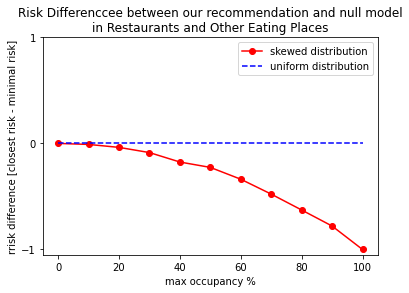

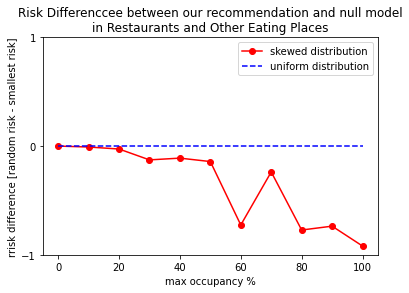

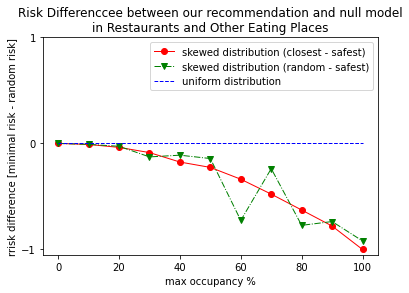

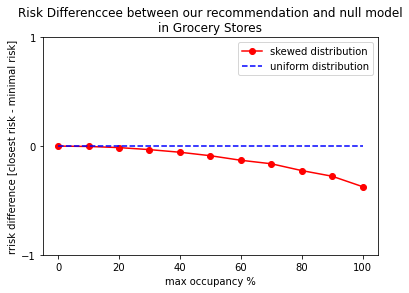

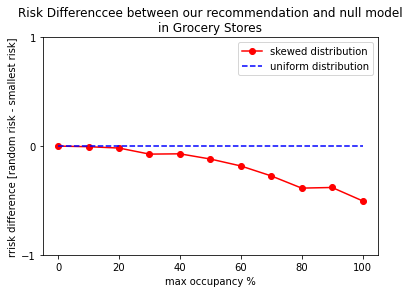

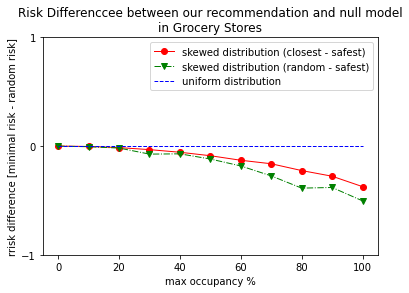

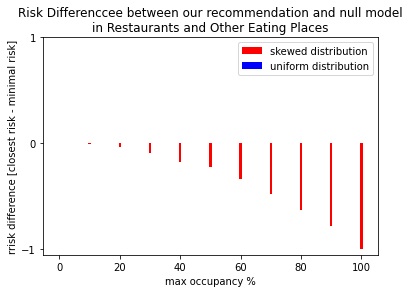

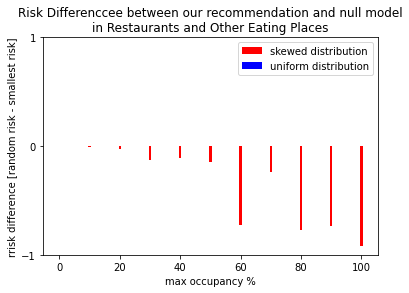

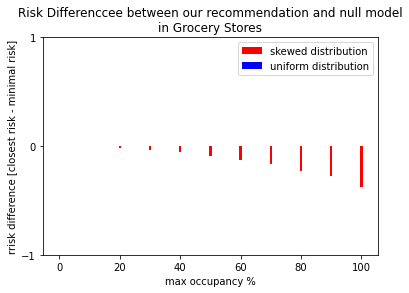

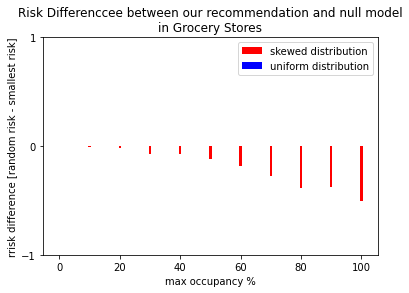

<Figure size 432x288 with 0 Axes>

In [27]:
max_val = 0

for i in range(2):
    file = pd.read_csv('static/auxiliary_files/risk_diff_of_computed_queries_'+str(i)+'.csv')
    max_val = max(get_max_value(file), max_val)
    
for i in range(2):
    file = pd.read_csv('static/auxiliary_files/risk_diff_of_computed_queries_'+str(i)+'.csv')
    title = 'Risk Differenccee between our recommendation and null model\nin '+categories[i]
    plot_name = '2nd_exp_plot_'+str(i)
    plot_second_experiment(file, title, max_val, True, plot_name)

for i in range(2):
    file = pd.read_csv('static/auxiliary_files/risk_diff_of_computed_queries_'+str(i)+'.csv')
    title = 'Risk Differenccee between our recommendation and null model\nin '+categories[i]
    plot_name = '2nd_exp_bar_'+str(i)
    plot_second_experiment(file, title, max_val, False, plot_name)

### 3rd experiment

In [28]:
def get_max_value_from_row(row):
    # find max value to set points between -1 and 1
    sk_ar = np.array(ast.literal_eval(row['skewed_risk_(closest_vs_least_riskiest)']))
    uni_ar = np.array(ast.literal_eval(row['normal_risk_(closest_vs_least_riskiest)']))
#     nor_ar = np.array(ast.literal_eval(row['uniform_risk_(closest_vs_least_riskiest)']))
    
    max_val = max(max(abs(sk_ar)) ,max(abs(uni_ar)))
    
    sk_ar = np.array(ast.literal_eval(row['skewed_risk_(random_vs_least_riskiest)']))
    uni_ar = np.array(ast.literal_eval(row['uniform_risk_(random_vs_least_riskiest)']))
#     nor_ar = np.array(ast.literal_eval(row['normal_risk_(random_vs_least_riskiest)']))
    
    max_val = max(max(max(abs(sk_ar)) ,max(abs(uni_ar))),max_val)
    return max_val

def plot_third_experiment(file, title, max_val,plot_name,is_plot):
    
    colors = cm.rainbow(np.linspace(0, 1, 11))
    markers = ['*-','--','-v','-.','+:','o-','x--','<-', '>--', 's-', 'P--']
    occup = [x*10 for x in range(11)]
    
    for index, row in file.iterrows():    
        # find max value to set points between -1 and 1
        sk_ar = np.array(ast.literal_eval(row['skewed_risk_(closest_vs_least_riskiest)'])) / max_val
        uni_ar = np.array(ast.literal_eval(row['uniform_risk_(closest_vs_least_riskiest)'])) / max_val
        nor_ar = np.array(ast.literal_eval(row['normal_risk_(closest_vs_least_riskiest)'])) / max_val

        # Show all three distributions on one graph
        
        if is_plot:
            plt.plot(occup, sk_ar, markers[index], color=colors[index], label='follow '+str(index*10)+"% of recommendations")
        else:
            plt.bar(occup, sk_ar, color=colors[index], label='follow '+str(index*10)+"% of recommendations")
        
    plt.xlabel('max occupancy %')
    plt.title(title)
    plt.ylabel('rrisk [x% safest, (100-x)% closest]')
    plt.yticks([0, 0.5, 1])
    plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.savefig('vis/experiments/'+plot_name+'_closest.png')
    plt.show()
    
    plt.clf()
    
    for index, row in file.iterrows():    
        # find max value to set points between -1 and 1
        sk_ar = np.array(ast.literal_eval(row['skewed_risk_(random_vs_least_riskiest)'])) / max_val
        uni_ar = np.array(ast.literal_eval(row['uniform_risk_(random_vs_least_riskiest)'])) / max_val
        nor_ar = np.array(ast.literal_eval(row['normal_risk_(random_vs_least_riskiest)'])) / max_val

        # Show all three distributions on one graph
        
        if is_plot:
            plt.plot(occup, sk_ar, markers[index], color=colors[index], label='follow '+str(index*10)+"% of recommendations")
        else:
            plt.bar(occup, sk_ar, color=colors[index], label='follow '+str(index*10)+"% of recommendations")
        
    plt.xlabel('max occupancy %')
    plt.title(title)
    plt.ylabel('rrisk [x% safest, (100-x)% random]')
    plt.yticks([0, 0.5, 1])
    plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.savefig('vis/experiments/'+plot_name+'_random.png')
    plt.show()
    

817543122


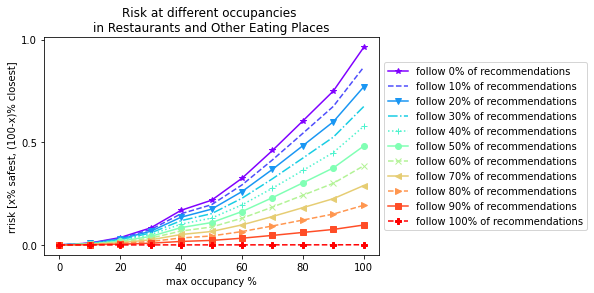

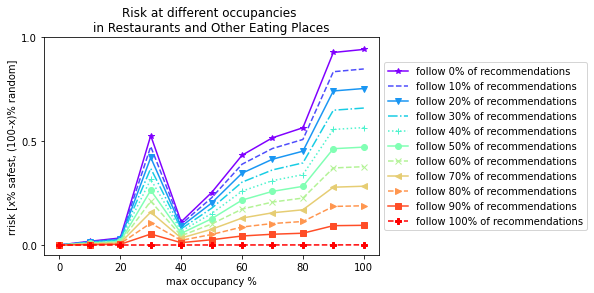

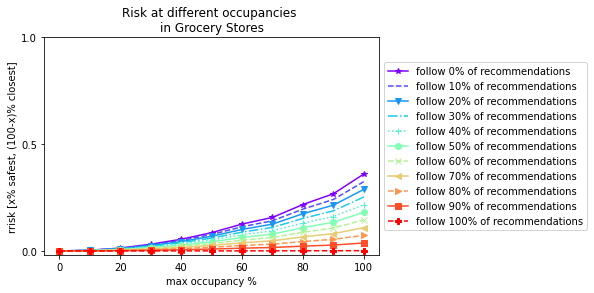

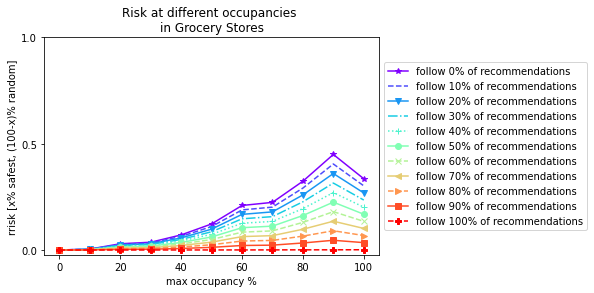

In [29]:
max_val = 0

for i in range(2):
    file = pd.read_csv('static/auxiliary_files/risk_of_varying_policies_'+str(i)+'.csv')
    
    for index, row in file.iterrows():
        max_val = max(get_max_value_from_row(row), max_val)
print(max_val)
for i in range(2):
    file = pd.read_csv('static/auxiliary_files/risk_of_varying_policies_'+str(i)+'.csv')
    title = 'Risk at different occupancies \nin '+categories[i]
    plot_name = '3rd_exp_plot_'+str(i)
    plot_third_experiment(file, title, max_val, plot_name, True)

# for i in range(2):
#     file = pd.read_csv('static/auxiliary_files/risk_of_varying_policies_'+str(i)+'.csv')
#     title = 'Risk at different occupancies \nin '+categories[i]
#     plot_name = '3rd_exp_bar_'+str(i)
#     plot_third_experiment(file, title, max_val, plot_name, False)